# **Game Play Time Series Forecasting - Kaggle**
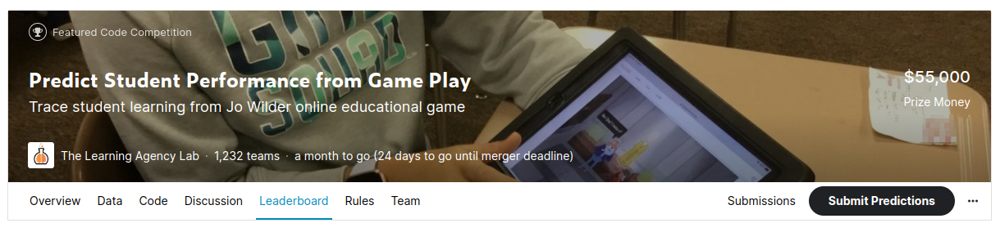
><pre>
@misc{predict-student-performance-from-game-play,
    author = {Alex Franklin, David Gagnon, HCL-Jevster, Maggie, Meg Benner, Natalie Rambis, Perpetual Baffour, Scott Crossley, ulrichboser},
    title = {Predict Student Performance from Game Play},
    publisher = {Kaggle},
    year = {2023},
    url = {https://kaggle.com/competitions/predict-student-performance-from-game-play}
}
</pre>

In [1]:
!pip3 install watermark pycaret --quiet
%load_ext watermark
%watermark -a 'NavinKumarMNK' -v -p polars,plotly,catboost,lightgbm,xgboost,pycaret

/opt/conda/lib/python3.10/site-packages/scipy/__init__.py:146: UserWarning: A NumPy version >=1.16.5 and <1.23.0 is required for this version of SciPy (detected version 1.23.5
  warnings.warn(f"A NumPy version >={np_minversion} and <{np_maxversion}"


Author: NavinKumarMNK

Python implementation: CPython
Python version       : 3.10.10
IPython version      : 8.12.0

polars  : 0.17.5
plotly  : 5.14.1
catboost: 1.1.1
lightgbm: 3.3.2
xgboost : 1.7.5
pycaret : 3.0.2



## **Modules Import**

In [2]:
import polars as pl
import pandas as pd
import os
import gc
import catboost as cb
import lightgbm as lgb
import xgboost as xgb
import plotly.express as px
from tqdm import tqdm
from sklearn.metrics import f1_score
from sklearn.model_selection import GroupKFold, KFold
import warnings
import optuna
from pycaret.classification import *
warnings.filterwarnings('ignore')
from catboost import *
import numpy as np
import matplotlib.pyplot as plt
import pickle


In [3]:
import os
for dirname, _, filenames in os.walk('/kaggle/input'):
    for filename in filenames:
        print(os.path.join(dirname, filename))

/kaggle/input/gameplay/sample_submission.csv
/kaggle/input/gameplay/train.parquet
/kaggle/input/gameplay/train_labels.csv
/kaggle/input/gameplay/test.csv
/kaggle/input/gameplay/jo_wilder_310/competition.cpython-310-x86_64-linux-gnu.so
/kaggle/input/gameplay/jo_wilder_310/__init__.py
/kaggle/input/gameplay/jo_wilder/competition.cpython-37m-x86_64-linux-gnu.so
/kaggle/input/gameplay/jo_wilder/__init__.py


## **Dataset**

In [4]:
train_data_path = '/kaggle/input/gameplay/train.csv'
test_data_path = '/kaggle/input/gameplay/test.csv'
submission_data_path = '/kaggle/input/gameplay/sample_submission.csv'
workspace_path = '/kaggle/input/gameplay/'
labels_path = '/kaggle/input/gameplay/train_labels.csv'

In [5]:
'''
# Run only once
# convert csv to parquet using pyarrow
import pyarrow.csv as pv
import pyarrow.parquet as pq

filename = train_data_path
table = pv.read_csv(filename)
pq.write_table(table, filename.replace('csv', 'parquet'), row_group_size=1000000)
'''

"\n# Run only once\n# convert csv to parquet using pyarrow\nimport pyarrow.csv as pv\nimport pyarrow.parquet as pq\n\nfilename = train_data_path\ntable = pv.read_csv(filename)\npq.write_table(table, filename.replace('csv', 'parquet'), row_group_size=1000000)\n"

In [6]:
train_df_par = pl.read_parquet(train_data_path.replace('csv', 'parquet'))
print(train_df_par.shape)
print(train_df_par.n_chunks())
train_df_par.head()

(26296946, 20)
27


session_id,index,elapsed_time,event_name,name,level,page,room_coor_x,room_coor_y,screen_coor_x,screen_coor_y,hover_duration,text,fqid,room_fqid,text_fqid,fullscreen,hq,music,level_group
i64,i64,i64,str,str,i64,f64,f64,f64,f64,f64,f64,str,str,str,str,i64,i64,i64,str
20090312431273200,0,0,"""cutscene_click…","""basic""",0,null,-413.991405,-159.314686,380.0,494.0,null,"""undefined""","""intro""","""tunic.historic…","""tunic.historic…",0,0,1,"""0-4"""
20090312431273200,1,1323,"""person_click""","""basic""",0,null,-413.991405,-159.314686,380.0,494.0,null,"""Whatcha doing …","""gramps""","""tunic.historic…","""tunic.historic…",0,0,1,"""0-4"""
20090312431273200,2,831,"""person_click""","""basic""",0,null,-413.991405,-159.314686,380.0,494.0,null,"""Just talking t…","""gramps""","""tunic.historic…","""tunic.historic…",0,0,1,"""0-4"""
20090312431273200,3,1147,"""person_click""","""basic""",0,null,-413.991405,-159.314686,380.0,494.0,null,"""I gotta run to…","""gramps""","""tunic.historic…","""tunic.historic…",0,0,1,"""0-4"""
20090312431273200,4,1863,"""person_click""","""basic""",0,null,-412.991405,-159.314686,381.0,494.0,null,"""Can I come, Gr…","""gramps""","""tunic.historic…","""tunic.historic…",0,0,1,"""0-4"""


In [7]:
COLUMNS = []
for col in train_df_par.columns:
    COLUMNS.append(col)
    print(col, train_df_par[col].n_unique())

session_id 23562
index 20348
elapsed_time 5042639


event_name 11
name 6
level 23


page 8
room_coor_x 17441451
room_coor_y 13653975
screen_coor_x 57925


screen_coor_y 102592
hover_duration 24102
text 598


fqid 129


room_fqid 19
text_fqid 127
fullscreen 2
hq 2
music 2


level_group 3


In [8]:
columns = [
    pl.col("page").cast(pl.Int8),
    pl.col("level").cast(pl.Int8),
    pl.col("fullscreen").cast(pl.Int8),
    pl.col("hq").cast(pl.Int8),
    pl.col("music").cast(pl.Int8),
    pl.col("index").cast(pl.UInt16),
    (
        pl.when(pl.col("hover_duration").is_null())
        .then(0)
        .otherwise(1)
        .alias("is_hover")
        .cast(pl.Int8)
    ),
    (
        pl.when(pl.col("room_coor_x").is_null())
        .then(0)
        .otherwise(1)
        .alias("is_click")
        .cast(pl.Int8)
    ),
    (
        pl.when(pl.col("page").is_null())
        .then(0)
        .otherwise(1)
        .alias("is_page")
        .cast(pl.Int8)
    ),
    (
        (pl.col("elapsed_time") - pl.col("elapsed_time").shift(1))
        .fill_null(0)
        .clip(0, 1e9)
        .over(["session_id", "level"])
        .alias("elapsed_time_diff")
    ),
    (
        (pl.col("screen_coor_x") - pl.col("screen_coor_x").shift(1))
        .abs()
        .over(["session_id", "level"])
        .alias("screen_corr_x_dff")
    ),
    (
        (pl.col("screen_coor_y") - pl.col("screen_coor_y").shift(1))
        .abs()
        .over(["session_id", "level"])
        .alias("screen_corr_y_dff")
    ),
    (
        (pl.col("room_coor_x") - pl.col("room_coor_x").shift(1))
        .abs()
        .over(["session_id", "level"])
        .alias("room_corr_x_diff")
    ),
    (
        (pl.col("room_coor_y") - pl.col("room_coor_y").shift(1))
        .abs()
        .over(["session_id", "level"])
        .alias("room_corr_y_diff")
    )
]


In [9]:
df = (train_df_par.with_columns(columns))
df.head()

session_id,index,elapsed_time,event_name,name,level,page,room_coor_x,room_coor_y,screen_coor_x,screen_coor_y,hover_duration,text,fqid,room_fqid,text_fqid,fullscreen,hq,music,level_group,is_hover,is_click,is_page,elapsed_time_diff,screen_corr_x_dff,screen_corr_y_dff,room_corr_x_diff,room_corr_y_diff
i64,u16,i64,str,str,i8,i8,f64,f64,f64,f64,f64,str,str,str,str,i8,i8,i8,str,i8,i8,i8,i64,f64,f64,f64,f64
20090312431273200,0,0,"""cutscene_click…","""basic""",0,null,-413.991405,-159.314686,380.0,494.0,null,"""undefined""","""intro""","""tunic.historic…","""tunic.historic…",0,0,1,"""0-4""",0,1,0,0,null,null,null,null
20090312431273200,1,1323,"""person_click""","""basic""",0,null,-413.991405,-159.314686,380.0,494.0,null,"""Whatcha doing …","""gramps""","""tunic.historic…","""tunic.historic…",0,0,1,"""0-4""",0,1,0,1323,0.0,0.0,0.0,0.0
20090312431273200,2,831,"""person_click""","""basic""",0,null,-413.991405,-159.314686,380.0,494.0,null,"""Just talking t…","""gramps""","""tunic.historic…","""tunic.historic…",0,0,1,"""0-4""",0,1,0,0,0.0,0.0,0.0,0.0
20090312431273200,3,1147,"""person_click""","""basic""",0,null,-413.991405,-159.314686,380.0,494.0,null,"""I gotta run to…","""gramps""","""tunic.historic…","""tunic.historic…",0,0,1,"""0-4""",0,1,0,316,0.0,0.0,0.0,0.0
20090312431273200,4,1863,"""person_click""","""basic""",0,null,-412.991405,-159.314686,381.0,494.0,null,"""Can I come, Gr…","""gramps""","""tunic.historic…","""tunic.historic…",0,0,1,"""0-4""",0,1,0,716,1.0,0.0,1.0,0.0


In [10]:
df = df.with_columns([
    pl.col('fqid').apply(lambda x: 'fqid_None' if x == '' else x).alias('fqid'),
])

df = df.with_columns([
    pl.col('text_fqid').apply(lambda x: 'text_fqid_None' if x == '' else x).alias('text_fqid'),
])

df = df.with_columns([
    pl.col('page').fill_null(-1),
])

In [11]:
def extract_text_feature(df: pl.DataFrame) -> pl.DataFrame:
    dfs = []
    cc = ['question', 'exclamatory', 'comma', 'unicode']
    i = 0
    for c in ['\?', '!', ',', '\\\\u0']:
        tmp = df['text'].str.contains(c).cast(pl.UInt8).rename(f"text_{cc[i]}")
        dfs.append(tmp)
        i+=1

    tmp_full_stop = df['text'].str.contains(r'\.').cast(pl.UInt8).rename("text_full_stop")
    tmp_ellipsis = df['text'].str.contains(r'\.\.\.').cast(pl.UInt8).rename("text_ellipsis")

    dfs.append(tmp_full_stop)
    dfs.append(tmp_ellipsis)

    tmp = df['text'].str.n_chars().eq(0).cast(pl.UInt8).rename("text_empty")

    dfs = pl.DataFrame(dfs)
    dfs = pl.concat([df, dfs], how="horizontal")
    return dfs

sample_df = extract_text_feature(df)
sample_df.head()

session_id,index,elapsed_time,event_name,name,level,page,room_coor_x,room_coor_y,screen_coor_x,screen_coor_y,hover_duration,text,fqid,room_fqid,text_fqid,fullscreen,hq,music,level_group,is_hover,is_click,is_page,elapsed_time_diff,screen_corr_x_dff,screen_corr_y_dff,room_corr_x_diff,room_corr_y_diff,text_question,text_exclamatory,text_comma,text_unicode,text_full_stop,text_ellipsis
i64,u16,i64,str,str,i8,i8,f64,f64,f64,f64,f64,str,str,str,str,i8,i8,i8,str,i8,i8,i8,i64,f64,f64,f64,f64,u8,u8,u8,u8,u8,u8
20090312431273200,0,0,"""cutscene_click…","""basic""",0,-1,-413.991405,-159.314686,380.0,494.0,null,"""undefined""","""intro""","""tunic.historic…","""tunic.historic…",0,0,1,"""0-4""",0,1,0,0,null,null,null,null,0,0,0,0,0,0
20090312431273200,1,1323,"""person_click""","""basic""",0,-1,-413.991405,-159.314686,380.0,494.0,null,"""Whatcha doing …","""gramps""","""tunic.historic…","""tunic.historic…",0,0,1,"""0-4""",0,1,0,1323,0.0,0.0,0.0,0.0,1,0,1,0,0,0
20090312431273200,2,831,"""person_click""","""basic""",0,-1,-413.991405,-159.314686,380.0,494.0,null,"""Just talking t…","""gramps""","""tunic.historic…","""tunic.historic…",0,0,1,"""0-4""",0,1,0,0,0.0,0.0,0.0,0.0,0,0,0,0,1,0
20090312431273200,3,1147,"""person_click""","""basic""",0,-1,-413.991405,-159.314686,380.0,494.0,null,"""I gotta run to…","""gramps""","""tunic.historic…","""tunic.historic…",0,0,1,"""0-4""",0,1,0,316,0.0,0.0,0.0,0.0,0,1,0,0,0,0
20090312431273200,4,1863,"""person_click""","""basic""",0,-1,-412.991405,-159.314686,381.0,494.0,null,"""Can I come, Gr…","""gramps""","""tunic.historic…","""tunic.historic…",0,0,1,"""0-4""",0,1,0,716,1.0,0.0,1.0,0.0,1,0,1,0,0,0


In [12]:
print(
    sample_df['text_question'].value_counts(),
    sample_df['text_comma'].value_counts(),
    sample_df['text_exclamatory'].value_counts(),
    sample_df['text_full_stop'].value_counts(),
    sample_df['text_unicode'].value_counts(),
    sample_df['text_ellipsis'].value_counts(),
)

shape: (2, 2)
┌───────────────┬──────────┐
│ text_question ┆ counts   │
│ ---           ┆ ---      │
│ u8            ┆ u32      │
╞═══════════════╪══════════╡
│ 0             ┆ 24074710 │
│ 1             ┆ 2222236  │
└───────────────┴──────────┘ shape: (2, 2)
┌────────────┬──────────┐
│ text_comma ┆ counts   │
│ ---        ┆ ---      │
│ u8         ┆ u32      │
╞════════════╪══════════╡
│ 0          ┆ 24241967 │
│ 1          ┆ 2054979  │
└────────────┴──────────┘ shape: (2, 2)
┌──────────────────┬──────────┐
│ text_exclamatory ┆ counts   │
│ ---              ┆ ---      │
│ u8               ┆ u32      │
╞══════════════════╪══════════╡
│ 0                ┆ 22080902 │
│ 1                ┆ 4216044  │
└──────────────────┴──────────┘ shape: (2, 2)
┌────────────────┬──────────┐
│ text_full_stop ┆ counts   │
│ ---            ┆ ---      │
│ u8             ┆ u32      │
╞════════════════╪══════════╡
│ 0              ┆ 22084432 │
│ 1              ┆ 4212514  │
└────────────────┴──────────┘ shape: (

In [13]:
print(sample_df['text'].value_counts())

shape: (598, 2)
┌───────────────────────────────────┬────────┐
│ text                              ┆ counts │
│ ---                               ┆ ---    │
│ str                               ┆ u32    │
╞═══════════════════════════════════╪════════╡
│ Meet me back in my office and we… ┆ 2      │
│ I should stay and look for clues… ┆ 4059   │
│ Maybe there's a clue in this mes… ┆ 3228   │
│ Hmm. Button's still not working.  ┆ 9984   │
│ …                                 ┆ …      │
│ Um, are you okay?                 ┆ 6604   │
│ So? What'd you find out?          ┆ 23776  │
│ Wow! You figured it out!          ┆ 23887  │
│ You can talk to a textile expert… ┆ 35202  │
└───────────────────────────────────┴────────┘


In [14]:
CATS = ['event_name', 'name', 'fqid', 'room_fqid', 'text_fqid', 'level', 'page'] 
NUMS = ['room_coor_x', 'room_coor_y', 'screen_coor_x', 
        'screen_coor_y', 'hover_duration', 'elapsed_time_diff',
        'screen_corr_x_dff', 'screen_corr_y_dff', 'room_corr_x_diff', 'room_corr_y_diff']
SNO = ['session_id', 'index']
LEVEL = {
    '0-4'  : [0, 1, 2, 3, 4],
    '5-12' : [5, 6, 7, 8, 9, 10, 11, 12],
    '13-22': [13, 14, 15, 16, 17, 18, 19, 20, 21, 22],
}
DATE = [ 'year', 'month', 'day', 'hour', 'minute', 'second']
DUO = ['fullscreen', 'hq', 'music', "is_click", "is_page", "is_hover"]
TEXT = ["text_\?", "text_!", "text_,", "text_\\u0", "text_\."]

In [15]:
df = sample_df
df.null_count()

session_id,index,elapsed_time,event_name,name,level,page,room_coor_x,room_coor_y,screen_coor_x,screen_coor_y,hover_duration,text,fqid,room_fqid,text_fqid,fullscreen,hq,music,level_group,is_hover,is_click,is_page,elapsed_time_diff,screen_corr_x_dff,screen_corr_y_dff,room_corr_x_diff,room_corr_y_diff,text_question,text_exclamatory,text_comma,text_unicode,text_full_stop,text_ellipsis
u32,u32,u32,u32,u32,u32,u32,u32,u32,u32,u32,u32,u32,u32,u32,u32,u32,u32,u32,u32,u32,u32,u32,u32,u32,u32,u32,u32,u32,u32,u32,u32,u32,u32
0,0,0,0,0,0,0,2073272,2073272,2073272,2073272,24294702,0,0,0,0,0,0,0,0,0,0,0,0,3773981,3773981,3773981,3773981,0,0,0,0,0,0


In [16]:
ques_level = {
    '0-4'   : [1, 2, 3],
    '5-12'  : [4, 5, 6, 7, 8, 9, 10, 11, 12, 13],
    '13-22' : [14, 15, 16, 17, 18]
}

In [17]:
# UNIQUE FEATURES
EVENT_NAME = df['event_name'].unique().to_pandas().to_list()
NAME = df['name'].unique().to_pandas().to_list()
FQID = df['fqid'].unique().to_pandas().to_list()
ROOM_FQID = df['room_fqid'].unique().to_pandas().to_list()
TEXT_FQID = df['text_fqid'].unique().to_pandas().to_list()
LEVEL = df['level'].unique().to_pandas().to_list()
PAGE = df['page'].unique().to_pandas().to_list()

print(EVENT_NAME, len(EVENT_NAME), end="\n\n")
print(NAME, len(NAME), end="\n\n")
print(FQID, len(FQID), end="\n\n")
print(ROOM_FQID, len(ROOM_FQID), end="\n\n")
print(TEXT_FQID, len(TEXT_FQID), end="\n\n")
print(LEVEL, len(LEVEL), end="\n\n")
print(PAGE, len(PAGE), end="\n\n")

['notification_click', 'navigate_click', 'object_click', 'checkpoint', 'map_hover', 'cutscene_click', 'notebook_click', 'map_click', 'observation_click', 'person_click', 'object_hover'] 11

['prev', 'undefined', 'basic', 'next', 'open', 'close'] 6

['wells', 'reader.paper0.prev', 'tunic.humanecology', 'chap1_finale_c', 'remove_cup', 'journals_flag.hub.topics_old', 'block_tocollection', 'lockeddoor', 'journals_flag.pic_2.next', 'reader_flag', 'tunic.wildlife', 'reader.paper2.prev', 'reader.paper1.next', 'journals_flag.pic_2.bingo', 'journals_flag.pic_0.bingo', 'tunic.library', 'flag_girl', 'crane_ranger', 'journals', 'trigger_scarf', 'savedteddy', 'archivist_glasses', 'need_glasses', 'tracks.hub.deer', 'tobasement', 'block_tomap2', 'businesscards.card_1.next', 'glasses', 'tunic.flaghouse', 'cs', 'journals.pic_2.next', 'reader_flag.paper2.prev', 'seescratches', 'journals_flag.pic_0_old.next', 'janitor', 'directory', 'block_tomap1', 'block_magnify', 'groupconvo_flag', 'plaque', 'block_nel

In [18]:
"""
Transforming that done irrespective of the group_level.
"""
def model_data_1(x:pl.DataFrame, group:str, index:str="session_id"):
    aggs = [pl.col("index").count().alias(f"session_number")]
    for cat in CATS:
        aggs.extend([
            pl.col(cat)
              .filter(pl.col(cat) == c)
              .count()
              .alias(f"{c}_{cat}_counts")
              for c in x[cat].unique().to_pandas().to_list()
             ])
    for bi in DUO:
        aggs.extend([
            pl.col(bi)
            .filter(pl.col(bi) == c)
            .count()
            .alias(f"{c}_{bi}_counts")
            for c in x[bi].unique().to_pandas().to_list()
        ])
    for num in NUMS:
        aggs.extend([
            pl.col(num)
            .std()
            .alias(f"{num}_std")
        ])
        aggs.extend([
            pl.col(num)
            .mean()
            .alias(f"{num}_mean")
        ])
        aggs.extend([
            pl.col(num)
            .sum()
            .alias(f"{num}_sum")
        ])
    
    for num in list(filter(lambda x: x not in 
                ['elapsed_time_diff', 'screen_corr_x_dff', 'screen_corr_y_dff', 
                 'room_corr_x_diff', 'room_corr_y_diff'], NUMS)):
        aggs.extend([
            pl.col(num)
            .max()
            .alias(f"{num}_max")
        ])
        aggs.extend([
            pl.col(num)
            .min()
            .alias(f"{num}_min")
        ])
    
    x = x.groupby([index, group]).agg(aggs).sort("session_id")
    x = x.drop(['0_hq_counts', '0_music_counts', '0_fullscreen_counts',
                '0_is_click_counts', '0_is_page_counts', '0_is_hover_counts',
                group]
              )
    x = x.rename({
            "1_fullscreen_counts" : "is_fullscreen",
            "1_hq_counts" : "is_hq",
            "1_music_counts" : "is_music",
            "1_is_click_counts" : "click_counts",
            "1_is_page_counts" : "page_counts",
            "1_is_hover_counts" : "hover_counts"
        })
    
    x = x.with_columns(
        pl.col(['is_hq']).gt(1).cast(pl.UInt8),
        pl.col(['is_fullscreen']).gt(1).cast(pl.UInt8),
        pl.col(['is_music']).gt(1).cast(pl.UInt8),
        pl.col('session_id').apply(lambda x: int(str(x)[:2])).cast(pl.UInt8).alias('year'),
        pl.col('session_id').apply(lambda x: int(str(x)[2:4])+1).cast(pl.UInt8).alias('month'),
        pl.col('session_id').apply(lambda x: int(str(x)[4:6])).cast(pl.UInt8).alias('day'),
        pl.col('session_id').apply(lambda x: int(str(x)[6:8])).cast(pl.UInt8).alias('hour'),
        #pl.col('session_id').apply(lambda x: int(str(x)[8:10])).cast(pl.Int8).alias('minute'),
        #pl.col('session_id').apply(lambda x: int(str(x)[10:12])).cast(pl.Int8).alias('second'),
    )
    x = x.to_pandas()
    x.set_index(index)
    return x 

In [19]:
#sample_df = model_data_1(df.filter(pl.col("level") == 5), "level", "session_id")
#sample_df

sample_df = model_data_1(df.filter(pl.col("level_group") == '13-22'),
                         "level_group", "session_id")
sample_df

,session_id,session_number,object_hover_event_name_counts,person_click_event_name_counts,object_click_event_name_counts,navigate_click_event_name_counts,observation_click_event_name_counts,cutscene_click_event_name_counts,notebook_click_event_name_counts,map_click_event_name_counts,...,screen_coor_x_max,screen_coor_x_min,screen_coor_y_max,screen_coor_y_min,hover_duration_max,hover_duration_min,year,month,day,hour
0,20090312431273200,420,13,123,20,170,3,60,0,6,...,859.0,2.0,659.0,24.0,4750.0,17.0,20,10,3,12
1,20090312433251036,1297,66,145,83,637,5,65,50,45,...,878.0,0.0,657.0,29.0,22351.0,14.0,20,10,3,12
2,20090312455206810,364,13,101,11,123,3,58,26,10,...,1193.0,6.0,898.0,41.0,4568.0,16.0,20,10,3,12
3,20090313091715820,491,17,110,18,234,4,66,2,7,...,1011.0,10.0,746.0,36.0,8258.0,16.0,20,10,3,13
4,20090313571836404,392,11,107,15,171,5,55,0,9,...,870.0,2.0,648.0,49.0,7700.0,16.0,20,10,3,13
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
23557,22100215342220508,424,22,109,22,169,4,59,8,7,...,872.0,20.0,642.0,60.0,54092814.0,16.0,22,11,2,15
23558,22100215460321130,454,12,135,13,148,5,70,6,13,...,934.0,11.0,693.0,32.0,6328.0,17.0,22,11,2,15
23559,22100217104993650,610,17,127,20,278,4,75,49,8,...,871.0,4.0,646.0,27.0,9464.0,17.0,22,11,2,17
23560,22100219442786200,423,11,101,15,181,5,54,26,8,...,873.0,4.0,653.0,34.0,5270.0,16.0,22,11,2,19


## **Model**

In [20]:
CATBOOST_CATS = ['year', 'month', 'day', 'hour', "is_fullscreen", "is_hq", "is_music"]

In [21]:
targets = pd.read_csv(labels_path)
targets['session'] = targets.session_id.apply(lambda x: int(x.split("_")[0]))
targets['q'] = targets.session_id.apply(lambda x: int(x.split("_")[1][1:]))
targets

,session_id,correct,session,q
0,20090312431273200_q1,1,20090312431273200,1
1,20090312433251036_q1,0,20090312433251036,1
2,20090312455206810_q1,1,20090312455206810,1
3,20090313091715820_q1,0,20090313091715820,1
4,20090313571836404_q1,1,20090313571836404,1
...,...,...,...,...
424111,22100215342220508_q18,1,22100215342220508,18
424112,22100215460321130_q18,1,22100215460321130,18
424113,22100217104993650_q18,1,22100217104993650,18
424114,22100219442786200_q18,1,22100219442786200,18


In [22]:
for i in range(1, 19):
    print(targets[targets['q'] ==i]['correct'].value_counts().to_list())

[17141, 6421]
[23063, 499]
[22007, 1555]
[18808, 4754]
[12918, 10644]
[18283, 5279]
[17343, 6219]
[14543, 9019]
[17348, 6214]
[11909, 11653]
[15165, 8397]
[20333, 3229]
[17080, 6482]
[16674, 6888]
[12228, 11334]
[17315, 6247]
[16206, 7356]
[22399, 1163]


In [23]:
ques_target = []
ques_name = []
for i in range(1, 19):
    ques_target.append(targets[targets['q']==i].correct.to_list())
    ques_name.append(f"ques_{i}")

In [24]:
'''
## Run only Once For Exporting
for q in tqdm(range(1, 19)):
    if q <= 3:
        grp = '0-4'
    elif q <= 13:
        grp = '5-12'
    elif q <= 22:
        grp = '13-22'
        
    main_df = model_data_1(df.filter(pl.col("level_group") == grp),
                         "level_group", "session_id")
    
    for j in range(q-1):
        main_df[ques_name[j]] = ques_target[j]

    main_df['target'] = ques_target[q-1]
    main_df['group'] = main_df['session_id']
    
    main_df.to_parquet(f"data_ques_{q}.parquet")
'''

'\n## Run only Once For Exporting\nfor q in tqdm(range(1, 19)):\n    if q <= 3:\n        grp = \'0-4\'\n    elif q <= 13:\n        grp = \'5-12\'\n    elif q <= 22:\n        grp = \'13-22\'\n        \n    main_df = model_data_1(df.filter(pl.col("level_group") == grp),\n                         "level_group", "session_id")\n    \n    for j in range(q-1):\n        main_df[ques_name[j]] = ques_target[j]\n\n    main_df[\'target\'] = ques_target[q-1]\n    main_df[\'group\'] = main_df[\'session_id\']\n    \n    main_df.to_parquet(f"data_ques_{q}.parquet")\n'

In [25]:
df1 = model_data_1(df.filter(pl.col("level_group") == '0-4'),
                         "level_group", "session_id")
df2 = model_data_1(df.filter(pl.col("level_group") == '5-12'),
                         "level_group", "session_id")
df3 = model_data_1(df.filter(pl.col("level_group") == '13-22'),
                         "level_group", "session_id")

In [26]:
df1

,session_id,session_number,checkpoint_event_name_counts,notebook_click_event_name_counts,cutscene_click_event_name_counts,map_click_event_name_counts,navigate_click_event_name_counts,person_click_event_name_counts,observation_click_event_name_counts,map_hover_event_name_counts,...,screen_coor_x_max,screen_coor_x_min,screen_coor_y_max,screen_coor_y_min,hover_duration_max,hover_duration_min,year,month,day,hour
0,20090312431273200,165,1,0,28,2,81,22,4,4,...,843.0,11.0,639.0,60.0,7899.0,17.0,20,10,3,12
1,20090312433251036,139,1,2,36,3,49,18,2,3,...,875.0,0.0,639.0,58.0,5567.0,17.0,20,10,3,12
2,20090312455206810,149,1,0,49,2,57,18,0,2,...,1189.0,1.0,706.0,30.0,8401.0,51.0,20,10,3,12
3,20090313091715820,176,1,2,34,2,80,22,2,2,...,1006.0,2.0,750.0,6.0,5794.0,216.0,20,10,3,13
4,20090313571836404,112,1,4,26,3,35,19,0,2,...,878.0,6.0,616.0,36.0,4383.0,16.0,20,10,3,13
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
23557,22100215342220508,150,1,3,29,2,58,21,3,3,...,865.0,19.0,652.0,44.0,17093.0,17.0,22,11,2,15
23558,22100215460321130,149,1,7,31,2,50,21,1,3,...,930.0,37.0,682.0,48.0,5248.0,16.0,22,11,2,15
23559,22100217104993650,197,1,3,28,2,104,23,4,0,...,862.0,2.0,652.0,33.0,5664.0,17.0,22,11,2,17
23560,22100219442786200,167,1,6,32,3,81,20,1,1,...,849.0,29.0,618.0,22.0,7087.0,349.0,22,11,2,19


## **Questions**

In [27]:
def objective_lgbm(trial, q):
    global df
    ALL_USERS = df['session_id'].unique()
    feature_importance_df = pd.DataFrame()
    models = {}
    results = [[[], []]]
    gkf = GroupKFold(n_splits=5)
    oof_cat = pd.DataFrame(data=np.zeros((len(ALL_USERS),1)), index=ALL_USERS, 
                           columns=[f'meta_{i}' for i in range(1, 2)])
    if q <= 3:
        grp = '0-4'
        df = df1

    elif q <= 13:
        grp = '5-12'
        df = df2

    elif q <= 22:
        grp = '13-22'
        df = df3

    FEATURES = df.columns
    df.set_index('session_id')
    print("-"*50)
    print(f'question{q}, with{len(FEATURES)}features')
    print('-'*50)


    lgbm_params = {
        'objective': 'binary',
        'metric': 'binary_logloss',
        'boosting_type': 'gbdt',
        'num_iterations': 5000,
        'learning_rate': 0.003,
        'early_stopping_rounds': 75,
        'random_seed': 123,
        'num_leaves': trial.suggest_int('num_leaves', 10, 100),
        'learning_rate': trial.suggest_loguniform('learning_rate', 0.01, 0.5),
        'feature_fraction': trial.suggest_uniform('feature_fraction', 0.1, 1.0),
        'bagging_fraction': trial.suggest_uniform('bagging_fraction', 0.1, 1.0),
        'bagging_freq': trial.suggest_int('bagging_freq', 1, 10),
        'min_child_samples': trial.suggest_int('min_child_samples', 5, 100),
        'reg_alpha': trial.suggest_loguniform('reg_alpha', 0.001, 10.0),
        'reg_lambda': trial.suggest_loguniform('reg_lambda', 0.001, 10.0),
        'subsample': trial.suggest_uniform('subsample', 0.1, 1.0),
        'colsample_bytree': trial.suggest_uniform('colsample_bytree', 0.1, 1.0),
        'min_split_gain': trial.suggest_loguniform('min_split_gain', 0.001, 1.0),
        'max_depth': trial.suggest_int('max_depth', -1, 10),
        'verbosity': -1
    }

    feature_importance_df = pd.DataFrame()

    for fold, (train_idx, valid_idx) in enumerate(gkf.split(X=df, groups=df.index)):
        # TRAIN DATA
        train_x = df.iloc[train_idx]
        train_users = train_x.index.values
        train_y = targets.loc[targets.q == q].reset_index().loc[train_users]

        # VALID DATA
        valid_x = df.iloc[valid_idx]
        valid_users = valid_x.index.values
        valid_y = targets.loc[targets.q == q].reset_index().loc[valid_users]

        model = lgb.LGBMClassifier(**lgbm_params)
        model = model.fit(train_x[FEATURES], train_y['correct'],
              eval_set=[(valid_x[FEATURES], valid_y['correct'])],
              early_stopping_rounds=lgbm_params['early_stopping_rounds'],
              verbose=False)


        y = valid_y['correct']
        y_hat = model.predict_proba(valid_x[FEATURES])
        models[(fold, q)] = model

        fold_importance_df = pd.DataFrame()
        fold_importance_df["feature"] = FEATURES
        fold_importance_df["importance"] = model.feature_importances_
        fold_importance_df["fold"] = fold + 1
        feature_importance_df = pd.concat([feature_importance_df, fold_importance_df], axis=0)


        results[0][0].append(y)
        results[0][1].append(y_hat)
    feature_importance_df = feature_importance_df.groupby(['feature'])['importance'].agg(['mean']).sort_values(by='mean', ascending=False)
    display(feature_importance_df.head(10))
    
    results = [[np.concatenate(_) for _ in _] for _ in results]
    
    for (fold,q), model in models.items():
        with open(f'lgbm_fold{fold}_q{q}.pkl', 'wb') as f:
            pickle.dump(model, f)

    true = pd.DataFrame(results[0][0])
    print(results[0][1])
    
    oof = pd.DataFrame(results[0][1][:, 1])
    
    scores = []; thresholds = []
    best_socre = 0; best_threshold = 0

    for threshold in np.arange(0.3, 0.8, 0.01):
        preds = (oof.values.reshape(-1) > threshold).astype('int')
        m = f1_score(true.values.reshape(-1), preds, average='macro')
        scores.append(m)
        thresholds.append(threshold)
        if m > best_socre:
            best_socre = m
            best_threshold = threshold

    plt.figure(figsize=(20, 5))
    plt.plot(thresholds, scores, '-o', color='blue')
    plt.scatter([best_threshold], [best_socre], color='blue')
    plt.xlabel("Threshold", size=14)
    plt.ylabel("Validation F1 Score",size=14)
    plt.title(f'Threshold vs. F1_Score with Best F1_Score={best_socre:.3f} at Best Threshold = {best_threshold:.3}', size=18)
    plt.show()

    print(f'When using optimal threshold = {best_threshold:.2f}...')
    for k in range(1):
        m = f1_score(true[k].values, (oof[k].values > best_threshold).astype('int'), average = 'macro')
        print(f'Q{k}: F1 =',m)
    m = f1_score(true.values.reshape(-1), (oof.values > best_threshold).reshape(-1).astype('int'), average = 'macro')
    print('==> Overall F1 =', m)
    print('s')
    return m



[I 2023-05-23 02:15:22,732] A new study created in memory with name: no-name-17166802-cb5c-46d3-92ad-8eb2e79bb91d


  0%|          | 0/50 [00:00<?, ?it/s]

--------------------------------------------------
question10, with210features
--------------------------------------------------
--------------------------------------------------
question10, with210features
--------------------------------------------------
--------------------------------------------------
question10, with210features
--------------------------------------------------
--------------------------------------------------
question10, with210features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.1769486912960942, subsample=0.37729368488532156 will be ignored. Current value: bagging_fraction=0.1769486912960942
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=8, subsample_freq=0 will be ignored. Current value: bagging_freq=8
[LightGBM] [Warning] feature_fraction is set=0.6654972538632543, colsample_bytree=0.6427835520260996 will be ignored. Current value: feature_fraction=0.6654972538632543
[LightGBM] [Warning] bagging_fraction is set=0.529809142952253, subsample=0.6819814346904234 will be ignored. Current value: bagging_fraction=0.529809142952253
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=10, subsample_freq=0 will be ignored. Current value: bagging_freq=10
[LightGBM] [Warning] f

[LightGBM] [Warning] bagging_fraction is set=0.1769486912960942, subsample=0.37729368488532156 will be ignored. Current value: bagging_fraction=0.1769486912960942
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=8, subsample_freq=0 will be ignored. Current value: bagging_freq=8
[LightGBM] [Warning] feature_fraction is set=0.6654972538632543, colsample_bytree=0.6427835520260996 will be ignored. Current value: feature_fraction=0.6654972538632543


[LightGBM] [Warning] bagging_fraction is set=0.21864339945848457, subsample=0.7027533780705595 will be ignored. Current value: bagging_fraction=0.21864339945848457
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=7, subsample_freq=0 will be ignored. Current value: bagging_freq=7
[LightGBM] [Warning] feature_fraction is set=0.28594997833334224, colsample_bytree=0.13835103606390972 will be ignored. Current value: feature_fraction=0.28594997833334224


[LightGBM] [Warning] bagging_fraction is set=0.1769486912960942, subsample=0.37729368488532156 will be ignored. Current value: bagging_fraction=0.1769486912960942
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=8, subsample_freq=0 will be ignored. Current value: bagging_freq=8
[LightGBM] [Warning] feature_fraction is set=0.6654972538632543, colsample_bytree=0.6427835520260996 will be ignored. Current value: feature_fraction=0.6654972538632543


[LightGBM] [Warning] bagging_fraction is set=0.529809142952253, subsample=0.6819814346904234 will be ignored. Current value: bagging_fraction=0.529809142952253
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=10, subsample_freq=0 will be ignored. Current value: bagging_freq=10
[LightGBM] [Warning] feature_fraction is set=0.21272881539712132, colsample_bytree=0.6967438836457903 will be ignored. Current value: feature_fraction=0.21272881539712132


[LightGBM] [Warning] bagging_fraction is set=0.21864339945848457, subsample=0.7027533780705595 will be ignored. Current value: bagging_fraction=0.21864339945848457
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=7, subsample_freq=0 will be ignored. Current value: bagging_freq=7
[LightGBM] [Warning] feature_fraction is set=0.28594997833334224, colsample_bytree=0.13835103606390972 will be ignored. Current value: feature_fraction=0.28594997833334224
[LightGBM] [Warning] bagging_fraction is set=0.1769486912960942, subsample=0.37729368488532156 will be ignored. Current value: bagging_fraction=0.1769486912960942
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=8, subsample_freq=0 will be ignored. Current value: bagging_freq=8
[LightGBM] [Warni

[LightGBM] [Warning] bagging_fraction is set=0.1769486912960942, subsample=0.37729368488532156 will be ignored. Current value: bagging_fraction=0.1769486912960942
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=8, subsample_freq=0 will be ignored. Current value: bagging_freq=8
[LightGBM] [Warning] feature_fraction is set=0.6654972538632543, colsample_bytree=0.6427835520260996 will be ignored. Current value: feature_fraction=0.6654972538632543


[LightGBM] [Warning] bagging_fraction is set=0.21864339945848457, subsample=0.7027533780705595 will be ignored. Current value: bagging_fraction=0.21864339945848457
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=7, subsample_freq=0 will be ignored. Current value: bagging_freq=7
[LightGBM] [Warning] feature_fraction is set=0.28594997833334224, colsample_bytree=0.13835103606390972 will be ignored. Current value: feature_fraction=0.28594997833334224


,mean
feature,
tunic.historicalsociety.frontdesk_room_fqid_counts,11.0
11_level_counts,10.6
room_coor_y_max,9.6
hover_duration_mean,8.8
tunic.historicalsociety.stacks_room_fqid_counts,8.8
room_coor_x_min,7.8
hover_duration_max,7.8
object_click_event_name_counts,7.4
room_coor_x_max,7.4


[[0.731221   0.268779  ]
 [0.62920637 0.37079363]
 [0.48849294 0.51150706]
 ...
 [0.43606139 0.56393861]
 [0.35038063 0.64961937]
 [0.52562226 0.47437774]]
[LightGBM] [Warning] bagging_fraction is set=0.529809142952253, subsample=0.6819814346904234 will be ignored. Current value: bagging_fraction=0.529809142952253
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=10, subsample_freq=0 will be ignored. Current value: bagging_freq=10
[LightGBM] [Warning] feature_fraction is set=0.21272881539712132, colsample_bytree=0.6967438836457903 will be ignored. Current value: feature_fraction=0.21272881539712132


[LightGBM] [Warning] bagging_fraction is set=0.21864339945848457, subsample=0.7027533780705595 will be ignored. Current value: bagging_fraction=0.21864339945848457
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=7, subsample_freq=0 will be ignored. Current value: bagging_freq=7
[LightGBM] [Warning] feature_fraction is set=0.28594997833334224, colsample_bytree=0.13835103606390972 will be ignored. Current value: feature_fraction=0.28594997833334224


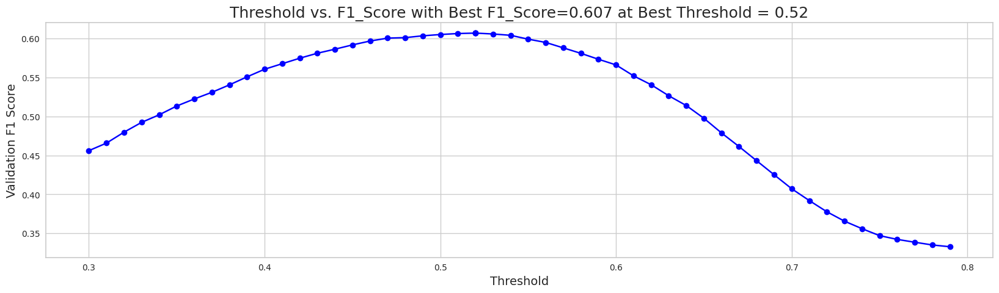

When using optimal threshold = 0.52...
Q0: F1 = 0.6071719042509474
==> Overall F1 = 0.6071719042509474
s
[I 2023-05-23 02:15:39,279] Trial 2 finished with value: 0.6071719042509474 and parameters: {'num_leaves': 52, 'learning_rate': 0.1199535602516653, 'feature_fraction': 0.6654972538632543, 'bagging_fraction': 0.1769486912960942, 'bagging_freq': 8, 'min_child_samples': 85, 'reg_alpha': 7.25091206620254, 'reg_lambda': 0.10945922494363554, 'subsample': 0.37729368488532156, 'colsample_bytree': 0.6427835520260996, 'min_split_gain': 0.22618326664209934, 'max_depth': 4}. Best is trial 2 with value: 0.6071719042509474.


--------------------------------------------------
question10, with210features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.6309554501070678, subsample=0.14845552549824712 will be ignored. Current value: bagging_fraction=0.6309554501070678
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=7, subsample_freq=0 will be ignored. Current value: bagging_freq=7
[LightGBM] [Warning] feature_fraction is set=0.5211782595552993, colsample_bytree=0.788183533498522 will be ignored. Current value: feature_fraction=0.5211782595552993


,mean
feature,
11_level_counts,10.0
tunic.historicalsociety.frontdesk_room_fqid_counts,8.4
basic_name_counts,5.4
room_corr_x_diff_std,5.0
elapsed_time_diff_std,5.0
tunic.historicalsociety.stacks_room_fqid_counts,5.0
session_number,4.6
reader_fqid_counts,4.4
logbook_fqid_counts,4.2


[[0.77282139 0.22717861]
 [0.55568237 0.44431763]
 [0.46785203 0.53214797]
 ...
 [0.30634262 0.69365738]
 [0.32142729 0.67857271]
 [0.5433017  0.4566983 ]]


[LightGBM] [Warning] bagging_fraction is set=0.6309554501070678, subsample=0.14845552549824712 will be ignored. Current value: bagging_fraction=0.6309554501070678
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=7, subsample_freq=0 will be ignored. Current value: bagging_freq=7
[LightGBM] [Warning] feature_fraction is set=0.5211782595552993, colsample_bytree=0.788183533498522 will be ignored. Current value: feature_fraction=0.5211782595552993


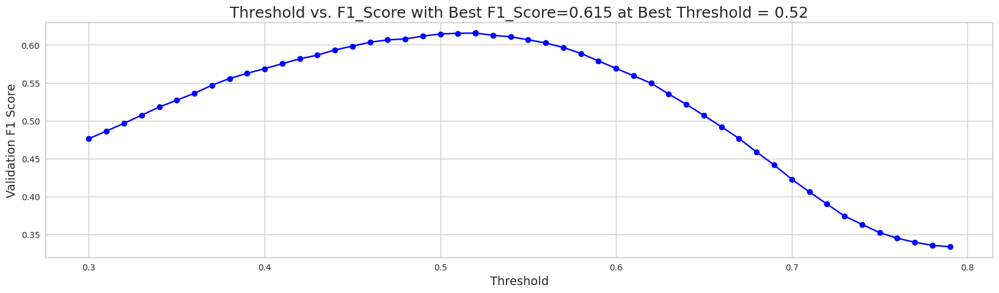

When using optimal threshold = 0.52...
Q0: F1 = 0.6154446281043189
==> Overall F1 = 0.6154446281043189
s
[I 2023-05-23 02:15:44,739] Trial 1 finished with value: 0.6154446281043189 and parameters: {'num_leaves': 47, 'learning_rate': 0.12974150997947384, 'feature_fraction': 0.28594997833334224, 'bagging_fraction': 0.21864339945848457, 'bagging_freq': 7, 'min_child_samples': 10, 'reg_alpha': 3.468030322929987, 'reg_lambda': 0.0334061931979795, 'subsample': 0.7027533780705595, 'colsample_bytree': 0.13835103606390972, 'min_split_gain': 0.15067361323320844, 'max_depth': 2}. Best is trial 1 with value: 0.6154446281043189.


--------------------------------------------------
question10, with210features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.7803378318956803, subsample=0.2052762246247975 will be ignored. Current value: bagging_fraction=0.7803378318956803
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.6371976765423667, colsample_bytree=0.7925353381472325 will be ignored. Current value: feature_fraction=0.6371976765423667


[LightGBM] [Warning] bagging_fraction is set=0.3804461668591589, subsample=0.814681725365389 will be ignored. Current value: bagging_fraction=0.3804461668591589
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.828144707281607, colsample_bytree=0.29874293443317146 will be ignored. Current value: feature_fraction=0.828144707281607


[LightGBM] [Warning] bagging_fraction is set=0.529809142952253, subsample=0.6819814346904234 will be ignored. Current value: bagging_fraction=0.529809142952253
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=10, subsample_freq=0 will be ignored. Current value: bagging_freq=10
[LightGBM] [Warning] feature_fraction is set=0.21272881539712132, colsample_bytree=0.6967438836457903 will be ignored. Current value: feature_fraction=0.21272881539712132


[LightGBM] [Warning] bagging_fraction is set=0.6309554501070678, subsample=0.14845552549824712 will be ignored. Current value: bagging_fraction=0.6309554501070678
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=7, subsample_freq=0 will be ignored. Current value: bagging_freq=7
[LightGBM] [Warning] feature_fraction is set=0.5211782595552993, colsample_bytree=0.788183533498522 will be ignored. Current value: feature_fraction=0.5211782595552993


[LightGBM] [Warning] bagging_fraction is set=0.529809142952253, subsample=0.6819814346904234 will be ignored. Current value: bagging_fraction=0.529809142952253
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=10, subsample_freq=0 will be ignored. Current value: bagging_freq=10
[LightGBM] [Warning] feature_fraction is set=0.21272881539712132, colsample_bytree=0.6967438836457903 will be ignored. Current value: feature_fraction=0.21272881539712132


[LightGBM] [Warning] bagging_fraction is set=0.6309554501070678, subsample=0.14845552549824712 will be ignored. Current value: bagging_fraction=0.6309554501070678
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=7, subsample_freq=0 will be ignored. Current value: bagging_freq=7
[LightGBM] [Warning] feature_fraction is set=0.5211782595552993, colsample_bytree=0.788183533498522 will be ignored. Current value: feature_fraction=0.5211782595552993


[LightGBM] [Warning] bagging_fraction is set=0.6309554501070678, subsample=0.14845552549824712 will be ignored. Current value: bagging_fraction=0.6309554501070678
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=7, subsample_freq=0 will be ignored. Current value: bagging_freq=7
[LightGBM] [Warning] feature_fraction is set=0.5211782595552993, colsample_bytree=0.788183533498522 will be ignored. Current value: feature_fraction=0.5211782595552993


,mean
feature,
elapsed_time_diff_mean,56.4
hover_duration_std,56.0
session_id,51.8
room_coor_y_max,47.2
hover_duration_max,44.4
room_coor_x_mean,40.4
screen_coor_y_max,37.8
hover_duration_mean,37.4
basic_name_counts,36.8


[[0.7743046  0.2256954 ]
 [0.59869757 0.40130243]
 [0.50488915 0.49511085]
 ...
 [0.32665951 0.67334049]
 [0.29948965 0.70051035]
 [0.53191162 0.46808838]]


[LightGBM] [Warning] bagging_fraction is set=0.7803378318956803, subsample=0.2052762246247975 will be ignored. Current value: bagging_fraction=0.7803378318956803
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.6371976765423667, colsample_bytree=0.7925353381472325 will be ignored. Current value: feature_fraction=0.6371976765423667


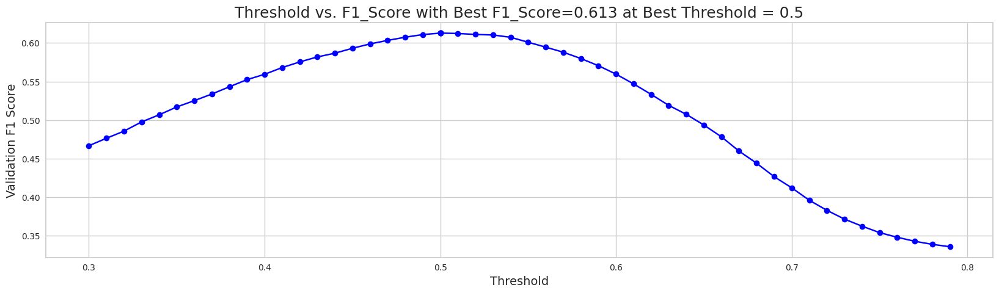

When using optimal threshold = 0.50...
Q0: F1 = 0.6127729257286723
==> Overall F1 = 0.6127729257286723
s
[I 2023-05-23 02:16:00,652] Trial 0 finished with value: 0.6127729257286723 and parameters: {'num_leaves': 80, 'learning_rate': 0.08259991497532884, 'feature_fraction': 0.21272881539712132, 'bagging_fraction': 0.529809142952253, 'bagging_freq': 10, 'min_child_samples': 58, 'reg_alpha': 0.00236411942408121, 'reg_lambda': 0.0015006007066701553, 'subsample': 0.6819814346904234, 'colsample_bytree': 0.6967438836457903, 'min_split_gain': 0.0019584713509115843, 'max_depth': 8}. Best is trial 1 with value: 0.6154446281043189.


--------------------------------------------------
question10, with210features
--------------------------------------------------


,mean
feature,
11_level_counts,14.8
tunic.historicalsociety.frontdesk_room_fqid_counts,12.2
basic_name_counts,10.2
elapsed_time_diff_std,9.6
elapsed_time_diff_mean,9.4
tunic.historicalsociety.stacks_room_fqid_counts,9.2
8_level_counts,8.8
room_coor_y_min,8.4
hover_duration_std,8.2


[[0.69315133 0.30684867]
 [0.52709692 0.47290308]
 [0.55000814 0.44999186]
 ...
 [0.37606305 0.62393695]
 [0.32704941 0.67295059]
 [0.48147719 0.51852281]]


[LightGBM] [Warning] bagging_fraction is set=0.7534834961921241, subsample=0.5248131124671722 will be ignored. Current value: bagging_fraction=0.7534834961921241
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
[LightGBM] [Warning] feature_fraction is set=0.6566854362021399, colsample_bytree=0.408396978976337 will be ignored. Current value: feature_fraction=0.6566854362021399


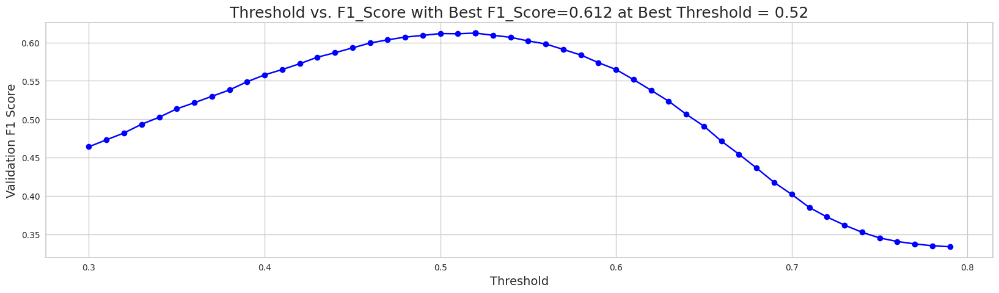

When using optimal threshold = 0.52...
Q0: F1 = 0.6122201382918813
==> Overall F1 = 0.6122201382918813
s
[I 2023-05-23 02:16:02,762] Trial 4 finished with value: 0.6122201382918813 and parameters: {'num_leaves': 48, 'learning_rate': 0.15395362960552014, 'feature_fraction': 0.5211782595552993, 'bagging_fraction': 0.6309554501070678, 'bagging_freq': 7, 'min_child_samples': 16, 'reg_alpha': 0.03068765019611883, 'reg_lambda': 0.1716592725597563, 'subsample': 0.14845552549824712, 'colsample_bytree': 0.788183533498522, 'min_split_gain': 0.0020506200956589317, 'max_depth': 5}. Best is trial 1 with value: 0.6154446281043189.


--------------------------------------------------
question10, with210features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.9505755094367833, subsample=0.8713627694829489 will be ignored. Current value: bagging_fraction=0.9505755094367833
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
[LightGBM] [Warning] feature_fraction is set=0.3123152739196564, colsample_bytree=0.6601639723880861 will be ignored. Current value: feature_fraction=0.3123152739196564


[LightGBM] [Warning] bagging_fraction is set=0.7803378318956803, subsample=0.2052762246247975 will be ignored. Current value: bagging_fraction=0.7803378318956803
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.6371976765423667, colsample_bytree=0.7925353381472325 will be ignored. Current value: feature_fraction=0.6371976765423667


[LightGBM] [Warning] bagging_fraction is set=0.3804461668591589, subsample=0.814681725365389 will be ignored. Current value: bagging_fraction=0.3804461668591589
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.828144707281607, colsample_bytree=0.29874293443317146 will be ignored. Current value: feature_fraction=0.828144707281607


[LightGBM] [Warning] bagging_fraction is set=0.9505755094367833, subsample=0.8713627694829489 will be ignored. Current value: bagging_fraction=0.9505755094367833
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
[LightGBM] [Warning] feature_fraction is set=0.3123152739196564, colsample_bytree=0.6601639723880861 will be ignored. Current value: feature_fraction=0.3123152739196564


[LightGBM] [Warning] bagging_fraction is set=0.7803378318956803, subsample=0.2052762246247975 will be ignored. Current value: bagging_fraction=0.7803378318956803
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.6371976765423667, colsample_bytree=0.7925353381472325 will be ignored. Current value: feature_fraction=0.6371976765423667


[LightGBM] [Warning] bagging_fraction is set=0.7534834961921241, subsample=0.5248131124671722 will be ignored. Current value: bagging_fraction=0.7534834961921241
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
[LightGBM] [Warning] feature_fraction is set=0.6566854362021399, colsample_bytree=0.408396978976337 will be ignored. Current value: feature_fraction=0.6566854362021399


[LightGBM] [Warning] bagging_fraction is set=0.9505755094367833, subsample=0.8713627694829489 will be ignored. Current value: bagging_fraction=0.9505755094367833
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
[LightGBM] [Warning] feature_fraction is set=0.3123152739196564, colsample_bytree=0.6601639723880861 will be ignored. Current value: feature_fraction=0.3123152739196564


,mean
feature,
tunic.historicalsociety.frontdesk_room_fqid_counts,149.6
11_level_counts,143.6
elapsed_time_diff_std,129.2
tunic.historicalsociety.stacks_room_fqid_counts,115.6
elapsed_time_diff_mean,111.4
hover_duration_mean,110.6
room_corr_x_diff_std,108.8
screen_coor_y_min,101.6
8_level_counts,100.2


[[0.70547179 0.29452821]
 [0.58729358 0.41270642]
 [0.43123156 0.56876844]
 ...
 [0.3861525  0.6138475 ]
 [0.30443617 0.69556383]
 [0.52157314 0.47842686]]


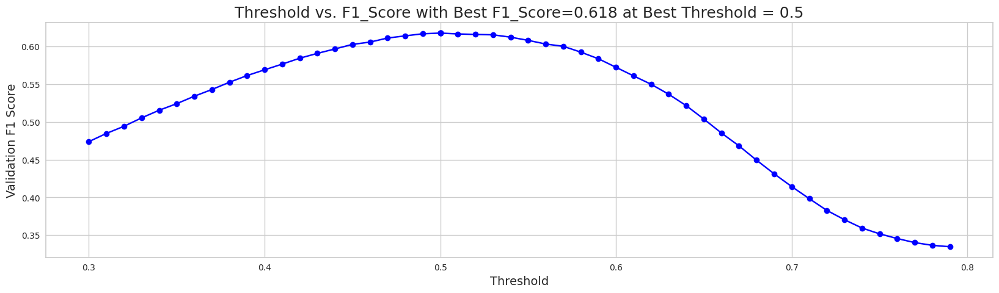

When using optimal threshold = 0.50...
Q0: F1 = 0.6178753280121745
==> Overall F1 = 0.6178753280121745
s
[I 2023-05-23 02:16:58,819] Trial 3 finished with value: 0.6178753280121745 and parameters: {'num_leaves': 52, 'learning_rate': 0.02072032183409544, 'feature_fraction': 0.6371976765423667, 'bagging_fraction': 0.7803378318956803, 'bagging_freq': 3, 'min_child_samples': 35, 'reg_alpha': 0.0035890190189726986, 'reg_lambda': 0.9337529491424827, 'subsample': 0.2052762246247975, 'colsample_bytree': 0.7925353381472325, 'min_split_gain': 0.025249797000925726, 'max_depth': 5}. Best is trial 3 with value: 0.6178753280121745.


--------------------------------------------------
question10, with210features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.15126926423056558, subsample=0.13416719705999625 will be ignored. Current value: bagging_fraction=0.15126926423056558
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=9, subsample_freq=0 will be ignored. Current value: bagging_freq=9
[LightGBM] [Warning] feature_fraction is set=0.2787536259073986, colsample_bytree=0.683118972196786 will be ignored. Current value: feature_fraction=0.2787536259073986


[LightGBM] [Warning] bagging_fraction is set=0.3804461668591589, subsample=0.814681725365389 will be ignored. Current value: bagging_fraction=0.3804461668591589
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.828144707281607, colsample_bytree=0.29874293443317146 will be ignored. Current value: feature_fraction=0.828144707281607


[LightGBM] [Warning] bagging_fraction is set=0.7534834961921241, subsample=0.5248131124671722 will be ignored. Current value: bagging_fraction=0.7534834961921241
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
[LightGBM] [Warning] feature_fraction is set=0.6566854362021399, colsample_bytree=0.408396978976337 will be ignored. Current value: feature_fraction=0.6566854362021399


[LightGBM] [Warning] bagging_fraction is set=0.15126926423056558, subsample=0.13416719705999625 will be ignored. Current value: bagging_fraction=0.15126926423056558
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=9, subsample_freq=0 will be ignored. Current value: bagging_freq=9
[LightGBM] [Warning] feature_fraction is set=0.2787536259073986, colsample_bytree=0.683118972196786 will be ignored. Current value: feature_fraction=0.2787536259073986


[LightGBM] [Warning] bagging_fraction is set=0.15126926423056558, subsample=0.13416719705999625 will be ignored. Current value: bagging_fraction=0.15126926423056558
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=9, subsample_freq=0 will be ignored. Current value: bagging_freq=9
[LightGBM] [Warning] feature_fraction is set=0.2787536259073986, colsample_bytree=0.683118972196786 will be ignored. Current value: feature_fraction=0.2787536259073986


[LightGBM] [Warning] bagging_fraction is set=0.15126926423056558, subsample=0.13416719705999625 will be ignored. Current value: bagging_fraction=0.15126926423056558
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=9, subsample_freq=0 will be ignored. Current value: bagging_freq=9
[LightGBM] [Warning] feature_fraction is set=0.2787536259073986, colsample_bytree=0.683118972196786 will be ignored. Current value: feature_fraction=0.2787536259073986


[LightGBM] [Warning] bagging_fraction is set=0.15126926423056558, subsample=0.13416719705999625 will be ignored. Current value: bagging_fraction=0.15126926423056558
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=9, subsample_freq=0 will be ignored. Current value: bagging_freq=9
[LightGBM] [Warning] feature_fraction is set=0.2787536259073986, colsample_bytree=0.683118972196786 will be ignored. Current value: feature_fraction=0.2787536259073986


,mean
feature,
elapsed_time_diff_mean,8.2
screen_coor_x_max,6.4
11_level_counts,6.0
room_corr_y_diff_mean,5.8
room_coor_x_min,5.4
room_corr_y_diff_std,5.2
tunic.historicalsociety.closet_dirty_room_fqid_counts,5.0
room_coor_x_mean,5.0
session_id,5.0


[[0.81277161 0.18722839]
 [0.4347155  0.5652845 ]
 [0.40557262 0.59442738]
 ...
 [0.49802493 0.50197507]
 [0.31673061 0.68326939]
 [0.48260441 0.51739559]]


[LightGBM] [Warning] bagging_fraction is set=0.9505755094367833, subsample=0.8713627694829489 will be ignored. Current value: bagging_fraction=0.9505755094367833
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
[LightGBM] [Warning] feature_fraction is set=0.3123152739196564, colsample_bytree=0.6601639723880861 will be ignored. Current value: feature_fraction=0.3123152739196564


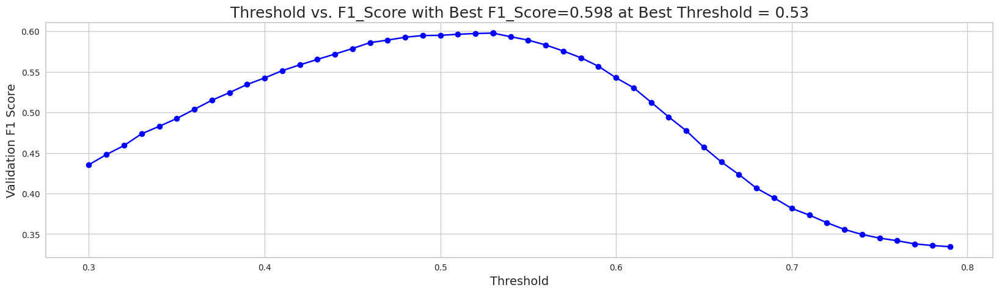

When using optimal threshold = 0.53...
Q0: F1 = 0.5977057678517269
==> Overall F1 = 0.5977057678517269
s
[I 2023-05-23 02:17:22,362] Trial 8 finished with value: 0.5977057678517269 and parameters: {'num_leaves': 84, 'learning_rate': 0.2652313426598923, 'feature_fraction': 0.2787536259073986, 'bagging_fraction': 0.15126926423056558, 'bagging_freq': 9, 'min_child_samples': 19, 'reg_alpha': 3.735169914299823, 'reg_lambda': 8.015096141078685, 'subsample': 0.13416719705999625, 'colsample_bytree': 0.683118972196786, 'min_split_gain': 0.1982248875031884, 'max_depth': 5}. Best is trial 3 with value: 0.6178753280121745.


--------------------------------------------------
question10, with210features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.8653376481147026, subsample=0.5442549562850089 will be ignored. Current value: bagging_fraction=0.8653376481147026
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7281689587093481, colsample_bytree=0.23277610246686353 will be ignored. Current value: feature_fraction=0.7281689587093481


[LightGBM] [Warning] bagging_fraction is set=0.7534834961921241, subsample=0.5248131124671722 will be ignored. Current value: bagging_fraction=0.7534834961921241
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
[LightGBM] [Warning] feature_fraction is set=0.6566854362021399, colsample_bytree=0.408396978976337 will be ignored. Current value: feature_fraction=0.6566854362021399


[LightGBM] [Warning] bagging_fraction is set=0.3804461668591589, subsample=0.814681725365389 will be ignored. Current value: bagging_fraction=0.3804461668591589
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.828144707281607, colsample_bytree=0.29874293443317146 will be ignored. Current value: feature_fraction=0.828144707281607


[LightGBM] [Warning] bagging_fraction is set=0.9505755094367833, subsample=0.8713627694829489 will be ignored. Current value: bagging_fraction=0.9505755094367833
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
[LightGBM] [Warning] feature_fraction is set=0.3123152739196564, colsample_bytree=0.6601639723880861 will be ignored. Current value: feature_fraction=0.3123152739196564


[LightGBM] [Warning] bagging_fraction is set=0.7534834961921241, subsample=0.5248131124671722 will be ignored. Current value: bagging_fraction=0.7534834961921241
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
[LightGBM] [Warning] feature_fraction is set=0.6566854362021399, colsample_bytree=0.408396978976337 will be ignored. Current value: feature_fraction=0.6566854362021399


,mean
feature,
elapsed_time_diff_std,342.6
11_level_counts,324.2
hover_duration_mean,317.6
hover_duration_max,311.8
room_coor_y_min,309.2
hover_duration_std,308.2
hover_duration_sum,294.0
elapsed_time_diff_mean,293.8
screen_coor_x_mean,293.6


[LightGBM] [Warning] bagging_fraction is set=0.3804461668591589, subsample=0.814681725365389 will be ignored. Current value: bagging_fraction=0.3804461668591589
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.828144707281607, colsample_bytree=0.29874293443317146 will be ignored. Current value: feature_fraction=0.828144707281607


[[0.68153286 0.31846714]
 [0.55480523 0.44519477]
 [0.44741402 0.55258598]
 ...
 [0.37415358 0.62584642]
 [0.30328385 0.69671615]
 [0.45681393 0.54318607]]


,mean
feature,
11_level_counts,58.2
elapsed_time_diff_std,49.4
logbook_fqid_counts,42.8
tunic.historicalsociety.frontdesk_room_fqid_counts,42.0
room_corr_x_diff_std,41.4
8_level_counts,37.4
reader_fqid_counts,36.0
tunic.historicalsociety.closet_dirty.gramps.archivist_text_fqid_counts,34.2
reader.paper1.next_fqid_counts,33.4


[LightGBM] [Warning] bagging_fraction is set=0.8653376481147026, subsample=0.5442549562850089 will be ignored. Current value: bagging_fraction=0.8653376481147026
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7281689587093481, colsample_bytree=0.23277610246686353 will be ignored. Current value: feature_fraction=0.7281689587093481


[[0.68156687 0.31843313]
 [0.58078558 0.41921442]
 [0.43506987 0.56493013]
 ...
 [0.34152768 0.65847232]
 [0.31774331 0.68225669]
 [0.46129377 0.53870623]]


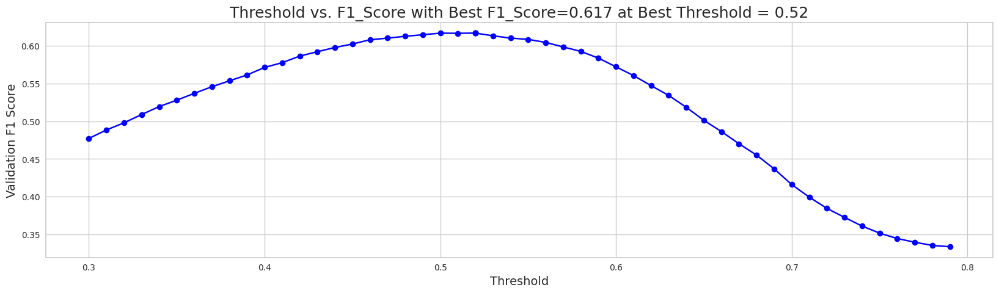

When using optimal threshold = 0.52...
Q0: F1 = 0.6171321400265237
==> Overall F1 = 0.6171321400265237
s
[I 2023-05-23 02:18:17,593] Trial 7 finished with value: 0.6171321400265237 and parameters: {'num_leaves': 87, 'learning_rate': 0.01671992494232502, 'feature_fraction': 0.3123152739196564, 'bagging_fraction': 0.9505755094367833, 'bagging_freq': 4, 'min_child_samples': 5, 'reg_alpha': 0.09099678777208785, 'reg_lambda': 0.17995917157329247, 'subsample': 0.8713627694829489, 'colsample_bytree': 0.6601639723880861, 'min_split_gain': 0.03849883711362856, 'max_depth': 10}. Best is trial 3 with value: 0.6178753280121745.


--------------------------------------------------
question10, with210features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.9965528481378287, subsample=0.9929398619914949 will be ignored. Current value: bagging_fraction=0.9965528481378287
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=9, subsample_freq=0 will be ignored. Current value: bagging_freq=9
[LightGBM] [Warning] feature_fraction is set=0.853585348417631, colsample_bytree=0.9247186271004051 will be ignored. Current value: feature_fraction=0.853585348417631


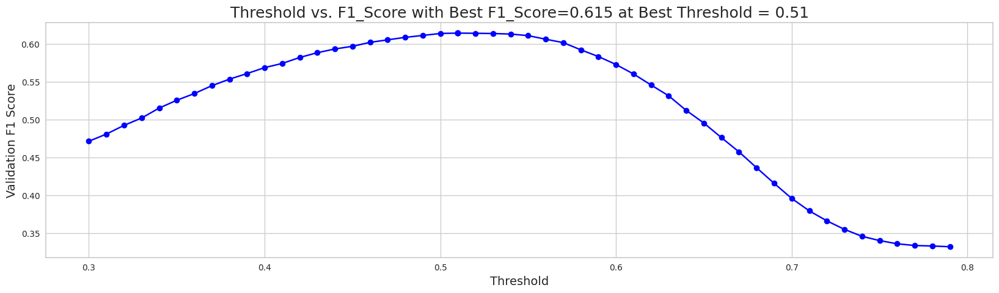

When using optimal threshold = 0.51...
Q0: F1 = 0.6146053278130641
==> Overall F1 = 0.6146053278130641
s
[I 2023-05-23 02:18:19,256] Trial 6 finished with value: 0.6146053278130641 and parameters: {'num_leaves': 10, 'learning_rate': 0.017416967852108632, 'feature_fraction': 0.6566854362021399, 'bagging_fraction': 0.7534834961921241, 'bagging_freq': 4, 'min_child_samples': 69, 'reg_alpha': 0.01781825171465787, 'reg_lambda': 0.005442536942430655, 'subsample': 0.5248131124671722, 'colsample_bytree': 0.408396978976337, 'min_split_gain': 0.0074191966010689675, 'max_depth': 1}. Best is trial 3 with value: 0.6178753280121745.


--------------------------------------------------
question10, with210features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.13887723140515745, subsample=0.364316266087094 will be ignored. Current value: bagging_fraction=0.13887723140515745
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.7997287986774827, colsample_bytree=0.602385730631259 will be ignored. Current value: feature_fraction=0.7997287986774827


[LightGBM] [Warning] bagging_fraction is set=0.13887723140515745, subsample=0.364316266087094 will be ignored. Current value: bagging_fraction=0.13887723140515745
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.7997287986774827, colsample_bytree=0.602385730631259 will be ignored. Current value: feature_fraction=0.7997287986774827


[LightGBM] [Warning] bagging_fraction is set=0.13887723140515745, subsample=0.364316266087094 will be ignored. Current value: bagging_fraction=0.13887723140515745
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.7997287986774827, colsample_bytree=0.602385730631259 will be ignored. Current value: feature_fraction=0.7997287986774827


[LightGBM] [Warning] bagging_fraction is set=0.13887723140515745, subsample=0.364316266087094 will be ignored. Current value: bagging_fraction=0.13887723140515745
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.7997287986774827, colsample_bytree=0.602385730631259 will be ignored. Current value: feature_fraction=0.7997287986774827


[LightGBM] [Warning] bagging_fraction is set=0.13887723140515745, subsample=0.364316266087094 will be ignored. Current value: bagging_fraction=0.13887723140515745
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.7997287986774827, colsample_bytree=0.602385730631259 will be ignored. Current value: feature_fraction=0.7997287986774827


,mean
feature,
elapsed_time_diff_std,379.4
hover_duration_mean,365.4
session_id,357.6
room_coor_x_max,353.2
room_coor_y_max,351.2
screen_coor_x_std,335.4
hover_duration_sum,331.0
hover_duration_max,330.0
room_coor_y_min,328.4


[[0.62193728 0.37806272]
 [0.56066594 0.43933406]
 [0.46947659 0.53052341]
 ...
 [0.38691047 0.61308953]
 [0.31493113 0.68506887]
 [0.55872477 0.44127523]]


,mean
feature,
room_coor_x_max,43.2
session_id,41.8
room_coor_x_min,36.0
room_coor_y_max,36.0
room_coor_y_min,35.6
elapsed_time_diff_std,35.6
hover_duration_std,35.0
screen_coor_y_min,34.8
11_level_counts,34.8


[[0.62323273 0.37676727]
 [0.47211354 0.52788646]
 [0.45289155 0.54710845]
 ...
 [0.35094324 0.64905676]
 [0.33599532 0.66400468]
 [0.49425693 0.50574307]]


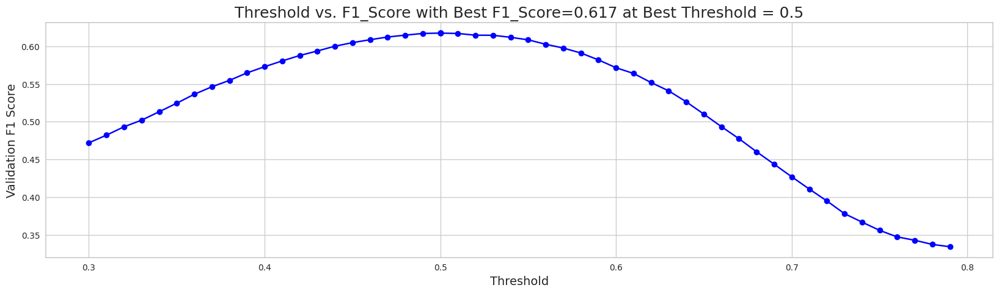

When using optimal threshold = 0.50...
Q0: F1 = 0.6173764795645598
==> Overall F1 = 0.6173764795645598
s
[I 2023-05-23 02:18:53,364] Trial 5 finished with value: 0.6173764795645598 and parameters: {'num_leaves': 100, 'learning_rate': 0.010794539942460095, 'feature_fraction': 0.828144707281607, 'bagging_fraction': 0.3804461668591589, 'bagging_freq': 3, 'min_child_samples': 89, 'reg_alpha': 0.03173846611368043, 'reg_lambda': 1.2055302401672825, 'subsample': 0.814681725365389, 'colsample_bytree': 0.29874293443317146, 'min_split_gain': 0.0031197754780251242, 'max_depth': 0}. Best is trial 3 with value: 0.6178753280121745.


--------------------------------------------------
question10, with210features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.3771894908682568, subsample=0.4458632350965691 will be ignored. Current value: bagging_fraction=0.3771894908682568
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8372611968393041, colsample_bytree=0.8781744200609514 will be ignored. Current value: feature_fraction=0.8372611968393041


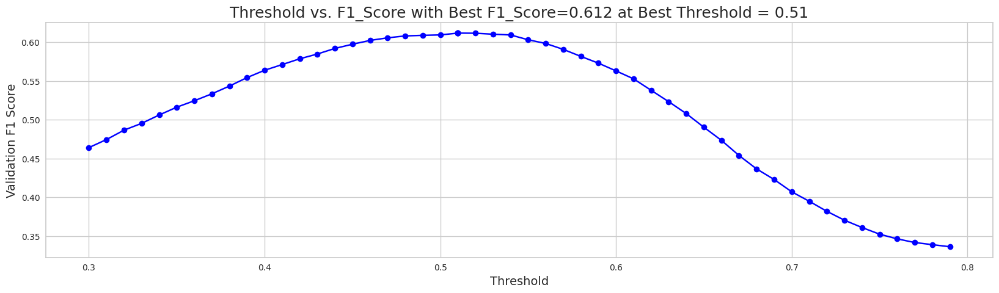

When using optimal threshold = 0.51...
Q0: F1 = 0.6117779981233904
==> Overall F1 = 0.6117779981233904
s
[I 2023-05-23 02:18:54,560] Trial 11 finished with value: 0.6117779981233904 and parameters: {'num_leaves': 58, 'learning_rate': 0.045076962417078724, 'feature_fraction': 0.7997287986774827, 'bagging_fraction': 0.13887723140515745, 'bagging_freq': 1, 'min_child_samples': 15, 'reg_alpha': 0.24974277518546156, 'reg_lambda': 0.001215743873547191, 'subsample': 0.364316266087094, 'colsample_bytree': 0.602385730631259, 'min_split_gain': 0.13139861907888822, 'max_depth': 6}. Best is trial 3 with value: 0.6178753280121745.


--------------------------------------------------
question10, with210features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.918025397586699, subsample=0.9819617545326709 will be ignored. Current value: bagging_fraction=0.918025397586699
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9635038752118776, colsample_bytree=0.9834604459312994 will be ignored. Current value: feature_fraction=0.9635038752118776


[LightGBM] [Warning] bagging_fraction is set=0.9965528481378287, subsample=0.9929398619914949 will be ignored. Current value: bagging_fraction=0.9965528481378287
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=9, subsample_freq=0 will be ignored. Current value: bagging_freq=9
[LightGBM] [Warning] feature_fraction is set=0.853585348417631, colsample_bytree=0.9247186271004051 will be ignored. Current value: feature_fraction=0.853585348417631


[LightGBM] [Warning] bagging_fraction is set=0.8653376481147026, subsample=0.5442549562850089 will be ignored. Current value: bagging_fraction=0.8653376481147026
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7281689587093481, colsample_bytree=0.23277610246686353 will be ignored. Current value: feature_fraction=0.7281689587093481


[LightGBM] [Warning] bagging_fraction is set=0.3771894908682568, subsample=0.4458632350965691 will be ignored. Current value: bagging_fraction=0.3771894908682568
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8372611968393041, colsample_bytree=0.8781744200609514 will be ignored. Current value: feature_fraction=0.8372611968393041


[LightGBM] [Warning] bagging_fraction is set=0.918025397586699, subsample=0.9819617545326709 will be ignored. Current value: bagging_fraction=0.918025397586699
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9635038752118776, colsample_bytree=0.9834604459312994 will be ignored. Current value: feature_fraction=0.9635038752118776


[LightGBM] [Warning] bagging_fraction is set=0.3771894908682568, subsample=0.4458632350965691 will be ignored. Current value: bagging_fraction=0.3771894908682568
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8372611968393041, colsample_bytree=0.8781744200609514 will be ignored. Current value: feature_fraction=0.8372611968393041


[LightGBM] [Warning] bagging_fraction is set=0.918025397586699, subsample=0.9819617545326709 will be ignored. Current value: bagging_fraction=0.918025397586699
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9635038752118776, colsample_bytree=0.9834604459312994 will be ignored. Current value: feature_fraction=0.9635038752118776


[LightGBM] [Warning] bagging_fraction is set=0.9965528481378287, subsample=0.9929398619914949 will be ignored. Current value: bagging_fraction=0.9965528481378287
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=9, subsample_freq=0 will be ignored. Current value: bagging_freq=9
[LightGBM] [Warning] feature_fraction is set=0.853585348417631, colsample_bytree=0.9247186271004051 will be ignored. Current value: feature_fraction=0.853585348417631


[LightGBM] [Warning] bagging_fraction is set=0.3771894908682568, subsample=0.4458632350965691 will be ignored. Current value: bagging_fraction=0.3771894908682568
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8372611968393041, colsample_bytree=0.8781744200609514 will be ignored. Current value: feature_fraction=0.8372611968393041


[LightGBM] [Warning] bagging_fraction is set=0.918025397586699, subsample=0.9819617545326709 will be ignored. Current value: bagging_fraction=0.918025397586699
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9635038752118776, colsample_bytree=0.9834604459312994 will be ignored. Current value: feature_fraction=0.9635038752118776


[LightGBM] [Warning] bagging_fraction is set=0.8653376481147026, subsample=0.5442549562850089 will be ignored. Current value: bagging_fraction=0.8653376481147026
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7281689587093481, colsample_bytree=0.23277610246686353 will be ignored. Current value: feature_fraction=0.7281689587093481


[LightGBM] [Warning] bagging_fraction is set=0.3771894908682568, subsample=0.4458632350965691 will be ignored. Current value: bagging_fraction=0.3771894908682568
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8372611968393041, colsample_bytree=0.8781744200609514 will be ignored. Current value: feature_fraction=0.8372611968393041


[LightGBM] [Warning] bagging_fraction is set=0.918025397586699, subsample=0.9819617545326709 will be ignored. Current value: bagging_fraction=0.918025397586699
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9635038752118776, colsample_bytree=0.9834604459312994 will be ignored. Current value: feature_fraction=0.9635038752118776


,mean
feature,
elapsed_time_diff_std,109.4
hover_duration_mean,105.6
room_coor_x_max,105.2
hover_duration_max,105.0
11_level_counts,105.0
room_coor_y_max,103.4
session_id,101.6
room_coor_y_min,96.8
room_coor_y_std,96.0


[[0.6623138  0.3376862 ]
 [0.52732415 0.47267585]
 [0.47534471 0.52465529]
 ...
 [0.40401682 0.59598318]
 [0.33444903 0.66555097]
 [0.51793819 0.48206181]]


[LightGBM] [Warning] bagging_fraction is set=0.9965528481378287, subsample=0.9929398619914949 will be ignored. Current value: bagging_fraction=0.9965528481378287
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=9, subsample_freq=0 will be ignored. Current value: bagging_freq=9
[LightGBM] [Warning] feature_fraction is set=0.853585348417631, colsample_bytree=0.9247186271004051 will be ignored. Current value: feature_fraction=0.853585348417631


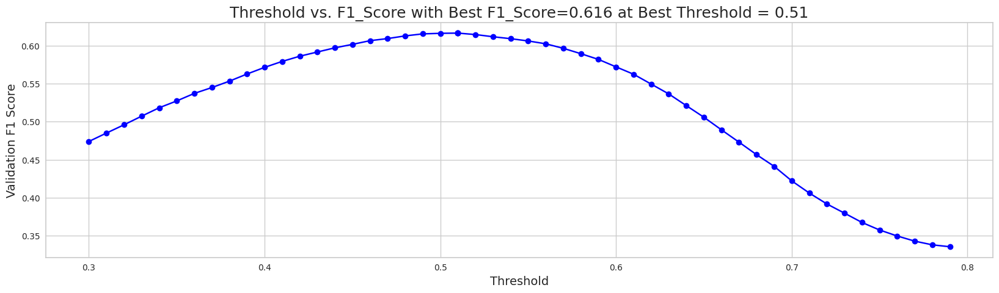

When using optimal threshold = 0.51...
Q0: F1 = 0.6164145418248208
==> Overall F1 = 0.6164145418248208
s
[I 2023-05-23 02:20:12,926] Trial 12 finished with value: 0.6164145418248208 and parameters: {'num_leaves': 76, 'learning_rate': 0.0298945866531719, 'feature_fraction': 0.8372611968393041, 'bagging_fraction': 0.3771894908682568, 'bagging_freq': 2, 'min_child_samples': 83, 'reg_alpha': 0.01684635651724596, 'reg_lambda': 1.2936887082966568, 'subsample': 0.4458632350965691, 'colsample_bytree': 0.8781744200609514, 'min_split_gain': 0.006577297670112993, 'max_depth': 9}. Best is trial 3 with value: 0.6178753280121745.


--------------------------------------------------
question10, with210features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.4222850440377387, subsample=0.9242702348320784 will be ignored. Current value: bagging_fraction=0.4222850440377387
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.9917860782905545, colsample_bytree=0.9876215059363501 will be ignored. Current value: feature_fraction=0.9917860782905545


,mean
feature,
tunic.historicalsociety.frontdesk_room_fqid_counts,100.6
elapsed_time_diff_std,86.0
11_level_counts,86.0
room_corr_x_diff_std,77.6
elapsed_time_diff_mean,69.4
logbook_fqid_counts,63.4
8_level_counts,61.6
elapsed_time_diff_sum,61.2
tunic.historicalsociety.stacks_room_fqid_counts,60.6


[[0.70971312 0.29028688]
 [0.53966295 0.46033705]
 [0.45974236 0.54025764]
 ...
 [0.36952719 0.63047281]
 [0.31303357 0.68696643]
 [0.496154   0.503846  ]]


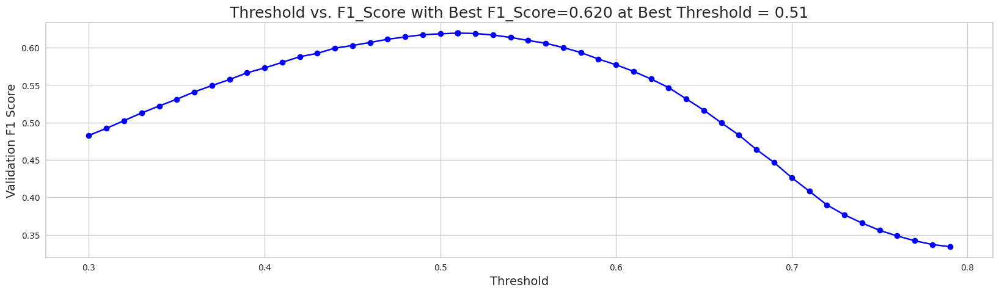

When using optimal threshold = 0.51...
Q0: F1 = 0.6195710949259253
==> Overall F1 = 0.6195710949259253
s
[I 2023-05-23 02:20:24,695] Trial 13 finished with value: 0.6195710949259253 and parameters: {'num_leaves': 26, 'learning_rate': 0.03732373187888877, 'feature_fraction': 0.9635038752118776, 'bagging_fraction': 0.918025397586699, 'bagging_freq': 1, 'min_child_samples': 37, 'reg_alpha': 0.0010461435232678364, 'reg_lambda': 8.239037467785025, 'subsample': 0.9819617545326709, 'colsample_bytree': 0.9834604459312994, 'min_split_gain': 0.8778503015865442, 'max_depth': 8}. Best is trial 13 with value: 0.6195710949259253.


--------------------------------------------------
question10, with210features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.9319645118399017, subsample=0.9551581959551996 will be ignored. Current value: bagging_fraction=0.9319645118399017
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9917221401572497, colsample_bytree=0.9912750023300032 will be ignored. Current value: feature_fraction=0.9917221401572497


[LightGBM] [Warning] bagging_fraction is set=0.8653376481147026, subsample=0.5442549562850089 will be ignored. Current value: bagging_fraction=0.8653376481147026
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7281689587093481, colsample_bytree=0.23277610246686353 will be ignored. Current value: feature_fraction=0.7281689587093481


[LightGBM] [Warning] bagging_fraction is set=0.9319645118399017, subsample=0.9551581959551996 will be ignored. Current value: bagging_fraction=0.9319645118399017
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9917221401572497, colsample_bytree=0.9912750023300032 will be ignored. Current value: feature_fraction=0.9917221401572497


[LightGBM] [Warning] bagging_fraction is set=0.9319645118399017, subsample=0.9551581959551996 will be ignored. Current value: bagging_fraction=0.9319645118399017
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9917221401572497, colsample_bytree=0.9912750023300032 will be ignored. Current value: feature_fraction=0.9917221401572497


[LightGBM] [Warning] bagging_fraction is set=0.9965528481378287, subsample=0.9929398619914949 will be ignored. Current value: bagging_fraction=0.9965528481378287
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=9, subsample_freq=0 will be ignored. Current value: bagging_freq=9
[LightGBM] [Warning] feature_fraction is set=0.853585348417631, colsample_bytree=0.9247186271004051 will be ignored. Current value: feature_fraction=0.853585348417631


,mean
feature,
elapsed_time_diff_std,374.2
hover_duration_mean,366.8
room_coor_x_max,350.6
room_coor_y_max,347.0
elapsed_time_diff_mean,326.8
room_corr_x_diff_std,325.4
hover_duration_sum,323.6
room_coor_x_std,322.8
session_id,322.2


[[0.71593978 0.28406022]
 [0.51767395 0.48232605]
 [0.44606337 0.55393663]
 ...
 [0.36278291 0.63721709]
 [0.32178077 0.67821923]
 [0.52681646 0.47318354]]


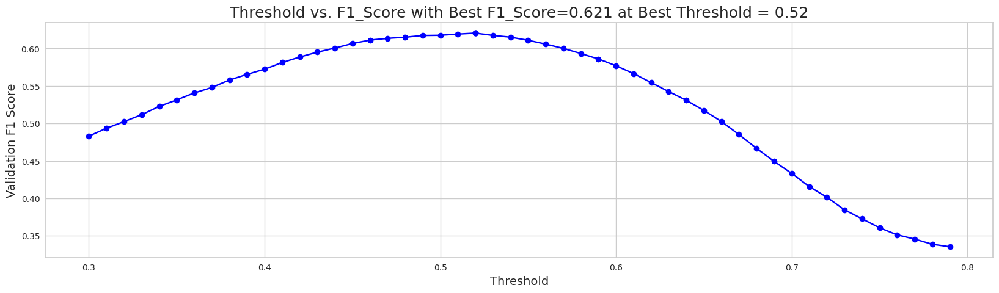

When using optimal threshold = 0.52...
Q0: F1 = 0.6205503068843321
==> Overall F1 = 0.6205503068843321
s
[I 2023-05-23 02:21:19,836] Trial 9 finished with value: 0.6205503068843321 and parameters: {'num_leaves': 82, 'learning_rate': 0.016021580914962676, 'feature_fraction': 0.7281689587093481, 'bagging_fraction': 0.8653376481147026, 'bagging_freq': 2, 'min_child_samples': 84, 'reg_alpha': 1.6598548263287682, 'reg_lambda': 0.00334647175146375, 'subsample': 0.5442549562850089, 'colsample_bytree': 0.23277610246686353, 'min_split_gain': 0.01272676545915691, 'max_depth': 0}. Best is trial 9 with value: 0.6205503068843321.


--------------------------------------------------
question10, with210features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.9975926170027146, subsample=0.9418732234171615 will be ignored. Current value: bagging_fraction=0.9975926170027146
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9788711986274576, colsample_bytree=0.9579039794385097 will be ignored. Current value: feature_fraction=0.9788711986274576


[LightGBM] [Warning] bagging_fraction is set=0.9319645118399017, subsample=0.9551581959551996 will be ignored. Current value: bagging_fraction=0.9319645118399017
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9917221401572497, colsample_bytree=0.9912750023300032 will be ignored. Current value: feature_fraction=0.9917221401572497


[LightGBM] [Warning] bagging_fraction is set=0.4222850440377387, subsample=0.9242702348320784 will be ignored. Current value: bagging_fraction=0.4222850440377387
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.9917860782905545, colsample_bytree=0.9876215059363501 will be ignored. Current value: feature_fraction=0.9917860782905545


[LightGBM] [Warning] bagging_fraction is set=0.9975926170027146, subsample=0.9418732234171615 will be ignored. Current value: bagging_fraction=0.9975926170027146
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9788711986274576, colsample_bytree=0.9579039794385097 will be ignored. Current value: feature_fraction=0.9788711986274576


[LightGBM] [Warning] bagging_fraction is set=0.9319645118399017, subsample=0.9551581959551996 will be ignored. Current value: bagging_fraction=0.9319645118399017
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9917221401572497, colsample_bytree=0.9912750023300032 will be ignored. Current value: feature_fraction=0.9917221401572497


,mean
feature,
elapsed_time_diff_std,438.4
tunic.historicalsociety.frontdesk_room_fqid_counts,404.2
room_coor_x_max,386.8
11_level_counts,386.4
room_coor_y_max,384.8
room_coor_x_std,382.4
hover_duration_mean,381.4
room_coor_y_min,377.6
screen_coor_y_min,374.2


[[0.71961433 0.28038567]
 [0.54392339 0.45607661]
 [0.48957965 0.51042035]
 ...
 [0.38208475 0.61791525]
 [0.32358446 0.67641554]
 [0.5335428  0.4664572 ]]


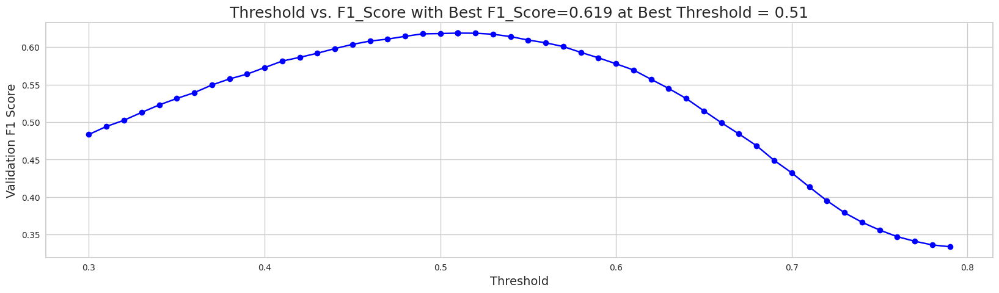

When using optimal threshold = 0.51...
Q0: F1 = 0.6186385273415898
==> Overall F1 = 0.6186385273415898
s
[I 2023-05-23 02:21:45,967] Trial 10 finished with value: 0.6186385273415898 and parameters: {'num_leaves': 74, 'learning_rate': 0.01375672587987472, 'feature_fraction': 0.853585348417631, 'bagging_fraction': 0.9965528481378287, 'bagging_freq': 9, 'min_child_samples': 34, 'reg_alpha': 4.523298403898803, 'reg_lambda': 0.30033912723192324, 'subsample': 0.9929398619914949, 'colsample_bytree': 0.9247186271004051, 'min_split_gain': 0.22475672160324467, 'max_depth': 9}. Best is trial 9 with value: 0.6205503068843321.


--------------------------------------------------
question10, with210features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.8916583939151005, subsample=0.6182508162963546 will be ignored. Current value: bagging_fraction=0.8916583939151005
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9906531595780053, colsample_bytree=0.4663976307120916 will be ignored. Current value: feature_fraction=0.9906531595780053


[LightGBM] [Warning] bagging_fraction is set=0.9975926170027146, subsample=0.9418732234171615 will be ignored. Current value: bagging_fraction=0.9975926170027146
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9788711986274576, colsample_bytree=0.9579039794385097 will be ignored. Current value: feature_fraction=0.9788711986274576


,mean
feature,
tunic.historicalsociety.frontdesk_room_fqid_counts,95.2
elapsed_time_diff_std,93.0
11_level_counts,83.8
room_corr_x_diff_std,79.8
elapsed_time_diff_mean,78.6
screen_coor_y_min,70.2
8_level_counts,70.0
room_coor_y_max,68.8
room_corr_y_diff_std,67.2


[[0.69812026 0.30187974]
 [0.52349693 0.47650307]
 [0.4625007  0.5374993 ]
 ...
 [0.34355926 0.65644074]
 [0.32336776 0.67663224]
 [0.53946736 0.46053264]]


[LightGBM] [Warning] bagging_fraction is set=0.8916583939151005, subsample=0.6182508162963546 will be ignored. Current value: bagging_fraction=0.8916583939151005
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9906531595780053, colsample_bytree=0.4663976307120916 will be ignored. Current value: feature_fraction=0.9906531595780053


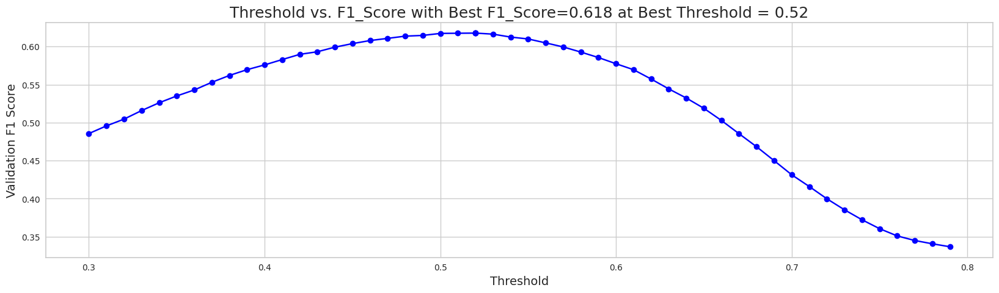

When using optimal threshold = 0.52...
Q0: F1 = 0.6176900242586306
==> Overall F1 = 0.6176900242586306
s
[I 2023-05-23 02:22:01,337] Trial 15 finished with value: 0.6176900242586306 and parameters: {'num_leaves': 22, 'learning_rate': 0.038511124073650926, 'feature_fraction': 0.9917221401572497, 'bagging_fraction': 0.9319645118399017, 'bagging_freq': 1, 'min_child_samples': 32, 'reg_alpha': 0.0010402424308375384, 'reg_lambda': 8.566290668109799, 'subsample': 0.9551581959551996, 'colsample_bytree': 0.9912750023300032, 'min_split_gain': 0.9813764325949927, 'max_depth': 7}. Best is trial 9 with value: 0.6205503068843321.


--------------------------------------------------
question10, with210features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.8368396980962093, subsample=0.6538406887511676 will be ignored. Current value: bagging_fraction=0.8368396980962093
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
[LightGBM] [Warning] feature_fraction is set=0.9997529030340717, colsample_bytree=0.4903038728609525 will be ignored. Current value: feature_fraction=0.9997529030340717


[LightGBM] [Warning] bagging_fraction is set=0.9975926170027146, subsample=0.9418732234171615 will be ignored. Current value: bagging_fraction=0.9975926170027146
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9788711986274576, colsample_bytree=0.9579039794385097 will be ignored. Current value: feature_fraction=0.9788711986274576


[LightGBM] [Warning] bagging_fraction is set=0.8916583939151005, subsample=0.6182508162963546 will be ignored. Current value: bagging_fraction=0.8916583939151005
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9906531595780053, colsample_bytree=0.4663976307120916 will be ignored. Current value: feature_fraction=0.9906531595780053


[LightGBM] [Warning] bagging_fraction is set=0.4222850440377387, subsample=0.9242702348320784 will be ignored. Current value: bagging_fraction=0.4222850440377387
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.9917860782905545, colsample_bytree=0.9876215059363501 will be ignored. Current value: feature_fraction=0.9917860782905545


[LightGBM] [Warning] bagging_fraction is set=0.8368396980962093, subsample=0.6538406887511676 will be ignored. Current value: bagging_fraction=0.8368396980962093
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
[LightGBM] [Warning] feature_fraction is set=0.9997529030340717, colsample_bytree=0.4903038728609525 will be ignored. Current value: feature_fraction=0.9997529030340717


[LightGBM] [Warning] bagging_fraction is set=0.9975926170027146, subsample=0.9418732234171615 will be ignored. Current value: bagging_fraction=0.9975926170027146
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9788711986274576, colsample_bytree=0.9579039794385097 will be ignored. Current value: feature_fraction=0.9788711986274576
[LightGBM] [Warning] bagging_fraction is set=0.8916583939151005, subsample=0.6182508162963546 will be ignored. Current value: bagging_fraction=0.8916583939151005
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] fe

[LightGBM] [Warning] bagging_fraction is set=0.8368396980962093, subsample=0.6538406887511676 will be ignored. Current value: bagging_fraction=0.8368396980962093
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
[LightGBM] [Warning] feature_fraction is set=0.9997529030340717, colsample_bytree=0.4903038728609525 will be ignored. Current value: feature_fraction=0.9997529030340717


,mean
feature,
tunic.historicalsociety.frontdesk_room_fqid_counts,74.2
11_level_counts,70.4
elapsed_time_diff_std,58.8
room_corr_x_diff_std,53.8
reader_fqid_counts,44.6
8_level_counts,41.4
elapsed_time_diff_mean,40.8
logbook_fqid_counts,40.6
hover_duration_max,40.4


[[0.67914963 0.32085037]
 [0.51790161 0.48209839]
 [0.4532213  0.5467787 ]
 ...
 [0.40171767 0.59828233]
 [0.28542996 0.71457004]
 [0.53668842 0.46331158]]


[LightGBM] [Warning] bagging_fraction is set=0.8916583939151005, subsample=0.6182508162963546 will be ignored. Current value: bagging_fraction=0.8916583939151005
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9906531595780053, colsample_bytree=0.4663976307120916 will be ignored. Current value: feature_fraction=0.9906531595780053


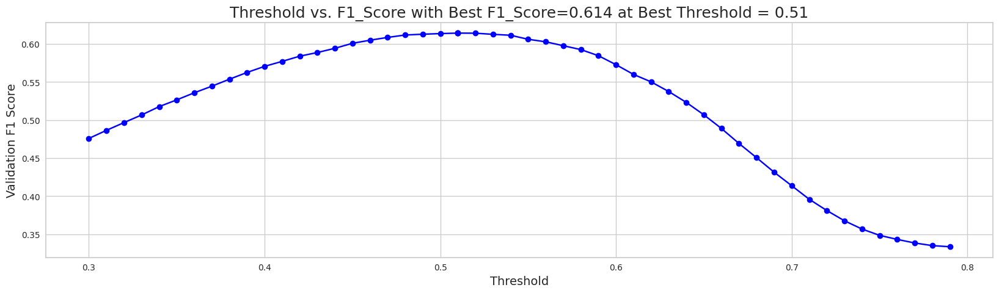

When using optimal threshold = 0.51...
Q0: F1 = 0.6143389727426969
==> Overall F1 = 0.6143389727426969
s
[I 2023-05-23 02:22:43,857] Trial 16 finished with value: 0.6143389727426969 and parameters: {'num_leaves': 19, 'learning_rate': 0.041627607898507175, 'feature_fraction': 0.9788711986274576, 'bagging_fraction': 0.9975926170027146, 'bagging_freq': 1, 'min_child_samples': 43, 'reg_alpha': 0.0010243419099557943, 'reg_lambda': 0.015914351571727953, 'subsample': 0.9418732234171615, 'colsample_bytree': 0.9579039794385097, 'min_split_gain': 0.8171381218769491, 'max_depth': -1}. Best is trial 9 with value: 0.6205503068843321.


--------------------------------------------------
question10, with210features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.8404113980004405, subsample=0.6475892860454973 will be ignored. Current value: bagging_fraction=0.8404113980004405
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
[LightGBM] [Warning] feature_fraction is set=0.9935435867485057, colsample_bytree=0.4340960755389389 will be ignored. Current value: feature_fraction=0.9935435867485057


[LightGBM] [Warning] bagging_fraction is set=0.8368396980962093, subsample=0.6538406887511676 will be ignored. Current value: bagging_fraction=0.8368396980962093
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
[LightGBM] [Warning] feature_fraction is set=0.9997529030340717, colsample_bytree=0.4903038728609525 will be ignored. Current value: feature_fraction=0.9997529030340717


,mean
feature,
tunic.historicalsociety.frontdesk_room_fqid_counts,79.8
11_level_counts,71.0
elapsed_time_diff_std,66.4
room_corr_x_diff_std,51.0
elapsed_time_diff_mean,47.8
tunic.historicalsociety.stacks_room_fqid_counts,46.8
logbook_fqid_counts,45.2
8_level_counts,44.6
reader_fqid_counts,43.8


[[0.68915845 0.31084155]
 [0.52910122 0.47089878]
 [0.41611279 0.58388721]
 ...
 [0.34011594 0.65988406]
 [0.30931772 0.69068228]
 [0.54756351 0.45243649]]


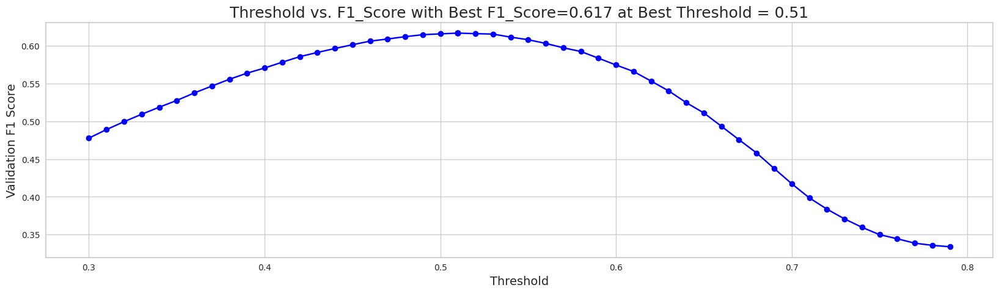

When using optimal threshold = 0.51...
Q0: F1 = 0.6168926485409532
==> Overall F1 = 0.6168926485409532
s
[I 2023-05-23 02:23:02,874] Trial 17 finished with value: 0.6168926485409532 and parameters: {'num_leaves': 19, 'learning_rate': 0.03896853091608325, 'feature_fraction': 0.9906531595780053, 'bagging_fraction': 0.8916583939151005, 'bagging_freq': 1, 'min_child_samples': 46, 'reg_alpha': 0.0010825676078040024, 'reg_lambda': 0.012156367345618193, 'subsample': 0.6182508162963546, 'colsample_bytree': 0.4663976307120916, 'min_split_gain': 0.6328416997828298, 'max_depth': -1}. Best is trial 9 with value: 0.6205503068843321.


--------------------------------------------------
question10, with210features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.8174396206884017, subsample=0.7703476815298227 will be ignored. Current value: bagging_fraction=0.8174396206884017
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
[LightGBM] [Warning] feature_fraction is set=0.4488472457484085, colsample_bytree=0.5314470272330138 will be ignored. Current value: feature_fraction=0.4488472457484085


[LightGBM] [Warning] bagging_fraction is set=0.8404113980004405, subsample=0.6475892860454973 will be ignored. Current value: bagging_fraction=0.8404113980004405
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
[LightGBM] [Warning] feature_fraction is set=0.9935435867485057, colsample_bytree=0.4340960755389389 will be ignored. Current value: feature_fraction=0.9935435867485057


[LightGBM] [Warning] bagging_fraction is set=0.8368396980962093, subsample=0.6538406887511676 will be ignored. Current value: bagging_fraction=0.8368396980962093
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
[LightGBM] [Warning] feature_fraction is set=0.9997529030340717, colsample_bytree=0.4903038728609525 will be ignored. Current value: feature_fraction=0.9997529030340717


[LightGBM] [Warning] bagging_fraction is set=0.8174396206884017, subsample=0.7703476815298227 will be ignored. Current value: bagging_fraction=0.8174396206884017
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
[LightGBM] [Warning] feature_fraction is set=0.4488472457484085, colsample_bytree=0.5314470272330138 will be ignored. Current value: feature_fraction=0.4488472457484085


[LightGBM] [Warning] bagging_fraction is set=0.4222850440377387, subsample=0.9242702348320784 will be ignored. Current value: bagging_fraction=0.4222850440377387
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.9917860782905545, colsample_bytree=0.9876215059363501 will be ignored. Current value: feature_fraction=0.9917860782905545


[LightGBM] [Warning] bagging_fraction is set=0.8404113980004405, subsample=0.6475892860454973 will be ignored. Current value: bagging_fraction=0.8404113980004405
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
[LightGBM] [Warning] feature_fraction is set=0.9935435867485057, colsample_bytree=0.4340960755389389 will be ignored. Current value: feature_fraction=0.9935435867485057


[LightGBM] [Warning] bagging_fraction is set=0.8174396206884017, subsample=0.7703476815298227 will be ignored. Current value: bagging_fraction=0.8174396206884017
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
[LightGBM] [Warning] feature_fraction is set=0.4488472457484085, colsample_bytree=0.5314470272330138 will be ignored. Current value: feature_fraction=0.4488472457484085


,mean
feature,
tunic.historicalsociety.frontdesk_room_fqid_counts,87.0
11_level_counts,75.8
elapsed_time_diff_std,71.4
room_corr_x_diff_std,65.6
8_level_counts,55.0
tunic.historicalsociety.stacks_room_fqid_counts,52.6
elapsed_time_diff_mean,51.8
logbook_fqid_counts,50.6
reader_fqid_counts,48.0


[[0.66466435 0.33533565]
 [0.53070644 0.46929356]
 [0.43403009 0.56596991]
 ...
 [0.38332397 0.61667603]
 [0.30914611 0.69085389]
 [0.53390809 0.46609191]]


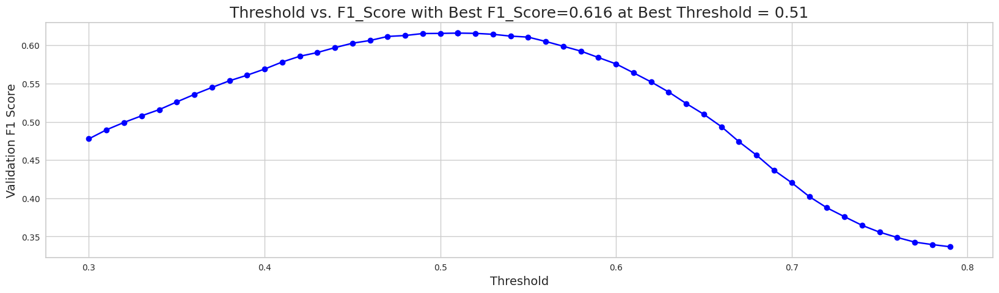

When using optimal threshold = 0.51...
Q0: F1 = 0.6159458244262799
==> Overall F1 = 0.6159458244262799
s
[I 2023-05-23 02:23:48,708] Trial 18 finished with value: 0.6159458244262799 and parameters: {'num_leaves': 23, 'learning_rate': 0.027650416229899402, 'feature_fraction': 0.9997529030340717, 'bagging_fraction': 0.8368396980962093, 'bagging_freq': 5, 'min_child_samples': 51, 'reg_alpha': 0.7040785926823602, 'reg_lambda': 0.034859967017051366, 'subsample': 0.6538406887511676, 'colsample_bytree': 0.4903038728609525, 'min_split_gain': 0.819788592267269, 'max_depth': 3}. Best is trial 9 with value: 0.6205503068843321.


--------------------------------------------------
question10, with210features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.7170570730003071, subsample=0.7745011379666057 will be ignored. Current value: bagging_fraction=0.7170570730003071
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.4852299032126288, colsample_bytree=0.3407144854432008 will be ignored. Current value: feature_fraction=0.4852299032126288


[LightGBM] [Warning] bagging_fraction is set=0.8174396206884017, subsample=0.7703476815298227 will be ignored. Current value: bagging_fraction=0.8174396206884017
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
[LightGBM] [Warning] feature_fraction is set=0.4488472457484085, colsample_bytree=0.5314470272330138 will be ignored. Current value: feature_fraction=0.4488472457484085


[LightGBM] [Warning] bagging_fraction is set=0.8404113980004405, subsample=0.6475892860454973 will be ignored. Current value: bagging_fraction=0.8404113980004405
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
[LightGBM] [Warning] feature_fraction is set=0.9935435867485057, colsample_bytree=0.4340960755389389 will be ignored. Current value: feature_fraction=0.9935435867485057


[LightGBM] [Warning] bagging_fraction is set=0.7170570730003071, subsample=0.7745011379666057 will be ignored. Current value: bagging_fraction=0.7170570730003071
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.4852299032126288, colsample_bytree=0.3407144854432008 will be ignored. Current value: feature_fraction=0.4852299032126288


[LightGBM] [Warning] bagging_fraction is set=0.8174396206884017, subsample=0.7703476815298227 will be ignored. Current value: bagging_fraction=0.8174396206884017
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
[LightGBM] [Warning] feature_fraction is set=0.4488472457484085, colsample_bytree=0.5314470272330138 will be ignored. Current value: feature_fraction=0.4488472457484085


[LightGBM] [Warning] bagging_fraction is set=0.7170570730003071, subsample=0.7745011379666057 will be ignored. Current value: bagging_fraction=0.7170570730003071
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.4852299032126288, colsample_bytree=0.3407144854432008 will be ignored. Current value: feature_fraction=0.4852299032126288


[LightGBM] [Warning] bagging_fraction is set=0.8404113980004405, subsample=0.6475892860454973 will be ignored. Current value: bagging_fraction=0.8404113980004405
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
[LightGBM] [Warning] feature_fraction is set=0.9935435867485057, colsample_bytree=0.4340960755389389 will be ignored. Current value: feature_fraction=0.9935435867485057


[LightGBM] [Warning] bagging_fraction is set=0.7170570730003071, subsample=0.7745011379666057 will be ignored. Current value: bagging_fraction=0.7170570730003071
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.4852299032126288, colsample_bytree=0.3407144854432008 will be ignored. Current value: feature_fraction=0.4852299032126288


,mean
feature,
elapsed_time_diff_std,72.6
tunic.historicalsociety.frontdesk_room_fqid_counts,67.8
11_level_counts,67.8
room_corr_x_diff_std,54.8
tunic.historicalsociety.stacks_room_fqid_counts,52.8
elapsed_time_diff_mean,49.0
8_level_counts,48.6
logbook_fqid_counts,48.0
reader_fqid_counts,44.6


[[0.66952147 0.33047853]
 [0.56088033 0.43911967]
 [0.45874868 0.54125132]
 ...
 [0.37921874 0.62078126]
 [0.32418053 0.67581947]
 [0.51419234 0.48580766]]


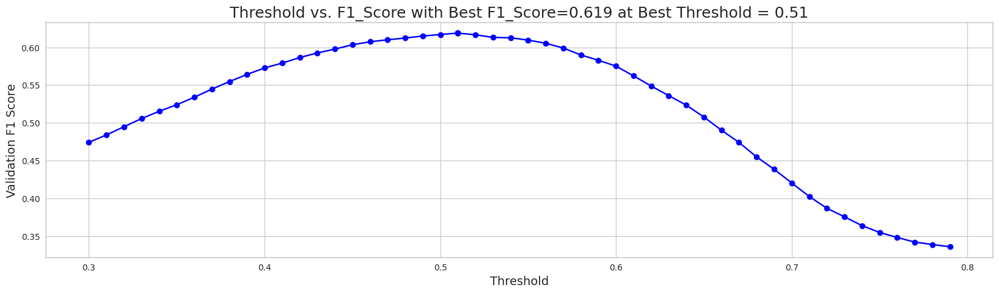

When using optimal threshold = 0.51...
Q0: F1 = 0.6188576397510794
==> Overall F1 = 0.6188576397510794
s
[I 2023-05-23 02:24:23,341] Trial 20 finished with value: 0.6188576397510794 and parameters: {'num_leaves': 35, 'learning_rate': 0.028405703947925513, 'feature_fraction': 0.4488472457484085, 'bagging_fraction': 0.8174396206884017, 'bagging_freq': 5, 'min_child_samples': 100, 'reg_alpha': 0.5832516908697883, 'reg_lambda': 0.04254703145799621, 'subsample': 0.7703476815298227, 'colsample_bytree': 0.5314470272330138, 'min_split_gain': 0.03943119231066137, 'max_depth': 3}. Best is trial 9 with value: 0.6205503068843321.


--------------------------------------------------
question10, with210features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.6782663940933833, subsample=0.5675672238898164 will be ignored. Current value: bagging_fraction=0.6782663940933833
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.7652829598767565, colsample_bytree=0.3320554936755385 will be ignored. Current value: feature_fraction=0.7652829598767565


[LightGBM] [Warning] bagging_fraction is set=0.4222850440377387, subsample=0.9242702348320784 will be ignored. Current value: bagging_fraction=0.4222850440377387
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.9917860782905545, colsample_bytree=0.9876215059363501 will be ignored. Current value: feature_fraction=0.9917860782905545


[LightGBM] [Warning] bagging_fraction is set=0.7170570730003071, subsample=0.7745011379666057 will be ignored. Current value: bagging_fraction=0.7170570730003071
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.4852299032126288, colsample_bytree=0.3407144854432008 will be ignored. Current value: feature_fraction=0.4852299032126288


,mean
feature,
elapsed_time_diff_std,50.0
tunic.historicalsociety.frontdesk_room_fqid_counts,45.2
11_level_counts,45.0
tunic.historicalsociety.stacks_room_fqid_counts,43.8
room_corr_x_diff_std,43.8
hover_duration_mean,43.2
hover_duration_max,42.4
elapsed_time_diff_mean,42.0
hover_duration_std,41.6


[[0.76317089 0.23682911]
 [0.59972812 0.40027188]
 [0.435825   0.564175  ]
 ...
 [0.33349269 0.66650731]
 [0.29297119 0.70702881]
 [0.58840233 0.41159767]]


,mean
feature,
tunic.historicalsociety.frontdesk_room_fqid_counts,92.6
11_level_counts,83.4
elapsed_time_diff_std,74.0
room_corr_x_diff_std,66.2
8_level_counts,59.6
logbook_fqid_counts,56.2
tunic.historicalsociety.stacks_room_fqid_counts,50.6
elapsed_time_diff_mean,49.0
reader_fqid_counts,48.8


[[0.68159638 0.31840362]
 [0.53857993 0.46142007]
 [0.4467026  0.5532974 ]
 ...
 [0.3610943  0.6389057 ]
 [0.28406736 0.71593264]
 [0.53621909 0.46378091]]


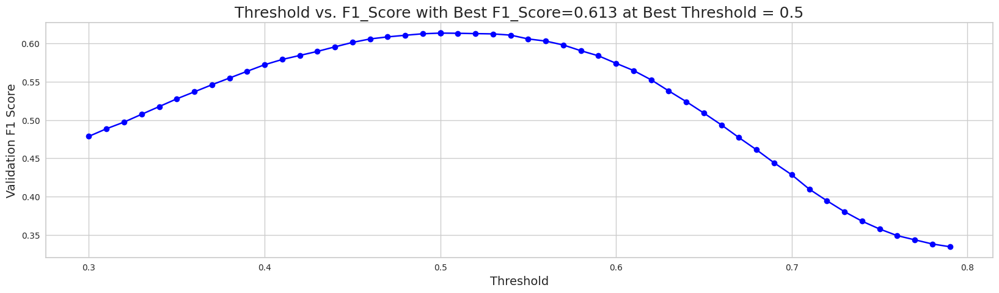

When using optimal threshold = 0.50...
Q0: F1 = 0.6133268102264015
==> Overall F1 = 0.6133268102264015
s
[I 2023-05-23 02:24:39,487] Trial 21 finished with value: 0.6133268102264015 and parameters: {'num_leaves': 34, 'learning_rate': 0.0609864474673361, 'feature_fraction': 0.4852299032126288, 'bagging_fraction': 0.7170570730003071, 'bagging_freq': 3, 'min_child_samples': 99, 'reg_alpha': 0.9454409361611517, 'reg_lambda': 0.004557170086605992, 'subsample': 0.7745011379666057, 'colsample_bytree': 0.3407144854432008, 'min_split_gain': 0.04229930294901281, 'max_depth': 7}. Best is trial 9 with value: 0.6205503068843321.


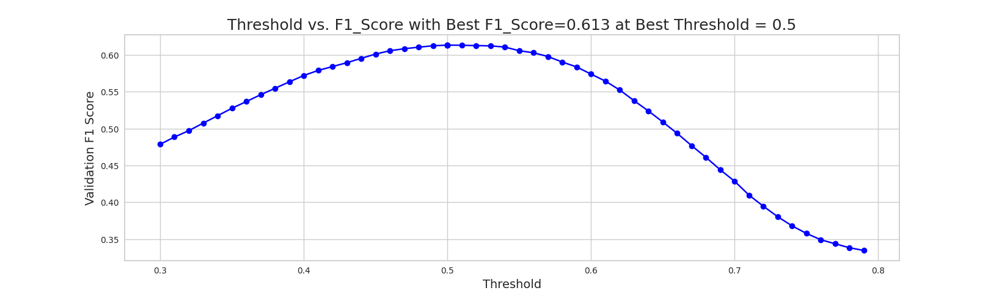

--------------------------------------------------
question10, with210features
--------------------------------------------------


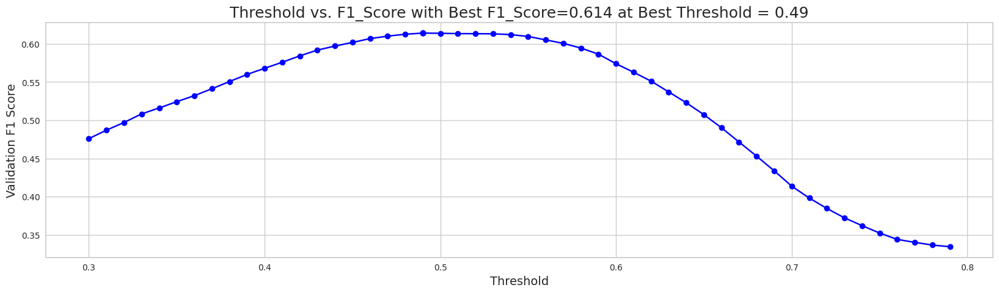

When using optimal threshold = 0.49...
Q0: F1 = 0.6140913224474727
==> Overall F1 = 0.6140913224474727
s
[I 2023-05-23 02:24:40,749] Trial 19 finished with value: 0.6140913224474727 and parameters: {'num_leaves': 32, 'learning_rate': 0.02424387758348604, 'feature_fraction': 0.9935435867485057, 'bagging_fraction': 0.8404113980004405, 'bagging_freq': 6, 'min_child_samples': 66, 'reg_alpha': 0.6802476550776863, 'reg_lambda': 0.0315652753395208, 'subsample': 0.6475892860454973, 'colsample_bytree': 0.4340960755389389, 'min_split_gain': 0.028696648024699088, 'max_depth': 3}. Best is trial 9 with value: 0.6205503068843321.


[LightGBM] [Warning] bagging_fraction is set=0.879783319309269, subsample=0.5632261285491094 will be ignored. Current value: bagging_fraction=0.879783319309269
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7442539926264168, colsample_bytree=0.12250357363055497 will be ignored. Current value: feature_fraction=0.7442539926264168
--------------------------------------------------
question10, with210features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.8747995051555537, subsample=0.8482331018601974 will be ignored. Current value: bagging_fraction=0.8747995051555537
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.44942584606710917, colsample_bytree=0.5390610320809839 will be ignored. Current value: feature_fraction=0.44942584606710917


[LightGBM] [Warning] bagging_fraction is set=0.6782663940933833, subsample=0.5675672238898164 will be ignored. Current value: bagging_fraction=0.6782663940933833
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.7652829598767565, colsample_bytree=0.3320554936755385 will be ignored. Current value: feature_fraction=0.7652829598767565


[LightGBM] [Warning] bagging_fraction is set=0.6782663940933833, subsample=0.5675672238898164 will be ignored. Current value: bagging_fraction=0.6782663940933833
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.7652829598767565, colsample_bytree=0.3320554936755385 will be ignored. Current value: feature_fraction=0.7652829598767565


,mean
feature,
session_id,527.4
room_coor_x_max,519.8
room_coor_y_max,510.0
elapsed_time_diff_std,503.2
room_coor_y_min,493.2
hover_duration_mean,490.0
room_coor_x_min,488.0
hover_duration_max,469.8
screen_coor_x_std,463.0


[[0.67586038 0.32413962]
 [0.55258944 0.44741056]
 [0.49412482 0.50587518]
 ...
 [0.36593649 0.63406351]
 [0.28126936 0.71873064]
 [0.54087878 0.45912122]]


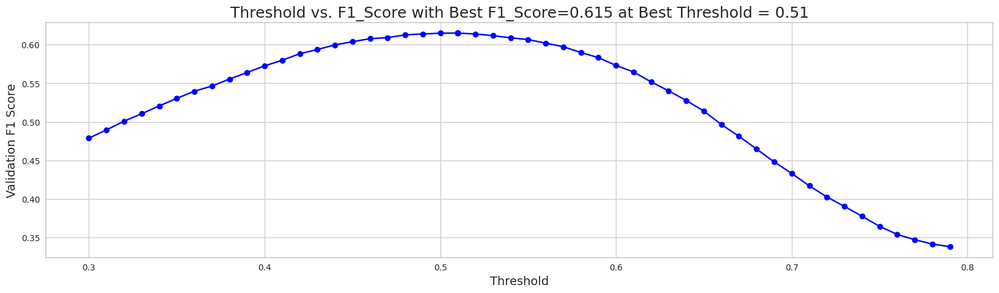

When using optimal threshold = 0.51...
Q0: F1 = 0.6151707290931399
==> Overall F1 = 0.6151707290931399
s
[I 2023-05-23 02:25:41,706] Trial 14 finished with value: 0.6151707290931399 and parameters: {'num_leaves': 100, 'learning_rate': 0.011099696396232006, 'feature_fraction': 0.9917860782905545, 'bagging_fraction': 0.4222850440377387, 'bagging_freq': 3, 'min_child_samples': 36, 'reg_alpha': 0.0010911343161346284, 'reg_lambda': 1.2585225625699774, 'subsample': 0.9242702348320784, 'colsample_bytree': 0.9876215059363501, 'min_split_gain': 0.02508260825027722, 'max_depth': -1}. Best is trial 9 with value: 0.6205503068843321.


--------------------------------------------------
question10, with210features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.877973837482667, subsample=0.7814205250421902 will be ignored. Current value: bagging_fraction=0.877973837482667
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.3876281177153147, colsample_bytree=0.5530398765895761 will be ignored. Current value: feature_fraction=0.3876281177153147


[LightGBM] [Warning] bagging_fraction is set=0.8747995051555537, subsample=0.8482331018601974 will be ignored. Current value: bagging_fraction=0.8747995051555537
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.44942584606710917, colsample_bytree=0.5390610320809839 will be ignored. Current value: feature_fraction=0.44942584606710917


[LightGBM] [Warning] bagging_fraction is set=0.879783319309269, subsample=0.5632261285491094 will be ignored. Current value: bagging_fraction=0.879783319309269
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7442539926264168, colsample_bytree=0.12250357363055497 will be ignored. Current value: feature_fraction=0.7442539926264168


[LightGBM] [Warning] bagging_fraction is set=0.6782663940933833, subsample=0.5675672238898164 will be ignored. Current value: bagging_fraction=0.6782663940933833
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.7652829598767565, colsample_bytree=0.3320554936755385 will be ignored. Current value: feature_fraction=0.7652829598767565


[LightGBM] [Warning] bagging_fraction is set=0.877973837482667, subsample=0.7814205250421902 will be ignored. Current value: bagging_fraction=0.877973837482667
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.3876281177153147, colsample_bytree=0.5530398765895761 will be ignored. Current value: feature_fraction=0.3876281177153147


[LightGBM] [Warning] bagging_fraction is set=0.8747995051555537, subsample=0.8482331018601974 will be ignored. Current value: bagging_fraction=0.8747995051555537
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.44942584606710917, colsample_bytree=0.5390610320809839 will be ignored. Current value: feature_fraction=0.44942584606710917


[LightGBM] [Warning] bagging_fraction is set=0.6782663940933833, subsample=0.5675672238898164 will be ignored. Current value: bagging_fraction=0.6782663940933833
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.7652829598767565, colsample_bytree=0.3320554936755385 will be ignored. Current value: feature_fraction=0.7652829598767565


[LightGBM] [Warning] bagging_fraction is set=0.879783319309269, subsample=0.5632261285491094 will be ignored. Current value: bagging_fraction=0.879783319309269
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7442539926264168, colsample_bytree=0.12250357363055497 will be ignored. Current value: feature_fraction=0.7442539926264168


[LightGBM] [Warning] bagging_fraction is set=0.877973837482667, subsample=0.7814205250421902 will be ignored. Current value: bagging_fraction=0.877973837482667
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.3876281177153147, colsample_bytree=0.5530398765895761 will be ignored. Current value: feature_fraction=0.3876281177153147


,mean
feature,
elapsed_time_diff_std,365.8
11_level_counts,354.6
tunic.historicalsociety.frontdesk_room_fqid_counts,338.6
hover_duration_mean,331.0
hover_duration_max,310.4
room_corr_x_diff_std,302.8
hover_duration_sum,302.4
hover_duration_std,300.8
session_id,297.6


[[0.72444774 0.27555226]
 [0.55512639 0.44487361]
 [0.4347471  0.5652529 ]
 ...
 [0.36075219 0.63924781]
 [0.31438627 0.68561373]
 [0.47135481 0.52864519]]


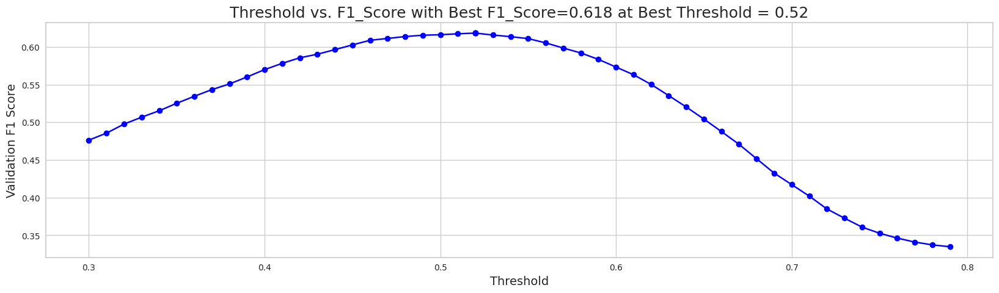

When using optimal threshold = 0.52...
Q0: F1 = 0.6183365878997322
==> Overall F1 = 0.6183365878997322
s
[I 2023-05-23 02:27:21,086] Trial 22 finished with value: 0.6183365878997322 and parameters: {'num_leaves': 66, 'learning_rate': 0.010117214329310535, 'feature_fraction': 0.7652829598767565, 'bagging_fraction': 0.6782663940933833, 'bagging_freq': 3, 'min_child_samples': 67, 'reg_alpha': 0.005955918499768465, 'reg_lambda': 0.006226903573940677, 'subsample': 0.5675672238898164, 'colsample_bytree': 0.3320554936755385, 'min_split_gain': 0.01544986065912308, 'max_depth': 7}. Best is trial 9 with value: 0.6205503068843321.


--------------------------------------------------
question10, with210features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.8545235348708252, subsample=0.8094649492741895 will be ignored. Current value: bagging_fraction=0.8545235348708252
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.4655863455005706, colsample_bytree=0.5262393123174021 will be ignored. Current value: feature_fraction=0.4655863455005706


[LightGBM] [Warning] bagging_fraction is set=0.877973837482667, subsample=0.7814205250421902 will be ignored. Current value: bagging_fraction=0.877973837482667
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.3876281177153147, colsample_bytree=0.5530398765895761 will be ignored. Current value: feature_fraction=0.3876281177153147


[LightGBM] [Warning] bagging_fraction is set=0.879783319309269, subsample=0.5632261285491094 will be ignored. Current value: bagging_fraction=0.879783319309269
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7442539926264168, colsample_bytree=0.12250357363055497 will be ignored. Current value: feature_fraction=0.7442539926264168


[LightGBM] [Warning] bagging_fraction is set=0.8747995051555537, subsample=0.8482331018601974 will be ignored. Current value: bagging_fraction=0.8747995051555537
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.44942584606710917, colsample_bytree=0.5390610320809839 will be ignored. Current value: feature_fraction=0.44942584606710917


[LightGBM] [Warning] bagging_fraction is set=0.8545235348708252, subsample=0.8094649492741895 will be ignored. Current value: bagging_fraction=0.8545235348708252
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.4655863455005706, colsample_bytree=0.5262393123174021 will be ignored. Current value: feature_fraction=0.4655863455005706


[LightGBM] [Warning] bagging_fraction is set=0.877973837482667, subsample=0.7814205250421902 will be ignored. Current value: bagging_fraction=0.877973837482667
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.3876281177153147, colsample_bytree=0.5530398765895761 will be ignored. Current value: feature_fraction=0.3876281177153147


[LightGBM] [Warning] bagging_fraction is set=0.8545235348708252, subsample=0.8094649492741895 will be ignored. Current value: bagging_fraction=0.8545235348708252
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.4655863455005706, colsample_bytree=0.5262393123174021 will be ignored. Current value: feature_fraction=0.4655863455005706


,mean
feature,
elapsed_time_diff_std,53.0
11_level_counts,45.6
logbook_fqid_counts,43.4
room_corr_x_diff_std,39.2
8_level_counts,37.6
tunic.historicalsociety.frontdesk_room_fqid_counts,33.8
tunic.historicalsociety.closet_dirty.gramps.archivist_text_fqid_counts,32.6
reader_fqid_counts,32.0
tunic.historicalsociety.frontdesk.archivist.foundtheodora_text_fqid_counts,31.0


[[0.67844808 0.32155192]
 [0.55844422 0.44155578]
 [0.42865179 0.57134821]
 ...
 [0.347282   0.652718  ]
 [0.31624317 0.68375683]
 [0.48008453 0.51991547]]


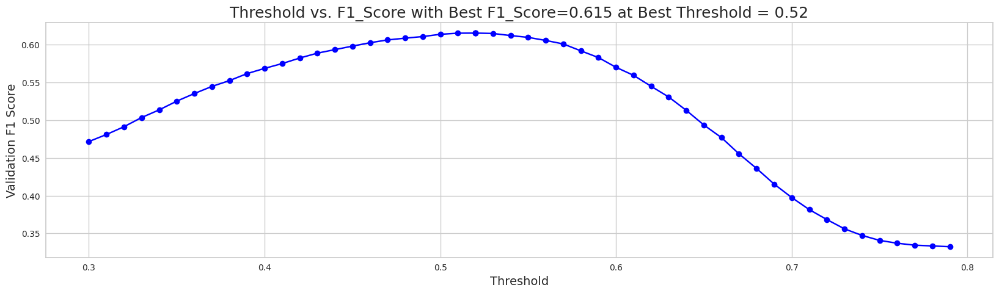

When using optimal threshold = 0.52...
Q0: F1 = 0.6154935493732548
==> Overall F1 = 0.6154935493732548
s
[I 2023-05-23 02:28:41,335] Trial 25 finished with value: 0.6154935493732548 and parameters: {'num_leaves': 64, 'learning_rate': 0.021835840029605876, 'feature_fraction': 0.3876281177153147, 'bagging_fraction': 0.877973837482667, 'bagging_freq': 2, 'min_child_samples': 94, 'reg_alpha': 0.20446151294469628, 'reg_lambda': 0.07486539110606248, 'subsample': 0.7814205250421902, 'colsample_bytree': 0.5530398765895761, 'min_split_gain': 0.08210007584223497, 'max_depth': 1}. Best is trial 9 with value: 0.6205503068843321.


--------------------------------------------------
question10, with210features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.8232943597199525, subsample=0.8663798508858754 will be ignored. Current value: bagging_fraction=0.8232943597199525
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
[LightGBM] [Warning] feature_fraction is set=0.1088392989994299, colsample_bytree=0.20668816838762888 will be ignored. Current value: feature_fraction=0.1088392989994299


[LightGBM] [Warning] bagging_fraction is set=0.879783319309269, subsample=0.5632261285491094 will be ignored. Current value: bagging_fraction=0.879783319309269
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7442539926264168, colsample_bytree=0.12250357363055497 will be ignored. Current value: feature_fraction=0.7442539926264168


[LightGBM] [Warning] bagging_fraction is set=0.8545235348708252, subsample=0.8094649492741895 will be ignored. Current value: bagging_fraction=0.8545235348708252
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.4655863455005706, colsample_bytree=0.5262393123174021 will be ignored. Current value: feature_fraction=0.4655863455005706


[LightGBM] [Warning] bagging_fraction is set=0.8232943597199525, subsample=0.8663798508858754 will be ignored. Current value: bagging_fraction=0.8232943597199525
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
[LightGBM] [Warning] feature_fraction is set=0.1088392989994299, colsample_bytree=0.20668816838762888 will be ignored. Current value: feature_fraction=0.1088392989994299


[LightGBM] [Warning] bagging_fraction is set=0.8545235348708252, subsample=0.8094649492741895 will be ignored. Current value: bagging_fraction=0.8545235348708252
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.4655863455005706, colsample_bytree=0.5262393123174021 will be ignored. Current value: feature_fraction=0.4655863455005706


[LightGBM] [Warning] bagging_fraction is set=0.8232943597199525, subsample=0.8663798508858754 will be ignored. Current value: bagging_fraction=0.8232943597199525
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
[LightGBM] [Warning] feature_fraction is set=0.1088392989994299, colsample_bytree=0.20668816838762888 will be ignored. Current value: feature_fraction=0.1088392989994299


[LightGBM] [Warning] bagging_fraction is set=0.8747995051555537, subsample=0.8482331018601974 will be ignored. Current value: bagging_fraction=0.8747995051555537
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.44942584606710917, colsample_bytree=0.5390610320809839 will be ignored. Current value: feature_fraction=0.44942584606710917
[LightGBM] [Warning] bagging_fraction is set=0.8232943597199525, subsample=0.8663798508858754 will be ignored. Current value: bagging_fraction=0.8232943597199525
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
[LightGBM] [Warning] 

[LightGBM] [Warning] bagging_fraction is set=0.8232943597199525, subsample=0.8663798508858754 will be ignored. Current value: bagging_fraction=0.8232943597199525
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
[LightGBM] [Warning] feature_fraction is set=0.1088392989994299, colsample_bytree=0.20668816838762888 will be ignored. Current value: feature_fraction=0.1088392989994299


,mean
feature,
elapsed_time_diff_std,112.6
11_level_counts,96.0
logbook_fqid_counts,92.0
room_corr_x_diff_std,78.8
8_level_counts,76.2
tunic.historicalsociety.frontdesk_room_fqid_counts,69.6
reader_fqid_counts,68.8
tunic.historicalsociety.frontdesk.archivist.foundtheodora_text_fqid_counts,65.4
tunic.historicalsociety.closet_dirty.gramps.helpclean_text_fqid_counts,64.0


,mean
feature,
elapsed_time_diff_std,52.6
11_level_counts,44.0
logbook_fqid_counts,41.6
8_level_counts,40.4
room_corr_x_diff_std,38.8
tunic.historicalsociety.frontdesk_room_fqid_counts,35.0
tunic.historicalsociety.closet_dirty.gramps.archivist_text_fqid_counts,31.6
reader_fqid_counts,31.0
tunic.historicalsociety.frontdesk.archivist.foundtheodora_text_fqid_counts,30.8


[[0.69099536 0.30900464]
 [0.56282716 0.43717284]
 [0.43170617 0.56829383]
 ...
 [0.37481554 0.62518446]
 [0.33163133 0.66836867]
 [0.48041235 0.51958765]]
[[0.67617942 0.32382058]
 [0.56955542 0.43044458]
 [0.43748418 0.56251582]
 ...
 [0.3510856  0.6489144 ]
 [0.31762111 0.68237889]
 [0.48001303 0.51998697]]


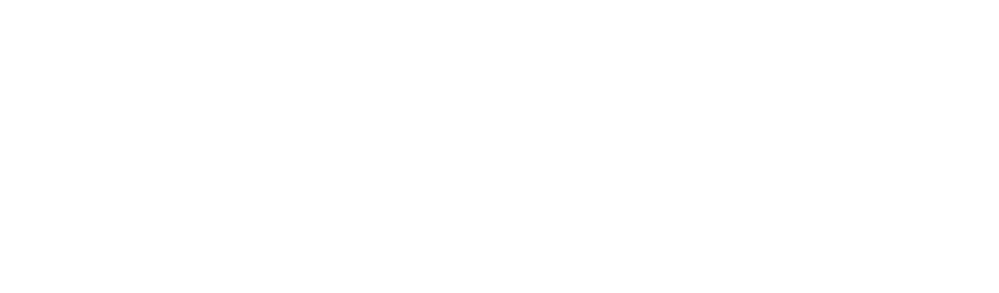

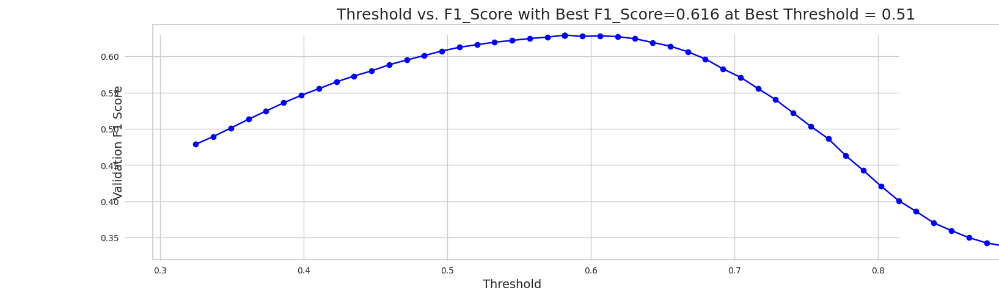

When using optimal threshold = 0.51...
Q0: F1 = 0.6155252182937448


==> Overall F1 = 0.6155252182937448
s
[I 2023-05-23 02:29:47,028] Trial 23 finished with value: 0.6155252182937448 and parameters: {'num_leaves': 63, 'learning_rate': 0.010296062191054112, 'feature_fraction': 0.7442539926264168, 'bagging_fraction': 0.879783319309269, 'bagging_freq': 2, 'min_child_samples': 70, 'reg_alpha': 0.00518747905276346, 'reg_lambda': 3.164091681615835, 'subsample': 0.5632261285491094, 'colsample_bytree': 0.12250357363055497, 'min_split_gain': 0.01818406024409957, 'max_depth': 1}. Best is trial 9 with value: 0.6205503068843321.


--------------------------------------------------
question10, with210features
--------------------------------------------------


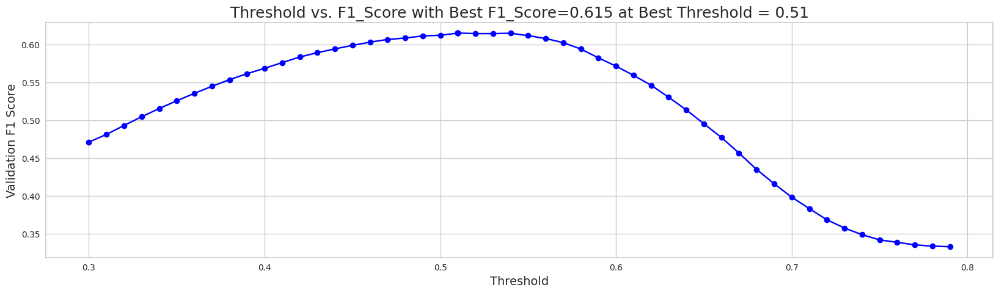

When using optimal threshold = 0.51...
Q0: F1 = 0.6150183642343137
==> Overall F1 = 0.6150183642343137
s
[I 2023-05-23 02:29:48,039] Trial 26 finished with value: 0.6150183642343137 and parameters: {'num_leaves': 39, 'learning_rate': 0.022213607875882144, 'feature_fraction': 0.4655863455005706, 'bagging_fraction': 0.8545235348708252, 'bagging_freq': 2, 'min_child_samples': 100, 'reg_alpha': 0.22479774211575704, 'reg_lambda': 0.07229455482527035, 'subsample': 0.8094649492741895, 'colsample_bytree': 0.5262393123174021, 'min_split_gain': 0.39519685453373093, 'max_depth': 1}. Best is trial 9 with value: 0.6205503068843321.


--------------------------------------------------
question10, with210features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.8388206657393755, subsample=0.8873654014204722 will be ignored. Current value: bagging_fraction=0.8388206657393755
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
[LightGBM] [Warning] feature_fraction is set=0.12109644330710928, colsample_bytree=0.5493217090619216 will be ignored. Current value: feature_fraction=0.12109644330710928


[LightGBM] [Warning] bagging_fraction is set=0.7696560533285872, subsample=0.7265081236563218 will be ignored. Current value: bagging_fraction=0.7696560533285872
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
[LightGBM] [Warning] feature_fraction is set=0.9041884115035391, colsample_bytree=0.23651258312599566 will be ignored. Current value: feature_fraction=0.9041884115035391


,mean
feature,
tunic.historicalsociety.stacks_room_fqid_counts,84.8
elapsed_time_diff_mean,80.8
hover_duration_sum,74.8
8_level_counts,71.6
room_corr_x_diff_std,67.2
hover_duration_std,66.4
room_coor_x_sum,63.8
6_level_counts,61.0
basic_name_counts,59.0


[[0.67999543 0.32000457]
 [0.62445525 0.37554475]
 [0.47062931 0.52937069]
 ...
 [0.36972102 0.63027898]
 [0.30833534 0.69166466]
 [0.51912055 0.48087945]]


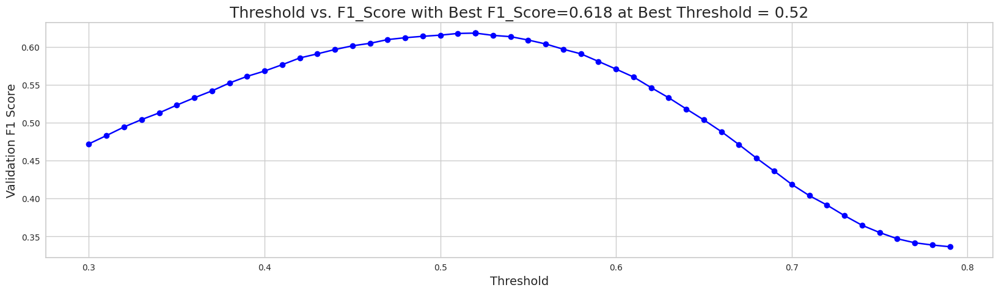

When using optimal threshold = 0.52...
Q0: F1 = 0.6183091327749893
==> Overall F1 = 0.6183091327749893
s
[I 2023-05-23 02:29:55,550] Trial 27 finished with value: 0.6183091327749893 and parameters: {'num_leaves': 39, 'learning_rate': 0.028439140110469482, 'feature_fraction': 0.1088392989994299, 'bagging_fraction': 0.8232943597199525, 'bagging_freq': 5, 'min_child_samples': 77, 'reg_alpha': 1.5186703092416365, 'reg_lambda': 0.002248635220563718, 'subsample': 0.8663798508858754, 'colsample_bytree': 0.20668816838762888, 'min_split_gain': 0.3597972057380678, 'max_depth': 3}. Best is trial 9 with value: 0.6205503068843321.


--------------------------------------------------
question10, with210features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.7932308380845927, subsample=0.7319819519711672 will be ignored. Current value: bagging_fraction=0.7932308380845927
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
[LightGBM] [Warning] feature_fraction is set=0.5699768522444247, colsample_bytree=0.5891006641632428 will be ignored. Current value: feature_fraction=0.5699768522444247


[LightGBM] [Warning] bagging_fraction is set=0.8388206657393755, subsample=0.8873654014204722 will be ignored. Current value: bagging_fraction=0.8388206657393755
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
[LightGBM] [Warning] feature_fraction is set=0.12109644330710928, colsample_bytree=0.5493217090619216 will be ignored. Current value: feature_fraction=0.12109644330710928


[LightGBM] [Warning] bagging_fraction is set=0.7696560533285872, subsample=0.7265081236563218 will be ignored. Current value: bagging_fraction=0.7696560533285872
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
[LightGBM] [Warning] feature_fraction is set=0.9041884115035391, colsample_bytree=0.23651258312599566 will be ignored. Current value: feature_fraction=0.9041884115035391


[LightGBM] [Warning] bagging_fraction is set=0.8388206657393755, subsample=0.8873654014204722 will be ignored. Current value: bagging_fraction=0.8388206657393755
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
[LightGBM] [Warning] feature_fraction is set=0.12109644330710928, colsample_bytree=0.5493217090619216 will be ignored. Current value: feature_fraction=0.12109644330710928


[LightGBM] [Warning] bagging_fraction is set=0.7932308380845927, subsample=0.7319819519711672 will be ignored. Current value: bagging_fraction=0.7932308380845927
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
[LightGBM] [Warning] feature_fraction is set=0.5699768522444247, colsample_bytree=0.5891006641632428 will be ignored. Current value: feature_fraction=0.5699768522444247


[LightGBM] [Warning] bagging_fraction is set=0.7696560533285872, subsample=0.7265081236563218 will be ignored. Current value: bagging_fraction=0.7696560533285872
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
[LightGBM] [Warning] feature_fraction is set=0.9041884115035391, colsample_bytree=0.23651258312599566 will be ignored. Current value: feature_fraction=0.9041884115035391


[LightGBM] [Warning] bagging_fraction is set=0.8388206657393755, subsample=0.8873654014204722 will be ignored. Current value: bagging_fraction=0.8388206657393755
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
[LightGBM] [Warning] feature_fraction is set=0.12109644330710928, colsample_bytree=0.5493217090619216 will be ignored. Current value: feature_fraction=0.12109644330710928


[LightGBM] [Warning] bagging_fraction is set=0.7932308380845927, subsample=0.7319819519711672 will be ignored. Current value: bagging_fraction=0.7932308380845927
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
[LightGBM] [Warning] feature_fraction is set=0.5699768522444247, colsample_bytree=0.5891006641632428 will be ignored. Current value: feature_fraction=0.5699768522444247


[LightGBM] [Warning] bagging_fraction is set=0.7696560533285872, subsample=0.7265081236563218 will be ignored. Current value: bagging_fraction=0.7696560533285872
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
[LightGBM] [Warning] feature_fraction is set=0.9041884115035391, colsample_bytree=0.23651258312599566 will be ignored. Current value: feature_fraction=0.9041884115035391


,mean
feature,
elapsed_time_diff_std,120.0
11_level_counts,100.6
logbook_fqid_counts,97.2
room_corr_x_diff_std,85.0
8_level_counts,79.4
tunic.historicalsociety.frontdesk_room_fqid_counts,74.6
tunic.historicalsociety.closet_dirty.gramps.helpclean_text_fqid_counts,68.2
room_coor_x_mean,68.0
journals.pic_1.next_fqid_counts,68.0


[[0.67873592 0.32126408]
 [0.56568333 0.43431667]
 [0.44059765 0.55940235]
 ...
 [0.3579497  0.6420503 ]
 [0.32233772 0.67766228]
 [0.48061468 0.51938532]]


[LightGBM] [Warning] bagging_fraction is set=0.8388206657393755, subsample=0.8873654014204722 will be ignored. Current value: bagging_fraction=0.8388206657393755
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
[LightGBM] [Warning] feature_fraction is set=0.12109644330710928, colsample_bytree=0.5493217090619216 will be ignored. Current value: feature_fraction=0.12109644330710928


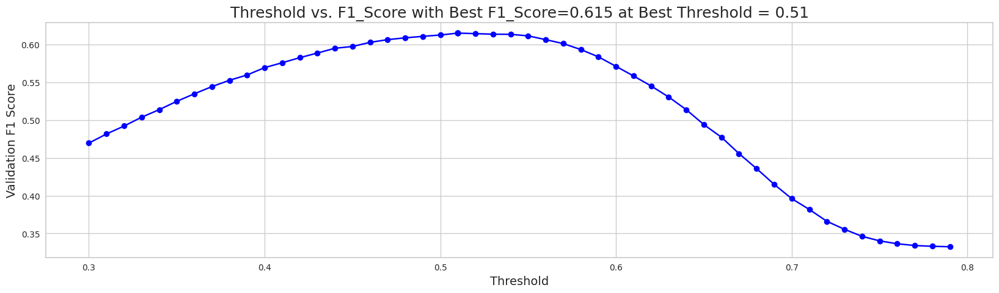

When using optimal threshold = 0.51...
Q0: F1 = 0.6154239357080347


==> Overall F1 = 0.6154239357080347
s
[I 2023-05-23 02:30:59,036] Trial 24 finished with value: 0.6154239357080347 and parameters: {'num_leaves': 37, 'learning_rate': 0.010015930028130835, 'feature_fraction': 0.44942584606710917, 'bagging_fraction': 0.8747995051555537, 'bagging_freq': 2, 'min_child_samples': 99, 'reg_alpha': 1.7454536551772664, 'reg_lambda': 0.003999807002483229, 'subsample': 0.8482331018601974, 'colsample_bytree': 0.5390610320809839, 'min_split_gain': 0.011334776274518071, 'max_depth': 1}. Best is trial 9 with value: 0.6205503068843321.


--------------------------------------------------
question10, with210features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.7909478011437843, subsample=0.9945468193868572 will be ignored. Current value: bagging_fraction=0.7909478011437843
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
[LightGBM] [Warning] feature_fraction is set=0.5873497330436854, colsample_bytree=0.24017854603474453 will be ignored. Current value: feature_fraction=0.5873497330436854


[LightGBM] [Warning] bagging_fraction is set=0.7696560533285872, subsample=0.7265081236563218 will be ignored. Current value: bagging_fraction=0.7696560533285872
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
[LightGBM] [Warning] feature_fraction is set=0.9041884115035391, colsample_bytree=0.23651258312599566 will be ignored. Current value: feature_fraction=0.9041884115035391


,mean
feature,
elapsed_time_diff_std,109.4
11_level_counts,106.4
screen_coor_y_min,97.6
room_corr_y_diff_std,95.2
tunic.historicalsociety.frontdesk_room_fqid_counts,90.6
room_corr_x_diff_std,90.0
tunic.historicalsociety.stacks_room_fqid_counts,82.6
hover_duration_std,78.4
8_level_counts,77.6


[[0.68853917 0.31146083]
 [0.56823863 0.43176137]
 [0.44412849 0.55587151]
 ...
 [0.36918638 0.63081362]
 [0.31211231 0.68788769]
 [0.53716905 0.46283095]]


[LightGBM] [Warning] bagging_fraction is set=0.7909478011437843, subsample=0.9945468193868572 will be ignored. Current value: bagging_fraction=0.7909478011437843
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
[LightGBM] [Warning] feature_fraction is set=0.5873497330436854, colsample_bytree=0.24017854603474453 will be ignored. Current value: feature_fraction=0.5873497330436854


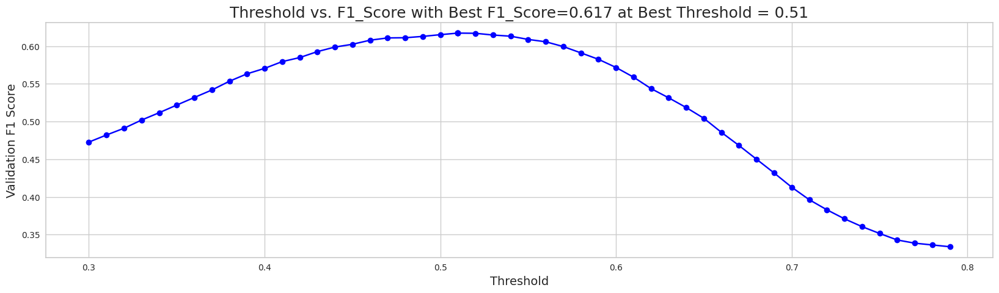

When using optimal threshold = 0.51...
Q0: F1 = 0.6172526773085472
==> Overall F1 = 0.6172526773085472
s
[I 2023-05-23 02:31:23,392] Trial 28 finished with value: 0.6172526773085472 and parameters: {'num_leaves': 41, 'learning_rate': 0.016967289813049725, 'feature_fraction': 0.12109644330710928, 'bagging_fraction': 0.8388206657393755, 'bagging_freq': 5, 'min_child_samples': 79, 'reg_alpha': 1.5320951988351235, 'reg_lambda': 0.0025788353786556995, 'subsample': 0.8873654014204722, 'colsample_bytree': 0.5493217090619216, 'min_split_gain': 0.0010552800281105686, 'max_depth': 3}. Best is trial 9 with value: 0.6205503068843321.


--------------------------------------------------
question10, with210features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.7932308380845927, subsample=0.7319819519711672 will be ignored. Current value: bagging_fraction=0.7932308380845927
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
[LightGBM] [Warning] feature_fraction is set=0.5699768522444247, colsample_bytree=0.5891006641632428 will be ignored. Current value: feature_fraction=0.5699768522444247
[LightGBM] [Warning] bagging_fraction is set=0.7654012816372064, subsample=0.7394507776098957 will be ignored. Current value: bagging_fraction=0.7654012816372064
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
[LightGBM] [Warning] fe

[LightGBM] [Warning] bagging_fraction is set=0.7654012816372064, subsample=0.7394507776098957 will be ignored. Current value: bagging_fraction=0.7654012816372064
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
[LightGBM] [Warning] feature_fraction is set=0.5727747282342122, colsample_bytree=0.7146527344600935 will be ignored. Current value: feature_fraction=0.5727747282342122


,mean
feature,
tunic.historicalsociety.frontdesk_room_fqid_counts,136.6
11_level_counts,124.0
elapsed_time_diff_std,121.8
room_corr_x_diff_std,90.6
logbook_fqid_counts,87.2
8_level_counts,77.8
tunic.historicalsociety.stacks_room_fqid_counts,75.2
reader_fqid_counts,72.4
elapsed_time_diff_mean,69.8


[[0.70198606 0.29801394]
 [0.54794519 0.45205481]
 [0.44954454 0.55045546]
 ...
 [0.37266226 0.62733774]
 [0.29872786 0.70127214]
 [0.49704826 0.50295174]]


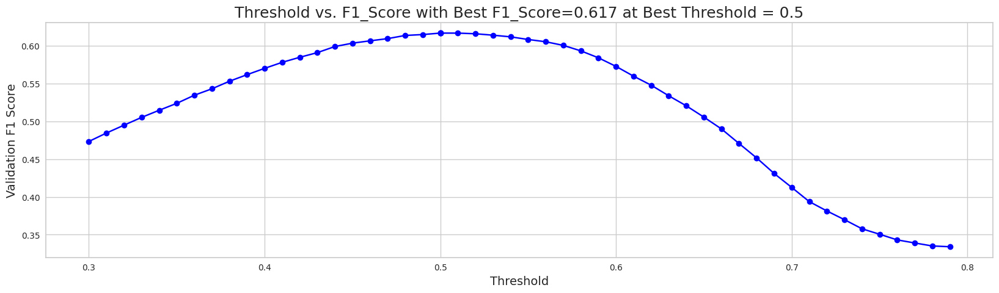

When using optimal threshold = 0.50...
Q0: F1 = 0.6165452281232252
==> Overall F1 = 0.6165452281232252
s
[I 2023-05-23 02:31:39,101] Trial 29 finished with value: 0.6165452281232252 and parameters: {'num_leaves': 36, 'learning_rate': 0.015187190990139435, 'feature_fraction': 0.9041884115035391, 'bagging_fraction': 0.7696560533285872, 'bagging_freq': 5, 'min_child_samples': 80, 'reg_alpha': 1.716334098653762, 'reg_lambda': 0.4165533032612726, 'subsample': 0.7265081236563218, 'colsample_bytree': 0.23651258312599566, 'min_split_gain': 0.06821037079306647, 'max_depth': 3}. Best is trial 9 with value: 0.6205503068843321.


--------------------------------------------------
question10, with210features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.7654012816372064, subsample=0.7394507776098957 will be ignored. Current value: bagging_fraction=0.7654012816372064
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
[LightGBM] [Warning] feature_fraction is set=0.5727747282342122, colsample_bytree=0.7146527344600935 will be ignored. Current value: feature_fraction=0.5727747282342122
[LightGBM] [Warning] bagging_fraction is set=0.6818183365816708, subsample=0.9977306985459177 will be ignored. Current value: bagging_fraction=0.6818183365816708
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
[LightGBM] [Warning] fe

[LightGBM] [Warning] bagging_fraction is set=0.7909478011437843, subsample=0.9945468193868572 will be ignored. Current value: bagging_fraction=0.7909478011437843
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
[LightGBM] [Warning] feature_fraction is set=0.5873497330436854, colsample_bytree=0.24017854603474453 will be ignored. Current value: feature_fraction=0.5873497330436854


[LightGBM] [Warning] bagging_fraction is set=0.6818183365816708, subsample=0.9977306985459177 will be ignored. Current value: bagging_fraction=0.6818183365816708
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
[LightGBM] [Warning] feature_fraction is set=0.60662178298068, colsample_bytree=0.3950381863420297 will be ignored. Current value: feature_fraction=0.60662178298068


[LightGBM] [Warning] bagging_fraction is set=0.7654012816372064, subsample=0.7394507776098957 will be ignored. Current value: bagging_fraction=0.7654012816372064
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
[LightGBM] [Warning] feature_fraction is set=0.5727747282342122, colsample_bytree=0.7146527344600935 will be ignored. Current value: feature_fraction=0.5727747282342122


[LightGBM] [Warning] bagging_fraction is set=0.7932308380845927, subsample=0.7319819519711672 will be ignored. Current value: bagging_fraction=0.7932308380845927
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
[LightGBM] [Warning] feature_fraction is set=0.5699768522444247, colsample_bytree=0.5891006641632428 will be ignored. Current value: feature_fraction=0.5699768522444247


[LightGBM] [Warning] bagging_fraction is set=0.6818183365816708, subsample=0.9977306985459177 will be ignored. Current value: bagging_fraction=0.6818183365816708
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
[LightGBM] [Warning] feature_fraction is set=0.60662178298068, colsample_bytree=0.3950381863420297 will be ignored. Current value: feature_fraction=0.60662178298068
[LightGBM] [Warning] bagging_fraction is set=0.7654012816372064, subsample=0.7394507776098957 will be ignored. Current value: bagging_fraction=0.7654012816372064
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
[LightGBM] [Warning] featur

[LightGBM] [Warning] bagging_fraction is set=0.6818183365816708, subsample=0.9977306985459177 will be ignored. Current value: bagging_fraction=0.6818183365816708
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
[LightGBM] [Warning] feature_fraction is set=0.60662178298068, colsample_bytree=0.3950381863420297 will be ignored. Current value: feature_fraction=0.60662178298068


,mean
feature,
tunic.historicalsociety.frontdesk_room_fqid_counts,39.8
11_level_counts,35.6
room_corr_x_diff_std,32.6
elapsed_time_diff_std,31.0
hover_duration_mean,30.4
tunic.historicalsociety.stacks_room_fqid_counts,30.0
8_level_counts,28.4
hover_duration_max,25.8
elapsed_time_diff_mean,25.2


[[0.67732068 0.32267932]
 [0.54748897 0.45251103]
 [0.51589632 0.48410368]
 ...
 [0.38022281 0.61977719]
 [0.28906005 0.71093995]
 [0.55527428 0.44472572]]


[LightGBM] [Warning] bagging_fraction is set=0.7909478011437843, subsample=0.9945468193868572 will be ignored. Current value: bagging_fraction=0.7909478011437843
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
[LightGBM] [Warning] feature_fraction is set=0.5873497330436854, colsample_bytree=0.24017854603474453 will be ignored. Current value: feature_fraction=0.5873497330436854


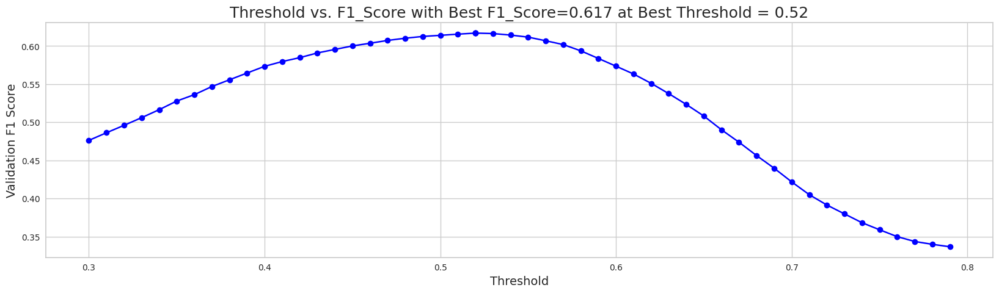

When using optimal threshold = 0.52...
Q0: F1 = 0.6169408214894327
==> Overall F1 = 0.6169408214894327
s
[I 2023-05-23 02:32:10,249] Trial 32 finished with value: 0.6169408214894327 and parameters: {'num_leaves': 30, 'learning_rate': 0.06357356444587237, 'feature_fraction': 0.5727747282342122, 'bagging_fraction': 0.7654012816372064, 'bagging_freq': 4, 'min_child_samples': 59, 'reg_alpha': 0.4954961446451599, 'reg_lambda': 0.0013608465016394903, 'subsample': 0.7394507776098957, 'colsample_bytree': 0.7146527344600935, 'min_split_gain': 0.06590698240881233, 'max_depth': 4}. Best is trial 9 with value: 0.6205503068843321.


--------------------------------------------------
question10, with210features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.9768034224354949, subsample=0.9862627479926686 will be ignored. Current value: bagging_fraction=0.9768034224354949
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=10, subsample_freq=0 will be ignored. Current value: bagging_freq=10
[LightGBM] [Warning] feature_fraction is set=0.8827513204901372, colsample_bytree=0.9198394725310786 will be ignored. Current value: feature_fraction=0.8827513204901372


[LightGBM] [Warning] bagging_fraction is set=0.6818183365816708, subsample=0.9977306985459177 will be ignored. Current value: bagging_fraction=0.6818183365816708
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
[LightGBM] [Warning] feature_fraction is set=0.60662178298068, colsample_bytree=0.3950381863420297 will be ignored. Current value: feature_fraction=0.60662178298068


,mean
feature,
tunic.historicalsociety.frontdesk_room_fqid_counts,173.2
elapsed_time_diff_std,159.4
11_level_counts,159.2
room_corr_x_diff_std,137.8
elapsed_time_diff_mean,130.2
8_level_counts,126.8
tunic.historicalsociety.stacks_room_fqid_counts,122.8
hover_duration_std,116.6
logbook_fqid_counts,116.2


[[0.72314942 0.27685058]
 [0.54779395 0.45220605]
 [0.44451108 0.55548892]
 ...
 [0.36201781 0.63798219]
 [0.30540949 0.69459051]
 [0.48387023 0.51612977]]


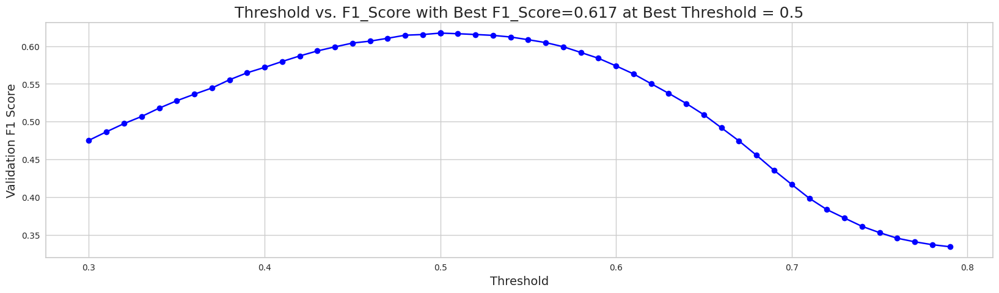

When using optimal threshold = 0.50...
Q0: F1 = 0.617302328098998
==> Overall F1 = 0.617302328098998
s
[I 2023-05-23 02:32:22,015] Trial 30 finished with value: 0.617302328098998 and parameters: {'num_leaves': 29, 'learning_rate': 0.015027436615349013, 'feature_fraction': 0.5699768522444247, 'bagging_fraction': 0.7932308380845927, 'bagging_freq': 4, 'min_child_samples': 24, 'reg_alpha': 1.565204536010966, 'reg_lambda': 0.34400215609858065, 'subsample': 0.7319819519711672, 'colsample_bytree': 0.5891006641632428, 'min_split_gain': 0.06964181473079586, 'max_depth': 4}. Best is trial 9 with value: 0.6205503068843321.


--------------------------------------------------
question10, with210features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.9558923646808766, subsample=0.9956005863136611 will be ignored. Current value: bagging_fraction=0.9558923646808766
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=10, subsample_freq=0 will be ignored. Current value: bagging_freq=10
[LightGBM] [Warning] feature_fraction is set=0.8784635369803133, colsample_bytree=0.9185091782607342 will be ignored. Current value: feature_fraction=0.8784635369803133


,mean
feature,
11_level_counts,43.6
tunic.historicalsociety.frontdesk_room_fqid_counts,39.6
elapsed_time_diff_std,36.6
hover_duration_max,36.0
elapsed_time_diff_mean,34.6
tunic.historicalsociety.stacks_room_fqid_counts,33.8
hover_duration_sum,31.4
room_corr_x_diff_std,30.8
hover_duration_mean,30.2


[[0.66726778 0.33273222]
 [0.54651169 0.45348831]
 [0.49204628 0.50795372]
 ...
 [0.31949344 0.68050656]
 [0.29551372 0.70448628]
 [0.50689688 0.49310312]]


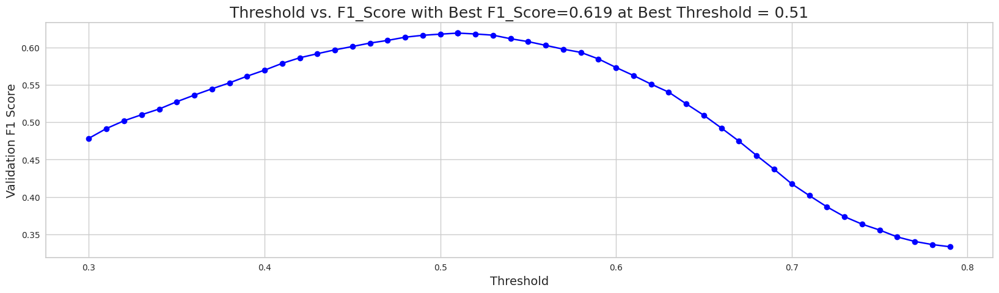

When using optimal threshold = 0.51...
Q0: F1 = 0.6192170335814704
==> Overall F1 = 0.6192170335814704
s
[I 2023-05-23 02:32:25,152] Trial 33 finished with value: 0.6192170335814704 and parameters: {'num_leaves': 28, 'learning_rate': 0.05888277679733663, 'feature_fraction': 0.60662178298068, 'bagging_fraction': 0.6818183365816708, 'bagging_freq': 4, 'min_child_samples': 61, 'reg_alpha': 0.41186409067755336, 'reg_lambda': 0.0015961119563918014, 'subsample': 0.9977306985459177, 'colsample_bytree': 0.3950381863420297, 'min_split_gain': 0.055687812860320936, 'max_depth': 8}. Best is trial 9 with value: 0.6205503068843321.


--------------------------------------------------
question10, with210features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.6327225861798427, subsample=0.9714953340233876 will be ignored. Current value: bagging_fraction=0.6327225861798427
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
[LightGBM] [Warning] feature_fraction is set=0.7236993448862379, colsample_bytree=0.39033650968004896 will be ignored. Current value: feature_fraction=0.7236993448862379


[LightGBM] [Warning] bagging_fraction is set=0.7909478011437843, subsample=0.9945468193868572 will be ignored. Current value: bagging_fraction=0.7909478011437843
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
[LightGBM] [Warning] feature_fraction is set=0.5873497330436854, colsample_bytree=0.24017854603474453 will be ignored. Current value: feature_fraction=0.5873497330436854


[LightGBM] [Warning] bagging_fraction is set=0.6327225861798427, subsample=0.9714953340233876 will be ignored. Current value: bagging_fraction=0.6327225861798427
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
[LightGBM] [Warning] feature_fraction is set=0.7236993448862379, colsample_bytree=0.39033650968004896 will be ignored. Current value: feature_fraction=0.7236993448862379


[LightGBM] [Warning] bagging_fraction is set=0.6327225861798427, subsample=0.9714953340233876 will be ignored. Current value: bagging_fraction=0.6327225861798427
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
[LightGBM] [Warning] feature_fraction is set=0.7236993448862379, colsample_bytree=0.39033650968004896 will be ignored. Current value: feature_fraction=0.7236993448862379


[LightGBM] [Warning] bagging_fraction is set=0.9558923646808766, subsample=0.9956005863136611 will be ignored. Current value: bagging_fraction=0.9558923646808766
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=10, subsample_freq=0 will be ignored. Current value: bagging_freq=10
[LightGBM] [Warning] feature_fraction is set=0.8784635369803133, colsample_bytree=0.9185091782607342 will be ignored. Current value: feature_fraction=0.8784635369803133


[LightGBM] [Warning] bagging_fraction is set=0.6327225861798427, subsample=0.9714953340233876 will be ignored. Current value: bagging_fraction=0.6327225861798427
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
[LightGBM] [Warning] feature_fraction is set=0.7236993448862379, colsample_bytree=0.39033650968004896 will be ignored. Current value: feature_fraction=0.7236993448862379


[LightGBM] [Warning] bagging_fraction is set=0.9768034224354949, subsample=0.9862627479926686 will be ignored. Current value: bagging_fraction=0.9768034224354949
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=10, subsample_freq=0 will be ignored. Current value: bagging_freq=10
[LightGBM] [Warning] feature_fraction is set=0.8827513204901372, colsample_bytree=0.9198394725310786 will be ignored. Current value: feature_fraction=0.8827513204901372


,mean
feature,
tunic.historicalsociety.frontdesk_room_fqid_counts,155.6
11_level_counts,143.8
elapsed_time_diff_std,134.8
tunic.historicalsociety.stacks_room_fqid_counts,114.6
room_corr_x_diff_std,114.0
8_level_counts,112.4
elapsed_time_diff_mean,107.0
hover_duration_std,99.4
logbook_fqid_counts,97.6


[[0.71946663 0.28053337]
 [0.56261234 0.43738766]
 [0.41189183 0.58810817]
 ...
 [0.33743392 0.66256608]
 [0.29805862 0.70194138]
 [0.49384867 0.50615133]]


[LightGBM] [Warning] bagging_fraction is set=0.6327225861798427, subsample=0.9714953340233876 will be ignored. Current value: bagging_fraction=0.6327225861798427
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
[LightGBM] [Warning] feature_fraction is set=0.7236993448862379, colsample_bytree=0.39033650968004896 will be ignored. Current value: feature_fraction=0.7236993448862379


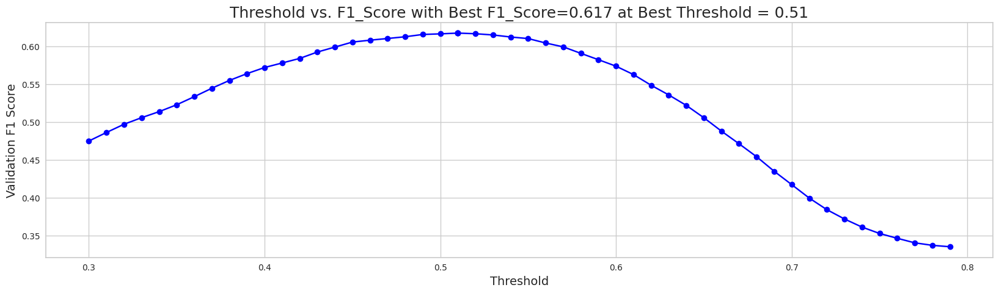

When using optimal threshold = 0.51...
Q0: F1 = 0.6173778839155484
==> Overall F1 = 0.6173778839155484
s
[I 2023-05-23 02:33:00,942] Trial 31 finished with value: 0.6173778839155484 and parameters: {'num_leaves': 91, 'learning_rate': 0.016224824663450536, 'feature_fraction': 0.5873497330436854, 'bagging_fraction': 0.7909478011437843, 'bagging_freq': 4, 'min_child_samples': 25, 'reg_alpha': 0.4140174882300578, 'reg_lambda': 0.4850443319735123, 'subsample': 0.9945468193868572, 'colsample_bytree': 0.24017854603474453, 'min_split_gain': 0.05788379626284934, 'max_depth': 4}. Best is trial 9 with value: 0.6205503068843321.


--------------------------------------------------
question10, with210features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.6442937879620242, subsample=0.9225857520677732 will be ignored. Current value: bagging_fraction=0.6442937879620242
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
[LightGBM] [Warning] feature_fraction is set=0.7141038234214119, colsample_bytree=0.3947164711671655 will be ignored. Current value: feature_fraction=0.7141038234214119


,mean
feature,
tunic.historicalsociety.frontdesk_room_fqid_counts,42.6
elapsed_time_diff_std,40.6
11_level_counts,39.2
hover_duration_mean,38.0
hover_duration_max,37.4
session_id,36.8
elapsed_time_diff_mean,36.6
room_corr_x_diff_std,35.8
room_coor_x_max,35.0


[[0.77459848 0.22540152]
 [0.59107497 0.40892503]
 [0.3933376  0.6066624 ]
 ...
 [0.35132527 0.64867473]
 [0.28940338 0.71059662]
 [0.57788739 0.42211261]]


[LightGBM] [Warning] bagging_fraction is set=0.9558923646808766, subsample=0.9956005863136611 will be ignored. Current value: bagging_fraction=0.9558923646808766
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=10, subsample_freq=0 will be ignored. Current value: bagging_freq=10
[LightGBM] [Warning] feature_fraction is set=0.8784635369803133, colsample_bytree=0.9185091782607342 will be ignored. Current value: feature_fraction=0.8784635369803133


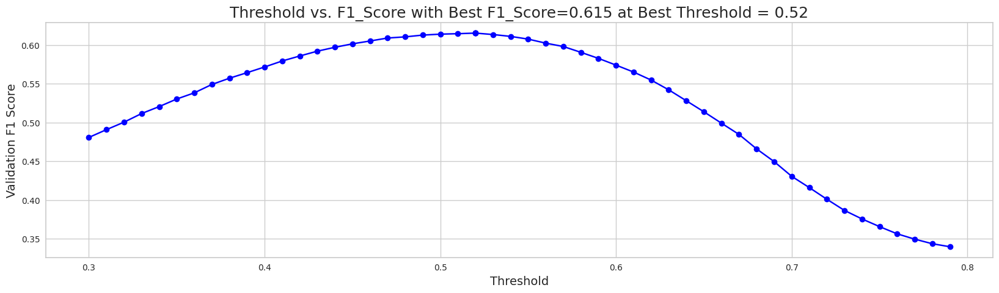

When using optimal threshold = 0.52...
Q0: F1 = 0.615174338399846


==> Overall F1 = 0.615174338399846
s
[I 2023-05-23 02:33:08,874] Trial 36 finished with value: 0.615174338399846 and parameters: {'num_leaves': 45, 'learning_rate': 0.07863404754763573, 'feature_fraction': 0.7236993448862379, 'bagging_fraction': 0.6327225861798427, 'bagging_freq': 6, 'min_child_samples': 59, 'reg_alpha': 0.3494101731595922, 'reg_lambda': 0.0010946221387175168, 'subsample': 0.9714953340233876, 'colsample_bytree': 0.39033650968004896, 'min_split_gain': 0.04872336967857934, 'max_depth': 8}. Best is trial 9 with value: 0.6205503068843321.


--------------------------------------------------
question10, with210features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.7131592371620369, subsample=0.9224071756142372 will be ignored. Current value: bagging_fraction=0.7131592371620369
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=7, subsample_freq=0 will be ignored. Current value: bagging_freq=7
[LightGBM] [Warning] feature_fraction is set=0.7033845834218729, colsample_bytree=0.4750833924110538 will be ignored. Current value: feature_fraction=0.7033845834218729


[LightGBM] [Warning] bagging_fraction is set=0.6442937879620242, subsample=0.9225857520677732 will be ignored. Current value: bagging_fraction=0.6442937879620242
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
[LightGBM] [Warning] feature_fraction is set=0.7141038234214119, colsample_bytree=0.3947164711671655 will be ignored. Current value: feature_fraction=0.7141038234214119


[LightGBM] [Warning] bagging_fraction is set=0.7131592371620369, subsample=0.9224071756142372 will be ignored. Current value: bagging_fraction=0.7131592371620369
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=7, subsample_freq=0 will be ignored. Current value: bagging_freq=7
[LightGBM] [Warning] feature_fraction is set=0.7033845834218729, colsample_bytree=0.4750833924110538 will be ignored. Current value: feature_fraction=0.7033845834218729


[LightGBM] [Warning] bagging_fraction is set=0.6442937879620242, subsample=0.9225857520677732 will be ignored. Current value: bagging_fraction=0.6442937879620242
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
[LightGBM] [Warning] feature_fraction is set=0.7141038234214119, colsample_bytree=0.3947164711671655 will be ignored. Current value: feature_fraction=0.7141038234214119


[LightGBM] [Warning] bagging_fraction is set=0.7131592371620369, subsample=0.9224071756142372 will be ignored. Current value: bagging_fraction=0.7131592371620369
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=7, subsample_freq=0 will be ignored. Current value: bagging_freq=7
[LightGBM] [Warning] feature_fraction is set=0.7033845834218729, colsample_bytree=0.4750833924110538 will be ignored. Current value: feature_fraction=0.7033845834218729


[LightGBM] [Warning] bagging_fraction is set=0.6442937879620242, subsample=0.9225857520677732 will be ignored. Current value: bagging_fraction=0.6442937879620242
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
[LightGBM] [Warning] feature_fraction is set=0.7141038234214119, colsample_bytree=0.3947164711671655 will be ignored. Current value: feature_fraction=0.7141038234214119


[LightGBM] [Warning] bagging_fraction is set=0.9768034224354949, subsample=0.9862627479926686 will be ignored. Current value: bagging_fraction=0.9768034224354949
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=10, subsample_freq=0 will be ignored. Current value: bagging_freq=10
[LightGBM] [Warning] feature_fraction is set=0.8827513204901372, colsample_bytree=0.9198394725310786 will be ignored. Current value: feature_fraction=0.8827513204901372


[LightGBM] [Warning] bagging_fraction is set=0.9558923646808766, subsample=0.9956005863136611 will be ignored. Current value: bagging_fraction=0.9558923646808766
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=10, subsample_freq=0 will be ignored. Current value: bagging_freq=10
[LightGBM] [Warning] feature_fraction is set=0.8784635369803133, colsample_bytree=0.9185091782607342 will be ignored. Current value: feature_fraction=0.8784635369803133


[LightGBM] [Warning] bagging_fraction is set=0.7131592371620369, subsample=0.9224071756142372 will be ignored. Current value: bagging_fraction=0.7131592371620369
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=7, subsample_freq=0 will be ignored. Current value: bagging_freq=7
[LightGBM] [Warning] feature_fraction is set=0.7033845834218729, colsample_bytree=0.4750833924110538 will be ignored. Current value: feature_fraction=0.7033845834218729


[LightGBM] [Warning] bagging_fraction is set=0.6442937879620242, subsample=0.9225857520677732 will be ignored. Current value: bagging_fraction=0.6442937879620242
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
[LightGBM] [Warning] feature_fraction is set=0.7141038234214119, colsample_bytree=0.3947164711671655 will be ignored. Current value: feature_fraction=0.7141038234214119


[LightGBM] [Warning] bagging_fraction is set=0.7131592371620369, subsample=0.9224071756142372 will be ignored. Current value: bagging_fraction=0.7131592371620369
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=7, subsample_freq=0 will be ignored. Current value: bagging_freq=7
[LightGBM] [Warning] feature_fraction is set=0.7033845834218729, colsample_bytree=0.4750833924110538 will be ignored. Current value: feature_fraction=0.7033845834218729


,mean
feature,
tunic.historicalsociety.frontdesk_room_fqid_counts,37.0
11_level_counts,36.8
elapsed_time_diff_std,29.6
tunic.historicalsociety.stacks_room_fqid_counts,29.2
room_corr_x_diff_std,25.6
logbook_fqid_counts,23.4
8_level_counts,21.4
elapsed_time_diff_mean,20.6
reader_fqid_counts,20.2


[[0.67016517 0.32983483]
 [0.65509054 0.34490946]
 [0.38304739 0.61695261]
 ...
 [0.32952385 0.67047615]
 [0.26861873 0.73138127]
 [0.47875159 0.52124841]]


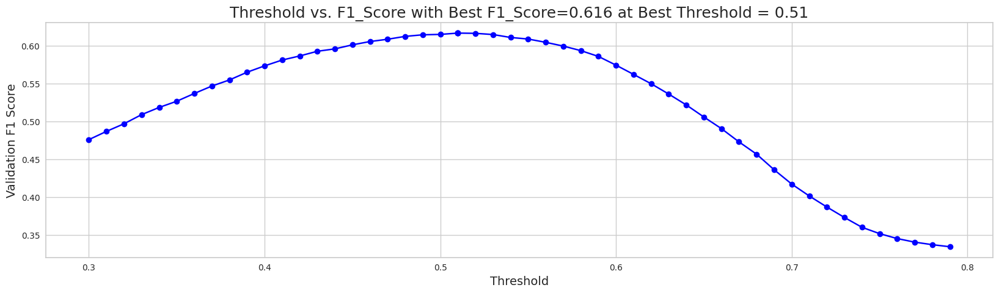

When using optimal threshold = 0.51...
Q0: F1 = 0.6164194854151186
==> Overall F1 = 0.6164194854151186
s
[I 2023-05-23 02:33:48,894] Trial 37 finished with value: 0.6164194854151186 and parameters: {'num_leaves': 10, 'learning_rate': 0.050921102446101395, 'feature_fraction': 0.7141038234214119, 'bagging_fraction': 0.6442937879620242, 'bagging_freq': 6, 'min_child_samples': 59, 'reg_alpha': 0.12851238837308576, 'reg_lambda': 0.0010494236803092844, 'subsample': 0.9225857520677732, 'colsample_bytree': 0.3947164711671655, 'min_split_gain': 0.12318382512844224, 'max_depth': 8}. Best is trial 9 with value: 0.6205503068843321.


--------------------------------------------------
question10, with210features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.7108061965308765, subsample=0.9058293642052887 will be ignored. Current value: bagging_fraction=0.7108061965308765
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=7, subsample_freq=0 will be ignored. Current value: bagging_freq=7
[LightGBM] [Warning] feature_fraction is set=0.6403256147023926, colsample_bytree=0.48139366413523327 will be ignored. Current value: feature_fraction=0.6403256147023926


,mean
feature,
tunic.historicalsociety.frontdesk_room_fqid_counts,54.2
elapsed_time_diff_std,49.8
11_level_counts,43.4
tunic.historicalsociety.stacks_room_fqid_counts,35.2
elapsed_time_diff_mean,32.6
room_corr_x_diff_std,31.2
hover_duration_mean,29.4
logbook_fqid_counts,28.6
hover_duration_sum,27.4


[[0.7175056  0.2824944 ]
 [0.57968776 0.42031224]
 [0.44605776 0.55394224]
 ...
 [0.3525329  0.6474671 ]
 [0.29069875 0.70930125]
 [0.54094475 0.45905525]]


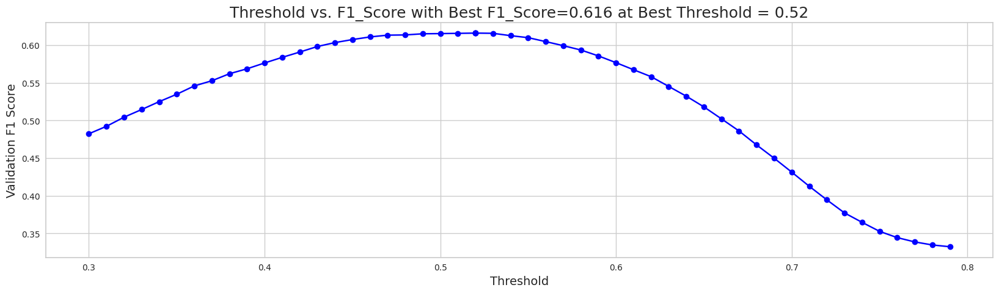

When using optimal threshold = 0.52...
Q0: F1 = 0.616141160942501
==> Overall F1 = 0.616141160942501
s
[I 2023-05-23 02:33:56,050] Trial 38 finished with value: 0.616141160942501 and parameters: {'num_leaves': 11, 'learning_rate': 0.05074887349859798, 'feature_fraction': 0.7033845834218729, 'bagging_fraction': 0.7131592371620369, 'bagging_freq': 7, 'min_child_samples': 88, 'reg_alpha': 9.55049945853025, 'reg_lambda': 0.009876352030757773, 'subsample': 0.9224071756142372, 'colsample_bytree': 0.4750833924110538, 'min_split_gain': 0.12741513385275813, 'max_depth': 6}. Best is trial 9 with value: 0.6205503068843321.


--------------------------------------------------
question10, with210features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.5610692865261533, subsample=0.8429102813638772 will be ignored. Current value: bagging_fraction=0.5610692865261533
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.6437119995567232, colsample_bytree=0.7525464868856321 will be ignored. Current value: feature_fraction=0.6437119995567232


[LightGBM] [Warning] bagging_fraction is set=0.9558923646808766, subsample=0.9956005863136611 will be ignored. Current value: bagging_fraction=0.9558923646808766
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=10, subsample_freq=0 will be ignored. Current value: bagging_freq=10
[LightGBM] [Warning] feature_fraction is set=0.8784635369803133, colsample_bytree=0.9185091782607342 will be ignored. Current value: feature_fraction=0.8784635369803133


[LightGBM] [Warning] bagging_fraction is set=0.7108061965308765, subsample=0.9058293642052887 will be ignored. Current value: bagging_fraction=0.7108061965308765
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=7, subsample_freq=0 will be ignored. Current value: bagging_freq=7
[LightGBM] [Warning] feature_fraction is set=0.6403256147023926, colsample_bytree=0.48139366413523327 will be ignored. Current value: feature_fraction=0.6403256147023926


[LightGBM] [Warning] bagging_fraction is set=0.5610692865261533, subsample=0.8429102813638772 will be ignored. Current value: bagging_fraction=0.5610692865261533
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.6437119995567232, colsample_bytree=0.7525464868856321 will be ignored. Current value: feature_fraction=0.6437119995567232


[LightGBM] [Warning] bagging_fraction is set=0.9768034224354949, subsample=0.9862627479926686 will be ignored. Current value: bagging_fraction=0.9768034224354949
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=10, subsample_freq=0 will be ignored. Current value: bagging_freq=10
[LightGBM] [Warning] feature_fraction is set=0.8827513204901372, colsample_bytree=0.9198394725310786 will be ignored. Current value: feature_fraction=0.8827513204901372


[LightGBM] [Warning] bagging_fraction is set=0.5610692865261533, subsample=0.8429102813638772 will be ignored. Current value: bagging_fraction=0.5610692865261533
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.6437119995567232, colsample_bytree=0.7525464868856321 will be ignored. Current value: feature_fraction=0.6437119995567232


[LightGBM] [Warning] bagging_fraction is set=0.7108061965308765, subsample=0.9058293642052887 will be ignored. Current value: bagging_fraction=0.7108061965308765
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=7, subsample_freq=0 will be ignored. Current value: bagging_freq=7
[LightGBM] [Warning] feature_fraction is set=0.6403256147023926, colsample_bytree=0.48139366413523327 will be ignored. Current value: feature_fraction=0.6403256147023926


,mean
feature,
tunic.historicalsociety.frontdesk_room_fqid_counts,192.8
room_coor_x_max,182.6
elapsed_time_diff_std,180.8
screen_coor_y_min,176.0
hover_duration_mean,173.8
room_coor_y_min,170.2
room_coor_y_max,166.2
11_level_counts,163.0
room_corr_x_diff_std,161.6


[[0.68168625 0.31831375]
 [0.54927342 0.45072658]
 [0.50684343 0.49315657]
 ...
 [0.41592688 0.58407312]
 [0.31892065 0.68107935]
 [0.53728341 0.46271659]]


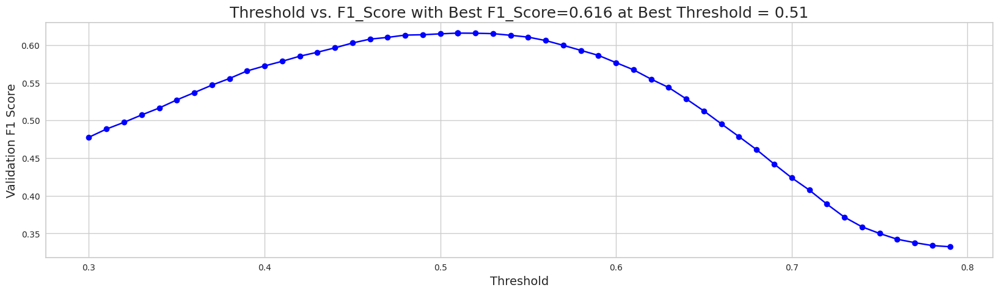

When using optimal threshold = 0.51...
Q0: F1 = 0.616019363765669
==> Overall F1 = 0.616019363765669
s
[I 2023-05-23 02:34:28,063] Trial 35 finished with value: 0.616019363765669 and parameters: {'num_leaves': 74, 'learning_rate': 0.03171414931284527, 'feature_fraction': 0.8784635369803133, 'bagging_fraction': 0.9558923646808766, 'bagging_freq': 10, 'min_child_samples': 28, 'reg_alpha': 6.855997070909732, 'reg_lambda': 3.6320814387344424, 'subsample': 0.9956005863136611, 'colsample_bytree': 0.9185091782607342, 'min_split_gain': 0.43157969095505566, 'max_depth': 9}. Best is trial 9 with value: 0.6205503068843321.


--------------------------------------------------
question10, with210features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.5643036973343843, subsample=0.6904183755978808 will be ignored. Current value: bagging_fraction=0.5643036973343843
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.6080644216747093, colsample_bytree=0.7635094933699749 will be ignored. Current value: feature_fraction=0.6080644216747093


[LightGBM] [Warning] bagging_fraction is set=0.5610692865261533, subsample=0.8429102813638772 will be ignored. Current value: bagging_fraction=0.5610692865261533
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.6437119995567232, colsample_bytree=0.7525464868856321 will be ignored. Current value: feature_fraction=0.6437119995567232
[LightGBM] [Warning] bagging_fraction is set=0.7108061965308765, subsample=0.9058293642052887 will be ignored. Current value: bagging_fraction=0.7108061965308765
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=7, subsample_freq=0 will be ignored. Current value: bagging_freq=7
[LightGBM] [Warning] fe

[LightGBM] [Warning] bagging_fraction is set=0.5643036973343843, subsample=0.6904183755978808 will be ignored. Current value: bagging_fraction=0.5643036973343843
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.6080644216747093, colsample_bytree=0.7635094933699749 will be ignored. Current value: feature_fraction=0.6080644216747093


[LightGBM] [Warning] bagging_fraction is set=0.5610692865261533, subsample=0.8429102813638772 will be ignored. Current value: bagging_fraction=0.5610692865261533
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.6437119995567232, colsample_bytree=0.7525464868856321 will be ignored. Current value: feature_fraction=0.6437119995567232


[LightGBM] [Warning] bagging_fraction is set=0.5643036973343843, subsample=0.6904183755978808 will be ignored. Current value: bagging_fraction=0.5643036973343843
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.6080644216747093, colsample_bytree=0.7635094933699749 will be ignored. Current value: feature_fraction=0.6080644216747093


[LightGBM] [Warning] bagging_fraction is set=0.7108061965308765, subsample=0.9058293642052887 will be ignored. Current value: bagging_fraction=0.7108061965308765
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=7, subsample_freq=0 will be ignored. Current value: bagging_freq=7
[LightGBM] [Warning] feature_fraction is set=0.6403256147023926, colsample_bytree=0.48139366413523327 will be ignored. Current value: feature_fraction=0.6403256147023926


[LightGBM] [Warning] bagging_fraction is set=0.9768034224354949, subsample=0.9862627479926686 will be ignored. Current value: bagging_fraction=0.9768034224354949
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=10, subsample_freq=0 will be ignored. Current value: bagging_freq=10
[LightGBM] [Warning] feature_fraction is set=0.8827513204901372, colsample_bytree=0.9198394725310786 will be ignored. Current value: feature_fraction=0.8827513204901372


,mean
feature,
elapsed_time_diff_std,97.8
hover_duration_mean,94.2
elapsed_time_diff_mean,92.4
11_level_counts,92.4
tunic.historicalsociety.frontdesk_room_fqid_counts,90.2
hover_duration_max,89.0
room_coor_x_max,84.0
hover_duration_sum,82.6
session_id,81.4


[[0.66167719 0.33832281]
 [0.59104474 0.40895526]
 [0.44101036 0.55898964]
 ...
 [0.37523545 0.62476455]
 [0.3131083  0.6868917 ]
 [0.53016225 0.46983775]]


,mean
feature,
tunic.historicalsociety.frontdesk_room_fqid_counts,101.6
elapsed_time_diff_std,97.4
11_level_counts,88.8
elapsed_time_diff_mean,82.2
room_coor_y_std,78.2
room_coor_x_std,72.4
hover_duration_sum,71.8
tunic.historicalsociety.stacks_room_fqid_counts,71.8
hover_duration_mean,71.0


[[0.68210442 0.31789558]
 [0.57750249 0.42249751]
 [0.49454625 0.50545375]
 ...
 [0.35456465 0.64543535]
 [0.32192522 0.67807478]
 [0.5188294  0.4811706 ]]


[LightGBM] [Warning] bagging_fraction is set=0.5643036973343843, subsample=0.6904183755978808 will be ignored. Current value: bagging_fraction=0.5643036973343843
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.6080644216747093, colsample_bytree=0.7635094933699749 will be ignored. Current value: feature_fraction=0.6080644216747093


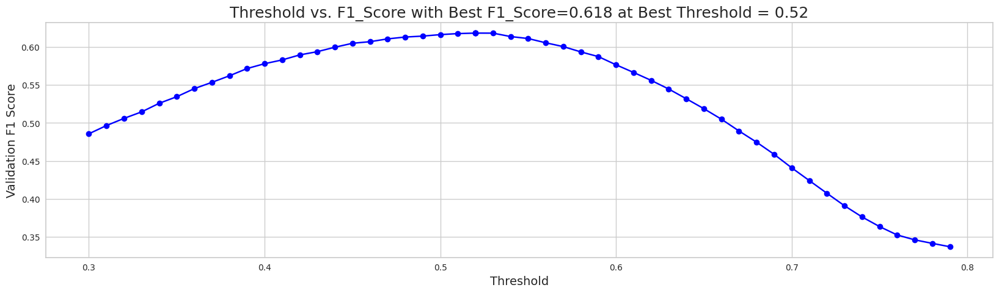

When using optimal threshold = 0.52...
Q0: F1 = 0.618132812093299
==> Overall F1 = 0.618132812093299
s
[I 2023-05-23 02:35:05,020] Trial 40 finished with value: 0.618132812093299 and parameters: {'num_leaves': 27, 'learning_rate': 0.033141047573538356, 'feature_fraction': 0.6437119995567232, 'bagging_fraction': 0.5610692865261533, 'bagging_freq': 3, 'min_child_samples': 92, 'reg_alpha': 2.7673260892917493, 'reg_lambda': 0.003169830192265907, 'subsample': 0.8429102813638772, 'colsample_bytree': 0.7525464868856321, 'min_split_gain': 0.032865719405373146, 'max_depth': 9}. Best is trial 9 with value: 0.6205503068843321.


--------------------------------------------------
question10, with210features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.919639018105476, subsample=0.7018329229161272 will be ignored. Current value: bagging_fraction=0.919639018105476
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.6004683512842617, colsample_bytree=0.6108465669779174 will be ignored. Current value: feature_fraction=0.6004683512842617


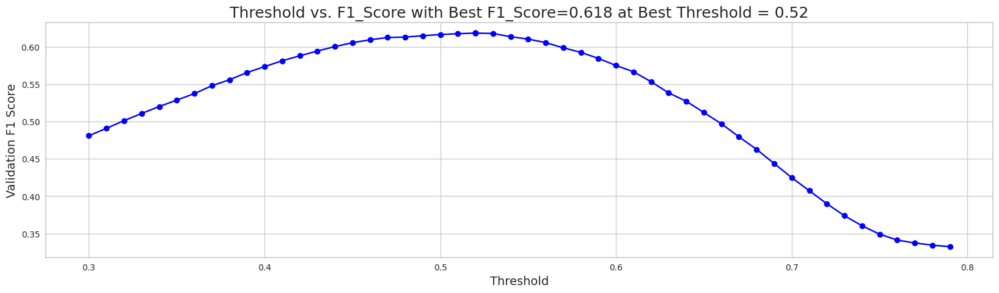

When using optimal threshold = 0.52...
Q0: F1 = 0.6184776244569457
==> Overall F1 = 0.6184776244569457
s
[I 2023-05-23 02:35:07,768] Trial 39 finished with value: 0.6184776244569457 and parameters: {'num_leaves': 27, 'learning_rate': 0.033604559636503294, 'feature_fraction': 0.6403256147023926, 'bagging_fraction': 0.7108061965308765, 'bagging_freq': 7, 'min_child_samples': 92, 'reg_alpha': 8.988794948779963, 'reg_lambda': 0.0023987780690719884, 'subsample': 0.9058293642052887, 'colsample_bytree': 0.48139366413523327, 'min_split_gain': 0.09956705931874055, 'max_depth': 6}. Best is trial 9 with value: 0.6205503068843321.


--------------------------------------------------
question10, with210features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.9169192511521442, subsample=0.8372540358680829 will be ignored. Current value: bagging_fraction=0.9169192511521442
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.5363836249055174, colsample_bytree=0.8396645007135977 will be ignored. Current value: feature_fraction=0.5363836249055174


[LightGBM] [Warning] bagging_fraction is set=0.919639018105476, subsample=0.7018329229161272 will be ignored. Current value: bagging_fraction=0.919639018105476
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.6004683512842617, colsample_bytree=0.6108465669779174 will be ignored. Current value: feature_fraction=0.6004683512842617


[LightGBM] [Warning] bagging_fraction is set=0.5643036973343843, subsample=0.6904183755978808 will be ignored. Current value: bagging_fraction=0.5643036973343843
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.6080644216747093, colsample_bytree=0.7635094933699749 will be ignored. Current value: feature_fraction=0.6080644216747093


[LightGBM] [Warning] bagging_fraction is set=0.9169192511521442, subsample=0.8372540358680829 will be ignored. Current value: bagging_fraction=0.9169192511521442
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.5363836249055174, colsample_bytree=0.8396645007135977 will be ignored. Current value: feature_fraction=0.5363836249055174


[LightGBM] [Warning] bagging_fraction is set=0.919639018105476, subsample=0.7018329229161272 will be ignored. Current value: bagging_fraction=0.919639018105476
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.6004683512842617, colsample_bytree=0.6108465669779174 will be ignored. Current value: feature_fraction=0.6004683512842617


,mean
feature,
tunic.historicalsociety.frontdesk_room_fqid_counts,40.8
11_level_counts,40.2
elapsed_time_diff_std,37.0
8_level_counts,31.4
tunic.historicalsociety.stacks_room_fqid_counts,27.8
logbook_fqid_counts,27.6
room_corr_x_diff_std,27.4
reader_fqid_counts,24.4
elapsed_time_diff_mean,23.4


[[0.63897223 0.36102777]
 [0.56943656 0.43056344]
 [0.41764021 0.58235979]
 ...
 [0.37477098 0.62522902]
 [0.30717829 0.69282171]
 [0.52061508 0.47938492]]


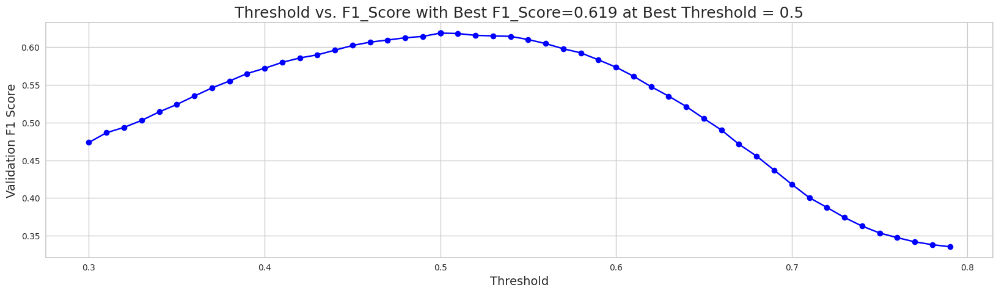

When using optimal threshold = 0.50...
Q0: F1 = 0.6186221784003976
==> Overall F1 = 0.6186221784003976
s
[I 2023-05-23 02:35:30,663] Trial 41 finished with value: 0.6186221784003976 and parameters: {'num_leaves': 28, 'learning_rate': 0.03395430922386233, 'feature_fraction': 0.6080644216747093, 'bagging_fraction': 0.5643036973343843, 'bagging_freq': 3, 'min_child_samples': 74, 'reg_alpha': 0.06126138403741197, 'reg_lambda': 0.002026521036217288, 'subsample': 0.6904183755978808, 'colsample_bytree': 0.7635094933699749, 'min_split_gain': 0.09317542324751926, 'max_depth': 2}. Best is trial 9 with value: 0.6205503068843321.


--------------------------------------------------
question10, with210features
--------------------------------------------------


,mean
feature,
elapsed_time_diff_std,400.2
tunic.historicalsociety.frontdesk_room_fqid_counts,399.6
11_level_counts,374.6
room_coor_x_max,364.2
room_corr_x_diff_std,351.6
room_coor_y_max,351.2
hover_duration_mean,345.4
screen_coor_y_min,344.6
room_coor_x_std,339.8


[LightGBM] [Warning] bagging_fraction is set=0.9197009729597658, subsample=0.9921686678226509 will be ignored. Current value: bagging_fraction=0.9197009729597658
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=8, subsample_freq=0 will be ignored. Current value: bagging_freq=8
[LightGBM] [Warning] feature_fraction is set=0.5217808872975765, colsample_bytree=0.8438366689144696 will be ignored. Current value: feature_fraction=0.5217808872975765
[LightGBM] [Warning] bagging_fraction is set=0.919639018105476, subsample=0.7018329229161272 will be ignored. Current value: bagging_fraction=0.919639018105476
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feat

[[0.71513061 0.28486939]
 [0.54539837 0.45460163]
 [0.42657063 0.57342937]
 ...
 [0.39620816 0.60379184]
 [0.32079843 0.67920157]
 [0.54035549 0.45964451]]


[LightGBM] [Warning] bagging_fraction is set=0.9169192511521442, subsample=0.8372540358680829 will be ignored. Current value: bagging_fraction=0.9169192511521442
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.5363836249055174, colsample_bytree=0.8396645007135977 will be ignored. Current value: feature_fraction=0.5363836249055174


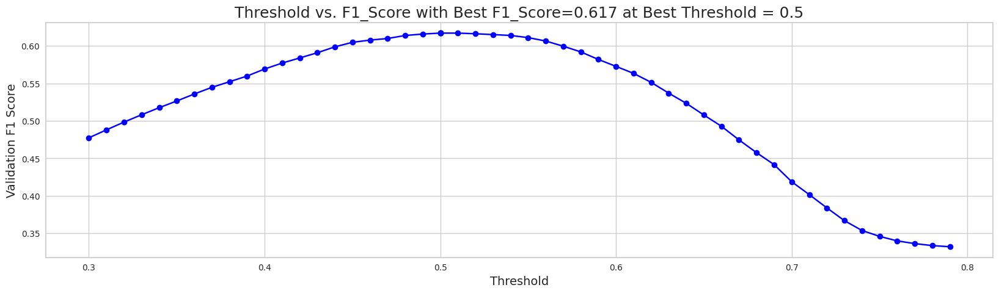

When using optimal threshold = 0.50...
Q0: F1 = 0.616973464643388
==> Overall F1 = 0.616973464643388
s
[I 2023-05-23 02:35:34,892] Trial 34 finished with value: 0.616973464643388 and parameters: {'num_leaves': 76, 'learning_rate': 0.014050976436792147, 'feature_fraction': 0.8827513204901372, 'bagging_fraction': 0.9768034224354949, 'bagging_freq': 10, 'min_child_samples': 27, 'reg_alpha': 5.844549503081435, 'reg_lambda': 0.4605984895998931, 'subsample': 0.9862627479926686, 'colsample_bytree': 0.9198394725310786, 'min_split_gain': 0.5126879163443733, 'max_depth': 9}. Best is trial 9 with value: 0.6205503068843321.


--------------------------------------------------
question10, with210features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.9030779689156944, subsample=0.8834737937074486 will be ignored. Current value: bagging_fraction=0.9030779689156944
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=8, subsample_freq=0 will be ignored. Current value: bagging_freq=8
[LightGBM] [Warning] feature_fraction is set=0.5290143318714271, colsample_bytree=0.6335381000158391 will be ignored. Current value: feature_fraction=0.5290143318714271


[LightGBM] [Warning] bagging_fraction is set=0.919639018105476, subsample=0.7018329229161272 will be ignored. Current value: bagging_fraction=0.919639018105476
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.6004683512842617, colsample_bytree=0.6108465669779174 will be ignored. Current value: feature_fraction=0.6004683512842617


[LightGBM] [Warning] bagging_fraction is set=0.9169192511521442, subsample=0.8372540358680829 will be ignored. Current value: bagging_fraction=0.9169192511521442
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.5363836249055174, colsample_bytree=0.8396645007135977 will be ignored. Current value: feature_fraction=0.5363836249055174
[LightGBM] [Warning] bagging_fraction is set=0.9197009729597658, subsample=0.9921686678226509 will be ignored. Current value: bagging_fraction=0.9197009729597658
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=8, subsample_freq=0 will be ignored. Current value: bagging_freq=8
[LightGBM] [Warning] fe

,mean
feature,
11_level_counts,40.8
tunic.historicalsociety.frontdesk_room_fqid_counts,39.6
elapsed_time_diff_std,39.4
hover_duration_max,39.4
room_coor_x_max,34.8
room_coor_y_max,34.8
hover_duration_sum,34.8
tunic.historicalsociety.stacks_room_fqid_counts,34.4
elapsed_time_diff_mean,33.6


[[0.72372165 0.27627835]
 [0.5362933  0.4637067 ]
 [0.55434918 0.44565082]
 ...
 [0.30338408 0.69661592]
 [0.26939438 0.73060562]
 [0.54968032 0.45031968]]


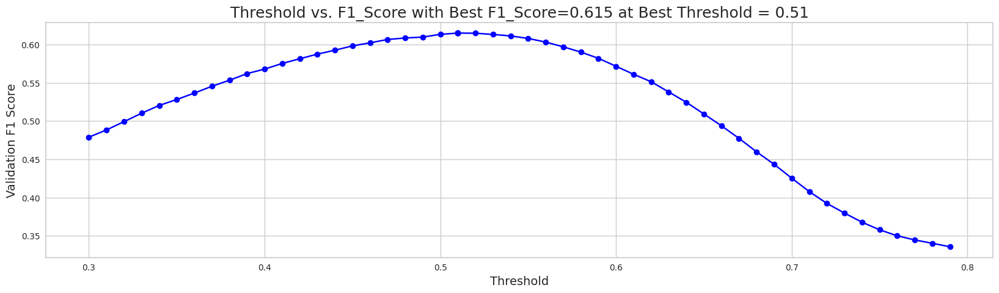

When using optimal threshold = 0.51...
Q0: F1 = 0.614974711999007
==> Overall F1 = 0.614974711999007
s
[I 2023-05-23 02:35:50,657] Trial 42 finished with value: 0.614974711999007 and parameters: {'num_leaves': 50, 'learning_rate': 0.08945306733806623, 'feature_fraction': 0.6004683512842617, 'bagging_fraction': 0.919639018105476, 'bagging_freq': 1, 'min_child_samples': 73, 'reg_alpha': 0.07766424350294532, 'reg_lambda': 0.0077256605254422015, 'subsample': 0.7018329229161272, 'colsample_bytree': 0.6108465669779174, 'min_split_gain': 0.26740107903477356, 'max_depth': 10}. Best is trial 9 with value: 0.6205503068843321.


--------------------------------------------------
question10, with210features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.9278563119702334, subsample=0.881754764388873 will be ignored. Current value: bagging_fraction=0.9278563119702334
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=8, subsample_freq=0 will be ignored. Current value: bagging_freq=8
[LightGBM] [Warning] feature_fraction is set=0.5268367844776657, colsample_bytree=0.804513795086243 will be ignored. Current value: feature_fraction=0.5268367844776657


[LightGBM] [Warning] bagging_fraction is set=0.9169192511521442, subsample=0.8372540358680829 will be ignored. Current value: bagging_fraction=0.9169192511521442
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.5363836249055174, colsample_bytree=0.8396645007135977 will be ignored. Current value: feature_fraction=0.5363836249055174


[LightGBM] [Warning] bagging_fraction is set=0.9197009729597658, subsample=0.9921686678226509 will be ignored. Current value: bagging_fraction=0.9197009729597658
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=8, subsample_freq=0 will be ignored. Current value: bagging_freq=8
[LightGBM] [Warning] feature_fraction is set=0.5217808872975765, colsample_bytree=0.8438366689144696 will be ignored. Current value: feature_fraction=0.5217808872975765


,mean
feature,
elapsed_time_diff_std,39.0
hover_duration_max,38.0
tunic.historicalsociety.stacks_room_fqid_counts,37.0
hover_duration_sum,34.6
elapsed_time_diff_mean,34.4
11_level_counts,33.8
screen_coor_x_std,32.4
tunic.historicalsociety.frontdesk_room_fqid_counts,31.6
room_coor_x_std,30.2


[[0.65873446 0.34126554]
 [0.57976298 0.42023702]
 [0.39837698 0.60162302]
 ...
 [0.32255848 0.67744152]
 [0.34186307 0.65813693]
 [0.43806355 0.56193645]]


[LightGBM] [Warning] bagging_fraction is set=0.9197009729597658, subsample=0.9921686678226509 will be ignored. Current value: bagging_fraction=0.9197009729597658
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=8, subsample_freq=0 will be ignored. Current value: bagging_freq=8
[LightGBM] [Warning] feature_fraction is set=0.5217808872975765, colsample_bytree=0.8438366689144696 will be ignored. Current value: feature_fraction=0.5217808872975765


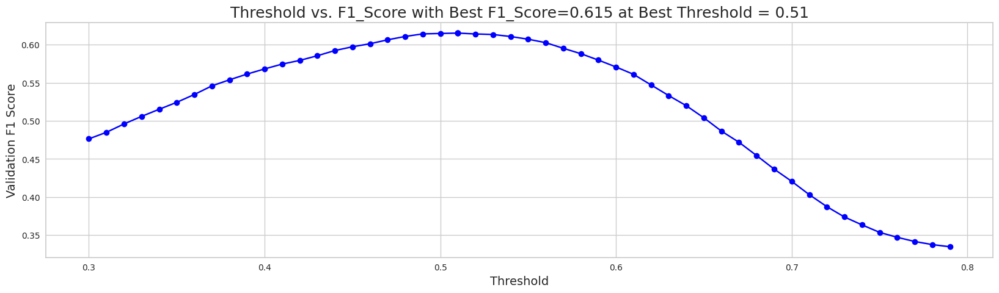

When using optimal threshold = 0.51...
Q0: F1 = 0.615329111983558
==> Overall F1 = 0.615329111983558
s
[I 2023-05-23 02:36:09,574] Trial 43 finished with value: 0.615329111983558 and parameters: {'num_leaves': 50, 'learning_rate': 0.08575359797031254, 'feature_fraction': 0.5363836249055174, 'bagging_fraction': 0.9169192511521442, 'bagging_freq': 1, 'min_child_samples': 43, 'reg_alpha': 0.08088983270712657, 'reg_lambda': 0.0017345587009901008, 'subsample': 0.8372540358680829, 'colsample_bytree': 0.8396645007135977, 'min_split_gain': 0.043514945528429196, 'max_depth': 10}. Best is trial 9 with value: 0.6205503068843321.


--------------------------------------------------
question10, with210features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.9334045566685945, subsample=0.8940767452462591 will be ignored. Current value: bagging_fraction=0.9334045566685945
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=8, subsample_freq=0 will be ignored. Current value: bagging_freq=8
[LightGBM] [Warning] feature_fraction is set=0.6800140265383537, colsample_bytree=0.8441958174585269 will be ignored. Current value: feature_fraction=0.6800140265383537


[LightGBM] [Warning] bagging_fraction is set=0.9030779689156944, subsample=0.8834737937074486 will be ignored. Current value: bagging_fraction=0.9030779689156944
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=8, subsample_freq=0 will be ignored. Current value: bagging_freq=8
[LightGBM] [Warning] feature_fraction is set=0.5290143318714271, colsample_bytree=0.6335381000158391 will be ignored. Current value: feature_fraction=0.5290143318714271


[LightGBM] [Warning] bagging_fraction is set=0.9197009729597658, subsample=0.9921686678226509 will be ignored. Current value: bagging_fraction=0.9197009729597658
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=8, subsample_freq=0 will be ignored. Current value: bagging_freq=8
[LightGBM] [Warning] feature_fraction is set=0.5217808872975765, colsample_bytree=0.8438366689144696 will be ignored. Current value: feature_fraction=0.5217808872975765


[LightGBM] [Warning] bagging_fraction is set=0.9278563119702334, subsample=0.881754764388873 will be ignored. Current value: bagging_fraction=0.9278563119702334
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=8, subsample_freq=0 will be ignored. Current value: bagging_freq=8
[LightGBM] [Warning] feature_fraction is set=0.5268367844776657, colsample_bytree=0.804513795086243 will be ignored. Current value: feature_fraction=0.5268367844776657


,mean
feature,
elapsed_time_diff_std,42.6
screen_coor_x_std,37.8
11_level_counts,36.4
room_coor_x_max,36.0
session_id,35.6
elapsed_time_diff_mean,35.4
tunic.historicalsociety.stacks_room_fqid_counts,34.4
hover_duration_sum,34.2
room_coor_x_min,32.4


[[0.7324823  0.2675177 ]
 [0.51870132 0.48129868]
 [0.39196868 0.60803132]
 ...
 [0.33640192 0.66359808]
 [0.30950824 0.69049176]
 [0.52346337 0.47653663]]


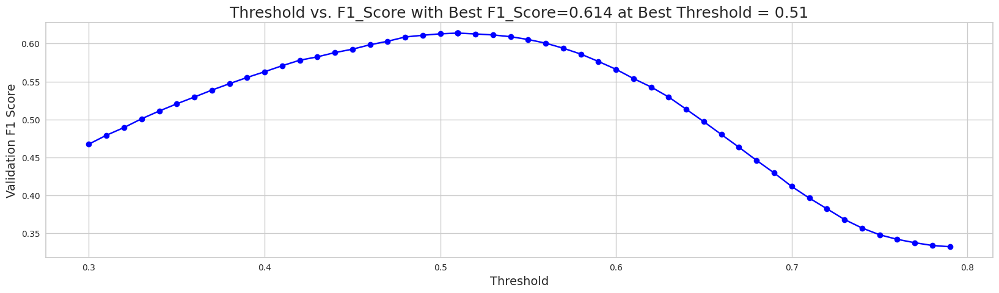

When using optimal threshold = 0.51...
Q0: F1 = 0.6137976612831663
==> Overall F1 = 0.6137976612831663
s
[I 2023-05-23 02:36:33,495] Trial 44 finished with value: 0.6137976612831663 and parameters: {'num_leaves': 79, 'learning_rate': 0.10096375797142128, 'feature_fraction': 0.5217808872975765, 'bagging_fraction': 0.9197009729597658, 'bagging_freq': 8, 'min_child_samples': 38, 'reg_alpha': 0.8824448681229791, 'reg_lambda': 0.007601176856816324, 'subsample': 0.9921686678226509, 'colsample_bytree': 0.8438366689144696, 'min_split_gain': 0.21097734807270963, 'max_depth': 10}. Best is trial 9 with value: 0.6205503068843321.


--------------------------------------------------
question10, with210features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.9741087705605678, subsample=0.9035662632850539 will be ignored. Current value: bagging_fraction=0.9741087705605678
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=9, subsample_freq=0 will be ignored. Current value: bagging_freq=9
[LightGBM] [Warning] feature_fraction is set=0.7923813654465823, colsample_bytree=0.6607833916135656 will be ignored. Current value: feature_fraction=0.7923813654465823


[LightGBM] [Warning] bagging_fraction is set=0.9334045566685945, subsample=0.8940767452462591 will be ignored. Current value: bagging_fraction=0.9334045566685945
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=8, subsample_freq=0 will be ignored. Current value: bagging_freq=8
[LightGBM] [Warning] feature_fraction is set=0.6800140265383537, colsample_bytree=0.8441958174585269 will be ignored. Current value: feature_fraction=0.6800140265383537


[LightGBM] [Warning] bagging_fraction is set=0.9278563119702334, subsample=0.881754764388873 will be ignored. Current value: bagging_fraction=0.9278563119702334
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=8, subsample_freq=0 will be ignored. Current value: bagging_freq=8
[LightGBM] [Warning] feature_fraction is set=0.5268367844776657, colsample_bytree=0.804513795086243 will be ignored. Current value: feature_fraction=0.5268367844776657


[LightGBM] [Warning] bagging_fraction is set=0.9030779689156944, subsample=0.8834737937074486 will be ignored. Current value: bagging_fraction=0.9030779689156944
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=8, subsample_freq=0 will be ignored. Current value: bagging_freq=8
[LightGBM] [Warning] feature_fraction is set=0.5290143318714271, colsample_bytree=0.6335381000158391 will be ignored. Current value: feature_fraction=0.5290143318714271


[LightGBM] [Warning] bagging_fraction is set=0.9334045566685945, subsample=0.8940767452462591 will be ignored. Current value: bagging_fraction=0.9334045566685945
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=8, subsample_freq=0 will be ignored. Current value: bagging_freq=8
[LightGBM] [Warning] feature_fraction is set=0.6800140265383537, colsample_bytree=0.8441958174585269 will be ignored. Current value: feature_fraction=0.6800140265383537


[LightGBM] [Warning] bagging_fraction is set=0.9278563119702334, subsample=0.881754764388873 will be ignored. Current value: bagging_fraction=0.9278563119702334
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=8, subsample_freq=0 will be ignored. Current value: bagging_freq=8
[LightGBM] [Warning] feature_fraction is set=0.5268367844776657, colsample_bytree=0.804513795086243 will be ignored. Current value: feature_fraction=0.5268367844776657


[LightGBM] [Warning] bagging_fraction is set=0.9741087705605678, subsample=0.9035662632850539 will be ignored. Current value: bagging_fraction=0.9741087705605678
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=9, subsample_freq=0 will be ignored. Current value: bagging_freq=9
[LightGBM] [Warning] feature_fraction is set=0.7923813654465823, colsample_bytree=0.6607833916135656 will be ignored. Current value: feature_fraction=0.7923813654465823


[LightGBM] [Warning] bagging_fraction is set=0.9030779689156944, subsample=0.8834737937074486 will be ignored. Current value: bagging_fraction=0.9030779689156944
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=8, subsample_freq=0 will be ignored. Current value: bagging_freq=8
[LightGBM] [Warning] feature_fraction is set=0.5290143318714271, colsample_bytree=0.6335381000158391 will be ignored. Current value: feature_fraction=0.5290143318714271


[LightGBM] [Warning] bagging_fraction is set=0.9278563119702334, subsample=0.881754764388873 will be ignored. Current value: bagging_fraction=0.9278563119702334
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=8, subsample_freq=0 will be ignored. Current value: bagging_freq=8
[LightGBM] [Warning] feature_fraction is set=0.5268367844776657, colsample_bytree=0.804513795086243 will be ignored. Current value: feature_fraction=0.5268367844776657


[LightGBM] [Warning] bagging_fraction is set=0.9334045566685945, subsample=0.8940767452462591 will be ignored. Current value: bagging_fraction=0.9334045566685945
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=8, subsample_freq=0 will be ignored. Current value: bagging_freq=8
[LightGBM] [Warning] feature_fraction is set=0.6800140265383537, colsample_bytree=0.8441958174585269 will be ignored. Current value: feature_fraction=0.6800140265383537


[LightGBM] [Warning] bagging_fraction is set=0.9030779689156944, subsample=0.8834737937074486 will be ignored. Current value: bagging_fraction=0.9030779689156944
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=8, subsample_freq=0 will be ignored. Current value: bagging_freq=8
[LightGBM] [Warning] feature_fraction is set=0.5290143318714271, colsample_bytree=0.6335381000158391 will be ignored. Current value: feature_fraction=0.5290143318714271


[LightGBM] [Warning] bagging_fraction is set=0.9741087705605678, subsample=0.9035662632850539 will be ignored. Current value: bagging_fraction=0.9741087705605678
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=9, subsample_freq=0 will be ignored. Current value: bagging_freq=9
[LightGBM] [Warning] feature_fraction is set=0.7923813654465823, colsample_bytree=0.6607833916135656 will be ignored. Current value: feature_fraction=0.7923813654465823


,mean
feature,
hover_duration_mean,293.4
elapsed_time_diff_std,284.2
elapsed_time_diff_mean,273.4
room_coor_y_max,266.2
room_coor_x_std,263.2
room_coor_x_max,258.4
session_id,255.4
hover_duration_std,255.0
hover_duration_max,253.4


[[0.6839349  0.3160651 ]
 [0.54741165 0.45258835]
 [0.44633466 0.55366534]
 ...
 [0.32641557 0.67358443]
 [0.30852693 0.69147307]
 [0.51903686 0.48096314]]


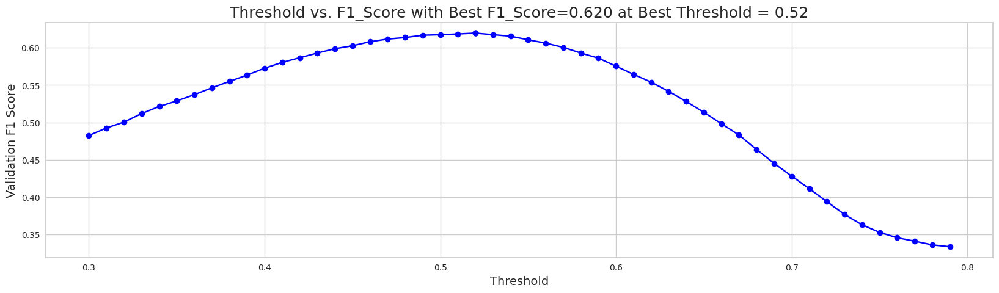

When using optimal threshold = 0.52...
Q0: F1 = 0.6195616445108599
==> Overall F1 = 0.6195616445108599
s
[I 2023-05-23 02:38:01,168] Trial 46 finished with value: 0.6195616445108599 and parameters: {'num_leaves': 69, 'learning_rate': 0.019578993524894627, 'feature_fraction': 0.5268367844776657, 'bagging_fraction': 0.9278563119702334, 'bagging_freq': 8, 'min_child_samples': 43, 'reg_alpha': 3.5522259117025685, 'reg_lambda': 0.2193922714730096, 'subsample': 0.881754764388873, 'colsample_bytree': 0.804513795086243, 'min_split_gain': 0.18752690589259755, 'max_depth': 8}. Best is trial 9 with value: 0.6205503068843321.


--------------------------------------------------
question10, with210features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.956878525406436, subsample=0.9072175209245341 will be ignored. Current value: bagging_fraction=0.956878525406436
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=9, subsample_freq=0 will be ignored. Current value: bagging_freq=9
[LightGBM] [Warning] feature_fraction is set=0.6790814191990378, colsample_bytree=0.6954391695357957 will be ignored. Current value: feature_fraction=0.6790814191990378


[LightGBM] [Warning] bagging_fraction is set=0.9334045566685945, subsample=0.8940767452462591 will be ignored. Current value: bagging_fraction=0.9334045566685945
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=8, subsample_freq=0 will be ignored. Current value: bagging_freq=8
[LightGBM] [Warning] feature_fraction is set=0.6800140265383537, colsample_bytree=0.8441958174585269 will be ignored. Current value: feature_fraction=0.6800140265383537


,mean
feature,
hover_duration_mean,319.8
elapsed_time_diff_std,309.2
elapsed_time_diff_mean,292.6
room_coor_y_max,289.6
hover_duration_max,285.6
hover_duration_std,278.8
room_coor_x_max,276.4
room_coor_x_std,274.8
room_coor_x_min,274.0


[[0.69183708 0.30816292]
 [0.49401607 0.50598393]
 [0.45478079 0.54521921]
 ...
 [0.37263798 0.62736202]
 [0.29459452 0.70540548]
 [0.57760748 0.42239252]]


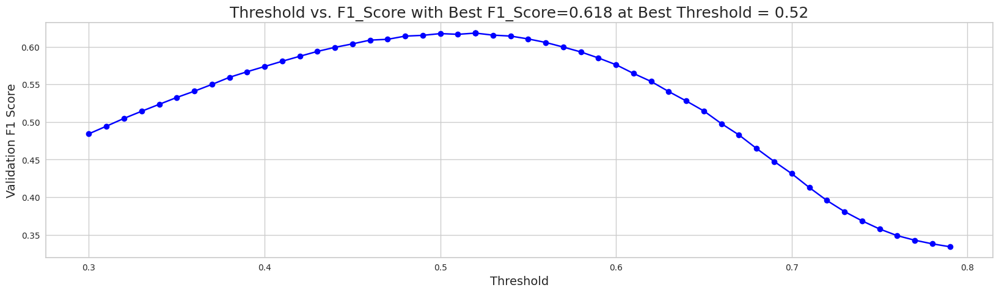

When using optimal threshold = 0.52...
Q0: F1 = 0.6181729920494748
==> Overall F1 = 0.6181729920494748
s
[I 2023-05-23 02:38:31,097] Trial 45 finished with value: 0.6181729920494748 and parameters: {'num_leaves': 71, 'learning_rate': 0.018885432761863476, 'feature_fraction': 0.5290143318714271, 'bagging_fraction': 0.9030779689156944, 'bagging_freq': 8, 'min_child_samples': 40, 'reg_alpha': 3.5533383794244457, 'reg_lambda': 0.15681715199399685, 'subsample': 0.8834737937074486, 'colsample_bytree': 0.6335381000158391, 'min_split_gain': 0.23118364999404903, 'max_depth': 10}. Best is trial 9 with value: 0.6205503068843321.


[LightGBM] [Warning] bagging_fraction is set=0.956878525406436, subsample=0.9072175209245341 will be ignored. Current value: bagging_fraction=0.956878525406436
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=9, subsample_freq=0 will be ignored. Current value: bagging_freq=9
[LightGBM] [Warning] feature_fraction is set=0.6790814191990378, colsample_bytree=0.6954391695357957 will be ignored. Current value: feature_fraction=0.6790814191990378


,mean
feature,
elapsed_time_diff_std,251.4
tunic.historicalsociety.frontdesk_room_fqid_counts,248.8
room_coor_x_max,238.2
hover_duration_mean,237.2
elapsed_time_diff_mean,237.2
session_id,233.2
room_corr_x_diff_std,230.8
11_level_counts,230.4
hover_duration_max,225.6


[[0.67141717 0.32858283]
 [0.50353863 0.49646137]
 [0.49151684 0.50848316]
 ...
 [0.37632232 0.62367768]
 [0.2938004  0.7061996 ]
 [0.58547319 0.41452681]]
[LightGBM] [Warning] bagging_fraction is set=0.9741087705605678, subsample=0.9035662632850539 will be ignored. Current value: bagging_fraction=0.9741087705605678
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=9, subsample_freq=0 will be ignored. Current value: bagging_freq=9
[LightGBM] [Warning] feature_fraction is set=0.7923813654465823, colsample_bytree=0.6607833916135656 will be ignored. Current value: feature_fraction=0.7923813654465823


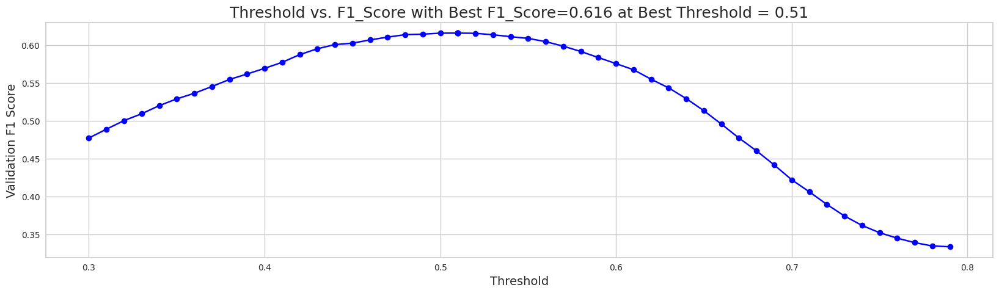

When using optimal threshold = 0.51...
Q0: F1 = 0.6157782440668068
==> Overall F1 = 0.6157782440668068
s
[I 2023-05-23 02:38:41,229] Trial 47 finished with value: 0.6157782440668068 and parameters: {'num_leaves': 68, 'learning_rate': 0.019984479785780978, 'feature_fraction': 0.6800140265383537, 'bagging_fraction': 0.9334045566685945, 'bagging_freq': 8, 'min_child_samples': 38, 'reg_alpha': 3.407282172161531, 'reg_lambda': 0.13520733911165522, 'subsample': 0.8940767452462591, 'colsample_bytree': 0.8441958174585269, 'min_split_gain': 0.19168119066375508, 'max_depth': 8}. Best is trial 9 with value: 0.6205503068843321.


[LightGBM] [Warning] bagging_fraction is set=0.956878525406436, subsample=0.9072175209245341 will be ignored. Current value: bagging_fraction=0.956878525406436
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=9, subsample_freq=0 will be ignored. Current value: bagging_freq=9
[LightGBM] [Warning] feature_fraction is set=0.6790814191990378, colsample_bytree=0.6954391695357957 will be ignored. Current value: feature_fraction=0.6790814191990378


[LightGBM] [Warning] bagging_fraction is set=0.9741087705605678, subsample=0.9035662632850539 will be ignored. Current value: bagging_fraction=0.9741087705605678
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=9, subsample_freq=0 will be ignored. Current value: bagging_freq=9
[LightGBM] [Warning] feature_fraction is set=0.7923813654465823, colsample_bytree=0.6607833916135656 will be ignored. Current value: feature_fraction=0.7923813654465823


,mean
feature,
room_coor_x_max,310.0
elapsed_time_diff_std,305.0
room_coor_x_std,301.2
tunic.historicalsociety.frontdesk_room_fqid_counts,296.2
room_coor_y_min,285.2
hover_duration_mean,283.4
room_coor_y_max,281.4
11_level_counts,280.8
session_id,279.0


[[0.69793682 0.30206318]
 [0.54343431 0.45656569]
 [0.47466892 0.52533108]
 ...
 [0.39810891 0.60189109]
 [0.31203638 0.68796362]
 [0.52523039 0.47476961]]


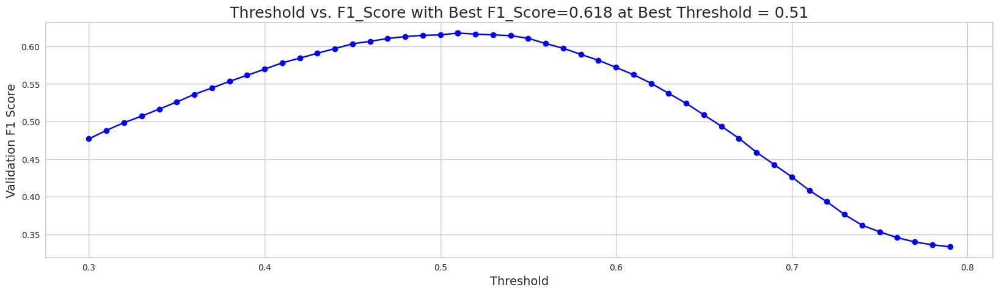

When using optimal threshold = 0.51...
Q0: F1 = 0.6175185183646401
==> Overall F1 = 0.6175185183646401
s
[I 2023-05-23 02:39:16,132] Trial 48 finished with value: 0.6175185183646401 and parameters: {'num_leaves': 93, 'learning_rate': 0.01961224256335001, 'feature_fraction': 0.7923813654465823, 'bagging_fraction': 0.9741087705605678, 'bagging_freq': 9, 'min_child_samples': 53, 'reg_alpha': 3.810802753390193, 'reg_lambda': 0.12624243930733173, 'subsample': 0.9035662632850539, 'colsample_bytree': 0.6607833916135656, 'min_split_gain': 0.16160201891183962, 'max_depth': 0}. Best is trial 9 with value: 0.6205503068843321.


[LightGBM] [Warning] bagging_fraction is set=0.956878525406436, subsample=0.9072175209245341 will be ignored. Current value: bagging_fraction=0.956878525406436
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=9, subsample_freq=0 will be ignored. Current value: bagging_freq=9
[LightGBM] [Warning] feature_fraction is set=0.6790814191990378, colsample_bytree=0.6954391695357957 will be ignored. Current value: feature_fraction=0.6790814191990378


[LightGBM] [Warning] bagging_fraction is set=0.956878525406436, subsample=0.9072175209245341 will be ignored. Current value: bagging_fraction=0.956878525406436
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=9, subsample_freq=0 will be ignored. Current value: bagging_freq=9
[LightGBM] [Warning] feature_fraction is set=0.6790814191990378, colsample_bytree=0.6954391695357957 will be ignored. Current value: feature_fraction=0.6790814191990378


,mean
feature,
elapsed_time_diff_std,272.8
hover_duration_mean,271.6
tunic.historicalsociety.frontdesk_room_fqid_counts,253.2
elapsed_time_diff_mean,248.4
11_level_counts,247.8
room_corr_x_diff_std,235.8
room_coor_y_max,232.0
hover_duration_max,231.6
room_coor_x_std,228.2


[[0.69905266 0.30094734]
 [0.53208462 0.46791538]
 [0.47028774 0.52971226]
 ...
 [0.35068976 0.64931024]
 [0.29432442 0.70567558]
 [0.54044419 0.45955581]]


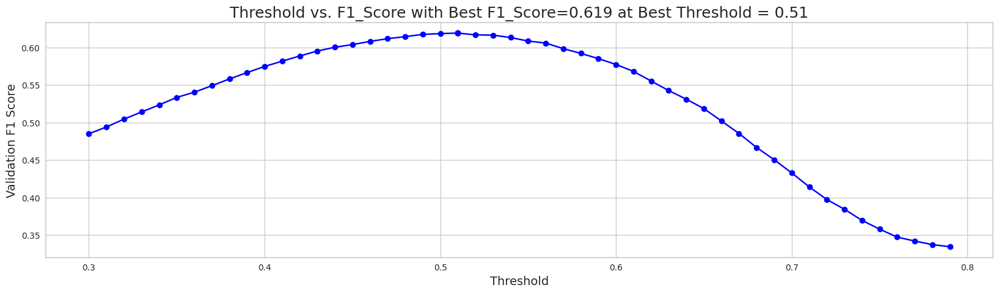

When using optimal threshold = 0.51...
Q0: F1 = 0.6191089950356257
==> Overall F1 = 0.6191089950356257
s
[I 2023-05-23 02:39:48,026] Trial 49 finished with value: 0.6191089950356257 and parameters: {'num_leaves': 58, 'learning_rate': 0.018598857340779328, 'feature_fraction': 0.6790814191990378, 'bagging_fraction': 0.956878525406436, 'bagging_freq': 9, 'min_child_samples': 52, 'reg_alpha': 2.839237431382036, 'reg_lambda': 0.20968855167948017, 'subsample': 0.9072175209245341, 'colsample_bytree': 0.6954391695357957, 'min_split_gain': 0.15961085302183664, 'max_depth': 0}. Best is trial 9 with value: 0.6205503068843321.


[I 2023-05-23 02:39:48,529] A new study created in memory with name: no-name-d34898c4-face-449e-8de4-856d372b07c2


{'num_leaves': 82, 'learning_rate': 0.016021580914962676, 'feature_fraction': 0.7281689587093481, 'bagging_fraction': 0.8653376481147026, 'bagging_freq': 2, 'min_child_samples': 84, 'reg_alpha': 1.6598548263287682, 'reg_lambda': 0.00334647175146375, 'subsample': 0.5442549562850089, 'colsample_bytree': 0.23277610246686353, 'min_split_gain': 0.01272676545915691, 'max_depth': 0}


  0%|          | 0/50 [00:00<?, ?it/s]

--------------------------------------------------
question11, with210features
--------------------------------------------------
--------------------------------------------------
question11, with210features
--------------------------------------------------
--------------------------------------------------
question11, with210features
--------------------------------------------------
--------------------------------------------------
question11, with210features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.771564766391222, subsample=0.47553065938727745 will be ignored. Current value: bagging_fraction=0.771564766391222
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.3844120314394861, colsample_bytree=0.24498060339661853 will be ignored. Current value: feature_fraction=0.3844120314394861
[LightGBM] [Warning] bagging_fraction is set=0.9444216094633151, subsample=0.6498678291529076 will be ignored. Current value: bagging_fraction=0.9444216094633151
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] fe

[LightGBM] [Warning] bagging_fraction is set=0.2788284977773739, subsample=0.39294590723699363 will be ignored. Current value: bagging_fraction=0.2788284977773739
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.4835367769341806, colsample_bytree=0.6389704817758226 will be ignored. Current value: feature_fraction=0.4835367769341806


[LightGBM] [Warning] bagging_fraction is set=0.9444216094633151, subsample=0.6498678291529076 will be ignored. Current value: bagging_fraction=0.9444216094633151
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.270322469150719, colsample_bytree=0.703922357429037 will be ignored. Current value: feature_fraction=0.270322469150719
[LightGBM] [Warning] bagging_fraction is set=0.2788284977773739, subsample=0.39294590723699363 will be ignored. Current value: bagging_fraction=0.2788284977773739
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feat

[LightGBM] [Warning] bagging_fraction is set=0.771564766391222, subsample=0.47553065938727745 will be ignored. Current value: bagging_fraction=0.771564766391222
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.3844120314394861, colsample_bytree=0.24498060339661853 will be ignored. Current value: feature_fraction=0.3844120314394861


[LightGBM] [Warning] bagging_fraction is set=0.2788284977773739, subsample=0.39294590723699363 will be ignored. Current value: bagging_fraction=0.2788284977773739
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.4835367769341806, colsample_bytree=0.6389704817758226 will be ignored. Current value: feature_fraction=0.4835367769341806


[LightGBM] [Warning] bagging_fraction is set=0.7318642613319163, subsample=0.7651169168715214 will be ignored. Current value: bagging_fraction=0.7318642613319163
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
[LightGBM] [Warning] feature_fraction is set=0.2339619335590332, colsample_bytree=0.30603253063006325 will be ignored. Current value: feature_fraction=0.2339619335590332


[LightGBM] [Warning] bagging_fraction is set=0.9444216094633151, subsample=0.6498678291529076 will be ignored. Current value: bagging_fraction=0.9444216094633151
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.270322469150719, colsample_bytree=0.703922357429037 will be ignored. Current value: feature_fraction=0.270322469150719
[LightGBM] [Warning] bagging_fraction is set=0.2788284977773739, subsample=0.39294590723699363 will be ignored. Current value: bagging_fraction=0.2788284977773739
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feat

[LightGBM] [Warning] bagging_fraction is set=0.771564766391222, subsample=0.47553065938727745 will be ignored. Current value: bagging_fraction=0.771564766391222
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.3844120314394861, colsample_bytree=0.24498060339661853 will be ignored. Current value: feature_fraction=0.3844120314394861


,mean
feature,
11_level_counts,2.6
elapsed_time_diff_sum,2.4
reader_fqid_counts,2.2
text_fqid_None_text_fqid_counts,2.0
tunic.historicalsociety.frontdesk_room_fqid_counts,1.8
room_coor_x_max,1.8
screen_coor_x_sum,1.8
-1_page_counts,1.8
session_number,1.6


[[0.48579441 0.51420559]
 [0.3991693  0.6008307 ]
 [0.2968142  0.7031858 ]
 ...
 [0.27954465 0.72045535]
 [0.27954465 0.72045535]
 [0.37067922 0.62932078]]


[LightGBM] [Warning] bagging_fraction is set=0.9444216094633151, subsample=0.6498678291529076 will be ignored. Current value: bagging_fraction=0.9444216094633151
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.270322469150719, colsample_bytree=0.703922357429037 will be ignored. Current value: feature_fraction=0.270322469150719


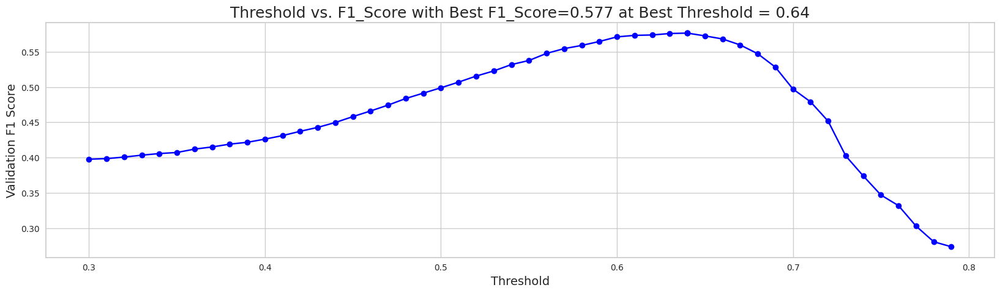

When using optimal threshold = 0.64...
Q0: F1 = 0.5765794631877477
==> Overall F1 = 0.5765794631877477
s
[I 2023-05-23 02:40:18,511] Trial 2 finished with value: 0.5765794631877477 and parameters: {'num_leaves': 19, 'learning_rate': 0.27920542784614233, 'feature_fraction': 0.4835367769341806, 'bagging_fraction': 0.2788284977773739, 'bagging_freq': 1, 'min_child_samples': 11, 'reg_alpha': 0.004581581411401141, 'reg_lambda': 0.032226839575112354, 'subsample': 0.39294590723699363, 'colsample_bytree': 0.6389704817758226, 'min_split_gain': 0.0970407497828934, 'max_depth': 10}. Best is trial 2 with value: 0.5765794631877477.


--------------------------------------------------
question11, with210features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.3101398514644656, subsample=0.6387707452339129 will be ignored. Current value: bagging_fraction=0.3101398514644656
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=7, subsample_freq=0 will be ignored. Current value: bagging_freq=7
[LightGBM] [Warning] feature_fraction is set=0.5237457679371358, colsample_bytree=0.87722214997178 will be ignored. Current value: feature_fraction=0.5237457679371358


[LightGBM] [Warning] bagging_fraction is set=0.3101398514644656, subsample=0.6387707452339129 will be ignored. Current value: bagging_fraction=0.3101398514644656
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=7, subsample_freq=0 will be ignored. Current value: bagging_freq=7
[LightGBM] [Warning] feature_fraction is set=0.5237457679371358, colsample_bytree=0.87722214997178 will be ignored. Current value: feature_fraction=0.5237457679371358


[LightGBM] [Warning] bagging_fraction is set=0.9444216094633151, subsample=0.6498678291529076 will be ignored. Current value: bagging_fraction=0.9444216094633151
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.270322469150719, colsample_bytree=0.703922357429037 will be ignored. Current value: feature_fraction=0.270322469150719


[LightGBM] [Warning] bagging_fraction is set=0.771564766391222, subsample=0.47553065938727745 will be ignored. Current value: bagging_fraction=0.771564766391222
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.3844120314394861, colsample_bytree=0.24498060339661853 will be ignored. Current value: feature_fraction=0.3844120314394861
[LightGBM] [Warning] bagging_fraction is set=0.3101398514644656, subsample=0.6387707452339129 will be ignored. Current value: bagging_fraction=0.3101398514644656
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=7, subsample_freq=0 will be ignored. Current value: bagging_freq=7
[LightGBM] [Warning] fe

[LightGBM] [Warning] bagging_fraction is set=0.7318642613319163, subsample=0.7651169168715214 will be ignored. Current value: bagging_fraction=0.7318642613319163
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
[LightGBM] [Warning] feature_fraction is set=0.2339619335590332, colsample_bytree=0.30603253063006325 will be ignored. Current value: feature_fraction=0.2339619335590332


,mean
feature,
elapsed_time_diff_std,44.0
hover_duration_std,39.4
elapsed_time_diff_mean,34.2
elapsed_time_diff_sum,31.6
room_coor_x_max,29.6
hover_duration_max,29.6
tunic.historicalsociety.stacks_room_fqid_counts,27.8
room_coor_x_min,27.8
room_coor_y_mean,27.6


[[0.55056246 0.44943754]
 [0.3932015  0.6067985 ]
 [0.23105106 0.76894894]
 ...
 [0.28191916 0.71808084]
 [0.22503875 0.77496125]
 [0.32052124 0.67947876]]
[LightGBM] [Warning] bagging_fraction is set=0.3101398514644656, subsample=0.6387707452339129 will be ignored. Current value: bagging_fraction=0.3101398514644656
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=7, subsample_freq=0 will be ignored. Current value: bagging_freq=7
[LightGBM] [Warning] feature_fraction is set=0.5237457679371358, colsample_bytree=0.87722214997178 will be ignored. Current value: feature_fraction=0.5237457679371358


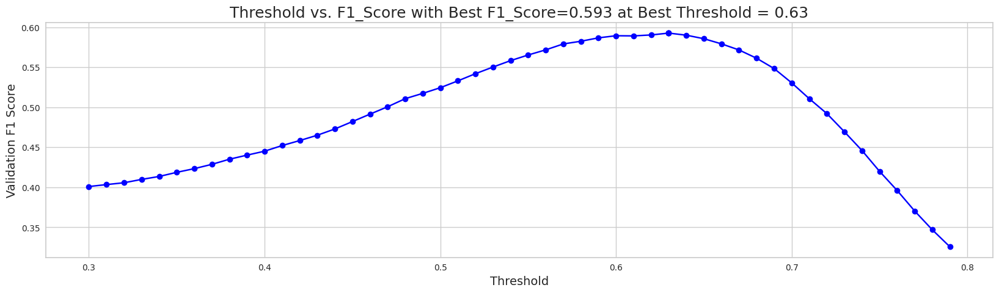

When using optimal threshold = 0.63...
Q0: F1 = 0.5927216350350814
==> Overall F1 = 0.5927216350350814
s
[I 2023-05-23 02:40:36,661] Trial 1 finished with value: 0.5927216350350814 and parameters: {'num_leaves': 46, 'learning_rate': 0.08823689851525338, 'feature_fraction': 0.270322469150719, 'bagging_fraction': 0.9444216094633151, 'bagging_freq': 2, 'min_child_samples': 79, 'reg_alpha': 0.0010390663252577666, 'reg_lambda': 3.3344243889143796, 'subsample': 0.6498678291529076, 'colsample_bytree': 0.703922357429037, 'min_split_gain': 0.004054951239524952, 'max_depth': 9}. Best is trial 1 with value: 0.5927216350350814.


--------------------------------------------------
question11, with210features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.16253923980607243, subsample=0.8352354512984924 will be ignored. Current value: bagging_fraction=0.16253923980607243
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
[LightGBM] [Warning] feature_fraction is set=0.7218629945795282, colsample_bytree=0.9710677674206437 will be ignored. Current value: feature_fraction=0.7218629945795282


[LightGBM] [Warning] bagging_fraction is set=0.3101398514644656, subsample=0.6387707452339129 will be ignored. Current value: bagging_fraction=0.3101398514644656
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=7, subsample_freq=0 will be ignored. Current value: bagging_freq=7
[LightGBM] [Warning] feature_fraction is set=0.5237457679371358, colsample_bytree=0.87722214997178 will be ignored. Current value: feature_fraction=0.5237457679371358


[LightGBM] [Warning] bagging_fraction is set=0.771564766391222, subsample=0.47553065938727745 will be ignored. Current value: bagging_fraction=0.771564766391222
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.3844120314394861, colsample_bytree=0.24498060339661853 will be ignored. Current value: feature_fraction=0.3844120314394861


,mean
feature,
11_level_counts,3.2
elapsed_time_diff_std,3.2
room_coor_x_max,2.8
tunic.historicalsociety.stacks_room_fqid_counts,2.6
-1_page_counts,2.4
5_level_counts,2.2
session_id,2.0
room_coor_y_sum,2.0
tostacks_fqid_counts,2.0


[[0.56380988 0.43619012]
 [0.43877032 0.56122968]
 [0.36184124 0.63815876]
 ...
 [0.29346439 0.70653561]
 [0.27812975 0.72187025]
 [0.30618053 0.69381947]]


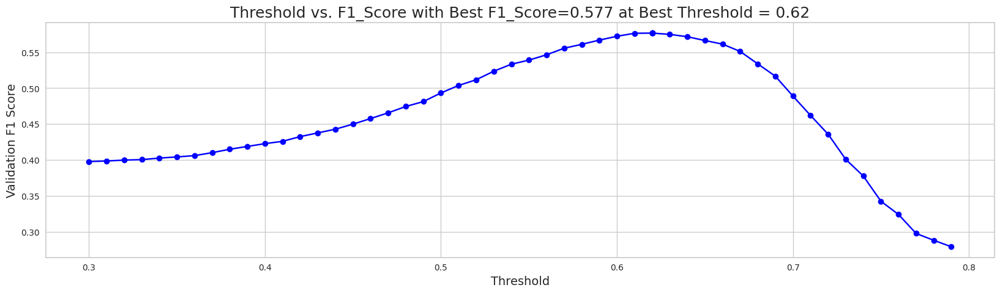

When using optimal threshold = 0.62...
Q0: F1 = 0.5766696900888171
==> Overall F1 = 0.5766696900888171
s
[I 2023-05-23 02:40:43,378] Trial 4 finished with value: 0.5766696900888171 and parameters: {'num_leaves': 57, 'learning_rate': 0.2735804553828986, 'feature_fraction': 0.5237457679371358, 'bagging_fraction': 0.3101398514644656, 'bagging_freq': 7, 'min_child_samples': 16, 'reg_alpha': 0.06616292352440113, 'reg_lambda': 1.4962429675634288, 'subsample': 0.6387707452339129, 'colsample_bytree': 0.87722214997178, 'min_split_gain': 0.04468018313692991, 'max_depth': 5}. Best is trial 1 with value: 0.5927216350350814.


--------------------------------------------------
question11, with210features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.3211144109647358, subsample=0.9320863161279197 will be ignored. Current value: bagging_fraction=0.3211144109647358
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
[LightGBM] [Warning] feature_fraction is set=0.2562237285668245, colsample_bytree=0.18684894585635298 will be ignored. Current value: feature_fraction=0.2562237285668245
[LightGBM] [Warning] bagging_fraction is set=0.16253923980607243, subsample=0.8352354512984924 will be ignored. Current value: bagging_fraction=0.16253923980607243
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
[LightGBM] [Warning]

[LightGBM] [Warning] bagging_fraction is set=0.7318642613319163, subsample=0.7651169168715214 will be ignored. Current value: bagging_fraction=0.7318642613319163
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
[LightGBM] [Warning] feature_fraction is set=0.2339619335590332, colsample_bytree=0.30603253063006325 will be ignored. Current value: feature_fraction=0.2339619335590332


[LightGBM] [Warning] bagging_fraction is set=0.16253923980607243, subsample=0.8352354512984924 will be ignored. Current value: bagging_fraction=0.16253923980607243
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
[LightGBM] [Warning] feature_fraction is set=0.7218629945795282, colsample_bytree=0.9710677674206437 will be ignored. Current value: feature_fraction=0.7218629945795282


,mean
feature,
elapsed_time_diff_std,98.0
tunic.historicalsociety.frontdesk_room_fqid_counts,61.0
elapsed_time_diff_sum,60.0
elapsed_time_diff_mean,59.0
hover_duration_mean,54.2
tunic.historicalsociety.stacks_room_fqid_counts,54.0
hover_duration_min,51.2
room_corr_x_diff_std,50.8
reader.paper1.next_fqid_counts,50.8


[[0.5178354  0.4821646 ]
 [0.42365555 0.57634445]
 [0.2504122  0.7495878 ]
 ...
 [0.22010046 0.77989954]
 [0.20640781 0.79359219]
 [0.30504921 0.69495079]]


[LightGBM] [Warning] bagging_fraction is set=0.3211144109647358, subsample=0.9320863161279197 will be ignored. Current value: bagging_fraction=0.3211144109647358
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
[LightGBM] [Warning] feature_fraction is set=0.2562237285668245, colsample_bytree=0.18684894585635298 will be ignored. Current value: feature_fraction=0.2562237285668245


[LightGBM] [Warning] bagging_fraction is set=0.16253923980607243, subsample=0.8352354512984924 will be ignored. Current value: bagging_fraction=0.16253923980607243
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
[LightGBM] [Warning] feature_fraction is set=0.7218629945795282, colsample_bytree=0.9710677674206437 will be ignored. Current value: feature_fraction=0.7218629945795282


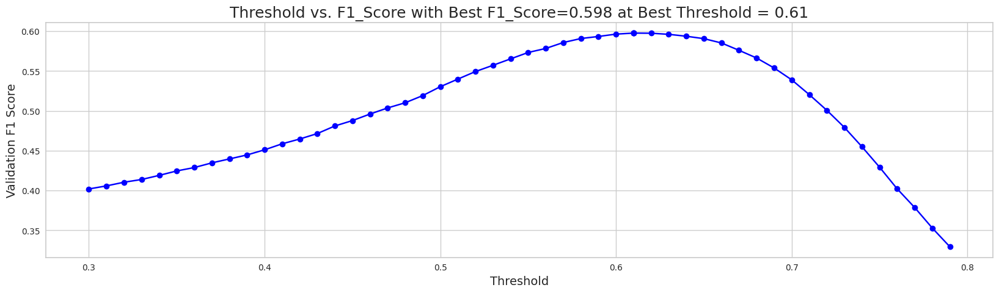

When using optimal threshold = 0.61...
Q0: F1 = 0.597682171005459
==> Overall F1 = 0.597682171005459
s
[I 2023-05-23 02:40:53,103] Trial 0 finished with value: 0.597682171005459 and parameters: {'num_leaves': 94, 'learning_rate': 0.02412609942328137, 'feature_fraction': 0.3844120314394861, 'bagging_fraction': 0.771564766391222, 'bagging_freq': 3, 'min_child_samples': 22, 'reg_alpha': 0.0037305569109393247, 'reg_lambda': 3.0663008660721185, 'subsample': 0.47553065938727745, 'colsample_bytree': 0.24498060339661853, 'min_split_gain': 0.8757843115672469, 'max_depth': 3}. Best is trial 0 with value: 0.597682171005459.


--------------------------------------------------
question11, with210features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.24287075008713982, subsample=0.329446580165474 will be ignored. Current value: bagging_fraction=0.24287075008713982
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=8, subsample_freq=0 will be ignored. Current value: bagging_freq=8
[LightGBM] [Warning] feature_fraction is set=0.19441418374647917, colsample_bytree=0.4476239674990704 will be ignored. Current value: feature_fraction=0.19441418374647917


[LightGBM] [Warning] bagging_fraction is set=0.16253923980607243, subsample=0.8352354512984924 will be ignored. Current value: bagging_fraction=0.16253923980607243
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
[LightGBM] [Warning] feature_fraction is set=0.7218629945795282, colsample_bytree=0.9710677674206437 will be ignored. Current value: feature_fraction=0.7218629945795282


[LightGBM] [Warning] bagging_fraction is set=0.3211144109647358, subsample=0.9320863161279197 will be ignored. Current value: bagging_fraction=0.3211144109647358
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
[LightGBM] [Warning] feature_fraction is set=0.2562237285668245, colsample_bytree=0.18684894585635298 will be ignored. Current value: feature_fraction=0.2562237285668245


,mean
feature,
elapsed_time_diff_std,16.6
elapsed_time_diff_sum,14.6
tunic.historicalsociety.frontdesk_room_fqid_counts,12.2
room_corr_x_diff_std,11.8
tunic.historicalsociety.stacks_room_fqid_counts,11.4
hover_duration_max,10.6
screen_coor_y_mean,9.8
hover_duration_min,9.8
11_level_counts,9.4


[[0.57665853 0.42334147]
 [0.46717741 0.53282259]
 [0.29790105 0.70209895]
 ...
 [0.24578856 0.75421144]
 [0.21363083 0.78636917]
 [0.28609322 0.71390678]]


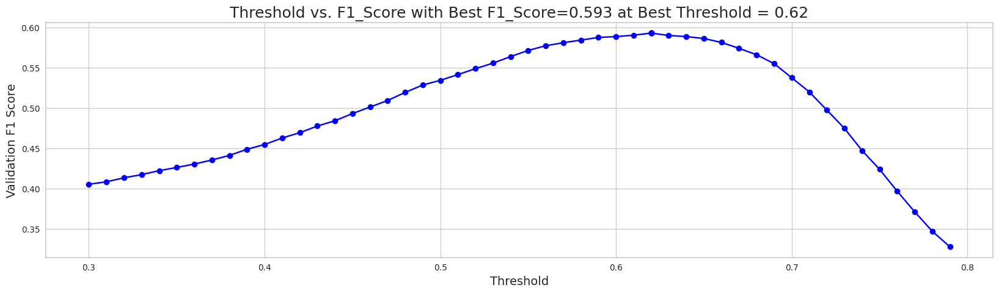

When using optimal threshold = 0.62...
Q0: F1 = 0.5928269564284363
==> Overall F1 = 0.5928269564284363
s
[I 2023-05-23 02:41:02,284] Trial 5 finished with value: 0.5928269564284363 and parameters: {'num_leaves': 79, 'learning_rate': 0.047931547676148975, 'feature_fraction': 0.7218629945795282, 'bagging_fraction': 0.16253923980607243, 'bagging_freq': 4, 'min_child_samples': 86, 'reg_alpha': 0.001585740101423848, 'reg_lambda': 0.006771762981997025, 'subsample': 0.8352354512984924, 'colsample_bytree': 0.9710677674206437, 'min_split_gain': 0.11801271234117992, 'max_depth': 2}. Best is trial 0 with value: 0.597682171005459.


--------------------------------------------------
question11, with210features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.7318642613319163, subsample=0.7651169168715214 will be ignored. Current value: bagging_fraction=0.7318642613319163
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
[LightGBM] [Warning] feature_fraction is set=0.2339619335590332, colsample_bytree=0.30603253063006325 will be ignored. Current value: feature_fraction=0.2339619335590332
[LightGBM] [Warning] bagging_fraction is set=0.9340345620531583, subsample=0.5714590032407896 will be ignored. Current value: bagging_fraction=0.9340345620531583
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=8, subsample_freq=0 will be ignored. Current value: bagging_freq=8
[LightGBM] [Warning] f

[LightGBM] [Warning] bagging_fraction is set=0.3211144109647358, subsample=0.9320863161279197 will be ignored. Current value: bagging_fraction=0.3211144109647358
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
[LightGBM] [Warning] feature_fraction is set=0.2562237285668245, colsample_bytree=0.18684894585635298 will be ignored. Current value: feature_fraction=0.2562237285668245


[LightGBM] [Warning] bagging_fraction is set=0.9340345620531583, subsample=0.5714590032407896 will be ignored. Current value: bagging_fraction=0.9340345620531583
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=8, subsample_freq=0 will be ignored. Current value: bagging_freq=8
[LightGBM] [Warning] feature_fraction is set=0.22325192169379376, colsample_bytree=0.4462237179285994 will be ignored. Current value: feature_fraction=0.22325192169379376
[LightGBM] [Warning] bagging_fraction is set=0.24287075008713982, subsample=0.329446580165474 will be ignored. Current value: bagging_fraction=0.24287075008713982
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=8, subsample_freq=0 will be ignored. Current value: bagging_freq=8
[LightGBM] [Warning]

[LightGBM] [Warning] bagging_fraction is set=0.3211144109647358, subsample=0.9320863161279197 will be ignored. Current value: bagging_fraction=0.3211144109647358
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
[LightGBM] [Warning] feature_fraction is set=0.2562237285668245, colsample_bytree=0.18684894585635298 will be ignored. Current value: feature_fraction=0.2562237285668245


,mean
feature,
hover_duration_std,117.0
hover_duration_max,112.2
elapsed_time_diff_mean,106.4
session_id,106.4
elapsed_time_diff_std,101.0
room_coor_y_max,98.4
hover_duration_mean,97.2
room_coor_x_max,93.0
screen_coor_y_std,90.2


[[0.50184954 0.49815046]
 [0.37310713 0.62689287]
 [0.26298262 0.73701738]
 ...
 [0.26031299 0.73968701]
 [0.21880495 0.78119505]
 [0.31963882 0.68036118]]


[LightGBM] [Warning] bagging_fraction is set=0.9340345620531583, subsample=0.5714590032407896 will be ignored. Current value: bagging_fraction=0.9340345620531583
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=8, subsample_freq=0 will be ignored. Current value: bagging_freq=8
[LightGBM] [Warning] feature_fraction is set=0.22325192169379376, colsample_bytree=0.4462237179285994 will be ignored. Current value: feature_fraction=0.22325192169379376


,mean
feature,
-1_page_counts,4.0
tunic.historicalsociety.stacks_room_fqid_counts,3.6
11_level_counts,3.2
room_coor_y_std,2.4
screen_corr_y_dff_std,2.4
elapsed_time_diff_sum,2.4
tunic.library.microfiche_room_fqid_counts,2.2
8_level_counts,2.2
5_level_counts,2.0


[[0.37493651 0.62506349]
 [0.32082568 0.67917432]
 [0.44394461 0.55605539]
 ...
 [0.30969827 0.69030173]
 [0.30969827 0.69030173]
 [0.30692573 0.69307427]]


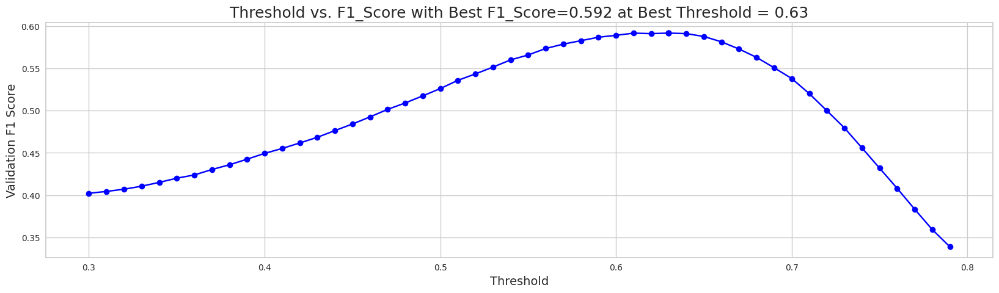

When using optimal threshold = 0.63...
Q0: F1 = 0.5917354719935053
==> Overall F1 = 0.5917354719935053
s
[I 2023-05-23 02:41:18,970] Trial 3 finished with value: 0.5917354719935053 and parameters: {'num_leaves': 84, 'learning_rate': 0.04887753545827389, 'feature_fraction': 0.2339619335590332, 'bagging_fraction': 0.7318642613319163, 'bagging_freq': 6, 'min_child_samples': 51, 'reg_alpha': 0.007228732407500359, 'reg_lambda': 0.08114502754103102, 'subsample': 0.7651169168715214, 'colsample_bytree': 0.30603253063006325, 'min_split_gain': 0.11415871784793218, 'max_depth': -1}. Best is trial 0 with value: 0.597682171005459.


--------------------------------------------------
question11, with210features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.7535166708106005, subsample=0.7698814598325567 will be ignored. Current value: bagging_fraction=0.7535166708106005
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7070101831728693, colsample_bytree=0.33979589826768614 will be ignored. Current value: feature_fraction=0.7070101831728693


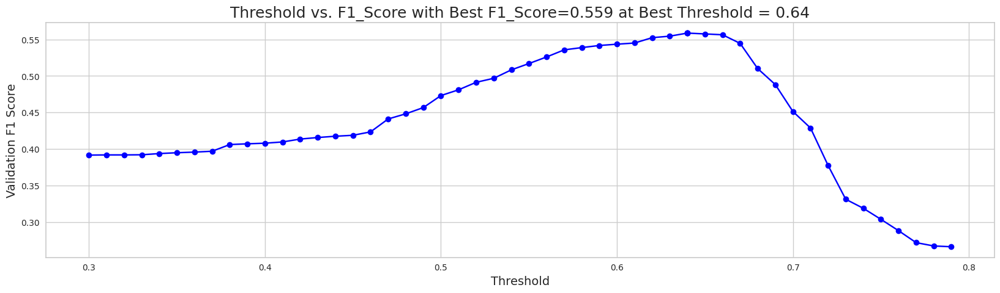

When using optimal threshold = 0.64...
Q0: F1 = 0.5587468183389372
==> Overall F1 = 0.5587468183389372
s
[I 2023-05-23 02:41:21,991] Trial 6 finished with value: 0.5587468183389372 and parameters: {'num_leaves': 64, 'learning_rate': 0.3957491618736843, 'feature_fraction': 0.2562237285668245, 'bagging_fraction': 0.3211144109647358, 'bagging_freq': 6, 'min_child_samples': 15, 'reg_alpha': 0.03856929985691801, 'reg_lambda': 0.6609396121341907, 'subsample': 0.9320863161279197, 'colsample_bytree': 0.18684894585635298, 'min_split_gain': 0.0011004566719251966, 'max_depth': 10}. Best is trial 0 with value: 0.597682171005459.


--------------------------------------------------
question11, with210features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.5128420468961116, subsample=0.6080403860021891 will be ignored. Current value: bagging_fraction=0.5128420468961116
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=10, subsample_freq=0 will be ignored. Current value: bagging_freq=10
[LightGBM] [Warning] feature_fraction is set=0.3496535624717883, colsample_bytree=0.5969211530417453 will be ignored. Current value: feature_fraction=0.3496535624717883


[LightGBM] [Warning] bagging_fraction is set=0.9340345620531583, subsample=0.5714590032407896 will be ignored. Current value: bagging_fraction=0.9340345620531583
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=8, subsample_freq=0 will be ignored. Current value: bagging_freq=8
[LightGBM] [Warning] feature_fraction is set=0.22325192169379376, colsample_bytree=0.4462237179285994 will be ignored. Current value: feature_fraction=0.22325192169379376


[LightGBM] [Warning] bagging_fraction is set=0.9340345620531583, subsample=0.5714590032407896 will be ignored. Current value: bagging_fraction=0.9340345620531583
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=8, subsample_freq=0 will be ignored. Current value: bagging_freq=8
[LightGBM] [Warning] feature_fraction is set=0.22325192169379376, colsample_bytree=0.4462237179285994 will be ignored. Current value: feature_fraction=0.22325192169379376


[LightGBM] [Warning] bagging_fraction is set=0.7535166708106005, subsample=0.7698814598325567 will be ignored. Current value: bagging_fraction=0.7535166708106005
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7070101831728693, colsample_bytree=0.33979589826768614 will be ignored. Current value: feature_fraction=0.7070101831728693


[LightGBM] [Warning] bagging_fraction is set=0.5128420468961116, subsample=0.6080403860021891 will be ignored. Current value: bagging_fraction=0.5128420468961116
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=10, subsample_freq=0 will be ignored. Current value: bagging_freq=10
[LightGBM] [Warning] feature_fraction is set=0.3496535624717883, colsample_bytree=0.5969211530417453 will be ignored. Current value: feature_fraction=0.3496535624717883


,mean
feature,
hover_duration_std,17.0
elapsed_time_diff_mean,16.6
hover_duration_mean,14.2
9_level_counts,13.2
11_level_counts,12.6
tunic.historicalsociety.stacks_room_fqid_counts,11.8
session_id,11.6
-1_page_counts,10.6
session_number,10.4


[[0.51031006 0.48968994]
 [0.45596167 0.54403833]
 [0.23413768 0.76586232]
 ...
 [0.2462711  0.7537289 ]
 [0.1894282  0.8105718 ]
 [0.30724797 0.69275203]]


[LightGBM] [Warning] bagging_fraction is set=0.24287075008713982, subsample=0.329446580165474 will be ignored. Current value: bagging_fraction=0.24287075008713982
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=8, subsample_freq=0 will be ignored. Current value: bagging_freq=8
[LightGBM] [Warning] feature_fraction is set=0.19441418374647917, colsample_bytree=0.4476239674990704 will be ignored. Current value: feature_fraction=0.19441418374647917


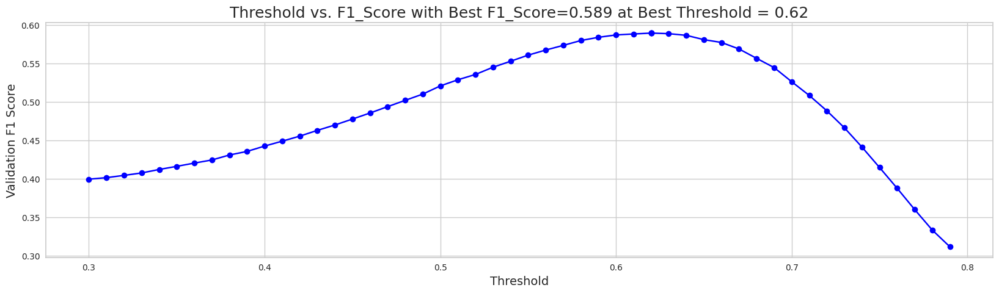

When using optimal threshold = 0.62...
Q0: F1 = 0.5893373503412564
==> Overall F1 = 0.5893373503412564
s
[I 2023-05-23 02:41:37,432] Trial 8 finished with value: 0.5893373503412564 and parameters: {'num_leaves': 39, 'learning_rate': 0.16083434693566048, 'feature_fraction': 0.22325192169379376, 'bagging_fraction': 0.9340345620531583, 'bagging_freq': 8, 'min_child_samples': 26, 'reg_alpha': 0.05953256459131638, 'reg_lambda': 0.0025523354495831266, 'subsample': 0.5714590032407896, 'colsample_bytree': 0.4462237179285994, 'min_split_gain': 0.15811886886243262, 'max_depth': 9}. Best is trial 0 with value: 0.597682171005459.


--------------------------------------------------
question11, with210features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.8407777678872252, subsample=0.1280917517141885 will be ignored. Current value: bagging_fraction=0.8407777678872252
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
[LightGBM] [Warning] feature_fraction is set=0.20377707041761695, colsample_bytree=0.6700071478999328 will be ignored. Current value: feature_fraction=0.20377707041761695


[LightGBM] [Warning] bagging_fraction is set=0.7535166708106005, subsample=0.7698814598325567 will be ignored. Current value: bagging_fraction=0.7535166708106005
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7070101831728693, colsample_bytree=0.33979589826768614 will be ignored. Current value: feature_fraction=0.7070101831728693
[LightGBM] [Warning] bagging_fraction is set=0.8407777678872252, subsample=0.1280917517141885 will be ignored. Current value: bagging_fraction=0.8407777678872252
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
[LightGBM] [Warning] f

[LightGBM] [Warning] bagging_fraction is set=0.5128420468961116, subsample=0.6080403860021891 will be ignored. Current value: bagging_fraction=0.5128420468961116
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=10, subsample_freq=0 will be ignored. Current value: bagging_freq=10
[LightGBM] [Warning] feature_fraction is set=0.3496535624717883, colsample_bytree=0.5969211530417453 will be ignored. Current value: feature_fraction=0.3496535624717883


[LightGBM] [Warning] bagging_fraction is set=0.8407777678872252, subsample=0.1280917517141885 will be ignored. Current value: bagging_fraction=0.8407777678872252
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
[LightGBM] [Warning] feature_fraction is set=0.20377707041761695, colsample_bytree=0.6700071478999328 will be ignored. Current value: feature_fraction=0.20377707041761695


[LightGBM] [Warning] bagging_fraction is set=0.5128420468961116, subsample=0.6080403860021891 will be ignored. Current value: bagging_fraction=0.5128420468961116
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=10, subsample_freq=0 will be ignored. Current value: bagging_freq=10
[LightGBM] [Warning] feature_fraction is set=0.3496535624717883, colsample_bytree=0.5969211530417453 will be ignored. Current value: feature_fraction=0.3496535624717883


[LightGBM] [Warning] bagging_fraction is set=0.7535166708106005, subsample=0.7698814598325567 will be ignored. Current value: bagging_fraction=0.7535166708106005
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7070101831728693, colsample_bytree=0.33979589826768614 will be ignored. Current value: feature_fraction=0.7070101831728693


[LightGBM] [Warning] bagging_fraction is set=0.8407777678872252, subsample=0.1280917517141885 will be ignored. Current value: bagging_fraction=0.8407777678872252
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
[LightGBM] [Warning] feature_fraction is set=0.20377707041761695, colsample_bytree=0.6700071478999328 will be ignored. Current value: feature_fraction=0.20377707041761695
[LightGBM] [Warning] bagging_fraction is set=0.24287075008713982, subsample=0.329446580165474 will be ignored. Current value: bagging_fraction=0.24287075008713982
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=8, subsample_freq=0 will be ignored. Current value: bagging_freq=8
[LightGBM] [Warning]

[LightGBM] [Warning] bagging_fraction is set=0.8407777678872252, subsample=0.1280917517141885 will be ignored. Current value: bagging_fraction=0.8407777678872252
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
[LightGBM] [Warning] feature_fraction is set=0.20377707041761695, colsample_bytree=0.6700071478999328 will be ignored. Current value: feature_fraction=0.20377707041761695


[LightGBM] [Warning] bagging_fraction is set=0.5128420468961116, subsample=0.6080403860021891 will be ignored. Current value: bagging_fraction=0.5128420468961116
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=10, subsample_freq=0 will be ignored. Current value: bagging_freq=10
[LightGBM] [Warning] feature_fraction is set=0.3496535624717883, colsample_bytree=0.5969211530417453 will be ignored. Current value: feature_fraction=0.3496535624717883
[LightGBM] [Warning] bagging_fraction is set=0.7535166708106005, subsample=0.7698814598325567 will be ignored. Current value: bagging_fraction=0.7535166708106005
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] 

,mean
feature,
elapsed_time_diff_mean,39.0
hover_duration_std,31.2
session_id,24.0
screen_coor_y_max,23.8
room_coor_y_max,23.6
hover_duration_mean,23.6
elapsed_time_diff_std,22.2
room_coor_x_mean,21.8
9_level_counts,21.4


[[0.50477206 0.49522794]
 [0.43254467 0.56745533]
 [0.19892588 0.80107412]
 ...
 [0.20478622 0.79521378]
 [0.22729736 0.77270264]
 [0.35153461 0.64846539]]


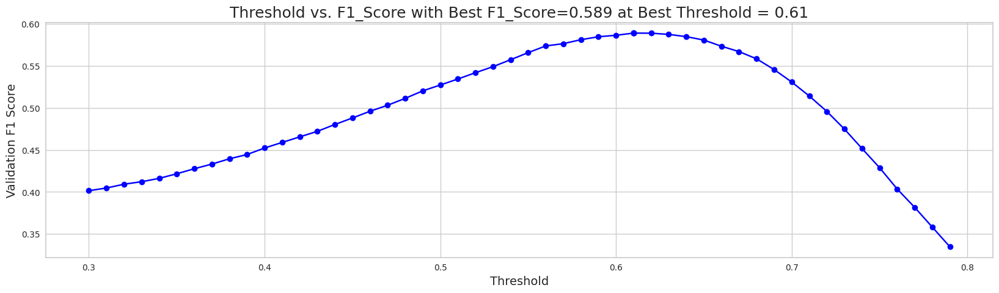

When using optimal threshold = 0.61...
Q0: F1 = 0.5889249623289303
==> Overall F1 = 0.5889249623289303
s
[I 2023-05-23 02:42:12,126] Trial 11 finished with value: 0.5889249623289303 and parameters: {'num_leaves': 71, 'learning_rate': 0.14670346488846644, 'feature_fraction': 0.20377707041761695, 'bagging_fraction': 0.8407777678872252, 'bagging_freq': 4, 'min_child_samples': 67, 'reg_alpha': 0.005056918258661284, 'reg_lambda': 2.0064475910996586, 'subsample': 0.1280917517141885, 'colsample_bytree': 0.6700071478999328, 'min_split_gain': 0.003137907307553998, 'max_depth': 7}. Best is trial 0 with value: 0.597682171005459.


--------------------------------------------------
question11, with210features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.21110485422824649, subsample=0.2764292616843227 will be ignored. Current value: bagging_fraction=0.21110485422824649
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.10797262275503672, colsample_bytree=0.13358968114299513 will be ignored. Current value: feature_fraction=0.10797262275503672


,mean
feature,
elapsed_time_diff_std,53.6
room_coor_x_max,47.8
session_id,40.2
hover_duration_mean,37.4
elapsed_time_diff_mean,37.2
room_corr_x_diff_std,35.2
room_coor_y_mean,34.6
hover_duration_max,33.0
11_level_counts,32.6


[[0.52258688 0.47741312]
 [0.40314    0.59686   ]
 [0.19212382 0.80787618]
 ...
 [0.29188735 0.70811265]
 [0.24725287 0.75274713]
 [0.31254679 0.68745321]]


,mean
feature,
elapsed_time_diff_std,89.2
hover_duration_std,84.2
room_coor_y_max,77.6
session_id,75.8
hover_duration_mean,75.2
room_coor_x_max,73.2
hover_duration_max,71.8
elapsed_time_diff_sum,70.8
room_coor_x_min,70.2


[[0.51693038 0.48306962]
 [0.40915129 0.59084871]
 [0.24240917 0.75759083]
 ...
 [0.24202387 0.75797613]
 [0.23372881 0.76627119]
 [0.28234877 0.71765123]]


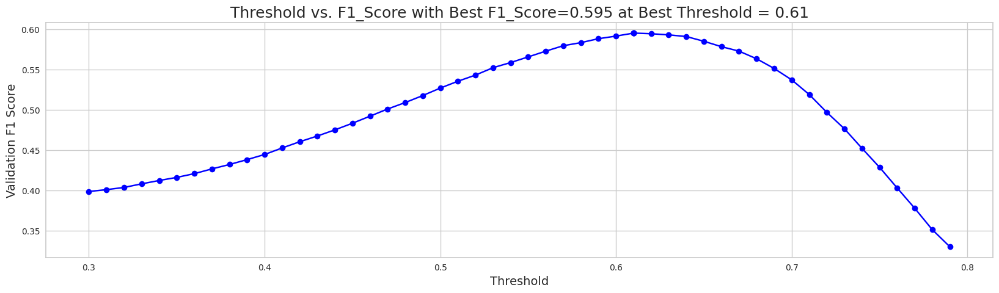

When using optimal threshold = 0.61...
Q0: F1 = 0.595214351396772
==> Overall F1 = 0.595214351396772
s
[I 2023-05-23 02:42:20,376] Trial 9 finished with value: 0.595214351396772 and parameters: {'num_leaves': 59, 'learning_rate': 0.07342927247226907, 'feature_fraction': 0.7070101831728693, 'bagging_fraction': 0.7535166708106005, 'bagging_freq': 2, 'min_child_samples': 54, 'reg_alpha': 0.035997747755916895, 'reg_lambda': 0.14026336330701825, 'subsample': 0.7698814598325567, 'colsample_bytree': 0.33979589826768614, 'min_split_gain': 0.009939291774338317, 'max_depth': 10}. Best is trial 0 with value: 0.597682171005459.


--------------------------------------------------
question11, with210features
--------------------------------------------------


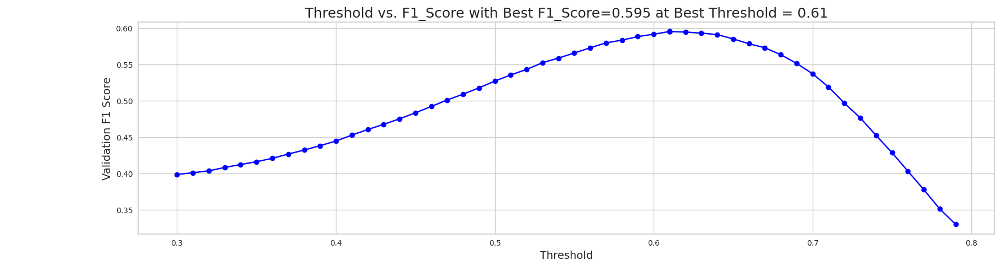

[LightGBM] [Warning] bagging_fraction is set=0.5820753974357569, subsample=0.40919148394663685 will be ignored. Current value: bagging_fraction=0.5820753974357569
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=10, subsample_freq=0 will be ignored. Current value: bagging_freq=10
[LightGBM] [Warning] feature_fraction is set=0.4087361525554385, colsample_bytree=0.10481367056683058 will be ignored. Current value: feature_fraction=0.4087361525554385


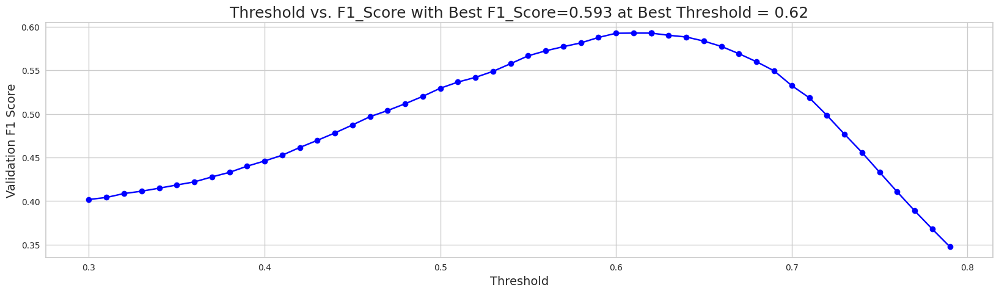

When using optimal threshold = 0.62...
Q0: F1 = 0.5928566712880439
==> Overall F1 = 0.5928566712880439
s
[I 2023-05-23 02:42:22,647] Trial 10 finished with value: 0.5928566712880439 and parameters: {'num_leaves': 91, 'learning_rate': 0.042121256215312236, 'feature_fraction': 0.3496535624717883, 'bagging_fraction': 0.5128420468961116, 'bagging_freq': 10, 'min_child_samples': 79, 'reg_alpha': 0.0017444472593952521, 'reg_lambda': 0.08842298872226384, 'subsample': 0.6080403860021891, 'colsample_bytree': 0.5969211530417453, 'min_split_gain': 0.04022456952942097, 'max_depth': 8}. Best is trial 0 with value: 0.597682171005459.


--------------------------------------------------
question11, with210features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.6663084299173679, subsample=0.4206641795917684 will be ignored. Current value: bagging_fraction=0.6663084299173679
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.8856566061022665, colsample_bytree=0.10599410924738084 will be ignored. Current value: feature_fraction=0.8856566061022665


[LightGBM] [Warning] bagging_fraction is set=0.24287075008713982, subsample=0.329446580165474 will be ignored. Current value: bagging_fraction=0.24287075008713982
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=8, subsample_freq=0 will be ignored. Current value: bagging_freq=8
[LightGBM] [Warning] feature_fraction is set=0.19441418374647917, colsample_bytree=0.4476239674990704 will be ignored. Current value: feature_fraction=0.19441418374647917


[LightGBM] [Warning] bagging_fraction is set=0.21110485422824649, subsample=0.2764292616843227 will be ignored. Current value: bagging_fraction=0.21110485422824649
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.10797262275503672, colsample_bytree=0.13358968114299513 will be ignored. Current value: feature_fraction=0.10797262275503672


[LightGBM] [Warning] bagging_fraction is set=0.5820753974357569, subsample=0.40919148394663685 will be ignored. Current value: bagging_fraction=0.5820753974357569
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=10, subsample_freq=0 will be ignored. Current value: bagging_freq=10
[LightGBM] [Warning] feature_fraction is set=0.4087361525554385, colsample_bytree=0.10481367056683058 will be ignored. Current value: feature_fraction=0.4087361525554385


[LightGBM] [Warning] bagging_fraction is set=0.6663084299173679, subsample=0.4206641795917684 will be ignored. Current value: bagging_fraction=0.6663084299173679
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.8856566061022665, colsample_bytree=0.10599410924738084 will be ignored. Current value: feature_fraction=0.8856566061022665


[LightGBM] [Warning] bagging_fraction is set=0.21110485422824649, subsample=0.2764292616843227 will be ignored. Current value: bagging_fraction=0.21110485422824649
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.10797262275503672, colsample_bytree=0.13358968114299513 will be ignored. Current value: feature_fraction=0.10797262275503672


,mean
feature,
hover_duration_mean,395.0
hover_duration_std,368.8
session_id,323.6
room_coor_x_max,314.4
screen_coor_y_std,312.2
room_coor_y_max,299.0
room_coor_y_sum,297.2
room_coor_x_min,295.0
room_coor_x_std,294.2


[[0.51946496 0.48053504]
 [0.42695532 0.57304468]
 [0.2862112  0.7137888 ]
 ...
 [0.22485561 0.77514439]
 [0.23416689 0.76583311]
 [0.28477179 0.71522821]]


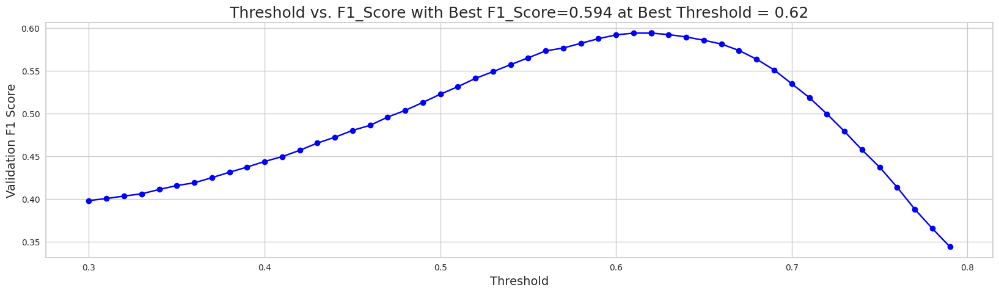

When using optimal threshold = 0.62...
Q0: F1 = 0.5940538185301517
==> Overall F1 = 0.5940538185301517
s
[I 2023-05-23 02:42:55,697] Trial 7 finished with value: 0.5940538185301517 and parameters: {'num_leaves': 86, 'learning_rate': 0.0163545609876411, 'feature_fraction': 0.19441418374647917, 'bagging_fraction': 0.24287075008713982, 'bagging_freq': 8, 'min_child_samples': 38, 'reg_alpha': 1.148243353346801, 'reg_lambda': 0.05977761846031084, 'subsample': 0.329446580165474, 'colsample_bytree': 0.4476239674990704, 'min_split_gain': 0.0421494747343361, 'max_depth': -1}. Best is trial 0 with value: 0.597682171005459.


--------------------------------------------------
question11, with210features
--------------------------------------------------
[LightGBM] [Warning] bagging_fraction is set=0.21110485422824649, subsample=0.2764292616843227 will be ignored. Current value: bagging_fraction=0.21110485422824649
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.10797262275503672, colsample_bytree=0.13358968114299513 will be ignored. Current value: feature_fraction=0.10797262275503672


[LightGBM] [Warning] bagging_fraction is set=0.6911470975229899, subsample=0.9703081351494536 will be ignored. Current value: bagging_fraction=0.6911470975229899
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.943231527435356, colsample_bytree=0.1057658598447376 will be ignored. Current value: feature_fraction=0.943231527435356


[LightGBM] [Warning] bagging_fraction is set=0.5820753974357569, subsample=0.40919148394663685 will be ignored. Current value: bagging_fraction=0.5820753974357569
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=10, subsample_freq=0 will be ignored. Current value: bagging_freq=10
[LightGBM] [Warning] feature_fraction is set=0.4087361525554385, colsample_bytree=0.10481367056683058 will be ignored. Current value: feature_fraction=0.4087361525554385


[LightGBM] [Warning] bagging_fraction is set=0.6911470975229899, subsample=0.9703081351494536 will be ignored. Current value: bagging_fraction=0.6911470975229899
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.943231527435356, colsample_bytree=0.1057658598447376 will be ignored. Current value: feature_fraction=0.943231527435356


[LightGBM] [Warning] bagging_fraction is set=0.5820753974357569, subsample=0.40919148394663685 will be ignored. Current value: bagging_fraction=0.5820753974357569
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=10, subsample_freq=0 will be ignored. Current value: bagging_freq=10
[LightGBM] [Warning] feature_fraction is set=0.4087361525554385, colsample_bytree=0.10481367056683058 will be ignored. Current value: feature_fraction=0.4087361525554385


[LightGBM] [Warning] bagging_fraction is set=0.21110485422824649, subsample=0.2764292616843227 will be ignored. Current value: bagging_fraction=0.21110485422824649
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.10797262275503672, colsample_bytree=0.13358968114299513 will be ignored. Current value: feature_fraction=0.10797262275503672


[LightGBM] [Warning] bagging_fraction is set=0.6663084299173679, subsample=0.4206641795917684 will be ignored. Current value: bagging_fraction=0.6663084299173679
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.8856566061022665, colsample_bytree=0.10599410924738084 will be ignored. Current value: feature_fraction=0.8856566061022665


[LightGBM] [Warning] bagging_fraction is set=0.6911470975229899, subsample=0.9703081351494536 will be ignored. Current value: bagging_fraction=0.6911470975229899
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.943231527435356, colsample_bytree=0.1057658598447376 will be ignored. Current value: feature_fraction=0.943231527435356


,mean
feature,
tunic.historicalsociety.stacks_room_fqid_counts,105.2
hover_duration_sum,103.0
hover_duration_std,93.0
screen_coor_y_mean,88.8
session_id,88.0
undefined_name_counts,86.8
room_coor_x_sum,85.6
elapsed_time_diff_mean,84.8
text_fqid_None_text_fqid_counts,83.6


[[0.54075246 0.45924754]
 [0.44121838 0.55878162]
 [0.30755475 0.69244525]
 ...
 [0.25087061 0.74912939]
 [0.24319026 0.75680974]
 [0.34932859 0.65067141]]


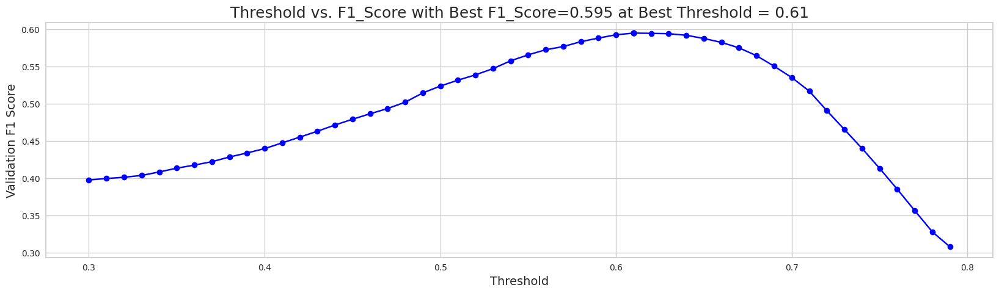

When using optimal threshold = 0.61...
Q0: F1 = 0.5949823850372827
==> Overall F1 = 0.5949823850372827
s
[I 2023-05-23 02:43:30,625] Trial 12 finished with value: 0.5949823850372827 and parameters: {'num_leaves': 11, 'learning_rate': 0.012557817984559839, 'feature_fraction': 0.10797262275503672, 'bagging_fraction': 0.21110485422824649, 'bagging_freq': 3, 'min_child_samples': 23, 'reg_alpha': 0.6758130878331782, 'reg_lambda': 0.8884483336628497, 'subsample': 0.2764292616843227, 'colsample_bytree': 0.13358968114299513, 'min_split_gain': 0.002198741845294051, 'max_depth': 10}. Best is trial 0 with value: 0.597682171005459.


--------------------------------------------------
question11, with210features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.6833360517626237, subsample=0.4538094038098329 will be ignored. Current value: bagging_fraction=0.6833360517626237
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9092786257975247, colsample_bytree=0.2899334502898075 will be ignored. Current value: feature_fraction=0.9092786257975247


[LightGBM] [Warning] bagging_fraction is set=0.5820753974357569, subsample=0.40919148394663685 will be ignored. Current value: bagging_fraction=0.5820753974357569
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=10, subsample_freq=0 will be ignored. Current value: bagging_freq=10
[LightGBM] [Warning] feature_fraction is set=0.4087361525554385, colsample_bytree=0.10481367056683058 will be ignored. Current value: feature_fraction=0.4087361525554385


[LightGBM] [Warning] bagging_fraction is set=0.6911470975229899, subsample=0.9703081351494536 will be ignored. Current value: bagging_fraction=0.6911470975229899
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.943231527435356, colsample_bytree=0.1057658598447376 will be ignored. Current value: feature_fraction=0.943231527435356


[LightGBM] [Warning] bagging_fraction is set=0.6663084299173679, subsample=0.4206641795917684 will be ignored. Current value: bagging_fraction=0.6663084299173679
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.8856566061022665, colsample_bytree=0.10599410924738084 will be ignored. Current value: feature_fraction=0.8856566061022665


[LightGBM] [Warning] bagging_fraction is set=0.6833360517626237, subsample=0.4538094038098329 will be ignored. Current value: bagging_fraction=0.6833360517626237
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9092786257975247, colsample_bytree=0.2899334502898075 will be ignored. Current value: feature_fraction=0.9092786257975247


[LightGBM] [Warning] bagging_fraction is set=0.6911470975229899, subsample=0.9703081351494536 will be ignored. Current value: bagging_fraction=0.6911470975229899
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.943231527435356, colsample_bytree=0.1057658598447376 will be ignored. Current value: feature_fraction=0.943231527435356


,mean
feature,
elapsed_time_diff_std,107.0
tunic.historicalsociety.frontdesk_room_fqid_counts,62.2
hover_duration_min,56.0
elapsed_time_diff_sum,51.2
reader_fqid_counts,51.2
screen_coor_y_mean,50.4
room_corr_x_diff_std,49.4
elapsed_time_diff_mean,49.2
reader.paper1.next_fqid_counts,48.2


[[0.54057074 0.45942926]
 [0.40533068 0.59466932]
 [0.28404109 0.71595891]
 ...
 [0.23120367 0.76879633]
 [0.21893477 0.78106523]
 [0.31651964 0.68348036]]


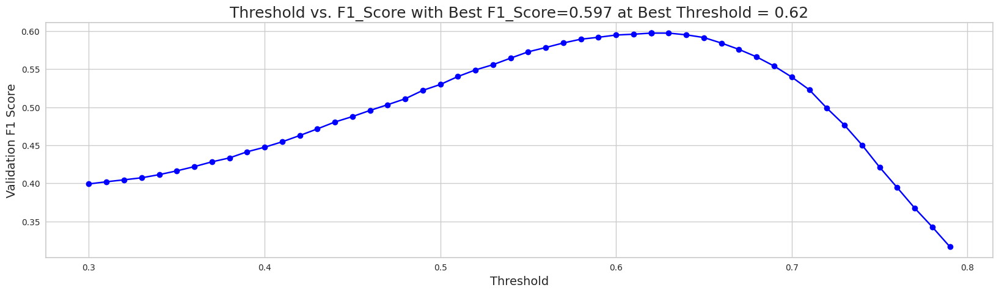

When using optimal threshold = 0.62...
Q0: F1 = 0.597256217977949
==> Overall F1 = 0.597256217977949
s
[I 2023-05-23 02:44:02,297] Trial 13 finished with value: 0.597256217977949 and parameters: {'num_leaves': 99, 'learning_rate': 0.015599964778355962, 'feature_fraction': 0.4087361525554385, 'bagging_fraction': 0.5820753974357569, 'bagging_freq': 10, 'min_child_samples': 37, 'reg_alpha': 0.9630773887097536, 'reg_lambda': 9.098693601796425, 'subsample': 0.40919148394663685, 'colsample_bytree': 0.10481367056683058, 'min_split_gain': 0.9961553075857766, 'max_depth': 2}. Best is trial 0 with value: 0.597682171005459.


--------------------------------------------------
question11, with210features
--------------------------------------------------


,mean
feature,
elapsed_time_diff_std,123.2
tunic.historicalsociety.frontdesk_room_fqid_counts,70.8
hover_duration_min,62.2
room_corr_x_diff_std,55.8
11_level_counts,55.8
elapsed_time_diff_sum,55.0
elapsed_time_diff_mean,52.2
reader.paper1.next_fqid_counts,50.6
hover_duration_mean,49.0


[[0.51081489 0.48918511]
 [0.41420643 0.58579357]
 [0.27862732 0.72137268]
 ...
 [0.23141118 0.76858882]
 [0.2238543  0.7761457 ]
 [0.29511205 0.70488795]]


[LightGBM] [Warning] bagging_fraction is set=0.5841064841713384, subsample=0.4880574761529348 will be ignored. Current value: bagging_fraction=0.5841064841713384
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=10, subsample_freq=0 will be ignored. Current value: bagging_freq=10
[LightGBM] [Warning] feature_fraction is set=0.4089329632407676, colsample_bytree=0.1229295494355635 will be ignored. Current value: feature_fraction=0.4089329632407676


[LightGBM] [Warning] bagging_fraction is set=0.6663084299173679, subsample=0.4206641795917684 will be ignored. Current value: bagging_fraction=0.6663084299173679
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.8856566061022665, colsample_bytree=0.10599410924738084 will be ignored. Current value: feature_fraction=0.8856566061022665


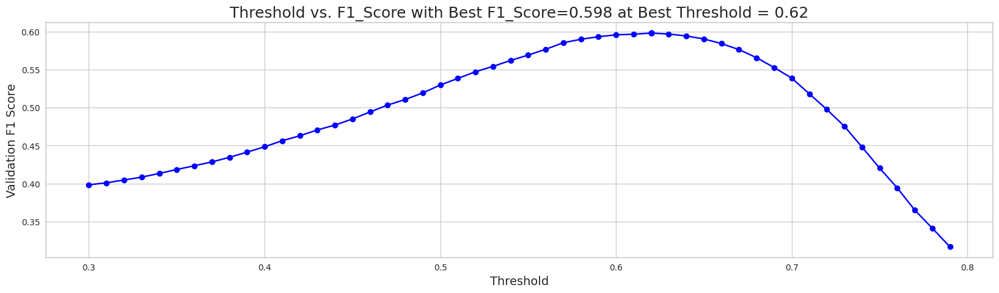

When using optimal threshold = 0.62...
Q0: F1 = 0.5981391813964103
==> Overall F1 = 0.5981391813964103
s
[I 2023-05-23 02:44:06,078] Trial 15 finished with value: 0.5981391813964103 and parameters: {'num_leaves': 25, 'learning_rate': 0.01883770248183441, 'feature_fraction': 0.943231527435356, 'bagging_fraction': 0.6911470975229899, 'bagging_freq': 3, 'min_child_samples': 51, 'reg_alpha': 0.47536304622287745, 'reg_lambda': 6.957095268187864, 'subsample': 0.9703081351494536, 'colsample_bytree': 0.1057658598447376, 'min_split_gain': 0.6221685426262737, 'max_depth': 3}. Best is trial 15 with value: 0.5981391813964103.


--------------------------------------------------
question11, with210features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.6388464287438352, subsample=0.9981240357861625 will be ignored. Current value: bagging_fraction=0.6388464287438352
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
[LightGBM] [Warning] feature_fraction is set=0.807989422727903, colsample_bytree=0.21594281899175635 will be ignored. Current value: feature_fraction=0.807989422727903


[LightGBM] [Warning] bagging_fraction is set=0.6833360517626237, subsample=0.4538094038098329 will be ignored. Current value: bagging_fraction=0.6833360517626237
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9092786257975247, colsample_bytree=0.2899334502898075 will be ignored. Current value: feature_fraction=0.9092786257975247


[LightGBM] [Warning] bagging_fraction is set=0.6388464287438352, subsample=0.9981240357861625 will be ignored. Current value: bagging_fraction=0.6388464287438352
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
[LightGBM] [Warning] feature_fraction is set=0.807989422727903, colsample_bytree=0.21594281899175635 will be ignored. Current value: feature_fraction=0.807989422727903


[LightGBM] [Warning] bagging_fraction is set=0.5841064841713384, subsample=0.4880574761529348 will be ignored. Current value: bagging_fraction=0.5841064841713384
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=10, subsample_freq=0 will be ignored. Current value: bagging_freq=10
[LightGBM] [Warning] feature_fraction is set=0.4089329632407676, colsample_bytree=0.1229295494355635 will be ignored. Current value: feature_fraction=0.4089329632407676


,mean
feature,
elapsed_time_diff_std,202.6
tunic.historicalsociety.frontdesk_room_fqid_counts,101.6
elapsed_time_diff_mean,100.0
hover_duration_min,97.4
elapsed_time_diff_sum,96.6
room_corr_x_diff_std,95.0
11_level_counts,90.8
room_coor_x_max,87.6
hover_duration_sum,85.0


[[0.52636164 0.47363836]
 [0.42953065 0.57046935]
 [0.28055189 0.71944811]
 ...
 [0.23140187 0.76859813]
 [0.21629592 0.78370408]
 [0.28043222 0.71956778]]


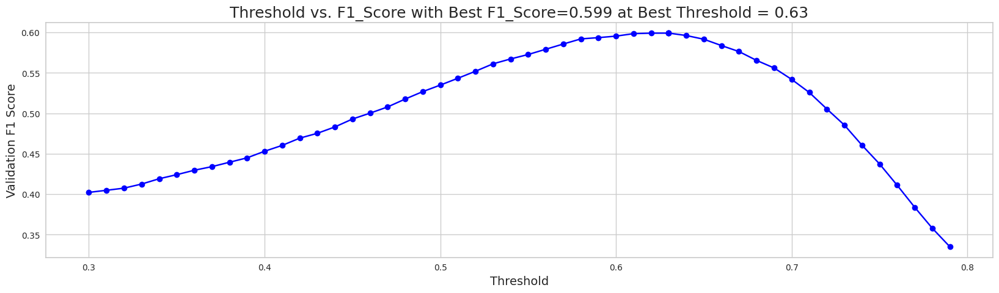

When using optimal threshold = 0.63...
Q0: F1 = 0.5991716989237225
==> Overall F1 = 0.5991716989237225
s
[I 2023-05-23 02:44:30,110] Trial 14 finished with value: 0.5991716989237225 and parameters: {'num_leaves': 96, 'learning_rate': 0.014592149799753254, 'feature_fraction': 0.8856566061022665, 'bagging_fraction': 0.6663084299173679, 'bagging_freq': 3, 'min_child_samples': 40, 'reg_alpha': 0.8496139535977498, 'reg_lambda': 9.723147097005446, 'subsample': 0.4206641795917684, 'colsample_bytree': 0.10599410924738084, 'min_split_gain': 0.973841042566195, 'max_depth': 3}. Best is trial 14 with value: 0.5991716989237225.


--------------------------------------------------
question11, with210features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.6096594121627268, subsample=0.9714817930575865 will be ignored. Current value: bagging_fraction=0.6096594121627268
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
[LightGBM] [Warning] feature_fraction is set=0.9634692545444331, colsample_bytree=0.10270145843398013 will be ignored. Current value: feature_fraction=0.9634692545444331


[LightGBM] [Warning] bagging_fraction is set=0.6833360517626237, subsample=0.4538094038098329 will be ignored. Current value: bagging_fraction=0.6833360517626237
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9092786257975247, colsample_bytree=0.2899334502898075 will be ignored. Current value: feature_fraction=0.9092786257975247


[LightGBM] [Warning] bagging_fraction is set=0.6388464287438352, subsample=0.9981240357861625 will be ignored. Current value: bagging_fraction=0.6388464287438352
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
[LightGBM] [Warning] feature_fraction is set=0.807989422727903, colsample_bytree=0.21594281899175635 will be ignored. Current value: feature_fraction=0.807989422727903


[LightGBM] [Warning] bagging_fraction is set=0.6388464287438352, subsample=0.9981240357861625 will be ignored. Current value: bagging_fraction=0.6388464287438352
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
[LightGBM] [Warning] feature_fraction is set=0.807989422727903, colsample_bytree=0.21594281899175635 will be ignored. Current value: feature_fraction=0.807989422727903


[LightGBM] [Warning] bagging_fraction is set=0.5841064841713384, subsample=0.4880574761529348 will be ignored. Current value: bagging_fraction=0.5841064841713384
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=10, subsample_freq=0 will be ignored. Current value: bagging_freq=10
[LightGBM] [Warning] feature_fraction is set=0.4089329632407676, colsample_bytree=0.1229295494355635 will be ignored. Current value: feature_fraction=0.4089329632407676


[LightGBM] [Warning] bagging_fraction is set=0.6833360517626237, subsample=0.4538094038098329 will be ignored. Current value: bagging_fraction=0.6833360517626237
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9092786257975247, colsample_bytree=0.2899334502898075 will be ignored. Current value: feature_fraction=0.9092786257975247


[LightGBM] [Warning] bagging_fraction is set=0.6096594121627268, subsample=0.9714817930575865 will be ignored. Current value: bagging_fraction=0.6096594121627268
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
[LightGBM] [Warning] feature_fraction is set=0.9634692545444331, colsample_bytree=0.10270145843398013 will be ignored. Current value: feature_fraction=0.9634692545444331


[LightGBM] [Warning] bagging_fraction is set=0.6388464287438352, subsample=0.9981240357861625 will be ignored. Current value: bagging_fraction=0.6388464287438352
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
[LightGBM] [Warning] feature_fraction is set=0.807989422727903, colsample_bytree=0.21594281899175635 will be ignored. Current value: feature_fraction=0.807989422727903


[LightGBM] [Warning] bagging_fraction is set=0.5841064841713384, subsample=0.4880574761529348 will be ignored. Current value: bagging_fraction=0.5841064841713384
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=10, subsample_freq=0 will be ignored. Current value: bagging_freq=10
[LightGBM] [Warning] feature_fraction is set=0.4089329632407676, colsample_bytree=0.1229295494355635 will be ignored. Current value: feature_fraction=0.4089329632407676


,mean
feature,
elapsed_time_diff_std,155.4
elapsed_time_diff_mean,87.8
tunic.historicalsociety.frontdesk_room_fqid_counts,82.8
elapsed_time_diff_sum,74.2
room_corr_x_diff_std,74.0
hover_duration_mean,69.8
room_coor_x_max,67.6
hover_duration_min,65.8
11_level_counts,63.2


[[0.54274212 0.45725788]
 [0.42630969 0.57369031]
 [0.26741887 0.73258113]
 ...
 [0.23301028 0.76698972]
 [0.20797852 0.79202148]
 [0.29850749 0.70149251]]


,mean
feature,
elapsed_time_diff_std,123.6
elapsed_time_diff_sum,61.2
elapsed_time_diff_mean,60.8
room_corr_x_diff_std,59.2
tunic.historicalsociety.frontdesk_room_fqid_counts,57.0
hover_duration_min,54.8
hover_duration_mean,54.6
room_coor_x_max,52.8
11_level_counts,50.4


[[0.53775342 0.46224658]
 [0.42521189 0.57478811]
 [0.30902552 0.69097448]
 ...
 [0.24252553 0.75747447]
 [0.19970038 0.80029962]
 [0.29797042 0.70202958]]


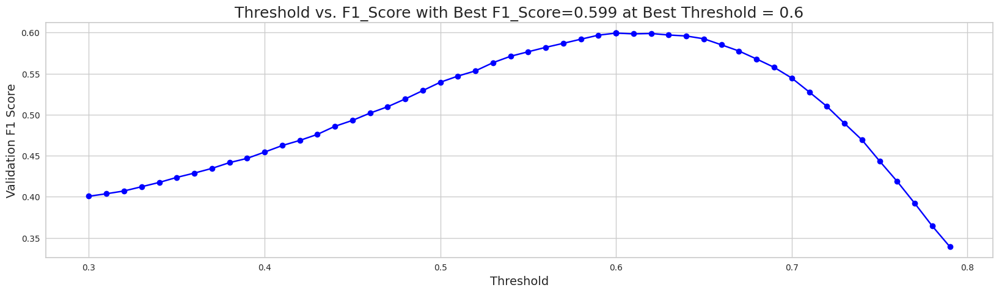

When using optimal threshold = 0.60...
Q0: F1 = 0.5993247245553391
==> Overall F1 = 0.5993247245553391
s
[I 2023-05-23 02:45:15,937] Trial 16 finished with value: 0.5993247245553391 and parameters: {'num_leaves': 100, 'learning_rate': 0.02299521880721946, 'feature_fraction': 0.9092786257975247, 'bagging_fraction': 0.6833360517626237, 'bagging_freq': 1, 'min_child_samples': 56, 'reg_alpha': 6.392531500295071, 'reg_lambda': 7.937218185300631, 'subsample': 0.4538094038098329, 'colsample_bytree': 0.2899334502898075, 'min_split_gain': 0.9348570785029401, 'max_depth': 3}. Best is trial 16 with value: 0.5993247245553391.


--------------------------------------------------
question11, with210features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.5559704541398051, subsample=0.5179966835951297 will be ignored. Current value: bagging_fraction=0.5559704541398051
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9638192114675521, colsample_bytree=0.2253163345514032 will be ignored. Current value: feature_fraction=0.9638192114675521


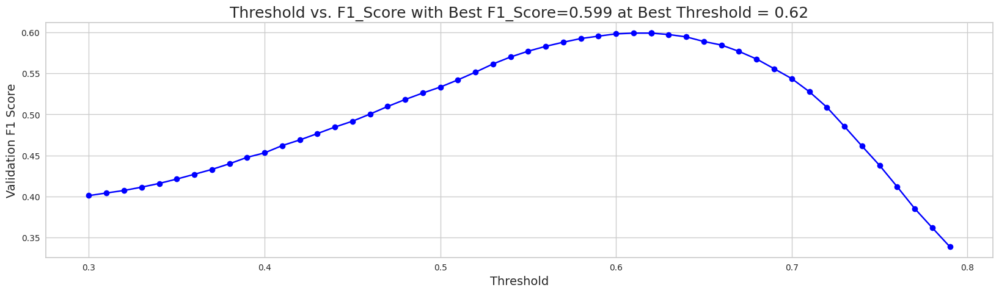

When using optimal threshold = 0.62...
Q0: F1 = 0.5991564992497829
==> Overall F1 = 0.5991564992497829
s
[I 2023-05-23 02:45:17,932] Trial 18 finished with value: 0.5991564992497829 and parameters: {'num_leaves': 31, 'learning_rate': 0.02695268441070848, 'feature_fraction': 0.807989422727903, 'bagging_fraction': 0.6388464287438352, 'bagging_freq': 4, 'min_child_samples': 55, 'reg_alpha': 6.539558786248231, 'reg_lambda': 9.037818207313718, 'subsample': 0.9981240357861625, 'colsample_bytree': 0.21594281899175635, 'min_split_gain': 0.8631910971051476, 'max_depth': 3}. Best is trial 16 with value: 0.5993247245553391.


--------------------------------------------------
question11, with210features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.5210887408429578, subsample=0.49083250001075623 will be ignored. Current value: bagging_fraction=0.5210887408429578
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9895535041088395, colsample_bytree=0.3121800868204365 will be ignored. Current value: feature_fraction=0.9895535041088395


[LightGBM] [Warning] bagging_fraction is set=0.5841064841713384, subsample=0.4880574761529348 will be ignored. Current value: bagging_fraction=0.5841064841713384
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=10, subsample_freq=0 will be ignored. Current value: bagging_freq=10
[LightGBM] [Warning] feature_fraction is set=0.4089329632407676, colsample_bytree=0.1229295494355635 will be ignored. Current value: feature_fraction=0.4089329632407676


[LightGBM] [Warning] bagging_fraction is set=0.6096594121627268, subsample=0.9714817930575865 will be ignored. Current value: bagging_fraction=0.6096594121627268
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
[LightGBM] [Warning] feature_fraction is set=0.9634692545444331, colsample_bytree=0.10270145843398013 will be ignored. Current value: feature_fraction=0.9634692545444331


,mean
feature,
elapsed_time_diff_std,103.6
tunic.historicalsociety.frontdesk_room_fqid_counts,53.8
elapsed_time_diff_mean,53.2
elapsed_time_diff_sum,51.6
hover_duration_min,49.8
room_corr_x_diff_std,47.6
screen_coor_y_mean,44.8
reader.paper1.next_fqid_counts,44.4
reader_fqid_counts,43.2


[[0.55219327 0.44780673]
 [0.41422405 0.58577595]
 [0.289847   0.710153  ]
 ...
 [0.22249043 0.77750957]
 [0.22672196 0.77327804]
 [0.32569762 0.67430238]]


[LightGBM] [Warning] bagging_fraction is set=0.5559704541398051, subsample=0.5179966835951297 will be ignored. Current value: bagging_fraction=0.5559704541398051
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9638192114675521, colsample_bytree=0.2253163345514032 will be ignored. Current value: feature_fraction=0.9638192114675521


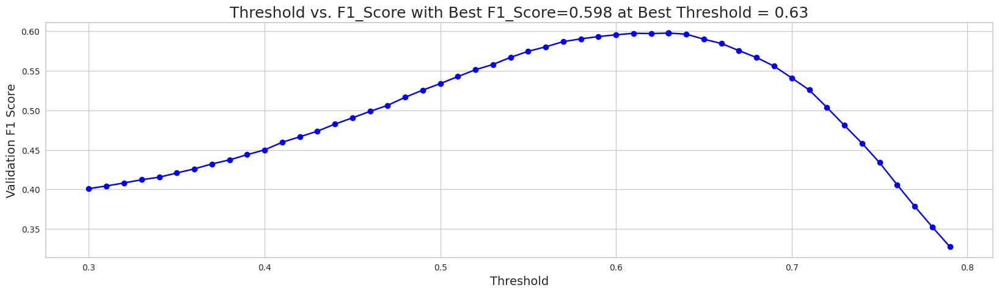

When using optimal threshold = 0.63...
Q0: F1 = 0.5976979255901529
==> Overall F1 = 0.5976979255901529
s
[I 2023-05-23 02:45:52,042] Trial 17 finished with value: 0.5976979255901529 and parameters: {'num_leaves': 94, 'learning_rate': 0.02066599012070716, 'feature_fraction': 0.4089329632407676, 'bagging_fraction': 0.5841064841713384, 'bagging_freq': 10, 'min_child_samples': 36, 'reg_alpha': 3.3482846625847387, 'reg_lambda': 6.601324120225478, 'subsample': 0.4880574761529348, 'colsample_bytree': 0.1229295494355635, 'min_split_gain': 0.8552014316898083, 'max_depth': 2}. Best is trial 16 with value: 0.5993247245553391.


--------------------------------------------------
question11, with210features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.5210887408429578, subsample=0.49083250001075623 will be ignored. Current value: bagging_fraction=0.5210887408429578
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9895535041088395, colsample_bytree=0.3121800868204365 will be ignored. Current value: feature_fraction=0.9895535041088395


[LightGBM] [Warning] bagging_fraction is set=0.47767531263381113, subsample=0.24741500165590458 will be ignored. Current value: bagging_fraction=0.47767531263381113
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9840963066080852, colsample_bytree=0.30171607558310226 will be ignored. Current value: feature_fraction=0.9840963066080852


[LightGBM] [Warning] bagging_fraction is set=0.6096594121627268, subsample=0.9714817930575865 will be ignored. Current value: bagging_fraction=0.6096594121627268
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
[LightGBM] [Warning] feature_fraction is set=0.9634692545444331, colsample_bytree=0.10270145843398013 will be ignored. Current value: feature_fraction=0.9634692545444331


[LightGBM] [Warning] bagging_fraction is set=0.47767531263381113, subsample=0.24741500165590458 will be ignored. Current value: bagging_fraction=0.47767531263381113
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9840963066080852, colsample_bytree=0.30171607558310226 will be ignored. Current value: feature_fraction=0.9840963066080852


[LightGBM] [Warning] bagging_fraction is set=0.5210887408429578, subsample=0.49083250001075623 will be ignored. Current value: bagging_fraction=0.5210887408429578
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9895535041088395, colsample_bytree=0.3121800868204365 will be ignored. Current value: feature_fraction=0.9895535041088395


[LightGBM] [Warning] bagging_fraction is set=0.6096594121627268, subsample=0.9714817930575865 will be ignored. Current value: bagging_fraction=0.6096594121627268
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
[LightGBM] [Warning] feature_fraction is set=0.9634692545444331, colsample_bytree=0.10270145843398013 will be ignored. Current value: feature_fraction=0.9634692545444331
[LightGBM] [Warning] bagging_fraction is set=0.5559704541398051, subsample=0.5179966835951297 will be ignored. Current value: bagging_fraction=0.5559704541398051
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] f

[LightGBM] [Warning] bagging_fraction is set=0.5210887408429578, subsample=0.49083250001075623 will be ignored. Current value: bagging_fraction=0.5210887408429578
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9895535041088395, colsample_bytree=0.3121800868204365 will be ignored. Current value: feature_fraction=0.9895535041088395


,mean
feature,
elapsed_time_diff_std,407.0
hover_duration_mean,234.8
room_coor_x_max,234.8
elapsed_time_diff_mean,230.8
tunic.historicalsociety.frontdesk_room_fqid_counts,223.6
hover_duration_sum,219.0
hover_duration_max,216.0
elapsed_time_diff_sum,215.8
session_id,204.6


[[0.56099543 0.43900457]
 [0.41232813 0.58767187]
 [0.28689915 0.71310085]
 ...
 [0.25034567 0.74965433]
 [0.20096735 0.79903265]
 [0.30314619 0.69685381]]


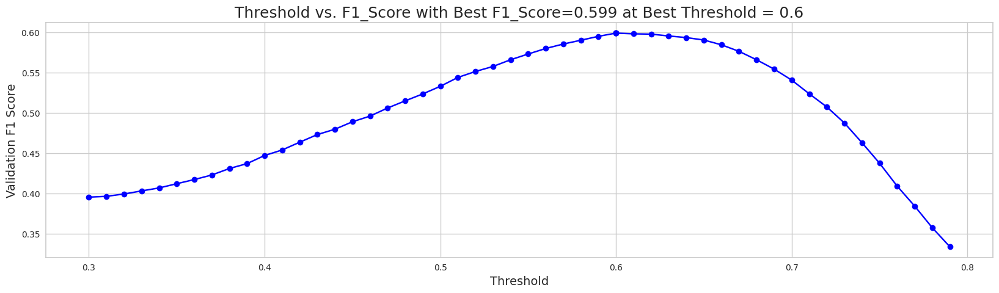

When using optimal threshold = 0.60...
Q0: F1 = 0.5991309257415552
==> Overall F1 = 0.5991309257415552
s
[I 2023-05-23 02:47:10,106] Trial 19 finished with value: 0.5991309257415552 and parameters: {'num_leaves': 30, 'learning_rate': 0.010482016071130315, 'feature_fraction': 0.9634692545444331, 'bagging_fraction': 0.6096594121627268, 'bagging_freq': 4, 'min_child_samples': 100, 'reg_alpha': 6.203841900407955, 'reg_lambda': 8.869523433489512, 'subsample': 0.9714817930575865, 'colsample_bytree': 0.10270145843398013, 'min_split_gain': 0.3671512926934143, 'max_depth': 5}. Best is trial 16 with value: 0.5993247245553391.


--------------------------------------------------
question11, with210features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.47767531263381113, subsample=0.24741500165590458 will be ignored. Current value: bagging_fraction=0.47767531263381113
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9840963066080852, colsample_bytree=0.30171607558310226 will be ignored. Current value: feature_fraction=0.9840963066080852


[LightGBM] [Warning] bagging_fraction is set=0.47853823969400944, subsample=0.23474553420955097 will be ignored. Current value: bagging_fraction=0.47853823969400944
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.8694368477520749, colsample_bytree=0.31553028300422736 will be ignored. Current value: feature_fraction=0.8694368477520749


[LightGBM] [Warning] bagging_fraction is set=0.5559704541398051, subsample=0.5179966835951297 will be ignored. Current value: bagging_fraction=0.5559704541398051
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9638192114675521, colsample_bytree=0.2253163345514032 will be ignored. Current value: feature_fraction=0.9638192114675521


[LightGBM] [Warning] bagging_fraction is set=0.47853823969400944, subsample=0.23474553420955097 will be ignored. Current value: bagging_fraction=0.47853823969400944
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.8694368477520749, colsample_bytree=0.31553028300422736 will be ignored. Current value: feature_fraction=0.8694368477520749


[LightGBM] [Warning] bagging_fraction is set=0.5210887408429578, subsample=0.49083250001075623 will be ignored. Current value: bagging_fraction=0.5210887408429578
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9895535041088395, colsample_bytree=0.3121800868204365 will be ignored. Current value: feature_fraction=0.9895535041088395


[LightGBM] [Warning] bagging_fraction is set=0.47767531263381113, subsample=0.24741500165590458 will be ignored. Current value: bagging_fraction=0.47767531263381113
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9840963066080852, colsample_bytree=0.30171607558310226 will be ignored. Current value: feature_fraction=0.9840963066080852


[LightGBM] [Warning] bagging_fraction is set=0.5559704541398051, subsample=0.5179966835951297 will be ignored. Current value: bagging_fraction=0.5559704541398051
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9638192114675521, colsample_bytree=0.2253163345514032 will be ignored. Current value: feature_fraction=0.9638192114675521


,mean
feature,
elapsed_time_diff_std,480.2
session_id,337.6
hover_duration_mean,335.8
room_coor_x_max,334.2
hover_duration_max,306.4
elapsed_time_diff_mean,304.4
room_coor_y_max,283.4
room_coor_x_std,274.0
hover_duration_sum,273.0


[[0.55331285 0.44668715]
 [0.4451279  0.5548721 ]
 [0.2548876  0.7451124 ]
 ...
 [0.23331731 0.76668269]
 [0.22078266 0.77921734]
 [0.32308637 0.67691363]]


[LightGBM] [Warning] bagging_fraction is set=0.47853823969400944, subsample=0.23474553420955097 will be ignored. Current value: bagging_fraction=0.47853823969400944
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.8694368477520749, colsample_bytree=0.31553028300422736 will be ignored. Current value: feature_fraction=0.8694368477520749


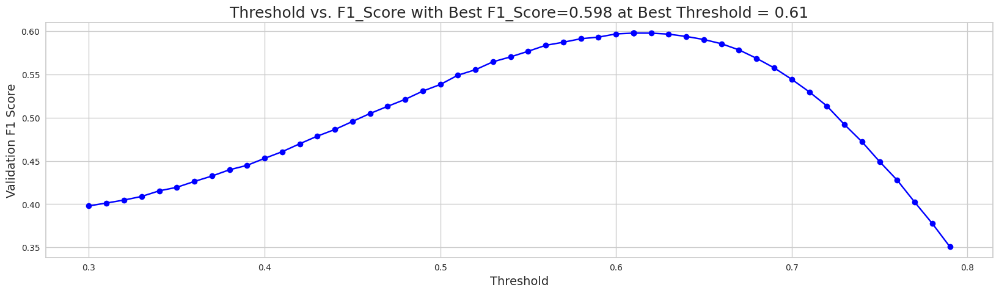

When using optimal threshold = 0.61...
Q0: F1 = 0.5979904643336977
==> Overall F1 = 0.5979904643336977
s
[I 2023-05-23 02:48:07,190] Trial 21 finished with value: 0.5979904643336977 and parameters: {'num_leaves': 73, 'learning_rate': 0.011181379456697522, 'feature_fraction': 0.9895535041088395, 'bagging_fraction': 0.5210887408429578, 'bagging_freq': 1, 'min_child_samples': 38, 'reg_alpha': 8.381451763773107, 'reg_lambda': 0.48889655258077014, 'subsample': 0.49083250001075623, 'colsample_bytree': 0.3121800868204365, 'min_split_gain': 0.3885851264700152, 'max_depth': 5}. Best is trial 16 with value: 0.5993247245553391.


--------------------------------------------------
question11, with210features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.43052703468557174, subsample=0.5420668113286335 will be ignored. Current value: bagging_fraction=0.43052703468557174
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
[LightGBM] [Warning] feature_fraction is set=0.8748721345153709, colsample_bytree=0.22717258637778376 will be ignored. Current value: feature_fraction=0.8748721345153709


[LightGBM] [Warning] bagging_fraction is set=0.43052703468557174, subsample=0.5420668113286335 will be ignored. Current value: bagging_fraction=0.43052703468557174
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
[LightGBM] [Warning] feature_fraction is set=0.8748721345153709, colsample_bytree=0.22717258637778376 will be ignored. Current value: feature_fraction=0.8748721345153709


[LightGBM] [Warning] bagging_fraction is set=0.47767531263381113, subsample=0.24741500165590458 will be ignored. Current value: bagging_fraction=0.47767531263381113
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9840963066080852, colsample_bytree=0.30171607558310226 will be ignored. Current value: feature_fraction=0.9840963066080852


[LightGBM] [Warning] bagging_fraction is set=0.47853823969400944, subsample=0.23474553420955097 will be ignored. Current value: bagging_fraction=0.47853823969400944
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.8694368477520749, colsample_bytree=0.31553028300422736 will be ignored. Current value: feature_fraction=0.8694368477520749


,mean
feature,
elapsed_time_diff_std,508.0
room_coor_x_max,338.4
hover_duration_mean,335.0
session_id,328.4
hover_duration_max,311.4
elapsed_time_diff_mean,307.2
hover_duration_sum,287.8
room_corr_x_diff_std,282.6
elapsed_time_diff_sum,280.6


[[0.57841009 0.42158991]
 [0.44498203 0.55501797]
 [0.24692904 0.75307096]
 ...
 [0.23910128 0.76089872]
 [0.20074043 0.79925957]
 [0.30531664 0.69468336]]


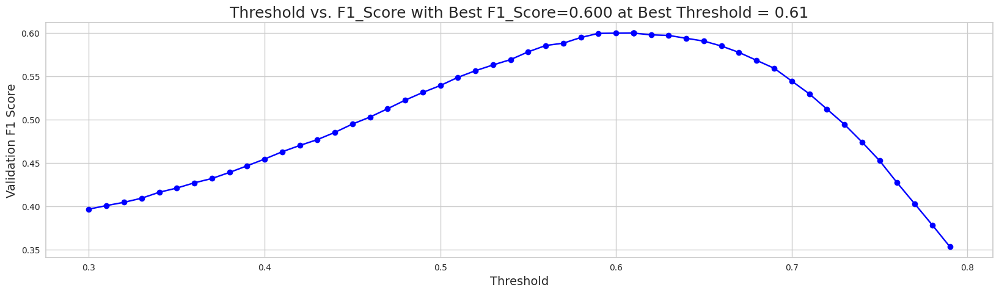

When using optimal threshold = 0.61...
Q0: F1 = 0.5995416797400339
==> Overall F1 = 0.5995416797400339
s
[I 2023-05-23 02:48:34,585] Trial 20 finished with value: 0.5995416797400339 and parameters: {'num_leaves': 74, 'learning_rate': 0.01119286386100549, 'feature_fraction': 0.9638192114675521, 'bagging_fraction': 0.5559704541398051, 'bagging_freq': 1, 'min_child_samples': 64, 'reg_alpha': 8.867687263474377, 'reg_lambda': 0.44183368435668946, 'subsample': 0.5179966835951297, 'colsample_bytree': 0.2253163345514032, 'min_split_gain': 0.3643706656371399, 'max_depth': 5}. Best is trial 20 with value: 0.5995416797400339.


--------------------------------------------------
question11, with210features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.43052703468557174, subsample=0.5420668113286335 will be ignored. Current value: bagging_fraction=0.43052703468557174
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
[LightGBM] [Warning] feature_fraction is set=0.8748721345153709, colsample_bytree=0.22717258637778376 will be ignored. Current value: feature_fraction=0.8748721345153709


[LightGBM] [Warning] bagging_fraction is set=0.4626762186771679, subsample=0.5404496045155495 will be ignored. Current value: bagging_fraction=0.4626762186771679
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.8542613554114186, colsample_bytree=0.23398503408445057 will be ignored. Current value: feature_fraction=0.8542613554114186


[LightGBM] [Warning] bagging_fraction is set=0.47853823969400944, subsample=0.23474553420955097 will be ignored. Current value: bagging_fraction=0.47853823969400944
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.8694368477520749, colsample_bytree=0.31553028300422736 will be ignored. Current value: feature_fraction=0.8694368477520749


,mean
feature,
elapsed_time_diff_std,515.8
room_coor_x_max,401.6
hover_duration_mean,382.8
session_id,379.2
hover_duration_max,371.2
hover_duration_sum,338.8
room_coor_y_max,332.0
elapsed_time_diff_mean,317.2
room_coor_y_min,313.4


[[0.53505612 0.46494388]
 [0.44555403 0.55444597]
 [0.24718065 0.75281935]
 ...
 [0.24547311 0.75452689]
 [0.21989972 0.78010028]
 [0.3445999  0.6554001 ]]


[LightGBM] [Warning] bagging_fraction is set=0.43052703468557174, subsample=0.5420668113286335 will be ignored. Current value: bagging_fraction=0.43052703468557174
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
[LightGBM] [Warning] feature_fraction is set=0.8748721345153709, colsample_bytree=0.22717258637778376 will be ignored. Current value: feature_fraction=0.8748721345153709


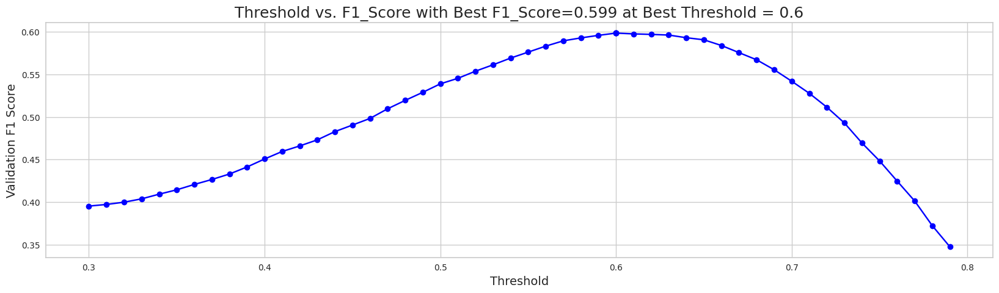

When using optimal threshold = 0.60...
Q0: F1 = 0.598526416999043
==> Overall F1 = 0.598526416999043
s
[I 2023-05-23 02:48:50,746] Trial 22 finished with value: 0.598526416999043 and parameters: {'num_leaves': 71, 'learning_rate': 0.011339899751535588, 'feature_fraction': 0.9840963066080852, 'bagging_fraction': 0.47767531263381113, 'bagging_freq': 1, 'min_child_samples': 67, 'reg_alpha': 9.131360647996045, 'reg_lambda': 0.4259121946344523, 'subsample': 0.24741500165590458, 'colsample_bytree': 0.30171607558310226, 'min_split_gain': 0.3838210149343343, 'max_depth': 6}. Best is trial 20 with value: 0.5995416797400339.


--------------------------------------------------
question11, with210features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.43140635868450644, subsample=0.517270547707487 will be ignored. Current value: bagging_fraction=0.43140635868450644
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8743481096522007, colsample_bytree=0.19845939046822014 will be ignored. Current value: feature_fraction=0.8743481096522007


[LightGBM] [Warning] bagging_fraction is set=0.43052703468557174, subsample=0.5420668113286335 will be ignored. Current value: bagging_fraction=0.43052703468557174
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
[LightGBM] [Warning] feature_fraction is set=0.8748721345153709, colsample_bytree=0.22717258637778376 will be ignored. Current value: feature_fraction=0.8748721345153709


,mean
feature,
elapsed_time_diff_std,162.6
room_coor_x_max,140.2
session_id,139.0
hover_duration_mean,132.4
hover_duration_max,126.4
room_coor_y_max,119.4
room_coor_x_std,113.8
hover_duration_sum,112.2
room_coor_y_std,111.6


[[0.45471039 0.54528961]
 [0.44794148 0.55205852]
 [0.2990265  0.7009735 ]
 ...
 [0.20209889 0.79790111]
 [0.19893321 0.80106679]
 [0.33711511 0.66288489]]


[LightGBM] [Warning] bagging_fraction is set=0.4626762186771679, subsample=0.5404496045155495 will be ignored. Current value: bagging_fraction=0.4626762186771679
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.8542613554114186, colsample_bytree=0.23398503408445057 will be ignored. Current value: feature_fraction=0.8542613554114186


[LightGBM] [Warning] bagging_fraction is set=0.43140635868450644, subsample=0.517270547707487 will be ignored. Current value: bagging_fraction=0.43140635868450644
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8743481096522007, colsample_bytree=0.19845939046822014 will be ignored. Current value: feature_fraction=0.8743481096522007


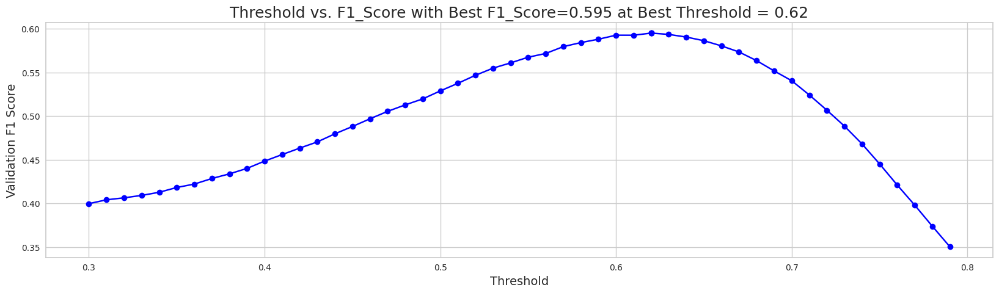

When using optimal threshold = 0.62...
Q0: F1 = 0.5951036086042238
==> Overall F1 = 0.5951036086042238
s
[I 2023-05-23 02:49:09,195] Trial 23 finished with value: 0.5951036086042238 and parameters: {'num_leaves': 73, 'learning_rate': 0.031209488703877252, 'feature_fraction': 0.8694368477520749, 'bagging_fraction': 0.47853823969400944, 'bagging_freq': 1, 'min_child_samples': 43, 'reg_alpha': 0.2582836343435112, 'reg_lambda': 0.37830231324401326, 'subsample': 0.23474553420955097, 'colsample_bytree': 0.31553028300422736, 'min_split_gain': 0.3351817885312245, 'max_depth': 0}. Best is trial 20 with value: 0.5995416797400339.


--------------------------------------------------
question11, with210features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.6679088797871395, subsample=0.4089891927023066 will be ignored. Current value: bagging_fraction=0.6679088797871395
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8554350991142569, colsample_bytree=0.2092797249527598 will be ignored. Current value: feature_fraction=0.8554350991142569


,mean
feature,
elapsed_time_diff_std,127.0
room_coor_x_max,85.0
hover_duration_mean,83.0
elapsed_time_diff_sum,80.2
session_id,79.8
hover_duration_max,77.8
11_level_counts,71.2
room_corr_x_diff_std,71.2
hover_duration_sum,71.0


[[0.51468504 0.48531496]
 [0.42580852 0.57419148]
 [0.29613098 0.70386902]
 ...
 [0.24819924 0.75180076]
 [0.21538244 0.78461756]
 [0.26932265 0.73067735]]


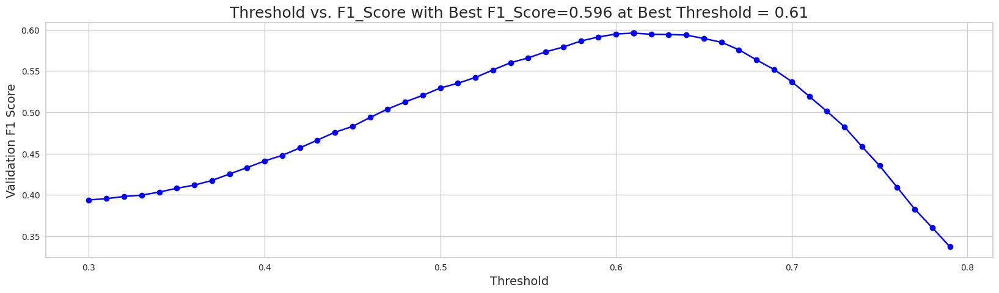

When using optimal threshold = 0.61...
Q0: F1 = 0.595873447801006
==> Overall F1 = 0.595873447801006
s
[I 2023-05-23 02:49:17,743] Trial 24 finished with value: 0.595873447801006 and parameters: {'num_leaves': 40, 'learning_rate': 0.03023372130776301, 'feature_fraction': 0.8748721345153709, 'bagging_fraction': 0.43052703468557174, 'bagging_freq': 5, 'min_child_samples': 64, 'reg_alpha': 2.891470283548674, 'reg_lambda': 4.492991137051812, 'subsample': 0.5420668113286335, 'colsample_bytree': 0.22717258637778376, 'min_split_gain': 0.3742951824065874, 'max_depth': 0}. Best is trial 20 with value: 0.5995416797400339.


--------------------------------------------------
question11, with210features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.6727842149369989, subsample=0.4036587030488641 will be ignored. Current value: bagging_fraction=0.6727842149369989
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.6427202866166535, colsample_bytree=0.40053461114978717 will be ignored. Current value: feature_fraction=0.6427202866166535


[LightGBM] [Warning] bagging_fraction is set=0.43140635868450644, subsample=0.517270547707487 will be ignored. Current value: bagging_fraction=0.43140635868450644
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8743481096522007, colsample_bytree=0.19845939046822014 will be ignored. Current value: feature_fraction=0.8743481096522007


[LightGBM] [Warning] bagging_fraction is set=0.6679088797871395, subsample=0.4089891927023066 will be ignored. Current value: bagging_fraction=0.6679088797871395
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8554350991142569, colsample_bytree=0.2092797249527598 will be ignored. Current value: feature_fraction=0.8554350991142569


[LightGBM] [Warning] bagging_fraction is set=0.6727842149369989, subsample=0.4036587030488641 will be ignored. Current value: bagging_fraction=0.6727842149369989
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.6427202866166535, colsample_bytree=0.40053461114978717 will be ignored. Current value: feature_fraction=0.6427202866166535


[LightGBM] [Warning] bagging_fraction is set=0.43140635868450644, subsample=0.517270547707487 will be ignored. Current value: bagging_fraction=0.43140635868450644
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8743481096522007, colsample_bytree=0.19845939046822014 will be ignored. Current value: feature_fraction=0.8743481096522007


[LightGBM] [Warning] bagging_fraction is set=0.43140635868450644, subsample=0.517270547707487 will be ignored. Current value: bagging_fraction=0.43140635868450644
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8743481096522007, colsample_bytree=0.19845939046822014 will be ignored. Current value: feature_fraction=0.8743481096522007


[LightGBM] [Warning] bagging_fraction is set=0.4626762186771679, subsample=0.5404496045155495 will be ignored. Current value: bagging_fraction=0.4626762186771679
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.8542613554114186, colsample_bytree=0.23398503408445057 will be ignored. Current value: feature_fraction=0.8542613554114186


[LightGBM] [Warning] bagging_fraction is set=0.6679088797871395, subsample=0.4089891927023066 will be ignored. Current value: bagging_fraction=0.6679088797871395
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8554350991142569, colsample_bytree=0.2092797249527598 will be ignored. Current value: feature_fraction=0.8554350991142569


,mean
feature,
elapsed_time_diff_std,49.6
hover_duration_min,23.6
tunic.historicalsociety.frontdesk_room_fqid_counts,22.4
elapsed_time_diff_mean,21.8
room_corr_x_diff_std,21.6
reader_fqid_counts,20.0
reader.paper1.next_fqid_counts,18.4
tunic.historicalsociety.stacks_room_fqid_counts,18.2
elapsed_time_diff_sum,17.4


[[0.5598111  0.4401889 ]
 [0.41829063 0.58170937]
 [0.27626254 0.72373746]
 ...
 [0.21933546 0.78066454]
 [0.23345463 0.76654537]
 [0.30198858 0.69801142]]
[LightGBM] [Warning] bagging_fraction is set=0.6727842149369989, subsample=0.4036587030488641 will be ignored. Current value: bagging_fraction=0.6727842149369989
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.6427202866166535, colsample_bytree=0.40053461114978717 will be ignored. Current value: feature_fraction=0.6427202866166535


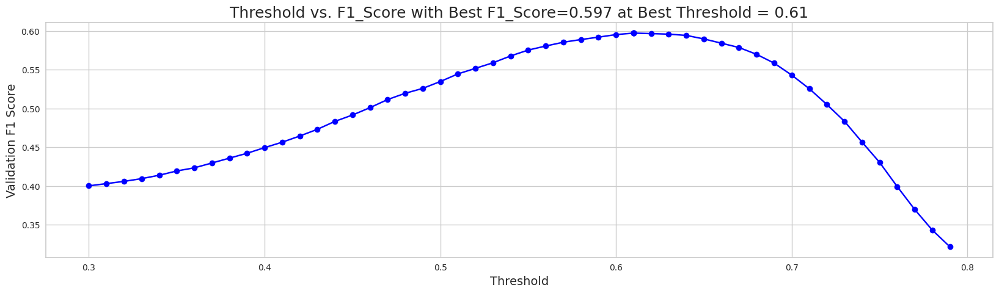

When using optimal threshold = 0.61...
Q0: F1 = 0.5972916691324172
==> Overall F1 = 0.5972916691324172
s
[I 2023-05-23 02:50:05,284] Trial 26 finished with value: 0.5972916691324172 and parameters: {'num_leaves': 99, 'learning_rate': 0.02952948833855032, 'feature_fraction': 0.8743481096522007, 'bagging_fraction': 0.43140635868450644, 'bagging_freq': 2, 'min_child_samples': 64, 'reg_alpha': 2.4258381215893725, 'reg_lambda': 3.4085734250491733, 'subsample': 0.517270547707487, 'colsample_bytree': 0.19845939046822014, 'min_split_gain': 0.21454208604143626, 'max_depth': 1}. Best is trial 20 with value: 0.5995416797400339.


--------------------------------------------------
question11, with210features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.6512377913314794, subsample=0.4045843404770466 will be ignored. Current value: bagging_fraction=0.6512377913314794
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.6810459368903193, colsample_bytree=0.40727526591724017 will be ignored. Current value: feature_fraction=0.6810459368903193


[LightGBM] [Warning] bagging_fraction is set=0.6727842149369989, subsample=0.4036587030488641 will be ignored. Current value: bagging_fraction=0.6727842149369989
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.6427202866166535, colsample_bytree=0.40053461114978717 will be ignored. Current value: feature_fraction=0.6427202866166535


[LightGBM] [Warning] bagging_fraction is set=0.6679088797871395, subsample=0.4089891927023066 will be ignored. Current value: bagging_fraction=0.6679088797871395
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8554350991142569, colsample_bytree=0.2092797249527598 will be ignored. Current value: feature_fraction=0.8554350991142569


[LightGBM] [Warning] bagging_fraction is set=0.6512377913314794, subsample=0.4045843404770466 will be ignored. Current value: bagging_fraction=0.6512377913314794
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.6810459368903193, colsample_bytree=0.40727526591724017 will be ignored. Current value: feature_fraction=0.6810459368903193


[LightGBM] [Warning] bagging_fraction is set=0.6727842149369989, subsample=0.4036587030488641 will be ignored. Current value: bagging_fraction=0.6727842149369989
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.6427202866166535, colsample_bytree=0.40053461114978717 will be ignored. Current value: feature_fraction=0.6427202866166535


[LightGBM] [Warning] bagging_fraction is set=0.4626762186771679, subsample=0.5404496045155495 will be ignored. Current value: bagging_fraction=0.4626762186771679
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.8542613554114186, colsample_bytree=0.23398503408445057 will be ignored. Current value: feature_fraction=0.8542613554114186


[LightGBM] [Warning] bagging_fraction is set=0.6679088797871395, subsample=0.4089891927023066 will be ignored. Current value: bagging_fraction=0.6679088797871395
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8554350991142569, colsample_bytree=0.2092797249527598 will be ignored. Current value: feature_fraction=0.8554350991142569


,mean
feature,
elapsed_time_diff_std,196.8
elapsed_time_diff_sum,124.6
hover_duration_mean,114.6
tunic.historicalsociety.frontdesk_room_fqid_counts,114.4
elapsed_time_diff_mean,103.4
room_corr_x_diff_std,103.2
room_coor_x_max,102.6
room_coor_x_std,98.4
11_level_counts,96.8


[[0.55679893 0.44320107]
 [0.45061907 0.54938093]
 [0.26725867 0.73274133]
 ...
 [0.24748067 0.75251933]
 [0.22331135 0.77668865]
 [0.32727638 0.67272362]]


[LightGBM] [Warning] bagging_fraction is set=0.6512377913314794, subsample=0.4045843404770466 will be ignored. Current value: bagging_fraction=0.6512377913314794
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.6810459368903193, colsample_bytree=0.40727526591724017 will be ignored. Current value: feature_fraction=0.6810459368903193


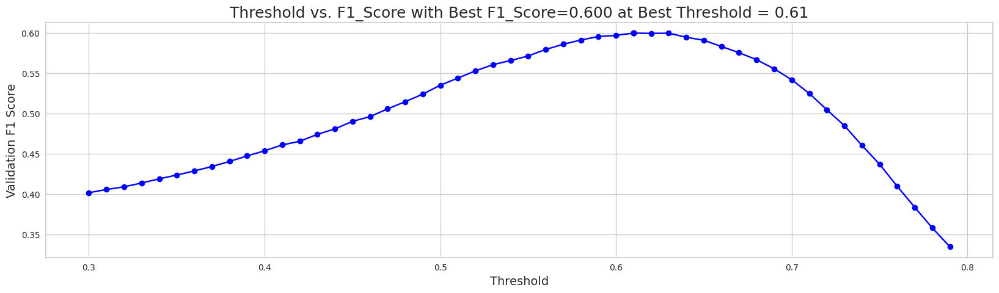

When using optimal threshold = 0.61...
Q0: F1 = 0.6001144024069752
==> Overall F1 = 0.6001144024069752
s
[I 2023-05-23 02:50:49,815] Trial 28 finished with value: 0.6001144024069752 and parameters: {'num_leaves': 82, 'learning_rate': 0.016529249536341897, 'feature_fraction': 0.6427202866166535, 'bagging_fraction': 0.6727842149369989, 'bagging_freq': 2, 'min_child_samples': 61, 'reg_alpha': 2.2833843531220452, 'reg_lambda': 1.4475590372962805, 'subsample': 0.4036587030488641, 'colsample_bytree': 0.40053461114978717, 'min_split_gain': 0.20442886870052016, 'max_depth': 4}. Best is trial 28 with value: 0.6001144024069752.


--------------------------------------------------
question11, with210features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.6721166596848398, subsample=0.33357378850528724 will be ignored. Current value: bagging_fraction=0.6721166596848398
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.6224387212533353, colsample_bytree=0.41244775600262296 will be ignored. Current value: feature_fraction=0.6224387212533353


,mean
feature,
elapsed_time_diff_std,222.4
tunic.historicalsociety.frontdesk_room_fqid_counts,129.6
hover_duration_mean,127.8
elapsed_time_diff_sum,123.2
elapsed_time_diff_mean,123.0
room_corr_x_diff_std,119.0
room_coor_x_std,108.8
hover_duration_min,107.0
11_level_counts,106.8


[[0.56242493 0.43757507]
 [0.44947653 0.55052347]
 [0.26885315 0.73114685]
 ...
 [0.23742805 0.76257195]
 [0.22488293 0.77511707]
 [0.31202362 0.68797638]]


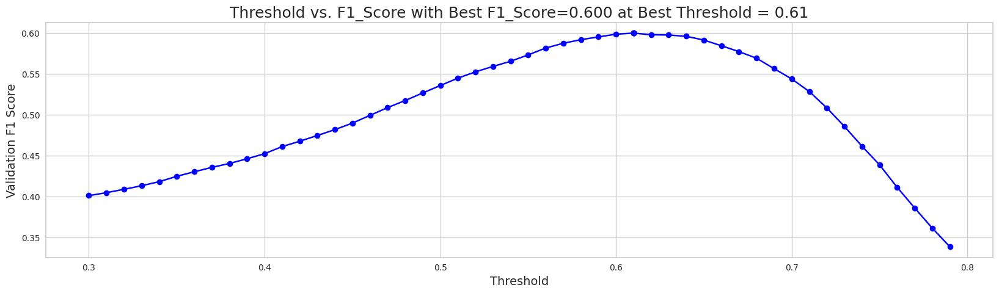

When using optimal threshold = 0.61...
Q0: F1 = 0.5997897662406315
==> Overall F1 = 0.5997897662406315
s
[I 2023-05-23 02:51:07,039] Trial 27 finished with value: 0.5997897662406315 and parameters: {'num_leaves': 99, 'learning_rate': 0.015228998709415822, 'feature_fraction': 0.8554350991142569, 'bagging_fraction': 0.6679088797871395, 'bagging_freq': 2, 'min_child_samples': 63, 'reg_alpha': 2.6845441697962853, 'reg_lambda': 3.230385963660498, 'subsample': 0.4089891927023066, 'colsample_bytree': 0.2092797249527598, 'min_split_gain': 0.22633114430192133, 'max_depth': 4}. Best is trial 28 with value: 0.6001144024069752.


--------------------------------------------------
question11, with210features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.6721166596848398, subsample=0.33357378850528724 will be ignored. Current value: bagging_fraction=0.6721166596848398
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.6224387212533353, colsample_bytree=0.41244775600262296 will be ignored. Current value: feature_fraction=0.6224387212533353


[LightGBM] [Warning] bagging_fraction is set=0.6512377913314794, subsample=0.4045843404770466 will be ignored. Current value: bagging_fraction=0.6512377913314794
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.6810459368903193, colsample_bytree=0.40727526591724017 will be ignored. Current value: feature_fraction=0.6810459368903193
[LightGBM] [Warning] bagging_fraction is set=0.8242485523076859, subsample=0.355162312024626 will be ignored. Current value: bagging_fraction=0.8242485523076859
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] fe

[LightGBM] [Warning] bagging_fraction is set=0.4626762186771679, subsample=0.5404496045155495 will be ignored. Current value: bagging_fraction=0.4626762186771679
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.8542613554114186, colsample_bytree=0.23398503408445057 will be ignored. Current value: feature_fraction=0.8542613554114186


[LightGBM] [Warning] bagging_fraction is set=0.6512377913314794, subsample=0.4045843404770466 will be ignored. Current value: bagging_fraction=0.6512377913314794
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.6810459368903193, colsample_bytree=0.40727526591724017 will be ignored. Current value: feature_fraction=0.6810459368903193


[LightGBM] [Warning] bagging_fraction is set=0.6721166596848398, subsample=0.33357378850528724 will be ignored. Current value: bagging_fraction=0.6721166596848398
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.6224387212533353, colsample_bytree=0.41244775600262296 will be ignored. Current value: feature_fraction=0.6224387212533353


[LightGBM] [Warning] bagging_fraction is set=0.8242485523076859, subsample=0.355162312024626 will be ignored. Current value: bagging_fraction=0.8242485523076859
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.6542076859882299, colsample_bytree=0.38084901137258986 will be ignored. Current value: feature_fraction=0.6542076859882299


,mean
feature,
elapsed_time_diff_std,192.8
elapsed_time_diff_sum,113.0
hover_duration_mean,110.8
room_coor_x_max,103.6
tunic.historicalsociety.frontdesk_room_fqid_counts,102.0
room_corr_x_diff_std,100.0
11_level_counts,98.0
elapsed_time_diff_mean,97.6
room_coor_x_std,95.8


[[0.57642611 0.42357389]
 [0.44704126 0.55295874]
 [0.26586239 0.73413761]
 ...
 [0.23248683 0.76751317]
 [0.22608135 0.77391865]
 [0.29924209 0.70075791]]


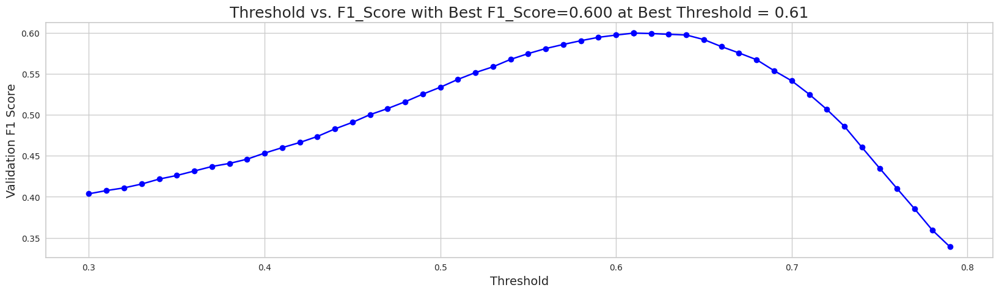

When using optimal threshold = 0.61...
Q0: F1 = 0.5995621249153
==> Overall F1 = 0.5995621249153
s
[I 2023-05-23 02:51:40,483] Trial 29 finished with value: 0.5995621249153 and parameters: {'num_leaves': 84, 'learning_rate': 0.017934527537673828, 'feature_fraction': 0.6810459368903193, 'bagging_fraction': 0.6512377913314794, 'bagging_freq': 2, 'min_child_samples': 46, 'reg_alpha': 1.6530403506532092, 'reg_lambda': 1.3977155629738232, 'subsample': 0.4045843404770466, 'colsample_bytree': 0.40727526591724017, 'min_split_gain': 0.5375387051479046, 'max_depth': 4}. Best is trial 28 with value: 0.6001144024069752.


--------------------------------------------------
question11, with210features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.6721166596848398, subsample=0.33357378850528724 will be ignored. Current value: bagging_fraction=0.6721166596848398
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.6224387212533353, colsample_bytree=0.41244775600262296 will be ignored. Current value: feature_fraction=0.6224387212533353
[LightGBM] [Warning] bagging_fraction is set=0.8143000956434385, subsample=0.34848759932574686 will be ignored. Current value: bagging_fraction=0.8143000956434385
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning]

,mean
feature,
elapsed_time_diff_std,471.0
hover_duration_mean,383.0
room_coor_x_max,375.4
session_id,374.0
elapsed_time_diff_mean,325.2
hover_duration_max,324.4
room_coor_y_max,313.4
room_coor_x_std,308.4
hover_duration_sum,307.4


[[0.57210424 0.42789576]
 [0.45341785 0.54658215]
 [0.28352504 0.71647496]
 ...
 [0.24049139 0.75950861]
 [0.19855439 0.80144561]
 [0.32926165 0.67073835]]


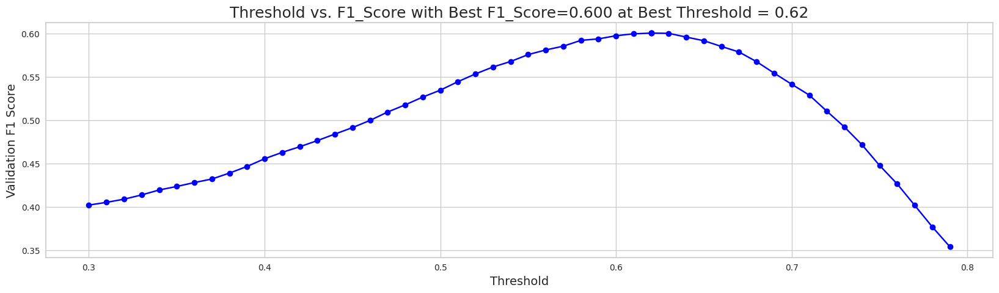

When using optimal threshold = 0.62...
Q0: F1 = 0.6002482343467851
==> Overall F1 = 0.6002482343467851
s
[I 2023-05-23 02:51:48,050] Trial 25 finished with value: 0.6002482343467851 and parameters: {'num_leaves': 79, 'learning_rate': 0.010131226858775492, 'feature_fraction': 0.8542613554114186, 'bagging_fraction': 0.4626762186771679, 'bagging_freq': 1, 'min_child_samples': 64, 'reg_alpha': 2.7518731979975826, 'reg_lambda': 0.2587439683961952, 'subsample': 0.5404496045155495, 'colsample_bytree': 0.23398503408445057, 'min_split_gain': 0.3727946236067346, 'max_depth': 6}. Best is trial 25 with value: 0.6002482343467851.


--------------------------------------------------
question11, with210features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.8010181171093814, subsample=0.36000063040867314 will be ignored. Current value: bagging_fraction=0.8010181171093814
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.6476116774739151, colsample_bytree=0.3824163871098777 will be ignored. Current value: feature_fraction=0.6476116774739151


[LightGBM] [Warning] bagging_fraction is set=0.6721166596848398, subsample=0.33357378850528724 will be ignored. Current value: bagging_fraction=0.6721166596848398
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.6224387212533353, colsample_bytree=0.41244775600262296 will be ignored. Current value: feature_fraction=0.6224387212533353


[LightGBM] [Warning] bagging_fraction is set=0.8143000956434385, subsample=0.34848759932574686 will be ignored. Current value: bagging_fraction=0.8143000956434385
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.6207160221064684, colsample_bytree=0.40904287674025297 will be ignored. Current value: feature_fraction=0.6207160221064684


[LightGBM] [Warning] bagging_fraction is set=0.8242485523076859, subsample=0.355162312024626 will be ignored. Current value: bagging_fraction=0.8242485523076859
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.6542076859882299, colsample_bytree=0.38084901137258986 will be ignored. Current value: feature_fraction=0.6542076859882299


,mean
feature,
elapsed_time_diff_std,175.2
hover_duration_mean,108.0
elapsed_time_diff_sum,104.6
elapsed_time_diff_mean,99.4
room_coor_x_max,96.8
tunic.historicalsociety.frontdesk_room_fqid_counts,93.6
room_corr_x_diff_std,93.4
session_id,90.2
hover_duration_sum,87.8


[[0.56933343 0.43066657]
 [0.45309443 0.54690557]
 [0.25647876 0.74352124]
 ...
 [0.24654298 0.75345702]
 [0.220779   0.779221  ]
 [0.31497617 0.68502383]]


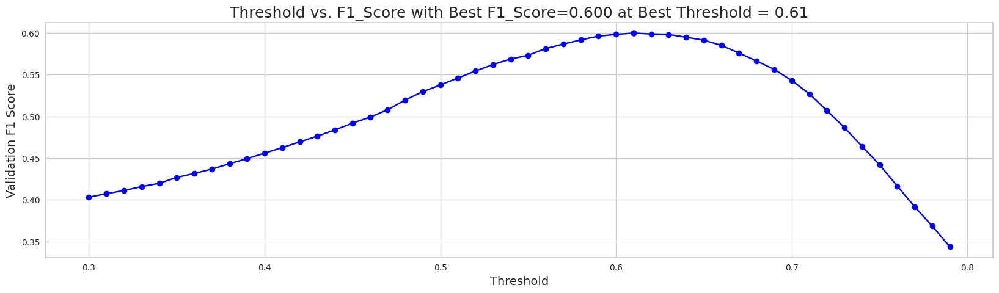

When using optimal threshold = 0.61...
Q0: F1 = 0.5998384236805345
==> Overall F1 = 0.5998384236805345
s
[I 2023-05-23 02:52:16,927] Trial 30 finished with value: 0.5998384236805345 and parameters: {'num_leaves': 81, 'learning_rate': 0.020073842602833947, 'feature_fraction': 0.6224387212533353, 'bagging_fraction': 0.6721166596848398, 'bagging_freq': 2, 'min_child_samples': 75, 'reg_alpha': 1.8688178355052278, 'reg_lambda': 1.4366627270966603, 'subsample': 0.33357378850528724, 'colsample_bytree': 0.41244775600262296, 'min_split_gain': 0.20763781024294417, 'max_depth': 4}. Best is trial 25 with value: 0.6002482343467851.


--------------------------------------------------
question11, with210features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.8166368618554506, subsample=0.37129357233668553 will be ignored. Current value: bagging_fraction=0.8166368618554506
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.6219257056145445, colsample_bytree=0.39977286095720926 will be ignored. Current value: feature_fraction=0.6219257056145445


[LightGBM] [Warning] bagging_fraction is set=0.8010181171093814, subsample=0.36000063040867314 will be ignored. Current value: bagging_fraction=0.8010181171093814
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.6476116774739151, colsample_bytree=0.3824163871098777 will be ignored. Current value: feature_fraction=0.6476116774739151


[LightGBM] [Warning] bagging_fraction is set=0.8242485523076859, subsample=0.355162312024626 will be ignored. Current value: bagging_fraction=0.8242485523076859
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.6542076859882299, colsample_bytree=0.38084901137258986 will be ignored. Current value: feature_fraction=0.6542076859882299


[LightGBM] [Warning] bagging_fraction is set=0.8143000956434385, subsample=0.34848759932574686 will be ignored. Current value: bagging_fraction=0.8143000956434385
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.6207160221064684, colsample_bytree=0.40904287674025297 will be ignored. Current value: feature_fraction=0.6207160221064684


[LightGBM] [Warning] bagging_fraction is set=0.8166368618554506, subsample=0.37129357233668553 will be ignored. Current value: bagging_fraction=0.8166368618554506
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.6219257056145445, colsample_bytree=0.39977286095720926 will be ignored. Current value: feature_fraction=0.6219257056145445


[LightGBM] [Warning] bagging_fraction is set=0.8143000956434385, subsample=0.34848759932574686 will be ignored. Current value: bagging_fraction=0.8143000956434385
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.6207160221064684, colsample_bytree=0.40904287674025297 will be ignored. Current value: feature_fraction=0.6207160221064684


[LightGBM] [Warning] bagging_fraction is set=0.8242485523076859, subsample=0.355162312024626 will be ignored. Current value: bagging_fraction=0.8242485523076859
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.6542076859882299, colsample_bytree=0.38084901137258986 will be ignored. Current value: feature_fraction=0.6542076859882299


[LightGBM] [Warning] bagging_fraction is set=0.8010181171093814, subsample=0.36000063040867314 will be ignored. Current value: bagging_fraction=0.8010181171093814
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.6476116774739151, colsample_bytree=0.3824163871098777 will be ignored. Current value: feature_fraction=0.6476116774739151


,mean
feature,
elapsed_time_diff_std,304.0
hover_duration_mean,223.4
room_coor_x_max,205.2
elapsed_time_diff_sum,195.8
elapsed_time_diff_mean,189.4
room_coor_x_std,177.8
tunic.historicalsociety.frontdesk_room_fqid_counts,177.6
session_id,177.2
hover_duration_max,176.2


[LightGBM] [Warning] bagging_fraction is set=0.8143000956434385, subsample=0.34848759932574686 will be ignored. Current value: bagging_fraction=0.8143000956434385
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.6207160221064684, colsample_bytree=0.40904287674025297 will be ignored. Current value: feature_fraction=0.6207160221064684


[[0.55356234 0.44643766]
 [0.43499436 0.56500564]
 [0.25391788 0.74608212]
 ...
 [0.23763412 0.76236588]
 [0.20829581 0.79170419]
 [0.30790386 0.69209614]]


[LightGBM] [Warning] bagging_fraction is set=0.8166368618554506, subsample=0.37129357233668553 will be ignored. Current value: bagging_fraction=0.8166368618554506
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.6219257056145445, colsample_bytree=0.39977286095720926 will be ignored. Current value: feature_fraction=0.6219257056145445


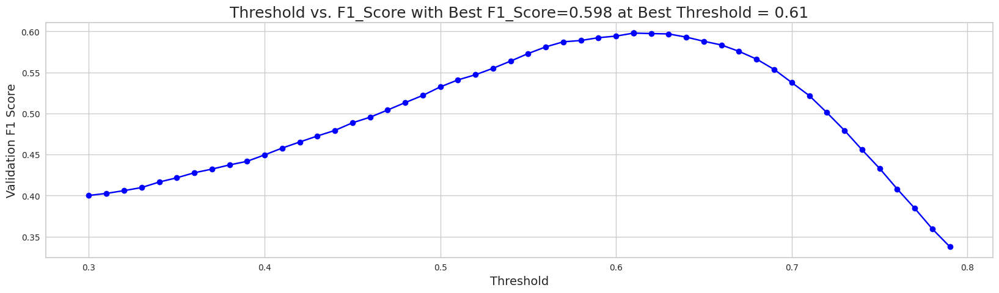

When using optimal threshold = 0.61...
Q0: F1 = 0.5979503812053399
==> Overall F1 = 0.5979503812053399
s
[I 2023-05-23 02:53:20,986] Trial 31 finished with value: 0.5979503812053399 and parameters: {'num_leaves': 83, 'learning_rate': 0.015882416102601257, 'feature_fraction': 0.6542076859882299, 'bagging_fraction': 0.8242485523076859, 'bagging_freq': 2, 'min_child_samples': 81, 'reg_alpha': 2.15494442159171, 'reg_lambda': 1.327346730710569, 'subsample': 0.355162312024626, 'colsample_bytree': 0.38084901137258986, 'min_split_gain': 0.06977754046106993, 'max_depth': 6}. Best is trial 25 with value: 0.6002482343467851.


--------------------------------------------------
question11, with210features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.725514840120084, subsample=0.45999643942393903 will be ignored. Current value: bagging_fraction=0.725514840120084
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.6069660263733377, colsample_bytree=0.5011107705456289 will be ignored. Current value: feature_fraction=0.6069660263733377


,mean
feature,
elapsed_time_diff_std,192.2
elapsed_time_diff_mean,116.0
hover_duration_mean,114.4
elapsed_time_diff_sum,114.0
tunic.historicalsociety.frontdesk_room_fqid_counts,109.8
room_corr_x_diff_std,106.2
room_coor_x_max,100.0
hover_duration_min,95.4
tunic.historicalsociety.stacks_room_fqid_counts,92.2


[[0.55168933 0.44831067]
 [0.44584215 0.55415785]
 [0.26627911 0.73372089]
 ...
 [0.24721955 0.75278045]
 [0.23004328 0.76995672]
 [0.31666112 0.68333888]]


[LightGBM] [Warning] bagging_fraction is set=0.8010181171093814, subsample=0.36000063040867314 will be ignored. Current value: bagging_fraction=0.8010181171093814
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.6476116774739151, colsample_bytree=0.3824163871098777 will be ignored. Current value: feature_fraction=0.6476116774739151


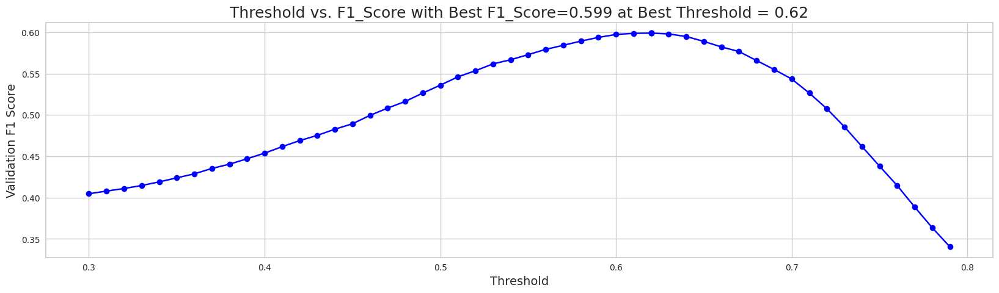

When using optimal threshold = 0.62...
Q0: F1 = 0.5990788810034491
==> Overall F1 = 0.5990788810034491
s
[I 2023-05-23 02:53:35,203] Trial 32 finished with value: 0.5990788810034491 and parameters: {'num_leaves': 86, 'learning_rate': 0.01891294167916637, 'feature_fraction': 0.6207160221064684, 'bagging_fraction': 0.8143000956434385, 'bagging_freq': 2, 'min_child_samples': 74, 'reg_alpha': 1.548712958623924, 'reg_lambda': 0.9412903022986399, 'subsample': 0.34848759932574686, 'colsample_bytree': 0.40904287674025297, 'min_split_gain': 0.18898373507219335, 'max_depth': 4}. Best is trial 25 with value: 0.6002482343467851.


--------------------------------------------------
question11, with210features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.7179643788813138, subsample=0.4502115228894179 will be ignored. Current value: bagging_fraction=0.7179643788813138
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.7960712020784132, colsample_bytree=0.49153164080476075 will be ignored. Current value: feature_fraction=0.7960712020784132


[LightGBM] [Warning] bagging_fraction is set=0.725514840120084, subsample=0.45999643942393903 will be ignored. Current value: bagging_fraction=0.725514840120084
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.6069660263733377, colsample_bytree=0.5011107705456289 will be ignored. Current value: feature_fraction=0.6069660263733377


[LightGBM] [Warning] bagging_fraction is set=0.8166368618554506, subsample=0.37129357233668553 will be ignored. Current value: bagging_fraction=0.8166368618554506
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.6219257056145445, colsample_bytree=0.39977286095720926 will be ignored. Current value: feature_fraction=0.6219257056145445


[LightGBM] [Warning] bagging_fraction is set=0.8010181171093814, subsample=0.36000063040867314 will be ignored. Current value: bagging_fraction=0.8010181171093814
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.6476116774739151, colsample_bytree=0.3824163871098777 will be ignored. Current value: feature_fraction=0.6476116774739151


[LightGBM] [Warning] bagging_fraction is set=0.725514840120084, subsample=0.45999643942393903 will be ignored. Current value: bagging_fraction=0.725514840120084
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.6069660263733377, colsample_bytree=0.5011107705456289 will be ignored. Current value: feature_fraction=0.6069660263733377


[LightGBM] [Warning] bagging_fraction is set=0.8166368618554506, subsample=0.37129357233668553 will be ignored. Current value: bagging_fraction=0.8166368618554506
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.6219257056145445, colsample_bytree=0.39977286095720926 will be ignored. Current value: feature_fraction=0.6219257056145445


[LightGBM] [Warning] bagging_fraction is set=0.7179643788813138, subsample=0.4502115228894179 will be ignored. Current value: bagging_fraction=0.7179643788813138
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.7960712020784132, colsample_bytree=0.49153164080476075 will be ignored. Current value: feature_fraction=0.7960712020784132


,mean
feature,
elapsed_time_diff_std,365.2
room_coor_x_max,299.8
hover_duration_mean,295.6
session_id,282.0
elapsed_time_diff_mean,262.6
hover_duration_max,257.8
room_coor_x_std,247.0
elapsed_time_diff_sum,242.8
room_corr_x_diff_std,234.4


[[0.55996237 0.44003763]
 [0.43609937 0.56390063]
 [0.2674677  0.7325323 ]
 ...
 [0.2380559  0.7619441 ]
 [0.20862502 0.79137498]
 [0.34041794 0.65958206]]


[LightGBM] [Warning] bagging_fraction is set=0.725514840120084, subsample=0.45999643942393903 will be ignored. Current value: bagging_fraction=0.725514840120084
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.6069660263733377, colsample_bytree=0.5011107705456289 will be ignored. Current value: feature_fraction=0.6069660263733377


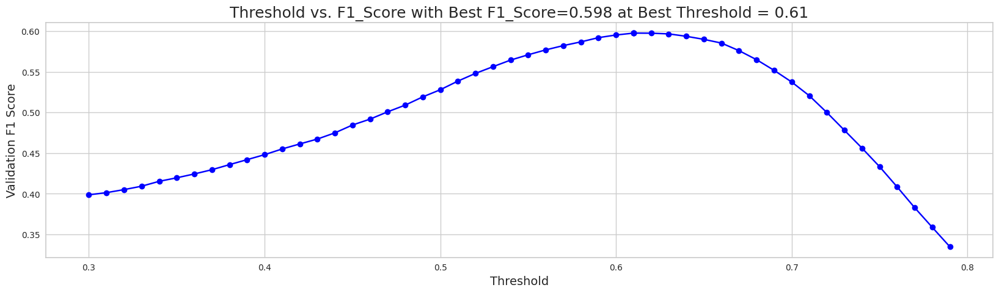

When using optimal threshold = 0.61...
Q0: F1 = 0.5975326034686809
==> Overall F1 = 0.5975326034686809
s
[I 2023-05-23 02:54:26,421] Trial 33 finished with value: 0.5975326034686809 and parameters: {'num_leaves': 90, 'learning_rate': 0.014143427044145016, 'feature_fraction': 0.6476116774739151, 'bagging_fraction': 0.8010181171093814, 'bagging_freq': 3, 'min_child_samples': 76, 'reg_alpha': 2.084374969089397, 'reg_lambda': 0.1987182566851946, 'subsample': 0.36000063040867314, 'colsample_bytree': 0.3824163871098777, 'min_split_gain': 0.20462939711511247, 'max_depth': 7}. Best is trial 25 with value: 0.6002482343467851.


--------------------------------------------------
question11, with210features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.7283122051072553, subsample=0.45294167531781215 will be ignored. Current value: bagging_fraction=0.7283122051072553
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
[LightGBM] [Warning] feature_fraction is set=0.7755190771039652, colsample_bytree=0.506437660471737 will be ignored. Current value: feature_fraction=0.7755190771039652


,mean
feature,
elapsed_time_diff_std,345.6
hover_duration_mean,260.4
session_id,256.2
room_coor_x_max,235.0
elapsed_time_diff_mean,233.6
elapsed_time_diff_sum,220.8
room_coor_x_std,218.4
hover_duration_max,215.6
room_corr_x_diff_std,211.4


[[0.53388371 0.46611629]
 [0.43118977 0.56881023]
 [0.26019067 0.73980933]
 ...
 [0.2399595  0.7600405 ]
 [0.21985124 0.78014876]
 [0.28953106 0.71046894]]


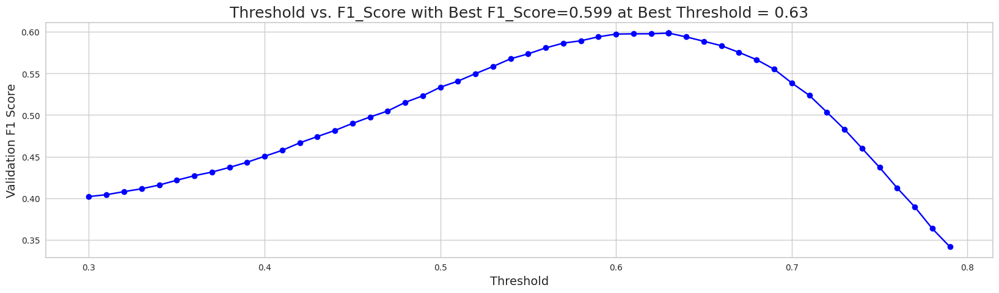

When using optimal threshold = 0.63...
Q0: F1 = 0.59860675714428
==> Overall F1 = 0.59860675714428
s
[I 2023-05-23 02:54:33,607] Trial 34 finished with value: 0.59860675714428 and parameters: {'num_leaves': 91, 'learning_rate': 0.014410206545814895, 'feature_fraction': 0.6219257056145445, 'bagging_fraction': 0.8166368618554506, 'bagging_freq': 3, 'min_child_samples': 75, 'reg_alpha': 1.8252826584330146, 'reg_lambda': 2.1338105361439945, 'subsample': 0.37129357233668553, 'colsample_bytree': 0.39977286095720926, 'min_split_gain': 0.2292672718770818, 'max_depth': 6}. Best is trial 25 with value: 0.6002482343467851.


--------------------------------------------------
question11, with210features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.7294793008081145, subsample=0.45286313191114663 will be ignored. Current value: bagging_fraction=0.7294793008081145
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.768597154655071, colsample_bytree=0.5049548159619077 will be ignored. Current value: feature_fraction=0.768597154655071


[LightGBM] [Warning] bagging_fraction is set=0.725514840120084, subsample=0.45999643942393903 will be ignored. Current value: bagging_fraction=0.725514840120084
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.6069660263733377, colsample_bytree=0.5011107705456289 will be ignored. Current value: feature_fraction=0.6069660263733377


[LightGBM] [Warning] bagging_fraction is set=0.7283122051072553, subsample=0.45294167531781215 will be ignored. Current value: bagging_fraction=0.7283122051072553
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
[LightGBM] [Warning] feature_fraction is set=0.7755190771039652, colsample_bytree=0.506437660471737 will be ignored. Current value: feature_fraction=0.7755190771039652


[LightGBM] [Warning] bagging_fraction is set=0.7179643788813138, subsample=0.4502115228894179 will be ignored. Current value: bagging_fraction=0.7179643788813138
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.7960712020784132, colsample_bytree=0.49153164080476075 will be ignored. Current value: feature_fraction=0.7960712020784132


[LightGBM] [Warning] bagging_fraction is set=0.7294793008081145, subsample=0.45286313191114663 will be ignored. Current value: bagging_fraction=0.7294793008081145
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.768597154655071, colsample_bytree=0.5049548159619077 will be ignored. Current value: feature_fraction=0.768597154655071


,mean
feature,
elapsed_time_diff_std,160.4
hover_duration_mean,99.2
elapsed_time_diff_mean,91.2
tunic.historicalsociety.frontdesk_room_fqid_counts,89.6
elapsed_time_diff_sum,88.8
room_coor_x_max,87.0
room_corr_x_diff_std,86.8
room_coor_y_mean,78.0
room_coor_x_std,77.0


[[0.58260687 0.41739313]
 [0.42569341 0.57430659]
 [0.27341989 0.72658011]
 ...
 [0.24172369 0.75827631]
 [0.22367566 0.77632434]
 [0.30301399 0.69698601]]


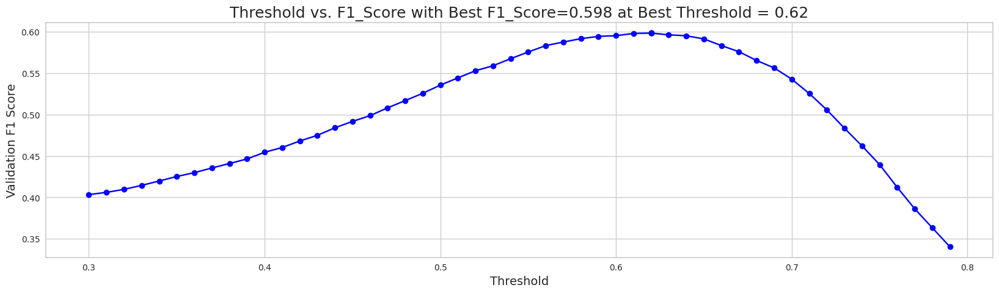

When using optimal threshold = 0.62...
Q0: F1 = 0.5984370725682007
==> Overall F1 = 0.5984370725682007
s
[I 2023-05-23 02:54:56,720] Trial 35 finished with value: 0.5984370725682007 and parameters: {'num_leaves': 90, 'learning_rate': 0.0218130490692602, 'feature_fraction': 0.6069660263733377, 'bagging_fraction': 0.725514840120084, 'bagging_freq': 3, 'min_child_samples': 73, 'reg_alpha': 1.3913952867284263, 'reg_lambda': 2.39521675330823, 'subsample': 0.45999643942393903, 'colsample_bytree': 0.5011107705456289, 'min_split_gain': 0.229916454504809, 'max_depth': 4}. Best is trial 25 with value: 0.6002482343467851.


--------------------------------------------------
question11, with210features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.7420018282616546, subsample=0.5777427390260748 will be ignored. Current value: bagging_fraction=0.7420018282616546
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
[LightGBM] [Warning] feature_fraction is set=0.7734847708842457, colsample_bytree=0.5238839904441164 will be ignored. Current value: feature_fraction=0.7734847708842457


[LightGBM] [Warning] bagging_fraction is set=0.7283122051072553, subsample=0.45294167531781215 will be ignored. Current value: bagging_fraction=0.7283122051072553
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
[LightGBM] [Warning] feature_fraction is set=0.7755190771039652, colsample_bytree=0.506437660471737 will be ignored. Current value: feature_fraction=0.7755190771039652


[LightGBM] [Warning] bagging_fraction is set=0.7294793008081145, subsample=0.45286313191114663 will be ignored. Current value: bagging_fraction=0.7294793008081145
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.768597154655071, colsample_bytree=0.5049548159619077 will be ignored. Current value: feature_fraction=0.768597154655071


[LightGBM] [Warning] bagging_fraction is set=0.7283122051072553, subsample=0.45294167531781215 will be ignored. Current value: bagging_fraction=0.7283122051072553
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
[LightGBM] [Warning] feature_fraction is set=0.7755190771039652, colsample_bytree=0.506437660471737 will be ignored. Current value: feature_fraction=0.7755190771039652


[LightGBM] [Warning] bagging_fraction is set=0.7420018282616546, subsample=0.5777427390260748 will be ignored. Current value: bagging_fraction=0.7420018282616546
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
[LightGBM] [Warning] feature_fraction is set=0.7734847708842457, colsample_bytree=0.5238839904441164 will be ignored. Current value: feature_fraction=0.7734847708842457


[LightGBM] [Warning] bagging_fraction is set=0.7294793008081145, subsample=0.45286313191114663 will be ignored. Current value: bagging_fraction=0.7294793008081145
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.768597154655071, colsample_bytree=0.5049548159619077 will be ignored. Current value: feature_fraction=0.768597154655071


[LightGBM] [Warning] bagging_fraction is set=0.7283122051072553, subsample=0.45294167531781215 will be ignored. Current value: bagging_fraction=0.7283122051072553
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
[LightGBM] [Warning] feature_fraction is set=0.7755190771039652, colsample_bytree=0.506437660471737 will be ignored. Current value: feature_fraction=0.7755190771039652


[LightGBM] [Warning] bagging_fraction is set=0.7179643788813138, subsample=0.4502115228894179 will be ignored. Current value: bagging_fraction=0.7179643788813138
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.7960712020784132, colsample_bytree=0.49153164080476075 will be ignored. Current value: feature_fraction=0.7960712020784132


[LightGBM] [Warning] bagging_fraction is set=0.7294793008081145, subsample=0.45286313191114663 will be ignored. Current value: bagging_fraction=0.7294793008081145
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.768597154655071, colsample_bytree=0.5049548159619077 will be ignored. Current value: feature_fraction=0.768597154655071


,mean
feature,
elapsed_time_diff_std,150.0
tunic.historicalsociety.frontdesk_room_fqid_counts,84.6
elapsed_time_diff_sum,81.2
room_corr_x_diff_std,79.4
elapsed_time_diff_mean,76.8
hover_duration_mean,72.0
hover_duration_min,70.4
room_coor_y_mean,65.4
hover_duration_sum,64.4


[[0.5222661  0.4777339 ]
 [0.45493586 0.54506414]
 [0.25361714 0.74638286]
 ...
 [0.24065712 0.75934288]
 [0.2065891  0.7934109 ]
 [0.30516444 0.69483556]]


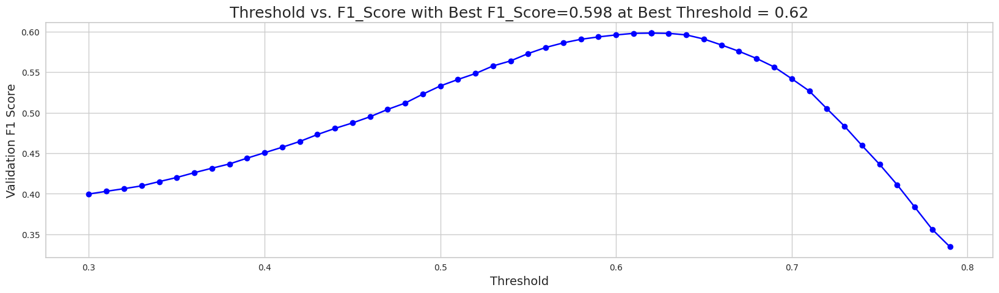

When using optimal threshold = 0.62...
Q0: F1 = 0.5980969225800044
==> Overall F1 = 0.5980969225800044
s
[I 2023-05-23 02:55:49,960] Trial 37 finished with value: 0.5980969225800044 and parameters: {'num_leaves': 65, 'learning_rate': 0.022693049845844287, 'feature_fraction': 0.7755190771039652, 'bagging_fraction': 0.7283122051072553, 'bagging_freq': 5, 'min_child_samples': 91, 'reg_alpha': 3.591669407255937, 'reg_lambda': 2.3204495767606064, 'subsample': 0.45294167531781215, 'colsample_bytree': 0.506437660471737, 'min_split_gain': 0.0676263680570077, 'max_depth': 4}. Best is trial 25 with value: 0.6002482343467851.


--------------------------------------------------
question11, with210features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.6285718330529274, subsample=0.5878906735198174 will be ignored. Current value: bagging_fraction=0.6285718330529274
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7493674831387819, colsample_bytree=0.26076464258583504 will be ignored. Current value: feature_fraction=0.7493674831387819


,mean
feature,
elapsed_time_diff_std,156.2
elapsed_time_diff_mean,94.8
hover_duration_mean,92.4
elapsed_time_diff_sum,86.8
tunic.historicalsociety.frontdesk_room_fqid_counts,86.2
room_corr_x_diff_std,86.2
room_coor_x_max,78.2
hover_duration_min,78.2
hover_duration_max,74.6


[[0.5605041  0.4394959 ]
 [0.43547255 0.56452745]
 [0.25624823 0.74375177]
 ...
 [0.2372863  0.7627137 ]
 [0.22091719 0.77908281]
 [0.32501349 0.67498651]]


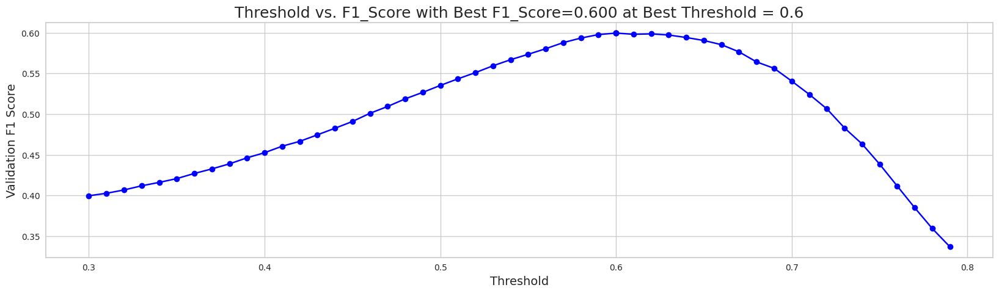

When using optimal threshold = 0.60...
Q0: F1 = 0.5995129331976681
==> Overall F1 = 0.5995129331976681
s
[I 2023-05-23 02:55:55,236] Trial 38 finished with value: 0.5995129331976681 and parameters: {'num_leaves': 64, 'learning_rate': 0.0235585466347893, 'feature_fraction': 0.768597154655071, 'bagging_fraction': 0.7294793008081145, 'bagging_freq': 2, 'min_child_samples': 90, 'reg_alpha': 4.250858661897678, 'reg_lambda': 3.2174056175382915, 'subsample': 0.45286313191114663, 'colsample_bytree': 0.5049548159619077, 'min_split_gain': 0.07020850486120357, 'max_depth': 4}. Best is trial 25 with value: 0.6002482343467851.


--------------------------------------------------
question11, with210features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.5960676612966621, subsample=0.5918791925496224 will be ignored. Current value: bagging_fraction=0.5960676612966621
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.5473868196159335, colsample_bytree=0.26140484830508987 will be ignored. Current value: feature_fraction=0.5473868196159335


[LightGBM] [Warning] bagging_fraction is set=0.7179643788813138, subsample=0.4502115228894179 will be ignored. Current value: bagging_fraction=0.7179643788813138
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.7960712020784132, colsample_bytree=0.49153164080476075 will be ignored. Current value: feature_fraction=0.7960712020784132


[LightGBM] [Warning] bagging_fraction is set=0.5960676612966621, subsample=0.5918791925496224 will be ignored. Current value: bagging_fraction=0.5960676612966621
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.5473868196159335, colsample_bytree=0.26140484830508987 will be ignored. Current value: feature_fraction=0.5473868196159335


[LightGBM] [Warning] bagging_fraction is set=0.6285718330529274, subsample=0.5878906735198174 will be ignored. Current value: bagging_fraction=0.6285718330529274
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7493674831387819, colsample_bytree=0.26076464258583504 will be ignored. Current value: feature_fraction=0.7493674831387819


,mean
feature,
elapsed_time_diff_std,487.0
room_coor_x_max,364.8
hover_duration_mean,361.6
session_id,353.2
hover_duration_max,315.4
elapsed_time_diff_mean,311.0
room_coor_y_max,303.4
elapsed_time_diff_sum,292.4
room_corr_x_diff_std,287.8


[[0.56899542 0.43100458]
 [0.45683639 0.54316361]
 [0.25935198 0.74064802]
 ...
 [0.27406295 0.72593705]
 [0.19956056 0.80043944]
 [0.28930713 0.71069287]]


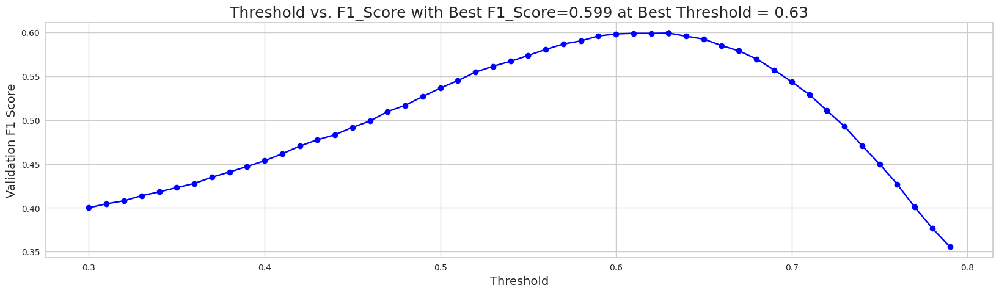

When using optimal threshold = 0.63...
Q0: F1 = 0.5992290066458335
==> Overall F1 = 0.5992290066458335
s
[I 2023-05-23 02:56:42,214] Trial 36 finished with value: 0.5992290066458335 and parameters: {'num_leaves': 65, 'learning_rate': 0.013669878390340975, 'feature_fraction': 0.7960712020784132, 'bagging_fraction': 0.7179643788813138, 'bagging_freq': 3, 'min_child_samples': 92, 'reg_alpha': 3.422824897190199, 'reg_lambda': 2.7323525428757343, 'subsample': 0.4502115228894179, 'colsample_bytree': 0.49153164080476075, 'min_split_gain': 0.21339974347655158, 'max_depth': 7}. Best is trial 25 with value: 0.6002482343467851.


--------------------------------------------------
question11, with210features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.6364626207285587, subsample=0.6351883275733607 will be ignored. Current value: bagging_fraction=0.6364626207285587
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.49603846614633007, colsample_bytree=0.25888973390411385 will be ignored. Current value: feature_fraction=0.49603846614633007


[LightGBM] [Warning] bagging_fraction is set=0.7420018282616546, subsample=0.5777427390260748 will be ignored. Current value: bagging_fraction=0.7420018282616546
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
[LightGBM] [Warning] feature_fraction is set=0.7734847708842457, colsample_bytree=0.5238839904441164 will be ignored. Current value: feature_fraction=0.7734847708842457


[LightGBM] [Warning] bagging_fraction is set=0.6364626207285587, subsample=0.6351883275733607 will be ignored. Current value: bagging_fraction=0.6364626207285587
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.49603846614633007, colsample_bytree=0.25888973390411385 will be ignored. Current value: feature_fraction=0.49603846614633007


[LightGBM] [Warning] bagging_fraction is set=0.5960676612966621, subsample=0.5918791925496224 will be ignored. Current value: bagging_fraction=0.5960676612966621
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.5473868196159335, colsample_bytree=0.26140484830508987 will be ignored. Current value: feature_fraction=0.5473868196159335


[LightGBM] [Warning] bagging_fraction is set=0.6364626207285587, subsample=0.6351883275733607 will be ignored. Current value: bagging_fraction=0.6364626207285587
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.49603846614633007, colsample_bytree=0.25888973390411385 will be ignored. Current value: feature_fraction=0.49603846614633007


[LightGBM] [Warning] bagging_fraction is set=0.6364626207285587, subsample=0.6351883275733607 will be ignored. Current value: bagging_fraction=0.6364626207285587
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.49603846614633007, colsample_bytree=0.25888973390411385 will be ignored. Current value: feature_fraction=0.49603846614633007


[LightGBM] [Warning] bagging_fraction is set=0.6285718330529274, subsample=0.5878906735198174 will be ignored. Current value: bagging_fraction=0.6285718330529274
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7493674831387819, colsample_bytree=0.26076464258583504 will be ignored. Current value: feature_fraction=0.7493674831387819


[LightGBM] [Warning] bagging_fraction is set=0.5960676612966621, subsample=0.5918791925496224 will be ignored. Current value: bagging_fraction=0.5960676612966621
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.5473868196159335, colsample_bytree=0.26140484830508987 will be ignored. Current value: feature_fraction=0.5473868196159335


[LightGBM] [Warning] bagging_fraction is set=0.6364626207285587, subsample=0.6351883275733607 will be ignored. Current value: bagging_fraction=0.6364626207285587
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.49603846614633007, colsample_bytree=0.25888973390411385 will be ignored. Current value: feature_fraction=0.49603846614633007
[LightGBM] [Warning] bagging_fraction is set=0.7420018282616546, subsample=0.5777427390260748 will be ignored. Current value: bagging_fraction=0.7420018282616546
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
[LightGBM] [Warning]

,mean
feature,
elapsed_time_diff_std,110.4
hover_duration_mean,91.8
room_coor_x_max,87.8
elapsed_time_diff_mean,87.4
session_id,80.6
hover_duration_max,79.4
room_coor_x_std,78.6
elapsed_time_diff_sum,71.0
room_coor_x_min,69.6


[[0.58051143 0.41948857]
 [0.49741587 0.50258413]
 [0.22843936 0.77156064]
 ...
 [0.26096235 0.73903765]
 [0.21674404 0.78325596]
 [0.30420704 0.69579296]]


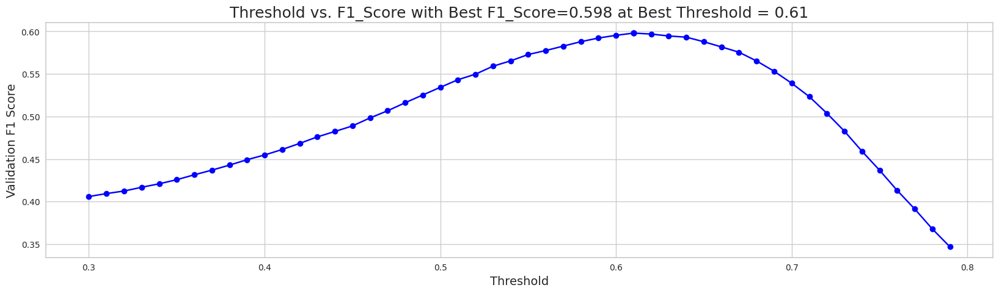

When using optimal threshold = 0.61...
Q0: F1 = 0.5980444363139141
==> Overall F1 = 0.5980444363139141
s
[I 2023-05-23 02:57:54,296] Trial 42 finished with value: 0.5980444363139141 and parameters: {'num_leaves': 79, 'learning_rate': 0.0361335646907175, 'feature_fraction': 0.49603846614633007, 'bagging_fraction': 0.6364626207285587, 'bagging_freq': 1, 'min_child_samples': 59, 'reg_alpha': 0.41024168003593264, 'reg_lambda': 0.263497058318501, 'subsample': 0.6351883275733607, 'colsample_bytree': 0.25888973390411385, 'min_split_gain': 0.11892843160071213, 'max_depth': 6}. Best is trial 25 with value: 0.6002482343467851.


--------------------------------------------------
question11, with210features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.6107146484589749, subsample=0.5752331144241103 will be ignored. Current value: bagging_fraction=0.6107146484589749
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.5540633663403872, colsample_bytree=0.26587810754433056 will be ignored. Current value: feature_fraction=0.5540633663403872


[LightGBM] [Warning] bagging_fraction is set=0.7420018282616546, subsample=0.5777427390260748 will be ignored. Current value: bagging_fraction=0.7420018282616546
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
[LightGBM] [Warning] feature_fraction is set=0.7734847708842457, colsample_bytree=0.5238839904441164 will be ignored. Current value: feature_fraction=0.7734847708842457


[LightGBM] [Warning] bagging_fraction is set=0.5960676612966621, subsample=0.5918791925496224 will be ignored. Current value: bagging_fraction=0.5960676612966621
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.5473868196159335, colsample_bytree=0.26140484830508987 will be ignored. Current value: feature_fraction=0.5473868196159335


[LightGBM] [Warning] bagging_fraction is set=0.6285718330529274, subsample=0.5878906735198174 will be ignored. Current value: bagging_fraction=0.6285718330529274
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7493674831387819, colsample_bytree=0.26076464258583504 will be ignored. Current value: feature_fraction=0.7493674831387819


[LightGBM] [Warning] bagging_fraction is set=0.6107146484589749, subsample=0.5752331144241103 will be ignored. Current value: bagging_fraction=0.6107146484589749
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.5540633663403872, colsample_bytree=0.26587810754433056 will be ignored. Current value: feature_fraction=0.5540633663403872


,mean
feature,
elapsed_time_diff_std,619.8
hover_duration_mean,493.8
session_id,470.6
room_coor_x_max,468.0
hover_duration_sum,410.6
hover_duration_max,393.4
elapsed_time_diff_mean,392.0
elapsed_time_diff_sum,391.8
room_coor_y_std,385.4


[[0.50991621 0.49008379]
 [0.42319761 0.57680239]
 [0.25624653 0.74375347]
 ...
 [0.22838976 0.77161024]
 [0.23111813 0.76888187]
 [0.32222195 0.67777805]]


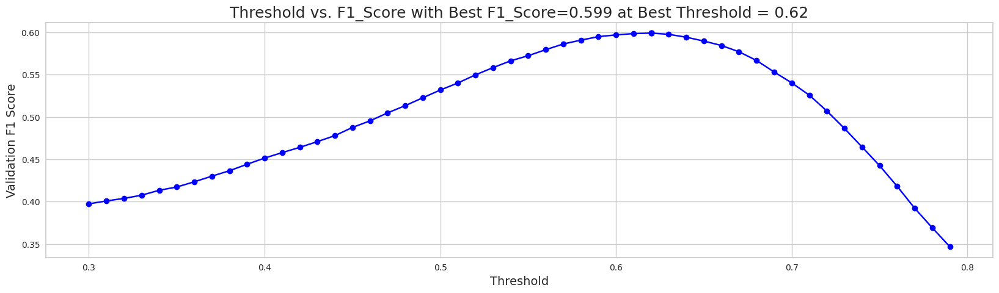

When using optimal threshold = 0.62...
Q0: F1 = 0.5990061708934864
==> Overall F1 = 0.5990061708934864
s
[I 2023-05-23 02:58:51,215] Trial 39 finished with value: 0.5990061708934864 and parameters: {'num_leaves': 78, 'learning_rate': 0.010587385547356097, 'feature_fraction': 0.7734847708842457, 'bagging_fraction': 0.7420018282616546, 'bagging_freq': 5, 'min_child_samples': 92, 'reg_alpha': 4.133375331552746, 'reg_lambda': 3.1878393480503946, 'subsample': 0.5777427390260748, 'colsample_bytree': 0.5238839904441164, 'min_split_gain': 0.08925709616281988, 'max_depth': 7}. Best is trial 25 with value: 0.6002482343467851.


--------------------------------------------------
question11, with210features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.6371318464356676, subsample=0.4018897146029082 will be ignored. Current value: bagging_fraction=0.6371318464356676
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.5606063633665429, colsample_bytree=0.3475619816482104 will be ignored. Current value: feature_fraction=0.5606063633665429


,mean
feature,
elapsed_time_diff_std,488.0
hover_duration_mean,424.4
room_coor_x_max,422.6
session_id,394.2
hover_duration_max,381.6
hover_duration_sum,375.2
elapsed_time_diff_mean,372.8
hover_duration_std,367.0
room_coor_y_max,360.4


[LightGBM] [Warning] bagging_fraction is set=0.6285718330529274, subsample=0.5878906735198174 will be ignored. Current value: bagging_fraction=0.6285718330529274
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7493674831387819, colsample_bytree=0.26076464258583504 will be ignored. Current value: feature_fraction=0.7493674831387819


[[0.565078   0.434922  ]
 [0.43798077 0.56201923]
 [0.24951491 0.75048509]
 ...
 [0.23662863 0.76337137]
 [0.21139624 0.78860376]
 [0.29550914 0.70449086]]


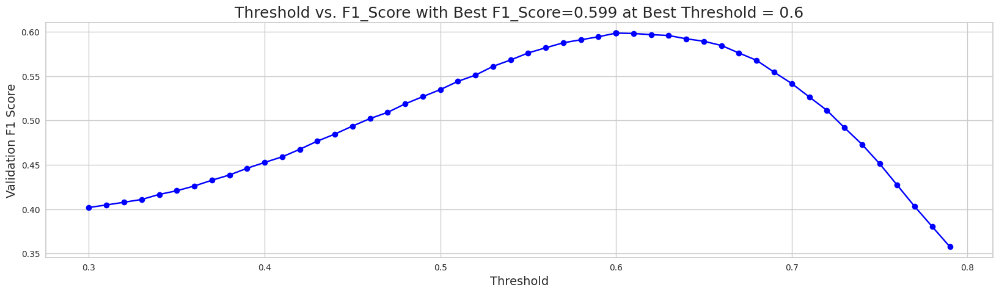

When using optimal threshold = 0.60...
Q0: F1 = 0.598646779505935
==> Overall F1 = 0.598646779505935
s
[I 2023-05-23 02:58:56,632] Trial 41 finished with value: 0.598646779505935 and parameters: {'num_leaves': 51, 'learning_rate': 0.013020136512646403, 'feature_fraction': 0.5473868196159335, 'bagging_fraction': 0.5960676612966621, 'bagging_freq': 1, 'min_child_samples': 59, 'reg_alpha': 4.434047905766981, 'reg_lambda': 0.27043618401701125, 'subsample': 0.5918791925496224, 'colsample_bytree': 0.26140484830508987, 'min_split_gain': 0.1589485373519307, 'max_depth': 7}. Best is trial 25 with value: 0.6002482343467851.


--------------------------------------------------
question11, with210features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.6498935476672248, subsample=0.40941148066323685 will be ignored. Current value: bagging_fraction=0.6498935476672248
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7042468508758154, colsample_bytree=0.3411683692346654 will be ignored. Current value: feature_fraction=0.7042468508758154


[LightGBM] [Warning] bagging_fraction is set=0.6371318464356676, subsample=0.4018897146029082 will be ignored. Current value: bagging_fraction=0.6371318464356676
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.5606063633665429, colsample_bytree=0.3475619816482104 will be ignored. Current value: feature_fraction=0.5606063633665429


[LightGBM] [Warning] bagging_fraction is set=0.6498935476672248, subsample=0.40941148066323685 will be ignored. Current value: bagging_fraction=0.6498935476672248
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7042468508758154, colsample_bytree=0.3411683692346654 will be ignored. Current value: feature_fraction=0.7042468508758154


,mean
feature,
elapsed_time_diff_std,620.2
hover_duration_mean,490.6
session_id,486.6
room_coor_x_max,479.6
hover_duration_max,443.8
room_coor_y_max,415.8
hover_duration_sum,411.4
elapsed_time_diff_sum,395.6
room_coor_x_min,391.4


[[0.57408969 0.42591031]
 [0.44602364 0.55397636]
 [0.24685941 0.75314059]
 ...
 [0.24585654 0.75414346]
 [0.21671867 0.78328133]
 [0.35458297 0.64541703]]


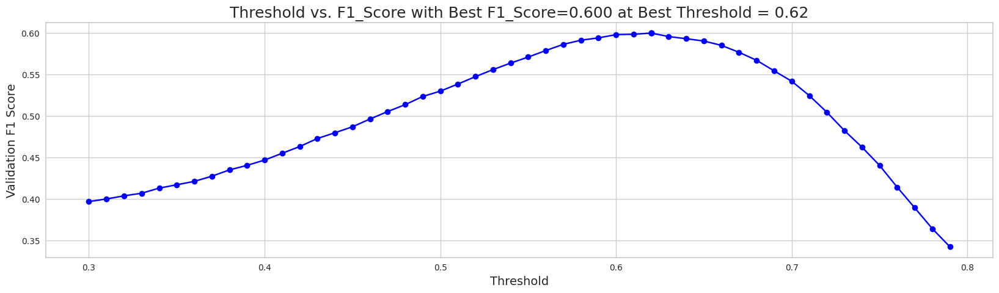

When using optimal threshold = 0.62...
Q0: F1 = 0.5995150577246865
==> Overall F1 = 0.5995150577246865
s
[I 2023-05-23 02:59:27,605] Trial 40 finished with value: 0.5995150577246865 and parameters: {'num_leaves': 77, 'learning_rate': 0.010131976138393178, 'feature_fraction': 0.7493674831387819, 'bagging_fraction': 0.6285718330529274, 'bagging_freq': 2, 'min_child_samples': 59, 'reg_alpha': 4.156309133502052, 'reg_lambda': 0.8925642886907615, 'subsample': 0.5878906735198174, 'colsample_bytree': 0.26076464258583504, 'min_split_gain': 0.12721222471651183, 'max_depth': 7}. Best is trial 25 with value: 0.6002482343467851.


--------------------------------------------------
question11, with210features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.6498538246318969, subsample=0.3990584634841257 will be ignored. Current value: bagging_fraction=0.6498538246318969
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.6945128364927713, colsample_bytree=0.35129313406677426 will be ignored. Current value: feature_fraction=0.6945128364927713


[LightGBM] [Warning] bagging_fraction is set=0.6498935476672248, subsample=0.40941148066323685 will be ignored. Current value: bagging_fraction=0.6498935476672248
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7042468508758154, colsample_bytree=0.3411683692346654 will be ignored. Current value: feature_fraction=0.7042468508758154


[LightGBM] [Warning] bagging_fraction is set=0.6371318464356676, subsample=0.4018897146029082 will be ignored. Current value: bagging_fraction=0.6371318464356676
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.5606063633665429, colsample_bytree=0.3475619816482104 will be ignored. Current value: feature_fraction=0.5606063633665429


[LightGBM] [Warning] bagging_fraction is set=0.6498538246318969, subsample=0.3990584634841257 will be ignored. Current value: bagging_fraction=0.6498538246318969
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.6945128364927713, colsample_bytree=0.35129313406677426 will be ignored. Current value: feature_fraction=0.6945128364927713


[LightGBM] [Warning] bagging_fraction is set=0.6107146484589749, subsample=0.5752331144241103 will be ignored. Current value: bagging_fraction=0.6107146484589749
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.5540633663403872, colsample_bytree=0.26587810754433056 will be ignored. Current value: feature_fraction=0.5540633663403872
[LightGBM] [Warning] bagging_fraction is set=0.6498935476672248, subsample=0.40941148066323685 will be ignored. Current value: bagging_fraction=0.6498935476672248
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] 

[LightGBM] [Warning] bagging_fraction is set=0.6371318464356676, subsample=0.4018897146029082 will be ignored. Current value: bagging_fraction=0.6371318464356676
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.5606063633665429, colsample_bytree=0.3475619816482104 will be ignored. Current value: feature_fraction=0.5606063633665429


[LightGBM] [Warning] bagging_fraction is set=0.6498935476672248, subsample=0.40941148066323685 will be ignored. Current value: bagging_fraction=0.6498935476672248
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7042468508758154, colsample_bytree=0.3411683692346654 will be ignored. Current value: feature_fraction=0.7042468508758154


,mean
feature,
elapsed_time_diff_std,193.4
elapsed_time_diff_sum,115.0
hover_duration_mean,114.4
elapsed_time_diff_mean,107.8
room_corr_x_diff_std,106.6
room_coor_x_max,106.0
tunic.historicalsociety.frontdesk_room_fqid_counts,103.6
room_coor_x_std,96.8
11_level_counts,96.6


[[0.58168558 0.41831442]
 [0.44395841 0.55604159]
 [0.26745044 0.73254956]
 ...
 [0.23738408 0.76261592]
 [0.23376313 0.76623687]
 [0.29472487 0.70527513]]


[LightGBM] [Warning] bagging_fraction is set=0.6498538246318969, subsample=0.3990584634841257 will be ignored. Current value: bagging_fraction=0.6498538246318969
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.6945128364927713, colsample_bytree=0.35129313406677426 will be ignored. Current value: feature_fraction=0.6945128364927713


[LightGBM] [Warning] bagging_fraction is set=0.6371318464356676, subsample=0.4018897146029082 will be ignored. Current value: bagging_fraction=0.6371318464356676
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.5606063633665429, colsample_bytree=0.3475619816482104 will be ignored. Current value: feature_fraction=0.5606063633665429


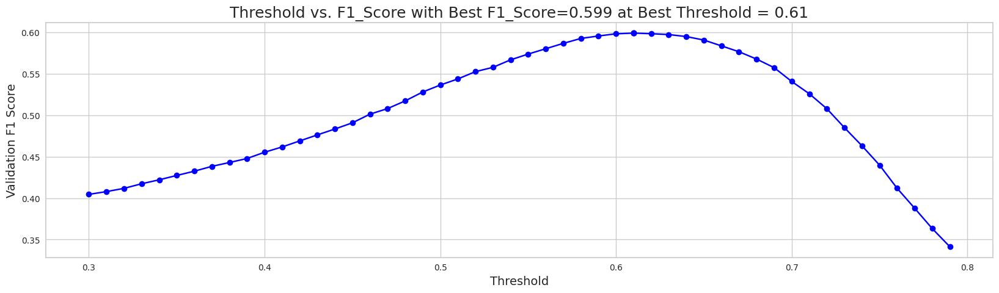

When using optimal threshold = 0.61...
Q0: F1 = 0.5990315359261147
==> Overall F1 = 0.5990315359261147
s
[I 2023-05-23 03:00:19,232] Trial 45 finished with value: 0.5990315359261147 and parameters: {'num_leaves': 82, 'learning_rate': 0.018064094575910402, 'feature_fraction': 0.7042468508758154, 'bagging_fraction': 0.6498935476672248, 'bagging_freq': 2, 'min_child_samples': 48, 'reg_alpha': 1.3541261151309847, 'reg_lambda': 1.1761160914593922, 'subsample': 0.40941148066323685, 'colsample_bytree': 0.3411683692346654, 'min_split_gain': 0.5635842250768887, 'max_depth': 4}. Best is trial 25 with value: 0.6002482343467851.


--------------------------------------------------
question11, with210features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.6810144470086015, subsample=0.3093044472164984 will be ignored. Current value: bagging_fraction=0.6810144470086015
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.5730942018984276, colsample_bytree=0.17218513482735284 will be ignored. Current value: feature_fraction=0.5730942018984276


[LightGBM] [Warning] bagging_fraction is set=0.6107146484589749, subsample=0.5752331144241103 will be ignored. Current value: bagging_fraction=0.6107146484589749
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.5540633663403872, colsample_bytree=0.26587810754433056 will be ignored. Current value: feature_fraction=0.5540633663403872


[LightGBM] [Warning] bagging_fraction is set=0.6498538246318969, subsample=0.3990584634841257 will be ignored. Current value: bagging_fraction=0.6498538246318969
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.6945128364927713, colsample_bytree=0.35129313406677426 will be ignored. Current value: feature_fraction=0.6945128364927713


,mean
feature,
elapsed_time_diff_std,187.4
elapsed_time_diff_sum,124.4
hover_duration_mean,121.0
room_coor_x_max,110.0
room_corr_x_diff_std,108.4
elapsed_time_diff_mean,106.4
room_coor_x_std,105.4
session_id,101.8
room_coor_y_min,99.0


[[0.58820947 0.41179053]
 [0.44372754 0.55627246]
 [0.26040155 0.73959845]
 ...
 [0.24825455 0.75174545]
 [0.21712254 0.78287746]
 [0.32020745 0.67979255]]


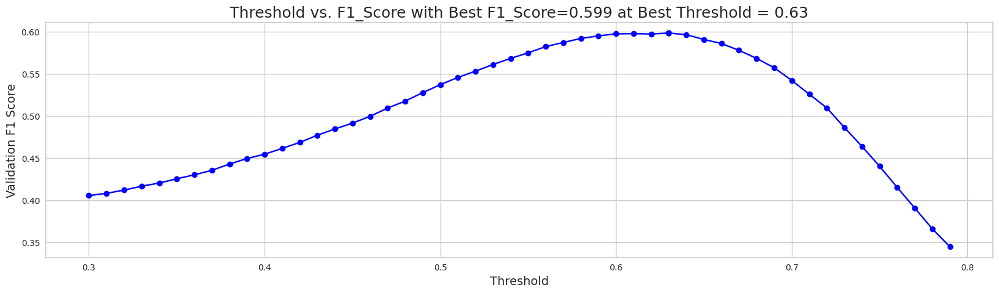

When using optimal threshold = 0.63...
Q0: F1 = 0.5985554906832791
==> Overall F1 = 0.5985554906832791
s
[I 2023-05-23 03:00:39,643] Trial 44 finished with value: 0.5985554906832791 and parameters: {'num_leaves': 82, 'learning_rate': 0.018754977193179208, 'feature_fraction': 0.5606063633665429, 'bagging_fraction': 0.6371318464356676, 'bagging_freq': 2, 'min_child_samples': 45, 'reg_alpha': 1.446842705496852, 'reg_lambda': 1.2649674499106107, 'subsample': 0.4018897146029082, 'colsample_bytree': 0.3475619816482104, 'min_split_gain': 0.5105788028866349, 'max_depth': 4}. Best is trial 25 with value: 0.6002482343467851.


--------------------------------------------------
question11, with210features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.6832959027673291, subsample=0.3077189093653091 will be ignored. Current value: bagging_fraction=0.6832959027673291
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
[LightGBM] [Warning] feature_fraction is set=0.6874835869455634, colsample_bytree=0.4539322100390508 will be ignored. Current value: feature_fraction=0.6874835869455634


[LightGBM] [Warning] bagging_fraction is set=0.6810144470086015, subsample=0.3093044472164984 will be ignored. Current value: bagging_fraction=0.6810144470086015
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.5730942018984276, colsample_bytree=0.17218513482735284 will be ignored. Current value: feature_fraction=0.5730942018984276


[LightGBM] [Warning] bagging_fraction is set=0.6498538246318969, subsample=0.3990584634841257 will be ignored. Current value: bagging_fraction=0.6498538246318969
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.6945128364927713, colsample_bytree=0.35129313406677426 will be ignored. Current value: feature_fraction=0.6945128364927713


[LightGBM] [Warning] bagging_fraction is set=0.6832959027673291, subsample=0.3077189093653091 will be ignored. Current value: bagging_fraction=0.6832959027673291
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
[LightGBM] [Warning] feature_fraction is set=0.6874835869455634, colsample_bytree=0.4539322100390508 will be ignored. Current value: feature_fraction=0.6874835869455634


,mean
feature,
elapsed_time_diff_std,179.4
hover_duration_mean,110.6
elapsed_time_diff_sum,105.4
room_corr_x_diff_std,102.0
room_coor_x_max,101.6
elapsed_time_diff_mean,98.8
tunic.historicalsociety.frontdesk_room_fqid_counts,96.6
room_coor_x_std,90.6
tunic.historicalsociety.stacks_room_fqid_counts,90.2


[[0.58004846 0.41995154]
 [0.45067819 0.54932181]
 [0.26771801 0.73228199]
 ...
 [0.24358778 0.75641222]
 [0.2250472  0.7749528 ]
 [0.3284032  0.6715968 ]]


[LightGBM] [Warning] bagging_fraction is set=0.6107146484589749, subsample=0.5752331144241103 will be ignored. Current value: bagging_fraction=0.6107146484589749
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.5540633663403872, colsample_bytree=0.26587810754433056 will be ignored. Current value: feature_fraction=0.5540633663403872


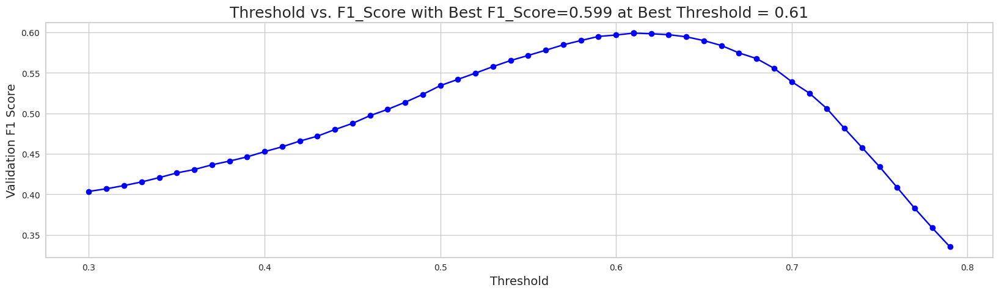

When using optimal threshold = 0.61...
Q0: F1 = 0.5991259917692888
==> Overall F1 = 0.5991259917692888
s
[I 2023-05-23 03:01:08,671] Trial 46 finished with value: 0.5991259917692888 and parameters: {'num_leaves': 83, 'learning_rate': 0.01759047444057196, 'feature_fraction': 0.6945128364927713, 'bagging_fraction': 0.6498538246318969, 'bagging_freq': 2, 'min_child_samples': 48, 'reg_alpha': 1.3039617358984323, 'reg_lambda': 0.6940921501937263, 'subsample': 0.3990584634841257, 'colsample_bytree': 0.35129313406677426, 'min_split_gain': 0.5638292267868179, 'max_depth': 4}. Best is trial 25 with value: 0.6002482343467851.


--------------------------------------------------
question11, with210features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.7678108399269247, subsample=0.5181339138410865 will be ignored. Current value: bagging_fraction=0.7678108399269247
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
[LightGBM] [Warning] feature_fraction is set=0.6823586782589363, colsample_bytree=0.4501546741469614 will be ignored. Current value: feature_fraction=0.6823586782589363


[LightGBM] [Warning] bagging_fraction is set=0.6810144470086015, subsample=0.3093044472164984 will be ignored. Current value: bagging_fraction=0.6810144470086015
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.5730942018984276, colsample_bytree=0.17218513482735284 will be ignored. Current value: feature_fraction=0.5730942018984276


[LightGBM] [Warning] bagging_fraction is set=0.6832959027673291, subsample=0.3077189093653091 will be ignored. Current value: bagging_fraction=0.6832959027673291
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
[LightGBM] [Warning] feature_fraction is set=0.6874835869455634, colsample_bytree=0.4539322100390508 will be ignored. Current value: feature_fraction=0.6874835869455634


[LightGBM] [Warning] bagging_fraction is set=0.6810144470086015, subsample=0.3093044472164984 will be ignored. Current value: bagging_fraction=0.6810144470086015
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.5730942018984276, colsample_bytree=0.17218513482735284 will be ignored. Current value: feature_fraction=0.5730942018984276


[LightGBM] [Warning] bagging_fraction is set=0.7678108399269247, subsample=0.5181339138410865 will be ignored. Current value: bagging_fraction=0.7678108399269247
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
[LightGBM] [Warning] feature_fraction is set=0.6823586782589363, colsample_bytree=0.4501546741469614 will be ignored. Current value: feature_fraction=0.6823586782589363


[LightGBM] [Warning] bagging_fraction is set=0.6832959027673291, subsample=0.3077189093653091 will be ignored. Current value: bagging_fraction=0.6832959027673291
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
[LightGBM] [Warning] feature_fraction is set=0.6874835869455634, colsample_bytree=0.4539322100390508 will be ignored. Current value: feature_fraction=0.6874835869455634


,mean
feature,
elapsed_time_diff_std,500.8
hover_duration_mean,474.8
room_coor_x_max,459.2
hover_duration_max,410.6
session_id,400.2
elapsed_time_diff_mean,390.8
room_coor_x_std,389.8
room_coor_y_max,388.4
hover_duration_sum,386.2


[[0.59408973 0.40591027]
 [0.42860455 0.57139545]
 [0.23753673 0.76246327]
 ...
 [0.24188974 0.75811026]
 [0.21372359 0.78627641]
 [0.31427881 0.68572119]]


[LightGBM] [Warning] bagging_fraction is set=0.6810144470086015, subsample=0.3093044472164984 will be ignored. Current value: bagging_fraction=0.6810144470086015
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.5730942018984276, colsample_bytree=0.17218513482735284 will be ignored. Current value: feature_fraction=0.5730942018984276


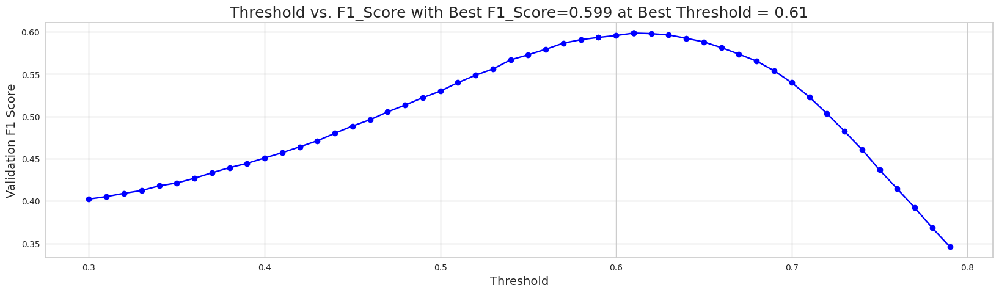

When using optimal threshold = 0.61...
Q0: F1 = 0.5985044524247617
==> Overall F1 = 0.5985044524247617
s
[I 2023-05-23 03:01:48,768] Trial 43 finished with value: 0.5985044524247617 and parameters: {'num_leaves': 77, 'learning_rate': 0.010005753163732816, 'feature_fraction': 0.5540633663403872, 'bagging_fraction': 0.6107146484589749, 'bagging_freq': 2, 'min_child_samples': 70, 'reg_alpha': 0.21272309383904625, 'reg_lambda': 0.8006309251147045, 'subsample': 0.5752331144241103, 'colsample_bytree': 0.26587810754433056, 'min_split_gain': 0.1359468686722618, 'max_depth': 8}. Best is trial 25 with value: 0.6002482343467851.


[LightGBM] [Warning] bagging_fraction is set=0.7678108399269247, subsample=0.5181339138410865 will be ignored. Current value: bagging_fraction=0.7678108399269247
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
[LightGBM] [Warning] feature_fraction is set=0.6823586782589363, colsample_bytree=0.4501546741469614 will be ignored. Current value: feature_fraction=0.6823586782589363


[LightGBM] [Warning] bagging_fraction is set=0.7678108399269247, subsample=0.5181339138410865 will be ignored. Current value: bagging_fraction=0.7678108399269247
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
[LightGBM] [Warning] feature_fraction is set=0.6823586782589363, colsample_bytree=0.4501546741469614 will be ignored. Current value: feature_fraction=0.6823586782589363


,mean
feature,
elapsed_time_diff_std,215.6
hover_duration_mean,158.0
room_coor_x_max,147.4
elapsed_time_diff_sum,135.2
elapsed_time_diff_mean,132.4
hover_duration_sum,131.8
hover_duration_max,130.8
room_coor_x_std,129.8
room_corr_x_diff_std,129.6


[[0.5427299  0.4572701 ]
 [0.45949985 0.54050015]
 [0.26922765 0.73077235]
 ...
 [0.2568948  0.7431052 ]
 [0.22366104 0.77633896]
 [0.32707576 0.67292424]]


[LightGBM] [Warning] bagging_fraction is set=0.6832959027673291, subsample=0.3077189093653091 will be ignored. Current value: bagging_fraction=0.6832959027673291
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
[LightGBM] [Warning] feature_fraction is set=0.6874835869455634, colsample_bytree=0.4539322100390508 will be ignored. Current value: feature_fraction=0.6874835869455634


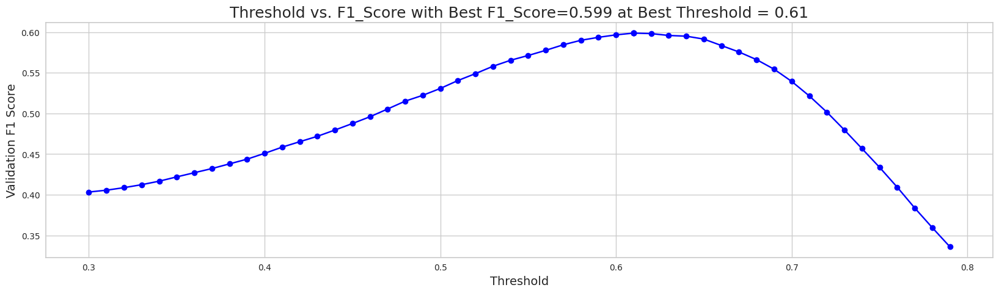

When using optimal threshold = 0.61...
Q0: F1 = 0.5989500716143645
==> Overall F1 = 0.5989500716143645
s
[I 2023-05-23 03:02:01,059] Trial 47 finished with value: 0.5989500716143645 and parameters: {'num_leaves': 87, 'learning_rate': 0.01741198867370248, 'feature_fraction': 0.5730942018984276, 'bagging_fraction': 0.6810144470086015, 'bagging_freq': 2, 'min_child_samples': 69, 'reg_alpha': 1.1727898271995065, 'reg_lambda': 1.6454558067127723, 'subsample': 0.3093044472164984, 'colsample_bytree': 0.17218513482735284, 'min_split_gain': 0.5489364869255009, 'max_depth': 5}. Best is trial 25 with value: 0.6002482343467851.


[LightGBM] [Warning] bagging_fraction is set=0.7678108399269247, subsample=0.5181339138410865 will be ignored. Current value: bagging_fraction=0.7678108399269247
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
[LightGBM] [Warning] feature_fraction is set=0.6823586782589363, colsample_bytree=0.4501546741469614 will be ignored. Current value: feature_fraction=0.6823586782589363


,mean
feature,
elapsed_time_diff_std,200.0
hover_duration_mean,142.0
room_coor_x_max,130.0
session_id,124.6
tunic.historicalsociety.frontdesk_room_fqid_counts,124.4
elapsed_time_diff_mean,122.4
elapsed_time_diff_sum,122.4
room_coor_x_std,118.4
11_level_counts,113.2


[[0.52113022 0.47886978]
 [0.39403796 0.60596204]
 [0.25969157 0.74030843]
 ...
 [0.27648161 0.72351839]
 [0.22214471 0.77785529]
 [0.32627319 0.67372681]]


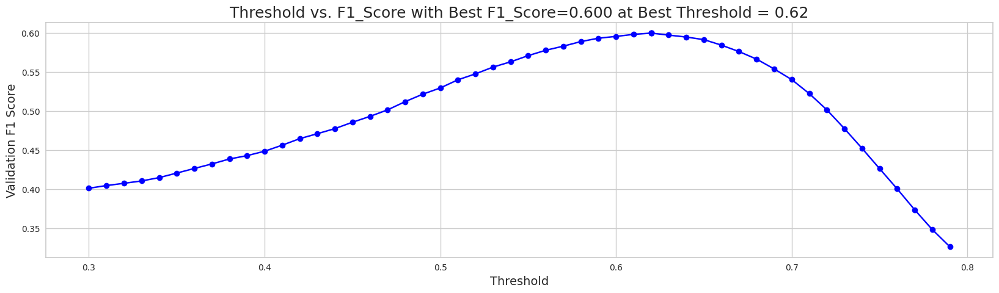

When using optimal threshold = 0.62...
Q0: F1 = 0.5997542158813496
==> Overall F1 = 0.5997542158813496
s
[I 2023-05-23 03:02:10,007] Trial 48 finished with value: 0.5997542158813496 and parameters: {'num_leaves': 86, 'learning_rate': 0.017772322793816252, 'feature_fraction': 0.6874835869455634, 'bagging_fraction': 0.6832959027673291, 'bagging_freq': 4, 'min_child_samples': 31, 'reg_alpha': 0.7459976822455944, 'reg_lambda': 1.6609691417200403, 'subsample': 0.3077189093653091, 'colsample_bytree': 0.4539322100390508, 'min_split_gain': 0.28377265072113694, 'max_depth': 5}. Best is trial 25 with value: 0.6002482343467851.


,mean
feature,
elapsed_time_diff_std,75.0
tunic.historicalsociety.frontdesk_room_fqid_counts,41.2
hover_duration_min,39.4
reader.paper1.next_fqid_counts,38.8
room_corr_x_diff_std,35.8
elapsed_time_diff_mean,35.6
elapsed_time_diff_sum,33.8
reader_fqid_counts,31.0
tunic.historicalsociety.stacks_room_fqid_counts,30.4


[[0.57549175 0.42450825]
 [0.45512855 0.54487145]
 [0.25605502 0.74394498]
 ...
 [0.21476793 0.78523207]
 [0.20430213 0.79569787]
 [0.29056604 0.70943396]]


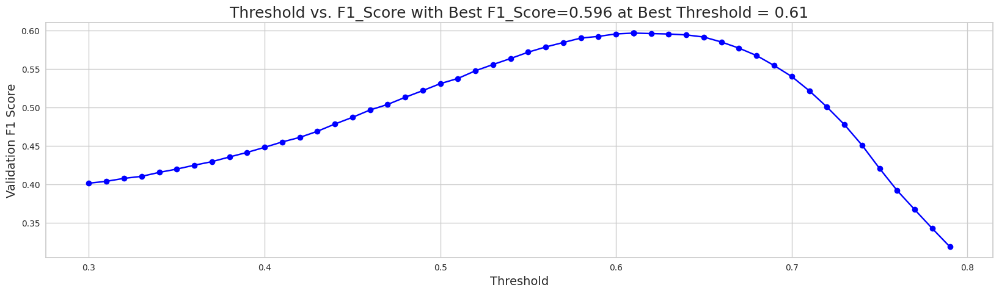

When using optimal threshold = 0.61...
Q0: F1 = 0.5964736509162146
==> Overall F1 = 0.5964736509162146
s
[I 2023-05-23 03:02:12,764] Trial 49 finished with value: 0.5964736509162146 and parameters: {'num_leaves': 87, 'learning_rate': 0.025773904009830064, 'feature_fraction': 0.6823586782589363, 'bagging_fraction': 0.7678108399269247, 'bagging_freq': 4, 'min_child_samples': 30, 'reg_alpha': 0.7692670519835424, 'reg_lambda': 1.6149391337828527, 'subsample': 0.5181339138410865, 'colsample_bytree': 0.4501546741469614, 'min_split_gain': 0.2530224133823424, 'max_depth': 2}. Best is trial 25 with value: 0.6002482343467851.


[I 2023-05-23 03:02:13,529] A new study created in memory with name: no-name-cbee18e4-0999-4ae5-9f21-0ba9651ababa


{'num_leaves': 79, 'learning_rate': 0.010131226858775492, 'feature_fraction': 0.8542613554114186, 'bagging_fraction': 0.4626762186771679, 'bagging_freq': 1, 'min_child_samples': 64, 'reg_alpha': 2.7518731979975826, 'reg_lambda': 0.2587439683961952, 'subsample': 0.5404496045155495, 'colsample_bytree': 0.23398503408445057, 'min_split_gain': 0.3727946236067346, 'max_depth': 6}


  0%|          | 0/50 [00:00<?, ?it/s]

--------------------------------------------------
question12, with210features
--------------------------------------------------
--------------------------------------------------
question12, with210features
--------------------------------------------------
--------------------------------------------------
question12, with210features
--------------------------------------------------
--------------------------------------------------
question12, with210features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.38867246361512264, subsample=0.8772806057854002 will be ignored. Current value: bagging_fraction=0.38867246361512264
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
[LightGBM] [Warning] feature_fraction is set=0.907708568234351, colsample_bytree=0.8947564373602862 will be ignored. Current value: feature_fraction=0.907708568234351


[LightGBM] [Warning] bagging_fraction is set=0.15907368660780863, subsample=0.9255603866520015 will be ignored. Current value: bagging_fraction=0.15907368660780863
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=10, subsample_freq=0 will be ignored. Current value: bagging_freq=10
[LightGBM] [Warning] feature_fraction is set=0.7772692868027096, colsample_bytree=0.8633659680900168 will be ignored. Current value: feature_fraction=0.7772692868027096
[LightGBM] [Warning] bagging_fraction is set=0.22576121470076863, subsample=0.9354869790464984 will be ignored. Current value: bagging_fraction=0.22576121470076863
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
[LightGBM] [Warni

[LightGBM] [Warning] bagging_fraction is set=0.15907368660780863, subsample=0.9255603866520015 will be ignored. Current value: bagging_fraction=0.15907368660780863
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=10, subsample_freq=0 will be ignored. Current value: bagging_freq=10
[LightGBM] [Warning] feature_fraction is set=0.7772692868027096, colsample_bytree=0.8633659680900168 will be ignored. Current value: feature_fraction=0.7772692868027096


[LightGBM] [Warning] bagging_fraction is set=0.38867246361512264, subsample=0.8772806057854002 will be ignored. Current value: bagging_fraction=0.38867246361512264
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
[LightGBM] [Warning] feature_fraction is set=0.907708568234351, colsample_bytree=0.8947564373602862 will be ignored. Current value: feature_fraction=0.907708568234351
[LightGBM] [Warning] bagging_fraction is set=0.25025833585656165, subsample=0.8606324752251795 will be ignored. Current value: bagging_fraction=0.25025833585656165
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] 

[LightGBM] [Warning] bagging_fraction is set=0.15907368660780863, subsample=0.9255603866520015 will be ignored. Current value: bagging_fraction=0.15907368660780863
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=10, subsample_freq=0 will be ignored. Current value: bagging_freq=10
[LightGBM] [Warning] feature_fraction is set=0.7772692868027096, colsample_bytree=0.8633659680900168 will be ignored. Current value: feature_fraction=0.7772692868027096
[LightGBM] [Warning] bagging_fraction is set=0.22576121470076863, subsample=0.9354869790464984 will be ignored. Current value: bagging_fraction=0.22576121470076863
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
[LightGBM] [Warni

[LightGBM] [Warning] bagging_fraction is set=0.25025833585656165, subsample=0.8606324752251795 will be ignored. Current value: bagging_fraction=0.25025833585656165
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7692776291943854, colsample_bytree=0.38855385258986075 will be ignored. Current value: feature_fraction=0.7692776291943854


[LightGBM] [Warning] bagging_fraction is set=0.38867246361512264, subsample=0.8772806057854002 will be ignored. Current value: bagging_fraction=0.38867246361512264
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
[LightGBM] [Warning] feature_fraction is set=0.907708568234351, colsample_bytree=0.8947564373602862 will be ignored. Current value: feature_fraction=0.907708568234351


[LightGBM] [Warning] bagging_fraction is set=0.15907368660780863, subsample=0.9255603866520015 will be ignored. Current value: bagging_fraction=0.15907368660780863
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=10, subsample_freq=0 will be ignored. Current value: bagging_freq=10
[LightGBM] [Warning] feature_fraction is set=0.7772692868027096, colsample_bytree=0.8633659680900168 will be ignored. Current value: feature_fraction=0.7772692868027096


[LightGBM] [Warning] bagging_fraction is set=0.25025833585656165, subsample=0.8606324752251795 will be ignored. Current value: bagging_fraction=0.25025833585656165
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7692776291943854, colsample_bytree=0.38855385258986075 will be ignored. Current value: feature_fraction=0.7692776291943854


[LightGBM] [Warning] bagging_fraction is set=0.22576121470076863, subsample=0.9354869790464984 will be ignored. Current value: bagging_fraction=0.22576121470076863
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
[LightGBM] [Warning] feature_fraction is set=0.12106573332398496, colsample_bytree=0.9489822920317725 will be ignored. Current value: feature_fraction=0.12106573332398496


[LightGBM] [Warning] bagging_fraction is set=0.38867246361512264, subsample=0.8772806057854002 will be ignored. Current value: bagging_fraction=0.38867246361512264
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
[LightGBM] [Warning] feature_fraction is set=0.907708568234351, colsample_bytree=0.8947564373602862 will be ignored. Current value: feature_fraction=0.907708568234351
[LightGBM] [Warning] bagging_fraction is set=0.15907368660780863, subsample=0.9255603866520015 will be ignored. Current value: bagging_fraction=0.15907368660780863
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=10, subsample_freq=0 will be ignored. Current value: bagging_freq=10
[LightGBM] [Warning

[LightGBM] [Warning] bagging_fraction is set=0.25025833585656165, subsample=0.8606324752251795 will be ignored. Current value: bagging_fraction=0.25025833585656165
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7692776291943854, colsample_bytree=0.38855385258986075 will be ignored. Current value: feature_fraction=0.7692776291943854


,mean
feature,
hover_duration_mean,14.0
tunic.historicalsociety.frontdesk_room_fqid_counts,13.8
screen_corr_x_dff_std,8.2
door_block_talk_fqid_counts,7.6
12_level_counts,6.8
gramps_fqid_counts,6.6
tunic.historicalsociety.frontdesk.archivist.foundtheodora_text_fqid_counts,5.8
session_id,5.6
screen_coor_x_sum,5.2


[[0.20818314 0.79181686]
 [0.15200475 0.84799525]
 [0.13592206 0.86407794]
 ...
 [0.10236538 0.89763462]
 [0.07909569 0.92090431]
 [0.13521393 0.86478607]]


[LightGBM] [Warning] bagging_fraction is set=0.22576121470076863, subsample=0.9354869790464984 will be ignored. Current value: bagging_fraction=0.22576121470076863
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
[LightGBM] [Warning] feature_fraction is set=0.12106573332398496, colsample_bytree=0.9489822920317725 will be ignored. Current value: feature_fraction=0.12106573332398496


[LightGBM] [Warning] bagging_fraction is set=0.38867246361512264, subsample=0.8772806057854002 will be ignored. Current value: bagging_fraction=0.38867246361512264
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
[LightGBM] [Warning] feature_fraction is set=0.907708568234351, colsample_bytree=0.8947564373602862 will be ignored. Current value: feature_fraction=0.907708568234351


,mean
feature,
tunic.historicalsociety.frontdesk_room_fqid_counts,15.0
hover_duration_mean,13.2
logbook_fqid_counts,6.6
11_level_counts,6.6
session_number,6.2
reader_fqid_counts,6.2
undefined_name_counts,5.6
tunic.historicalsociety.frontdesk.archivist.foundtheodora_text_fqid_counts,5.6
session_id,5.4


[[0.26950953 0.73049047]
 [0.14644612 0.85355388]
 [0.08968056 0.91031944]
 ...
 [0.10099582 0.89900418]
 [0.06150877 0.93849123]
 [0.1066998  0.8933002 ]]


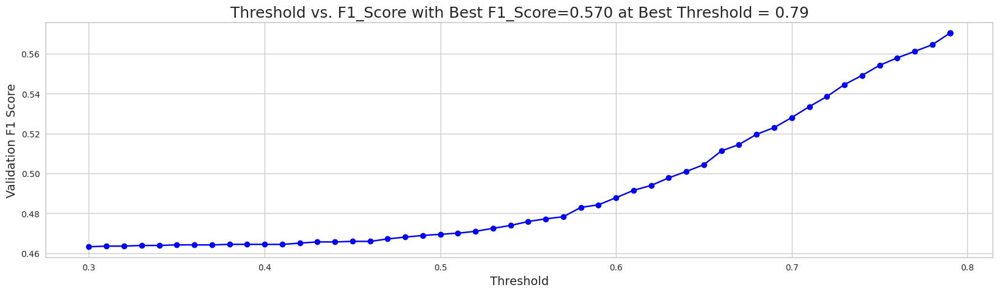

When using optimal threshold = 0.79...
Q0: F1 = 0.5703844739530133
==> Overall F1 = 0.5703844739530133
s
[I 2023-05-23 03:02:33,970] Trial 2 finished with value: 0.5703844739530133 and parameters: {'num_leaves': 89, 'learning_rate': 0.031793361687516376, 'feature_fraction': 0.7772692868027096, 'bagging_fraction': 0.15907368660780863, 'bagging_freq': 10, 'min_child_samples': 8, 'reg_alpha': 0.011756664778171807, 'reg_lambda': 0.46357835071418246, 'subsample': 0.9255603866520015, 'colsample_bytree': 0.8633659680900168, 'min_split_gain': 0.07529469136267657, 'max_depth': 2}. Best is trial 2 with value: 0.5703844739530133.


--------------------------------------------------
question12, with210features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.6927187424419501, subsample=0.29364524750466003 will be ignored. Current value: bagging_fraction=0.6927187424419501
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.4103722286825089, colsample_bytree=0.49684849504560635 will be ignored. Current value: feature_fraction=0.4103722286825089


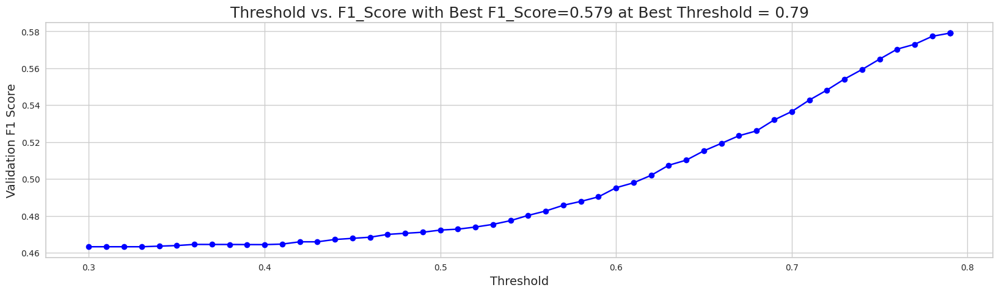

When using optimal threshold = 0.79...
Q0: F1 = 0.5790887648285377
==> Overall F1 = 0.5790887648285377
s
[I 2023-05-23 03:02:37,433] Trial 0 finished with value: 0.5790887648285377 and parameters: {'num_leaves': 48, 'learning_rate': 0.04501302593709449, 'feature_fraction': 0.7692776291943854, 'bagging_fraction': 0.25025833585656165, 'bagging_freq': 2, 'min_child_samples': 57, 'reg_alpha': 0.10267061615959024, 'reg_lambda': 0.044180895454990245, 'subsample': 0.8606324752251795, 'colsample_bytree': 0.38855385258986075, 'min_split_gain': 0.061732836920053075, 'max_depth': 2}. Best is trial 0 with value: 0.5790887648285377.


--------------------------------------------------
question12, with210features
--------------------------------------------------
[LightGBM] [Warning] bagging_fraction is set=0.22576121470076863, subsample=0.9354869790464984 will be ignored. Current value: bagging_fraction=0.22576121470076863
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
[LightGBM] [Warning] feature_fraction is set=0.12106573332398496, colsample_bytree=0.9489822920317725 will be ignored. Current value: feature_fraction=0.12106573332398496


,mean
feature,
hover_duration_mean,11.8
session_id,9.8
tunic.historicalsociety.frontdesk_room_fqid_counts,9.2
room_coor_x_max,8.2
9_level_counts,8.2
room_coor_x_min,8.0
room_coor_y_min,7.4
screen_coor_y_max,7.2
room_coor_y_std,7.0


[[0.23540951 0.76459049]
 [0.11260174 0.88739826]
 [0.08297773 0.91702227]
 ...
 [0.07156844 0.92843156]
 [0.04607871 0.95392129]
 [0.11474611 0.88525389]]
[LightGBM] [Warning] bagging_fraction is set=0.31036688421778985, subsample=0.1255496042250655 will be ignored. Current value: bagging_fraction=0.31036688421778985
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
[LightGBM] [Warning] feature_fraction is set=0.6649555627972322, colsample_bytree=0.2977396210409169 will be ignored. Current value: feature_fraction=0.6649555627972322


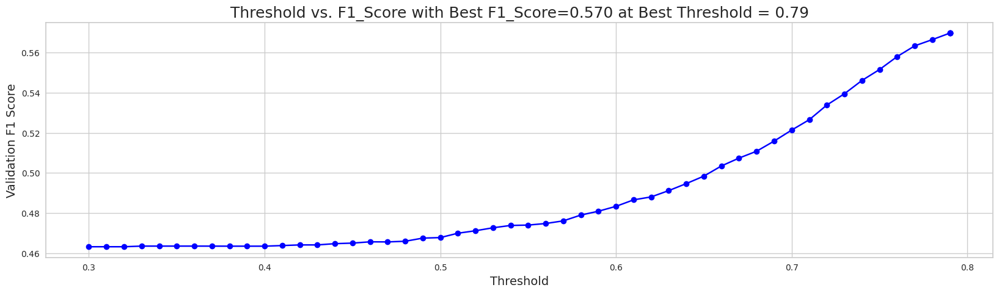

When using optimal threshold = 0.79...
Q0: F1 = 0.5697216831601322
==> Overall F1 = 0.5697216831601322
s
[I 2023-05-23 03:02:42,156] Trial 1 finished with value: 0.5697216831601322 and parameters: {'num_leaves': 77, 'learning_rate': 0.09734416930491425, 'feature_fraction': 0.907708568234351, 'bagging_fraction': 0.38867246361512264, 'bagging_freq': 4, 'min_child_samples': 77, 'reg_alpha': 0.0025961645918476913, 'reg_lambda': 0.1701309740451011, 'subsample': 0.8772806057854002, 'colsample_bytree': 0.8947564373602862, 'min_split_gain': 0.01891905956433325, 'max_depth': 6}. Best is trial 0 with value: 0.5790887648285377.


--------------------------------------------------
question12, with210features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.6479039133535712, subsample=0.9819229622149921 will be ignored. Current value: bagging_fraction=0.6479039133535712
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.7230826477846601, colsample_bytree=0.9991437564728267 will be ignored. Current value: feature_fraction=0.7230826477846601


,mean
feature,
room_coor_y_min,20.4
tunic.historicalsociety.frontdesk_room_fqid_counts,19.8
hover_duration_mean,17.8
room_corr_y_diff_sum,17.6
elapsed_time_diff_std,16.8
11_level_counts,16.2
room_coor_y_sum,16.2
room_corr_x_diff_mean,15.8
hover_duration_min,15.6


[[0.23456705 0.76543295]
 [0.13714766 0.86285234]
 [0.10353515 0.89646485]
 ...
 [0.07625699 0.92374301]
 [0.05432308 0.94567692]
 [0.09003211 0.90996789]]


[LightGBM] [Warning] bagging_fraction is set=0.31036688421778985, subsample=0.1255496042250655 will be ignored. Current value: bagging_fraction=0.31036688421778985
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
[LightGBM] [Warning] feature_fraction is set=0.6649555627972322, colsample_bytree=0.2977396210409169 will be ignored. Current value: feature_fraction=0.6649555627972322


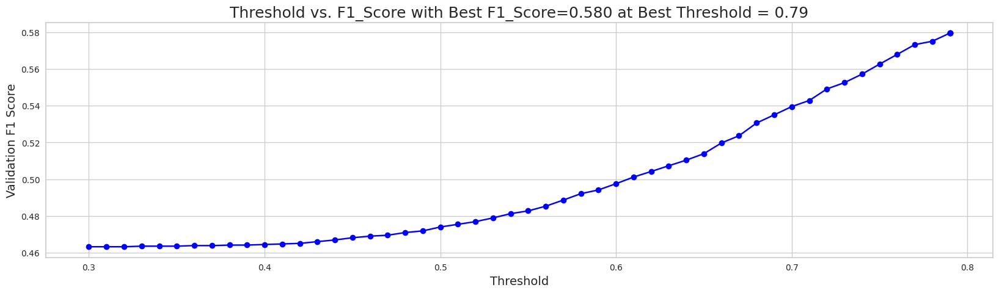

When using optimal threshold = 0.79...
Q0: F1 = 0.579647997162489
==> Overall F1 = 0.579647997162489
s
[I 2023-05-23 03:02:48,039] Trial 3 finished with value: 0.579647997162489 and parameters: {'num_leaves': 96, 'learning_rate': 0.03965423301319766, 'feature_fraction': 0.12106573332398496, 'bagging_fraction': 0.22576121470076863, 'bagging_freq': 5, 'min_child_samples': 43, 'reg_alpha': 0.010666156508217698, 'reg_lambda': 0.015345193868397701, 'subsample': 0.9354869790464984, 'colsample_bytree': 0.9489822920317725, 'min_split_gain': 0.219147043114108, 'max_depth': 3}. Best is trial 3 with value: 0.579647997162489.


--------------------------------------------------
question12, with210features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.3087767484959274, subsample=0.14005250355131615 will be ignored. Current value: bagging_fraction=0.3087767484959274
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.6098034373299341, colsample_bytree=0.2661548122895837 will be ignored. Current value: feature_fraction=0.6098034373299341


[LightGBM] [Warning] bagging_fraction is set=0.6927187424419501, subsample=0.29364524750466003 will be ignored. Current value: bagging_fraction=0.6927187424419501
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.4103722286825089, colsample_bytree=0.49684849504560635 will be ignored. Current value: feature_fraction=0.4103722286825089


[LightGBM] [Warning] bagging_fraction is set=0.31036688421778985, subsample=0.1255496042250655 will be ignored. Current value: bagging_fraction=0.31036688421778985
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
[LightGBM] [Warning] feature_fraction is set=0.6649555627972322, colsample_bytree=0.2977396210409169 will be ignored. Current value: feature_fraction=0.6649555627972322


[LightGBM] [Warning] bagging_fraction is set=0.6479039133535712, subsample=0.9819229622149921 will be ignored. Current value: bagging_fraction=0.6479039133535712
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.7230826477846601, colsample_bytree=0.9991437564728267 will be ignored. Current value: feature_fraction=0.7230826477846601


[LightGBM] [Warning] bagging_fraction is set=0.31036688421778985, subsample=0.1255496042250655 will be ignored. Current value: bagging_fraction=0.31036688421778985
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
[LightGBM] [Warning] feature_fraction is set=0.6649555627972322, colsample_bytree=0.2977396210409169 will be ignored. Current value: feature_fraction=0.6649555627972322


[LightGBM] [Warning] bagging_fraction is set=0.3087767484959274, subsample=0.14005250355131615 will be ignored. Current value: bagging_fraction=0.3087767484959274
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.6098034373299341, colsample_bytree=0.2661548122895837 will be ignored. Current value: feature_fraction=0.6098034373299341


[LightGBM] [Warning] bagging_fraction is set=0.6927187424419501, subsample=0.29364524750466003 will be ignored. Current value: bagging_fraction=0.6927187424419501
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.4103722286825089, colsample_bytree=0.49684849504560635 will be ignored. Current value: feature_fraction=0.4103722286825089


[LightGBM] [Warning] bagging_fraction is set=0.6479039133535712, subsample=0.9819229622149921 will be ignored. Current value: bagging_fraction=0.6479039133535712
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.7230826477846601, colsample_bytree=0.9991437564728267 will be ignored. Current value: feature_fraction=0.7230826477846601


[LightGBM] [Warning] bagging_fraction is set=0.31036688421778985, subsample=0.1255496042250655 will be ignored. Current value: bagging_fraction=0.31036688421778985
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
[LightGBM] [Warning] feature_fraction is set=0.6649555627972322, colsample_bytree=0.2977396210409169 will be ignored. Current value: feature_fraction=0.6649555627972322


[LightGBM] [Warning] bagging_fraction is set=0.6927187424419501, subsample=0.29364524750466003 will be ignored. Current value: bagging_fraction=0.6927187424419501
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.4103722286825089, colsample_bytree=0.49684849504560635 will be ignored. Current value: feature_fraction=0.4103722286825089


[LightGBM] [Warning] bagging_fraction is set=0.6479039133535712, subsample=0.9819229622149921 will be ignored. Current value: bagging_fraction=0.6479039133535712
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.7230826477846601, colsample_bytree=0.9991437564728267 will be ignored. Current value: feature_fraction=0.7230826477846601
[LightGBM] [Warning] bagging_fraction is set=0.3087767484959274, subsample=0.14005250355131615 will be ignored. Current value: bagging_fraction=0.3087767484959274
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] f

,mean
feature,
hover_duration_mean,37.2
tunic.historicalsociety.frontdesk_room_fqid_counts,28.6
session_id,26.4
room_coor_x_min,22.0
room_coor_x_max,21.8
elapsed_time_diff_std,21.2
hover_duration_max,20.4
room_coor_y_max,19.8
room_coor_y_min,19.6


[[0.28001354 0.71998646]
 [0.13437228 0.86562772]
 [0.09218177 0.90781823]
 ...
 [0.08346297 0.91653703]
 [0.07013546 0.92986454]
 [0.10647621 0.89352379]]


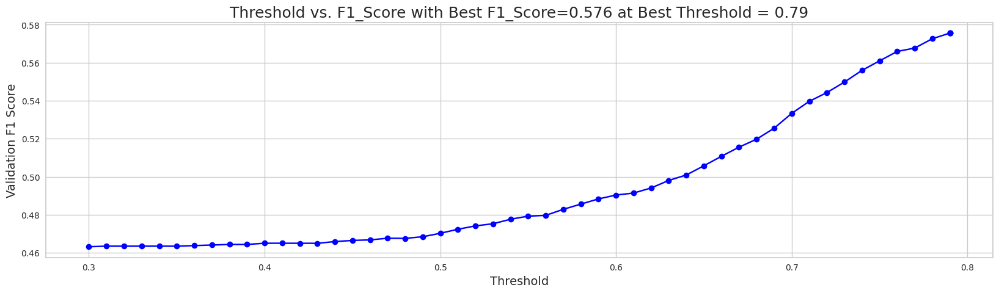

When using optimal threshold = 0.79...
Q0: F1 = 0.575562589956846
==> Overall F1 = 0.575562589956846
s
[I 2023-05-23 03:03:13,390] Trial 5 finished with value: 0.575562589956846 and parameters: {'num_leaves': 85, 'learning_rate': 0.03688289649010306, 'feature_fraction': 0.6649555627972322, 'bagging_fraction': 0.31036688421778985, 'bagging_freq': 6, 'min_child_samples': 34, 'reg_alpha': 0.055084315872079376, 'reg_lambda': 0.041462454275883596, 'subsample': 0.1255496042250655, 'colsample_bytree': 0.2977396210409169, 'min_split_gain': 0.6023112955794557, 'max_depth': 5}. Best is trial 3 with value: 0.579647997162489.


--------------------------------------------------
question12, with210features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.20096641235038482, subsample=0.11854598294663049 will be ignored. Current value: bagging_fraction=0.20096641235038482
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
[LightGBM] [Warning] feature_fraction is set=0.7586743688996288, colsample_bytree=0.3710962248750761 will be ignored. Current value: feature_fraction=0.7586743688996288


[LightGBM] [Warning] bagging_fraction is set=0.6479039133535712, subsample=0.9819229622149921 will be ignored. Current value: bagging_fraction=0.6479039133535712
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.7230826477846601, colsample_bytree=0.9991437564728267 will be ignored. Current value: feature_fraction=0.7230826477846601


[LightGBM] [Warning] bagging_fraction is set=0.20096641235038482, subsample=0.11854598294663049 will be ignored. Current value: bagging_fraction=0.20096641235038482
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
[LightGBM] [Warning] feature_fraction is set=0.7586743688996288, colsample_bytree=0.3710962248750761 will be ignored. Current value: feature_fraction=0.7586743688996288


[LightGBM] [Warning] bagging_fraction is set=0.3087767484959274, subsample=0.14005250355131615 will be ignored. Current value: bagging_fraction=0.3087767484959274
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.6098034373299341, colsample_bytree=0.2661548122895837 will be ignored. Current value: feature_fraction=0.6098034373299341


[LightGBM] [Warning] bagging_fraction is set=0.20096641235038482, subsample=0.11854598294663049 will be ignored. Current value: bagging_fraction=0.20096641235038482
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
[LightGBM] [Warning] feature_fraction is set=0.7586743688996288, colsample_bytree=0.3710962248750761 will be ignored. Current value: feature_fraction=0.7586743688996288


[LightGBM] [Warning] bagging_fraction is set=0.6927187424419501, subsample=0.29364524750466003 will be ignored. Current value: bagging_fraction=0.6927187424419501
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.4103722286825089, colsample_bytree=0.49684849504560635 will be ignored. Current value: feature_fraction=0.4103722286825089


[LightGBM] [Warning] bagging_fraction is set=0.20096641235038482, subsample=0.11854598294663049 will be ignored. Current value: bagging_fraction=0.20096641235038482
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
[LightGBM] [Warning] feature_fraction is set=0.7586743688996288, colsample_bytree=0.3710962248750761 will be ignored. Current value: feature_fraction=0.7586743688996288


[LightGBM] [Warning] bagging_fraction is set=0.20096641235038482, subsample=0.11854598294663049 will be ignored. Current value: bagging_fraction=0.20096641235038482
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
[LightGBM] [Warning] feature_fraction is set=0.7586743688996288, colsample_bytree=0.3710962248750761 will be ignored. Current value: feature_fraction=0.7586743688996288


,mean
feature,
hover_duration_mean,33.0
tunic.historicalsociety.frontdesk_room_fqid_counts,32.6
elapsed_time_diff_std,21.8
tunic.historicalsociety.frontdesk.archivist.foundtheodora_text_fqid_counts,21.0
door_block_talk_fqid_counts,20.4
room_coor_x_min,20.2
reader_fqid_counts,19.4
logbook_fqid_counts,18.0
11_level_counts,17.6


[[0.24430372 0.75569628]
 [0.14001168 0.85998832]
 [0.09258368 0.90741632]
 ...
 [0.08880718 0.91119282]
 [0.06232519 0.93767481]
 [0.09208939 0.90791061]]


,mean
feature,
tunic.historicalsociety.frontdesk_room_fqid_counts,2.0
hover_duration_std,1.6
hover_duration_mean,1.4
screen_coor_x_min,1.2
5_level_counts,1.2
map_click_event_name_counts,1.0
room_coor_y_min,1.0
businesscards.card_bingo.bingo_fqid_counts,1.0
screen_coor_y_min,0.8


[[0.24108817 0.75891183]
 [0.09559368 0.90440632]
 [0.11103374 0.88896626]
 ...
 [0.07548739 0.92451261]
 [0.04046718 0.95953282]
 [0.066926   0.933074  ]]


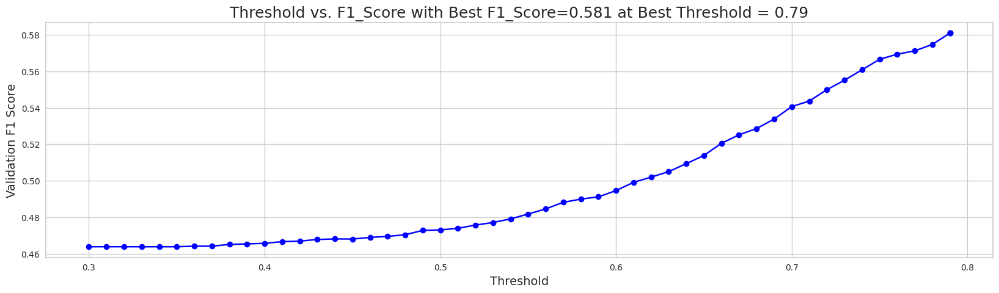

When using optimal threshold = 0.79...
[LightGBM] [Warning] bagging_fraction is set=0.3087767484959274, subsample=0.14005250355131615 will be ignored. Current value: bagging_fraction=0.3087767484959274
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.6098034373299341, colsample_bytree=0.2661548122895837 will be ignored. Current value: feature_fraction=0.6098034373299341
Q0: F1 = 0.5809660038727589
==> Overall F1 = 0.5809660038727589
s
[I 2023-05-23 03:03:26,840] Trial 6 finished with value: 0.5809660038727589 and parameters: {'num_leaves': 53, 'learning_rate': 0.029099503473151832, 'feature_fraction': 0.7230826477846601, 'bagging_fraction': 0.6479039133535712, 'bagging_freq': 3, 'min_child_samples': 77, 'reg_alpha': 0.11415178114733979, 'reg_lambda':

--------------------------------------------------
question12, with210features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.8471966045619522, subsample=0.5974057985921536 will be ignored. Current value: bagging_fraction=0.8471966045619522
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
[LightGBM] [Warning] feature_fraction is set=0.13894186886204285, colsample_bytree=0.29313834598429755 will be ignored. Current value: feature_fraction=0.13894186886204285


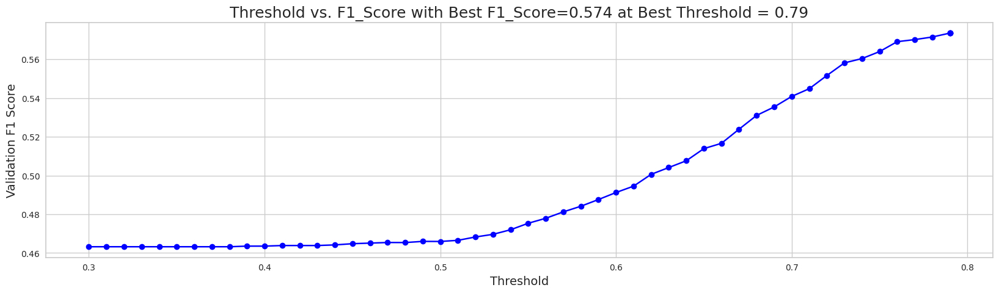

When using optimal threshold = 0.79...
Q0: F1 = 0.5736113698277472
==> Overall F1 = 0.5736113698277472
s
[I 2023-05-23 03:03:29,821] Trial 8 finished with value: 0.5736113698277472 and parameters: {'num_leaves': 34, 'learning_rate': 0.43867123824405657, 'feature_fraction': 0.7586743688996288, 'bagging_fraction': 0.20096641235038482, 'bagging_freq': 4, 'min_child_samples': 60, 'reg_alpha': 9.671486084315692, 'reg_lambda': 0.0031581800354823, 'subsample': 0.11854598294663049, 'colsample_bytree': 0.3710962248750761, 'min_split_gain': 0.16877227305219242, 'max_depth': 1}. Best is trial 6 with value: 0.5809660038727589.


--------------------------------------------------
question12, with210features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.8071244300665164, subsample=0.2038511355073806 will be ignored. Current value: bagging_fraction=0.8071244300665164
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
[LightGBM] [Warning] feature_fraction is set=0.11276178146391436, colsample_bytree=0.13662645575376567 will be ignored. Current value: feature_fraction=0.11276178146391436


,mean
feature,
tunic.historicalsociety.frontdesk_room_fqid_counts,18.4
hover_duration_mean,16.6
tunic.historicalsociety.frontdesk.archivist.foundtheodora_text_fqid_counts,12.8
elapsed_time_diff_std,12.0
map_click_event_name_counts,11.4
door_block_talk_fqid_counts,11.2
5_level_counts,10.4
logbook_fqid_counts,9.8
tunic.historicalsociety.closet_dirty.door_block_talk_text_fqid_counts,9.6


[[0.24673487 0.75326513]
 [0.12563875 0.87436125]
 [0.09490271 0.90509729]
 ...
 [0.09396026 0.90603974]
 [0.06070548 0.93929452]
 [0.09617336 0.90382664]]


[LightGBM] [Warning] bagging_fraction is set=0.8071244300665164, subsample=0.2038511355073806 will be ignored. Current value: bagging_fraction=0.8071244300665164
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
[LightGBM] [Warning] feature_fraction is set=0.11276178146391436, colsample_bytree=0.13662645575376567 will be ignored. Current value: feature_fraction=0.11276178146391436


,mean
feature,
hover_duration_mean,26.8
room_coor_x_max,26.8
screen_coor_x_std,24.6
session_id,24.2
room_coor_x_min,23.4
room_coor_y_min,22.2
hover_duration_sum,22.0
screen_coor_y_min,21.0
screen_coor_y_mean,20.6


[[0.28625921 0.71374079]
 [0.08697252 0.91302748]
 [0.1092143  0.8907857 ]
 ...
 [0.08006426 0.91993574]
 [0.07209053 0.92790947]
 [0.14079818 0.85920182]]


[LightGBM] [Warning] bagging_fraction is set=0.8471966045619522, subsample=0.5974057985921536 will be ignored. Current value: bagging_fraction=0.8471966045619522
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
[LightGBM] [Warning] feature_fraction is set=0.13894186886204285, colsample_bytree=0.29313834598429755 will be ignored. Current value: feature_fraction=0.13894186886204285


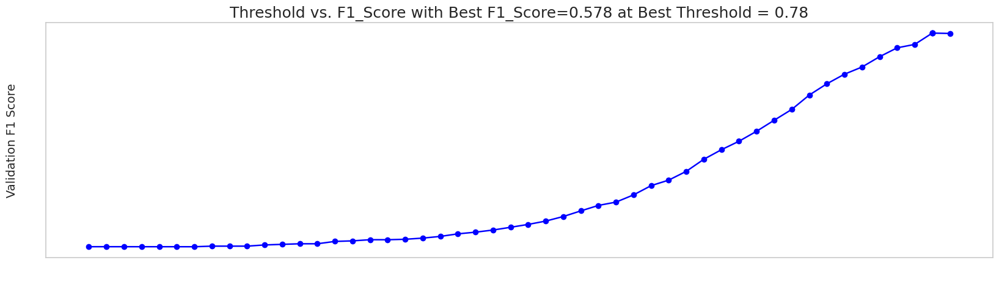

When using optimal threshold = 0.78...
Q0: F1 = 0.5775504595945543
==> Overall F1 = 0.5775504595945543
s
[I 2023-05-23 03:03:36,648] Trial 4 finished with value: 0.5775504595945543 and parameters: {'num_leaves': 42, 'learning_rate': 0.04405058040530739, 'feature_fraction': 0.4103722286825089, 'bagging_fraction': 0.6927187424419501, 'bagging_freq': 1, 'min_child_samples': 56, 'reg_alpha': 0.013299762956504412, 'reg_lambda': 3.371382476500353, 'subsample': 0.29364524750466003, 'colsample_bytree': 0.49684849504560635, 'min_split_gain': 0.20329366850339842, 'max_depth': 1}. Best is trial 6 with value: 0.5809660038727589.


--------------------------------------------------
question12, with210features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.8071244300665164, subsample=0.2038511355073806 will be ignored. Current value: bagging_fraction=0.8071244300665164
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
[LightGBM] [Warning] feature_fraction is set=0.11276178146391436, colsample_bytree=0.13662645575376567 will be ignored. Current value: feature_fraction=0.11276178146391436


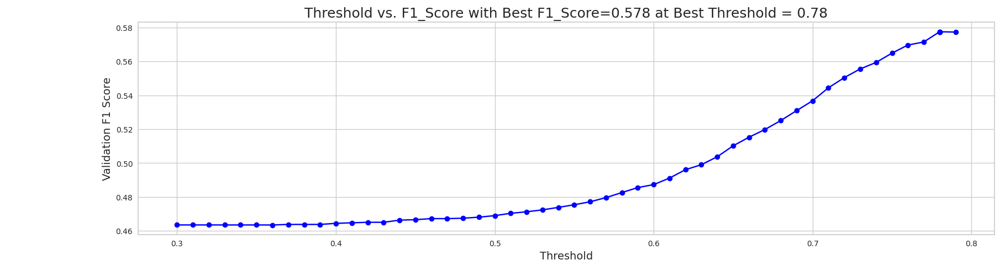

[LightGBM] [Warning] bagging_fraction is set=0.27882083826686327, subsample=0.24803871223492055 will be ignored. Current value: bagging_fraction=0.27882083826686327
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=10, subsample_freq=0 will be ignored. Current value: bagging_freq=10
[LightGBM] [Warning] feature_fraction is set=0.8935217592352098, colsample_bytree=0.7608763364585198 will be ignored. Current value: feature_fraction=0.8935217592352098


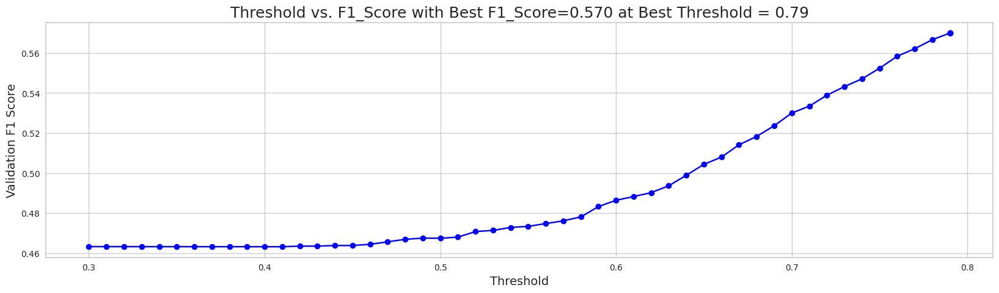

When using optimal threshold = 0.79...
Q0: F1 = 0.5699859439080396
==> Overall F1 = 0.5699859439080396
s
[I 2023-05-23 03:03:38,724] Trial 7 finished with value: 0.5699859439080396 and parameters: {'num_leaves': 56, 'learning_rate': 0.09013755984956442, 'feature_fraction': 0.6098034373299341, 'bagging_fraction': 0.3087767484959274, 'bagging_freq': 3, 'min_child_samples': 20, 'reg_alpha': 3.0412860425903427, 'reg_lambda': 0.026662039679834194, 'subsample': 0.14005250355131615, 'colsample_bytree': 0.2661548122895837, 'min_split_gain': 0.017198454531086704, 'max_depth': 8}. Best is trial 6 with value: 0.5809660038727589.


--------------------------------------------------
question12, with210features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.7504814574824449, subsample=0.9863612666538295 will be ignored. Current value: bagging_fraction=0.7504814574824449
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=10, subsample_freq=0 will be ignored. Current value: bagging_freq=10
[LightGBM] [Warning] feature_fraction is set=0.11241076206551887, colsample_bytree=0.6376279184819732 will be ignored. Current value: feature_fraction=0.11241076206551887


[LightGBM] [Warning] bagging_fraction is set=0.8071244300665164, subsample=0.2038511355073806 will be ignored. Current value: bagging_fraction=0.8071244300665164
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
[LightGBM] [Warning] feature_fraction is set=0.11276178146391436, colsample_bytree=0.13662645575376567 will be ignored. Current value: feature_fraction=0.11276178146391436


[LightGBM] [Warning] bagging_fraction is set=0.27882083826686327, subsample=0.24803871223492055 will be ignored. Current value: bagging_fraction=0.27882083826686327
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=10, subsample_freq=0 will be ignored. Current value: bagging_freq=10
[LightGBM] [Warning] feature_fraction is set=0.8935217592352098, colsample_bytree=0.7608763364585198 will be ignored. Current value: feature_fraction=0.8935217592352098


[LightGBM] [Warning] bagging_fraction is set=0.8071244300665164, subsample=0.2038511355073806 will be ignored. Current value: bagging_fraction=0.8071244300665164
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
[LightGBM] [Warning] feature_fraction is set=0.11276178146391436, colsample_bytree=0.13662645575376567 will be ignored. Current value: feature_fraction=0.11276178146391436


[LightGBM] [Warning] bagging_fraction is set=0.8471966045619522, subsample=0.5974057985921536 will be ignored. Current value: bagging_fraction=0.8471966045619522
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
[LightGBM] [Warning] feature_fraction is set=0.13894186886204285, colsample_bytree=0.29313834598429755 will be ignored. Current value: feature_fraction=0.13894186886204285


,mean
feature,
session_number,3.4
room_coor_y_min,2.8
archivist_fqid_counts,2.2
tunic.historicalsociety.frontdesk.archivist.foundtheodora_text_fqid_counts,1.8
tunic.historicalsociety.closet_dirty.door_block_talk_text_fqid_counts,1.4
tunic.drycleaner.frontdesk_room_fqid_counts,1.4
journals.pic_2.next_fqid_counts,1.4
hover_duration_max,1.2
11_level_counts,1.2


[[0.19570824 0.80429176]
 [0.17012373 0.82987627]
 [0.06941978 0.93058022]
 ...
 [0.11048214 0.88951786]
 [0.0615834  0.9384166 ]
 [0.09075033 0.90924967]]


[LightGBM] [Warning] bagging_fraction is set=0.27882083826686327, subsample=0.24803871223492055 will be ignored. Current value: bagging_fraction=0.27882083826686327
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=10, subsample_freq=0 will be ignored. Current value: bagging_freq=10
[LightGBM] [Warning] feature_fraction is set=0.8935217592352098, colsample_bytree=0.7608763364585198 will be ignored. Current value: feature_fraction=0.8935217592352098


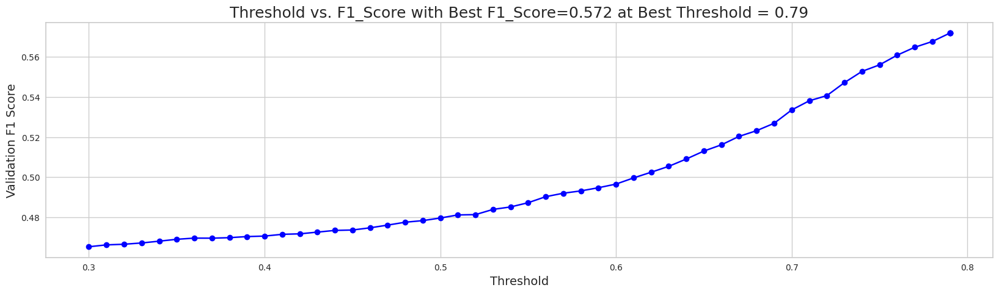

When using optimal threshold = 0.79...
Q0: F1 = 0.5717596310215075
==> Overall F1 = 0.5717596310215075
s
[I 2023-05-23 03:03:48,914] Trial 10 finished with value: 0.5717596310215075 and parameters: {'num_leaves': 48, 'learning_rate': 0.44018227849909425, 'feature_fraction': 0.11276178146391436, 'bagging_fraction': 0.8071244300665164, 'bagging_freq': 4, 'min_child_samples': 54, 'reg_alpha': 0.0046816202101976605, 'reg_lambda': 0.040128118391278514, 'subsample': 0.2038511355073806, 'colsample_bytree': 0.13662645575376567, 'min_split_gain': 0.7591314099750622, 'max_depth': 3}. Best is trial 6 with value: 0.5809660038727589.


--------------------------------------------------
question12, with210features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.9769429785211522, subsample=0.7169011626058102 will be ignored. Current value: bagging_fraction=0.9769429785211522
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=7, subsample_freq=0 will be ignored. Current value: bagging_freq=7
[LightGBM] [Warning] feature_fraction is set=0.9577789655219621, colsample_bytree=0.7380322441715111 will be ignored. Current value: feature_fraction=0.9577789655219621


[LightGBM] [Warning] bagging_fraction is set=0.27882083826686327, subsample=0.24803871223492055 will be ignored. Current value: bagging_fraction=0.27882083826686327
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=10, subsample_freq=0 will be ignored. Current value: bagging_freq=10
[LightGBM] [Warning] feature_fraction is set=0.8935217592352098, colsample_bytree=0.7608763364585198 will be ignored. Current value: feature_fraction=0.8935217592352098
[LightGBM] [Warning] bagging_fraction is set=0.8471966045619522, subsample=0.5974057985921536 will be ignored. Current value: bagging_fraction=0.8471966045619522
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
[LightGBM] [Warnin

[LightGBM] [Warning] bagging_fraction is set=0.27882083826686327, subsample=0.24803871223492055 will be ignored. Current value: bagging_fraction=0.27882083826686327
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=10, subsample_freq=0 will be ignored. Current value: bagging_freq=10
[LightGBM] [Warning] feature_fraction is set=0.8935217592352098, colsample_bytree=0.7608763364585198 will be ignored. Current value: feature_fraction=0.8935217592352098


[LightGBM] [Warning] bagging_fraction is set=0.7504814574824449, subsample=0.9863612666538295 will be ignored. Current value: bagging_fraction=0.7504814574824449
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=10, subsample_freq=0 will be ignored. Current value: bagging_freq=10
[LightGBM] [Warning] feature_fraction is set=0.11241076206551887, colsample_bytree=0.6376279184819732 will be ignored. Current value: feature_fraction=0.11241076206551887


,mean
feature,
hover_duration_mean,10.4
tunic.historicalsociety.frontdesk_room_fqid_counts,6.8
session_id,6.6
5_level_counts,6.2
9_level_counts,5.8
room_coor_x_min,5.4
6_level_counts,5.2
hover_duration_sum,4.6
elapsed_time_diff_mean,4.6


[[0.12516245 0.87483755]
 [0.15353296 0.84646704]
 [0.1013095  0.8986905 ]
 ...
 [0.06440834 0.93559166]
 [0.08246894 0.91753106]
 [0.1403586  0.8596414 ]]
[LightGBM] [Warning] bagging_fraction is set=0.8471966045619522, subsample=0.5974057985921536 will be ignored. Current value: bagging_fraction=0.8471966045619522
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
[LightGBM] [Warning] feature_fraction is set=0.13894186886204285, colsample_bytree=0.29313834598429755 will be ignored. Current value: feature_fraction=0.13894186886204285


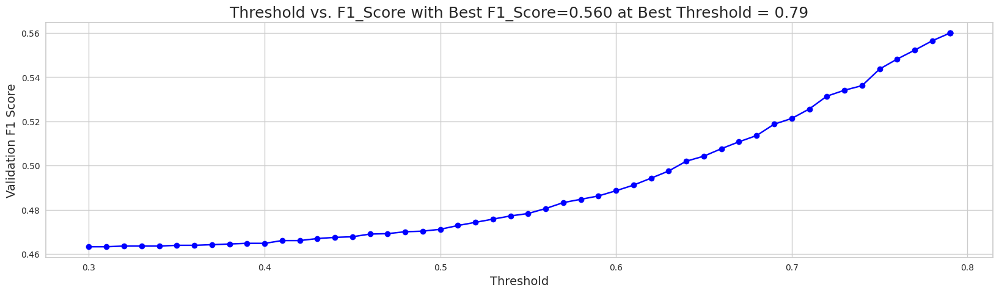

When using optimal threshold = 0.79...
Q0: F1 = 0.5599704018707677
==> Overall F1 = 0.5599704018707677
s
[I 2023-05-23 03:04:03,082] Trial 11 finished with value: 0.5599704018707677 and parameters: {'num_leaves': 95, 'learning_rate': 0.1364096446070555, 'feature_fraction': 0.8935217592352098, 'bagging_fraction': 0.27882083826686327, 'bagging_freq': 10, 'min_child_samples': 40, 'reg_alpha': 0.01911799713234668, 'reg_lambda': 0.021716799984304206, 'subsample': 0.24803871223492055, 'colsample_bytree': 0.7608763364585198, 'min_split_gain': 0.026062655535910535, 'max_depth': 6}. Best is trial 6 with value: 0.5809660038727589.


--------------------------------------------------
question12, with210features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.5289626984749244, subsample=0.9951261501521614 will be ignored. Current value: bagging_fraction=0.5289626984749244
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=7, subsample_freq=0 will be ignored. Current value: bagging_freq=7
[LightGBM] [Warning] feature_fraction is set=0.438082767788075, colsample_bytree=0.9840847257176201 will be ignored. Current value: feature_fraction=0.438082767788075


,mean
feature,
hover_duration_mean,47.4
room_coor_y_mean,41.0
tunic.drycleaner.frontdesk_room_fqid_counts,35.2
tunic.humanecology.frontdesk_room_fqid_counts,33.8
room_coor_y_min,30.2
screen_coor_x_sum,28.8
session_id,28.2
room_corr_y_diff_sum,27.2
room_coor_y_max,24.2


[[0.28420932 0.71579068]
 [0.10892028 0.89107972]
 [0.10150101 0.89849899]
 ...
 [0.06366282 0.93633718]
 [0.0532336  0.9467664 ]
 [0.11118579 0.88881421]]


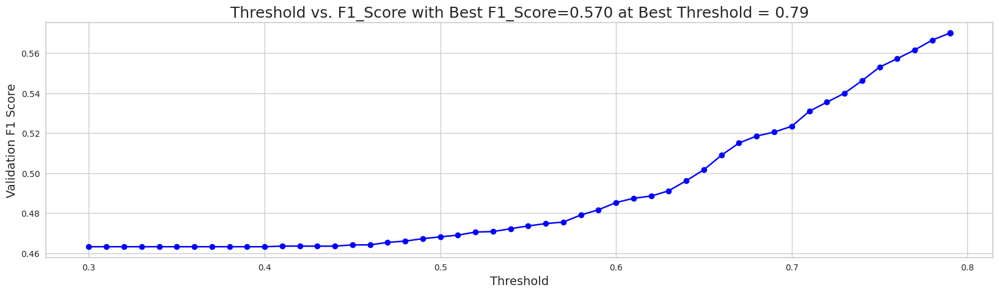

When using optimal threshold = 0.79...
Q0: F1 = 0.5700156499399762
==> Overall F1 = 0.5700156499399762
s
[I 2023-05-23 03:04:09,678] Trial 9 finished with value: 0.5700156499399762 and parameters: {'num_leaves': 73, 'learning_rate': 0.12981558660906567, 'feature_fraction': 0.13894186886204285, 'bagging_fraction': 0.8471966045619522, 'bagging_freq': 5, 'min_child_samples': 29, 'reg_alpha': 2.7462443222320365, 'reg_lambda': 0.193814825914697, 'subsample': 0.5974057985921536, 'colsample_bytree': 0.29313834598429755, 'min_split_gain': 0.17491000978661655, 'max_depth': 8}. Best is trial 6 with value: 0.5809660038727589.


--------------------------------------------------
question12, with210features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.5201242273129808, subsample=0.9902007652628788 will be ignored. Current value: bagging_fraction=0.5201242273129808
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=7, subsample_freq=0 will be ignored. Current value: bagging_freq=7
[LightGBM] [Warning] feature_fraction is set=0.45060868943321347, colsample_bytree=0.9860168072234853 will be ignored. Current value: feature_fraction=0.45060868943321347


[LightGBM] [Warning] bagging_fraction is set=0.7504814574824449, subsample=0.9863612666538295 will be ignored. Current value: bagging_fraction=0.7504814574824449
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=10, subsample_freq=0 will be ignored. Current value: bagging_freq=10
[LightGBM] [Warning] feature_fraction is set=0.11241076206551887, colsample_bytree=0.6376279184819732 will be ignored. Current value: feature_fraction=0.11241076206551887


[LightGBM] [Warning] bagging_fraction is set=0.9769429785211522, subsample=0.7169011626058102 will be ignored. Current value: bagging_fraction=0.9769429785211522
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=7, subsample_freq=0 will be ignored. Current value: bagging_freq=7
[LightGBM] [Warning] feature_fraction is set=0.9577789655219621, colsample_bytree=0.7380322441715111 will be ignored. Current value: feature_fraction=0.9577789655219621


[LightGBM] [Warning] bagging_fraction is set=0.7504814574824449, subsample=0.9863612666538295 will be ignored. Current value: bagging_fraction=0.7504814574824449
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=10, subsample_freq=0 will be ignored. Current value: bagging_freq=10
[LightGBM] [Warning] feature_fraction is set=0.11241076206551887, colsample_bytree=0.6376279184819732 will be ignored. Current value: feature_fraction=0.11241076206551887


[LightGBM] [Warning] bagging_fraction is set=0.5289626984749244, subsample=0.9951261501521614 will be ignored. Current value: bagging_fraction=0.5289626984749244
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=7, subsample_freq=0 will be ignored. Current value: bagging_freq=7
[LightGBM] [Warning] feature_fraction is set=0.438082767788075, colsample_bytree=0.9840847257176201 will be ignored. Current value: feature_fraction=0.438082767788075


[LightGBM] [Warning] bagging_fraction is set=0.9769429785211522, subsample=0.7169011626058102 will be ignored. Current value: bagging_fraction=0.9769429785211522
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=7, subsample_freq=0 will be ignored. Current value: bagging_freq=7
[LightGBM] [Warning] feature_fraction is set=0.9577789655219621, colsample_bytree=0.7380322441715111 will be ignored. Current value: feature_fraction=0.9577789655219621
[LightGBM] [Warning] bagging_fraction is set=0.5201242273129808, subsample=0.9902007652628788 will be ignored. Current value: bagging_fraction=0.5201242273129808
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=7, subsample_freq=0 will be ignored. Current value: bagging_freq=7
[LightGBM] [Warning] fe

[LightGBM] [Warning] bagging_fraction is set=0.7504814574824449, subsample=0.9863612666538295 will be ignored. Current value: bagging_fraction=0.7504814574824449
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=10, subsample_freq=0 will be ignored. Current value: bagging_freq=10
[LightGBM] [Warning] feature_fraction is set=0.11241076206551887, colsample_bytree=0.6376279184819732 will be ignored. Current value: feature_fraction=0.11241076206551887


[LightGBM] [Warning] bagging_fraction is set=0.5201242273129808, subsample=0.9902007652628788 will be ignored. Current value: bagging_fraction=0.5201242273129808
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=7, subsample_freq=0 will be ignored. Current value: bagging_freq=7
[LightGBM] [Warning] feature_fraction is set=0.45060868943321347, colsample_bytree=0.9860168072234853 will be ignored. Current value: feature_fraction=0.45060868943321347
[LightGBM] [Warning] bagging_fraction is set=0.5289626984749244, subsample=0.9951261501521614 will be ignored. Current value: bagging_fraction=0.5289626984749244
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=7, subsample_freq=0 will be ignored. Current value: bagging_freq=7
[LightGBM] [Warning] 

[LightGBM] [Warning] bagging_fraction is set=0.9769429785211522, subsample=0.7169011626058102 will be ignored. Current value: bagging_fraction=0.9769429785211522
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=7, subsample_freq=0 will be ignored. Current value: bagging_freq=7
[LightGBM] [Warning] feature_fraction is set=0.9577789655219621, colsample_bytree=0.7380322441715111 will be ignored. Current value: feature_fraction=0.9577789655219621


,mean
feature,
tunic.historicalsociety.frontdesk_room_fqid_counts,119.6
hover_duration_mean,114.6
room_coor_y_min,96.2
elapsed_time_diff_std,88.6
hover_duration_std,70.0
screen_coor_y_min,69.8
hover_duration_min,68.6
room_coor_x_min,66.6
tunic.historicalsociety.frontdesk.archivist.foundtheodora_text_fqid_counts,61.4


[[0.24477361 0.75522639]
 [0.12959043 0.87040957]
 [0.10210568 0.89789432]
 ...
 [0.09077134 0.90922866]
 [0.05384413 0.94615587]
 [0.10734318 0.89265682]]


[LightGBM] [Warning] bagging_fraction is set=0.5289626984749244, subsample=0.9951261501521614 will be ignored. Current value: bagging_fraction=0.5289626984749244
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=7, subsample_freq=0 will be ignored. Current value: bagging_freq=7
[LightGBM] [Warning] feature_fraction is set=0.438082767788075, colsample_bytree=0.9840847257176201 will be ignored. Current value: feature_fraction=0.438082767788075


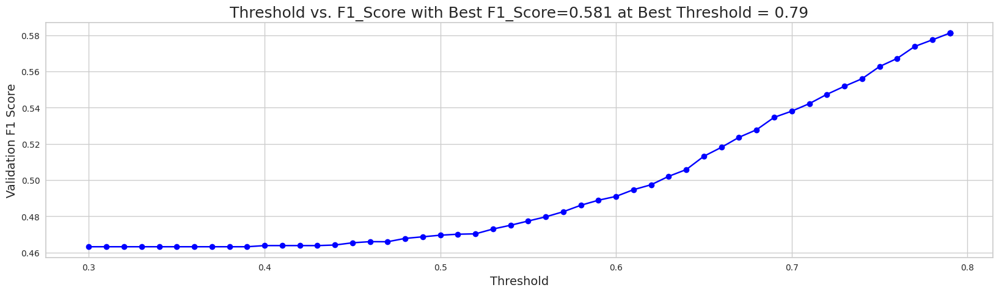

When using optimal threshold = 0.79...
Q0: F1 = 0.5812078939337055
==> Overall F1 = 0.5812078939337055
s
[I 2023-05-23 03:05:05,831] Trial 12 finished with value: 0.5812078939337055 and parameters: {'num_leaves': 23, 'learning_rate': 0.010707512641387, 'feature_fraction': 0.11241076206551887, 'bagging_fraction': 0.7504814574824449, 'bagging_freq': 10, 'min_child_samples': 23, 'reg_alpha': 3.032380297095442, 'reg_lambda': 2.474215699536763, 'subsample': 0.9863612666538295, 'colsample_bytree': 0.6376279184819732, 'min_split_gain': 0.0015096298369925937, 'max_depth': 3}. Best is trial 12 with value: 0.5812078939337055.


--------------------------------------------------
question12, with210features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.5846034741754211, subsample=0.9983219700155902 will be ignored. Current value: bagging_fraction=0.5846034741754211
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=8, subsample_freq=0 will be ignored. Current value: bagging_freq=8
[LightGBM] [Warning] feature_fraction is set=0.44421927859817345, colsample_bytree=0.7036232164091075 will be ignored. Current value: feature_fraction=0.44421927859817345


[LightGBM] [Warning] bagging_fraction is set=0.5201242273129808, subsample=0.9902007652628788 will be ignored. Current value: bagging_fraction=0.5201242273129808
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=7, subsample_freq=0 will be ignored. Current value: bagging_freq=7
[LightGBM] [Warning] feature_fraction is set=0.45060868943321347, colsample_bytree=0.9860168072234853 will be ignored. Current value: feature_fraction=0.45060868943321347


[LightGBM] [Warning] bagging_fraction is set=0.9769429785211522, subsample=0.7169011626058102 will be ignored. Current value: bagging_fraction=0.9769429785211522
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=7, subsample_freq=0 will be ignored. Current value: bagging_freq=7
[LightGBM] [Warning] feature_fraction is set=0.9577789655219621, colsample_bytree=0.7380322441715111 will be ignored. Current value: feature_fraction=0.9577789655219621


[LightGBM] [Warning] bagging_fraction is set=0.5289626984749244, subsample=0.9951261501521614 will be ignored. Current value: bagging_fraction=0.5289626984749244
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=7, subsample_freq=0 will be ignored. Current value: bagging_freq=7
[LightGBM] [Warning] feature_fraction is set=0.438082767788075, colsample_bytree=0.9840847257176201 will be ignored. Current value: feature_fraction=0.438082767788075


[LightGBM] [Warning] bagging_fraction is set=0.5846034741754211, subsample=0.9983219700155902 will be ignored. Current value: bagging_fraction=0.5846034741754211
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=8, subsample_freq=0 will be ignored. Current value: bagging_freq=8
[LightGBM] [Warning] feature_fraction is set=0.44421927859817345, colsample_bytree=0.7036232164091075 will be ignored. Current value: feature_fraction=0.44421927859817345


[LightGBM] [Warning] bagging_fraction is set=0.5201242273129808, subsample=0.9902007652628788 will be ignored. Current value: bagging_fraction=0.5201242273129808
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=7, subsample_freq=0 will be ignored. Current value: bagging_freq=7
[LightGBM] [Warning] feature_fraction is set=0.45060868943321347, colsample_bytree=0.9860168072234853 will be ignored. Current value: feature_fraction=0.45060868943321347


[LightGBM] [Warning] bagging_fraction is set=0.5846034741754211, subsample=0.9983219700155902 will be ignored. Current value: bagging_fraction=0.5846034741754211
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=8, subsample_freq=0 will be ignored. Current value: bagging_freq=8
[LightGBM] [Warning] feature_fraction is set=0.44421927859817345, colsample_bytree=0.7036232164091075 will be ignored. Current value: feature_fraction=0.44421927859817345


,mean
feature,
hover_duration_mean,132.0
tunic.historicalsociety.frontdesk_room_fqid_counts,109.4
room_coor_x_min,100.2
elapsed_time_diff_std,93.0
session_id,88.6
9_level_counts,88.4
hover_duration_std,88.2
room_coor_y_min,83.8
hover_duration_max,81.4


[[0.30830258 0.69169742]
 [0.12345153 0.87654847]
 [0.08325566 0.91674434]
 ...
 [0.09197228 0.90802772]
 [0.05834542 0.94165458]
 [0.10671212 0.89328788]]


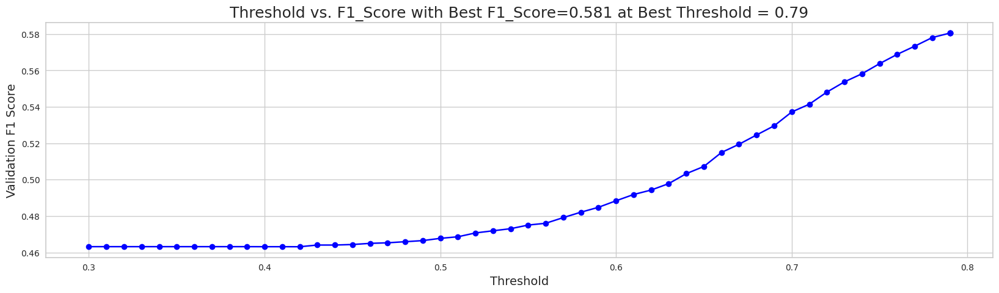

When using optimal threshold = 0.79...
Q0: F1 = 0.5805281602751861
==> Overall F1 = 0.5805281602751861
s
[I 2023-05-23 03:05:43,004] Trial 14 finished with value: 0.5805281602751861 and parameters: {'num_leaves': 18, 'learning_rate': 0.01042861809739301, 'feature_fraction': 0.438082767788075, 'bagging_fraction': 0.5289626984749244, 'bagging_freq': 7, 'min_child_samples': 97, 'reg_alpha': 0.21175032369295954, 'reg_lambda': 0.0014551963330949032, 'subsample': 0.9951261501521614, 'colsample_bytree': 0.9840847257176201, 'min_split_gain': 0.0038643755863585977, 'max_depth': -1}. Best is trial 12 with value: 0.5812078939337055.


--------------------------------------------------
question12, with210features
--------------------------------------------------


,mean
feature,
hover_duration_mean,161.6
tunic.historicalsociety.frontdesk_room_fqid_counts,127.2
elapsed_time_diff_std,103.2
room_coor_x_min,102.6
session_id,102.4
hover_duration_std,96.0
room_coor_y_max,90.6
9_level_counts,88.2
hover_duration_sum,88.0


[[0.32666879 0.67333121]
 [0.13940994 0.86059006]
 [0.09737828 0.90262172]
 ...
 [0.08707816 0.91292184]
 [0.05403706 0.94596294]
 [0.09430586 0.90569414]]
[LightGBM] [Warning] bagging_fraction is set=0.9658411736973362, subsample=0.7590296437356483 will be ignored. Current value: bagging_fraction=0.9658411736973362
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=8, subsample_freq=0 will be ignored. Current value: bagging_freq=8
[LightGBM] [Warning] feature_fraction is set=0.28712957511312875, colsample_bytree=0.7178229288833347 will be ignored. Current value: feature_fraction=0.28712957511312875


,mean
feature,
hover_duration_mean,139.6
tunic.historicalsociety.frontdesk_room_fqid_counts,131.6
tunic.historicalsociety.frontdesk.archivist.foundtheodora_text_fqid_counts,84.8
elapsed_time_diff_std,72.2
door_block_talk_fqid_counts,70.0
11_level_counts,67.8
map_click_event_name_counts,62.6
logbook_fqid_counts,59.2
9_level_counts,58.8


[[0.23456864 0.76543136]
 [0.11851229 0.88148771]
 [0.09227705 0.90772295]
 ...
 [0.10390554 0.89609446]
 [0.0637376  0.9362624 ]
 [0.11312404 0.88687596]]


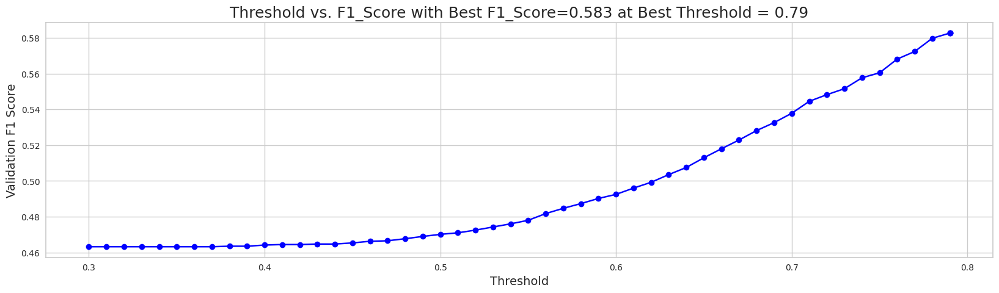

When using optimal threshold = 0.79...
Q0: F1 = 0.5826672928669456
==> Overall F1 = 0.5826672928669456
s
[I 2023-05-23 03:05:47,101] Trial 15 finished with value: 0.5826672928669456 and parameters: {'num_leaves': 17, 'learning_rate': 0.010246516698422964, 'feature_fraction': 0.45060868943321347, 'bagging_fraction': 0.5201242273129808, 'bagging_freq': 7, 'min_child_samples': 93, 'reg_alpha': 0.20047372292690477, 'reg_lambda': 0.0017931825511435459, 'subsample': 0.9902007652628788, 'colsample_bytree': 0.9860168072234853, 'min_split_gain': 0.0041865122072078055, 'max_depth': 0}. Best is trial 15 with value: 0.5826672928669456.


--------------------------------------------------
question12, with210features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.9323682097162791, subsample=0.7539954761659473 will be ignored. Current value: bagging_fraction=0.9323682097162791
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=8, subsample_freq=0 will be ignored. Current value: bagging_freq=8
[LightGBM] [Warning] feature_fraction is set=0.29133509312060846, colsample_bytree=0.7114034928798294 will be ignored. Current value: feature_fraction=0.29133509312060846


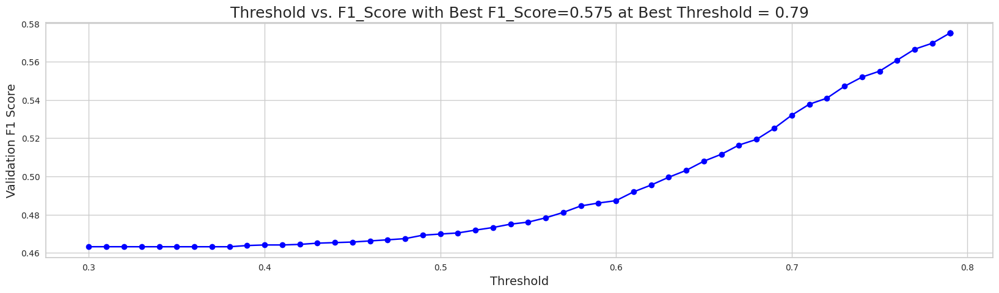

When using optimal threshold = 0.79...
Q0: F1 = 0.5749679482227502
==> Overall F1 = 0.5749679482227502
s
[I 2023-05-23 03:05:50,287] Trial 13 finished with value: 0.5749679482227502 and parameters: {'num_leaves': 10, 'learning_rate': 0.011020806672403575, 'feature_fraction': 0.9577789655219621, 'bagging_fraction': 0.9769429785211522, 'bagging_freq': 7, 'min_child_samples': 93, 'reg_alpha': 0.0010517694886931946, 'reg_lambda': 0.0010786191848116125, 'subsample': 0.7169011626058102, 'colsample_bytree': 0.7380322441715111, 'min_split_gain': 0.0028666845148423996, 'max_depth': -1}. Best is trial 15 with value: 0.5826672928669456.


--------------------------------------------------
question12, with210features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.4774658748988806, subsample=0.7712012413932706 will be ignored. Current value: bagging_fraction=0.4774658748988806
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=9, subsample_freq=0 will be ignored. Current value: bagging_freq=9
[LightGBM] [Warning] feature_fraction is set=0.2676888708918554, colsample_bytree=0.6331029649413831 will be ignored. Current value: feature_fraction=0.2676888708918554


[LightGBM] [Warning] bagging_fraction is set=0.5846034741754211, subsample=0.9983219700155902 will be ignored. Current value: bagging_fraction=0.5846034741754211
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=8, subsample_freq=0 will be ignored. Current value: bagging_freq=8
[LightGBM] [Warning] feature_fraction is set=0.44421927859817345, colsample_bytree=0.7036232164091075 will be ignored. Current value: feature_fraction=0.44421927859817345


[LightGBM] [Warning] bagging_fraction is set=0.5846034741754211, subsample=0.9983219700155902 will be ignored. Current value: bagging_fraction=0.5846034741754211
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=8, subsample_freq=0 will be ignored. Current value: bagging_freq=8
[LightGBM] [Warning] feature_fraction is set=0.44421927859817345, colsample_bytree=0.7036232164091075 will be ignored. Current value: feature_fraction=0.44421927859817345


[LightGBM] [Warning] bagging_fraction is set=0.9323682097162791, subsample=0.7539954761659473 will be ignored. Current value: bagging_fraction=0.9323682097162791
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=8, subsample_freq=0 will be ignored. Current value: bagging_freq=8
[LightGBM] [Warning] feature_fraction is set=0.29133509312060846, colsample_bytree=0.7114034928798294 will be ignored. Current value: feature_fraction=0.29133509312060846


[LightGBM] [Warning] bagging_fraction is set=0.4774658748988806, subsample=0.7712012413932706 will be ignored. Current value: bagging_fraction=0.4774658748988806
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=9, subsample_freq=0 will be ignored. Current value: bagging_freq=9
[LightGBM] [Warning] feature_fraction is set=0.2676888708918554, colsample_bytree=0.6331029649413831 will be ignored. Current value: feature_fraction=0.2676888708918554


[LightGBM] [Warning] bagging_fraction is set=0.9658411736973362, subsample=0.7590296437356483 will be ignored. Current value: bagging_fraction=0.9658411736973362
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=8, subsample_freq=0 will be ignored. Current value: bagging_freq=8
[LightGBM] [Warning] feature_fraction is set=0.28712957511312875, colsample_bytree=0.7178229288833347 will be ignored. Current value: feature_fraction=0.28712957511312875


,mean
feature,
tunic.historicalsociety.frontdesk_room_fqid_counts,79.6
hover_duration_mean,78.6
elapsed_time_diff_std,55.0
9_level_counts,54.8
room_coor_x_min,49.8
session_id,47.8
room_corr_x_diff_std,46.4
hover_duration_std,46.4
reader_fqid_counts,42.4


[[0.27814252 0.72185748]
 [0.15244849 0.84755151]
 [0.0973216  0.9026784 ]
 ...
 [0.09328832 0.90671168]
 [0.05679591 0.94320409]
 [0.11562002 0.88437998]]


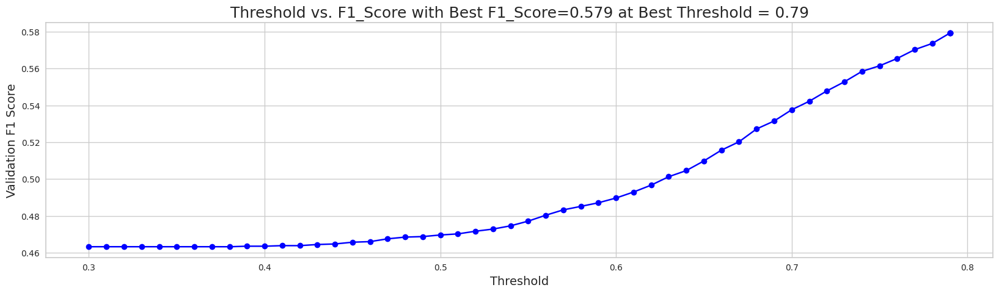

When using optimal threshold = 0.79...
Q0: F1 = 0.5792598444336412
==> Overall F1 = 0.5792598444336412
s
[I 2023-05-23 03:06:26,106] Trial 16 finished with value: 0.5792598444336412 and parameters: {'num_leaves': 13, 'learning_rate': 0.014822703129682107, 'feature_fraction': 0.44421927859817345, 'bagging_fraction': 0.5846034741754211, 'bagging_freq': 8, 'min_child_samples': 98, 'reg_alpha': 0.35896453124245414, 'reg_lambda': 0.001373812431451959, 'subsample': 0.9983219700155902, 'colsample_bytree': 0.7036232164091075, 'min_split_gain': 0.0010897832416984663, 'max_depth': 0}. Best is trial 15 with value: 0.5826672928669456.


--------------------------------------------------
question12, with210features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.4228826093485145, subsample=0.7847402371648022 will be ignored. Current value: bagging_fraction=0.4228826093485145
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=9, subsample_freq=0 will be ignored. Current value: bagging_freq=9
[LightGBM] [Warning] feature_fraction is set=0.268150294388762, colsample_bytree=0.6626296094443577 will be ignored. Current value: feature_fraction=0.268150294388762
[LightGBM] [Warning] bagging_fraction is set=0.9323682097162791, subsample=0.7539954761659473 will be ignored. Current value: bagging_fraction=0.9323682097162791
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=8, subsample_freq=0 will be ignored. Current value: bagging_freq=8
[LightGBM] [Warning] feat

[LightGBM] [Warning] bagging_fraction is set=0.4774658748988806, subsample=0.7712012413932706 will be ignored. Current value: bagging_fraction=0.4774658748988806
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=9, subsample_freq=0 will be ignored. Current value: bagging_freq=9
[LightGBM] [Warning] feature_fraction is set=0.2676888708918554, colsample_bytree=0.6331029649413831 will be ignored. Current value: feature_fraction=0.2676888708918554


[LightGBM] [Warning] bagging_fraction is set=0.9323682097162791, subsample=0.7539954761659473 will be ignored. Current value: bagging_fraction=0.9323682097162791
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=8, subsample_freq=0 will be ignored. Current value: bagging_freq=8
[LightGBM] [Warning] feature_fraction is set=0.29133509312060846, colsample_bytree=0.7114034928798294 will be ignored. Current value: feature_fraction=0.29133509312060846


[LightGBM] [Warning] bagging_fraction is set=0.9658411736973362, subsample=0.7590296437356483 will be ignored. Current value: bagging_fraction=0.9658411736973362
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=8, subsample_freq=0 will be ignored. Current value: bagging_freq=8
[LightGBM] [Warning] feature_fraction is set=0.28712957511312875, colsample_bytree=0.7178229288833347 will be ignored. Current value: feature_fraction=0.28712957511312875


[LightGBM] [Warning] bagging_fraction is set=0.4228826093485145, subsample=0.7847402371648022 will be ignored. Current value: bagging_fraction=0.4228826093485145
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=9, subsample_freq=0 will be ignored. Current value: bagging_freq=9
[LightGBM] [Warning] feature_fraction is set=0.268150294388762, colsample_bytree=0.6626296094443577 will be ignored. Current value: feature_fraction=0.268150294388762


[LightGBM] [Warning] bagging_fraction is set=0.4774658748988806, subsample=0.7712012413932706 will be ignored. Current value: bagging_fraction=0.4774658748988806
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=9, subsample_freq=0 will be ignored. Current value: bagging_freq=9
[LightGBM] [Warning] feature_fraction is set=0.2676888708918554, colsample_bytree=0.6331029649413831 will be ignored. Current value: feature_fraction=0.2676888708918554


[LightGBM] [Warning] bagging_fraction is set=0.9323682097162791, subsample=0.7539954761659473 will be ignored. Current value: bagging_fraction=0.9323682097162791
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=8, subsample_freq=0 will be ignored. Current value: bagging_freq=8
[LightGBM] [Warning] feature_fraction is set=0.29133509312060846, colsample_bytree=0.7114034928798294 will be ignored. Current value: feature_fraction=0.29133509312060846


[LightGBM] [Warning] bagging_fraction is set=0.9658411736973362, subsample=0.7590296437356483 will be ignored. Current value: bagging_fraction=0.9658411736973362
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=8, subsample_freq=0 will be ignored. Current value: bagging_freq=8
[LightGBM] [Warning] feature_fraction is set=0.28712957511312875, colsample_bytree=0.7178229288833347 will be ignored. Current value: feature_fraction=0.28712957511312875


[LightGBM] [Warning] bagging_fraction is set=0.4774658748988806, subsample=0.7712012413932706 will be ignored. Current value: bagging_fraction=0.4774658748988806
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=9, subsample_freq=0 will be ignored. Current value: bagging_freq=9
[LightGBM] [Warning] feature_fraction is set=0.2676888708918554, colsample_bytree=0.6331029649413831 will be ignored. Current value: feature_fraction=0.2676888708918554


[LightGBM] [Warning] bagging_fraction is set=0.4228826093485145, subsample=0.7847402371648022 will be ignored. Current value: bagging_fraction=0.4228826093485145
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=9, subsample_freq=0 will be ignored. Current value: bagging_freq=9
[LightGBM] [Warning] feature_fraction is set=0.268150294388762, colsample_bytree=0.6626296094443577 will be ignored. Current value: feature_fraction=0.268150294388762


,mean
feature,
hover_duration_mean,137.8
tunic.historicalsociety.frontdesk_room_fqid_counts,136.8
elapsed_time_diff_std,107.6
9_level_counts,96.8
room_coor_x_min,94.2
hover_duration_std,89.0
hover_duration_sum,83.2
5_level_counts,83.2
screen_coor_x_min,83.0


[[0.27149493 0.72850507]
 [0.13960283 0.86039717]
 [0.09550758 0.90449242]
 ...
 [0.09210285 0.90789715]
 [0.05323295 0.94676705]
 [0.10176994 0.89823006]]


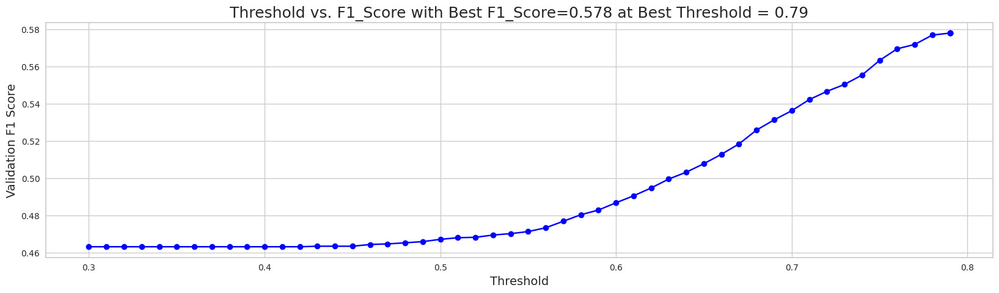

When using optimal threshold = 0.79...
Q0: F1 = 0.5779901997259951
==> Overall F1 = 0.5779901997259951
s
[I 2023-05-23 03:07:16,640] Trial 18 finished with value: 0.5779901997259951 and parameters: {'num_leaves': 17, 'learning_rate': 0.012226684231007931, 'feature_fraction': 0.29133509312060846, 'bagging_fraction': 0.9323682097162791, 'bagging_freq': 8, 'min_child_samples': 100, 'reg_alpha': 0.5033101556749399, 'reg_lambda': 7.759014484341396, 'subsample': 0.7539954761659473, 'colsample_bytree': 0.7114034928798294, 'min_split_gain': 0.0010341651138233597, 'max_depth': -1}. Best is trial 15 with value: 0.5826672928669456.


--------------------------------------------------
question12, with210features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.4972818646925204, subsample=0.81842626105713 will be ignored. Current value: bagging_fraction=0.4972818646925204
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=9, subsample_freq=0 will be ignored. Current value: bagging_freq=9
[LightGBM] [Warning] feature_fraction is set=0.2554834796767289, colsample_bytree=0.5917907475118218 will be ignored. Current value: feature_fraction=0.2554834796767289


[LightGBM] [Warning] bagging_fraction is set=0.4228826093485145, subsample=0.7847402371648022 will be ignored. Current value: bagging_fraction=0.4228826093485145
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=9, subsample_freq=0 will be ignored. Current value: bagging_freq=9
[LightGBM] [Warning] feature_fraction is set=0.268150294388762, colsample_bytree=0.6626296094443577 will be ignored. Current value: feature_fraction=0.268150294388762


,mean
feature,
hover_duration_mean,141.4
hover_duration_std,136.8
session_id,109.6
room_coor_x_min,109.6
tunic.historicalsociety.frontdesk_room_fqid_counts,109.4
room_coor_y_max,107.6
elapsed_time_diff_std,99.4
screen_coor_y_std,97.8
room_coor_x_max,96.0


[[0.25398627 0.74601373]
 [0.13660908 0.86339092]
 [0.09642573 0.90357427]
 ...
 [0.07844582 0.92155418]
 [0.04864928 0.95135072]
 [0.09821827 0.90178173]]


[LightGBM] [Warning] bagging_fraction is set=0.9658411736973362, subsample=0.7590296437356483 will be ignored. Current value: bagging_fraction=0.9658411736973362
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=8, subsample_freq=0 will be ignored. Current value: bagging_freq=8
[LightGBM] [Warning] feature_fraction is set=0.28712957511312875, colsample_bytree=0.7178229288833347 will be ignored. Current value: feature_fraction=0.28712957511312875


[LightGBM] [Warning] bagging_fraction is set=0.4972818646925204, subsample=0.81842626105713 will be ignored. Current value: bagging_fraction=0.4972818646925204
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=9, subsample_freq=0 will be ignored. Current value: bagging_freq=9
[LightGBM] [Warning] feature_fraction is set=0.2554834796767289, colsample_bytree=0.5917907475118218 will be ignored. Current value: feature_fraction=0.2554834796767289


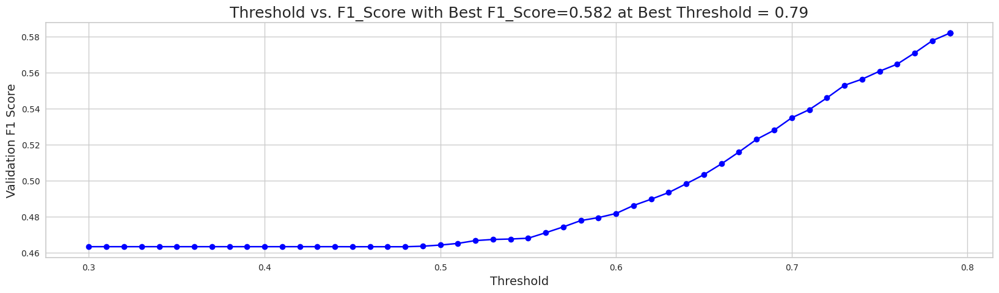

When using optimal threshold = 0.79...
Q0: F1 = 0.5819612739781128
==> Overall F1 = 0.5819612739781128
s
[I 2023-05-23 03:07:28,739] Trial 19 finished with value: 0.5819612739781128 and parameters: {'num_leaves': 27, 'learning_rate': 0.01582223220318595, 'feature_fraction': 0.2676888708918554, 'bagging_fraction': 0.4774658748988806, 'bagging_freq': 9, 'min_child_samples': 78, 'reg_alpha': 0.5574664478995862, 'reg_lambda': 9.65436894364531, 'subsample': 0.7712012413932706, 'colsample_bytree': 0.6331029649413831, 'min_split_gain': 0.0011397080224420156, 'max_depth': 0}. Best is trial 15 with value: 0.5826672928669456.


--------------------------------------------------
question12, with210features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.46103446953314703, subsample=0.8024379961007216 will be ignored. Current value: bagging_fraction=0.46103446953314703
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=9, subsample_freq=0 will be ignored. Current value: bagging_freq=9
[LightGBM] [Warning] feature_fraction is set=0.5373770884644243, colsample_bytree=0.5988177411409615 will be ignored. Current value: feature_fraction=0.5373770884644243


[LightGBM] [Warning] bagging_fraction is set=0.4228826093485145, subsample=0.7847402371648022 will be ignored. Current value: bagging_fraction=0.4228826093485145
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=9, subsample_freq=0 will be ignored. Current value: bagging_freq=9
[LightGBM] [Warning] feature_fraction is set=0.268150294388762, colsample_bytree=0.6626296094443577 will be ignored. Current value: feature_fraction=0.268150294388762


[LightGBM] [Warning] bagging_fraction is set=0.4972818646925204, subsample=0.81842626105713 will be ignored. Current value: bagging_fraction=0.4972818646925204
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=9, subsample_freq=0 will be ignored. Current value: bagging_freq=9
[LightGBM] [Warning] feature_fraction is set=0.2554834796767289, colsample_bytree=0.5917907475118218 will be ignored. Current value: feature_fraction=0.2554834796767289


[LightGBM] [Warning] bagging_fraction is set=0.46103446953314703, subsample=0.8024379961007216 will be ignored. Current value: bagging_fraction=0.46103446953314703
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=9, subsample_freq=0 will be ignored. Current value: bagging_freq=9
[LightGBM] [Warning] feature_fraction is set=0.5373770884644243, colsample_bytree=0.5988177411409615 will be ignored. Current value: feature_fraction=0.5373770884644243


,mean
feature,
hover_duration_mean,125.4
room_coor_x_max,109.6
session_id,109.2
room_coor_y_std,107.0
screen_coor_y_mean,106.8
hover_duration_std,104.4
screen_coor_x_mean,98.6
elapsed_time_diff_std,98.6
tunic.historicalsociety.frontdesk_room_fqid_counts,97.8


[[0.33210462 0.66789538]
 [0.1365695  0.8634305 ]
 [0.1108613  0.8891387 ]
 ...
 [0.08867732 0.91132268]
 [0.04530085 0.95469915]
 [0.11112703 0.88887297]]
[LightGBM] [Warning] bagging_fraction is set=0.4972818646925204, subsample=0.81842626105713 will be ignored. Current value: bagging_fraction=0.4972818646925204
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=9, subsample_freq=0 will be ignored. Current value: bagging_freq=9
[LightGBM] [Warning] feature_fraction is set=0.2554834796767289, colsample_bytree=0.5917907475118218 will be ignored. Current value: feature_fraction=0.2554834796767289


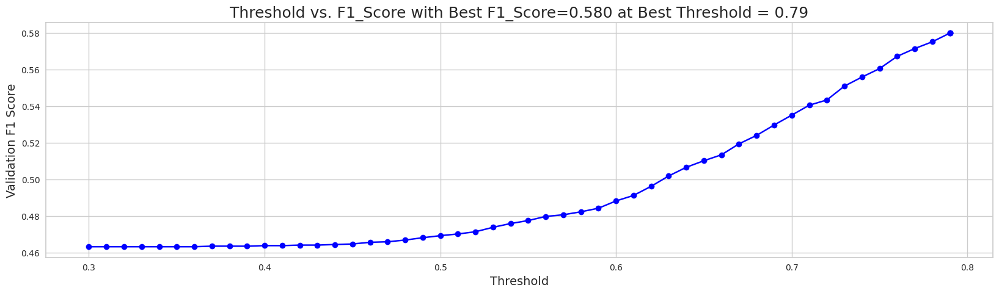

When using optimal threshold = 0.79...
Q0: F1 = 0.5797676878156093
==> Overall F1 = 0.5797676878156093
s
[I 2023-05-23 03:07:48,294] Trial 20 finished with value: 0.5797676878156093 and parameters: {'num_leaves': 26, 'learning_rate': 0.017867373908180727, 'feature_fraction': 0.268150294388762, 'bagging_fraction': 0.4228826093485145, 'bagging_freq': 9, 'min_child_samples': 6, 'reg_alpha': 0.5840195384573603, 'reg_lambda': 3.569167887889307, 'subsample': 0.7847402371648022, 'colsample_bytree': 0.6626296094443577, 'min_split_gain': 0.0011636536499153311, 'max_depth': 5}. Best is trial 15 with value: 0.5826672928669456.


--------------------------------------------------
question12, with210features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.4988244556290301, subsample=0.6544686592708333 will be ignored. Current value: bagging_fraction=0.4988244556290301
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=8, subsample_freq=0 will be ignored. Current value: bagging_freq=8
[LightGBM] [Warning] feature_fraction is set=0.5192223312678945, colsample_bytree=0.5785479980557493 will be ignored. Current value: feature_fraction=0.5192223312678945


,mean
feature,
hover_duration_mean,176.2
tunic.historicalsociety.frontdesk_room_fqid_counts,170.2
elapsed_time_diff_std,128.8
9_level_counts,117.0
hover_duration_std,111.2
room_coor_x_min,110.0
11_level_counts,102.0
room_coor_y_max,99.8
map_click_event_name_counts,97.0


[[0.27507133 0.72492867]
 [0.13634438 0.86365562]
 [0.09730899 0.90269101]
 ...
 [0.08809233 0.91190767]
 [0.05533759 0.94466241]
 [0.10895649 0.89104351]]


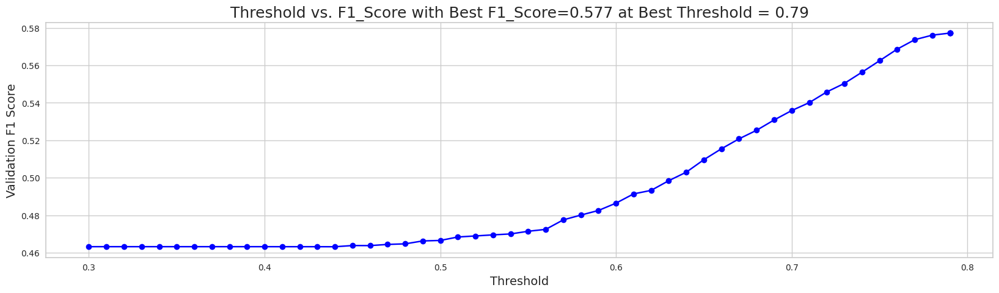

When using optimal threshold = 0.79...
Q0: F1 = 0.577188122921987
==> Overall F1 = 0.577188122921987
s
[I 2023-05-23 03:07:56,381] Trial 17 finished with value: 0.577188122921987 and parameters: {'num_leaves': 16, 'learning_rate': 0.010183722987144428, 'feature_fraction': 0.28712957511312875, 'bagging_fraction': 0.9658411736973362, 'bagging_freq': 8, 'min_child_samples': 78, 'reg_alpha': 0.4877322251164571, 'reg_lambda': 9.998381735848273, 'subsample': 0.7590296437356483, 'colsample_bytree': 0.7178229288833347, 'min_split_gain': 0.001619427887269105, 'max_depth': -1}. Best is trial 15 with value: 0.5826672928669456.


--------------------------------------------------
question12, with210features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.47330120210831905, subsample=0.8319578927986049 will be ignored. Current value: bagging_fraction=0.47330120210831905
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=9, subsample_freq=0 will be ignored. Current value: bagging_freq=9
[LightGBM] [Warning] feature_fraction is set=0.20177300836242737, colsample_bytree=0.5677505307529386 will be ignored. Current value: feature_fraction=0.20177300836242737


[LightGBM] [Warning] bagging_fraction is set=0.46103446953314703, subsample=0.8024379961007216 will be ignored. Current value: bagging_fraction=0.46103446953314703
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=9, subsample_freq=0 will be ignored. Current value: bagging_freq=9
[LightGBM] [Warning] feature_fraction is set=0.5373770884644243, colsample_bytree=0.5988177411409615 will be ignored. Current value: feature_fraction=0.5373770884644243


[LightGBM] [Warning] bagging_fraction is set=0.4972818646925204, subsample=0.81842626105713 will be ignored. Current value: bagging_fraction=0.4972818646925204
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=9, subsample_freq=0 will be ignored. Current value: bagging_freq=9
[LightGBM] [Warning] feature_fraction is set=0.2554834796767289, colsample_bytree=0.5917907475118218 will be ignored. Current value: feature_fraction=0.2554834796767289


[LightGBM] [Warning] bagging_fraction is set=0.4988244556290301, subsample=0.6544686592708333 will be ignored. Current value: bagging_fraction=0.4988244556290301
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=8, subsample_freq=0 will be ignored. Current value: bagging_freq=8
[LightGBM] [Warning] feature_fraction is set=0.5192223312678945, colsample_bytree=0.5785479980557493 will be ignored. Current value: feature_fraction=0.5192223312678945


[LightGBM] [Warning] bagging_fraction is set=0.47330120210831905, subsample=0.8319578927986049 will be ignored. Current value: bagging_fraction=0.47330120210831905
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=9, subsample_freq=0 will be ignored. Current value: bagging_freq=9
[LightGBM] [Warning] feature_fraction is set=0.20177300836242737, colsample_bytree=0.5677505307529386 will be ignored. Current value: feature_fraction=0.20177300836242737


[LightGBM] [Warning] bagging_fraction is set=0.46103446953314703, subsample=0.8024379961007216 will be ignored. Current value: bagging_fraction=0.46103446953314703
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=9, subsample_freq=0 will be ignored. Current value: bagging_freq=9
[LightGBM] [Warning] feature_fraction is set=0.5373770884644243, colsample_bytree=0.5988177411409615 will be ignored. Current value: feature_fraction=0.5373770884644243


,mean
feature,
hover_duration_std,103.4
hover_duration_mean,100.0
room_coor_x_min,81.4
9_level_counts,73.6
session_id,73.0
tunic.historicalsociety.frontdesk_room_fqid_counts,68.8
screen_coor_y_std,65.0
screen_coor_x_std,61.4
hover_duration_max,61.2


[[0.28330433 0.71669567]
 [0.14886171 0.85113829]
 [0.09616938 0.90383062]
 ...
 [0.09822029 0.90177971]
 [0.04720703 0.95279297]
 [0.1307675  0.8692325 ]]


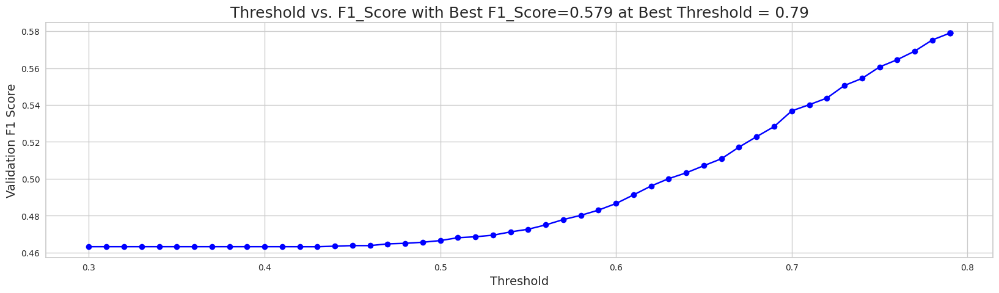

When using optimal threshold = 0.79...
Q0: F1 = 0.578956504392532
==> Overall F1 = 0.578956504392532
s
[I 2023-05-23 03:08:18,589] Trial 21 finished with value: 0.578956504392532 and parameters: {'num_leaves': 27, 'learning_rate': 0.01900302065563363, 'feature_fraction': 0.2554834796767289, 'bagging_fraction': 0.4972818646925204, 'bagging_freq': 9, 'min_child_samples': 73, 'reg_alpha': 0.8340038516871773, 'reg_lambda': 1.3970237069440081, 'subsample': 0.81842626105713, 'colsample_bytree': 0.5917907475118218, 'min_split_gain': 0.007085493531774837, 'max_depth': 10}. Best is trial 15 with value: 0.5826672928669456.


--------------------------------------------------
question12, with210features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.6725238962919649, subsample=0.894643051874052 will be ignored. Current value: bagging_fraction=0.6725238962919649
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=9, subsample_freq=0 will be ignored. Current value: bagging_freq=9
[LightGBM] [Warning] feature_fraction is set=0.5113495903617937, colsample_bytree=0.5654316961346226 will be ignored. Current value: feature_fraction=0.5113495903617937


[LightGBM] [Warning] bagging_fraction is set=0.4988244556290301, subsample=0.6544686592708333 will be ignored. Current value: bagging_fraction=0.4988244556290301
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=8, subsample_freq=0 will be ignored. Current value: bagging_freq=8
[LightGBM] [Warning] feature_fraction is set=0.5192223312678945, colsample_bytree=0.5785479980557493 will be ignored. Current value: feature_fraction=0.5192223312678945


[LightGBM] [Warning] bagging_fraction is set=0.47330120210831905, subsample=0.8319578927986049 will be ignored. Current value: bagging_fraction=0.47330120210831905
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=9, subsample_freq=0 will be ignored. Current value: bagging_freq=9
[LightGBM] [Warning] feature_fraction is set=0.20177300836242737, colsample_bytree=0.5677505307529386 will be ignored. Current value: feature_fraction=0.20177300836242737


[LightGBM] [Warning] bagging_fraction is set=0.46103446953314703, subsample=0.8024379961007216 will be ignored. Current value: bagging_fraction=0.46103446953314703
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=9, subsample_freq=0 will be ignored. Current value: bagging_freq=9
[LightGBM] [Warning] feature_fraction is set=0.5373770884644243, colsample_bytree=0.5988177411409615 will be ignored. Current value: feature_fraction=0.5373770884644243


[LightGBM] [Warning] bagging_fraction is set=0.4988244556290301, subsample=0.6544686592708333 will be ignored. Current value: bagging_fraction=0.4988244556290301
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=8, subsample_freq=0 will be ignored. Current value: bagging_freq=8
[LightGBM] [Warning] feature_fraction is set=0.5192223312678945, colsample_bytree=0.5785479980557493 will be ignored. Current value: feature_fraction=0.5192223312678945


[LightGBM] [Warning] bagging_fraction is set=0.47330120210831905, subsample=0.8319578927986049 will be ignored. Current value: bagging_fraction=0.47330120210831905
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=9, subsample_freq=0 will be ignored. Current value: bagging_freq=9
[LightGBM] [Warning] feature_fraction is set=0.20177300836242737, colsample_bytree=0.5677505307529386 will be ignored. Current value: feature_fraction=0.20177300836242737


,mean
feature,
hover_duration_mean,86.6
room_coor_x_min,71.4
tunic.historicalsociety.frontdesk_room_fqid_counts,67.0
room_coor_x_max,66.4
session_id,62.4
hover_duration_max,60.6
hover_duration_sum,59.6
room_coor_y_max,59.4
room_coor_y_min,59.2


[[0.300288   0.699712  ]
 [0.12500315 0.87499685]
 [0.08105431 0.91894569]
 ...
 [0.08254265 0.91745735]
 [0.04090452 0.95909548]
 [0.11256978 0.88743022]]


[LightGBM] [Warning] bagging_fraction is set=0.6725238962919649, subsample=0.894643051874052 will be ignored. Current value: bagging_fraction=0.6725238962919649
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=9, subsample_freq=0 will be ignored. Current value: bagging_freq=9
[LightGBM] [Warning] feature_fraction is set=0.5113495903617937, colsample_bytree=0.5654316961346226 will be ignored. Current value: feature_fraction=0.5113495903617937


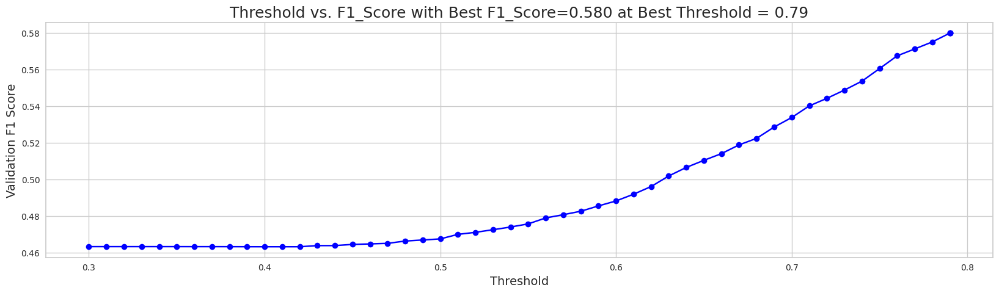

When using optimal threshold = 0.79...
Q0: F1 = 0.5798135601368519
==> Overall F1 = 0.5798135601368519
s
[I 2023-05-23 03:08:46,891] Trial 22 finished with value: 0.5798135601368519 and parameters: {'num_leaves': 28, 'learning_rate': 0.02092615752636141, 'feature_fraction': 0.5373770884644243, 'bagging_fraction': 0.46103446953314703, 'bagging_freq': 9, 'min_child_samples': 77, 'reg_alpha': 0.8129929735791996, 'reg_lambda': 0.006649594363731016, 'subsample': 0.8024379961007216, 'colsample_bytree': 0.5988177411409615, 'min_split_gain': 0.006024159679627649, 'max_depth': 0}. Best is trial 15 with value: 0.5826672928669456.


--------------------------------------------------
question12, with210features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.5874793907496452, subsample=0.8994326342471417 will be ignored. Current value: bagging_fraction=0.5874793907496452
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=10, subsample_freq=0 will be ignored. Current value: bagging_freq=10
[LightGBM] [Warning] feature_fraction is set=0.20984509010359811, colsample_bytree=0.8026556479124745 will be ignored. Current value: feature_fraction=0.20984509010359811


[LightGBM] [Warning] bagging_fraction is set=0.47330120210831905, subsample=0.8319578927986049 will be ignored. Current value: bagging_fraction=0.47330120210831905
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=9, subsample_freq=0 will be ignored. Current value: bagging_freq=9
[LightGBM] [Warning] feature_fraction is set=0.20177300836242737, colsample_bytree=0.5677505307529386 will be ignored. Current value: feature_fraction=0.20177300836242737
[LightGBM] [Warning] bagging_fraction is set=0.4988244556290301, subsample=0.6544686592708333 will be ignored. Current value: bagging_fraction=0.4988244556290301
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=8, subsample_freq=0 will be ignored. Current value: bagging_freq=8
[LightGBM] [Warning

[LightGBM] [Warning] bagging_fraction is set=0.6725238962919649, subsample=0.894643051874052 will be ignored. Current value: bagging_fraction=0.6725238962919649
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=9, subsample_freq=0 will be ignored. Current value: bagging_freq=9
[LightGBM] [Warning] feature_fraction is set=0.5113495903617937, colsample_bytree=0.5654316961346226 will be ignored. Current value: feature_fraction=0.5113495903617937


[LightGBM] [Warning] bagging_fraction is set=0.6725238962919649, subsample=0.894643051874052 will be ignored. Current value: bagging_fraction=0.6725238962919649
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=9, subsample_freq=0 will be ignored. Current value: bagging_freq=9
[LightGBM] [Warning] feature_fraction is set=0.5113495903617937, colsample_bytree=0.5654316961346226 will be ignored. Current value: feature_fraction=0.5113495903617937


,mean
feature,
tunic.historicalsociety.frontdesk_room_fqid_counts,35.0
hover_duration_mean,27.4
tunic.historicalsociety.frontdesk.archivist.foundtheodora_text_fqid_counts,24.0
elapsed_time_diff_std,22.6
5_level_counts,21.0
logbook_fqid_counts,20.6
door_block_talk_fqid_counts,19.0
map_click_event_name_counts,18.0
reader_fqid_counts,17.6


[[0.21388312 0.78611688]
 [0.13192646 0.86807354]
 [0.09735672 0.90264328]
 ...
 [0.09660419 0.90339581]
 [0.06353646 0.93646354]
 [0.10214065 0.89785935]]


[LightGBM] [Warning] bagging_fraction is set=0.5874793907496452, subsample=0.8994326342471417 will be ignored. Current value: bagging_fraction=0.5874793907496452
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=10, subsample_freq=0 will be ignored. Current value: bagging_freq=10
[LightGBM] [Warning] feature_fraction is set=0.20984509010359811, colsample_bytree=0.8026556479124745 will be ignored. Current value: feature_fraction=0.20984509010359811


,mean
feature,
hover_duration_mean,102.4
room_coor_x_min,86.4
hover_duration_std,74.2
session_id,73.2
tunic.historicalsociety.frontdesk_room_fqid_counts,73.0
room_coor_x_max,71.4
room_coor_y_min,71.2
elapsed_time_diff_std,70.0
room_coor_y_max,68.0


[[0.30109866 0.69890134]
 [0.1323024  0.8676976 ]
 [0.10319867 0.89680133]
 ...
 [0.09858826 0.90141174]
 [0.04976508 0.95023492]
 [0.10523344 0.89476656]]


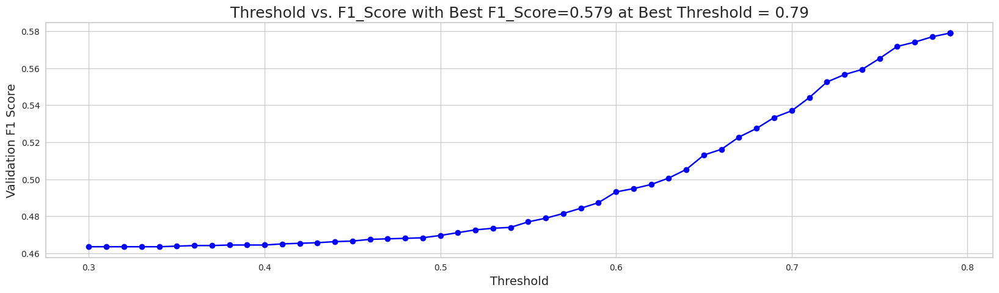

When using optimal threshold = 0.79...
Q0: F1 = 0.5789361682717813
==> Overall F1 = 0.5789361682717813
s
[I 2023-05-23 03:09:12,484] Trial 24 finished with value: 0.5789361682717813 and parameters: {'num_leaves': 28, 'learning_rate': 0.019972477184497, 'feature_fraction': 0.20177300836242737, 'bagging_fraction': 0.47330120210831905, 'bagging_freq': 9, 'min_child_samples': 86, 'reg_alpha': 1.2880330855763942, 'reg_lambda': 0.9900135416977702, 'subsample': 0.8319578927986049, 'colsample_bytree': 0.5677505307529386, 'min_split_gain': 0.00430391655913746, 'max_depth': 1}. Best is trial 15 with value: 0.5826672928669456.


--------------------------------------------------
question12, with210features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.6725238962919649, subsample=0.894643051874052 will be ignored. Current value: bagging_fraction=0.6725238962919649
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=9, subsample_freq=0 will be ignored. Current value: bagging_freq=9
[LightGBM] [Warning] feature_fraction is set=0.5113495903617937, colsample_bytree=0.5654316961346226 will be ignored. Current value: feature_fraction=0.5113495903617937


[LightGBM] [Warning] bagging_fraction is set=0.5900005801837431, subsample=0.8916991378370248 will be ignored. Current value: bagging_fraction=0.5900005801837431
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=10, subsample_freq=0 will be ignored. Current value: bagging_freq=10
[LightGBM] [Warning] feature_fraction is set=0.35698966129353576, colsample_bytree=0.8218276355248733 will be ignored. Current value: feature_fraction=0.35698966129353576


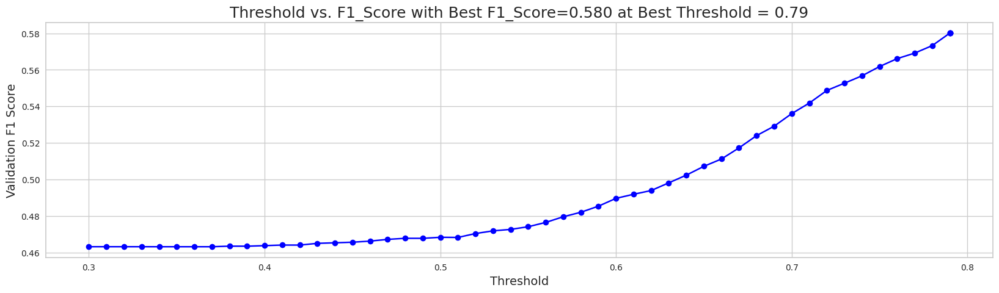

When using optimal threshold = 0.79...
Q0: F1 = 0.5801327590761765
==> Overall F1 = 0.5801327590761765
s
[I 2023-05-23 03:09:15,098] Trial 23 finished with value: 0.5801327590761765 and parameters: {'num_leaves': 30, 'learning_rate': 0.019344515422854557, 'feature_fraction': 0.5192223312678945, 'bagging_fraction': 0.4988244556290301, 'bagging_freq': 8, 'min_child_samples': 82, 'reg_alpha': 0.038847898094115194, 'reg_lambda': 0.7420099167519701, 'subsample': 0.6544686592708333, 'colsample_bytree': 0.5785479980557493, 'min_split_gain': 0.008469839324445694, 'max_depth': 10}. Best is trial 15 with value: 0.5826672928669456.


--------------------------------------------------
question12, with210features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.5937004697408739, subsample=0.8960752640525248 will be ignored. Current value: bagging_fraction=0.5937004697408739
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=10, subsample_freq=0 will be ignored. Current value: bagging_freq=10
[LightGBM] [Warning] feature_fraction is set=0.3482404806286704, colsample_bytree=0.8408736968886927 will be ignored. Current value: feature_fraction=0.3482404806286704


[LightGBM] [Warning] bagging_fraction is set=0.5874793907496452, subsample=0.8994326342471417 will be ignored. Current value: bagging_fraction=0.5874793907496452
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=10, subsample_freq=0 will be ignored. Current value: bagging_freq=10
[LightGBM] [Warning] feature_fraction is set=0.20984509010359811, colsample_bytree=0.8026556479124745 will be ignored. Current value: feature_fraction=0.20984509010359811


[LightGBM] [Warning] bagging_fraction is set=0.5874793907496452, subsample=0.8994326342471417 will be ignored. Current value: bagging_fraction=0.5874793907496452
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=10, subsample_freq=0 will be ignored. Current value: bagging_freq=10
[LightGBM] [Warning] feature_fraction is set=0.20984509010359811, colsample_bytree=0.8026556479124745 will be ignored. Current value: feature_fraction=0.20984509010359811


,mean
feature,
hover_duration_mean,34.8
tunic.historicalsociety.frontdesk_room_fqid_counts,32.4
tunic.historicalsociety.frontdesk.archivist.foundtheodora_text_fqid_counts,24.6
door_block_talk_fqid_counts,24.2
elapsed_time_diff_std,20.8
logbook_fqid_counts,18.6
tunic.historicalsociety.closet_dirty.door_block_talk_text_fqid_counts,18.4
11_level_counts,18.4
map_click_event_name_counts,18.2


[[0.22031071 0.77968929]
 [0.13734295 0.86265705]
 [0.09533687 0.90466313]
 ...
 [0.08904424 0.91095576]
 [0.069543   0.930457  ]
 [0.10132739 0.89867261]]


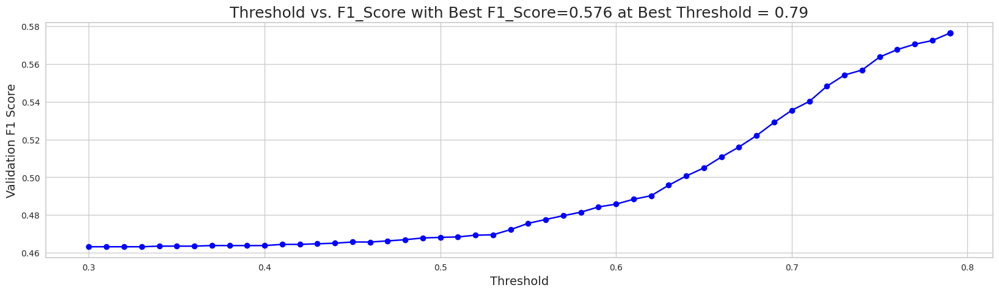

When using optimal threshold = 0.79...
Q0: F1 = 0.5763438899106232
==> Overall F1 = 0.5763438899106232
s
[I 2023-05-23 03:09:35,869] Trial 25 finished with value: 0.5763438899106232 and parameters: {'num_leaves': 30, 'learning_rate': 0.01987521617529402, 'feature_fraction': 0.5113495903617937, 'bagging_fraction': 0.6725238962919649, 'bagging_freq': 9, 'min_child_samples': 85, 'reg_alpha': 1.439048761430861, 'reg_lambda': 0.6388447918454104, 'subsample': 0.894643051874052, 'colsample_bytree': 0.5654316961346226, 'min_split_gain': 0.0023153783689160504, 'max_depth': 1}. Best is trial 15 with value: 0.5826672928669456.


--------------------------------------------------
question12, with210features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.6239260786623522, subsample=0.9243807359015919 will be ignored. Current value: bagging_fraction=0.6239260786623522
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=10, subsample_freq=0 will be ignored. Current value: bagging_freq=10
[LightGBM] [Warning] feature_fraction is set=0.3773555322310119, colsample_bytree=0.8279340373470513 will be ignored. Current value: feature_fraction=0.3773555322310119


[LightGBM] [Warning] bagging_fraction is set=0.5900005801837431, subsample=0.8916991378370248 will be ignored. Current value: bagging_fraction=0.5900005801837431
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=10, subsample_freq=0 will be ignored. Current value: bagging_freq=10
[LightGBM] [Warning] feature_fraction is set=0.35698966129353576, colsample_bytree=0.8218276355248733 will be ignored. Current value: feature_fraction=0.35698966129353576


[LightGBM] [Warning] bagging_fraction is set=0.5874793907496452, subsample=0.8994326342471417 will be ignored. Current value: bagging_fraction=0.5874793907496452
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=10, subsample_freq=0 will be ignored. Current value: bagging_freq=10
[LightGBM] [Warning] feature_fraction is set=0.20984509010359811, colsample_bytree=0.8026556479124745 will be ignored. Current value: feature_fraction=0.20984509010359811


[LightGBM] [Warning] bagging_fraction is set=0.5937004697408739, subsample=0.8960752640525248 will be ignored. Current value: bagging_fraction=0.5937004697408739
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=10, subsample_freq=0 will be ignored. Current value: bagging_freq=10
[LightGBM] [Warning] feature_fraction is set=0.3482404806286704, colsample_bytree=0.8408736968886927 will be ignored. Current value: feature_fraction=0.3482404806286704


[LightGBM] [Warning] bagging_fraction is set=0.5900005801837431, subsample=0.8916991378370248 will be ignored. Current value: bagging_fraction=0.5900005801837431
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=10, subsample_freq=0 will be ignored. Current value: bagging_freq=10
[LightGBM] [Warning] feature_fraction is set=0.35698966129353576, colsample_bytree=0.8218276355248733 will be ignored. Current value: feature_fraction=0.35698966129353576


,mean
feature,
hover_duration_mean,73.4
tunic.historicalsociety.frontdesk_room_fqid_counts,65.0
hover_duration_std,46.8
room_coor_x_min,45.4
11_level_counts,43.2
elapsed_time_diff_std,42.8
9_level_counts,42.4
reader_fqid_counts,39.2
map_click_event_name_counts,38.8


[[0.29088657 0.70911343]
 [0.13818468 0.86181532]
 [0.10201912 0.89798088]
 ...
 [0.10301762 0.89698238]
 [0.05259055 0.94740945]
 [0.09444847 0.90555153]]


[LightGBM] [Warning] bagging_fraction is set=0.6239260786623522, subsample=0.9243807359015919 will be ignored. Current value: bagging_fraction=0.6239260786623522
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=10, subsample_freq=0 will be ignored. Current value: bagging_freq=10
[LightGBM] [Warning] feature_fraction is set=0.3773555322310119, colsample_bytree=0.8279340373470513 will be ignored. Current value: feature_fraction=0.3773555322310119
[LightGBM] [Warning] bagging_fraction is set=0.5937004697408739, subsample=0.8960752640525248 will be ignored. Current value: bagging_fraction=0.5937004697408739
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=10, subsample_freq=0 will be ignored. Current value: bagging_freq=10
[LightGBM] [Warning

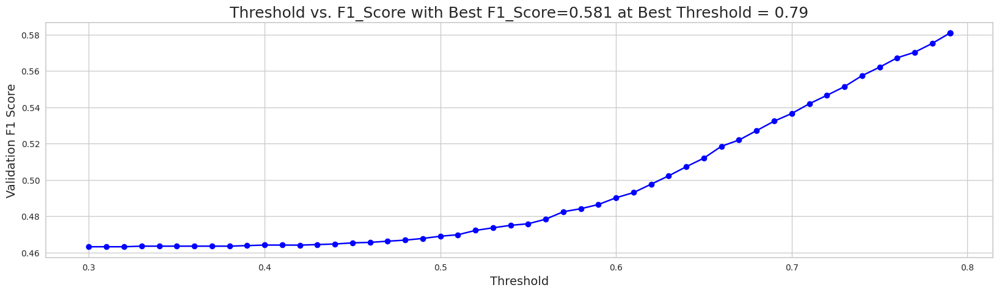

When using optimal threshold = 0.79...
Q0: F1 = 0.5808024952590028
==> Overall F1 = 0.5808024952590028
s
[I 2023-05-23 03:09:59,232] Trial 26 finished with value: 0.5808024952590028 and parameters: {'num_leaves': 37, 'learning_rate': 0.01598258302379929, 'feature_fraction': 0.20984509010359811, 'bagging_fraction': 0.5874793907496452, 'bagging_freq': 10, 'min_child_samples': 87, 'reg_alpha': 1.9953220862877443, 'reg_lambda': 1.0602059865663465, 'subsample': 0.8994326342471417, 'colsample_bytree': 0.8026556479124745, 'min_split_gain': 0.0030218487478895564, 'max_depth': 3}. Best is trial 15 with value: 0.5826672928669456.


--------------------------------------------------
question12, with210features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.377422296514439, subsample=0.9536751797877419 will be ignored. Current value: bagging_fraction=0.377422296514439
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=7, subsample_freq=0 will be ignored. Current value: bagging_freq=7
[LightGBM] [Warning] feature_fraction is set=0.35729326427044045, colsample_bytree=0.8160928421929745 will be ignored. Current value: feature_fraction=0.35729326427044045


[LightGBM] [Warning] bagging_fraction is set=0.5900005801837431, subsample=0.8916991378370248 will be ignored. Current value: bagging_fraction=0.5900005801837431
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=10, subsample_freq=0 will be ignored. Current value: bagging_freq=10
[LightGBM] [Warning] feature_fraction is set=0.35698966129353576, colsample_bytree=0.8218276355248733 will be ignored. Current value: feature_fraction=0.35698966129353576


[LightGBM] [Warning] bagging_fraction is set=0.6239260786623522, subsample=0.9243807359015919 will be ignored. Current value: bagging_fraction=0.6239260786623522
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=10, subsample_freq=0 will be ignored. Current value: bagging_freq=10
[LightGBM] [Warning] feature_fraction is set=0.3773555322310119, colsample_bytree=0.8279340373470513 will be ignored. Current value: feature_fraction=0.3773555322310119


[LightGBM] [Warning] bagging_fraction is set=0.5900005801837431, subsample=0.8916991378370248 will be ignored. Current value: bagging_fraction=0.5900005801837431
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=10, subsample_freq=0 will be ignored. Current value: bagging_freq=10
[LightGBM] [Warning] feature_fraction is set=0.35698966129353576, colsample_bytree=0.8218276355248733 will be ignored. Current value: feature_fraction=0.35698966129353576


[LightGBM] [Warning] bagging_fraction is set=0.5937004697408739, subsample=0.8960752640525248 will be ignored. Current value: bagging_fraction=0.5937004697408739
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=10, subsample_freq=0 will be ignored. Current value: bagging_freq=10
[LightGBM] [Warning] feature_fraction is set=0.3482404806286704, colsample_bytree=0.8408736968886927 will be ignored. Current value: feature_fraction=0.3482404806286704


[LightGBM] [Warning] bagging_fraction is set=0.377422296514439, subsample=0.9536751797877419 will be ignored. Current value: bagging_fraction=0.377422296514439
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=7, subsample_freq=0 will be ignored. Current value: bagging_freq=7
[LightGBM] [Warning] feature_fraction is set=0.35729326427044045, colsample_bytree=0.8160928421929745 will be ignored. Current value: feature_fraction=0.35729326427044045


[LightGBM] [Warning] bagging_fraction is set=0.6239260786623522, subsample=0.9243807359015919 will be ignored. Current value: bagging_fraction=0.6239260786623522
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=10, subsample_freq=0 will be ignored. Current value: bagging_freq=10
[LightGBM] [Warning] feature_fraction is set=0.3773555322310119, colsample_bytree=0.8279340373470513 will be ignored. Current value: feature_fraction=0.3773555322310119


[LightGBM] [Warning] bagging_fraction is set=0.6239260786623522, subsample=0.9243807359015919 will be ignored. Current value: bagging_fraction=0.6239260786623522
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=10, subsample_freq=0 will be ignored. Current value: bagging_freq=10
[LightGBM] [Warning] feature_fraction is set=0.3773555322310119, colsample_bytree=0.8279340373470513 will be ignored. Current value: feature_fraction=0.3773555322310119


[LightGBM] [Warning] bagging_fraction is set=0.5937004697408739, subsample=0.8960752640525248 will be ignored. Current value: bagging_fraction=0.5937004697408739
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=10, subsample_freq=0 will be ignored. Current value: bagging_freq=10
[LightGBM] [Warning] feature_fraction is set=0.3482404806286704, colsample_bytree=0.8408736968886927 will be ignored. Current value: feature_fraction=0.3482404806286704


[LightGBM] [Warning] bagging_fraction is set=0.377422296514439, subsample=0.9536751797877419 will be ignored. Current value: bagging_fraction=0.377422296514439
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=7, subsample_freq=0 will be ignored. Current value: bagging_freq=7
[LightGBM] [Warning] feature_fraction is set=0.35729326427044045, colsample_bytree=0.8160928421929745 will be ignored. Current value: feature_fraction=0.35729326427044045


,mean
feature,
hover_duration_mean,77.6
tunic.historicalsociety.frontdesk_room_fqid_counts,69.8
elapsed_time_diff_std,44.8
room_coor_x_min,44.0
tunic.historicalsociety.frontdesk.archivist.foundtheodora_text_fqid_counts,44.0
9_level_counts,44.0
reader_fqid_counts,43.8
door_block_talk_fqid_counts,43.4
logbook_fqid_counts,42.0


[[0.27455635 0.72544365]
 [0.16312731 0.83687269]
 [0.11269347 0.88730653]
 ...
 [0.09513858 0.90486142]
 [0.05363645 0.94636355]
 [0.09618132 0.90381868]]


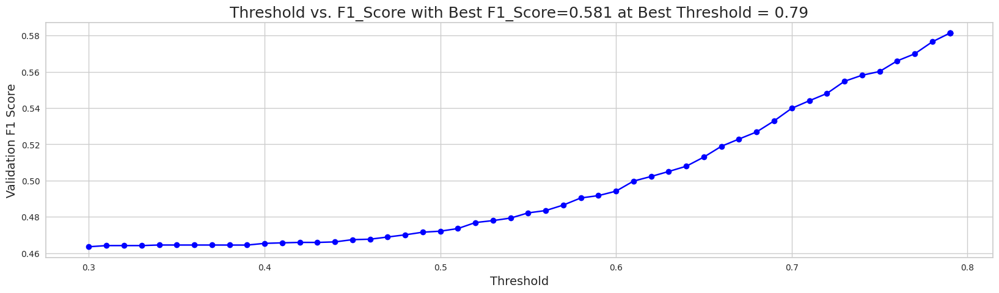

When using optimal threshold = 0.79...
Q0: F1 = 0.5814003610530833
==> Overall F1 = 0.5814003610530833
s
[I 2023-05-23 03:10:31,815] Trial 27 finished with value: 0.5814003610530833 and parameters: {'num_leaves': 37, 'learning_rate': 0.014505910353011551, 'feature_fraction': 0.35698966129353576, 'bagging_fraction': 0.5900005801837431, 'bagging_freq': 10, 'min_child_samples': 64, 'reg_alpha': 0.19084017088576208, 'reg_lambda': 0.10177843364737, 'subsample': 0.8916991378370248, 'colsample_bytree': 0.8218276355248733, 'min_split_gain': 0.00227046829912259, 'max_depth': 3}. Best is trial 15 with value: 0.5826672928669456.


--------------------------------------------------
question12, with210features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.578951024031786, subsample=0.7022504581946266 will be ignored. Current value: bagging_fraction=0.578951024031786
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=7, subsample_freq=0 will be ignored. Current value: bagging_freq=7
[LightGBM] [Warning] feature_fraction is set=0.3520124767084258, colsample_bytree=0.8406697139892763 will be ignored. Current value: feature_fraction=0.3520124767084258


,mean
feature,
hover_duration_mean,86.4
tunic.historicalsociety.frontdesk_room_fqid_counts,82.0
9_level_counts,52.4
reader_fqid_counts,48.8
tunic.historicalsociety.frontdesk.archivist.foundtheodora_text_fqid_counts,48.4
elapsed_time_diff_std,46.6
room_coor_x_min,46.4
11_level_counts,45.8
hover_duration_std,44.2


[[0.25749932 0.74250068]
 [0.14411514 0.85588486]
 [0.10023426 0.89976574]
 ...
 [0.09378229 0.90621771]
 [0.05652179 0.94347821]
 [0.09603856 0.90396144]]


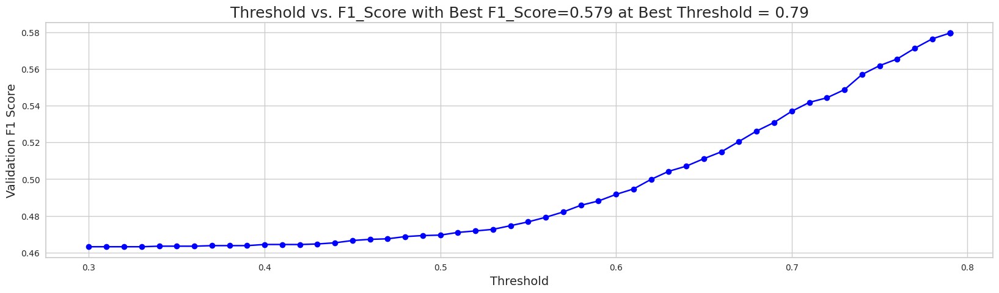

When using optimal threshold = 0.79...
Q0: F1 = 0.5794334981415626
==> Overall F1 = 0.5794334981415626
s
[I 2023-05-23 03:10:41,939] Trial 29 finished with value: 0.5794334981415626 and parameters: {'num_leaves': 38, 'learning_rate': 0.013159155441408745, 'feature_fraction': 0.3773555322310119, 'bagging_fraction': 0.6239260786623522, 'bagging_freq': 10, 'min_child_samples': 67, 'reg_alpha': 0.18327013351951718, 'reg_lambda': 2.7594094980095503, 'subsample': 0.9243807359015919, 'colsample_bytree': 0.8279340373470513, 'min_split_gain': 0.0020946852024258697, 'max_depth': 3}. Best is trial 15 with value: 0.5826672928669456.


--------------------------------------------------
question12, with210features
--------------------------------------------------
[LightGBM] [Warning] bagging_fraction is set=0.377422296514439, subsample=0.9536751797877419 will be ignored. Current value: bagging_fraction=0.377422296514439
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=7, subsample_freq=0 will be ignored. Current value: bagging_freq=7
[LightGBM] [Warning] feature_fraction is set=0.35729326427044045, colsample_bytree=0.8160928421929745 will be ignored. Current value: feature_fraction=0.35729326427044045


,mean
feature,
hover_duration_mean,121.0
tunic.historicalsociety.frontdesk_room_fqid_counts,99.8
hover_duration_std,90.4
elapsed_time_diff_std,79.8
room_coor_x_min,79.6
session_id,73.0
9_level_counts,71.8
room_coor_y_max,67.0
screen_coor_y_mean,66.8


[LightGBM] [Warning] bagging_fraction is set=0.5720928089842237, subsample=0.8679413349887222 will be ignored. Current value: bagging_fraction=0.5720928089842237
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=7, subsample_freq=0 will be ignored. Current value: bagging_freq=7
[LightGBM] [Warning] feature_fraction is set=0.3530360894405996, colsample_bytree=0.9193777232171023 will be ignored. Current value: feature_fraction=0.3530360894405996
[[0.32255331 0.67744669]
 [0.17961124 0.82038876]
 [0.10268809 0.89731191]
 ...
 [0.08736005 0.91263995]
 [0.04970151 0.95029849]
 [0.10242875 0.89757125]]


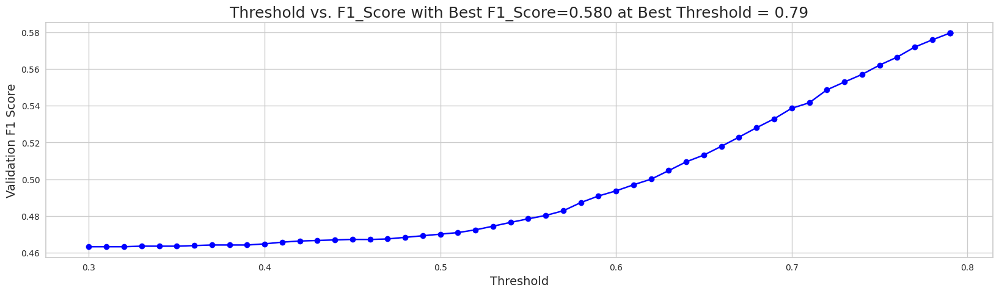

When using optimal threshold = 0.79...
Q0: F1 = 0.5796016650373728
==> Overall F1 = 0.5796016650373728
s
[I 2023-05-23 03:10:46,442] Trial 28 finished with value: 0.5796016650373728 and parameters: {'num_leaves': 40, 'learning_rate': 0.014328072823379391, 'feature_fraction': 0.3482404806286704, 'bagging_fraction': 0.5937004697408739, 'bagging_freq': 10, 'min_child_samples': 67, 'reg_alpha': 0.16939739606996365, 'reg_lambda': 2.8945937273813427, 'subsample': 0.8960752640525248, 'colsample_bytree': 0.8408736968886927, 'min_split_gain': 0.002188969129105615, 'max_depth': 4}. Best is trial 15 with value: 0.5826672928669456.


--------------------------------------------------
question12, with210features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.5477581362374797, subsample=0.84495620846785 will be ignored. Current value: bagging_fraction=0.5477581362374797
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=7, subsample_freq=0 will be ignored. Current value: bagging_freq=7
[LightGBM] [Warning] feature_fraction is set=0.336334089301516, colsample_bytree=0.9037508478151356 will be ignored. Current value: feature_fraction=0.336334089301516


[LightGBM] [Warning] bagging_fraction is set=0.578951024031786, subsample=0.7022504581946266 will be ignored. Current value: bagging_fraction=0.578951024031786
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=7, subsample_freq=0 will be ignored. Current value: bagging_freq=7
[LightGBM] [Warning] feature_fraction is set=0.3520124767084258, colsample_bytree=0.8406697139892763 will be ignored. Current value: feature_fraction=0.3520124767084258


[LightGBM] [Warning] bagging_fraction is set=0.377422296514439, subsample=0.9536751797877419 will be ignored. Current value: bagging_fraction=0.377422296514439
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=7, subsample_freq=0 will be ignored. Current value: bagging_freq=7
[LightGBM] [Warning] feature_fraction is set=0.35729326427044045, colsample_bytree=0.8160928421929745 will be ignored. Current value: feature_fraction=0.35729326427044045


[LightGBM] [Warning] bagging_fraction is set=0.5720928089842237, subsample=0.8679413349887222 will be ignored. Current value: bagging_fraction=0.5720928089842237
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=7, subsample_freq=0 will be ignored. Current value: bagging_freq=7
[LightGBM] [Warning] feature_fraction is set=0.3530360894405996, colsample_bytree=0.9193777232171023 will be ignored. Current value: feature_fraction=0.3530360894405996


[LightGBM] [Warning] bagging_fraction is set=0.578951024031786, subsample=0.7022504581946266 will be ignored. Current value: bagging_fraction=0.578951024031786
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=7, subsample_freq=0 will be ignored. Current value: bagging_freq=7
[LightGBM] [Warning] feature_fraction is set=0.3520124767084258, colsample_bytree=0.8406697139892763 will be ignored. Current value: feature_fraction=0.3520124767084258


[LightGBM] [Warning] bagging_fraction is set=0.5477581362374797, subsample=0.84495620846785 will be ignored. Current value: bagging_fraction=0.5477581362374797
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=7, subsample_freq=0 will be ignored. Current value: bagging_freq=7
[LightGBM] [Warning] feature_fraction is set=0.336334089301516, colsample_bytree=0.9037508478151356 will be ignored. Current value: feature_fraction=0.336334089301516


,mean
feature,
hover_duration_mean,97.4
hover_duration_std,80.8
tunic.historicalsociety.frontdesk_room_fqid_counts,76.2
room_coor_x_min,63.8
9_level_counts,61.6
room_coor_y_max,60.6
session_id,60.0
elapsed_time_diff_std,59.8
hover_duration_max,58.4


[[0.2630827  0.7369173 ]
 [0.13692964 0.86307036]
 [0.09631007 0.90368993]
 ...
 [0.09032847 0.90967153]
 [0.05236863 0.94763137]
 [0.11064329 0.88935671]]


[LightGBM] [Warning] bagging_fraction is set=0.578951024031786, subsample=0.7022504581946266 will be ignored. Current value: bagging_fraction=0.578951024031786
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=7, subsample_freq=0 will be ignored. Current value: bagging_freq=7
[LightGBM] [Warning] feature_fraction is set=0.3520124767084258, colsample_bytree=0.8406697139892763 will be ignored. Current value: feature_fraction=0.3520124767084258


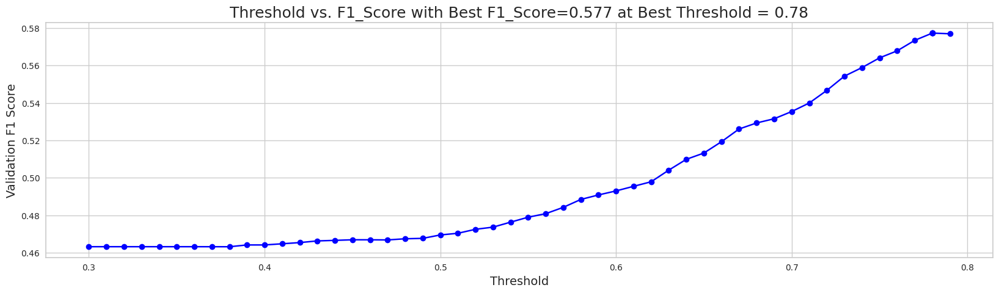

When using optimal threshold = 0.78...
Q0: F1 = 0.5772804148013388
==> Overall F1 = 0.5772804148013388
s
[I 2023-05-23 03:11:17,133] Trial 30 finished with value: 0.5772804148013388 and parameters: {'num_leaves': 19, 'learning_rate': 0.013177183711281102, 'feature_fraction': 0.35729326427044045, 'bagging_fraction': 0.377422296514439, 'bagging_freq': 7, 'min_child_samples': 62, 'reg_alpha': 0.21819872230506335, 'reg_lambda': 2.7615202232776093, 'subsample': 0.9536751797877419, 'colsample_bytree': 0.8160928421929745, 'min_split_gain': 0.0018120304522159698, 'max_depth': 4}. Best is trial 15 with value: 0.5826672928669456.


--------------------------------------------------
question12, with210features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.5720928089842237, subsample=0.8679413349887222 will be ignored. Current value: bagging_fraction=0.5720928089842237
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=7, subsample_freq=0 will be ignored. Current value: bagging_freq=7
[LightGBM] [Warning] feature_fraction is set=0.3530360894405996, colsample_bytree=0.9193777232171023 will be ignored. Current value: feature_fraction=0.3530360894405996


[LightGBM] [Warning] bagging_fraction is set=0.7260975787368045, subsample=0.8367191041665837 will be ignored. Current value: bagging_fraction=0.7260975787368045
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
[LightGBM] [Warning] feature_fraction is set=0.1758111310720966, colsample_bytree=0.8932233428237913 will be ignored. Current value: feature_fraction=0.1758111310720966


[LightGBM] [Warning] bagging_fraction is set=0.5477581362374797, subsample=0.84495620846785 will be ignored. Current value: bagging_fraction=0.5477581362374797
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=7, subsample_freq=0 will be ignored. Current value: bagging_freq=7
[LightGBM] [Warning] feature_fraction is set=0.336334089301516, colsample_bytree=0.9037508478151356 will be ignored. Current value: feature_fraction=0.336334089301516


[LightGBM] [Warning] bagging_fraction is set=0.578951024031786, subsample=0.7022504581946266 will be ignored. Current value: bagging_fraction=0.578951024031786
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=7, subsample_freq=0 will be ignored. Current value: bagging_freq=7
[LightGBM] [Warning] feature_fraction is set=0.3520124767084258, colsample_bytree=0.8406697139892763 will be ignored. Current value: feature_fraction=0.3520124767084258


[LightGBM] [Warning] bagging_fraction is set=0.5720928089842237, subsample=0.8679413349887222 will be ignored. Current value: bagging_fraction=0.5720928089842237
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=7, subsample_freq=0 will be ignored. Current value: bagging_freq=7
[LightGBM] [Warning] feature_fraction is set=0.3530360894405996, colsample_bytree=0.9193777232171023 will be ignored. Current value: feature_fraction=0.3530360894405996


[LightGBM] [Warning] bagging_fraction is set=0.5477581362374797, subsample=0.84495620846785 will be ignored. Current value: bagging_fraction=0.5477581362374797
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=7, subsample_freq=0 will be ignored. Current value: bagging_freq=7
[LightGBM] [Warning] feature_fraction is set=0.336334089301516, colsample_bytree=0.9037508478151356 will be ignored. Current value: feature_fraction=0.336334089301516


[LightGBM] [Warning] bagging_fraction is set=0.7260975787368045, subsample=0.8367191041665837 will be ignored. Current value: bagging_fraction=0.7260975787368045
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
[LightGBM] [Warning] feature_fraction is set=0.1758111310720966, colsample_bytree=0.8932233428237913 will be ignored. Current value: feature_fraction=0.1758111310720966


[LightGBM] [Warning] bagging_fraction is set=0.5720928089842237, subsample=0.8679413349887222 will be ignored. Current value: bagging_fraction=0.5720928089842237
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=7, subsample_freq=0 will be ignored. Current value: bagging_freq=7
[LightGBM] [Warning] feature_fraction is set=0.3530360894405996, colsample_bytree=0.9193777232171023 will be ignored. Current value: feature_fraction=0.3530360894405996


,mean
feature,
hover_duration_mean,106.2
tunic.historicalsociety.frontdesk_room_fqid_counts,82.6
hover_duration_std,72.0
elapsed_time_diff_std,67.8
room_coor_x_min,63.4
9_level_counts,58.2
screen_coor_y_mean,55.2
session_id,55.2
11_level_counts,55.0


[[0.27241729 0.72758271]
 [0.13464489 0.86535511]
 [0.10189185 0.89810815]
 ...
 [0.08238013 0.91761987]
 [0.04791879 0.95208121]
 [0.10805163 0.89194837]]


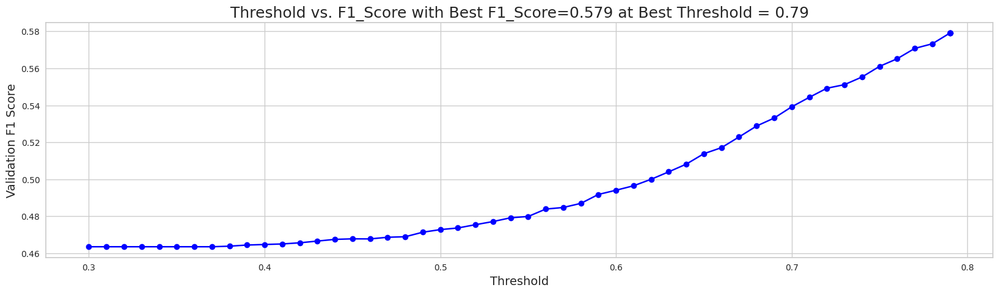

When using optimal threshold = 0.79...
Q0: F1 = 0.5790632946453396
==> Overall F1 = 0.5790632946453396
s
[I 2023-05-23 03:11:51,490] Trial 31 finished with value: 0.5790632946453396 and parameters: {'num_leaves': 41, 'learning_rate': 0.01352464441934294, 'feature_fraction': 0.3520124767084258, 'bagging_fraction': 0.578951024031786, 'bagging_freq': 7, 'min_child_samples': 67, 'reg_alpha': 0.31729215315619413, 'reg_lambda': 0.07427992070399538, 'subsample': 0.7022504581946266, 'colsample_bytree': 0.8406697139892763, 'min_split_gain': 0.0019883723091114643, 'max_depth': 4}. Best is trial 15 with value: 0.5826672928669456.


--------------------------------------------------
question12, with210features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.7197065451378655, subsample=0.8689012260032078 will be ignored. Current value: bagging_fraction=0.7197065451378655
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
[LightGBM] [Warning] feature_fraction is set=0.18395345281042313, colsample_bytree=0.9162139465953185 will be ignored. Current value: feature_fraction=0.18395345281042313


[LightGBM] [Warning] bagging_fraction is set=0.7260975787368045, subsample=0.8367191041665837 will be ignored. Current value: bagging_fraction=0.7260975787368045
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
[LightGBM] [Warning] feature_fraction is set=0.1758111310720966, colsample_bytree=0.8932233428237913 will be ignored. Current value: feature_fraction=0.1758111310720966


,mean
feature,
hover_duration_mean,134.8
session_id,126.4
hover_duration_std,120.2
room_coor_x_min,116.2
screen_coor_y_std,109.8
elapsed_time_diff_std,103.8
room_coor_y_max,99.4
room_coor_y_min,98.4
room_coor_x_std,97.6


[[0.32373255 0.67626745]
 [0.11456907 0.88543093]
 [0.0750157  0.9249843 ]
 ...
 [0.08771925 0.91228075]
 [0.04597271 0.95402729]
 [0.12834223 0.87165777]]


[LightGBM] [Warning] bagging_fraction is set=0.5477581362374797, subsample=0.84495620846785 will be ignored. Current value: bagging_fraction=0.5477581362374797
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=7, subsample_freq=0 will be ignored. Current value: bagging_freq=7
[LightGBM] [Warning] feature_fraction is set=0.336334089301516, colsample_bytree=0.9037508478151356 will be ignored. Current value: feature_fraction=0.336334089301516


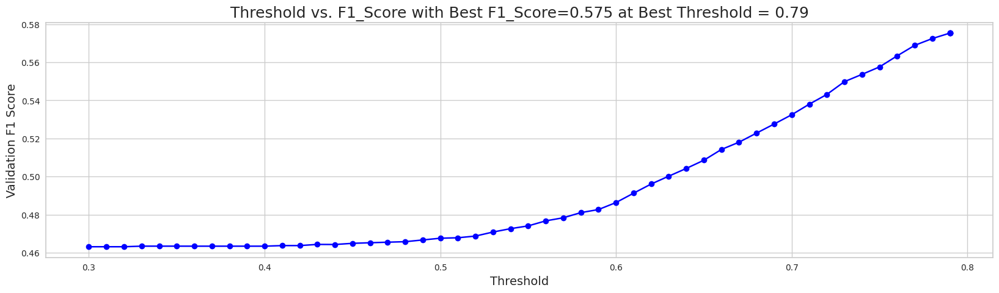

When using optimal threshold = 0.79...
Q0: F1 = 0.5753188336089919
==> Overall F1 = 0.5753188336089919
s
[I 2023-05-23 03:12:03,636] Trial 32 finished with value: 0.5753188336089919 and parameters: {'num_leaves': 65, 'learning_rate': 0.026235457726702133, 'feature_fraction': 0.3530360894405996, 'bagging_fraction': 0.5720928089842237, 'bagging_freq': 7, 'min_child_samples': 66, 'reg_alpha': 0.2583131507007994, 'reg_lambda': 0.09446713305986489, 'subsample': 0.8679413349887222, 'colsample_bytree': 0.9193777232171023, 'min_split_gain': 0.001640204245800114, 'max_depth': 0}. Best is trial 15 with value: 0.5826672928669456.


--------------------------------------------------
question12, with210features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.742906836139679, subsample=0.8287945500235762 will be ignored. Current value: bagging_fraction=0.742906836139679
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
[LightGBM] [Warning] feature_fraction is set=0.17749178362425183, colsample_bytree=0.9024670983511868 will be ignored. Current value: feature_fraction=0.17749178362425183


[LightGBM] [Warning] bagging_fraction is set=0.7197065451378655, subsample=0.8689012260032078 will be ignored. Current value: bagging_fraction=0.7197065451378655
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
[LightGBM] [Warning] feature_fraction is set=0.18395345281042313, colsample_bytree=0.9162139465953185 will be ignored. Current value: feature_fraction=0.18395345281042313


[LightGBM] [Warning] bagging_fraction is set=0.7260975787368045, subsample=0.8367191041665837 will be ignored. Current value: bagging_fraction=0.7260975787368045
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
[LightGBM] [Warning] feature_fraction is set=0.1758111310720966, colsample_bytree=0.8932233428237913 will be ignored. Current value: feature_fraction=0.1758111310720966


[LightGBM] [Warning] bagging_fraction is set=0.7197065451378655, subsample=0.8689012260032078 will be ignored. Current value: bagging_fraction=0.7197065451378655
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
[LightGBM] [Warning] feature_fraction is set=0.18395345281042313, colsample_bytree=0.9162139465953185 will be ignored. Current value: feature_fraction=0.18395345281042313


,mean
feature,
hover_duration_mean,137.0
session_id,124.8
hover_duration_std,121.0
room_coor_x_min,118.2
room_coor_y_max,103.2
hover_duration_max,98.6
screen_coor_y_std,96.6
room_coor_x_max,95.8
elapsed_time_diff_std,94.0


[[0.34354058 0.65645942]
 [0.11841481 0.88158519]
 [0.10504372 0.89495628]
 ...
 [0.08500076 0.91499924]
 [0.05067871 0.94932129]
 [0.11388123 0.88611877]]


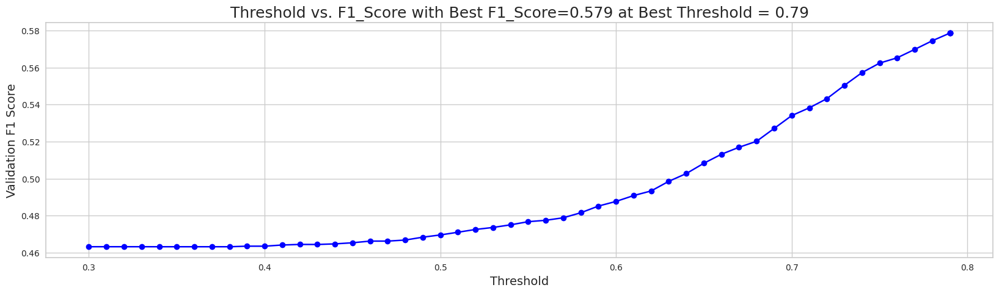

When using optimal threshold = 0.79...
Q0: F1 = 0.5786299429228432
==> Overall F1 = 0.5786299429228432
s
[I 2023-05-23 03:12:20,064] Trial 33 finished with value: 0.5786299429228432 and parameters: {'num_leaves': 59, 'learning_rate': 0.0249010744938753, 'feature_fraction': 0.336334089301516, 'bagging_fraction': 0.5477581362374797, 'bagging_freq': 7, 'min_child_samples': 67, 'reg_alpha': 0.06401202040508282, 'reg_lambda': 0.08125760110652576, 'subsample': 0.84495620846785, 'colsample_bytree': 0.9037508478151356, 'min_split_gain': 0.011430479333325543, 'max_depth': 0}. Best is trial 15 with value: 0.5826672928669456.


--------------------------------------------------
question12, with210features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.6960056827229887, subsample=0.9423426463506571 will be ignored. Current value: bagging_fraction=0.6960056827229887
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=10, subsample_freq=0 will be ignored. Current value: bagging_freq=10
[LightGBM] [Warning] feature_fraction is set=0.18844574652498208, colsample_bytree=0.8916741718135337 will be ignored. Current value: feature_fraction=0.18844574652498208


[LightGBM] [Warning] bagging_fraction is set=0.742906836139679, subsample=0.8287945500235762 will be ignored. Current value: bagging_fraction=0.742906836139679
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
[LightGBM] [Warning] feature_fraction is set=0.17749178362425183, colsample_bytree=0.9024670983511868 will be ignored. Current value: feature_fraction=0.17749178362425183


[LightGBM] [Warning] bagging_fraction is set=0.7197065451378655, subsample=0.8689012260032078 will be ignored. Current value: bagging_fraction=0.7197065451378655
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
[LightGBM] [Warning] feature_fraction is set=0.18395345281042313, colsample_bytree=0.9162139465953185 will be ignored. Current value: feature_fraction=0.18395345281042313


[LightGBM] [Warning] bagging_fraction is set=0.7260975787368045, subsample=0.8367191041665837 will be ignored. Current value: bagging_fraction=0.7260975787368045
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
[LightGBM] [Warning] feature_fraction is set=0.1758111310720966, colsample_bytree=0.8932233428237913 will be ignored. Current value: feature_fraction=0.1758111310720966


[LightGBM] [Warning] bagging_fraction is set=0.7197065451378655, subsample=0.8689012260032078 will be ignored. Current value: bagging_fraction=0.7197065451378655
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
[LightGBM] [Warning] feature_fraction is set=0.18395345281042313, colsample_bytree=0.9162139465953185 will be ignored. Current value: feature_fraction=0.18395345281042313
[LightGBM] [Warning] bagging_fraction is set=0.742906836139679, subsample=0.8287945500235762 will be ignored. Current value: bagging_fraction=0.742906836139679
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
[LightGBM] [Warning] fe

[LightGBM] [Warning] bagging_fraction is set=0.6960056827229887, subsample=0.9423426463506571 will be ignored. Current value: bagging_fraction=0.6960056827229887
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=10, subsample_freq=0 will be ignored. Current value: bagging_freq=10
[LightGBM] [Warning] feature_fraction is set=0.18844574652498208, colsample_bytree=0.8916741718135337 will be ignored. Current value: feature_fraction=0.18844574652498208


,mean
feature,
hover_duration_std,83.4
hover_duration_sum,76.0
room_corr_x_diff_std,66.2
room_coor_x_min,65.2
screen_coor_y_min,61.6
session_id,60.8
room_coor_x_std,58.0
room_corr_y_diff_sum,57.8
archivist_fqid_counts,57.8


[[0.31368764 0.68631236]
 [0.1363742  0.8636258 ]
 [0.07661704 0.92338296]
 ...
 [0.11645971 0.88354029]
 [0.05279919 0.94720081]
 [0.08432321 0.91567679]]


[LightGBM] [Warning] bagging_fraction is set=0.742906836139679, subsample=0.8287945500235762 will be ignored. Current value: bagging_fraction=0.742906836139679
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
[LightGBM] [Warning] feature_fraction is set=0.17749178362425183, colsample_bytree=0.9024670983511868 will be ignored. Current value: feature_fraction=0.17749178362425183


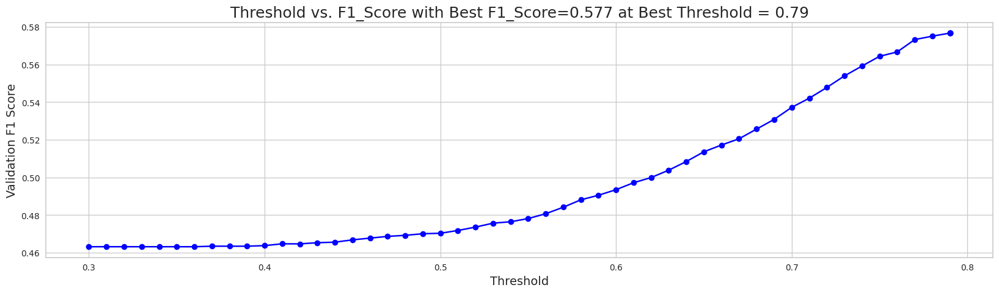

When using optimal threshold = 0.79...
Q0: F1 = 0.5767241995660353
==> Overall F1 = 0.5767241995660353
s
[I 2023-05-23 03:12:53,333] Trial 35 finished with value: 0.5767241995660353 and parameters: {'num_leaves': 23, 'learning_rate': 0.02583193801216437, 'feature_fraction': 0.18395345281042313, 'bagging_fraction': 0.7197065451378655, 'bagging_freq': 6, 'min_child_samples': 47, 'reg_alpha': 0.10050149326515724, 'reg_lambda': 0.34351753378721794, 'subsample': 0.8689012260032078, 'colsample_bytree': 0.9162139465953185, 'min_split_gain': 0.001370260237245726, 'max_depth': 0}. Best is trial 15 with value: 0.5826672928669456.


--------------------------------------------------
question12, with210features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.7405227176607275, subsample=0.9495018457849472 will be ignored. Current value: bagging_fraction=0.7405227176607275
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=10, subsample_freq=0 will be ignored. Current value: bagging_freq=10
[LightGBM] [Warning] feature_fraction is set=0.16470192558984542, colsample_bytree=0.6680110613782465 will be ignored. Current value: feature_fraction=0.16470192558984542


,mean
feature,
hover_duration_std,208.0
room_coor_x_std,145.4
elapsed_time_diff_mean,142.2
room_coor_x_min,141.8
room_coor_y_mean,138.0
archivist_fqid_counts,134.4
screen_coor_x_sum,129.4
reader_fqid_counts,127.4
room_corr_x_diff_std,121.6


[[0.24420986 0.75579014]
 [0.12636466 0.87363534]
 [0.10802024 0.89197976]
 ...
 [0.07796635 0.92203365]
 [0.05529646 0.94470354]
 [0.10043328 0.89956672]]


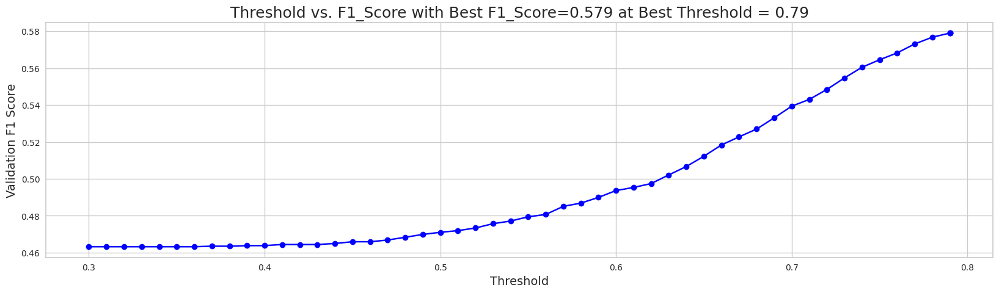

When using optimal threshold = 0.79...
Q0: F1 = 0.5789979543603436
==> Overall F1 = 0.5789979543603436
s
[I 2023-05-23 03:13:00,276] Trial 34 finished with value: 0.5789979543603436 and parameters: {'num_leaves': 20, 'learning_rate': 0.010053758395291107, 'feature_fraction': 0.1758111310720966, 'bagging_fraction': 0.7260975787368045, 'bagging_freq': 6, 'min_child_samples': 70, 'reg_alpha': 0.06623788853085924, 'reg_lambda': 0.07672704515458877, 'subsample': 0.8367191041665837, 'colsample_bytree': 0.8932233428237913, 'min_split_gain': 0.0016385086412589074, 'max_depth': 0}. Best is trial 15 with value: 0.5826672928669456.


--------------------------------------------------
question12, with210features
--------------------------------------------------
[LightGBM] [Warning] bagging_fraction is set=0.6960056827229887, subsample=0.9423426463506571 will be ignored. Current value: bagging_fraction=0.6960056827229887
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=10, subsample_freq=0 will be ignored. Current value: bagging_freq=10
[LightGBM] [Warning] feature_fraction is set=0.18844574652498208, colsample_bytree=0.8916741718135337 will be ignored. Current value: feature_fraction=0.18844574652498208


[LightGBM] [Warning] bagging_fraction is set=0.38126472017891444, subsample=0.9433316322689216 will be ignored. Current value: bagging_fraction=0.38126472017891444
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=10, subsample_freq=0 will be ignored. Current value: bagging_freq=10
[LightGBM] [Warning] feature_fraction is set=0.10678531920571449, colsample_bytree=0.778217433035539 will be ignored. Current value: feature_fraction=0.10678531920571449


[LightGBM] [Warning] bagging_fraction is set=0.742906836139679, subsample=0.8287945500235762 will be ignored. Current value: bagging_fraction=0.742906836139679
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
[LightGBM] [Warning] feature_fraction is set=0.17749178362425183, colsample_bytree=0.9024670983511868 will be ignored. Current value: feature_fraction=0.17749178362425183


[LightGBM] [Warning] bagging_fraction is set=0.38126472017891444, subsample=0.9433316322689216 will be ignored. Current value: bagging_fraction=0.38126472017891444
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=10, subsample_freq=0 will be ignored. Current value: bagging_freq=10
[LightGBM] [Warning] feature_fraction is set=0.10678531920571449, colsample_bytree=0.778217433035539 will be ignored. Current value: feature_fraction=0.10678531920571449


[LightGBM] [Warning] bagging_fraction is set=0.7405227176607275, subsample=0.9495018457849472 will be ignored. Current value: bagging_fraction=0.7405227176607275
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=10, subsample_freq=0 will be ignored. Current value: bagging_freq=10
[LightGBM] [Warning] feature_fraction is set=0.16470192558984542, colsample_bytree=0.6680110613782465 will be ignored. Current value: feature_fraction=0.16470192558984542


[LightGBM] [Warning] bagging_fraction is set=0.6960056827229887, subsample=0.9423426463506571 will be ignored. Current value: bagging_fraction=0.6960056827229887
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=10, subsample_freq=0 will be ignored. Current value: bagging_freq=10
[LightGBM] [Warning] feature_fraction is set=0.18844574652498208, colsample_bytree=0.8916741718135337 will be ignored. Current value: feature_fraction=0.18844574652498208


[LightGBM] [Warning] bagging_fraction is set=0.38126472017891444, subsample=0.9433316322689216 will be ignored. Current value: bagging_fraction=0.38126472017891444
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=10, subsample_freq=0 will be ignored. Current value: bagging_freq=10
[LightGBM] [Warning] feature_fraction is set=0.10678531920571449, colsample_bytree=0.778217433035539 will be ignored. Current value: feature_fraction=0.10678531920571449


[LightGBM] [Warning] bagging_fraction is set=0.7405227176607275, subsample=0.9495018457849472 will be ignored. Current value: bagging_fraction=0.7405227176607275
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=10, subsample_freq=0 will be ignored. Current value: bagging_freq=10
[LightGBM] [Warning] feature_fraction is set=0.16470192558984542, colsample_bytree=0.6680110613782465 will be ignored. Current value: feature_fraction=0.16470192558984542


,mean
feature,
tunic.historicalsociety.frontdesk_room_fqid_counts,88.4
hover_duration_mean,76.6
tunic.historicalsociety.frontdesk.archivist.foundtheodora_text_fqid_counts,57.0
tunic.historicalsociety.closet_dirty.door_block_talk_text_fqid_counts,55.2
door_block_talk_fqid_counts,53.8
elapsed_time_diff_std,43.6
11_level_counts,43.6
logbook_fqid_counts,41.8
click_counts,39.4


[[0.22063694 0.77936306]
 [0.1292532  0.8707468 ]
 [0.09763373 0.90236627]
 ...
 [0.09317884 0.90682116]
 [0.06155121 0.93844879]
 [0.09862163 0.90137837]]


[LightGBM] [Warning] bagging_fraction is set=0.38126472017891444, subsample=0.9433316322689216 will be ignored. Current value: bagging_fraction=0.38126472017891444
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=10, subsample_freq=0 will be ignored. Current value: bagging_freq=10
[LightGBM] [Warning] feature_fraction is set=0.10678531920571449, colsample_bytree=0.778217433035539 will be ignored. Current value: feature_fraction=0.10678531920571449


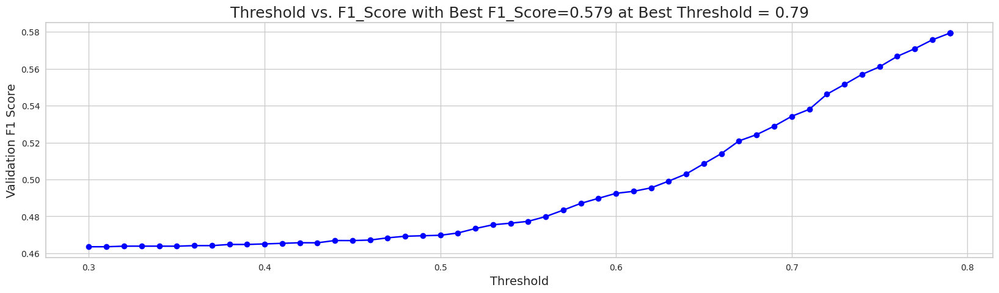

When using optimal threshold = 0.79...
Q0: F1 = 0.579357455050119
==> Overall F1 = 0.579357455050119
s
[I 2023-05-23 03:13:27,280] Trial 36 finished with value: 0.579357455050119 and parameters: {'num_leaves': 23, 'learning_rate': 0.010492435349797944, 'feature_fraction': 0.17749178362425183, 'bagging_fraction': 0.742906836139679, 'bagging_freq': 6, 'min_child_samples': 15, 'reg_alpha': 0.11129400085857326, 'reg_lambda': 0.27804678194707116, 'subsample': 0.8287945500235762, 'colsample_bytree': 0.9024670983511868, 'min_split_gain': 0.004277850342817682, 'max_depth': 2}. Best is trial 15 with value: 0.5826672928669456.


--------------------------------------------------
question12, with210features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.6672192326988435, subsample=0.931921833335432 will be ignored. Current value: bagging_fraction=0.6672192326988435
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=10, subsample_freq=0 will be ignored. Current value: bagging_freq=10
[LightGBM] [Warning] feature_fraction is set=0.1090770687249874, colsample_bytree=0.6510276085712309 will be ignored. Current value: feature_fraction=0.1090770687249874


[LightGBM] [Warning] bagging_fraction is set=0.6960056827229887, subsample=0.9423426463506571 will be ignored. Current value: bagging_fraction=0.6960056827229887
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=10, subsample_freq=0 will be ignored. Current value: bagging_freq=10
[LightGBM] [Warning] feature_fraction is set=0.18844574652498208, colsample_bytree=0.8916741718135337 will be ignored. Current value: feature_fraction=0.18844574652498208


[LightGBM] [Warning] bagging_fraction is set=0.7405227176607275, subsample=0.9495018457849472 will be ignored. Current value: bagging_fraction=0.7405227176607275
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=10, subsample_freq=0 will be ignored. Current value: bagging_freq=10
[LightGBM] [Warning] feature_fraction is set=0.16470192558984542, colsample_bytree=0.6680110613782465 will be ignored. Current value: feature_fraction=0.16470192558984542


[LightGBM] [Warning] bagging_fraction is set=0.38126472017891444, subsample=0.9433316322689216 will be ignored. Current value: bagging_fraction=0.38126472017891444
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=10, subsample_freq=0 will be ignored. Current value: bagging_freq=10
[LightGBM] [Warning] feature_fraction is set=0.10678531920571449, colsample_bytree=0.778217433035539 will be ignored. Current value: feature_fraction=0.10678531920571449


[LightGBM] [Warning] bagging_fraction is set=0.6672192326988435, subsample=0.931921833335432 will be ignored. Current value: bagging_fraction=0.6672192326988435
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=10, subsample_freq=0 will be ignored. Current value: bagging_freq=10
[LightGBM] [Warning] feature_fraction is set=0.1090770687249874, colsample_bytree=0.6510276085712309 will be ignored. Current value: feature_fraction=0.1090770687249874


,mean
feature,
session_number,46.2
hover_duration_std,36.0
tunic.historicalsociety.closet_dirty.door_block_talk_text_fqid_counts,34.0
text_fqid_None_text_fqid_counts,28.0
tunic.historicalsociety.frontdesk.archivist.foundtheodora_text_fqid_counts,26.4
tunic.historicalsociety.stacks_room_fqid_counts,26.0
archivist_fqid_counts,25.4
logbook_fqid_counts,24.6
room_corr_x_diff_sum,24.4


[[0.21119212 0.78880788]
 [0.13590344 0.86409656]
 [0.09131997 0.90868003]
 ...
 [0.09577754 0.90422246]
 [0.05980353 0.94019647]
 [0.11872598 0.88127402]]


[LightGBM] [Warning] bagging_fraction is set=0.6672192326988435, subsample=0.931921833335432 will be ignored. Current value: bagging_fraction=0.6672192326988435
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=10, subsample_freq=0 will be ignored. Current value: bagging_freq=10
[LightGBM] [Warning] feature_fraction is set=0.1090770687249874, colsample_bytree=0.6510276085712309 will be ignored. Current value: feature_fraction=0.1090770687249874


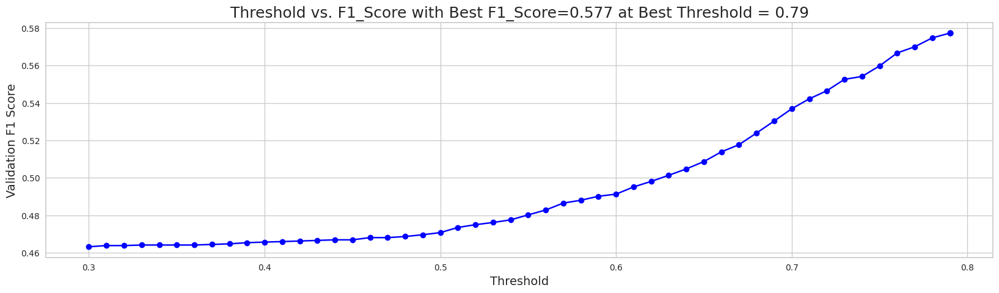

When using optimal threshold = 0.79...
Q0: F1 = 0.5772294712568774
==> Overall F1 = 0.5772294712568774
s
[I 2023-05-23 03:13:48,278] Trial 39 finished with value: 0.5772294712568774 and parameters: {'num_leaves': 10, 'learning_rate': 0.015251814945806672, 'feature_fraction': 0.10678531920571449, 'bagging_fraction': 0.38126472017891444, 'bagging_freq': 10, 'min_child_samples': 14, 'reg_alpha': 0.11763061586874474, 'reg_lambda': 0.19854268614276935, 'subsample': 0.9433316322689216, 'colsample_bytree': 0.778217433035539, 'min_split_gain': 0.0043646663132835195, 'max_depth': 2}. Best is trial 15 with value: 0.5826672928669456.


--------------------------------------------------
question12, with210features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.671026436389448, subsample=0.9598747240879354 will be ignored. Current value: bagging_fraction=0.671026436389448
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=9, subsample_freq=0 will be ignored. Current value: bagging_freq=9
[LightGBM] [Warning] feature_fraction is set=0.23275829807481685, colsample_bytree=0.6573101786897086 will be ignored. Current value: feature_fraction=0.23275829807481685


[LightGBM] [Warning] bagging_fraction is set=0.6672192326988435, subsample=0.931921833335432 will be ignored. Current value: bagging_fraction=0.6672192326988435
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=10, subsample_freq=0 will be ignored. Current value: bagging_freq=10
[LightGBM] [Warning] feature_fraction is set=0.1090770687249874, colsample_bytree=0.6510276085712309 will be ignored. Current value: feature_fraction=0.1090770687249874


[LightGBM] [Warning] bagging_fraction is set=0.7405227176607275, subsample=0.9495018457849472 will be ignored. Current value: bagging_fraction=0.7405227176607275
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=10, subsample_freq=0 will be ignored. Current value: bagging_freq=10
[LightGBM] [Warning] feature_fraction is set=0.16470192558984542, colsample_bytree=0.6680110613782465 will be ignored. Current value: feature_fraction=0.16470192558984542


,mean
feature,
tunic.historicalsociety.frontdesk_room_fqid_counts,82.8
hover_duration_mean,76.8
tunic.historicalsociety.frontdesk.archivist.foundtheodora_text_fqid_counts,58.0
elapsed_time_diff_std,53.6
tunic.historicalsociety.closet_dirty.door_block_talk_text_fqid_counts,53.6
door_block_talk_fqid_counts,52.8
5_level_counts,49.0
reader_fqid_counts,46.4
logbook_fqid_counts,46.2


[[0.23087207 0.76912793]
 [0.1261254  0.8738746 ]
 [0.10409148 0.89590852]
 ...
 [0.0898186  0.9101814 ]
 [0.05677603 0.94322397]
 [0.1092228  0.8907772 ]]


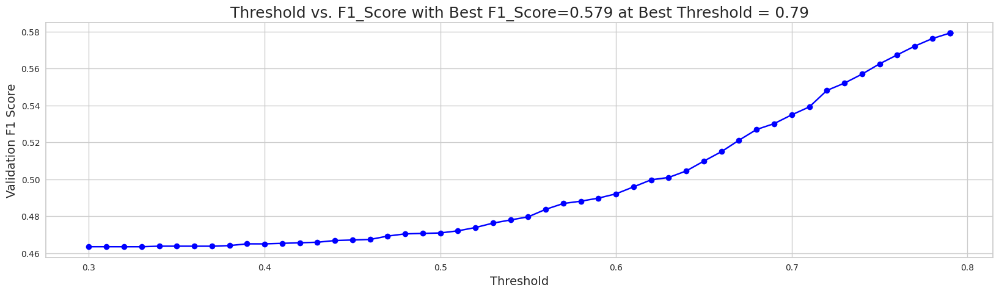

When using optimal threshold = 0.79...
Q0: F1 = 0.5791529969730178
==> Overall F1 = 0.5791529969730178
s
[I 2023-05-23 03:14:00,462] Trial 37 finished with value: 0.5791529969730178 and parameters: {'num_leaves': 22, 'learning_rate': 0.010401092774899713, 'feature_fraction': 0.18844574652498208, 'bagging_fraction': 0.6960056827229887, 'bagging_freq': 10, 'min_child_samples': 48, 'reg_alpha': 0.10680873049090134, 'reg_lambda': 0.35186865797003825, 'subsample': 0.9423426463506571, 'colsample_bytree': 0.8916741718135337, 'min_split_gain': 0.004023309596613463, 'max_depth': 2}. Best is trial 15 with value: 0.5826672928669456.


--------------------------------------------------
question12, with210features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.5341512445417174, subsample=0.9613639599273096 will be ignored. Current value: bagging_fraction=0.5341512445417174
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=9, subsample_freq=0 will be ignored. Current value: bagging_freq=9
[LightGBM] [Warning] feature_fraction is set=0.23474952243354424, colsample_bytree=0.5095195664037423 will be ignored. Current value: feature_fraction=0.23474952243354424


[LightGBM] [Warning] bagging_fraction is set=0.671026436389448, subsample=0.9598747240879354 will be ignored. Current value: bagging_fraction=0.671026436389448
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=9, subsample_freq=0 will be ignored. Current value: bagging_freq=9
[LightGBM] [Warning] feature_fraction is set=0.23275829807481685, colsample_bytree=0.6573101786897086 will be ignored. Current value: feature_fraction=0.23275829807481685


[LightGBM] [Warning] bagging_fraction is set=0.6672192326988435, subsample=0.931921833335432 will be ignored. Current value: bagging_fraction=0.6672192326988435
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=10, subsample_freq=0 will be ignored. Current value: bagging_freq=10
[LightGBM] [Warning] feature_fraction is set=0.1090770687249874, colsample_bytree=0.6510276085712309 will be ignored. Current value: feature_fraction=0.1090770687249874


[LightGBM] [Warning] bagging_fraction is set=0.5341512445417174, subsample=0.9613639599273096 will be ignored. Current value: bagging_fraction=0.5341512445417174
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=9, subsample_freq=0 will be ignored. Current value: bagging_freq=9
[LightGBM] [Warning] feature_fraction is set=0.23474952243354424, colsample_bytree=0.5095195664037423 will be ignored. Current value: feature_fraction=0.23474952243354424


[LightGBM] [Warning] bagging_fraction is set=0.671026436389448, subsample=0.9598747240879354 will be ignored. Current value: bagging_fraction=0.671026436389448
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=9, subsample_freq=0 will be ignored. Current value: bagging_freq=9
[LightGBM] [Warning] feature_fraction is set=0.23275829807481685, colsample_bytree=0.6573101786897086 will be ignored. Current value: feature_fraction=0.23275829807481685


,mean
feature,
tunic.historicalsociety.frontdesk.archivist.foundtheodora_text_fqid_counts,67.2
door_block_talk_fqid_counts,60.4
reader_fqid_counts,53.4
hover_duration_mean,51.8
text_fqid_None_text_fqid_counts,51.2
logbook_fqid_counts,50.8
hover_duration_std,50.4
map_click_event_name_counts,49.4
tunic.historicalsociety.frontdesk_room_fqid_counts,48.8


[[0.23035538 0.76964462]
 [0.14238063 0.85761937]
 [0.09680529 0.90319471]
 ...
 [0.09331098 0.90668902]
 [0.06145607 0.93854393]
 [0.09369558 0.90630442]]


,mean
feature,
tunic.historicalsociety.closet_dirty.door_block_talk_text_fqid_counts,41.0
tunic.historicalsociety.frontdesk.archivist.foundtheodora_text_fqid_counts,39.2
map_click_event_name_counts,37.4
door_block_talk_fqid_counts,36.6
reader_fqid_counts,36.4
text_fqid_None_text_fqid_counts,35.6
tunic.historicalsociety.stacks_room_fqid_counts,35.0
hover_duration_std,31.8
undefined_name_counts,31.8


[[0.25739882 0.74260118]
 [0.15296659 0.84703341]
 [0.10745286 0.89254714]
 ...
 [0.09370178 0.90629822]
 [0.05462713 0.94537287]
 [0.09828871 0.90171129]]


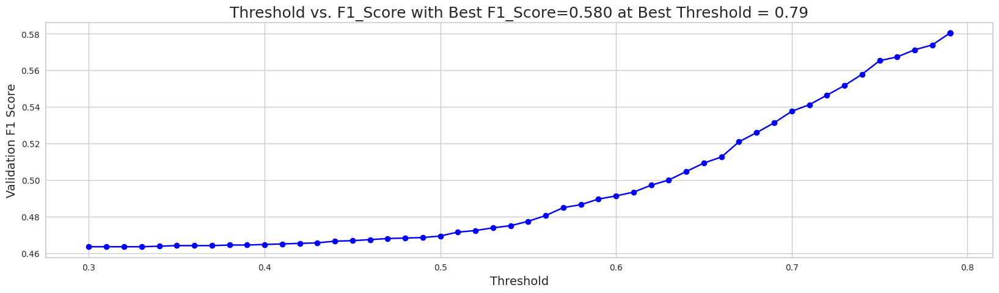

When using optimal threshold = 0.79...


Q0: F1 = 0.5804033550831602
==> Overall F1 = 0.5804033550831602
s
[I 2023-05-23 03:14:20,570] Trial 38 finished with value: 0.5804033550831602 and parameters: {'num_leaves': 21, 'learning_rate': 0.010530394767970483, 'feature_fraction': 0.16470192558984542, 'bagging_fraction': 0.7405227176607275, 'bagging_freq': 10, 'min_child_samples': 93, 'reg_alpha': 0.11208018625772753, 'reg_lambda': 0.153829780281227, 'subsample': 0.9495018457849472, 'colsample_bytree': 0.6680110613782465, 'min_split_gain': 0.004140390136893979, 'max_depth': 2}. Best is trial 15 with value: 0.5826672928669456.


--------------------------------------------------
question12, with210features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.635633327585438, subsample=0.9991114926243774 will be ignored. Current value: bagging_fraction=0.635633327585438
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=9, subsample_freq=0 will be ignored. Current value: bagging_freq=9
[LightGBM] [Warning] feature_fraction is set=0.2390939759398059, colsample_bytree=0.9652721965206399 will be ignored. Current value: feature_fraction=0.2390939759398059


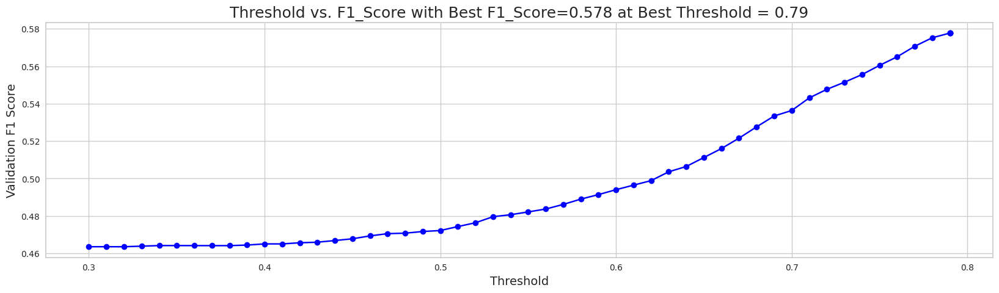

When using optimal threshold = 0.79...
Q0: F1 = 0.5777652086117853
==> Overall F1 = 0.5777652086117853
s
[I 2023-05-23 03:14:23,894] Trial 40 finished with value: 0.5777652086117853 and parameters: {'num_leaves': 34, 'learning_rate': 0.015780270797085535, 'feature_fraction': 0.1090770687249874, 'bagging_fraction': 0.6672192326988435, 'bagging_freq': 10, 'min_child_samples': 48, 'reg_alpha': 0.36508903226836825, 'reg_lambda': 0.16012940899698247, 'subsample': 0.931921833335432, 'colsample_bytree': 0.6510276085712309, 'min_split_gain': 0.0010036347363020022, 'max_depth': 2}. Best is trial 15 with value: 0.5826672928669456.


--------------------------------------------------
question12, with210features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.6246898796838336, subsample=0.9912425215134625 will be ignored. Current value: bagging_fraction=0.6246898796838336
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.4528999658377879, colsample_bytree=0.9891918933820655 will be ignored. Current value: feature_fraction=0.4528999658377879


[LightGBM] [Warning] bagging_fraction is set=0.5341512445417174, subsample=0.9613639599273096 will be ignored. Current value: bagging_fraction=0.5341512445417174
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=9, subsample_freq=0 will be ignored. Current value: bagging_freq=9
[LightGBM] [Warning] feature_fraction is set=0.23474952243354424, colsample_bytree=0.5095195664037423 will be ignored. Current value: feature_fraction=0.23474952243354424


[LightGBM] [Warning] bagging_fraction is set=0.671026436389448, subsample=0.9598747240879354 will be ignored. Current value: bagging_fraction=0.671026436389448
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=9, subsample_freq=0 will be ignored. Current value: bagging_freq=9
[LightGBM] [Warning] feature_fraction is set=0.23275829807481685, colsample_bytree=0.6573101786897086 will be ignored. Current value: feature_fraction=0.23275829807481685


[LightGBM] [Warning] bagging_fraction is set=0.5341512445417174, subsample=0.9613639599273096 will be ignored. Current value: bagging_fraction=0.5341512445417174
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=9, subsample_freq=0 will be ignored. Current value: bagging_freq=9
[LightGBM] [Warning] feature_fraction is set=0.23474952243354424, colsample_bytree=0.5095195664037423 will be ignored. Current value: feature_fraction=0.23474952243354424


[LightGBM] [Warning] bagging_fraction is set=0.635633327585438, subsample=0.9991114926243774 will be ignored. Current value: bagging_fraction=0.635633327585438
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=9, subsample_freq=0 will be ignored. Current value: bagging_freq=9
[LightGBM] [Warning] feature_fraction is set=0.2390939759398059, colsample_bytree=0.9652721965206399 will be ignored. Current value: feature_fraction=0.2390939759398059


[LightGBM] [Warning] bagging_fraction is set=0.671026436389448, subsample=0.9598747240879354 will be ignored. Current value: bagging_fraction=0.671026436389448
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=9, subsample_freq=0 will be ignored. Current value: bagging_freq=9
[LightGBM] [Warning] feature_fraction is set=0.23275829807481685, colsample_bytree=0.6573101786897086 will be ignored. Current value: feature_fraction=0.23275829807481685


[LightGBM] [Warning] bagging_fraction is set=0.6246898796838336, subsample=0.9912425215134625 will be ignored. Current value: bagging_fraction=0.6246898796838336
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.4528999658377879, colsample_bytree=0.9891918933820655 will be ignored. Current value: feature_fraction=0.4528999658377879


[LightGBM] [Warning] bagging_fraction is set=0.5341512445417174, subsample=0.9613639599273096 will be ignored. Current value: bagging_fraction=0.5341512445417174
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=9, subsample_freq=0 will be ignored. Current value: bagging_freq=9
[LightGBM] [Warning] feature_fraction is set=0.23474952243354424, colsample_bytree=0.5095195664037423 will be ignored. Current value: feature_fraction=0.23474952243354424


[LightGBM] [Warning] bagging_fraction is set=0.635633327585438, subsample=0.9991114926243774 will be ignored. Current value: bagging_fraction=0.635633327585438
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=9, subsample_freq=0 will be ignored. Current value: bagging_freq=9
[LightGBM] [Warning] feature_fraction is set=0.2390939759398059, colsample_bytree=0.9652721965206399 will be ignored. Current value: feature_fraction=0.2390939759398059


[LightGBM] [Warning] bagging_fraction is set=0.6246898796838336, subsample=0.9912425215134625 will be ignored. Current value: bagging_fraction=0.6246898796838336
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.4528999658377879, colsample_bytree=0.9891918933820655 will be ignored. Current value: feature_fraction=0.4528999658377879


,mean
feature,
hover_duration_mean,86.4
hover_duration_std,83.4
room_coor_y_max,76.2
room_coor_x_max,71.2
hover_duration_max,71.0
session_id,69.8
room_coor_y_std,62.4
room_coor_x_min,59.4
room_coor_x_std,58.8


[[0.26310786 0.73689214]
 [0.16183385 0.83816615]
 [0.11022568 0.88977432]
 ...
 [0.1010084  0.8989916 ]
 [0.05753771 0.94246229]
 [0.11222933 0.88777067]]


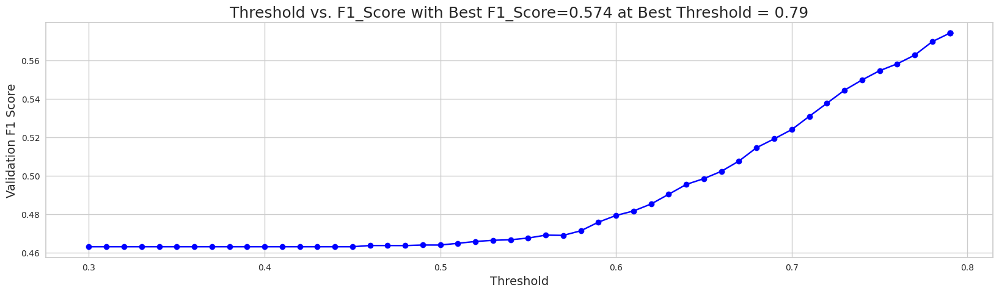

When using optimal threshold = 0.79...
Q0: F1 = 0.5741379430859839
==> Overall F1 = 0.5741379430859839
s
[I 2023-05-23 03:14:57,320] Trial 42 finished with value: 0.5741379430859839 and parameters: {'num_leaves': 50, 'learning_rate': 0.03349202777285202, 'feature_fraction': 0.23474952243354424, 'bagging_fraction': 0.5341512445417174, 'bagging_freq': 9, 'min_child_samples': 92, 'reg_alpha': 5.221858655003988, 'reg_lambda': 0.007240713885351978, 'subsample': 0.9613639599273096, 'colsample_bytree': 0.5095195664037423, 'min_split_gain': 0.0011948484766868348, 'max_depth': 7}. Best is trial 15 with value: 0.5826672928669456.


--------------------------------------------------
question12, with210features
--------------------------------------------------


,mean
feature,
hover_duration_mean,51.2
tunic.historicalsociety.frontdesk_room_fqid_counts,49.2
tunic.historicalsociety.frontdesk.archivist.foundtheodora_text_fqid_counts,37.8
door_block_talk_fqid_counts,35.8
elapsed_time_diff_std,33.6
reader_fqid_counts,29.4
map_click_event_name_counts,29.2
11_level_counts,26.0
logbook_fqid_counts,26.0


[[0.23239375 0.76760625]
 [0.13126546 0.86873454]
 [0.09688923 0.90311077]
 ...
 [0.0856233  0.9143767 ]
 [0.06177864 0.93822136]
 [0.11208732 0.88791268]]


[LightGBM] [Warning] bagging_fraction is set=0.636767670211693, subsample=0.9947857213583995 will be ignored. Current value: bagging_fraction=0.636767670211693
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.4798367453539381, colsample_bytree=0.9864075064202411 will be ignored. Current value: feature_fraction=0.4798367453539381


[LightGBM] [Warning] bagging_fraction is set=0.635633327585438, subsample=0.9991114926243774 will be ignored. Current value: bagging_fraction=0.635633327585438
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=9, subsample_freq=0 will be ignored. Current value: bagging_freq=9
[LightGBM] [Warning] feature_fraction is set=0.2390939759398059, colsample_bytree=0.9652721965206399 will be ignored. Current value: feature_fraction=0.2390939759398059


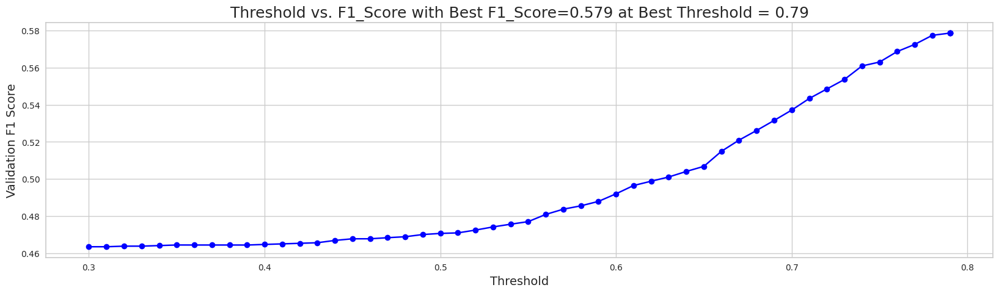

When using optimal threshold = 0.79...
Q0: F1 = 0.5785870977994189
==> Overall F1 = 0.5785870977994189
s
[I 2023-05-23 03:15:01,828] Trial 41 finished with value: 0.5785870977994189 and parameters: {'num_leaves': 34, 'learning_rate': 0.016103558446987118, 'feature_fraction': 0.23275829807481685, 'bagging_fraction': 0.671026436389448, 'bagging_freq': 9, 'min_child_samples': 92, 'reg_alpha': 0.3295581561463548, 'reg_lambda': 0.010730633857028743, 'subsample': 0.9598747240879354, 'colsample_bytree': 0.6573101786897086, 'min_split_gain': 0.0010084652587500265, 'max_depth': 2}. Best is trial 15 with value: 0.5826672928669456.


--------------------------------------------------
question12, with210features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.6377679418421471, subsample=0.9996602951425705 will be ignored. Current value: bagging_fraction=0.6377679418421471
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.46352269662157675, colsample_bytree=0.9809802795130946 will be ignored. Current value: feature_fraction=0.46352269662157675


[LightGBM] [Warning] bagging_fraction is set=0.6246898796838336, subsample=0.9912425215134625 will be ignored. Current value: bagging_fraction=0.6246898796838336
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.4528999658377879, colsample_bytree=0.9891918933820655 will be ignored. Current value: feature_fraction=0.4528999658377879


[LightGBM] [Warning] bagging_fraction is set=0.635633327585438, subsample=0.9991114926243774 will be ignored. Current value: bagging_fraction=0.635633327585438
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=9, subsample_freq=0 will be ignored. Current value: bagging_freq=9
[LightGBM] [Warning] feature_fraction is set=0.2390939759398059, colsample_bytree=0.9652721965206399 will be ignored. Current value: feature_fraction=0.2390939759398059


[LightGBM] [Warning] bagging_fraction is set=0.6246898796838336, subsample=0.9912425215134625 will be ignored. Current value: bagging_fraction=0.6246898796838336
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.4528999658377879, colsample_bytree=0.9891918933820655 will be ignored. Current value: feature_fraction=0.4528999658377879


[LightGBM] [Warning] bagging_fraction is set=0.6377679418421471, subsample=0.9996602951425705 will be ignored. Current value: bagging_fraction=0.6377679418421471
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.46352269662157675, colsample_bytree=0.9809802795130946 will be ignored. Current value: feature_fraction=0.46352269662157675


,mean
feature,
hover_duration_mean,28.8
tunic.historicalsociety.frontdesk_room_fqid_counts,25.0
tunic.historicalsociety.frontdesk.archivist.foundtheodora_text_fqid_counts,18.6
5_level_counts,18.6
elapsed_time_diff_std,18.0
map_click_event_name_counts,14.2
door_block_talk_fqid_counts,13.6
room_coor_x_min,13.4
businesscards.card_bingo.bingo_fqid_counts,13.4


[[0.25058482 0.74941518]
 [0.12777385 0.87222615]
 [0.09561977 0.90438023]
 ...
 [0.09925513 0.90074487]
 [0.06522652 0.93477348]
 [0.10034795 0.89965205]]


[LightGBM] [Warning] bagging_fraction is set=0.636767670211693, subsample=0.9947857213583995 will be ignored. Current value: bagging_fraction=0.636767670211693
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.4798367453539381, colsample_bytree=0.9864075064202411 will be ignored. Current value: feature_fraction=0.4798367453539381


[LightGBM] [Warning] bagging_fraction is set=0.6377679418421471, subsample=0.9996602951425705 will be ignored. Current value: bagging_fraction=0.6377679418421471
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.46352269662157675, colsample_bytree=0.9809802795130946 will be ignored. Current value: feature_fraction=0.46352269662157675


,mean
feature,
hover_duration_mean,112.2
session_id,108.6
hover_duration_std,105.4
room_coor_y_max,94.4
room_coor_x_min,90.6
screen_coor_y_std,86.6
hover_duration_max,86.6
screen_coor_y_mean,86.2
9_level_counts,84.8


[[0.26030242 0.73969758]
 [0.1376008  0.8623992 ]
 [0.09685193 0.90314807]
 ...
 [0.09049016 0.90950984]
 [0.03686511 0.96313489]
 [0.11454401 0.88545599]]


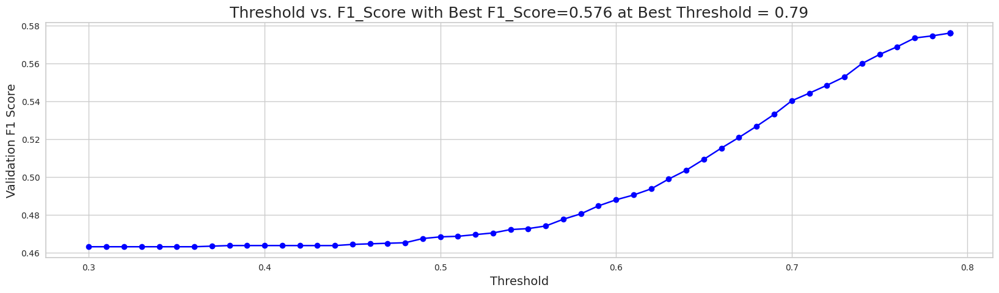

When using optimal threshold = 0.79...
Q0: F1 = 0.5761253645961278


==> Overall F1 = 0.5761253645961278
s
[I 2023-05-23 03:15:29,446] Trial 44 finished with value: 0.5761253645961278 and parameters: {'num_leaves': 49, 'learning_rate': 0.03171287837672178, 'feature_fraction': 0.4528999658377879, 'bagging_fraction': 0.6246898796838336, 'bagging_freq': 1, 'min_child_samples': 73, 'reg_alpha': 6.081644234486357, 'reg_lambda': 0.012470907358262267, 'subsample': 0.9912425215134625, 'colsample_bytree': 0.9891918933820655, 'min_split_gain': 0.041960856833396454, 'max_depth': 1}. Best is trial 15 with value: 0.5826672928669456.


--------------------------------------------------
question12, with210features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.623693117059859, subsample=0.8863579758260346 will be ignored. Current value: bagging_fraction=0.623693117059859
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.5825410345058183, colsample_bytree=0.9527011349549305 will be ignored. Current value: feature_fraction=0.5825410345058183


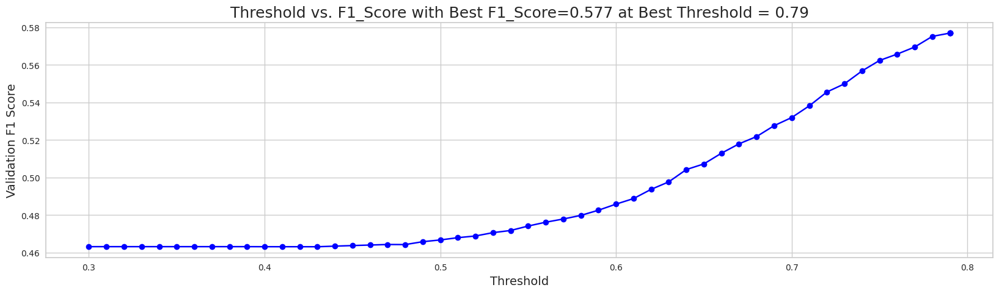

When using optimal threshold = 0.79...
Q0: F1 = 0.5769902456233427
==> Overall F1 = 0.5769902456233427
s
[I 2023-05-23 03:15:32,794] Trial 43 finished with value: 0.5769902456233427 and parameters: {'num_leaves': 49, 'learning_rate': 0.03280011409463692, 'feature_fraction': 0.2390939759398059, 'bagging_fraction': 0.635633327585438, 'bagging_freq': 9, 'min_child_samples': 28, 'reg_alpha': 5.466852252616295, 'reg_lambda': 0.01067650137752299, 'subsample': 0.9991114926243774, 'colsample_bytree': 0.9652721965206399, 'min_split_gain': 0.0010236783030872236, 'max_depth': 6}. Best is trial 15 with value: 0.5826672928669456.


--------------------------------------------------
question12, with210features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.7804342317441172, subsample=0.887820869418474 will be ignored. Current value: bagging_fraction=0.7804342317441172
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.39844931021018015, colsample_bytree=0.9449048765850572 will be ignored. Current value: feature_fraction=0.39844931021018015


[LightGBM] [Warning] bagging_fraction is set=0.6377679418421471, subsample=0.9996602951425705 will be ignored. Current value: bagging_fraction=0.6377679418421471
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.46352269662157675, colsample_bytree=0.9809802795130946 will be ignored. Current value: feature_fraction=0.46352269662157675


[LightGBM] [Warning] bagging_fraction is set=0.623693117059859, subsample=0.8863579758260346 will be ignored. Current value: bagging_fraction=0.623693117059859
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.5825410345058183, colsample_bytree=0.9527011349549305 will be ignored. Current value: feature_fraction=0.5825410345058183


[LightGBM] [Warning] bagging_fraction is set=0.6377679418421471, subsample=0.9996602951425705 will be ignored. Current value: bagging_fraction=0.6377679418421471
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.46352269662157675, colsample_bytree=0.9809802795130946 will be ignored. Current value: feature_fraction=0.46352269662157675


[LightGBM] [Warning] bagging_fraction is set=0.636767670211693, subsample=0.9947857213583995 will be ignored. Current value: bagging_fraction=0.636767670211693
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.4798367453539381, colsample_bytree=0.9864075064202411 will be ignored. Current value: feature_fraction=0.4798367453539381


[LightGBM] [Warning] bagging_fraction is set=0.623693117059859, subsample=0.8863579758260346 will be ignored. Current value: bagging_fraction=0.623693117059859
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.5825410345058183, colsample_bytree=0.9527011349549305 will be ignored. Current value: feature_fraction=0.5825410345058183


,mean
feature,
hover_duration_mean,14.4
tunic.historicalsociety.frontdesk_room_fqid_counts,13.6
tunic.historicalsociety.frontdesk.archivist.foundtheodora_text_fqid_counts,11.4
tunic.historicalsociety.closet_dirty.door_block_talk_text_fqid_counts,9.0
door_block_talk_fqid_counts,8.4
map_click_event_name_counts,8.2
5_level_counts,8.0
logbook_fqid_counts,8.0
elapsed_time_diff_std,7.6


[[0.24806755 0.75193245]
 [0.11880214 0.88119786]
 [0.08864418 0.91135582]
 ...
 [0.09434861 0.90565139]
 [0.06747943 0.93252057]
 [0.10850843 0.89149157]]


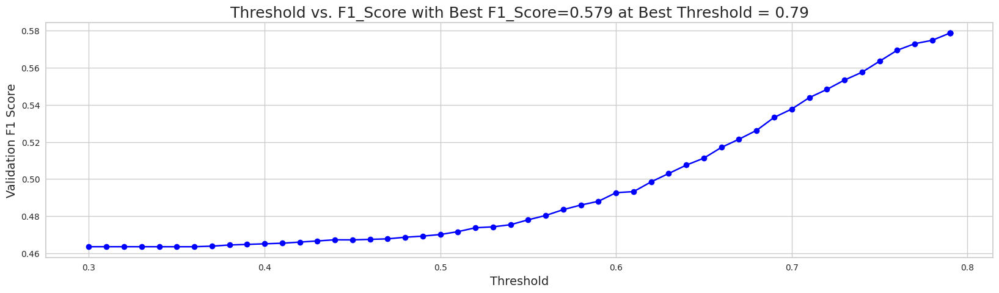

When using optimal threshold = 0.79...
Q0: F1 = 0.5787016971919342
==> Overall F1 = 0.5787016971919342
s
[I 2023-05-23 03:15:58,977] Trial 46 finished with value: 0.5787016971919342 and parameters: {'num_leaves': 51, 'learning_rate': 0.05050013907332149, 'feature_fraction': 0.46352269662157675, 'bagging_fraction': 0.6377679418421471, 'bagging_freq': 1, 'min_child_samples': 27, 'reg_alpha': 0.7264194862903036, 'reg_lambda': 0.0020364985038351623, 'subsample': 0.9996602951425705, 'colsample_bytree': 0.9809802795130946, 'min_split_gain': 0.09001076823483194, 'max_depth': 1}. Best is trial 15 with value: 0.5826672928669456.


--------------------------------------------------
question12, with210features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.623693117059859, subsample=0.8863579758260346 will be ignored. Current value: bagging_fraction=0.623693117059859
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.5825410345058183, colsample_bytree=0.9527011349549305 will be ignored. Current value: feature_fraction=0.5825410345058183


[LightGBM] [Warning] bagging_fraction is set=0.7877310604177584, subsample=0.8963727590554434 will be ignored. Current value: bagging_fraction=0.7877310604177584
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.5977564507804763, colsample_bytree=0.8660293357934239 will be ignored. Current value: feature_fraction=0.5977564507804763


[LightGBM] [Warning] bagging_fraction is set=0.623693117059859, subsample=0.8863579758260346 will be ignored. Current value: bagging_fraction=0.623693117059859
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.5825410345058183, colsample_bytree=0.9527011349549305 will be ignored. Current value: feature_fraction=0.5825410345058183
[LightGBM] [Warning] bagging_fraction is set=0.7804342317441172, subsample=0.887820869418474 will be ignored. Current value: bagging_fraction=0.7804342317441172
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] featu

[LightGBM] [Warning] bagging_fraction is set=0.636767670211693, subsample=0.9947857213583995 will be ignored. Current value: bagging_fraction=0.636767670211693
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.4798367453539381, colsample_bytree=0.9864075064202411 will be ignored. Current value: feature_fraction=0.4798367453539381


,mean
feature,
tunic.historicalsociety.frontdesk_room_fqid_counts,47.4
hover_duration_mean,44.4
door_block_talk_fqid_counts,30.8
9_level_counts,28.6
tunic.historicalsociety.frontdesk.archivist.foundtheodora_text_fqid_counts,27.4
room_coor_x_min,27.2
reader_fqid_counts,26.8
11_level_counts,25.0
map_click_event_name_counts,23.4


[[0.2177538  0.7822462 ]
 [0.1348825  0.8651175 ]
 [0.08456889 0.91543111]
 ...
 [0.08495654 0.91504346]
 [0.06128188 0.93871812]
 [0.09846919 0.90153081]]


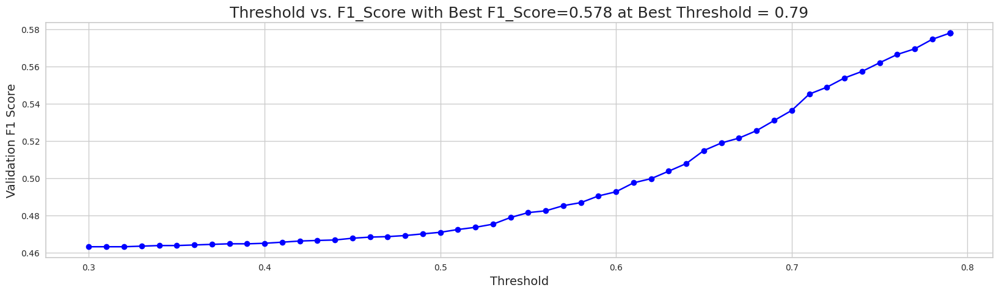

When using optimal threshold = 0.79...
Q0: F1 = 0.577929376986024
==> Overall F1 = 0.577929376986024
s
[I 2023-05-23 03:16:18,001] Trial 47 finished with value: 0.577929376986024 and parameters: {'num_leaves': 64, 'learning_rate': 0.022717561842102406, 'feature_fraction': 0.5825410345058183, 'bagging_fraction': 0.623693117059859, 'bagging_freq': 2, 'min_child_samples': 31, 'reg_alpha': 0.7913000299765198, 'reg_lambda': 0.0018526288657267987, 'subsample': 0.8863579758260346, 'colsample_bytree': 0.9527011349549305, 'min_split_gain': 0.002436473249368052, 'max_depth': 3}. Best is trial 15 with value: 0.5826672928669456.


[LightGBM] [Warning] bagging_fraction is set=0.7877310604177584, subsample=0.8963727590554434 will be ignored. Current value: bagging_fraction=0.7877310604177584
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.5977564507804763, colsample_bytree=0.8660293357934239 will be ignored. Current value: feature_fraction=0.5977564507804763


[LightGBM] [Warning] bagging_fraction is set=0.7804342317441172, subsample=0.887820869418474 will be ignored. Current value: bagging_fraction=0.7804342317441172
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.39844931021018015, colsample_bytree=0.9449048765850572 will be ignored. Current value: feature_fraction=0.39844931021018015


[LightGBM] [Warning] bagging_fraction is set=0.636767670211693, subsample=0.9947857213583995 will be ignored. Current value: bagging_fraction=0.636767670211693
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.4798367453539381, colsample_bytree=0.9864075064202411 will be ignored. Current value: feature_fraction=0.4798367453539381


[LightGBM] [Warning] bagging_fraction is set=0.7877310604177584, subsample=0.8963727590554434 will be ignored. Current value: bagging_fraction=0.7877310604177584
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.5977564507804763, colsample_bytree=0.8660293357934239 will be ignored. Current value: feature_fraction=0.5977564507804763


[LightGBM] [Warning] bagging_fraction is set=0.7804342317441172, subsample=0.887820869418474 will be ignored. Current value: bagging_fraction=0.7804342317441172
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.39844931021018015, colsample_bytree=0.9449048765850572 will be ignored. Current value: feature_fraction=0.39844931021018015


,mean
feature,
tunic.historicalsociety.frontdesk_room_fqid_counts,54.4
hover_duration_mean,52.8
tunic.historicalsociety.frontdesk.archivist.foundtheodora_text_fqid_counts,42.4
door_block_talk_fqid_counts,38.4
logbook_fqid_counts,30.4
elapsed_time_diff_std,29.8
tunic.historicalsociety.closet_dirty.door_block_talk_text_fqid_counts,28.8
map_click_event_name_counts,27.8
5_level_counts,26.4


[[0.21091527 0.78908473]
 [0.12092429 0.87907571]
 [0.09478588 0.90521412]
 ...
 [0.09537631 0.90462369]
 [0.06501984 0.93498016]
 [0.10357971 0.89642029]]


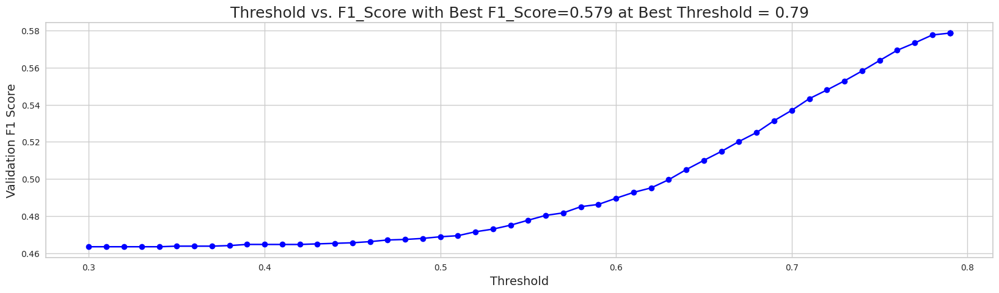

When using optimal threshold = 0.79...
Q0: F1 = 0.5785490192825459
==> Overall F1 = 0.5785490192825459
s
[I 2023-05-23 03:16:45,233] Trial 45 finished with value: 0.5785490192825459 and parameters: {'num_leaves': 63, 'learning_rate': 0.012578422952795964, 'feature_fraction': 0.4798367453539381, 'bagging_fraction': 0.636767670211693, 'bagging_freq': 2, 'min_child_samples': 80, 'reg_alpha': 0.03419935870943244, 'reg_lambda': 0.002919576662228853, 'subsample': 0.9947857213583995, 'colsample_bytree': 0.9864075064202411, 'min_split_gain': 0.05012338933017415, 'max_depth': 1}. Best is trial 15 with value: 0.5826672928669456.


[LightGBM] [Warning] bagging_fraction is set=0.7877310604177584, subsample=0.8963727590554434 will be ignored. Current value: bagging_fraction=0.7877310604177584
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.5977564507804763, colsample_bytree=0.8660293357934239 will be ignored. Current value: feature_fraction=0.5977564507804763


[LightGBM] [Warning] bagging_fraction is set=0.7804342317441172, subsample=0.887820869418474 will be ignored. Current value: bagging_fraction=0.7804342317441172
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.39844931021018015, colsample_bytree=0.9449048765850572 will be ignored. Current value: feature_fraction=0.39844931021018015


[LightGBM] [Warning] bagging_fraction is set=0.7877310604177584, subsample=0.8963727590554434 will be ignored. Current value: bagging_fraction=0.7877310604177584
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.5977564507804763, colsample_bytree=0.8660293357934239 will be ignored. Current value: feature_fraction=0.5977564507804763


,mean
feature,
hover_duration_mean,101.0
tunic.historicalsociety.frontdesk_room_fqid_counts,97.6
elapsed_time_diff_std,67.8
tunic.historicalsociety.frontdesk.archivist.foundtheodora_text_fqid_counts,60.2
door_block_talk_fqid_counts,58.4
room_coor_x_min,58.2
9_level_counts,58.2
11_level_counts,55.6
5_level_counts,53.2


[[0.2746396  0.7253604 ]
 [0.12428477 0.87571523]
 [0.09765787 0.90234213]
 ...
 [0.09708942 0.90291058]
 [0.05846608 0.94153392]
 [0.11364302 0.88635698]]


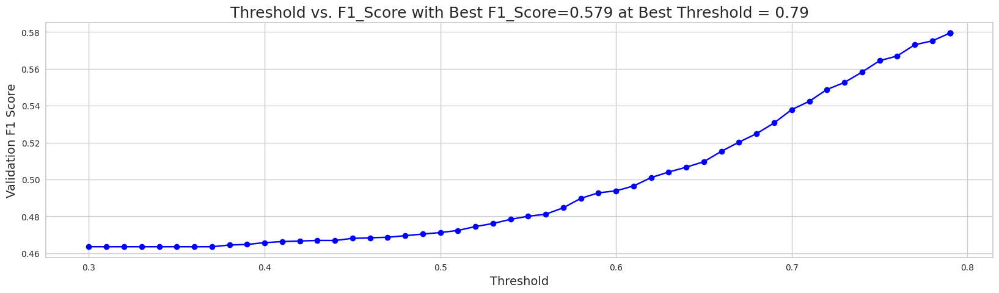

When using optimal threshold = 0.79...
Q0: F1 = 0.5794024023301472
==> Overall F1 = 0.5794024023301472
s
[I 2023-05-23 03:16:58,423] Trial 48 finished with value: 0.5794024023301472 and parameters: {'num_leaves': 44, 'learning_rate': 0.012865009286674164, 'feature_fraction': 0.39844931021018015, 'bagging_fraction': 0.7804342317441172, 'bagging_freq': 2, 'min_child_samples': 58, 'reg_alpha': 0.8597261437077236, 'reg_lambda': 0.0033754221436854874, 'subsample': 0.887820869418474, 'colsample_bytree': 0.9449048765850572, 'min_split_gain': 0.0026309912430972954, 'max_depth': 3}. Best is trial 15 with value: 0.5826672928669456.


,mean
feature,
tunic.historicalsociety.frontdesk_room_fqid_counts,100.6
hover_duration_mean,98.8
tunic.historicalsociety.frontdesk.archivist.foundtheodora_text_fqid_counts,59.8
door_block_talk_fqid_counts,53.6
reader_fqid_counts,50.0
tunic.historicalsociety.closet_dirty.door_block_talk_text_fqid_counts,50.0
9_level_counts,48.6
11_level_counts,48.4
elapsed_time_diff_std,46.4


[[0.22047419 0.77952581]
 [0.12161257 0.87838743]
 [0.09205584 0.90794416]
 ...
 [0.09560672 0.90439328]
 [0.05983277 0.94016723]
 [0.10871472 0.89128528]]


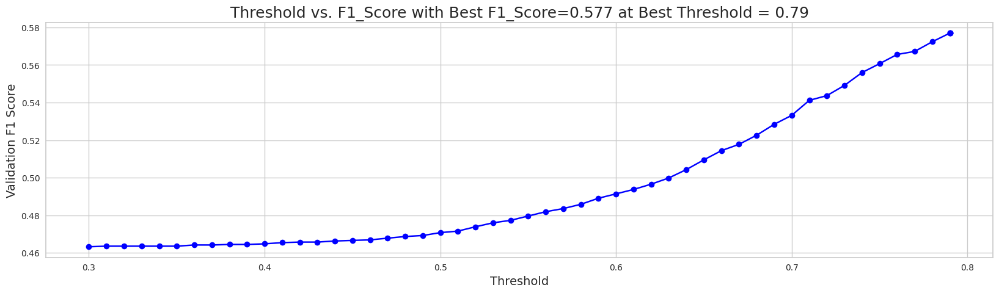

When using optimal threshold = 0.79...
Q0: F1 = 0.5769849764266562
==> Overall F1 = 0.5769849764266562
s
[I 2023-05-23 03:17:02,295] Trial 49 finished with value: 0.5769849764266562 and parameters: {'num_leaves': 65, 'learning_rate': 0.012325917032101428, 'feature_fraction': 0.5977564507804763, 'bagging_fraction': 0.7877310604177584, 'bagging_freq': 3, 'min_child_samples': 59, 'reg_alpha': 0.1575010306833015, 'reg_lambda': 0.0032014398279555665, 'subsample': 0.8963727590554434, 'colsample_bytree': 0.8660293357934239, 'min_split_gain': 0.002480625760503351, 'max_depth': 3}. Best is trial 15 with value: 0.5826672928669456.


[I 2023-05-23 03:17:03,264] A new study created in memory with name: no-name-613cfd9e-b51e-4114-b055-2e109a08b4c4


{'num_leaves': 17, 'learning_rate': 0.010246516698422964, 'feature_fraction': 0.45060868943321347, 'bagging_fraction': 0.5201242273129808, 'bagging_freq': 7, 'min_child_samples': 93, 'reg_alpha': 0.20047372292690477, 'reg_lambda': 0.0017931825511435459, 'subsample': 0.9902007652628788, 'colsample_bytree': 0.9860168072234853, 'min_split_gain': 0.0041865122072078055, 'max_depth': 0}


  0%|          | 0/50 [00:00<?, ?it/s]

--------------------------------------------------
question13, with210features
--------------------------------------------------
--------------------------------------------------
question13, with210features
--------------------------------------------------
--------------------------------------------------
question13, with210features
--------------------------------------------------
--------------------------------------------------
question13, with210features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.603036584747514, subsample=0.10220188561113826 will be ignored. Current value: bagging_fraction=0.603036584747514
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=9, subsample_freq=0 will be ignored. Current value: bagging_freq=9
[LightGBM] [Warning] feature_fraction is set=0.8789843946740574, colsample_bytree=0.4550463321416719 will be ignored. Current value: feature_fraction=0.8789843946740574
[LightGBM] [Warning] bagging_fraction is set=0.28506652574717006, subsample=0.5220517667612227 will be ignored. Current value: bagging_fraction=0.28506652574717006
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
[LightGBM] [Warning] f

[LightGBM] [Warning] bagging_fraction is set=0.6196231756278243, subsample=0.2580362158113084 will be ignored. Current value: bagging_fraction=0.6196231756278243
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.14658349997859946, colsample_bytree=0.9684600180081266 will be ignored. Current value: feature_fraction=0.14658349997859946
[LightGBM] [Warning] bagging_fraction is set=0.934580451506468, subsample=0.2690249294785041 will be ignored. Current value: bagging_fraction=0.934580451506468
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
[LightGBM] [Warning] fe

[LightGBM] [Warning] bagging_fraction is set=0.28506652574717006, subsample=0.5220517667612227 will be ignored. Current value: bagging_fraction=0.28506652574717006
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
[LightGBM] [Warning] feature_fraction is set=0.8498581085844135, colsample_bytree=0.24388366207114417 will be ignored. Current value: feature_fraction=0.8498581085844135


[LightGBM] [Warning] bagging_fraction is set=0.6196231756278243, subsample=0.2580362158113084 will be ignored. Current value: bagging_fraction=0.6196231756278243
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.14658349997859946, colsample_bytree=0.9684600180081266 will be ignored. Current value: feature_fraction=0.14658349997859946


[LightGBM] [Warning] bagging_fraction is set=0.603036584747514, subsample=0.10220188561113826 will be ignored. Current value: bagging_fraction=0.603036584747514
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=9, subsample_freq=0 will be ignored. Current value: bagging_freq=9
[LightGBM] [Warning] feature_fraction is set=0.8789843946740574, colsample_bytree=0.4550463321416719 will be ignored. Current value: feature_fraction=0.8789843946740574


[LightGBM] [Warning] bagging_fraction is set=0.28506652574717006, subsample=0.5220517667612227 will be ignored. Current value: bagging_fraction=0.28506652574717006
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
[LightGBM] [Warning] feature_fraction is set=0.8498581085844135, colsample_bytree=0.24388366207114417 will be ignored. Current value: feature_fraction=0.8498581085844135
[LightGBM] [Warning] bagging_fraction is set=0.6196231756278243, subsample=0.2580362158113084 will be ignored. Current value: bagging_fraction=0.6196231756278243
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning]

[LightGBM] [Warning] bagging_fraction is set=0.603036584747514, subsample=0.10220188561113826 will be ignored. Current value: bagging_fraction=0.603036584747514
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=9, subsample_freq=0 will be ignored. Current value: bagging_freq=9
[LightGBM] [Warning] feature_fraction is set=0.8789843946740574, colsample_bytree=0.4550463321416719 will be ignored. Current value: feature_fraction=0.8789843946740574


[LightGBM] [Warning] bagging_fraction is set=0.934580451506468, subsample=0.2690249294785041 will be ignored. Current value: bagging_fraction=0.934580451506468
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
[LightGBM] [Warning] feature_fraction is set=0.21190304923939307, colsample_bytree=0.7535984025391903 will be ignored. Current value: feature_fraction=0.21190304923939307


[LightGBM] [Warning] bagging_fraction is set=0.28506652574717006, subsample=0.5220517667612227 will be ignored. Current value: bagging_fraction=0.28506652574717006
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
[LightGBM] [Warning] feature_fraction is set=0.8498581085844135, colsample_bytree=0.24388366207114417 will be ignored. Current value: feature_fraction=0.8498581085844135


[LightGBM] [Warning] bagging_fraction is set=0.6196231756278243, subsample=0.2580362158113084 will be ignored. Current value: bagging_fraction=0.6196231756278243
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.14658349997859946, colsample_bytree=0.9684600180081266 will be ignored. Current value: feature_fraction=0.14658349997859946
[LightGBM] [Warning] bagging_fraction is set=0.603036584747514, subsample=0.10220188561113826 will be ignored. Current value: bagging_fraction=0.603036584747514
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=9, subsample_freq=0 will be ignored. Current value: bagging_freq=9
[LightGBM] [Warning] f

[LightGBM] [Warning] bagging_fraction is set=0.28506652574717006, subsample=0.5220517667612227 will be ignored. Current value: bagging_fraction=0.28506652574717006
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
[LightGBM] [Warning] feature_fraction is set=0.8498581085844135, colsample_bytree=0.24388366207114417 will be ignored. Current value: feature_fraction=0.8498581085844135


[LightGBM] [Warning] bagging_fraction is set=0.6196231756278243, subsample=0.2580362158113084 will be ignored. Current value: bagging_fraction=0.6196231756278243
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.14658349997859946, colsample_bytree=0.9684600180081266 will be ignored. Current value: feature_fraction=0.14658349997859946


[LightGBM] [Warning] bagging_fraction is set=0.934580451506468, subsample=0.2690249294785041 will be ignored. Current value: bagging_fraction=0.934580451506468
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
[LightGBM] [Warning] feature_fraction is set=0.21190304923939307, colsample_bytree=0.7535984025391903 will be ignored. Current value: feature_fraction=0.21190304923939307


[LightGBM] [Warning] bagging_fraction is set=0.603036584747514, subsample=0.10220188561113826 will be ignored. Current value: bagging_fraction=0.603036584747514
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=9, subsample_freq=0 will be ignored. Current value: bagging_freq=9
[LightGBM] [Warning] feature_fraction is set=0.8789843946740574, colsample_bytree=0.4550463321416719 will be ignored. Current value: feature_fraction=0.8789843946740574


,mean
feature,
hover_duration_sum,89.4
object_click_event_name_counts,71.4
room_coor_x_min,58.4
hover_duration_max,54.4
room_coor_y_min,53.4
screen_coor_x_std,51.8
screen_coor_y_min,50.4
room_coor_x_max,49.6
session_id,49.4


[[0.84013502 0.15986498]
 [0.83057613 0.16942387]
 [0.61713222 0.38286778]
 ...
 [0.68062007 0.31937993]
 [0.68272874 0.31727126]
 [0.83976788 0.16023212]]


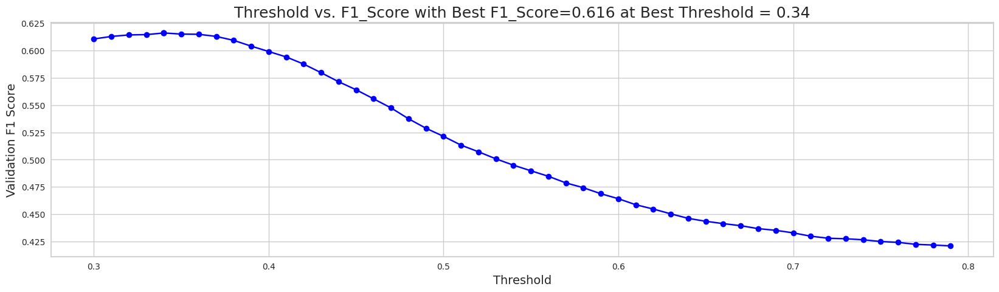

When using optimal threshold = 0.34...
Q0: F1 = 0.6159331365682384
==> Overall F1 = 0.6159331365682384
s
[I 2023-05-23 03:17:52,767] Trial 0 finished with value: 0.6159331365682384 and parameters: {'num_leaves': 59, 'learning_rate': 0.03483120058032989, 'feature_fraction': 0.8498581085844135, 'bagging_fraction': 0.28506652574717006, 'bagging_freq': 6, 'min_child_samples': 8, 'reg_alpha': 0.0022060058241746678, 'reg_lambda': 0.8788696631956947, 'subsample': 0.5220517667612227, 'colsample_bytree': 0.24388366207114417, 'min_split_gain': 0.001734242643063684, 'max_depth': 5}. Best is trial 0 with value: 0.6159331365682384.


--------------------------------------------------
question13, with210features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.5396054804926766, subsample=0.3705564985475065 will be ignored. Current value: bagging_fraction=0.5396054804926766
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=7, subsample_freq=0 will be ignored. Current value: bagging_freq=7
[LightGBM] [Warning] feature_fraction is set=0.18413964014598078, colsample_bytree=0.3193427469254274 will be ignored. Current value: feature_fraction=0.18413964014598078


,mean
feature,
hover_duration_sum,100.0
hover_duration_std,98.4
room_coor_x_max,76.8
hover_duration_max,74.2
screen_coor_x_std,72.4
room_coor_x_min,70.8
basic_name_counts,70.2
elapsed_time_diff_mean,68.2
session_id,64.2


[[0.83957232 0.16042768]
 [0.85352237 0.14647763]
 [0.73667435 0.26332565]
 ...
 [0.57474697 0.42525303]
 [0.59867279 0.40132721]
 [0.78305658 0.21694342]]


,mean
feature,
hover_duration_sum,112.6
hover_duration_max,94.8
object_click_event_name_counts,91.2
room_coor_x_max,87.2
session_id,83.6
room_coor_y_min,80.8
room_coor_y_max,79.8
elapsed_time_diff_std,78.4
room_coor_x_min,74.4


[[0.8806054  0.1193946 ]
 [0.86135661 0.13864339]
 [0.72082282 0.27917718]
 ...
 [0.6258572  0.3741428 ]
 [0.60486571 0.39513429]
 [0.7789776  0.2210224 ]]


[LightGBM] [Warning] bagging_fraction is set=0.5396054804926766, subsample=0.3705564985475065 will be ignored. Current value: bagging_fraction=0.5396054804926766
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=7, subsample_freq=0 will be ignored. Current value: bagging_freq=7
[LightGBM] [Warning] feature_fraction is set=0.18413964014598078, colsample_bytree=0.3193427469254274 will be ignored. Current value: feature_fraction=0.18413964014598078


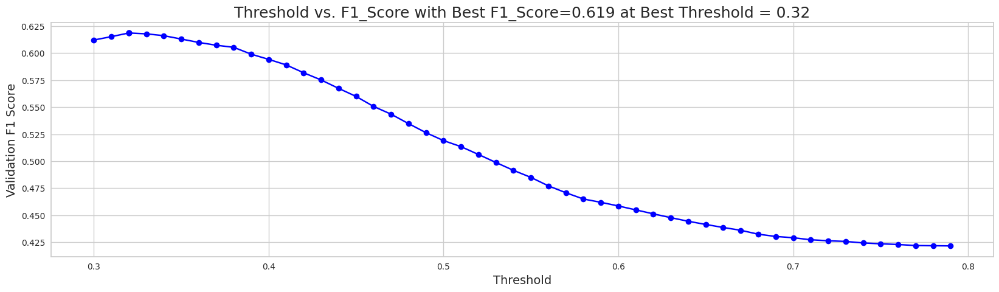

When using optimal threshold = 0.32...
Q0: F1 = 0.6186366254011569


==> Overall F1 = 0.6186366254011569
s
[I 2023-05-23 03:18:00,241] Trial 1 finished with value: 0.6186366254011569 and parameters: {'num_leaves': 66, 'learning_rate': 0.04288287453683318, 'feature_fraction': 0.8789843946740574, 'bagging_fraction': 0.603036584747514, 'bagging_freq': 9, 'min_child_samples': 87, 'reg_alpha': 0.014981002182108473, 'reg_lambda': 0.006179488495134674, 'subsample': 0.10220188561113826, 'colsample_bytree': 0.4550463321416719, 'min_split_gain': 0.1470610172543143, 'max_depth': 10}. Best is trial 1 with value: 0.6186366254011569.


--------------------------------------------------
question13, with210features
--------------------------------------------------


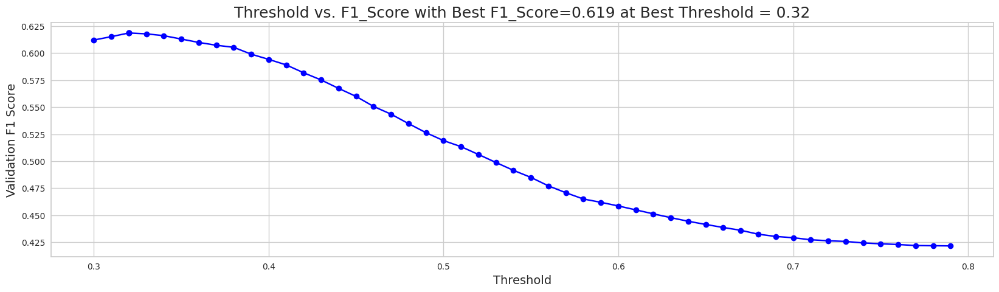

[LightGBM] [Warning] bagging_fraction is set=0.5143015773771452, subsample=0.46606135406394966 will be ignored. Current value: bagging_fraction=0.5143015773771452
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=7, subsample_freq=0 will be ignored. Current value: bagging_freq=7
[LightGBM] [Warning] feature_fraction is set=0.10945299569492309, colsample_bytree=0.16914207604188872 will be ignored. Current value: feature_fraction=0.10945299569492309


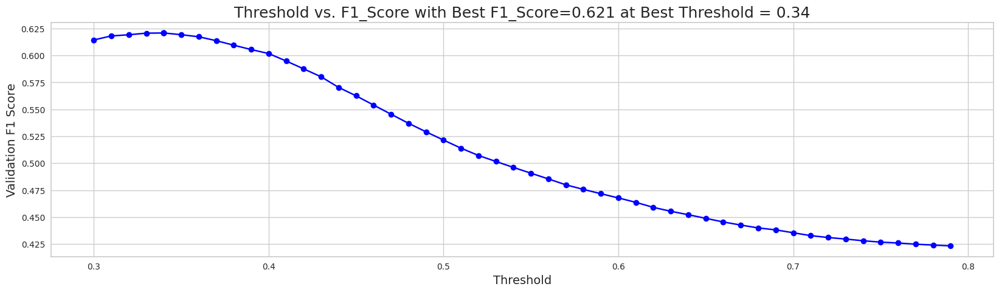

When using optimal threshold = 0.34...
Q0: F1 = 0.6208699985513881
==> Overall F1 = 0.6208699985513881
s
[I 2023-05-23 03:18:02,744] Trial 3 finished with value: 0.6208699985513881 and parameters: {'num_leaves': 66, 'learning_rate': 0.03557290467981543, 'feature_fraction': 0.14658349997859946, 'bagging_fraction': 0.6196231756278243, 'bagging_freq': 2, 'min_child_samples': 9, 'reg_alpha': 0.014685037516808696, 'reg_lambda': 0.0195285905391831, 'subsample': 0.2580362158113084, 'colsample_bytree': 0.9684600180081266, 'min_split_gain': 0.005549974094082387, 'max_depth': 4}. Best is trial 3 with value: 0.6208699985513881.


--------------------------------------------------
question13, with210features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.6084043389798923, subsample=0.9107075080127361 will be ignored. Current value: bagging_fraction=0.6084043389798923
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
[LightGBM] [Warning] feature_fraction is set=0.6241732188078369, colsample_bytree=0.8216181205828432 will be ignored. Current value: feature_fraction=0.6241732188078369


[LightGBM] [Warning] bagging_fraction is set=0.5396054804926766, subsample=0.3705564985475065 will be ignored. Current value: bagging_fraction=0.5396054804926766
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=7, subsample_freq=0 will be ignored. Current value: bagging_freq=7
[LightGBM] [Warning] feature_fraction is set=0.18413964014598078, colsample_bytree=0.3193427469254274 will be ignored. Current value: feature_fraction=0.18413964014598078


[LightGBM] [Warning] bagging_fraction is set=0.5143015773771452, subsample=0.46606135406394966 will be ignored. Current value: bagging_fraction=0.5143015773771452
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=7, subsample_freq=0 will be ignored. Current value: bagging_freq=7
[LightGBM] [Warning] feature_fraction is set=0.10945299569492309, colsample_bytree=0.16914207604188872 will be ignored. Current value: feature_fraction=0.10945299569492309
[LightGBM] [Warning] bagging_fraction is set=0.934580451506468, subsample=0.2690249294785041 will be ignored. Current value: bagging_fraction=0.934580451506468
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
[LightGBM] [Warning] 

[LightGBM] [Warning] bagging_fraction is set=0.5396054804926766, subsample=0.3705564985475065 will be ignored. Current value: bagging_fraction=0.5396054804926766
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=7, subsample_freq=0 will be ignored. Current value: bagging_freq=7
[LightGBM] [Warning] feature_fraction is set=0.18413964014598078, colsample_bytree=0.3193427469254274 will be ignored. Current value: feature_fraction=0.18413964014598078


[LightGBM] [Warning] bagging_fraction is set=0.5143015773771452, subsample=0.46606135406394966 will be ignored. Current value: bagging_fraction=0.5143015773771452
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=7, subsample_freq=0 will be ignored. Current value: bagging_freq=7
[LightGBM] [Warning] feature_fraction is set=0.10945299569492309, colsample_bytree=0.16914207604188872 will be ignored. Current value: feature_fraction=0.10945299569492309


[LightGBM] [Warning] bagging_fraction is set=0.5396054804926766, subsample=0.3705564985475065 will be ignored. Current value: bagging_fraction=0.5396054804926766
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=7, subsample_freq=0 will be ignored. Current value: bagging_freq=7
[LightGBM] [Warning] feature_fraction is set=0.18413964014598078, colsample_bytree=0.3193427469254274 will be ignored. Current value: feature_fraction=0.18413964014598078


[LightGBM] [Warning] bagging_fraction is set=0.5143015773771452, subsample=0.46606135406394966 will be ignored. Current value: bagging_fraction=0.5143015773771452
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=7, subsample_freq=0 will be ignored. Current value: bagging_freq=7
[LightGBM] [Warning] feature_fraction is set=0.10945299569492309, colsample_bytree=0.16914207604188872 will be ignored. Current value: feature_fraction=0.10945299569492309


,mean
feature,
hover_duration_sum,41.6
hover_duration_std,36.0
room_coor_x_min,26.8
room_coor_x_std,26.4
text_fqid_None_text_fqid_counts,23.8
journals_fqid_counts,22.6
room_corr_x_diff_std,21.6
room_coor_y_max,20.4
screen_coor_x_sum,20.2


[[0.81177068 0.18822932]
 [0.80779981 0.19220019]
 [0.78464708 0.21535292]
 ...
 [0.69505955 0.30494045]
 [0.7301914  0.2698086 ]
 [0.81810846 0.18189154]]


[LightGBM] [Warning] bagging_fraction is set=0.5143015773771452, subsample=0.46606135406394966 will be ignored. Current value: bagging_fraction=0.5143015773771452
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=7, subsample_freq=0 will be ignored. Current value: bagging_freq=7
[LightGBM] [Warning] feature_fraction is set=0.10945299569492309, colsample_bytree=0.16914207604188872 will be ignored. Current value: feature_fraction=0.10945299569492309


[LightGBM] [Warning] bagging_fraction is set=0.6084043389798923, subsample=0.9107075080127361 will be ignored. Current value: bagging_fraction=0.6084043389798923
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
[LightGBM] [Warning] feature_fraction is set=0.6241732188078369, colsample_bytree=0.8216181205828432 will be ignored. Current value: feature_fraction=0.6241732188078369


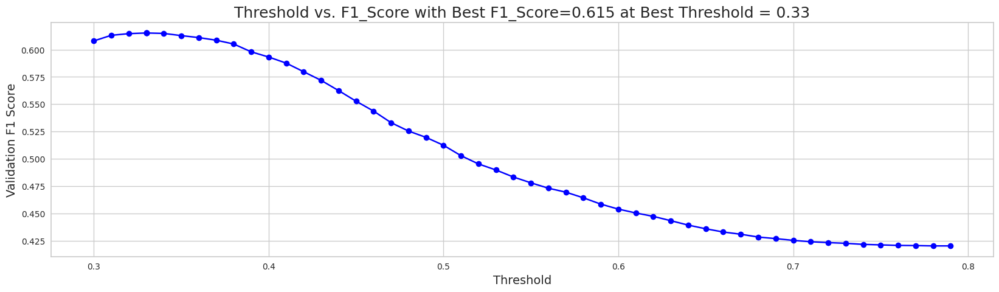

When using optimal threshold = 0.33...
Q0: F1 = 0.6152077945387064
==> Overall F1 = 0.6152077945387064
s
[I 2023-05-23 03:18:22,625] Trial 4 finished with value: 0.6152077945387064 and parameters: {'num_leaves': 99, 'learning_rate': 0.10944397826388468, 'feature_fraction': 0.18413964014598078, 'bagging_fraction': 0.5396054804926766, 'bagging_freq': 7, 'min_child_samples': 91, 'reg_alpha': 1.4074932852648654, 'reg_lambda': 0.001915303676184786, 'subsample': 0.3705564985475065, 'colsample_bytree': 0.3193427469254274, 'min_split_gain': 0.17280367391429047, 'max_depth': 6}. Best is trial 3 with value: 0.6208699985513881.


--------------------------------------------------
question13, with210features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.9681738271326751, subsample=0.6930190908936262 will be ignored. Current value: bagging_fraction=0.9681738271326751
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.2533488320489531, colsample_bytree=0.8454885392306879 will be ignored. Current value: feature_fraction=0.2533488320489531


,mean
feature,
room_coor_y_min,28.6
room_coor_y_max,25.8
object_click_event_name_counts,14.4
screen_corr_y_dff_mean,13.8
screen_coor_y_min,13.2
room_corr_x_diff_mean,12.8
hover_duration_max,11.2
elapsed_time_diff_sum,11.0
click_counts,10.6


[LightGBM] [Warning] bagging_fraction is set=0.934580451506468, subsample=0.2690249294785041 will be ignored. Current value: bagging_fraction=0.934580451506468
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
[LightGBM] [Warning] feature_fraction is set=0.21190304923939307, colsample_bytree=0.7535984025391903 will be ignored. Current value: feature_fraction=0.21190304923939307
[[0.88736195 0.11263805]
 [0.81952674 0.18047326]
 [0.74126028 0.25873972]
 ...
 [0.66730052 0.33269948]
 [0.47881393 0.52118607]
 [0.87615711 0.12384289]]


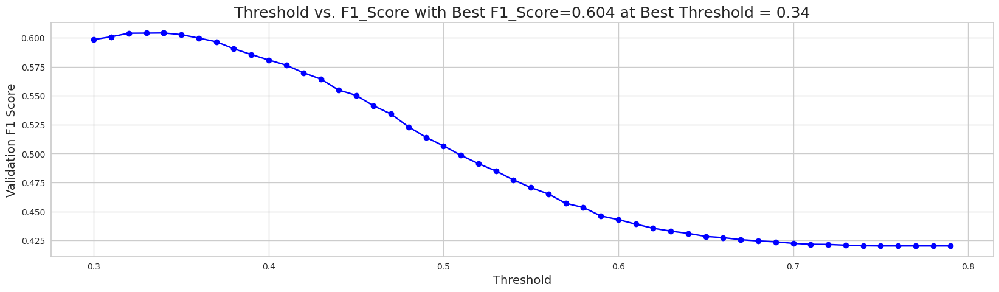

When using optimal threshold = 0.34...
Q0: F1 = 0.6041874984398966
==> Overall F1 = 0.6041874984398966
s
[I 2023-05-23 03:18:29,123] Trial 5 finished with value: 0.6041874984398966 and parameters: {'num_leaves': 82, 'learning_rate': 0.31183048606500274, 'feature_fraction': 0.10945299569492309, 'bagging_fraction': 0.5143015773771452, 'bagging_freq': 7, 'min_child_samples': 62, 'reg_alpha': 1.8674495074451052, 'reg_lambda': 3.4067134266460166, 'subsample': 0.46606135406394966, 'colsample_bytree': 0.16914207604188872, 'min_split_gain': 0.0018682339863710445, 'max_depth': 8}. Best is trial 3 with value: 0.6208699985513881.


--------------------------------------------------
question13, with210features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.6712542456229714, subsample=0.3624967454417839 will be ignored. Current value: bagging_fraction=0.6712542456229714
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=9, subsample_freq=0 will be ignored. Current value: bagging_freq=9
[LightGBM] [Warning] feature_fraction is set=0.7766432088874106, colsample_bytree=0.486511009108169 will be ignored. Current value: feature_fraction=0.7766432088874106


[LightGBM] [Warning] bagging_fraction is set=0.6084043389798923, subsample=0.9107075080127361 will be ignored. Current value: bagging_fraction=0.6084043389798923
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
[LightGBM] [Warning] feature_fraction is set=0.6241732188078369, colsample_bytree=0.8216181205828432 will be ignored. Current value: feature_fraction=0.6241732188078369


[LightGBM] [Warning] bagging_fraction is set=0.6712542456229714, subsample=0.3624967454417839 will be ignored. Current value: bagging_fraction=0.6712542456229714
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=9, subsample_freq=0 will be ignored. Current value: bagging_freq=9
[LightGBM] [Warning] feature_fraction is set=0.7766432088874106, colsample_bytree=0.486511009108169 will be ignored. Current value: feature_fraction=0.7766432088874106


[LightGBM] [Warning] bagging_fraction is set=0.9681738271326751, subsample=0.6930190908936262 will be ignored. Current value: bagging_fraction=0.9681738271326751
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.2533488320489531, colsample_bytree=0.8454885392306879 will be ignored. Current value: feature_fraction=0.2533488320489531


,mean
feature,
hover_duration_max,199.6
hover_duration_std,186.6
hover_duration_mean,183.2
room_coor_x_max,168.6
room_coor_y_max,165.2
screen_coor_x_std,156.4
hover_duration_sum,155.0
session_id,154.4
room_coor_x_min,147.4


[[0.8607703  0.1392297 ]
 [0.85827051 0.14172949]
 [0.76534565 0.23465435]
 ...
 [0.61979596 0.38020404]
 [0.6254237  0.3745763 ]
 [0.79701769 0.20298231]]


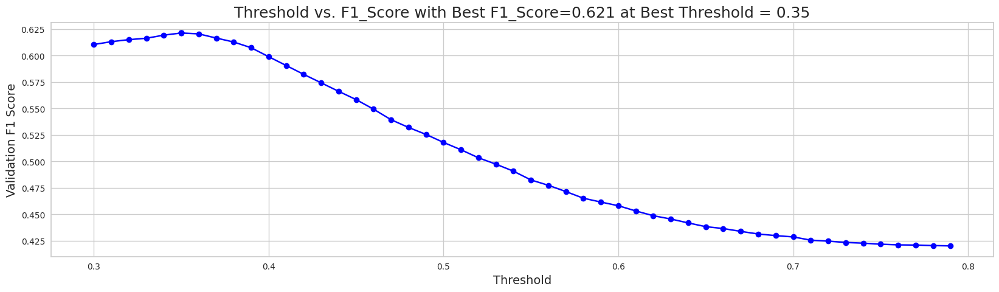

When using optimal threshold = 0.35...
Q0: F1 = 0.6213682284285539
==> Overall F1 = 0.6213682284285539
s
[I 2023-05-23 03:18:50,339] Trial 2 finished with value: 0.6213682284285539 and parameters: {'num_leaves': 76, 'learning_rate': 0.03432614449882231, 'feature_fraction': 0.21190304923939307, 'bagging_fraction': 0.934580451506468, 'bagging_freq': 4, 'min_child_samples': 96, 'reg_alpha': 2.857131281489849, 'reg_lambda': 0.4405905602781198, 'subsample': 0.2690249294785041, 'colsample_bytree': 0.7535984025391903, 'min_split_gain': 0.0010345794587725556, 'max_depth': -1}. Best is trial 2 with value: 0.6213682284285539.


--------------------------------------------------
question13, with210features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.720583794457649, subsample=0.3215540266430135 will be ignored. Current value: bagging_fraction=0.720583794457649
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.21614999772788546, colsample_bytree=0.7687936928664906 will be ignored. Current value: feature_fraction=0.21614999772788546


[LightGBM] [Warning] bagging_fraction is set=0.6084043389798923, subsample=0.9107075080127361 will be ignored. Current value: bagging_fraction=0.6084043389798923
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
[LightGBM] [Warning] feature_fraction is set=0.6241732188078369, colsample_bytree=0.8216181205828432 will be ignored. Current value: feature_fraction=0.6241732188078369


[LightGBM] [Warning] bagging_fraction is set=0.6712542456229714, subsample=0.3624967454417839 will be ignored. Current value: bagging_fraction=0.6712542456229714
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=9, subsample_freq=0 will be ignored. Current value: bagging_freq=9
[LightGBM] [Warning] feature_fraction is set=0.7766432088874106, colsample_bytree=0.486511009108169 will be ignored. Current value: feature_fraction=0.7766432088874106


[LightGBM] [Warning] bagging_fraction is set=0.9681738271326751, subsample=0.6930190908936262 will be ignored. Current value: bagging_fraction=0.9681738271326751
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.2533488320489531, colsample_bytree=0.8454885392306879 will be ignored. Current value: feature_fraction=0.2533488320489531


[LightGBM] [Warning] bagging_fraction is set=0.6084043389798923, subsample=0.9107075080127361 will be ignored. Current value: bagging_fraction=0.6084043389798923
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
[LightGBM] [Warning] feature_fraction is set=0.6241732188078369, colsample_bytree=0.8216181205828432 will be ignored. Current value: feature_fraction=0.6241732188078369
[LightGBM] [Warning] bagging_fraction is set=0.9681738271326751, subsample=0.6930190908936262 will be ignored. Current value: bagging_fraction=0.9681738271326751
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] fe

[LightGBM] [Warning] bagging_fraction is set=0.6712542456229714, subsample=0.3624967454417839 will be ignored. Current value: bagging_fraction=0.6712542456229714
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=9, subsample_freq=0 will be ignored. Current value: bagging_freq=9
[LightGBM] [Warning] feature_fraction is set=0.7766432088874106, colsample_bytree=0.486511009108169 will be ignored. Current value: feature_fraction=0.7766432088874106


[LightGBM] [Warning] bagging_fraction is set=0.720583794457649, subsample=0.3215540266430135 will be ignored. Current value: bagging_fraction=0.720583794457649
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.21614999772788546, colsample_bytree=0.7687936928664906 will be ignored. Current value: feature_fraction=0.21614999772788546


[LightGBM] [Warning] bagging_fraction is set=0.6712542456229714, subsample=0.3624967454417839 will be ignored. Current value: bagging_fraction=0.6712542456229714
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=9, subsample_freq=0 will be ignored. Current value: bagging_freq=9
[LightGBM] [Warning] feature_fraction is set=0.7766432088874106, colsample_bytree=0.486511009108169 will be ignored. Current value: feature_fraction=0.7766432088874106


,mean
feature,
hover_duration_sum,178.2
hover_duration_max,156.4
object_click_event_name_counts,150.0
room_coor_y_min,123.6
room_coor_x_max,121.6
room_coor_x_min,118.4
session_id,115.0
hover_duration_std,108.8
elapsed_time_diff_std,107.4


[[0.84375454 0.15624546]
 [0.85355382 0.14644618]
 [0.70580145 0.29419855]
 ...
 [0.57185895 0.42814105]
 [0.64638571 0.35361429]
 [0.8250669  0.1749331 ]]


[LightGBM] [Warning] bagging_fraction is set=0.9681738271326751, subsample=0.6930190908936262 will be ignored. Current value: bagging_fraction=0.9681738271326751
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.2533488320489531, colsample_bytree=0.8454885392306879 will be ignored. Current value: feature_fraction=0.2533488320489531


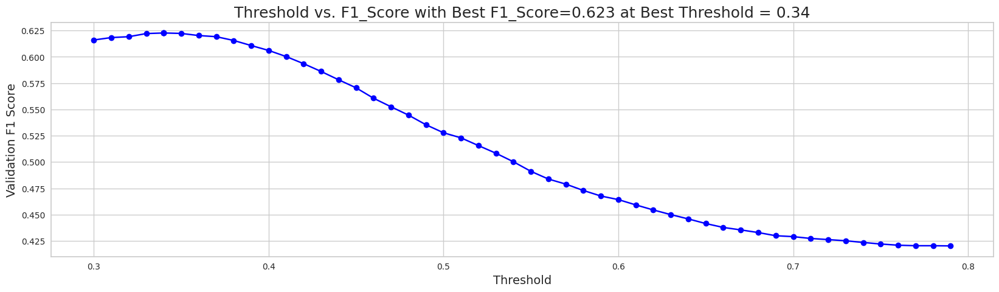

When using optimal threshold = 0.34...
Q0: F1 = 0.6226513331444574
==> Overall F1 = 0.6226513331444574
s
[I 2023-05-23 03:19:42,304] Trial 6 finished with value: 0.6226513331444574 and parameters: {'num_leaves': 28, 'learning_rate': 0.021601244836527443, 'feature_fraction': 0.6241732188078369, 'bagging_fraction': 0.6084043389798923, 'bagging_freq': 6, 'min_child_samples': 100, 'reg_alpha': 0.001325772797633135, 'reg_lambda': 8.775581307617417, 'subsample': 0.9107075080127361, 'colsample_bytree': 0.8216181205828432, 'min_split_gain': 0.015263674736745822, 'max_depth': 8}. Best is trial 6 with value: 0.6226513331444574.


--------------------------------------------------
question13, with210features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.18433453276303832, subsample=0.4020337041150598 will be ignored. Current value: bagging_fraction=0.18433453276303832
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.397281015161122, colsample_bytree=0.8205141039543885 will be ignored. Current value: feature_fraction=0.397281015161122


,mean
feature,
hover_duration_sum,106.2
object_click_event_name_counts,104.0
hover_duration_max,71.4
9_level_counts,66.2
businesscards_fqid_counts,62.6
10_level_counts,54.8
room_coor_x_max,43.8
elapsed_time_diff_std,43.6
tunic.historicalsociety.frontdesk_room_fqid_counts,42.4


[[0.8489674  0.1510326 ]
 [0.83777956 0.16222044]
 [0.66882904 0.33117096]
 ...
 [0.6286451  0.3713549 ]
 [0.65400305 0.34599695]
 [0.80756487 0.19243513]]


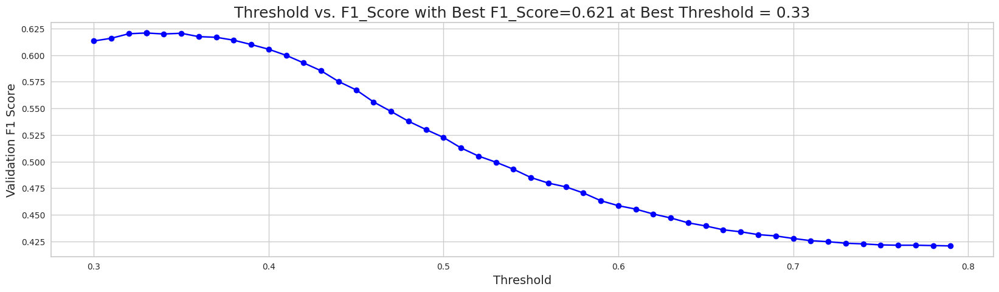

When using optimal threshold = 0.33...
Q0: F1 = 0.6207967923794242
==> Overall F1 = 0.6207967923794242
s
[I 2023-05-23 03:19:51,576] Trial 8 finished with value: 0.6207967923794242 and parameters: {'num_leaves': 71, 'learning_rate': 0.021761887638059637, 'feature_fraction': 0.7766432088874106, 'bagging_fraction': 0.6712542456229714, 'bagging_freq': 9, 'min_child_samples': 54, 'reg_alpha': 6.694257136157177, 'reg_lambda': 6.519685437569607, 'subsample': 0.3624967454417839, 'colsample_bytree': 0.486511009108169, 'min_split_gain': 0.9754731362352398, 'max_depth': 2}. Best is trial 6 with value: 0.6226513331444574.


--------------------------------------------------
question13, with210features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.751340304836443, subsample=0.2051422661087453 will be ignored. Current value: bagging_fraction=0.751340304836443
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=9, subsample_freq=0 will be ignored. Current value: bagging_freq=9
[LightGBM] [Warning] feature_fraction is set=0.9194656062998973, colsample_bytree=0.3162753577202545 will be ignored. Current value: feature_fraction=0.9194656062998973


[LightGBM] [Warning] bagging_fraction is set=0.18433453276303832, subsample=0.4020337041150598 will be ignored. Current value: bagging_fraction=0.18433453276303832
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.397281015161122, colsample_bytree=0.8205141039543885 will be ignored. Current value: feature_fraction=0.397281015161122


[LightGBM] [Warning] bagging_fraction is set=0.720583794457649, subsample=0.3215540266430135 will be ignored. Current value: bagging_fraction=0.720583794457649
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.21614999772788546, colsample_bytree=0.7687936928664906 will be ignored. Current value: feature_fraction=0.21614999772788546


[LightGBM] [Warning] bagging_fraction is set=0.751340304836443, subsample=0.2051422661087453 will be ignored. Current value: bagging_fraction=0.751340304836443
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=9, subsample_freq=0 will be ignored. Current value: bagging_freq=9
[LightGBM] [Warning] feature_fraction is set=0.9194656062998973, colsample_bytree=0.3162753577202545 will be ignored. Current value: feature_fraction=0.9194656062998973


[LightGBM] [Warning] bagging_fraction is set=0.18433453276303832, subsample=0.4020337041150598 will be ignored. Current value: bagging_fraction=0.18433453276303832
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.397281015161122, colsample_bytree=0.8205141039543885 will be ignored. Current value: feature_fraction=0.397281015161122


,mean
feature,
object_click_event_name_counts,108.0
hover_duration_sum,101.2
9_level_counts,74.8
businesscards_fqid_counts,71.6
hover_duration_max,58.2
10_level_counts,57.2
room_coor_x_max,56.2
8_level_counts,49.6
tunic.library.frontdesk.worker.droppedbadge_text_fqid_counts,49.0


[[0.8382454  0.1617546 ]
 [0.84295943 0.15704057]
 [0.68907538 0.31092462]
 ...
 [0.61774698 0.38225302]
 [0.63206408 0.36793592]
 [0.81165703 0.18834297]]


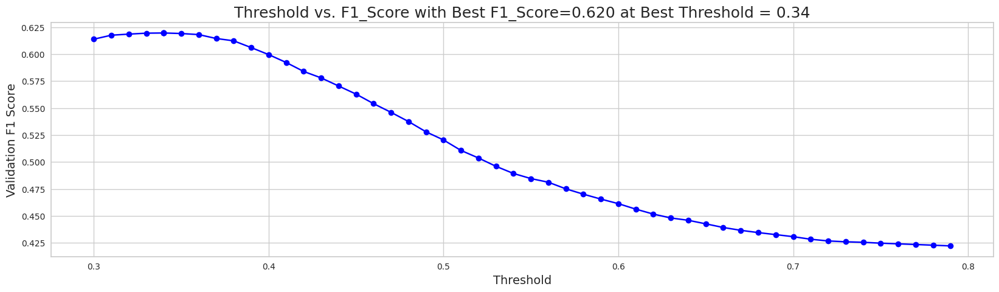

When using optimal threshold = 0.34...
Q0: F1 = 0.6196396501219492
==> Overall F1 = 0.6196396501219492
s
[I 2023-05-23 03:20:25,281] Trial 7 finished with value: 0.6196396501219492 and parameters: {'num_leaves': 66, 'learning_rate': 0.01991555386650404, 'feature_fraction': 0.2533488320489531, 'bagging_fraction': 0.9681738271326751, 'bagging_freq': 2, 'min_child_samples': 80, 'reg_alpha': 0.47293836141697787, 'reg_lambda': 0.06710574901598582, 'subsample': 0.6930190908936262, 'colsample_bytree': 0.8454885392306879, 'min_split_gain': 0.014361086060019337, 'max_depth': 2}. Best is trial 6 with value: 0.6226513331444574.


--------------------------------------------------
question13, with210features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.4912721013255721, subsample=0.20368451659084302 will be ignored. Current value: bagging_fraction=0.4912721013255721
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
[LightGBM] [Warning] feature_fraction is set=0.8071196082486931, colsample_bytree=0.8458901335259928 will be ignored. Current value: feature_fraction=0.8071196082486931


[LightGBM] [Warning] bagging_fraction is set=0.751340304836443, subsample=0.2051422661087453 will be ignored. Current value: bagging_fraction=0.751340304836443
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=9, subsample_freq=0 will be ignored. Current value: bagging_freq=9
[LightGBM] [Warning] feature_fraction is set=0.9194656062998973, colsample_bytree=0.3162753577202545 will be ignored. Current value: feature_fraction=0.9194656062998973


[LightGBM] [Warning] bagging_fraction is set=0.18433453276303832, subsample=0.4020337041150598 will be ignored. Current value: bagging_fraction=0.18433453276303832
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.397281015161122, colsample_bytree=0.8205141039543885 will be ignored. Current value: feature_fraction=0.397281015161122


[LightGBM] [Warning] bagging_fraction is set=0.4912721013255721, subsample=0.20368451659084302 will be ignored. Current value: bagging_fraction=0.4912721013255721
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
[LightGBM] [Warning] feature_fraction is set=0.8071196082486931, colsample_bytree=0.8458901335259928 will be ignored. Current value: feature_fraction=0.8071196082486931


[LightGBM] [Warning] bagging_fraction is set=0.720583794457649, subsample=0.3215540266430135 will be ignored. Current value: bagging_fraction=0.720583794457649
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.21614999772788546, colsample_bytree=0.7687936928664906 will be ignored. Current value: feature_fraction=0.21614999772788546


[LightGBM] [Warning] bagging_fraction is set=0.18433453276303832, subsample=0.4020337041150598 will be ignored. Current value: bagging_fraction=0.18433453276303832
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.397281015161122, colsample_bytree=0.8205141039543885 will be ignored. Current value: feature_fraction=0.397281015161122


[LightGBM] [Warning] bagging_fraction is set=0.751340304836443, subsample=0.2051422661087453 will be ignored. Current value: bagging_fraction=0.751340304836443
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=9, subsample_freq=0 will be ignored. Current value: bagging_freq=9
[LightGBM] [Warning] feature_fraction is set=0.9194656062998973, colsample_bytree=0.3162753577202545 will be ignored. Current value: feature_fraction=0.9194656062998973


[LightGBM] [Warning] bagging_fraction is set=0.4912721013255721, subsample=0.20368451659084302 will be ignored. Current value: bagging_fraction=0.4912721013255721
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
[LightGBM] [Warning] feature_fraction is set=0.8071196082486931, colsample_bytree=0.8458901335259928 will be ignored. Current value: feature_fraction=0.8071196082486931


,mean
feature,
hover_duration_max,136.6
hover_duration_sum,130.6
hover_duration_std,129.0
room_coor_x_min,119.8
hover_duration_mean,113.6
room_coor_x_max,107.2
room_coor_y_min,106.0
screen_coor_x_std,105.8
room_coor_y_max,103.4


[[0.83592458 0.16407542]
 [0.83172627 0.16827373]
 [0.71667721 0.28332279]
 ...
 [0.62158067 0.37841933]
 [0.6109607  0.3890393 ]
 [0.82946556 0.17053444]]


[LightGBM] [Warning] bagging_fraction is set=0.4912721013255721, subsample=0.20368451659084302 will be ignored. Current value: bagging_fraction=0.4912721013255721
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
[LightGBM] [Warning] feature_fraction is set=0.8071196082486931, colsample_bytree=0.8458901335259928 will be ignored. Current value: feature_fraction=0.8071196082486931


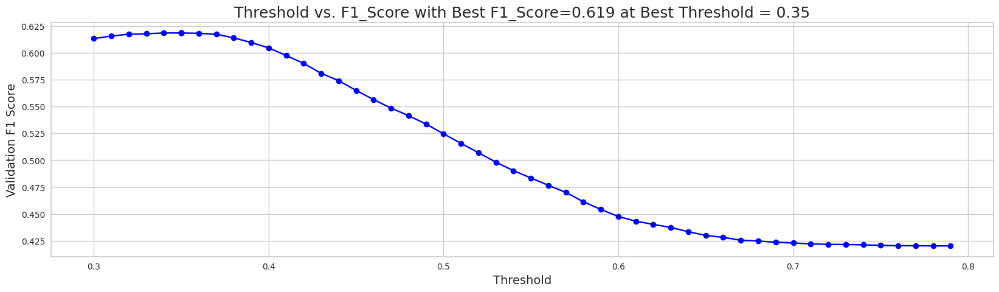

When using optimal threshold = 0.35...
Q0: F1 = 0.6185657904336894
==> Overall F1 = 0.6185657904336894
s
[I 2023-05-23 03:21:01,427] Trial 10 finished with value: 0.6185657904336894 and parameters: {'num_leaves': 91, 'learning_rate': 0.028780432403239017, 'feature_fraction': 0.397281015161122, 'bagging_fraction': 0.18433453276303832, 'bagging_freq': 3, 'min_child_samples': 15, 'reg_alpha': 7.897401448744468, 'reg_lambda': 0.012964157338488406, 'subsample': 0.4020337041150598, 'colsample_bytree': 0.8205141039543885, 'min_split_gain': 0.20164309042171882, 'max_depth': 6}. Best is trial 6 with value: 0.6226513331444574.


--------------------------------------------------
question13, with210features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.38129611267435937, subsample=0.9711063293335973 will be ignored. Current value: bagging_fraction=0.38129611267435937
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
[LightGBM] [Warning] feature_fraction is set=0.6643570507709573, colsample_bytree=0.616866308210483 will be ignored. Current value: feature_fraction=0.6643570507709573


[LightGBM] [Warning] bagging_fraction is set=0.751340304836443, subsample=0.2051422661087453 will be ignored. Current value: bagging_fraction=0.751340304836443
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=9, subsample_freq=0 will be ignored. Current value: bagging_freq=9
[LightGBM] [Warning] feature_fraction is set=0.9194656062998973, colsample_bytree=0.3162753577202545 will be ignored. Current value: feature_fraction=0.9194656062998973


[LightGBM] [Warning] bagging_fraction is set=0.4912721013255721, subsample=0.20368451659084302 will be ignored. Current value: bagging_fraction=0.4912721013255721
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
[LightGBM] [Warning] feature_fraction is set=0.8071196082486931, colsample_bytree=0.8458901335259928 will be ignored. Current value: feature_fraction=0.8071196082486931


[LightGBM] [Warning] bagging_fraction is set=0.720583794457649, subsample=0.3215540266430135 will be ignored. Current value: bagging_fraction=0.720583794457649
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.21614999772788546, colsample_bytree=0.7687936928664906 will be ignored. Current value: feature_fraction=0.21614999772788546


,mean
feature,
room_coor_x_min,56.2
room_coor_x_max,54.4
hover_duration_sum,54.4
object_click_event_name_counts,54.0
screen_coor_x_std,53.0
room_coor_y_min,51.6
room_coor_y_max,50.8
hover_duration_max,49.8
session_id,48.2


[[0.86400478 0.13599522]
 [0.87886731 0.12113269]
 [0.71714486 0.28285514]
 ...
 [0.60214111 0.39785889]
 [0.65174724 0.34825276]
 [0.79511386 0.20488614]]


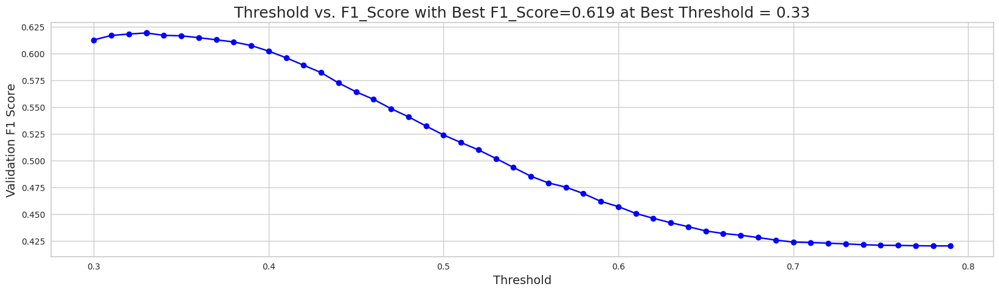

When using optimal threshold = 0.33...
Q0: F1 = 0.6190997075241875
==> Overall F1 = 0.6190997075241875
s
[I 2023-05-23 03:21:20,845] Trial 12 finished with value: 0.6190997075241875 and parameters: {'num_leaves': 33, 'learning_rate': 0.0607332922242878, 'feature_fraction': 0.8071196082486931, 'bagging_fraction': 0.4912721013255721, 'bagging_freq': 5, 'min_child_samples': 19, 'reg_alpha': 8.734003517869969, 'reg_lambda': 0.003770754066887437, 'subsample': 0.20368451659084302, 'colsample_bytree': 0.8458901335259928, 'min_split_gain': 0.14013513631863456, 'max_depth': 10}. Best is trial 6 with value: 0.6226513331444574.


--------------------------------------------------
question13, with210features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.931162066928904, subsample=0.94938365632126 will be ignored. Current value: bagging_fraction=0.931162066928904
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
[LightGBM] [Warning] feature_fraction is set=0.5739184339319252, colsample_bytree=0.6688206507051414 will be ignored. Current value: feature_fraction=0.5739184339319252


,mean
feature,
hover_duration_sum,150.4
object_click_event_name_counts,124.6
hover_duration_max,122.6
session_id,109.0
room_coor_y_min,107.2
room_coor_x_max,103.6
room_coor_x_min,103.0
screen_coor_x_std,98.4
room_coor_x_std,89.4


[[0.87628576 0.12371424]
 [0.83830841 0.16169159]
 [0.74004989 0.25995011]
 ...
 [0.73317659 0.26682341]
 [0.6697693  0.3302307 ]
 [0.80532946 0.19467054]]


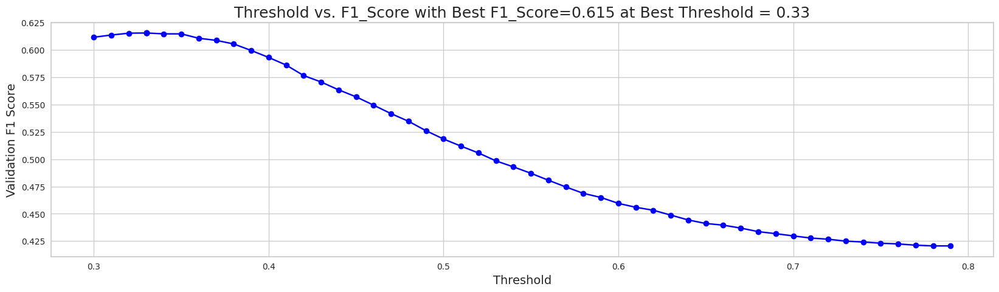

When using optimal threshold = 0.33...
Q0: F1 = 0.6154833942293123
==> Overall F1 = 0.6154833942293123
s
[I 2023-05-23 03:21:27,226] Trial 11 finished with value: 0.6154833942293123 and parameters: {'num_leaves': 77, 'learning_rate': 0.03624927048224329, 'feature_fraction': 0.9194656062998973, 'bagging_fraction': 0.751340304836443, 'bagging_freq': 9, 'min_child_samples': 66, 'reg_alpha': 0.0010630538885916523, 'reg_lambda': 0.031014710233087085, 'subsample': 0.2051422661087453, 'colsample_bytree': 0.3162753577202545, 'min_split_gain': 0.001975315002034732, 'max_depth': 0}. Best is trial 6 with value: 0.6226513331444574.


--------------------------------------------------
question13, with210features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.9980881472218793, subsample=0.9879271822884166 will be ignored. Current value: bagging_fraction=0.9980881472218793
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
[LightGBM] [Warning] feature_fraction is set=0.6022945658670602, colsample_bytree=0.6402374679248656 will be ignored. Current value: feature_fraction=0.6022945658670602


[LightGBM] [Warning] bagging_fraction is set=0.38129611267435937, subsample=0.9711063293335973 will be ignored. Current value: bagging_fraction=0.38129611267435937
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
[LightGBM] [Warning] feature_fraction is set=0.6643570507709573, colsample_bytree=0.616866308210483 will be ignored. Current value: feature_fraction=0.6643570507709573


,mean
feature,
hover_duration_sum,336.8
hover_duration_std,326.6
hover_duration_max,303.0
object_click_event_name_counts,266.8
hover_duration_mean,264.2
room_coor_x_max,252.8
screen_coor_y_std,236.6
room_coor_x_min,236.2
session_id,220.2


[[0.85934071 0.14065929]
 [0.84301603 0.15698397]
 [0.75362799 0.24637201]
 ...
 [0.66336612 0.33663388]
 [0.621504   0.378496  ]
 [0.80968503 0.19031497]]


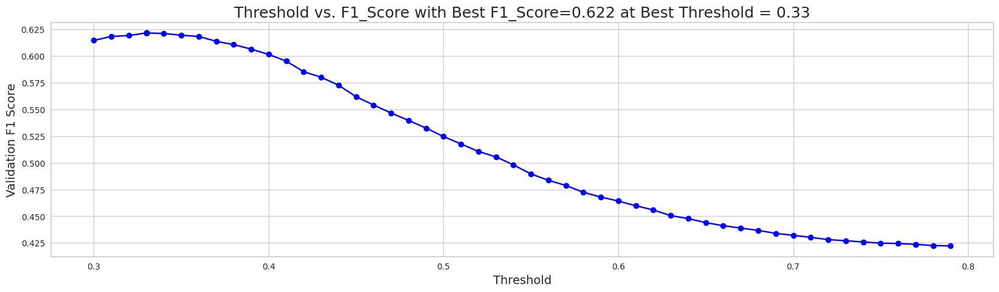

When using optimal threshold = 0.33...
Q0: F1 = 0.6215821045032006
==> Overall F1 = 0.6215821045032006
s
[I 2023-05-23 03:21:53,605] Trial 9 finished with value: 0.6215821045032006 and parameters: {'num_leaves': 30, 'learning_rate': 0.010878665752063511, 'feature_fraction': 0.21614999772788546, 'bagging_fraction': 0.720583794457649, 'bagging_freq': 2, 'min_child_samples': 30, 'reg_alpha': 0.016454685464334602, 'reg_lambda': 0.00797139211265433, 'subsample': 0.3215540266430135, 'colsample_bytree': 0.7687936928664906, 'min_split_gain': 0.010386319480057159, 'max_depth': -1}. Best is trial 6 with value: 0.6226513331444574.


--------------------------------------------------
question13, with210features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.7638734308312165, subsample=0.9960339593754545 will be ignored. Current value: bagging_fraction=0.7638734308312165
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
[LightGBM] [Warning] feature_fraction is set=0.576099106478281, colsample_bytree=0.6550409392408667 will be ignored. Current value: feature_fraction=0.576099106478281


[LightGBM] [Warning] bagging_fraction is set=0.931162066928904, subsample=0.94938365632126 will be ignored. Current value: bagging_fraction=0.931162066928904
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
[LightGBM] [Warning] feature_fraction is set=0.5739184339319252, colsample_bytree=0.6688206507051414 will be ignored. Current value: feature_fraction=0.5739184339319252
[LightGBM] [Warning] bagging_fraction is set=0.9980881472218793, subsample=0.9879271822884166 will be ignored. Current value: bagging_fraction=0.9980881472218793
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
[LightGBM] [Warning] featur

[LightGBM] [Warning] bagging_fraction is set=0.38129611267435937, subsample=0.9711063293335973 will be ignored. Current value: bagging_fraction=0.38129611267435937
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
[LightGBM] [Warning] feature_fraction is set=0.6643570507709573, colsample_bytree=0.616866308210483 will be ignored. Current value: feature_fraction=0.6643570507709573


[LightGBM] [Warning] bagging_fraction is set=0.931162066928904, subsample=0.94938365632126 will be ignored. Current value: bagging_fraction=0.931162066928904
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
[LightGBM] [Warning] feature_fraction is set=0.5739184339319252, colsample_bytree=0.6688206507051414 will be ignored. Current value: feature_fraction=0.5739184339319252


[LightGBM] [Warning] bagging_fraction is set=0.7638734308312165, subsample=0.9960339593754545 will be ignored. Current value: bagging_fraction=0.7638734308312165
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
[LightGBM] [Warning] feature_fraction is set=0.576099106478281, colsample_bytree=0.6550409392408667 will be ignored. Current value: feature_fraction=0.576099106478281


[LightGBM] [Warning] bagging_fraction is set=0.9980881472218793, subsample=0.9879271822884166 will be ignored. Current value: bagging_fraction=0.9980881472218793
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
[LightGBM] [Warning] feature_fraction is set=0.6022945658670602, colsample_bytree=0.6402374679248656 will be ignored. Current value: feature_fraction=0.6022945658670602


[LightGBM] [Warning] bagging_fraction is set=0.38129611267435937, subsample=0.9711063293335973 will be ignored. Current value: bagging_fraction=0.38129611267435937
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
[LightGBM] [Warning] feature_fraction is set=0.6643570507709573, colsample_bytree=0.616866308210483 will be ignored. Current value: feature_fraction=0.6643570507709573


[LightGBM] [Warning] bagging_fraction is set=0.931162066928904, subsample=0.94938365632126 will be ignored. Current value: bagging_fraction=0.931162066928904
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
[LightGBM] [Warning] feature_fraction is set=0.5739184339319252, colsample_bytree=0.6688206507051414 will be ignored. Current value: feature_fraction=0.5739184339319252


[LightGBM] [Warning] bagging_fraction is set=0.7638734308312165, subsample=0.9960339593754545 will be ignored. Current value: bagging_fraction=0.7638734308312165
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
[LightGBM] [Warning] feature_fraction is set=0.576099106478281, colsample_bytree=0.6550409392408667 will be ignored. Current value: feature_fraction=0.576099106478281


[LightGBM] [Warning] bagging_fraction is set=0.9980881472218793, subsample=0.9879271822884166 will be ignored. Current value: bagging_fraction=0.9980881472218793
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
[LightGBM] [Warning] feature_fraction is set=0.6022945658670602, colsample_bytree=0.6402374679248656 will be ignored. Current value: feature_fraction=0.6022945658670602


[LightGBM] [Warning] bagging_fraction is set=0.38129611267435937, subsample=0.9711063293335973 will be ignored. Current value: bagging_fraction=0.38129611267435937
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
[LightGBM] [Warning] feature_fraction is set=0.6643570507709573, colsample_bytree=0.616866308210483 will be ignored. Current value: feature_fraction=0.6643570507709573


[LightGBM] [Warning] bagging_fraction is set=0.931162066928904, subsample=0.94938365632126 will be ignored. Current value: bagging_fraction=0.931162066928904
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
[LightGBM] [Warning] feature_fraction is set=0.5739184339319252, colsample_bytree=0.6688206507051414 will be ignored. Current value: feature_fraction=0.5739184339319252


[LightGBM] [Warning] bagging_fraction is set=0.7638734308312165, subsample=0.9960339593754545 will be ignored. Current value: bagging_fraction=0.7638734308312165
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
[LightGBM] [Warning] feature_fraction is set=0.576099106478281, colsample_bytree=0.6550409392408667 will be ignored. Current value: feature_fraction=0.576099106478281


[LightGBM] [Warning] bagging_fraction is set=0.9980881472218793, subsample=0.9879271822884166 will be ignored. Current value: bagging_fraction=0.9980881472218793
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
[LightGBM] [Warning] feature_fraction is set=0.6022945658670602, colsample_bytree=0.6402374679248656 will be ignored. Current value: feature_fraction=0.6022945658670602


,mean
feature,
hover_duration_sum,292.2
hover_duration_max,249.8
object_click_event_name_counts,246.6
room_coor_y_min,208.0
room_coor_x_min,207.8
room_coor_x_max,198.0
hover_duration_std,192.0
session_id,191.6
screen_coor_x_std,190.2


[[0.85414038 0.14585962]
 [0.84351057 0.15648943]
 [0.73625178 0.26374822]
 ...
 [0.63484372 0.36515628]
 [0.64062309 0.35937691]
 [0.79784366 0.20215634]]


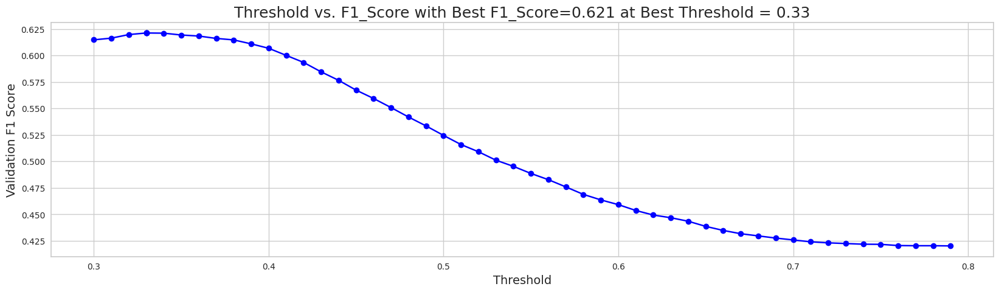

When using optimal threshold = 0.33...
Q0: F1 = 0.6212888450607186
==> Overall F1 = 0.6212888450607186
s
[I 2023-05-23 03:23:34,887] Trial 13 finished with value: 0.6212888450607186 and parameters: {'num_leaves': 26, 'learning_rate': 0.011084005979132089, 'feature_fraction': 0.6643570507709573, 'bagging_fraction': 0.38129611267435937, 'bagging_freq': 5, 'min_child_samples': 32, 'reg_alpha': 0.0010093631601345667, 'reg_lambda': 7.251432537570058, 'subsample': 0.9711063293335973, 'colsample_bytree': 0.616866308210483, 'min_split_gain': 0.027525690738736817, 'max_depth': 10}. Best is trial 6 with value: 0.6226513331444574.


--------------------------------------------------
question13, with210features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.7995641818795064, subsample=0.65120484548484 will be ignored. Current value: bagging_fraction=0.7995641818795064
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.5162557901158351, colsample_bytree=0.616123669138721 will be ignored. Current value: feature_fraction=0.5162557901158351


,mean
feature,
hover_duration_sum,216.0
object_click_event_name_counts,204.6
hover_duration_max,137.0
businesscards_fqid_counts,113.2
9_level_counts,101.6
10_level_counts,101.0
hover_duration_std,92.2
room_coor_x_max,89.0
elapsed_time_diff_std,86.8


[[0.84685139 0.15314861]
 [0.85830017 0.14169983]
 [0.72626998 0.27373002]
 ...
 [0.63097804 0.36902196]
 [0.63968644 0.36031356]
 [0.80650425 0.19349575]]


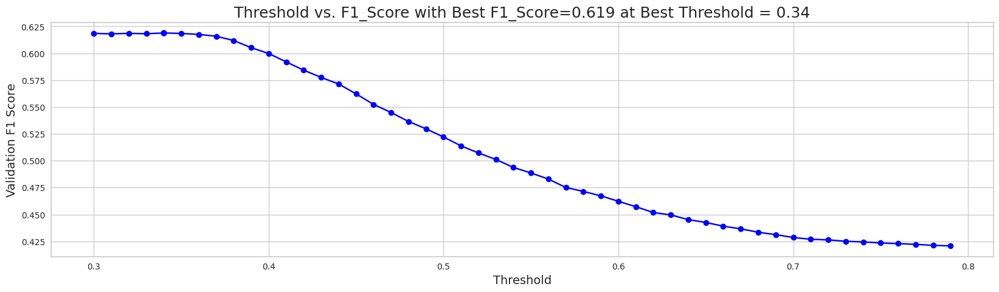

When using optimal threshold = 0.34...
Q0: F1 = 0.6188728367390745
==> Overall F1 = 0.6188728367390745
s
[I 2023-05-23 03:23:49,061] Trial 14 finished with value: 0.6188728367390745 and parameters: {'num_leaves': 10, 'learning_rate': 0.013560452539181679, 'feature_fraction': 0.5739184339319252, 'bagging_fraction': 0.931162066928904, 'bagging_freq': 4, 'min_child_samples': 98, 'reg_alpha': 0.10609575209427115, 'reg_lambda': 0.7160386406033931, 'subsample': 0.94938365632126, 'colsample_bytree': 0.6688206507051414, 'min_split_gain': 0.0011214307680892785, 'max_depth': -1}. Best is trial 6 with value: 0.6226513331444574.


--------------------------------------------------
question13, with210features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.772967234315809, subsample=0.6371653537438098 will be ignored. Current value: bagging_fraction=0.772967234315809
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=7, subsample_freq=0 will be ignored. Current value: bagging_freq=7
[LightGBM] [Warning] feature_fraction is set=0.4753255636542477, colsample_bytree=0.7142358459922566 will be ignored. Current value: feature_fraction=0.4753255636542477


[LightGBM] [Warning] bagging_fraction is set=0.7638734308312165, subsample=0.9960339593754545 will be ignored. Current value: bagging_fraction=0.7638734308312165
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
[LightGBM] [Warning] feature_fraction is set=0.576099106478281, colsample_bytree=0.6550409392408667 will be ignored. Current value: feature_fraction=0.576099106478281


,mean
feature,
hover_duration_sum,314.6
object_click_event_name_counts,295.2
hover_duration_max,232.4
room_coor_x_max,177.2
businesscards_fqid_counts,173.4
hover_duration_std,168.8
9_level_counts,167.6
room_coor_y_min,167.2
10_level_counts,159.6


[[0.85441951 0.14558049]
 [0.83765518 0.16234482]
 [0.71735983 0.28264017]
 ...
 [0.6203636  0.3796364 ]
 [0.60177366 0.39822634]
 [0.81048719 0.18951281]]


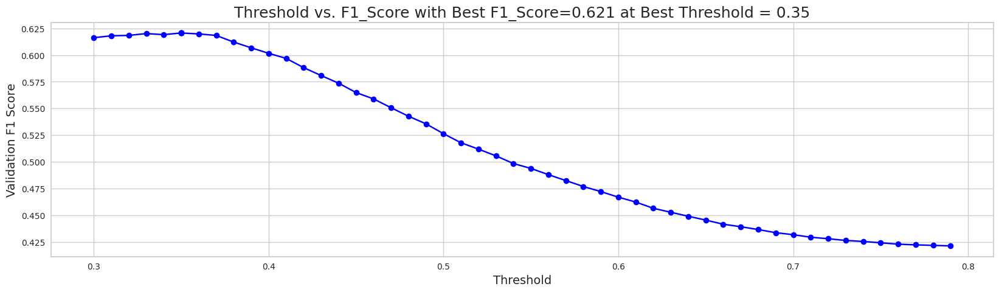

When using optimal threshold = 0.35...
Q0: F1 = 0.6207028733226041
==> Overall F1 = 0.6207028733226041
s
[I 2023-05-23 03:24:07,074] Trial 15 finished with value: 0.6207028733226041 and parameters: {'num_leaves': 19, 'learning_rate': 0.012116262075700941, 'feature_fraction': 0.6022945658670602, 'bagging_fraction': 0.9980881472218793, 'bagging_freq': 4, 'min_child_samples': 98, 'reg_alpha': 0.121880264243739, 'reg_lambda': 0.4924864050170224, 'subsample': 0.9879271822884166, 'colsample_bytree': 0.6402374679248656, 'min_split_gain': 0.011859606100086179, 'max_depth': -1}. Best is trial 6 with value: 0.6226513331444574.


--------------------------------------------------
question13, with210features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.8264008122824249, subsample=0.6456156818692872 will be ignored. Current value: bagging_fraction=0.8264008122824249
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.42538976005650664, colsample_bytree=0.7495957204742645 will be ignored. Current value: feature_fraction=0.42538976005650664


[LightGBM] [Warning] bagging_fraction is set=0.7995641818795064, subsample=0.65120484548484 will be ignored. Current value: bagging_fraction=0.7995641818795064
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.5162557901158351, colsample_bytree=0.616123669138721 will be ignored. Current value: feature_fraction=0.5162557901158351


[LightGBM] [Warning] bagging_fraction is set=0.772967234315809, subsample=0.6371653537438098 will be ignored. Current value: bagging_fraction=0.772967234315809
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=7, subsample_freq=0 will be ignored. Current value: bagging_freq=7
[LightGBM] [Warning] feature_fraction is set=0.4753255636542477, colsample_bytree=0.7142358459922566 will be ignored. Current value: feature_fraction=0.4753255636542477


[LightGBM] [Warning] bagging_fraction is set=0.8264008122824249, subsample=0.6456156818692872 will be ignored. Current value: bagging_fraction=0.8264008122824249
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.42538976005650664, colsample_bytree=0.7495957204742645 will be ignored. Current value: feature_fraction=0.42538976005650664


,mean
feature,
hover_duration_sum,262.2
object_click_event_name_counts,234.6
hover_duration_max,184.2
businesscards_fqid_counts,146.8
9_level_counts,129.0
room_coor_x_max,125.4
hover_duration_std,124.8
10_level_counts,120.8
11_level_counts,119.8


[[0.83392268 0.16607732]
 [0.83999485 0.16000515]
 [0.6828764  0.3171236 ]
 ...
 [0.60679006 0.39320994]
 [0.60789357 0.39210643]
 [0.80809838 0.19190162]]


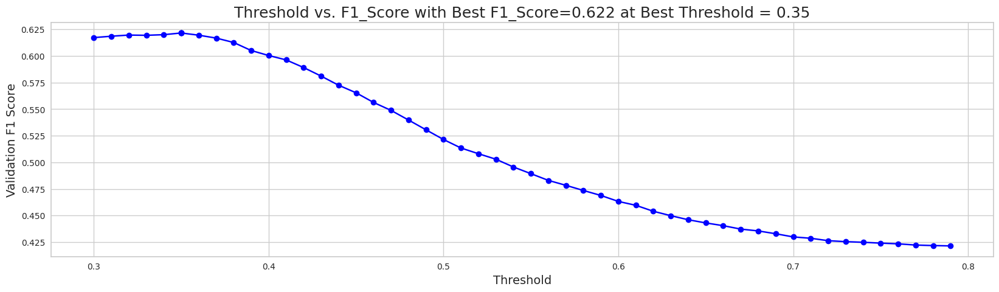

When using optimal threshold = 0.35...
Q0: F1 = 0.6216599621089851
==> Overall F1 = 0.6216599621089851
s
[I 2023-05-23 03:24:49,062] Trial 16 finished with value: 0.6216599621089851 and parameters: {'num_leaves': 12, 'learning_rate': 0.010887129987634117, 'feature_fraction': 0.576099106478281, 'bagging_fraction': 0.7638734308312165, 'bagging_freq': 4, 'min_child_samples': 34, 'reg_alpha': 0.0058534403159447735, 'reg_lambda': 0.1033716544476825, 'subsample': 0.9960339593754545, 'colsample_bytree': 0.6550409392408667, 'min_split_gain': 0.019171097103372524, 'max_depth': 8}. Best is trial 6 with value: 0.6226513331444574.


--------------------------------------------------
question13, with210features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.8016091870290105, subsample=0.8336257494654407 will be ignored. Current value: bagging_fraction=0.8016091870290105
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=7, subsample_freq=0 will be ignored. Current value: bagging_freq=7
[LightGBM] [Warning] feature_fraction is set=0.466235207243078, colsample_bytree=0.961830551895267 will be ignored. Current value: feature_fraction=0.466235207243078


[LightGBM] [Warning] bagging_fraction is set=0.8264008122824249, subsample=0.6456156818692872 will be ignored. Current value: bagging_fraction=0.8264008122824249
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.42538976005650664, colsample_bytree=0.7495957204742645 will be ignored. Current value: feature_fraction=0.42538976005650664


[LightGBM] [Warning] bagging_fraction is set=0.7995641818795064, subsample=0.65120484548484 will be ignored. Current value: bagging_fraction=0.7995641818795064
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.5162557901158351, colsample_bytree=0.616123669138721 will be ignored. Current value: feature_fraction=0.5162557901158351


[LightGBM] [Warning] bagging_fraction is set=0.772967234315809, subsample=0.6371653537438098 will be ignored. Current value: bagging_fraction=0.772967234315809
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=7, subsample_freq=0 will be ignored. Current value: bagging_freq=7
[LightGBM] [Warning] feature_fraction is set=0.4753255636542477, colsample_bytree=0.7142358459922566 will be ignored. Current value: feature_fraction=0.4753255636542477


[LightGBM] [Warning] bagging_fraction is set=0.8264008122824249, subsample=0.6456156818692872 will be ignored. Current value: bagging_fraction=0.8264008122824249
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.42538976005650664, colsample_bytree=0.7495957204742645 will be ignored. Current value: feature_fraction=0.42538976005650664


[LightGBM] [Warning] bagging_fraction is set=0.8016091870290105, subsample=0.8336257494654407 will be ignored. Current value: bagging_fraction=0.8016091870290105
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=7, subsample_freq=0 will be ignored. Current value: bagging_freq=7
[LightGBM] [Warning] feature_fraction is set=0.466235207243078, colsample_bytree=0.961830551895267 will be ignored. Current value: feature_fraction=0.466235207243078


[LightGBM] [Warning] bagging_fraction is set=0.8264008122824249, subsample=0.6456156818692872 will be ignored. Current value: bagging_fraction=0.8264008122824249
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.42538976005650664, colsample_bytree=0.7495957204742645 will be ignored. Current value: feature_fraction=0.42538976005650664


[LightGBM] [Warning] bagging_fraction is set=0.7995641818795064, subsample=0.65120484548484 will be ignored. Current value: bagging_fraction=0.7995641818795064
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.5162557901158351, colsample_bytree=0.616123669138721 will be ignored. Current value: feature_fraction=0.5162557901158351


[LightGBM] [Warning] bagging_fraction is set=0.772967234315809, subsample=0.6371653537438098 will be ignored. Current value: bagging_fraction=0.772967234315809
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=7, subsample_freq=0 will be ignored. Current value: bagging_freq=7
[LightGBM] [Warning] feature_fraction is set=0.4753255636542477, colsample_bytree=0.7142358459922566 will be ignored. Current value: feature_fraction=0.4753255636542477


[LightGBM] [Warning] bagging_fraction is set=0.8016091870290105, subsample=0.8336257494654407 will be ignored. Current value: bagging_fraction=0.8016091870290105
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=7, subsample_freq=0 will be ignored. Current value: bagging_freq=7
[LightGBM] [Warning] feature_fraction is set=0.466235207243078, colsample_bytree=0.961830551895267 will be ignored. Current value: feature_fraction=0.466235207243078


,mean
feature,
hover_duration_max,221.8
hover_duration_sum,210.2
object_click_event_name_counts,207.2
hover_duration_std,200.2
room_coor_x_max,183.8
session_id,179.2
hover_duration_mean,177.8
room_coor_x_min,170.4
room_coor_y_min,161.4


[[0.82299394 0.17700606]
 [0.85320486 0.14679514]
 [0.72823696 0.27176304]
 ...
 [0.66425842 0.33574158]
 [0.65197846 0.34802154]
 [0.78927771 0.21072229]]


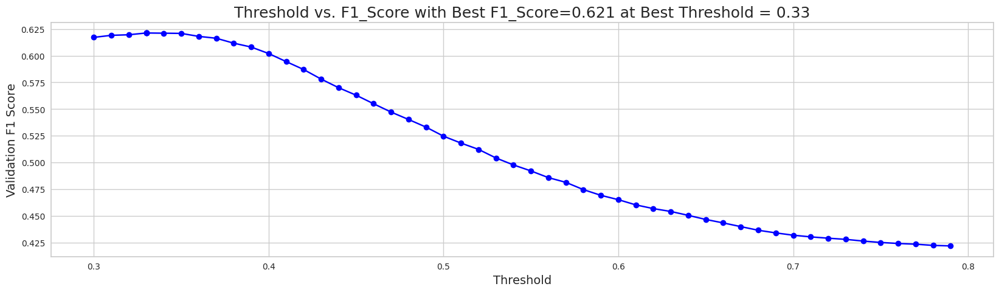

When using optimal threshold = 0.33...
Q0: F1 = 0.6212350580699639
==> Overall F1 = 0.6212350580699639
s
[I 2023-05-23 03:26:02,061] Trial 19 finished with value: 0.6212350580699639 and parameters: {'num_leaves': 44, 'learning_rate': 0.018349023963108987, 'feature_fraction': 0.42538976005650664, 'bagging_fraction': 0.8264008122824249, 'bagging_freq': 1, 'min_child_samples': 34, 'reg_alpha': 0.005719349074645438, 'reg_lambda': 0.0014170850958336108, 'subsample': 0.6456156818692872, 'colsample_bytree': 0.7495957204742645, 'min_split_gain': 0.007875762784385803, 'max_depth': 8}. Best is trial 6 with value: 0.6226513331444574.


--------------------------------------------------
question13, with210features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.8120933178223104, subsample=0.8615815827709613 will be ignored. Current value: bagging_fraction=0.8120933178223104
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=7, subsample_freq=0 will be ignored. Current value: bagging_freq=7
[LightGBM] [Warning] feature_fraction is set=0.7052359616059695, colsample_bytree=0.552676114113257 will be ignored. Current value: feature_fraction=0.7052359616059695


[LightGBM] [Warning] bagging_fraction is set=0.772967234315809, subsample=0.6371653537438098 will be ignored. Current value: bagging_fraction=0.772967234315809
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=7, subsample_freq=0 will be ignored. Current value: bagging_freq=7
[LightGBM] [Warning] feature_fraction is set=0.4753255636542477, colsample_bytree=0.7142358459922566 will be ignored. Current value: feature_fraction=0.4753255636542477


[LightGBM] [Warning] bagging_fraction is set=0.8016091870290105, subsample=0.8336257494654407 will be ignored. Current value: bagging_fraction=0.8016091870290105
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=7, subsample_freq=0 will be ignored. Current value: bagging_freq=7
[LightGBM] [Warning] feature_fraction is set=0.466235207243078, colsample_bytree=0.961830551895267 will be ignored. Current value: feature_fraction=0.466235207243078


[LightGBM] [Warning] bagging_fraction is set=0.7995641818795064, subsample=0.65120484548484 will be ignored. Current value: bagging_fraction=0.7995641818795064
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.5162557901158351, colsample_bytree=0.616123669138721 will be ignored. Current value: feature_fraction=0.5162557901158351


[LightGBM] [Warning] bagging_fraction is set=0.8120933178223104, subsample=0.8615815827709613 will be ignored. Current value: bagging_fraction=0.8120933178223104
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=7, subsample_freq=0 will be ignored. Current value: bagging_freq=7
[LightGBM] [Warning] feature_fraction is set=0.7052359616059695, colsample_bytree=0.552676114113257 will be ignored. Current value: feature_fraction=0.7052359616059695


[LightGBM] [Warning] bagging_fraction is set=0.8016091870290105, subsample=0.8336257494654407 will be ignored. Current value: bagging_fraction=0.8016091870290105
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=7, subsample_freq=0 will be ignored. Current value: bagging_freq=7
[LightGBM] [Warning] feature_fraction is set=0.466235207243078, colsample_bytree=0.961830551895267 will be ignored. Current value: feature_fraction=0.466235207243078


,mean
feature,
hover_duration_sum,338.4
hover_duration_max,314.0
object_click_event_name_counts,311.2
room_coor_x_min,264.2
room_coor_x_max,258.0
hover_duration_std,256.6
session_id,244.8
room_coor_y_min,244.4
hover_duration_mean,236.0


[[0.81975181 0.18024819]
 [0.84396928 0.15603072]
 [0.68043197 0.31956803]
 ...
 [0.62043771 0.37956229]
 [0.62243903 0.37756097]
 [0.79822621 0.20177379]]


[LightGBM] [Warning] bagging_fraction is set=0.8120933178223104, subsample=0.8615815827709613 will be ignored. Current value: bagging_fraction=0.8120933178223104
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=7, subsample_freq=0 will be ignored. Current value: bagging_freq=7
[LightGBM] [Warning] feature_fraction is set=0.7052359616059695, colsample_bytree=0.552676114113257 will be ignored. Current value: feature_fraction=0.7052359616059695


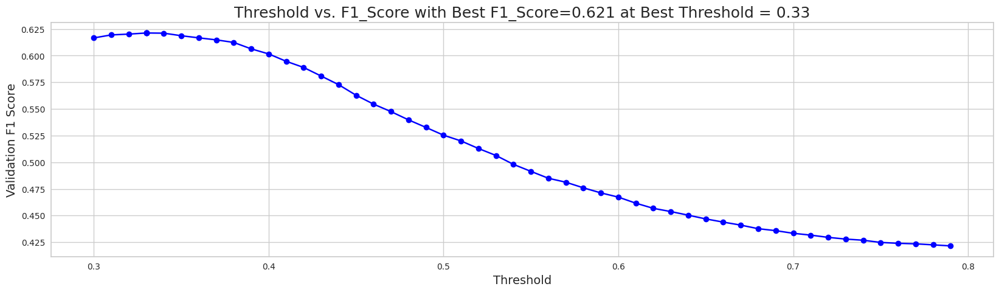

When using optimal threshold = 0.33...
Q0: F1 = 0.6212210592944076
==> Overall F1 = 0.6212210592944076
s
[I 2023-05-23 03:26:51,125] Trial 18 finished with value: 0.6212210592944076 and parameters: {'num_leaves': 41, 'learning_rate': 0.012033713540179564, 'feature_fraction': 0.4753255636542477, 'bagging_fraction': 0.772967234315809, 'bagging_freq': 7, 'min_child_samples': 34, 'reg_alpha': 0.005853917929501308, 'reg_lambda': 0.14898964246151422, 'subsample': 0.6371653537438098, 'colsample_bytree': 0.7142358459922566, 'min_split_gain': 0.0048592369996933674, 'max_depth': 8}. Best is trial 6 with value: 0.6226513331444574.


--------------------------------------------------
question13, with210features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.839449829897279, subsample=0.8472828717643716 will be ignored. Current value: bagging_fraction=0.839449829897279
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
[LightGBM] [Warning] feature_fraction is set=0.6972975882700063, colsample_bytree=0.570398650102318 will be ignored. Current value: feature_fraction=0.6972975882700063


,mean
feature,
hover_duration_sum,220.2
hover_duration_max,218.6
object_click_event_name_counts,198.6
hover_duration_std,182.6
room_coor_x_max,176.0
hover_duration_mean,174.6
session_id,168.0
room_coor_x_min,166.4
room_coor_y_min,158.8


[[0.83706031 0.16293969]
 [0.85109793 0.14890207]
 [0.69994428 0.30005572]
 ...
 [0.607511   0.392489  ]
 [0.60254176 0.39745824]
 [0.80985898 0.19014102]]


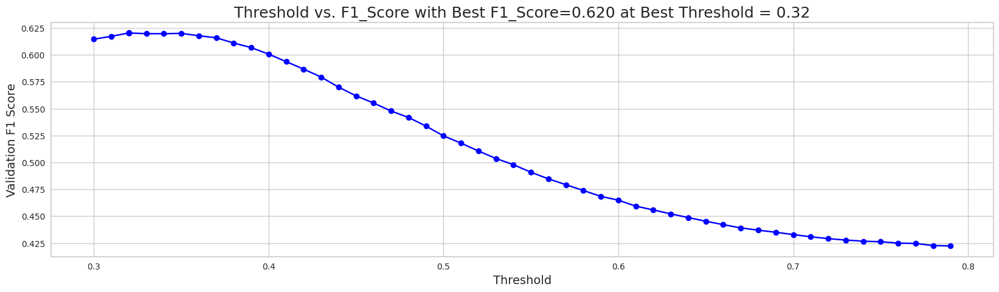

When using optimal threshold = 0.32...
Q0: F1 = 0.6203432556454535
==> Overall F1 = 0.6203432556454535
s
[I 2023-05-23 03:27:01,682] Trial 20 finished with value: 0.6203432556454535 and parameters: {'num_leaves': 44, 'learning_rate': 0.01799045071230244, 'feature_fraction': 0.466235207243078, 'bagging_fraction': 0.8016091870290105, 'bagging_freq': 7, 'min_child_samples': 40, 'reg_alpha': 0.004373363518285126, 'reg_lambda': 0.14063141632560047, 'subsample': 0.8336257494654407, 'colsample_bytree': 0.961830551895267, 'min_split_gain': 0.03585387582774997, 'max_depth': 8}. Best is trial 6 with value: 0.6226513331444574.


--------------------------------------------------
question13, with210features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.4400813341365126, subsample=0.8568850734653723 will be ignored. Current value: bagging_fraction=0.4400813341365126
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
[LightGBM] [Warning] feature_fraction is set=0.7048362063177542, colsample_bytree=0.5591658748790052 will be ignored. Current value: feature_fraction=0.7048362063177542


,mean
feature,
hover_duration_sum,446.2
object_click_event_name_counts,375.8
hover_duration_max,372.8
room_coor_x_max,326.8
room_coor_x_min,307.4
session_id,306.2
room_coor_y_min,292.8
hover_duration_std,292.2
room_coor_x_std,274.0


[[0.84767374 0.15232626]
 [0.85300181 0.14699819]
 [0.72055686 0.27944314]
 ...
 [0.62650029 0.37349971]
 [0.62177019 0.37822981]
 [0.8171318  0.1828682 ]]


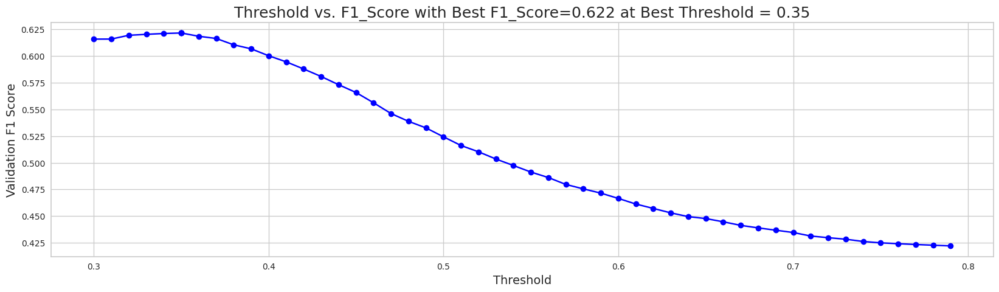

When using optimal threshold = 0.35...
Q0: F1 = 0.6216306493748062
==> Overall F1 = 0.6216306493748062
s
[I 2023-05-23 03:27:13,300] Trial 17 finished with value: 0.6216306493748062 and parameters: {'num_leaves': 41, 'learning_rate': 0.010077191983202368, 'feature_fraction': 0.5162557901158351, 'bagging_fraction': 0.7995641818795064, 'bagging_freq': 1, 'min_child_samples': 36, 'reg_alpha': 0.006931644423154531, 'reg_lambda': 0.1821385492549949, 'subsample': 0.65120484548484, 'colsample_bytree': 0.616123669138721, 'min_split_gain': 0.007932530336972249, 'max_depth': 8}. Best is trial 6 with value: 0.6226513331444574.


--------------------------------------------------
question13, with210features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.839449829897279, subsample=0.8472828717643716 will be ignored. Current value: bagging_fraction=0.839449829897279
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
[LightGBM] [Warning] feature_fraction is set=0.6972975882700063, colsample_bytree=0.570398650102318 will be ignored. Current value: feature_fraction=0.6972975882700063


[LightGBM] [Warning] bagging_fraction is set=0.855095938520495, subsample=0.830394817897385 will be ignored. Current value: bagging_fraction=0.855095938520495
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.6759152162253463, colsample_bytree=0.5998150726511974 will be ignored. Current value: feature_fraction=0.6759152162253463
[LightGBM] [Warning] bagging_fraction is set=0.8120933178223104, subsample=0.8615815827709613 will be ignored. Current value: bagging_fraction=0.8120933178223104
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=7, subsample_freq=0 will be ignored. Current value: bagging_freq=7
[LightGBM] [Warning] featu

[LightGBM] [Warning] bagging_fraction is set=0.4400813341365126, subsample=0.8568850734653723 will be ignored. Current value: bagging_fraction=0.4400813341365126
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
[LightGBM] [Warning] feature_fraction is set=0.7048362063177542, colsample_bytree=0.5591658748790052 will be ignored. Current value: feature_fraction=0.7048362063177542


[LightGBM] [Warning] bagging_fraction is set=0.4400813341365126, subsample=0.8568850734653723 will be ignored. Current value: bagging_fraction=0.4400813341365126
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
[LightGBM] [Warning] feature_fraction is set=0.7048362063177542, colsample_bytree=0.5591658748790052 will be ignored. Current value: feature_fraction=0.7048362063177542


[LightGBM] [Warning] bagging_fraction is set=0.839449829897279, subsample=0.8472828717643716 will be ignored. Current value: bagging_fraction=0.839449829897279
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
[LightGBM] [Warning] feature_fraction is set=0.6972975882700063, colsample_bytree=0.570398650102318 will be ignored. Current value: feature_fraction=0.6972975882700063


[LightGBM] [Warning] bagging_fraction is set=0.855095938520495, subsample=0.830394817897385 will be ignored. Current value: bagging_fraction=0.855095938520495
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.6759152162253463, colsample_bytree=0.5998150726511974 will be ignored. Current value: feature_fraction=0.6759152162253463


[LightGBM] [Warning] bagging_fraction is set=0.4400813341365126, subsample=0.8568850734653723 will be ignored. Current value: bagging_fraction=0.4400813341365126
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
[LightGBM] [Warning] feature_fraction is set=0.7048362063177542, colsample_bytree=0.5591658748790052 will be ignored. Current value: feature_fraction=0.7048362063177542


[LightGBM] [Warning] bagging_fraction is set=0.8120933178223104, subsample=0.8615815827709613 will be ignored. Current value: bagging_fraction=0.8120933178223104
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=7, subsample_freq=0 will be ignored. Current value: bagging_freq=7
[LightGBM] [Warning] feature_fraction is set=0.7052359616059695, colsample_bytree=0.552676114113257 will be ignored. Current value: feature_fraction=0.7052359616059695


[LightGBM] [Warning] bagging_fraction is set=0.839449829897279, subsample=0.8472828717643716 will be ignored. Current value: bagging_fraction=0.839449829897279
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
[LightGBM] [Warning] feature_fraction is set=0.6972975882700063, colsample_bytree=0.570398650102318 will be ignored. Current value: feature_fraction=0.6972975882700063


[LightGBM] [Warning] bagging_fraction is set=0.4400813341365126, subsample=0.8568850734653723 will be ignored. Current value: bagging_fraction=0.4400813341365126
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
[LightGBM] [Warning] feature_fraction is set=0.7048362063177542, colsample_bytree=0.5591658748790052 will be ignored. Current value: feature_fraction=0.7048362063177542


[LightGBM] [Warning] bagging_fraction is set=0.839449829897279, subsample=0.8472828717643716 will be ignored. Current value: bagging_fraction=0.839449829897279
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
[LightGBM] [Warning] feature_fraction is set=0.6972975882700063, colsample_bytree=0.570398650102318 will be ignored. Current value: feature_fraction=0.6972975882700063


[LightGBM] [Warning] bagging_fraction is set=0.855095938520495, subsample=0.830394817897385 will be ignored. Current value: bagging_fraction=0.855095938520495
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.6759152162253463, colsample_bytree=0.5998150726511974 will be ignored. Current value: feature_fraction=0.6759152162253463


,mean
feature,
hover_duration_sum,105.6
object_click_event_name_counts,101.2
hover_duration_max,80.2
room_coor_x_min,61.4
room_coor_x_max,61.0
businesscards_fqid_counts,54.8
elapsed_time_diff_std,54.6
room_coor_y_min,54.4
9_level_counts,53.4


[[0.82498303 0.17501697]
 [0.84982524 0.15017476]
 [0.7056716  0.2943284 ]
 ...
 [0.61263258 0.38736742]
 [0.65755572 0.34244428]
 [0.83882671 0.16117329]]


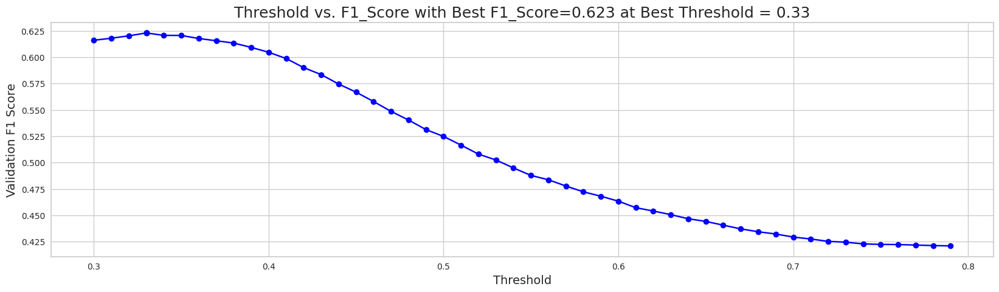

When using optimal threshold = 0.33...
Q0: F1 = 0.6229182714673
==> Overall F1 = 0.6229182714673
s
[I 2023-05-23 03:28:11,397] Trial 23 finished with value: 0.6229182714673 and parameters: {'num_leaves': 13, 'learning_rate': 0.022369557281689573, 'feature_fraction': 0.7048362063177542, 'bagging_fraction': 0.4400813341365126, 'bagging_freq': 6, 'min_child_samples': 76, 'reg_alpha': 0.038450032459774054, 'reg_lambda': 1.6065166656760606, 'subsample': 0.8568850734653723, 'colsample_bytree': 0.5591658748790052, 'min_split_gain': 0.036304335558276404, 'max_depth': 7}. Best is trial 23 with value: 0.6229182714673.


--------------------------------------------------
question13, with210features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.4631471719801008, subsample=0.8757537203689462 will be ignored. Current value: bagging_fraction=0.4631471719801008
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
[LightGBM] [Warning] feature_fraction is set=0.7143353519754307, colsample_bytree=0.5622409794270812 will be ignored. Current value: feature_fraction=0.7143353519754307


,mean
feature,
hover_duration_sum,290.8
hover_duration_max,253.0
object_click_event_name_counts,245.2
room_coor_x_max,231.0
session_id,212.6
room_coor_x_min,199.4
room_coor_y_min,193.2
hover_duration_std,187.4
elapsed_time_diff_std,185.8


[[0.8544907  0.1455093 ]
 [0.83769313 0.16230687]
 [0.67999321 0.32000679]
 ...
 [0.63752577 0.36247423]
 [0.57804779 0.42195221]
 [0.82764105 0.17235895]]


,mean
feature,
hover_duration_sum,132.2
object_click_event_name_counts,131.2
hover_duration_max,81.0
businesscards_fqid_counts,71.2
10_level_counts,60.4
9_level_counts,57.8
11_level_counts,55.8
room_coor_x_max,52.6
hover_duration_std,52.4


[[0.85085967 0.14914033]
 [0.8575342  0.1424658 ]
 [0.69443755 0.30556245]
 ...
 [0.60121306 0.39878694]
 [0.61003404 0.38996596]
 [0.7811291  0.2188709 ]]


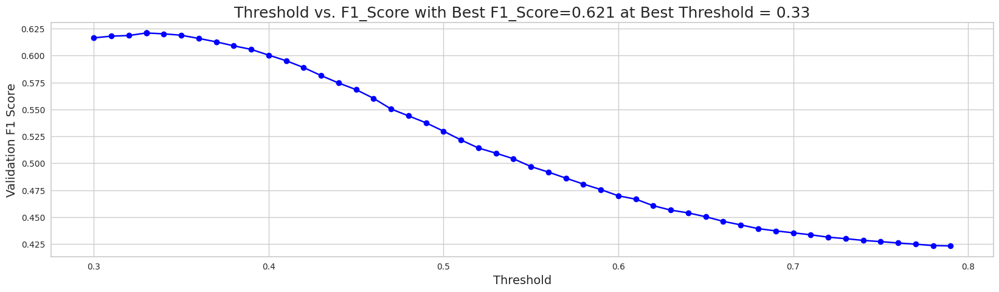

When using optimal threshold = 0.33...
Q0: F1 = 0.6209913545368284
==> Overall F1 = 0.6209913545368284
s
[I 2023-05-23 03:28:19,729] Trial 21 finished with value: 0.6209913545368284 and parameters: {'num_leaves': 47, 'learning_rate': 0.01726209952197337, 'feature_fraction': 0.7052359616059695, 'bagging_fraction': 0.8120933178223104, 'bagging_freq': 7, 'min_child_samples': 43, 'reg_alpha': 0.003929217011588002, 'reg_lambda': 0.13938580225930608, 'subsample': 0.8615815827709613, 'colsample_bytree': 0.552676114113257, 'min_split_gain': 0.03158610937442257, 'max_depth': 8}. Best is trial 23 with value: 0.6229182714673.


--------------------------------------------------
question13, with210features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.43294637418519877, subsample=0.8692410489303243 will be ignored. Current value: bagging_fraction=0.43294637418519877
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
[LightGBM] [Warning] feature_fraction is set=0.6903853795859017, colsample_bytree=0.5399875609360791 will be ignored. Current value: feature_fraction=0.6903853795859017


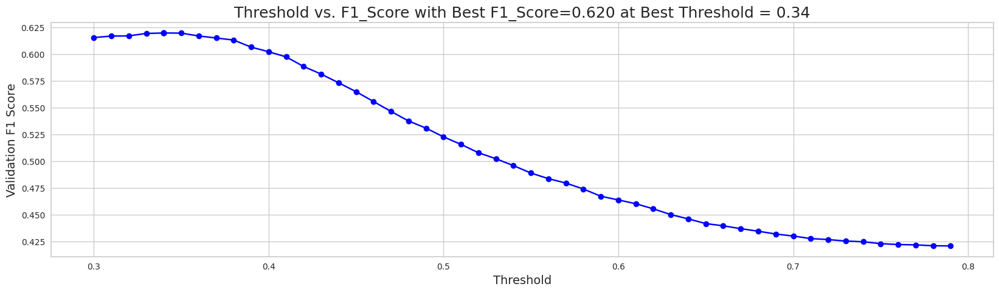

When using optimal threshold = 0.34...
Q0: F1 = 0.6195988939741227
==> Overall F1 = 0.6195988939741227
s
[I 2023-05-23 03:28:23,285] Trial 22 finished with value: 0.6195988939741227 and parameters: {'num_leaves': 11, 'learning_rate': 0.021340445173701757, 'feature_fraction': 0.6972975882700063, 'bagging_fraction': 0.839449829897279, 'bagging_freq': 6, 'min_child_samples': 49, 'reg_alpha': 0.0031861579067012564, 'reg_lambda': 1.7564086279125781, 'subsample': 0.8472828717643716, 'colsample_bytree': 0.570398650102318, 'min_split_gain': 0.031020666250436476, 'max_depth': 7}. Best is trial 23 with value: 0.6229182714673.


--------------------------------------------------
question13, with210features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.4435068972639077, subsample=0.8889634969993115 will be ignored. Current value: bagging_fraction=0.4435068972639077
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=8, subsample_freq=0 will be ignored. Current value: bagging_freq=8
[LightGBM] [Warning] feature_fraction is set=0.6049961863068882, colsample_bytree=0.4931796003020189 will be ignored. Current value: feature_fraction=0.6049961863068882


[LightGBM] [Warning] bagging_fraction is set=0.4631471719801008, subsample=0.8757537203689462 will be ignored. Current value: bagging_fraction=0.4631471719801008
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
[LightGBM] [Warning] feature_fraction is set=0.7143353519754307, colsample_bytree=0.5622409794270812 will be ignored. Current value: feature_fraction=0.7143353519754307


[LightGBM] [Warning] bagging_fraction is set=0.855095938520495, subsample=0.830394817897385 will be ignored. Current value: bagging_fraction=0.855095938520495
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.6759152162253463, colsample_bytree=0.5998150726511974 will be ignored. Current value: feature_fraction=0.6759152162253463


[LightGBM] [Warning] bagging_fraction is set=0.43294637418519877, subsample=0.8692410489303243 will be ignored. Current value: bagging_fraction=0.43294637418519877
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
[LightGBM] [Warning] feature_fraction is set=0.6903853795859017, colsample_bytree=0.5399875609360791 will be ignored. Current value: feature_fraction=0.6903853795859017


[LightGBM] [Warning] bagging_fraction is set=0.4435068972639077, subsample=0.8889634969993115 will be ignored. Current value: bagging_fraction=0.4435068972639077
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=8, subsample_freq=0 will be ignored. Current value: bagging_freq=8
[LightGBM] [Warning] feature_fraction is set=0.6049961863068882, colsample_bytree=0.4931796003020189 will be ignored. Current value: feature_fraction=0.6049961863068882


[LightGBM] [Warning] bagging_fraction is set=0.4631471719801008, subsample=0.8757537203689462 will be ignored. Current value: bagging_fraction=0.4631471719801008
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
[LightGBM] [Warning] feature_fraction is set=0.7143353519754307, colsample_bytree=0.5622409794270812 will be ignored. Current value: feature_fraction=0.7143353519754307


[LightGBM] [Warning] bagging_fraction is set=0.43294637418519877, subsample=0.8692410489303243 will be ignored. Current value: bagging_fraction=0.43294637418519877
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
[LightGBM] [Warning] feature_fraction is set=0.6903853795859017, colsample_bytree=0.5399875609360791 will be ignored. Current value: feature_fraction=0.6903853795859017


[LightGBM] [Warning] bagging_fraction is set=0.43294637418519877, subsample=0.8692410489303243 will be ignored. Current value: bagging_fraction=0.43294637418519877
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
[LightGBM] [Warning] feature_fraction is set=0.6903853795859017, colsample_bytree=0.5399875609360791 will be ignored. Current value: feature_fraction=0.6903853795859017


[LightGBM] [Warning] bagging_fraction is set=0.4435068972639077, subsample=0.8889634969993115 will be ignored. Current value: bagging_fraction=0.4435068972639077
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=8, subsample_freq=0 will be ignored. Current value: bagging_freq=8
[LightGBM] [Warning] feature_fraction is set=0.6049961863068882, colsample_bytree=0.4931796003020189 will be ignored. Current value: feature_fraction=0.6049961863068882
[LightGBM] [Warning] bagging_fraction is set=0.855095938520495, subsample=0.830394817897385 will be ignored. Current value: bagging_fraction=0.855095938520495
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] featu

[LightGBM] [Warning] bagging_fraction is set=0.4631471719801008, subsample=0.8757537203689462 will be ignored. Current value: bagging_fraction=0.4631471719801008
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
[LightGBM] [Warning] feature_fraction is set=0.7143353519754307, colsample_bytree=0.5622409794270812 will be ignored. Current value: feature_fraction=0.7143353519754307


[LightGBM] [Warning] bagging_fraction is set=0.43294637418519877, subsample=0.8692410489303243 will be ignored. Current value: bagging_fraction=0.43294637418519877
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
[LightGBM] [Warning] feature_fraction is set=0.6903853795859017, colsample_bytree=0.5399875609360791 will be ignored. Current value: feature_fraction=0.6903853795859017


[LightGBM] [Warning] bagging_fraction is set=0.4435068972639077, subsample=0.8889634969993115 will be ignored. Current value: bagging_fraction=0.4435068972639077
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=8, subsample_freq=0 will be ignored. Current value: bagging_freq=8
[LightGBM] [Warning] feature_fraction is set=0.6049961863068882, colsample_bytree=0.4931796003020189 will be ignored. Current value: feature_fraction=0.6049961863068882
[LightGBM] [Warning] bagging_fraction is set=0.4631471719801008, subsample=0.8757537203689462 will be ignored. Current value: bagging_fraction=0.4631471719801008
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
[LightGBM] [Warning] fe

,mean
feature,
object_click_event_name_counts,86.8
hover_duration_sum,83.6
hover_duration_max,66.0
businesscards_fqid_counts,46.2
hover_duration_std,43.4
room_coor_x_min,42.2
11_level_counts,41.8
room_coor_x_max,41.6
room_coor_y_min,41.2


[[0.85907792 0.14092208]
 [0.83924185 0.16075815]
 [0.72322343 0.27677657]
 ...
 [0.5909233  0.4090767 ]
 [0.66648184 0.33351816]
 [0.80467977 0.19532023]]


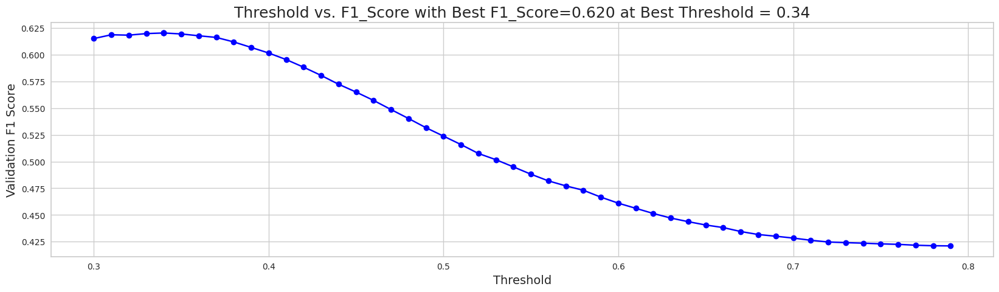

When using optimal threshold = 0.34...
Q0: F1 = 0.6202719630951508
==> Overall F1 = 0.6202719630951508
s
[I 2023-05-23 03:29:13,768] Trial 26 finished with value: 0.6202719630951508 and parameters: {'num_leaves': 10, 'learning_rate': 0.02537027770943864, 'feature_fraction': 0.6903853795859017, 'bagging_fraction': 0.43294637418519877, 'bagging_freq': 6, 'min_child_samples': 78, 'reg_alpha': 0.0405767290572386, 'reg_lambda': 2.333196261799316, 'subsample': 0.8692410489303243, 'colsample_bytree': 0.5399875609360791, 'min_split_gain': 0.021906442559880022, 'max_depth': 6}. Best is trial 23 with value: 0.6229182714673.


--------------------------------------------------
question13, with210features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.6080331903153091, subsample=0.7721432217801751 will be ignored. Current value: bagging_fraction=0.6080331903153091
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=8, subsample_freq=0 will be ignored. Current value: bagging_freq=8
[LightGBM] [Warning] feature_fraction is set=0.6013902285262808, colsample_bytree=0.68495772851688 will be ignored. Current value: feature_fraction=0.6013902285262808


,mean
feature,
hover_duration_sum,192.4
object_click_event_name_counts,183.6
hover_duration_max,129.8
businesscards_fqid_counts,108.4
9_level_counts,93.8
10_level_counts,89.4
11_level_counts,88.0
room_coor_x_max,84.0
elapsed_time_diff_std,82.4


[[0.84742033 0.15257967]
 [0.8485378  0.1514622 ]
 [0.68926694 0.31073306]
 ...
 [0.62953854 0.37046146]
 [0.62871883 0.37128117]
 [0.81730147 0.18269853]]


[LightGBM] [Warning] bagging_fraction is set=0.4435068972639077, subsample=0.8889634969993115 will be ignored. Current value: bagging_fraction=0.4435068972639077
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=8, subsample_freq=0 will be ignored. Current value: bagging_freq=8
[LightGBM] [Warning] feature_fraction is set=0.6049961863068882, colsample_bytree=0.4931796003020189 will be ignored. Current value: feature_fraction=0.6049961863068882


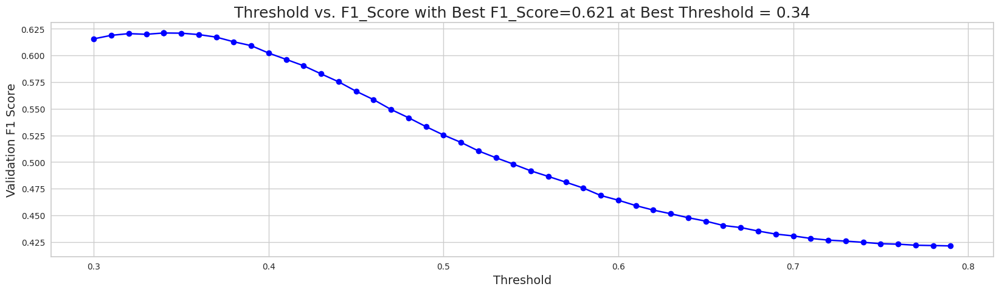

When using optimal threshold = 0.34...
Q0: F1 = 0.6211075883308123


==> Overall F1 = 0.6211075883308123
s
[I 2023-05-23 03:29:19,037] Trial 24 finished with value: 0.6211075883308123 and parameters: {'num_leaves': 12, 'learning_rate': 0.01616002616417944, 'feature_fraction': 0.6759152162253463, 'bagging_fraction': 0.855095938520495, 'bagging_freq': 1, 'min_child_samples': 48, 'reg_alpha': 0.002676096803642318, 'reg_lambda': 1.590711882432361, 'subsample': 0.830394817897385, 'colsample_bytree': 0.5998150726511974, 'min_split_gain': 0.025641275994934466, 'max_depth': 7}. Best is trial 23 with value: 0.6229182714673.


--------------------------------------------------
question13, with210features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.6744968921523209, subsample=0.7621919465667923 will be ignored. Current value: bagging_fraction=0.6744968921523209
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=8, subsample_freq=0 will be ignored. Current value: bagging_freq=8
[LightGBM] [Warning] feature_fraction is set=0.9697463474047596, colsample_bytree=0.6851256852565563 will be ignored. Current value: feature_fraction=0.9697463474047596


,mean
feature,
hover_duration_sum,106.2
object_click_event_name_counts,97.4
hover_duration_max,80.2
room_coor_x_max,59.2
9_level_counts,57.2
room_coor_y_min,55.4
room_coor_x_min,55.4
hover_duration_std,53.6
businesscards_fqid_counts,53.2


[[0.86338099 0.13661901]
 [0.84200818 0.15799182]
 [0.73905229 0.26094771]
 ...
 [0.61116665 0.38883335]
 [0.65262899 0.34737101]
 [0.83496835 0.16503165]]


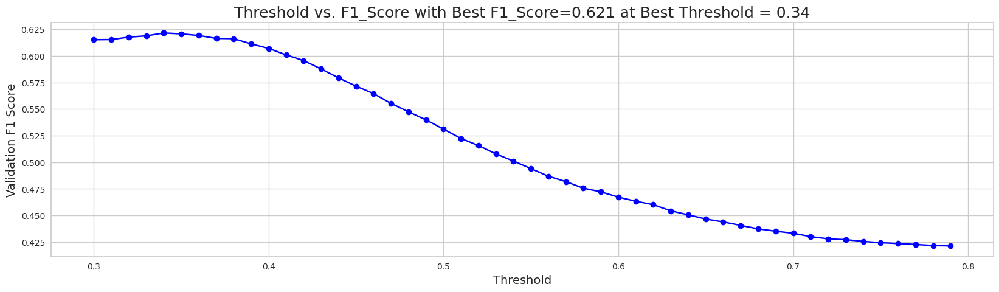

When using optimal threshold = 0.34...
Q0: F1 = 0.6214827987542926
==> Overall F1 = 0.6214827987542926
s
[I 2023-05-23 03:29:25,239] Trial 25 finished with value: 0.6214827987542926 and parameters: {'num_leaves': 11, 'learning_rate': 0.024428346564013798, 'feature_fraction': 0.7143353519754307, 'bagging_fraction': 0.4631471719801008, 'bagging_freq': 6, 'min_child_samples': 76, 'reg_alpha': 0.031862553678164054, 'reg_lambda': 2.1448600370013913, 'subsample': 0.8757537203689462, 'colsample_bytree': 0.5622409794270812, 'min_split_gain': 0.028433761453705218, 'max_depth': 7}. Best is trial 23 with value: 0.6229182714673.


--------------------------------------------------
question13, with210features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.5998835096074291, subsample=0.7620966726333119 will be ignored. Current value: bagging_fraction=0.5998835096074291
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=8, subsample_freq=0 will be ignored. Current value: bagging_freq=8
[LightGBM] [Warning] feature_fraction is set=0.6093677605216195, colsample_bytree=0.6896875075962735 will be ignored. Current value: feature_fraction=0.6093677605216195


,mean
feature,
hover_duration_sum,110.8
object_click_event_name_counts,101.4
hover_duration_max,100.8
room_coor_x_max,79.8
session_id,72.6
screen_coor_x_std,71.8
hover_duration_std,70.6
elapsed_time_diff_std,68.2
room_coor_x_std,67.2


[[0.85843856 0.14156144]
 [0.8833375  0.1166625 ]
 [0.7611503  0.2388497 ]
 ...
 [0.65309017 0.34690983]
 [0.69082378 0.30917622]
 [0.84968589 0.15031411]]


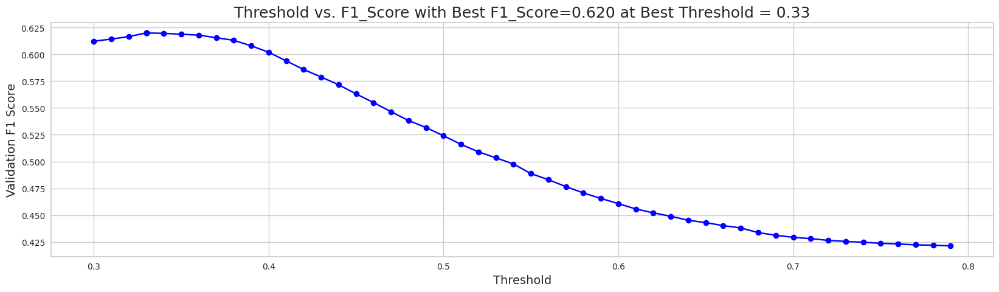

When using optimal threshold = 0.33...
Q0: F1 = 0.6199869814752212
==> Overall F1 = 0.6199869814752212
s
[I 2023-05-23 03:29:37,237] Trial 27 finished with value: 0.6199869814752212 and parameters: {'num_leaves': 20, 'learning_rate': 0.025892442242842137, 'feature_fraction': 0.6049961863068882, 'bagging_fraction': 0.4435068972639077, 'bagging_freq': 8, 'min_child_samples': 78, 'reg_alpha': 0.045584132479533454, 'reg_lambda': 2.876444665476622, 'subsample': 0.8889634969993115, 'colsample_bytree': 0.4931796003020189, 'min_split_gain': 0.06469915292105073, 'max_depth': 6}. Best is trial 23 with value: 0.6229182714673.


--------------------------------------------------
question13, with210features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.586067099987271, subsample=0.7658771549277643 will be ignored. Current value: bagging_fraction=0.586067099987271
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
[LightGBM] [Warning] feature_fraction is set=0.5338196637576148, colsample_bytree=0.682472954666367 will be ignored. Current value: feature_fraction=0.5338196637576148


[LightGBM] [Warning] bagging_fraction is set=0.6080331903153091, subsample=0.7721432217801751 will be ignored. Current value: bagging_fraction=0.6080331903153091
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=8, subsample_freq=0 will be ignored. Current value: bagging_freq=8
[LightGBM] [Warning] feature_fraction is set=0.6013902285262808, colsample_bytree=0.68495772851688 will be ignored. Current value: feature_fraction=0.6013902285262808


[LightGBM] [Warning] bagging_fraction is set=0.5998835096074291, subsample=0.7620966726333119 will be ignored. Current value: bagging_fraction=0.5998835096074291
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=8, subsample_freq=0 will be ignored. Current value: bagging_freq=8
[LightGBM] [Warning] feature_fraction is set=0.6093677605216195, colsample_bytree=0.6896875075962735 will be ignored. Current value: feature_fraction=0.6093677605216195


[LightGBM] [Warning] bagging_fraction is set=0.6744968921523209, subsample=0.7621919465667923 will be ignored. Current value: bagging_fraction=0.6744968921523209
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=8, subsample_freq=0 will be ignored. Current value: bagging_freq=8
[LightGBM] [Warning] feature_fraction is set=0.9697463474047596, colsample_bytree=0.6851256852565563 will be ignored. Current value: feature_fraction=0.9697463474047596


[LightGBM] [Warning] bagging_fraction is set=0.586067099987271, subsample=0.7658771549277643 will be ignored. Current value: bagging_fraction=0.586067099987271
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
[LightGBM] [Warning] feature_fraction is set=0.5338196637576148, colsample_bytree=0.682472954666367 will be ignored. Current value: feature_fraction=0.5338196637576148


[LightGBM] [Warning] bagging_fraction is set=0.5998835096074291, subsample=0.7620966726333119 will be ignored. Current value: bagging_fraction=0.5998835096074291
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=8, subsample_freq=0 will be ignored. Current value: bagging_freq=8
[LightGBM] [Warning] feature_fraction is set=0.6093677605216195, colsample_bytree=0.6896875075962735 will be ignored. Current value: feature_fraction=0.6093677605216195


[LightGBM] [Warning] bagging_fraction is set=0.6080331903153091, subsample=0.7721432217801751 will be ignored. Current value: bagging_fraction=0.6080331903153091
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=8, subsample_freq=0 will be ignored. Current value: bagging_freq=8
[LightGBM] [Warning] feature_fraction is set=0.6013902285262808, colsample_bytree=0.68495772851688 will be ignored. Current value: feature_fraction=0.6013902285262808


[LightGBM] [Warning] bagging_fraction is set=0.6744968921523209, subsample=0.7621919465667923 will be ignored. Current value: bagging_fraction=0.6744968921523209
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=8, subsample_freq=0 will be ignored. Current value: bagging_freq=8
[LightGBM] [Warning] feature_fraction is set=0.9697463474047596, colsample_bytree=0.6851256852565563 will be ignored. Current value: feature_fraction=0.9697463474047596


[LightGBM] [Warning] bagging_fraction is set=0.586067099987271, subsample=0.7658771549277643 will be ignored. Current value: bagging_fraction=0.586067099987271
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
[LightGBM] [Warning] feature_fraction is set=0.5338196637576148, colsample_bytree=0.682472954666367 will be ignored. Current value: feature_fraction=0.5338196637576148


[LightGBM] [Warning] bagging_fraction is set=0.6744968921523209, subsample=0.7621919465667923 will be ignored. Current value: bagging_fraction=0.6744968921523209
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=8, subsample_freq=0 will be ignored. Current value: bagging_freq=8
[LightGBM] [Warning] feature_fraction is set=0.9697463474047596, colsample_bytree=0.6851256852565563 will be ignored. Current value: feature_fraction=0.9697463474047596


[LightGBM] [Warning] bagging_fraction is set=0.6080331903153091, subsample=0.7721432217801751 will be ignored. Current value: bagging_fraction=0.6080331903153091
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=8, subsample_freq=0 will be ignored. Current value: bagging_freq=8
[LightGBM] [Warning] feature_fraction is set=0.6013902285262808, colsample_bytree=0.68495772851688 will be ignored. Current value: feature_fraction=0.6013902285262808


[LightGBM] [Warning] bagging_fraction is set=0.5998835096074291, subsample=0.7620966726333119 will be ignored. Current value: bagging_fraction=0.5998835096074291
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=8, subsample_freq=0 will be ignored. Current value: bagging_freq=8
[LightGBM] [Warning] feature_fraction is set=0.6093677605216195, colsample_bytree=0.6896875075962735 will be ignored. Current value: feature_fraction=0.6093677605216195


[LightGBM] [Warning] bagging_fraction is set=0.6744968921523209, subsample=0.7621919465667923 will be ignored. Current value: bagging_fraction=0.6744968921523209
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=8, subsample_freq=0 will be ignored. Current value: bagging_freq=8
[LightGBM] [Warning] feature_fraction is set=0.9697463474047596, colsample_bytree=0.6851256852565563 will be ignored. Current value: feature_fraction=0.9697463474047596


[LightGBM] [Warning] bagging_fraction is set=0.6080331903153091, subsample=0.7721432217801751 will be ignored. Current value: bagging_fraction=0.6080331903153091
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=8, subsample_freq=0 will be ignored. Current value: bagging_freq=8
[LightGBM] [Warning] feature_fraction is set=0.6013902285262808, colsample_bytree=0.68495772851688 will be ignored. Current value: feature_fraction=0.6013902285262808


[LightGBM] [Warning] bagging_fraction is set=0.5998835096074291, subsample=0.7620966726333119 will be ignored. Current value: bagging_fraction=0.5998835096074291
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=8, subsample_freq=0 will be ignored. Current value: bagging_freq=8
[LightGBM] [Warning] feature_fraction is set=0.6093677605216195, colsample_bytree=0.6896875075962735 will be ignored. Current value: feature_fraction=0.6093677605216195


[LightGBM] [Warning] bagging_fraction is set=0.586067099987271, subsample=0.7658771549277643 will be ignored. Current value: bagging_fraction=0.586067099987271
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
[LightGBM] [Warning] feature_fraction is set=0.5338196637576148, colsample_bytree=0.682472954666367 will be ignored. Current value: feature_fraction=0.5338196637576148


,mean
feature,
hover_duration_sum,229.2
object_click_event_name_counts,216.4
hover_duration_max,157.2
businesscards_fqid_counts,134.6
elapsed_time_diff_std,129.6
room_coor_x_max,124.8
room_coor_y_min,122.0
room_coor_x_min,117.4
10_level_counts,114.2


[[0.84256653 0.15743347]
 [0.85273877 0.14726123]
 [0.72362585 0.27637415]
 ...
 [0.58554436 0.41445564]
 [0.59604022 0.40395978]
 [0.81211097 0.18788903]]


,mean
feature,
hover_duration_sum,254.8
hover_duration_max,215.8
object_click_event_name_counts,211.6
room_coor_x_max,184.8
room_coor_y_min,180.8
room_coor_x_min,176.2
hover_duration_std,169.2
screen_coor_x_std,164.4
session_id,158.0


[[0.85168644 0.14831356]
 [0.84257332 0.15742668]
 [0.74563463 0.25436537]
 ...
 [0.59293271 0.40706729]
 [0.62648505 0.37351495]
 [0.81120208 0.18879792]]


,mean
feature,
hover_duration_sum,227.2
hover_duration_max,186.8
object_click_event_name_counts,184.4
room_coor_x_max,154.8
room_coor_y_min,142.8
room_coor_x_min,139.4
hover_duration_std,133.6
screen_coor_x_std,129.2
session_id,129.2


[[0.84624325 0.15375675]
 [0.84395697 0.15604303]
 [0.67828949 0.32171051]
 ...
 [0.65657103 0.34342897]
 [0.62671178 0.37328822]
 [0.8056872  0.1943128 ]]


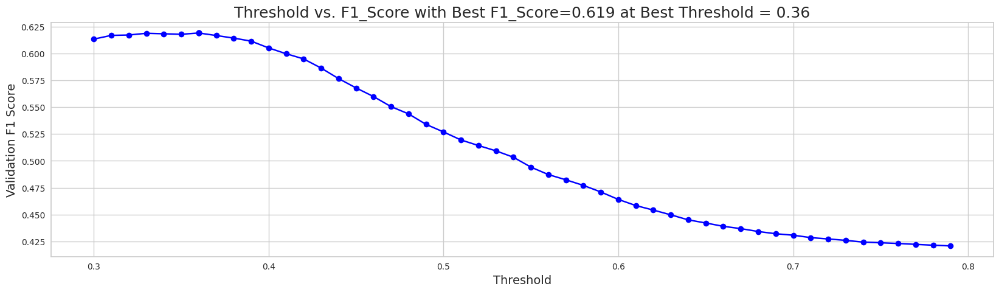

When using optimal threshold = 0.36...
Q0: F1 = 0.6189396246778651
==> Overall F1 = 0.6189396246778651
s
[I 2023-05-23 03:31:37,766] Trial 29 finished with value: 0.6189396246778651 and parameters: {'num_leaves': 20, 'learning_rate': 0.014786713670579621, 'feature_fraction': 0.9697463474047596, 'bagging_fraction': 0.6744968921523209, 'bagging_freq': 8, 'min_child_samples': 72, 'reg_alpha': 0.037416224440334024, 'reg_lambda': 4.392917771323621, 'subsample': 0.7621919465667923, 'colsample_bytree': 0.6851256852565563, 'min_split_gain': 0.0509934055033569, 'max_depth': 9}. Best is trial 23 with value: 0.6229182714673.


--------------------------------------------------
question13, with210features
--------------------------------------------------


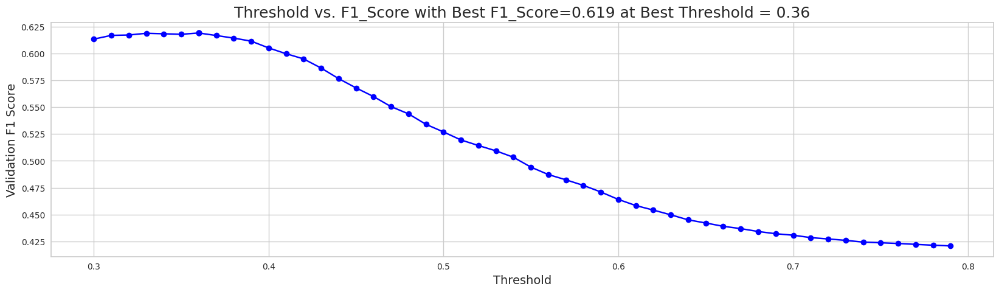

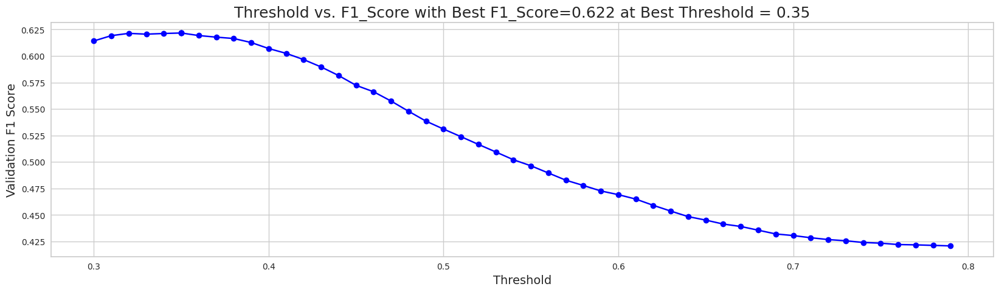

When using optimal threshold = 0.35...
Q0: F1 = 0.621667779819354
==> Overall F1 = 0.621667779819354
s
[I 2023-05-23 03:31:40,034] Trial 28 finished with value: 0.621667779819354 and parameters: {'num_leaves': 24, 'learning_rate': 0.014936290305859874, 'feature_fraction': 0.6013902285262808, 'bagging_fraction': 0.6080331903153091, 'bagging_freq': 8, 'min_child_samples': 73, 'reg_alpha': 0.04020152625729214, 'reg_lambda': 8.15720524937744, 'subsample': 0.7721432217801751, 'colsample_bytree': 0.68495772851688, 'min_split_gain': 0.07334161636885271, 'max_depth': 9}. Best is trial 23 with value: 0.6229182714673.


--------------------------------------------------
question13, with210features
--------------------------------------------------
[LightGBM] [Warning] bagging_fraction is set=0.5736535322646905, subsample=0.9974336540022137 will be ignored. Current value: bagging_fraction=0.5736535322646905
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
[LightGBM] [Warning] feature_fraction is set=0.7919124203170682, colsample_bytree=0.8985347997190687 will be ignored. Current value: feature_fraction=0.7919124203170682


[LightGBM] [Warning] bagging_fraction is set=0.5720623020509947, subsample=0.7485000736508204 will be ignored. Current value: bagging_fraction=0.5720623020509947
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=10, subsample_freq=0 will be ignored. Current value: bagging_freq=10
[LightGBM] [Warning] feature_fraction is set=0.8119972762738792, colsample_bytree=0.8977473699623884 will be ignored. Current value: feature_fraction=0.8119972762738792


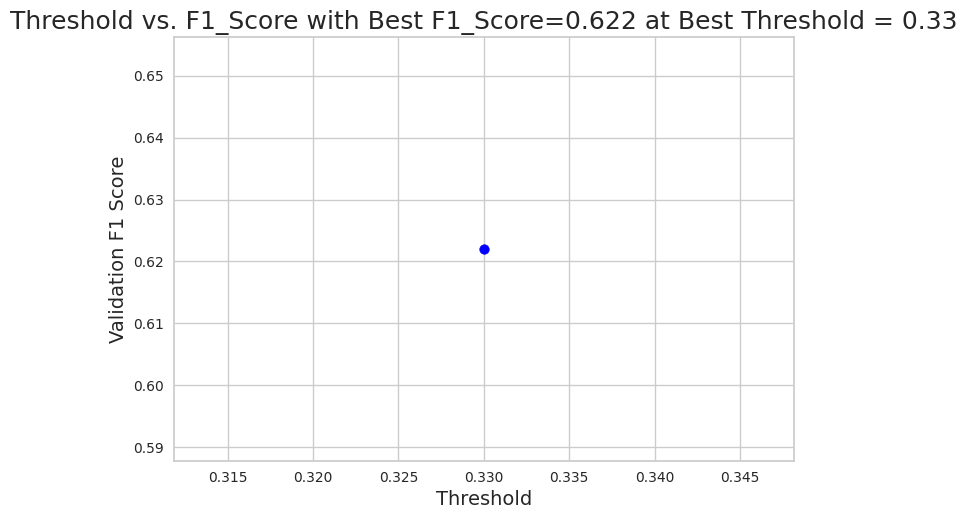

When using optimal threshold = 0.33...
Q0: F1 = 0.6220123191979088
==> Overall F1 = 0.6220123191979088
s
[I 2023-05-23 03:31:42,042] Trial 30 finished with value: 0.6220123191979088 and parameters: {'num_leaves': 21, 'learning_rate': 0.01585656418368, 'feature_fraction': 0.6093677605216195, 'bagging_fraction': 0.5998835096074291, 'bagging_freq': 8, 'min_child_samples': 69, 'reg_alpha': 0.0017217479593275879, 'reg_lambda': 5.834507633836067, 'subsample': 0.7620966726333119, 'colsample_bytree': 0.6896875075962735, 'min_split_gain': 0.06573990497854855, 'max_depth': 9}. Best is trial 23 with value: 0.6229182714673.


--------------------------------------------------
question13, with210features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.5815109729554598, subsample=0.7607661225589303 will be ignored. Current value: bagging_fraction=0.5815109729554598
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=10, subsample_freq=0 will be ignored. Current value: bagging_freq=10
[LightGBM] [Warning] feature_fraction is set=0.6175113017432583, colsample_bytree=0.7003033963788328 will be ignored. Current value: feature_fraction=0.6175113017432583


[LightGBM] [Warning] bagging_fraction is set=0.586067099987271, subsample=0.7658771549277643 will be ignored. Current value: bagging_fraction=0.586067099987271
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
[LightGBM] [Warning] feature_fraction is set=0.5338196637576148, colsample_bytree=0.682472954666367 will be ignored. Current value: feature_fraction=0.5338196637576148


[LightGBM] [Warning] bagging_fraction is set=0.5720623020509947, subsample=0.7485000736508204 will be ignored. Current value: bagging_fraction=0.5720623020509947
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=10, subsample_freq=0 will be ignored. Current value: bagging_freq=10
[LightGBM] [Warning] feature_fraction is set=0.8119972762738792, colsample_bytree=0.8977473699623884 will be ignored. Current value: feature_fraction=0.8119972762738792


[LightGBM] [Warning] bagging_fraction is set=0.5736535322646905, subsample=0.9974336540022137 will be ignored. Current value: bagging_fraction=0.5736535322646905
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
[LightGBM] [Warning] feature_fraction is set=0.7919124203170682, colsample_bytree=0.8985347997190687 will be ignored. Current value: feature_fraction=0.7919124203170682


[LightGBM] [Warning] bagging_fraction is set=0.5720623020509947, subsample=0.7485000736508204 will be ignored. Current value: bagging_fraction=0.5720623020509947
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=10, subsample_freq=0 will be ignored. Current value: bagging_freq=10
[LightGBM] [Warning] feature_fraction is set=0.8119972762738792, colsample_bytree=0.8977473699623884 will be ignored. Current value: feature_fraction=0.8119972762738792


,mean
feature,
hover_duration_sum,253.4
hover_duration_max,220.0
object_click_event_name_counts,219.6
room_coor_x_max,183.2
room_coor_x_min,169.8
hover_duration_std,167.0
room_coor_y_min,163.6
9_level_counts,153.2
hover_duration_mean,152.2


[[0.85807639 0.14192361]
 [0.85071289 0.14928711]
 [0.73003024 0.26996976]
 ...
 [0.65045395 0.34954605]
 [0.64852534 0.35147466]
 [0.78582344 0.21417656]]


[LightGBM] [Warning] bagging_fraction is set=0.5815109729554598, subsample=0.7607661225589303 will be ignored. Current value: bagging_fraction=0.5815109729554598
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=10, subsample_freq=0 will be ignored. Current value: bagging_freq=10
[LightGBM] [Warning] feature_fraction is set=0.6175113017432583, colsample_bytree=0.7003033963788328 will be ignored. Current value: feature_fraction=0.6175113017432583


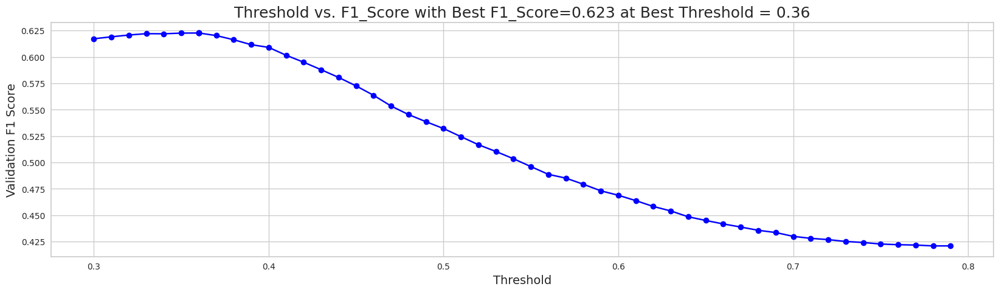

When using optimal threshold = 0.36...
Q0: F1 = 0.6227876311624437
==> Overall F1 = 0.6227876311624437
s
[I 2023-05-23 03:32:22,877] Trial 31 finished with value: 0.6227876311624437 and parameters: {'num_leaves': 21, 'learning_rate': 0.013941415608389606, 'feature_fraction': 0.5338196637576148, 'bagging_fraction': 0.586067099987271, 'bagging_freq': 5, 'min_child_samples': 67, 'reg_alpha': 0.0018305292624728276, 'reg_lambda': 6.754769837477631, 'subsample': 0.7658771549277643, 'colsample_bytree': 0.682472954666367, 'min_split_gain': 0.016412045261099947, 'max_depth': 9}. Best is trial 23 with value: 0.6229182714673.


--------------------------------------------------
question13, with210features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.5823847492394747, subsample=0.7644261967439447 will be ignored. Current value: bagging_fraction=0.5823847492394747
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=10, subsample_freq=0 will be ignored. Current value: bagging_freq=10
[LightGBM] [Warning] feature_fraction is set=0.7617314915473636, colsample_bytree=0.43895048076732657 will be ignored. Current value: feature_fraction=0.7617314915473636


[LightGBM] [Warning] bagging_fraction is set=0.5736535322646905, subsample=0.9974336540022137 will be ignored. Current value: bagging_fraction=0.5736535322646905
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
[LightGBM] [Warning] feature_fraction is set=0.7919124203170682, colsample_bytree=0.8985347997190687 will be ignored. Current value: feature_fraction=0.7919124203170682


[LightGBM] [Warning] bagging_fraction is set=0.5720623020509947, subsample=0.7485000736508204 will be ignored. Current value: bagging_fraction=0.5720623020509947
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=10, subsample_freq=0 will be ignored. Current value: bagging_freq=10
[LightGBM] [Warning] feature_fraction is set=0.8119972762738792, colsample_bytree=0.8977473699623884 will be ignored. Current value: feature_fraction=0.8119972762738792


[LightGBM] [Warning] bagging_fraction is set=0.5736535322646905, subsample=0.9974336540022137 will be ignored. Current value: bagging_fraction=0.5736535322646905
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
[LightGBM] [Warning] feature_fraction is set=0.7919124203170682, colsample_bytree=0.8985347997190687 will be ignored. Current value: feature_fraction=0.7919124203170682


[LightGBM] [Warning] bagging_fraction is set=0.5720623020509947, subsample=0.7485000736508204 will be ignored. Current value: bagging_fraction=0.5720623020509947
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=10, subsample_freq=0 will be ignored. Current value: bagging_freq=10
[LightGBM] [Warning] feature_fraction is set=0.8119972762738792, colsample_bytree=0.8977473699623884 will be ignored. Current value: feature_fraction=0.8119972762738792


[LightGBM] [Warning] bagging_fraction is set=0.5815109729554598, subsample=0.7607661225589303 will be ignored. Current value: bagging_fraction=0.5815109729554598
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=10, subsample_freq=0 will be ignored. Current value: bagging_freq=10
[LightGBM] [Warning] feature_fraction is set=0.6175113017432583, colsample_bytree=0.7003033963788328 will be ignored. Current value: feature_fraction=0.6175113017432583


[LightGBM] [Warning] bagging_fraction is set=0.5823847492394747, subsample=0.7644261967439447 will be ignored. Current value: bagging_fraction=0.5823847492394747
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=10, subsample_freq=0 will be ignored. Current value: bagging_freq=10
[LightGBM] [Warning] feature_fraction is set=0.7617314915473636, colsample_bytree=0.43895048076732657 will be ignored. Current value: feature_fraction=0.7617314915473636


[LightGBM] [Warning] bagging_fraction is set=0.5736535322646905, subsample=0.9974336540022137 will be ignored. Current value: bagging_fraction=0.5736535322646905
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
[LightGBM] [Warning] feature_fraction is set=0.7919124203170682, colsample_bytree=0.8985347997190687 will be ignored. Current value: feature_fraction=0.7919124203170682


,mean
feature,
hover_duration_sum,208.6
object_click_event_name_counts,191.2
hover_duration_max,140.0
room_coor_x_max,118.6
room_coor_x_min,106.2
10_level_counts,105.6
room_coor_y_min,105.6
businesscards_fqid_counts,103.0
11_level_counts,101.6


[[0.87408006 0.12591994]
 [0.85474666 0.14525334]
 [0.69520444 0.30479556]
 ...
 [0.61406076 0.38593924]
 [0.64152252 0.35847748]
 [0.81288013 0.18711987]]


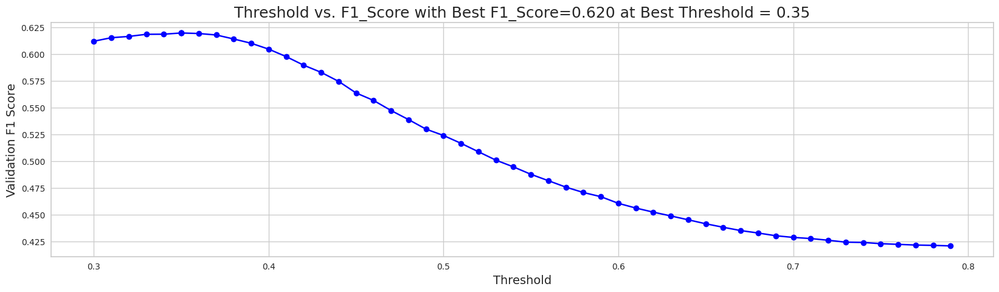

When using optimal threshold = 0.35...
Q0: F1 = 0.6198563505888686
==> Overall F1 = 0.6198563505888686
s
[I 2023-05-23 03:33:10,914] Trial 33 finished with value: 0.6198563505888686 and parameters: {'num_leaves': 35, 'learning_rate': 0.015015044356841119, 'feature_fraction': 0.8119972762738792, 'bagging_fraction': 0.5720623020509947, 'bagging_freq': 10, 'min_child_samples': 87, 'reg_alpha': 0.0017496888480114641, 'reg_lambda': 8.836860251856221, 'subsample': 0.7485000736508204, 'colsample_bytree': 0.8977473699623884, 'min_split_gain': 0.06931186416336325, 'max_depth': 4}. Best is trial 23 with value: 0.6229182714673.


--------------------------------------------------
question13, with210features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.5516854145875135, subsample=0.9187780214487715 will be ignored. Current value: bagging_fraction=0.5516854145875135
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
[LightGBM] [Warning] feature_fraction is set=0.5259893389513006, colsample_bytree=0.7387795708553728 will be ignored. Current value: feature_fraction=0.5259893389513006


,mean
feature,
hover_duration_sum,209.6
object_click_event_name_counts,187.4
hover_duration_max,134.2
businesscards_fqid_counts,110.8
10_level_counts,103.8
room_coor_x_min,100.0
11_level_counts,96.6
room_coor_x_max,95.6
hover_duration_std,94.2


[[0.87407483 0.12592517]
 [0.82329207 0.17670793]
 [0.70818233 0.29181767]
 ...
 [0.62464007 0.37535993]
 [0.65824569 0.34175431]
 [0.8052092  0.1947908 ]]


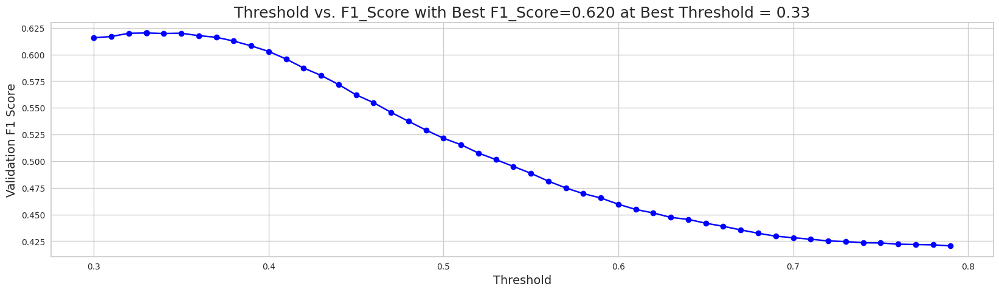

When using optimal threshold = 0.33...
Q0: F1 = 0.6201742992089169
==> Overall F1 = 0.6201742992089169
s
[I 2023-05-23 03:33:18,713] Trial 32 finished with value: 0.6201742992089169 and parameters: {'num_leaves': 35, 'learning_rate': 0.014279017242262547, 'feature_fraction': 0.7919124203170682, 'bagging_fraction': 0.5736535322646905, 'bagging_freq': 5, 'min_child_samples': 87, 'reg_alpha': 0.0017597597338246528, 'reg_lambda': 7.3152693084181495, 'subsample': 0.9974336540022137, 'colsample_bytree': 0.8985347997190687, 'min_split_gain': 0.01608801865622049, 'max_depth': 4}. Best is trial 23 with value: 0.6229182714673.


--------------------------------------------------
question13, with210features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.6494010934021195, subsample=0.9182911126035095 will be ignored. Current value: bagging_fraction=0.6494010934021195
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
[LightGBM] [Warning] feature_fraction is set=0.5167575825475712, colsample_bytree=0.7507853029905933 will be ignored. Current value: feature_fraction=0.5167575825475712


[LightGBM] [Warning] bagging_fraction is set=0.5815109729554598, subsample=0.7607661225589303 will be ignored. Current value: bagging_fraction=0.5815109729554598
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=10, subsample_freq=0 will be ignored. Current value: bagging_freq=10
[LightGBM] [Warning] feature_fraction is set=0.6175113017432583, colsample_bytree=0.7003033963788328 will be ignored. Current value: feature_fraction=0.6175113017432583


[LightGBM] [Warning] bagging_fraction is set=0.5516854145875135, subsample=0.9187780214487715 will be ignored. Current value: bagging_fraction=0.5516854145875135
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
[LightGBM] [Warning] feature_fraction is set=0.5259893389513006, colsample_bytree=0.7387795708553728 will be ignored. Current value: feature_fraction=0.5259893389513006


[LightGBM] [Warning] bagging_fraction is set=0.5823847492394747, subsample=0.7644261967439447 will be ignored. Current value: bagging_fraction=0.5823847492394747
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=10, subsample_freq=0 will be ignored. Current value: bagging_freq=10
[LightGBM] [Warning] feature_fraction is set=0.7617314915473636, colsample_bytree=0.43895048076732657 will be ignored. Current value: feature_fraction=0.7617314915473636


[LightGBM] [Warning] bagging_fraction is set=0.6494010934021195, subsample=0.9182911126035095 will be ignored. Current value: bagging_fraction=0.6494010934021195
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
[LightGBM] [Warning] feature_fraction is set=0.5167575825475712, colsample_bytree=0.7507853029905933 will be ignored. Current value: feature_fraction=0.5167575825475712


[LightGBM] [Warning] bagging_fraction is set=0.5516854145875135, subsample=0.9187780214487715 will be ignored. Current value: bagging_fraction=0.5516854145875135
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
[LightGBM] [Warning] feature_fraction is set=0.5259893389513006, colsample_bytree=0.7387795708553728 will be ignored. Current value: feature_fraction=0.5259893389513006


[LightGBM] [Warning] bagging_fraction is set=0.5815109729554598, subsample=0.7607661225589303 will be ignored. Current value: bagging_fraction=0.5815109729554598
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=10, subsample_freq=0 will be ignored. Current value: bagging_freq=10
[LightGBM] [Warning] feature_fraction is set=0.6175113017432583, colsample_bytree=0.7003033963788328 will be ignored. Current value: feature_fraction=0.6175113017432583


[LightGBM] [Warning] bagging_fraction is set=0.5516854145875135, subsample=0.9187780214487715 will be ignored. Current value: bagging_fraction=0.5516854145875135
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
[LightGBM] [Warning] feature_fraction is set=0.5259893389513006, colsample_bytree=0.7387795708553728 will be ignored. Current value: feature_fraction=0.5259893389513006


[LightGBM] [Warning] bagging_fraction is set=0.6494010934021195, subsample=0.9182911126035095 will be ignored. Current value: bagging_fraction=0.6494010934021195
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
[LightGBM] [Warning] feature_fraction is set=0.5167575825475712, colsample_bytree=0.7507853029905933 will be ignored. Current value: feature_fraction=0.5167575825475712


[LightGBM] [Warning] bagging_fraction is set=0.5823847492394747, subsample=0.7644261967439447 will be ignored. Current value: bagging_fraction=0.5823847492394747
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=10, subsample_freq=0 will be ignored. Current value: bagging_freq=10
[LightGBM] [Warning] feature_fraction is set=0.7617314915473636, colsample_bytree=0.43895048076732657 will be ignored. Current value: feature_fraction=0.7617314915473636


[LightGBM] [Warning] bagging_fraction is set=0.5516854145875135, subsample=0.9187780214487715 will be ignored. Current value: bagging_fraction=0.5516854145875135
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
[LightGBM] [Warning] feature_fraction is set=0.5259893389513006, colsample_bytree=0.7387795708553728 will be ignored. Current value: feature_fraction=0.5259893389513006


[LightGBM] [Warning] bagging_fraction is set=0.6494010934021195, subsample=0.9182911126035095 will be ignored. Current value: bagging_fraction=0.6494010934021195
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
[LightGBM] [Warning] feature_fraction is set=0.5167575825475712, colsample_bytree=0.7507853029905933 will be ignored. Current value: feature_fraction=0.5167575825475712


,mean
feature,
hover_duration_max,91.6
hover_duration_sum,88.0
room_coor_x_max,79.2
room_coor_x_min,75.6
object_click_event_name_counts,74.4
screen_coor_x_std,74.0
room_coor_y_min,69.6
session_id,68.0
room_coor_y_max,66.6


[[0.83952307 0.16047693]
 [0.82945931 0.17054069]
 [0.75798152 0.24201848]
 ...
 [0.61647249 0.38352751]
 [0.67557807 0.32442193]
 [0.84783775 0.15216225]]


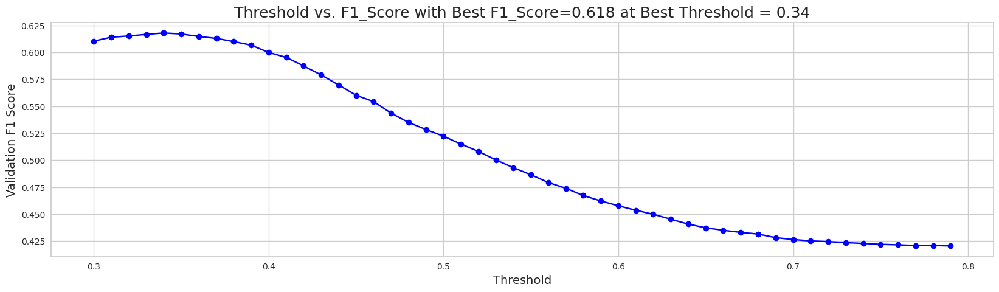

When using optimal threshold = 0.34...
Q0: F1 = 0.6178631326602932
==> Overall F1 = 0.6178631326602932
s
[I 2023-05-23 03:34:14,213] Trial 36 finished with value: 0.6178631326602932 and parameters: {'num_leaves': 54, 'learning_rate': 0.04973542035808148, 'feature_fraction': 0.5259893389513006, 'bagging_fraction': 0.5516854145875135, 'bagging_freq': 5, 'min_child_samples': 62, 'reg_alpha': 0.0019899993733512237, 'reg_lambda': 4.717567545982341, 'subsample': 0.9187780214487715, 'colsample_bytree': 0.7387795708553728, 'min_split_gain': 0.01650820549030489, 'max_depth': 9}. Best is trial 23 with value: 0.6229182714673.


--------------------------------------------------
question13, with210features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.37324214442798287, subsample=0.9268970512132916 will be ignored. Current value: bagging_fraction=0.37324214442798287
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
[LightGBM] [Warning] feature_fraction is set=0.6411777364894135, colsample_bytree=0.7956079705730104 will be ignored. Current value: feature_fraction=0.6411777364894135


[LightGBM] [Warning] bagging_fraction is set=0.5823847492394747, subsample=0.7644261967439447 will be ignored. Current value: bagging_fraction=0.5823847492394747
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=10, subsample_freq=0 will be ignored. Current value: bagging_freq=10
[LightGBM] [Warning] feature_fraction is set=0.7617314915473636, colsample_bytree=0.43895048076732657 will be ignored. Current value: feature_fraction=0.7617314915473636


,mean
feature,
hover_duration_sum,278.8
hover_duration_max,245.4
room_coor_x_max,237.6
object_click_event_name_counts,236.2
room_coor_y_min,211.6
room_coor_x_min,211.6
elapsed_time_diff_std,203.0
screen_coor_x_std,202.0
hover_duration_mean,200.8


[LightGBM] [Warning] bagging_fraction is set=0.6494010934021195, subsample=0.9182911126035095 will be ignored. Current value: bagging_fraction=0.6494010934021195
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
[LightGBM] [Warning] feature_fraction is set=0.5167575825475712, colsample_bytree=0.7507853029905933 will be ignored. Current value: feature_fraction=0.5167575825475712


[[0.86238294 0.13761706]
 [0.85415706 0.14584294]
 [0.73847836 0.26152164]
 ...
 [0.66590069 0.33409931]
 [0.65255536 0.34744464]
 [0.83394136 0.16605864]]


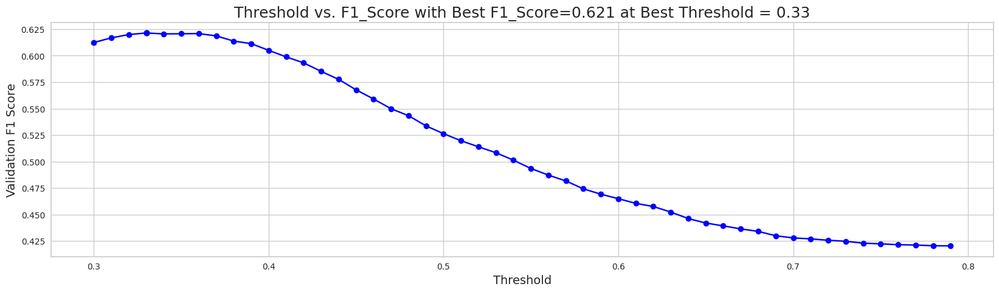

When using optimal threshold = 0.33...
Q0: F1 = 0.621390461271087
==> Overall F1 = 0.621390461271087
s
[I 2023-05-23 03:34:28,975] Trial 34 finished with value: 0.621390461271087 and parameters: {'num_leaves': 34, 'learning_rate': 0.015056859964048663, 'feature_fraction': 0.6175113017432583, 'bagging_fraction': 0.5815109729554598, 'bagging_freq': 10, 'min_child_samples': 61, 'reg_alpha': 0.0015269594911452562, 'reg_lambda': 8.854184890601829, 'subsample': 0.7607661225589303, 'colsample_bytree': 0.7003033963788328, 'min_split_gain': 0.060242100553464954, 'max_depth': 9}. Best is trial 23 with value: 0.6229182714673.


--------------------------------------------------
question13, with210features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.37324214442798287, subsample=0.9268970512132916 will be ignored. Current value: bagging_fraction=0.37324214442798287
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
[LightGBM] [Warning] feature_fraction is set=0.6411777364894135, colsample_bytree=0.7956079705730104 will be ignored. Current value: feature_fraction=0.6411777364894135


[LightGBM] [Warning] bagging_fraction is set=0.6443730076055182, subsample=0.9211969708598938 will be ignored. Current value: bagging_fraction=0.6443730076055182
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.6435721403939211, colsample_bytree=0.4030950071384025 will be ignored. Current value: feature_fraction=0.6435721403939211


[LightGBM] [Warning] bagging_fraction is set=0.37324214442798287, subsample=0.9268970512132916 will be ignored. Current value: bagging_fraction=0.37324214442798287
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
[LightGBM] [Warning] feature_fraction is set=0.6411777364894135, colsample_bytree=0.7956079705730104 will be ignored. Current value: feature_fraction=0.6411777364894135


[LightGBM] [Warning] bagging_fraction is set=0.6443730076055182, subsample=0.9211969708598938 will be ignored. Current value: bagging_fraction=0.6443730076055182
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.6435721403939211, colsample_bytree=0.4030950071384025 will be ignored. Current value: feature_fraction=0.6435721403939211


,mean
feature,
hover_duration_max,147.0
hover_duration_sum,141.0
object_click_event_name_counts,134.6
room_coor_x_min,117.8
room_coor_x_max,116.8
session_id,116.6
screen_coor_x_std,112.0
room_coor_x_std,110.2
hover_duration_mean,109.8


[[0.87112377 0.12887623]
 [0.8520531  0.1479469 ]
 [0.67167389 0.32832611]
 ...
 [0.73054963 0.26945037]
 [0.6493057  0.3506943 ]
 [0.83071173 0.16928827]]


[LightGBM] [Warning] bagging_fraction is set=0.37324214442798287, subsample=0.9268970512132916 will be ignored. Current value: bagging_fraction=0.37324214442798287
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
[LightGBM] [Warning] feature_fraction is set=0.6411777364894135, colsample_bytree=0.7956079705730104 will be ignored. Current value: feature_fraction=0.6411777364894135


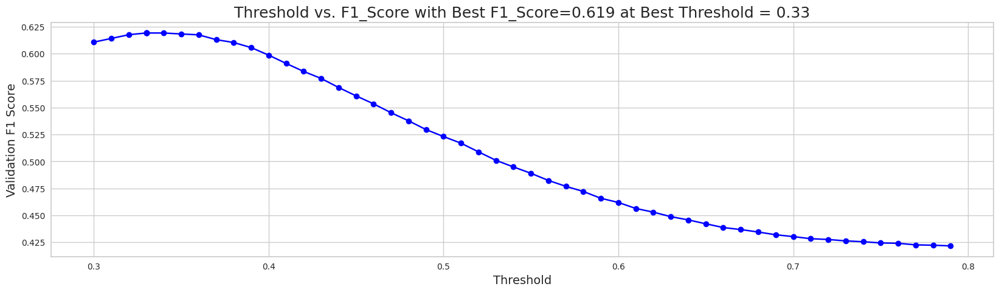

When using optimal threshold = 0.33...
Q0: F1 = 0.6192949958065065
==> Overall F1 = 0.6192949958065065
s
[I 2023-05-23 03:34:50,835] Trial 37 finished with value: 0.6192949958065065 and parameters: {'num_leaves': 54, 'learning_rate': 0.029033139482051357, 'feature_fraction': 0.5167575825475712, 'bagging_fraction': 0.6494010934021195, 'bagging_freq': 5, 'min_child_samples': 59, 'reg_alpha': 0.002040297561311357, 'reg_lambda': 1.1759514100268185, 'subsample': 0.9182911126035095, 'colsample_bytree': 0.7507853029905933, 'min_split_gain': 0.017616103380931697, 'max_depth': 9}. Best is trial 23 with value: 0.6229182714673.


--------------------------------------------------
question13, with210features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.37980666362328097, subsample=0.5673293671302837 will be ignored. Current value: bagging_fraction=0.37980666362328097
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
[LightGBM] [Warning] feature_fraction is set=0.7492987988754392, colsample_bytree=0.42812465655318843 will be ignored. Current value: feature_fraction=0.7492987988754392


[LightGBM] [Warning] bagging_fraction is set=0.6443730076055182, subsample=0.9211969708598938 will be ignored. Current value: bagging_fraction=0.6443730076055182
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.6435721403939211, colsample_bytree=0.4030950071384025 will be ignored. Current value: feature_fraction=0.6435721403939211


,mean
feature,
hover_duration_sum,298.2
object_click_event_name_counts,242.8
hover_duration_max,237.0
room_coor_x_max,224.4
room_coor_y_min,205.2
screen_coor_x_std,203.2
room_coor_x_min,198.0
room_coor_y_max,190.6
session_id,190.4


[[0.84984592 0.15015408]
 [0.86792788 0.13207212]
 [0.71680155 0.28319845]
 ...
 [0.65133378 0.34866622]
 [0.66265676 0.33734324]
 [0.79890832 0.20109168]]


[LightGBM] [Warning] bagging_fraction is set=0.37324214442798287, subsample=0.9268970512132916 will be ignored. Current value: bagging_fraction=0.37324214442798287
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
[LightGBM] [Warning] feature_fraction is set=0.6411777364894135, colsample_bytree=0.7956079705730104 will be ignored. Current value: feature_fraction=0.6411777364894135


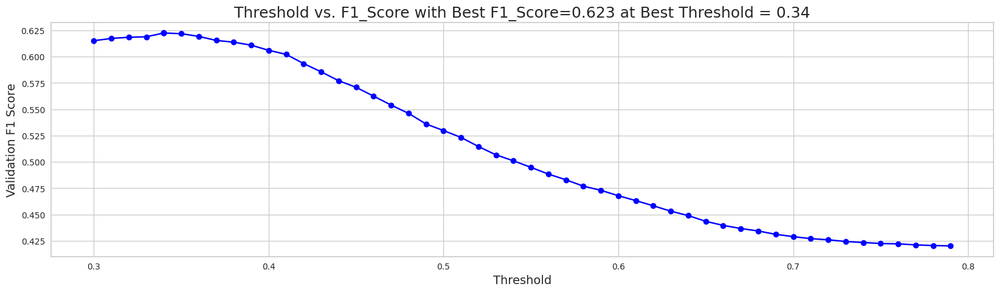

When using optimal threshold = 0.34...
Q0: F1 = 0.6225207765828262
==> Overall F1 = 0.6225207765828262
s
[I 2023-05-23 03:35:02,308] Trial 35 finished with value: 0.6225207765828262 and parameters: {'num_leaves': 32, 'learning_rate': 0.014830076751168117, 'feature_fraction': 0.7617314915473636, 'bagging_fraction': 0.5823847492394747, 'bagging_freq': 10, 'min_child_samples': 86, 'reg_alpha': 0.0014114898894085949, 'reg_lambda': 9.069181093076834, 'subsample': 0.7644261967439447, 'colsample_bytree': 0.43895048076732657, 'min_split_gain': 0.01656916746180323, 'max_depth': 9}. Best is trial 23 with value: 0.6229182714673.


--------------------------------------------------
question13, with210features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.5215498710384767, subsample=0.5634398055447454 will be ignored. Current value: bagging_fraction=0.5215498710384767
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.749712065556485, colsample_bytree=0.3912947018209239 will be ignored. Current value: feature_fraction=0.749712065556485


[LightGBM] [Warning] bagging_fraction is set=0.37980666362328097, subsample=0.5673293671302837 will be ignored. Current value: bagging_fraction=0.37980666362328097
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
[LightGBM] [Warning] feature_fraction is set=0.7492987988754392, colsample_bytree=0.42812465655318843 will be ignored. Current value: feature_fraction=0.7492987988754392


,mean
feature,
hover_duration_sum,98.2
hover_duration_max,90.8
object_click_event_name_counts,85.2
room_coor_x_max,81.8
room_coor_x_std,68.2
session_id,67.2
room_coor_y_max,66.6
screen_coor_x_std,66.6
hover_duration_std,65.6


[[0.80422851 0.19577149]
 [0.85413349 0.14586651]
 [0.69917279 0.30082721]
 ...
 [0.61176113 0.38823887]
 [0.66060553 0.33939447]
 [0.81732914 0.18267086]]


[LightGBM] [Warning] bagging_fraction is set=0.5215498710384767, subsample=0.5634398055447454 will be ignored. Current value: bagging_fraction=0.5215498710384767
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.749712065556485, colsample_bytree=0.3912947018209239 will be ignored. Current value: feature_fraction=0.749712065556485


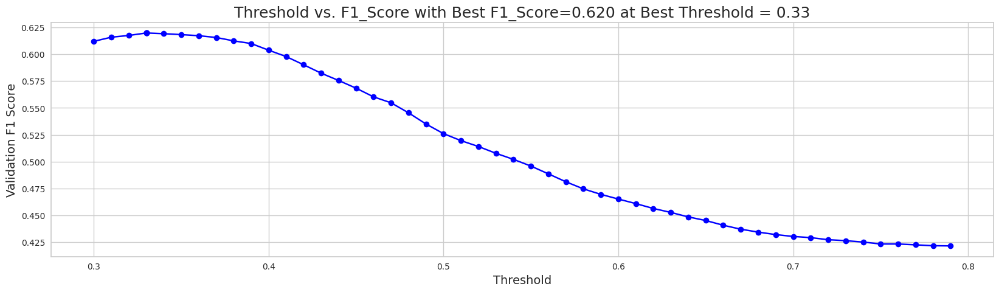

When using optimal threshold = 0.33...
Q0: F1 = 0.6198081572849296
==> Overall F1 = 0.6198081572849296
s
[I 2023-05-23 03:35:17,225] Trial 38 finished with value: 0.6198081572849296 and parameters: {'num_leaves': 26, 'learning_rate': 0.030165816514611494, 'feature_fraction': 0.6411777364894135, 'bagging_fraction': 0.37324214442798287, 'bagging_freq': 6, 'min_child_samples': 57, 'reg_alpha': 0.0014086705400075, 'reg_lambda': 1.1392718311227292, 'subsample': 0.9268970512132916, 'colsample_bytree': 0.7956079705730104, 'min_split_gain': 0.04990891087247452, 'max_depth': 10}. Best is trial 23 with value: 0.6229182714673.


--------------------------------------------------
question13, with210features
--------------------------------------------------
[LightGBM] [Warning] bagging_fraction is set=0.37980666362328097, subsample=0.5673293671302837 will be ignored. Current value: bagging_fraction=0.37980666362328097
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
[LightGBM] [Warning] feature_fraction is set=0.7492987988754392, colsample_bytree=0.42812465655318843 will be ignored. Current value: feature_fraction=0.7492987988754392
[LightGBM] [Warning] bagging_fraction is set=0.6443730076055182, subsample=0.9211969708598938 will be ignored. Current value: bagging_fraction=0.6443730076055182
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=7

[LightGBM] [Warning] bagging_fraction is set=0.5256287836575313, subsample=0.5873562129573465 will be ignored. Current value: bagging_fraction=0.5256287836575313
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.7489281351539623, colsample_bytree=0.34406985665498024 will be ignored. Current value: feature_fraction=0.7489281351539623


[LightGBM] [Warning] bagging_fraction is set=0.5215498710384767, subsample=0.5634398055447454 will be ignored. Current value: bagging_fraction=0.5215498710384767
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.749712065556485, colsample_bytree=0.3912947018209239 will be ignored. Current value: feature_fraction=0.749712065556485


[LightGBM] [Warning] bagging_fraction is set=0.37980666362328097, subsample=0.5673293671302837 will be ignored. Current value: bagging_fraction=0.37980666362328097
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
[LightGBM] [Warning] feature_fraction is set=0.7492987988754392, colsample_bytree=0.42812465655318843 will be ignored. Current value: feature_fraction=0.7492987988754392
[LightGBM] [Warning] bagging_fraction is set=0.6443730076055182, subsample=0.9211969708598938 will be ignored. Current value: bagging_fraction=0.6443730076055182
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning]

[LightGBM] [Warning] bagging_fraction is set=0.5256287836575313, subsample=0.5873562129573465 will be ignored. Current value: bagging_fraction=0.5256287836575313
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.7489281351539623, colsample_bytree=0.34406985665498024 will be ignored. Current value: feature_fraction=0.7489281351539623


[LightGBM] [Warning] bagging_fraction is set=0.37980666362328097, subsample=0.5673293671302837 will be ignored. Current value: bagging_fraction=0.37980666362328097
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
[LightGBM] [Warning] feature_fraction is set=0.7492987988754392, colsample_bytree=0.42812465655318843 will be ignored. Current value: feature_fraction=0.7492987988754392


[LightGBM] [Warning] bagging_fraction is set=0.5215498710384767, subsample=0.5634398055447454 will be ignored. Current value: bagging_fraction=0.5215498710384767
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.749712065556485, colsample_bytree=0.3912947018209239 will be ignored. Current value: feature_fraction=0.749712065556485


[LightGBM] [Warning] bagging_fraction is set=0.5256287836575313, subsample=0.5873562129573465 will be ignored. Current value: bagging_fraction=0.5256287836575313
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.7489281351539623, colsample_bytree=0.34406985665498024 will be ignored. Current value: feature_fraction=0.7489281351539623


,mean
feature,
hover_duration_sum,102.4
object_click_event_name_counts,94.8
hover_duration_max,92.6
room_coor_x_max,68.6
hover_duration_std,60.6
9_level_counts,60.4
elapsed_time_diff_std,60.2
room_coor_y_min,60.0
hover_duration_mean,58.2


[[0.86717073 0.13282927]
 [0.82972796 0.17027204]
 [0.70181111 0.29818889]
 ...
 [0.62431053 0.37568947]
 [0.60774008 0.39225992]
 [0.80726684 0.19273316]]


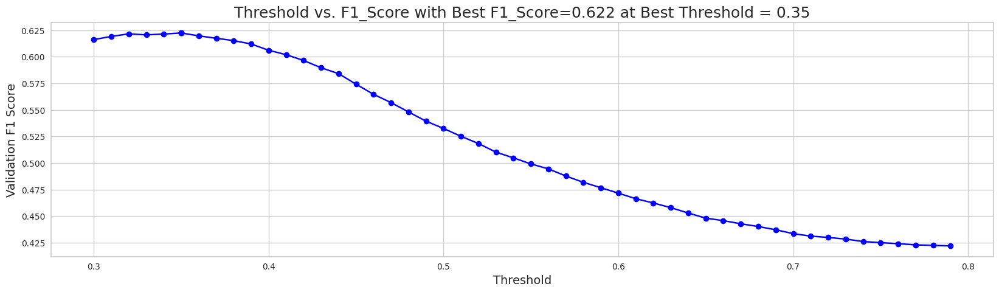

When using optimal threshold = 0.35...
Q0: F1 = 0.6223479667253544
==> Overall F1 = 0.6223479667253544
s
[I 2023-05-23 03:35:48,448] Trial 39 finished with value: 0.6223479667253544 and parameters: {'num_leaves': 17, 'learning_rate': 0.03204535353420527, 'feature_fraction': 0.6435721403939211, 'bagging_fraction': 0.6443730076055182, 'bagging_freq': 3, 'min_child_samples': 92, 'reg_alpha': 0.010906428156421642, 'reg_lambda': 1.2708481996876222, 'subsample': 0.9211969708598938, 'colsample_bytree': 0.4030950071384025, 'min_split_gain': 0.004865554882821232, 'max_depth': 10}. Best is trial 23 with value: 0.6229182714673.


--------------------------------------------------
question13, with210features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.5234403580874255, subsample=0.581079868486148 will be ignored. Current value: bagging_fraction=0.5234403580874255
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.7550903059673585, colsample_bytree=0.38376317163302187 will be ignored. Current value: feature_fraction=0.7550903059673585


,mean
feature,
hover_duration_sum,83.6
object_click_event_name_counts,80.2
hover_duration_max,75.0
room_coor_x_max,61.6
room_coor_x_min,59.0
session_id,57.0
room_coor_y_min,56.4
elapsed_time_diff_std,53.4
hover_duration_std,52.6


[[0.8102656  0.1897344 ]
 [0.84362894 0.15637106]
 [0.7321097  0.2678903 ]
 ...
 [0.57275957 0.42724043]
 [0.64110022 0.35889978]
 [0.82680078 0.17319922]]


[LightGBM] [Warning] bagging_fraction is set=0.5215498710384767, subsample=0.5634398055447454 will be ignored. Current value: bagging_fraction=0.5215498710384767
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.749712065556485, colsample_bytree=0.3912947018209239 will be ignored. Current value: feature_fraction=0.749712065556485


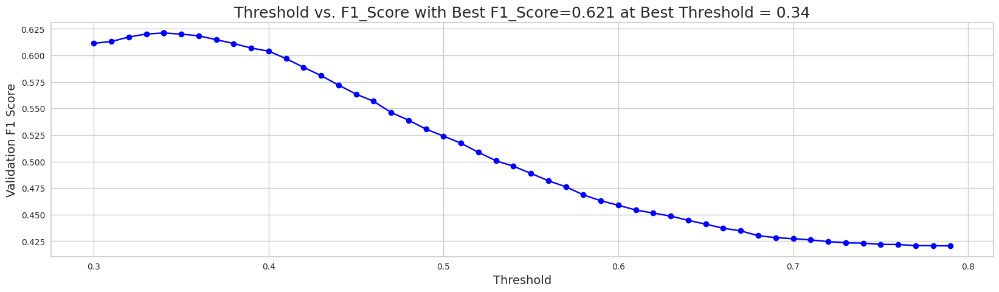

When using optimal threshold = 0.34...
Q0: F1 = 0.6211459322570434
==> Overall F1 = 0.6211459322570434
s
[I 2023-05-23 03:35:55,333] Trial 40 finished with value: 0.6211459322570434 and parameters: {'num_leaves': 26, 'learning_rate': 0.033104731956148145, 'feature_fraction': 0.7492987988754392, 'bagging_fraction': 0.37980666362328097, 'bagging_freq': 6, 'min_child_samples': 69, 'reg_alpha': 0.010372567182814216, 'reg_lambda': 3.248180762961703, 'subsample': 0.5673293671302837, 'colsample_bytree': 0.42812465655318843, 'min_split_gain': 0.0423103256314998, 'max_depth': 10}. Best is trial 23 with value: 0.6229182714673.


--------------------------------------------------
question13, with210features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.5256287836575313, subsample=0.5873562129573465 will be ignored. Current value: bagging_fraction=0.5256287836575313
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.7489281351539623, colsample_bytree=0.34406985665498024 will be ignored. Current value: feature_fraction=0.7489281351539623


[LightGBM] [Warning] bagging_fraction is set=0.5104115807889434, subsample=0.8114463772628171 will be ignored. Current value: bagging_fraction=0.5104115807889434
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.7461710100582747, colsample_bytree=0.4141039175363086 will be ignored. Current value: feature_fraction=0.7461710100582747


[LightGBM] [Warning] bagging_fraction is set=0.5256287836575313, subsample=0.5873562129573465 will be ignored. Current value: bagging_fraction=0.5256287836575313
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.7489281351539623, colsample_bytree=0.34406985665498024 will be ignored. Current value: feature_fraction=0.7489281351539623


,mean
feature,
hover_duration_sum,85.2
object_click_event_name_counts,80.4
hover_duration_max,78.8
room_coor_x_max,59.0
room_coor_x_min,58.4
screen_coor_x_std,57.6
room_coor_y_min,56.8
elapsed_time_diff_std,53.8
room_coor_x_std,50.2


[[0.84042461 0.15957539]
 [0.8388789  0.1611211 ]
 [0.67134218 0.32865782]
 ...
 [0.63922629 0.36077371]
 [0.67973914 0.32026086]
 [0.76944664 0.23055336]]


[LightGBM] [Warning] bagging_fraction is set=0.5234403580874255, subsample=0.581079868486148 will be ignored. Current value: bagging_fraction=0.5234403580874255
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.7550903059673585, colsample_bytree=0.38376317163302187 will be ignored. Current value: feature_fraction=0.7550903059673585


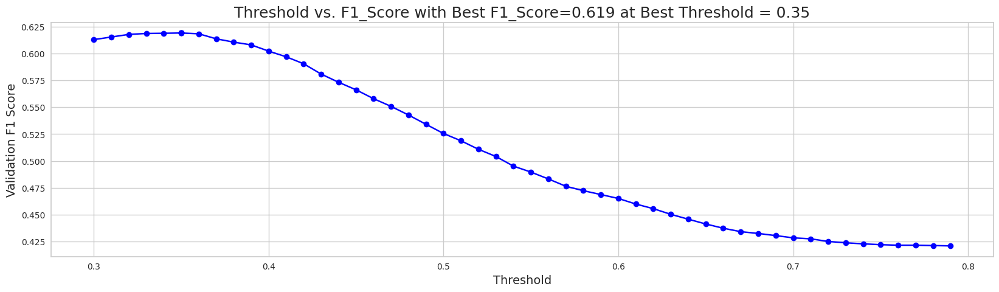

When using optimal threshold = 0.35...
Q0: F1 = 0.619160839864186
==> Overall F1 = 0.619160839864186
s
[I 2023-05-23 03:36:12,168] Trial 41 finished with value: 0.619160839864186 and parameters: {'num_leaves': 27, 'learning_rate': 0.03713419040877982, 'feature_fraction': 0.749712065556485, 'bagging_fraction': 0.5215498710384767, 'bagging_freq': 3, 'min_child_samples': 85, 'reg_alpha': 0.009252016943384105, 'reg_lambda': 3.7389488814781506, 'subsample': 0.5634398055447454, 'colsample_bytree': 0.3912947018209239, 'min_split_gain': 0.01145731798630703, 'max_depth': 10}. Best is trial 23 with value: 0.6229182714673.


--------------------------------------------------
question13, with210features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.6403886599106113, subsample=0.8067254789875771 will be ignored. Current value: bagging_fraction=0.6403886599106113
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8670557243809222, colsample_bytree=0.3827217708846905 will be ignored. Current value: feature_fraction=0.8670557243809222


[LightGBM] [Warning] bagging_fraction is set=0.5104115807889434, subsample=0.8114463772628171 will be ignored. Current value: bagging_fraction=0.5104115807889434
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.7461710100582747, colsample_bytree=0.4141039175363086 will be ignored. Current value: feature_fraction=0.7461710100582747


,mean
feature,
hover_duration_sum,139.8
object_click_event_name_counts,132.8
hover_duration_max,105.2
room_coor_x_max,77.8
room_coor_x_min,73.8
room_coor_y_min,73.2
elapsed_time_diff_std,72.8
9_level_counts,70.6
businesscards_fqid_counts,70.0


[[0.86357718 0.13642282]
 [0.86722354 0.13277646]
 [0.69819717 0.30180283]
 ...
 [0.63407467 0.36592533]
 [0.63775568 0.36224432]
 [0.79960232 0.20039768]]


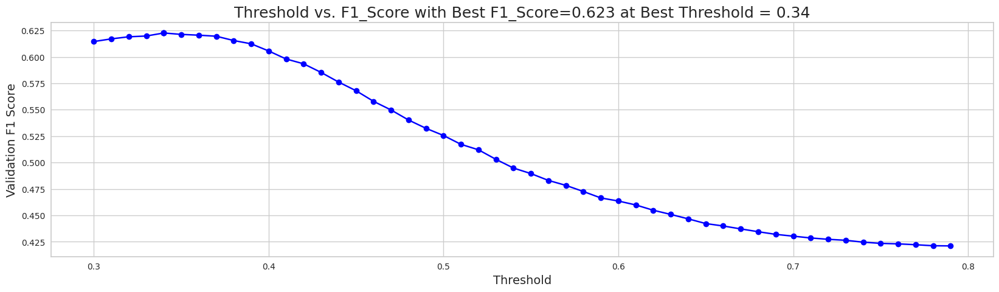

When using optimal threshold = 0.34...
Q0: F1 = 0.6226345535496518
==> Overall F1 = 0.6226345535496518
s
[I 2023-05-23 03:36:27,112] Trial 42 finished with value: 0.6226345535496518 and parameters: {'num_leaves': 16, 'learning_rate': 0.020693665676947626, 'feature_fraction': 0.7489281351539623, 'bagging_fraction': 0.5256287836575313, 'bagging_freq': 3, 'min_child_samples': 92, 'reg_alpha': 0.00890021494310014, 'reg_lambda': 3.183659582580579, 'subsample': 0.5873562129573465, 'colsample_bytree': 0.34406985665498024, 'min_split_gain': 0.011466155623761966, 'max_depth': 5}. Best is trial 23 with value: 0.6229182714673.


--------------------------------------------------
question13, with210features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.5259924679100193, subsample=0.8021160207993999 will be ignored. Current value: bagging_fraction=0.5259924679100193
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.856226309548586, colsample_bytree=0.4897480760633698 will be ignored. Current value: feature_fraction=0.856226309548586
[LightGBM] [Warning] bagging_fraction is set=0.5234403580874255, subsample=0.581079868486148 will be ignored. Current value: bagging_fraction=0.5234403580874255
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] featu

[LightGBM] [Warning] bagging_fraction is set=0.5104115807889434, subsample=0.8114463772628171 will be ignored. Current value: bagging_fraction=0.5104115807889434
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.7461710100582747, colsample_bytree=0.4141039175363086 will be ignored. Current value: feature_fraction=0.7461710100582747


[LightGBM] [Warning] bagging_fraction is set=0.6403886599106113, subsample=0.8067254789875771 will be ignored. Current value: bagging_fraction=0.6403886599106113
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8670557243809222, colsample_bytree=0.3827217708846905 will be ignored. Current value: feature_fraction=0.8670557243809222


[LightGBM] [Warning] bagging_fraction is set=0.5259924679100193, subsample=0.8021160207993999 will be ignored. Current value: bagging_fraction=0.5259924679100193
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.856226309548586, colsample_bytree=0.4897480760633698 will be ignored. Current value: feature_fraction=0.856226309548586


[LightGBM] [Warning] bagging_fraction is set=0.5234403580874255, subsample=0.581079868486148 will be ignored. Current value: bagging_fraction=0.5234403580874255
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.7550903059673585, colsample_bytree=0.38376317163302187 will be ignored. Current value: feature_fraction=0.7550903059673585


[LightGBM] [Warning] bagging_fraction is set=0.5104115807889434, subsample=0.8114463772628171 will be ignored. Current value: bagging_fraction=0.5104115807889434
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.7461710100582747, colsample_bytree=0.4141039175363086 will be ignored. Current value: feature_fraction=0.7461710100582747


[LightGBM] [Warning] bagging_fraction is set=0.5259924679100193, subsample=0.8021160207993999 will be ignored. Current value: bagging_fraction=0.5259924679100193
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.856226309548586, colsample_bytree=0.4897480760633698 will be ignored. Current value: feature_fraction=0.856226309548586


[LightGBM] [Warning] bagging_fraction is set=0.6403886599106113, subsample=0.8067254789875771 will be ignored. Current value: bagging_fraction=0.6403886599106113
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8670557243809222, colsample_bytree=0.3827217708846905 will be ignored. Current value: feature_fraction=0.8670557243809222


[LightGBM] [Warning] bagging_fraction is set=0.5234403580874255, subsample=0.581079868486148 will be ignored. Current value: bagging_fraction=0.5234403580874255
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.7550903059673585, colsample_bytree=0.38376317163302187 will be ignored. Current value: feature_fraction=0.7550903059673585


[LightGBM] [Warning] bagging_fraction is set=0.5104115807889434, subsample=0.8114463772628171 will be ignored. Current value: bagging_fraction=0.5104115807889434
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.7461710100582747, colsample_bytree=0.4141039175363086 will be ignored. Current value: feature_fraction=0.7461710100582747


[LightGBM] [Warning] bagging_fraction is set=0.5259924679100193, subsample=0.8021160207993999 will be ignored. Current value: bagging_fraction=0.5259924679100193
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.856226309548586, colsample_bytree=0.4897480760633698 will be ignored. Current value: feature_fraction=0.856226309548586


[LightGBM] [Warning] bagging_fraction is set=0.6403886599106113, subsample=0.8067254789875771 will be ignored. Current value: bagging_fraction=0.6403886599106113
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8670557243809222, colsample_bytree=0.3827217708846905 will be ignored. Current value: feature_fraction=0.8670557243809222


,mean
feature,
hover_duration_sum,171.4
object_click_event_name_counts,150.0
hover_duration_max,123.8
room_coor_x_max,111.2
room_coor_x_min,108.4
elapsed_time_diff_std,103.2
hover_duration_std,102.2
room_coor_y_min,101.8
room_coor_x_std,101.0


[[0.87228687 0.12771313]
 [0.84938362 0.15061638]
 [0.70824567 0.29175433]
 ...
 [0.67294318 0.32705682]
 [0.64357844 0.35642156]
 [0.81596179 0.18403821]]


,mean
feature,
hover_duration_sum,131.4
object_click_event_name_counts,125.8
hover_duration_max,104.0
room_coor_x_max,85.0
room_coor_x_min,81.0
room_coor_y_min,80.8
9_level_counts,78.0
businesscards_fqid_counts,72.2
10_level_counts,68.6


[[0.86821136 0.13178864]
 [0.84397962 0.15602038]
 [0.71847829 0.28152171]
 ...
 [0.61641426 0.38358574]
 [0.63381808 0.36618192]
 [0.82005877 0.17994123]]


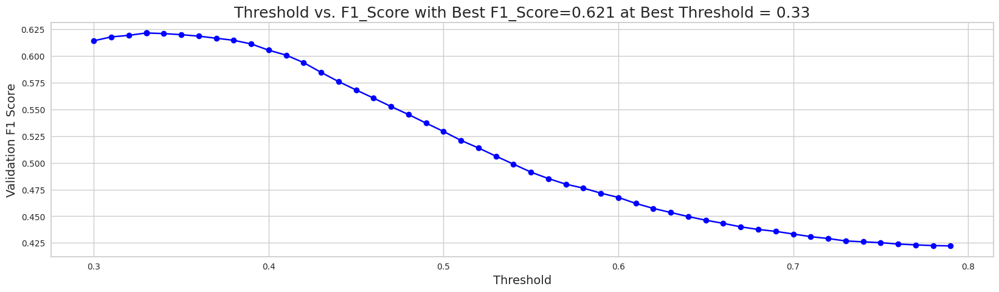

When using optimal threshold = 0.33...
Q0: F1 = 0.6214856927795203
==> Overall F1 = 0.6214856927795203
s
[I 2023-05-23 03:37:20,616] Trial 43 finished with value: 0.6214856927795203 and parameters: {'num_leaves': 29, 'learning_rate': 0.021473962836893037, 'feature_fraction': 0.7550903059673585, 'bagging_fraction': 0.5234403580874255, 'bagging_freq': 3, 'min_child_samples': 91, 'reg_alpha': 0.0029754203689185002, 'reg_lambda': 3.1900528039283924, 'subsample': 0.581079868486148, 'colsample_bytree': 0.38376317163302187, 'min_split_gain': 0.009983295281604257, 'max_depth': 5}. Best is trial 23 with value: 0.6229182714673.


--------------------------------------------------
question13, with210features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.6878298894083663, subsample=0.8027533111891446 will be ignored. Current value: bagging_fraction=0.6878298894083663
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8314136453965711, colsample_bytree=0.47785820901688225 will be ignored. Current value: feature_fraction=0.8314136453965711


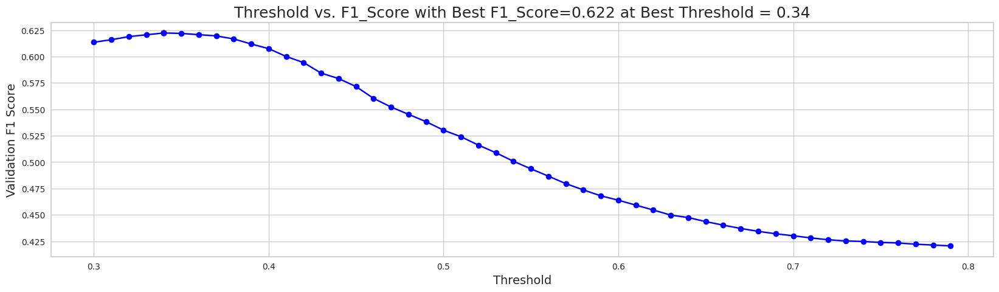

When using optimal threshold = 0.34...
Q0: F1 = 0.6222952528669684
==> Overall F1 = 0.6222952528669684
s
[I 2023-05-23 03:37:23,485] Trial 44 finished with value: 0.6222952528669684 and parameters: {'num_leaves': 16, 'learning_rate': 0.021189603749200463, 'feature_fraction': 0.7461710100582747, 'bagging_fraction': 0.5104115807889434, 'bagging_freq': 3, 'min_child_samples': 91, 'reg_alpha': 0.002851510360365053, 'reg_lambda': 3.5953865694833924, 'subsample': 0.8114463772628171, 'colsample_bytree': 0.4141039175363086, 'min_split_gain': 0.004632034212918107, 'max_depth': 7}. Best is trial 23 with value: 0.6229182714673.


--------------------------------------------------
question13, with210features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.695980983418299, subsample=0.702950519337084 will be ignored. Current value: bagging_fraction=0.695980983418299
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8975170822379468, colsample_bytree=0.27199349130807515 will be ignored. Current value: feature_fraction=0.8975170822379468


[LightGBM] [Warning] bagging_fraction is set=0.5259924679100193, subsample=0.8021160207993999 will be ignored. Current value: bagging_fraction=0.5259924679100193
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.856226309548586, colsample_bytree=0.4897480760633698 will be ignored. Current value: feature_fraction=0.856226309548586


[LightGBM] [Warning] bagging_fraction is set=0.6403886599106113, subsample=0.8067254789875771 will be ignored. Current value: bagging_fraction=0.6403886599106113
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8670557243809222, colsample_bytree=0.3827217708846905 will be ignored. Current value: feature_fraction=0.8670557243809222


,mean
feature,
hover_duration_sum,132.0
object_click_event_name_counts,118.2
hover_duration_max,107.4
elapsed_time_diff_std,79.4
room_coor_x_max,75.2
room_coor_y_min,74.6
businesscards_fqid_counts,70.6
hover_duration_std,70.6
11_level_counts,69.6


[[0.82625068 0.17374932]
 [0.83380086 0.16619914]
 [0.73097121 0.26902879]
 ...
 [0.61518851 0.38481149]
 [0.61827548 0.38172452]
 [0.8272732  0.1727268 ]]


[LightGBM] [Warning] bagging_fraction is set=0.6878298894083663, subsample=0.8027533111891446 will be ignored. Current value: bagging_fraction=0.6878298894083663
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8314136453965711, colsample_bytree=0.47785820901688225 will be ignored. Current value: feature_fraction=0.8314136453965711


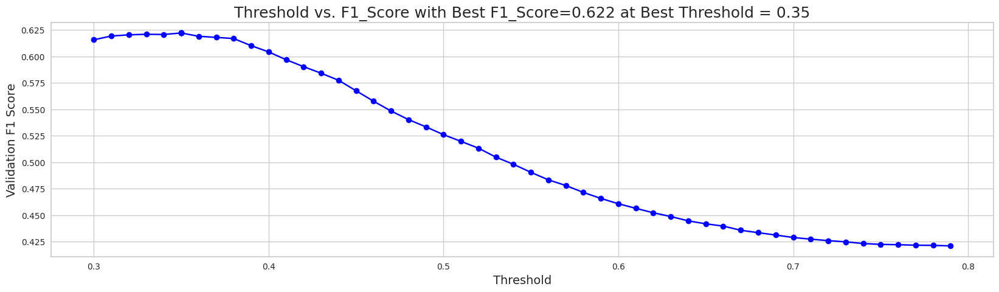

When using optimal threshold = 0.35...
Q0: F1 = 0.6219949529033495
==> Overall F1 = 0.6219949529033495
s
[I 2023-05-23 03:37:42,339] Trial 46 finished with value: 0.6219949529033495 and parameters: {'num_leaves': 16, 'learning_rate': 0.02245763777710005, 'feature_fraction': 0.856226309548586, 'bagging_fraction': 0.5259924679100193, 'bagging_freq': 2, 'min_child_samples': 92, 'reg_alpha': 0.0028241990237877954, 'reg_lambda': 4.944490836853422, 'subsample': 0.8021160207993999, 'colsample_bytree': 0.4897480760633698, 'min_split_gain': 0.00839283682589482, 'max_depth': 5}. Best is trial 23 with value: 0.6229182714673.


--------------------------------------------------
question13, with210features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.6233425607607017, subsample=0.7223235074500786 will be ignored. Current value: bagging_fraction=0.6233425607607017
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=9, subsample_freq=0 will be ignored. Current value: bagging_freq=9
[LightGBM] [Warning] feature_fraction is set=0.8531941421115785, colsample_bytree=0.26543690920033614 will be ignored. Current value: feature_fraction=0.8531941421115785


[LightGBM] [Warning] bagging_fraction is set=0.695980983418299, subsample=0.702950519337084 will be ignored. Current value: bagging_fraction=0.695980983418299
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8975170822379468, colsample_bytree=0.27199349130807515 will be ignored. Current value: feature_fraction=0.8975170822379468


,mean
feature,
hover_duration_sum,153.0
object_click_event_name_counts,136.8
hover_duration_max,107.4
room_coor_x_min,83.8
room_coor_x_max,82.4
businesscards_fqid_counts,79.6
room_coor_y_min,78.8
elapsed_time_diff_std,75.6
11_level_counts,74.2


[[0.85528663 0.14471337]
 [0.8546188  0.1453812 ]
 [0.75151827 0.24848173]
 ...
 [0.65924354 0.34075646]
 [0.66245996 0.33754004]
 [0.83155283 0.16844717]]


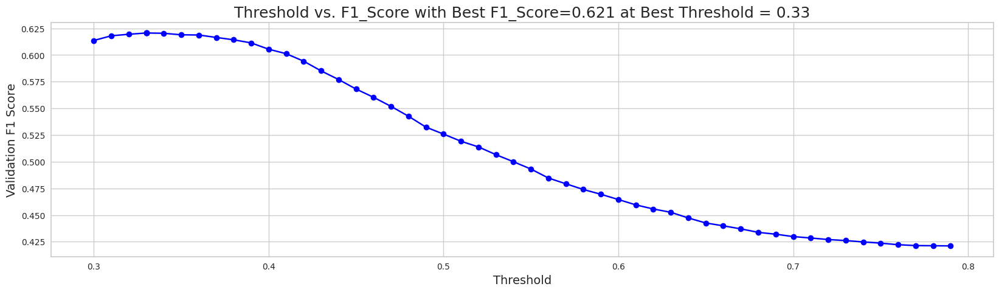

When using optimal threshold = 0.33...
Q0: F1 = 0.6206595900526392
==> Overall F1 = 0.6206595900526392
s
[I 2023-05-23 03:37:55,587] Trial 45 finished with value: 0.6206595900526392 and parameters: {'num_leaves': 17, 'learning_rate': 0.021751220883050714, 'feature_fraction': 0.8670557243809222, 'bagging_fraction': 0.6403886599106113, 'bagging_freq': 2, 'min_child_samples': 94, 'reg_alpha': 0.003549999572622572, 'reg_lambda': 4.719643174349606, 'subsample': 0.8067254789875771, 'colsample_bytree': 0.3827217708846905, 'min_split_gain': 0.0049204481141269215, 'max_depth': 7}. Best is trial 23 with value: 0.6229182714673.


[LightGBM] [Warning] bagging_fraction is set=0.6233425607607017, subsample=0.7223235074500786 will be ignored. Current value: bagging_fraction=0.6233425607607017
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=9, subsample_freq=0 will be ignored. Current value: bagging_freq=9
[LightGBM] [Warning] feature_fraction is set=0.8531941421115785, colsample_bytree=0.26543690920033614 will be ignored. Current value: feature_fraction=0.8531941421115785


[LightGBM] [Warning] bagging_fraction is set=0.6878298894083663, subsample=0.8027533111891446 will be ignored. Current value: bagging_fraction=0.6878298894083663
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8314136453965711, colsample_bytree=0.47785820901688225 will be ignored. Current value: feature_fraction=0.8314136453965711


[LightGBM] [Warning] bagging_fraction is set=0.695980983418299, subsample=0.702950519337084 will be ignored. Current value: bagging_fraction=0.695980983418299
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8975170822379468, colsample_bytree=0.27199349130807515 will be ignored. Current value: feature_fraction=0.8975170822379468


[LightGBM] [Warning] bagging_fraction is set=0.6233425607607017, subsample=0.7223235074500786 will be ignored. Current value: bagging_fraction=0.6233425607607017
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=9, subsample_freq=0 will be ignored. Current value: bagging_freq=9
[LightGBM] [Warning] feature_fraction is set=0.8531941421115785, colsample_bytree=0.26543690920033614 will be ignored. Current value: feature_fraction=0.8531941421115785


[LightGBM] [Warning] bagging_fraction is set=0.6878298894083663, subsample=0.8027533111891446 will be ignored. Current value: bagging_fraction=0.6878298894083663
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8314136453965711, colsample_bytree=0.47785820901688225 will be ignored. Current value: feature_fraction=0.8314136453965711


[LightGBM] [Warning] bagging_fraction is set=0.695980983418299, subsample=0.702950519337084 will be ignored. Current value: bagging_fraction=0.695980983418299
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8975170822379468, colsample_bytree=0.27199349130807515 will be ignored. Current value: feature_fraction=0.8975170822379468


[LightGBM] [Warning] bagging_fraction is set=0.6233425607607017, subsample=0.7223235074500786 will be ignored. Current value: bagging_fraction=0.6233425607607017
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=9, subsample_freq=0 will be ignored. Current value: bagging_freq=9
[LightGBM] [Warning] feature_fraction is set=0.8531941421115785, colsample_bytree=0.26543690920033614 will be ignored. Current value: feature_fraction=0.8531941421115785


[LightGBM] [Warning] bagging_fraction is set=0.6878298894083663, subsample=0.8027533111891446 will be ignored. Current value: bagging_fraction=0.6878298894083663
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8314136453965711, colsample_bytree=0.47785820901688225 will be ignored. Current value: feature_fraction=0.8314136453965711


[LightGBM] [Warning] bagging_fraction is set=0.695980983418299, subsample=0.702950519337084 will be ignored. Current value: bagging_fraction=0.695980983418299
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8975170822379468, colsample_bytree=0.27199349130807515 will be ignored. Current value: feature_fraction=0.8975170822379468


[LightGBM] [Warning] bagging_fraction is set=0.6233425607607017, subsample=0.7223235074500786 will be ignored. Current value: bagging_fraction=0.6233425607607017
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=9, subsample_freq=0 will be ignored. Current value: bagging_freq=9
[LightGBM] [Warning] feature_fraction is set=0.8531941421115785, colsample_bytree=0.26543690920033614 will be ignored. Current value: feature_fraction=0.8531941421115785


,mean
feature,
hover_duration_sum,112.0
object_click_event_name_counts,105.4
hover_duration_max,62.8
businesscards_fqid_counts,59.4
9_level_counts,49.2
10_level_counts,45.8
11_level_counts,43.0
tunic.library.frontdesk.worker.droppedbadge_text_fqid_counts,42.2
reader.paper1.next_fqid_counts,35.2


[[0.85260496 0.14739504]
 [0.84396238 0.15603762]
 [0.69290429 0.30709571]
 ...
 [0.62350059 0.37649941]
 [0.63924457 0.36075543]
 [0.81401598 0.18598402]]


,mean
feature,
hover_duration_sum,157.0
object_click_event_name_counts,140.0
hover_duration_max,109.6
room_coor_x_max,89.2
room_coor_y_min,85.0
elapsed_time_diff_std,84.4
9_level_counts,83.2
room_coor_x_min,80.4
businesscards_fqid_counts,80.4


[[0.85353226 0.14646774]
 [0.84779687 0.15220313]
 [0.71317945 0.28682055]
 ...
 [0.61406071 0.38593929]
 [0.63291836 0.36708164]
 [0.82769111 0.17230889]]


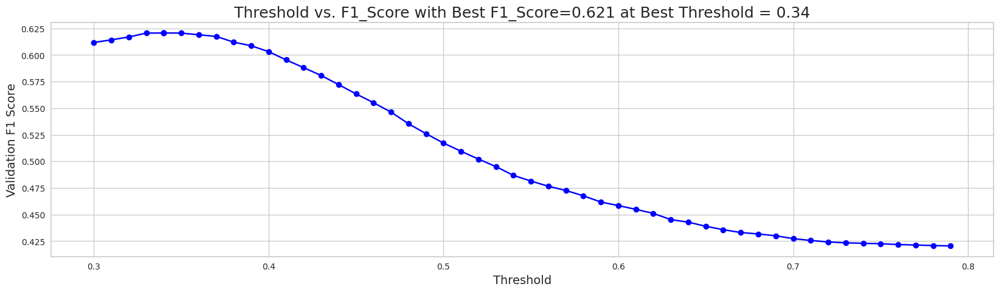

When using optimal threshold = 0.34...
Q0: F1 = 0.6207423068499544
==> Overall F1 = 0.6207423068499544
s
[I 2023-05-23 03:38:48,053] Trial 49 finished with value: 0.6207423068499544 and parameters: {'num_leaves': 22, 'learning_rate': 0.018879798218934294, 'feature_fraction': 0.8531941421115785, 'bagging_fraction': 0.6233425607607017, 'bagging_freq': 9, 'min_child_samples': 83, 'reg_alpha': 0.0010512939876172011, 'reg_lambda': 9.580164968414907, 'subsample': 0.7223235074500786, 'colsample_bytree': 0.26543690920033614, 'min_split_gain': 0.021775768571736832, 'max_depth': 2}. Best is trial 23 with value: 0.6229182714673.


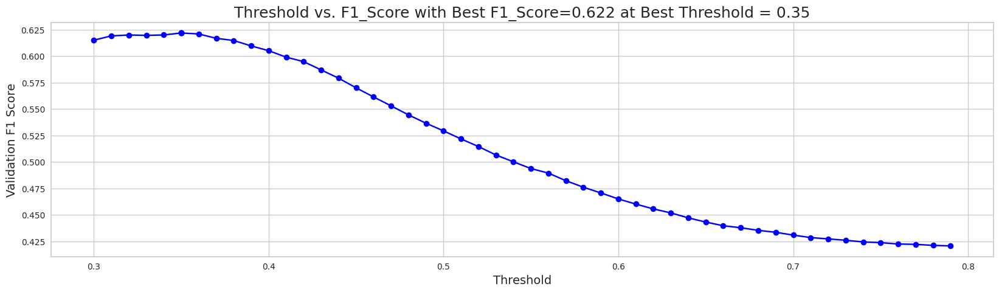

When using optimal threshold = 0.35...
Q0: F1 = 0.6218985618373502
==> Overall F1 = 0.6218985618373502
s
[I 2023-05-23 03:38:49,715] Trial 47 finished with value: 0.6218985618373502 and parameters: {'num_leaves': 16, 'learning_rate': 0.021527749635725544, 'feature_fraction': 0.8314136453965711, 'bagging_fraction': 0.6878298894083663, 'bagging_freq': 2, 'min_child_samples': 82, 'reg_alpha': 0.003187065099503748, 'reg_lambda': 4.187803069111335, 'subsample': 0.8027533111891446, 'colsample_bytree': 0.47785820901688225, 'min_split_gain': 0.02116882046993276, 'max_depth': 7}. Best is trial 23 with value: 0.6229182714673.


,mean
feature,
hover_duration_sum,161.2
object_click_event_name_counts,144.2
hover_duration_max,90.8
businesscards_fqid_counts,86.4
room_coor_x_max,81.4
9_level_counts,76.2
10_level_counts,72.6
11_level_counts,70.2
room_coor_y_min,69.6


[[0.84979616 0.15020384]
 [0.84988873 0.15011127]
 [0.72057317 0.27942683]
 ...
 [0.64543215 0.35456785]
 [0.63024411 0.36975589]
 [0.81614203 0.18385797]]


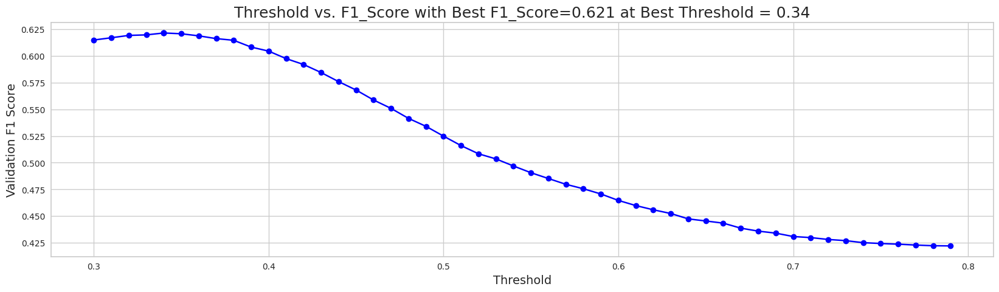

When using optimal threshold = 0.34...
Q0: F1 = 0.6213266113226377
==> Overall F1 = 0.6213266113226377
s
[I 2023-05-23 03:38:53,068] Trial 48 finished with value: 0.6213266113226377 and parameters: {'num_leaves': 16, 'learning_rate': 0.01873312606622183, 'feature_fraction': 0.8975170822379468, 'bagging_fraction': 0.695980983418299, 'bagging_freq': 2, 'min_child_samples': 84, 'reg_alpha': 0.004009355354477283, 'reg_lambda': 5.254622294100625, 'subsample': 0.702950519337084, 'colsample_bytree': 0.27199349130807515, 'min_split_gain': 0.02038360587858349, 'max_depth': 3}. Best is trial 23 with value: 0.6229182714673.


[I 2023-05-23 03:38:54,253] A new study created in memory with name: no-name-9b325c45-d189-4635-834d-367742a96791


{'num_leaves': 13, 'learning_rate': 0.022369557281689573, 'feature_fraction': 0.7048362063177542, 'bagging_fraction': 0.4400813341365126, 'bagging_freq': 6, 'min_child_samples': 76, 'reg_alpha': 0.038450032459774054, 'reg_lambda': 1.6065166656760606, 'subsample': 0.8568850734653723, 'colsample_bytree': 0.5591658748790052, 'min_split_gain': 0.036304335558276404, 'max_depth': 7}


  0%|          | 0/50 [00:00<?, ?it/s]

--------------------------------------------------
question14, with255features
--------------------------------------------------
--------------------------------------------------
question14, with255features
--------------------------------------------------
--------------------------------------------------
question14, with255features
--------------------------------------------------
--------------------------------------------------
question14, with255features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.8278972453825659, subsample=0.43005416303495303 will be ignored. Current value: bagging_fraction=0.8278972453825659
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=8, subsample_freq=0 will be ignored. Current value: bagging_freq=8
[LightGBM] [Warning] feature_fraction is set=0.8274392976583773, colsample_bytree=0.4465036625651535 will be ignored. Current value: feature_fraction=0.8274392976583773
[LightGBM] [Warning] bagging_fraction is set=0.38065642424877, subsample=0.73800082660576 will be ignored. Current value: bagging_fraction=0.38065642424877
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature

[LightGBM] [Warning] bagging_fraction is set=0.38065642424877, subsample=0.73800082660576 will be ignored. Current value: bagging_fraction=0.38065642424877
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.8026560815021563, colsample_bytree=0.8270123779095505 will be ignored. Current value: feature_fraction=0.8026560815021563


[LightGBM] [Warning] bagging_fraction is set=0.6322280156458466, subsample=0.8984999386486959 will be ignored. Current value: bagging_fraction=0.6322280156458466
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
[LightGBM] [Warning] feature_fraction is set=0.5051091058797381, colsample_bytree=0.4314710907932877 will be ignored. Current value: feature_fraction=0.5051091058797381


[LightGBM] [Warning] bagging_fraction is set=0.8278972453825659, subsample=0.43005416303495303 will be ignored. Current value: bagging_fraction=0.8278972453825659
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=8, subsample_freq=0 will be ignored. Current value: bagging_freq=8
[LightGBM] [Warning] feature_fraction is set=0.8274392976583773, colsample_bytree=0.4465036625651535 will be ignored. Current value: feature_fraction=0.8274392976583773


[LightGBM] [Warning] bagging_fraction is set=0.38065642424877, subsample=0.73800082660576 will be ignored. Current value: bagging_fraction=0.38065642424877
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.8026560815021563, colsample_bytree=0.8270123779095505 will be ignored. Current value: feature_fraction=0.8026560815021563


[LightGBM] [Warning] bagging_fraction is set=0.49820176513725534, subsample=0.14781934058257748 will be ignored. Current value: bagging_fraction=0.49820176513725534
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
[LightGBM] [Warning] feature_fraction is set=0.5431418308049158, colsample_bytree=0.5131921804602108 will be ignored. Current value: feature_fraction=0.5431418308049158


[LightGBM] [Warning] bagging_fraction is set=0.6322280156458466, subsample=0.8984999386486959 will be ignored. Current value: bagging_fraction=0.6322280156458466
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
[LightGBM] [Warning] feature_fraction is set=0.5051091058797381, colsample_bytree=0.4314710907932877 will be ignored. Current value: feature_fraction=0.5051091058797381
[LightGBM] [Warning] bagging_fraction is set=0.8278972453825659, subsample=0.43005416303495303 will be ignored. Current value: bagging_fraction=0.8278972453825659
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=8, subsample_freq=0 will be ignored. Current value: bagging_freq=8
[LightGBM] [Warning] f

[LightGBM] [Warning] bagging_fraction is set=0.38065642424877, subsample=0.73800082660576 will be ignored. Current value: bagging_fraction=0.38065642424877
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.8026560815021563, colsample_bytree=0.8270123779095505 will be ignored. Current value: feature_fraction=0.8026560815021563


[LightGBM] [Warning] bagging_fraction is set=0.38065642424877, subsample=0.73800082660576 will be ignored. Current value: bagging_fraction=0.38065642424877
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.8026560815021563, colsample_bytree=0.8270123779095505 will be ignored. Current value: feature_fraction=0.8026560815021563


[LightGBM] [Warning] bagging_fraction is set=0.49820176513725534, subsample=0.14781934058257748 will be ignored. Current value: bagging_fraction=0.49820176513725534
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
[LightGBM] [Warning] feature_fraction is set=0.5431418308049158, colsample_bytree=0.5131921804602108 will be ignored. Current value: feature_fraction=0.5431418308049158
[LightGBM] [Warning] bagging_fraction is set=0.8278972453825659, subsample=0.43005416303495303 will be ignored. Current value: bagging_fraction=0.8278972453825659
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=8, subsample_freq=0 will be ignored. Current value: bagging_freq=8
[LightGBM] [Warning

[LightGBM] [Warning] bagging_fraction is set=0.6322280156458466, subsample=0.8984999386486959 will be ignored. Current value: bagging_fraction=0.6322280156458466
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
[LightGBM] [Warning] feature_fraction is set=0.5051091058797381, colsample_bytree=0.4314710907932877 will be ignored. Current value: feature_fraction=0.5051091058797381


,mean
feature,
20_level_counts,6.2
tunic.historicalsociety.frontdesk.archivist_glasses.confrontation_recap_text_fqid_counts,4.4
savedteddy_fqid_counts,3.6
elapsed_time_diff_sum,3.2
session_id,3.2
hover_duration_mean,3.0
tracks_fqid_counts,2.8
flag_girl_fqid_counts,2.8
screen_coor_y_mean,2.8


[[0.7219653  0.2780347 ]
 [0.24184751 0.75815249]
 [0.17735773 0.82264227]
 ...
 [0.20359264 0.79640736]
 [0.11653585 0.88346415]
 [0.13626555 0.86373445]]


[LightGBM] [Warning] bagging_fraction is set=0.8278972453825659, subsample=0.43005416303495303 will be ignored. Current value: bagging_fraction=0.8278972453825659
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=8, subsample_freq=0 will be ignored. Current value: bagging_freq=8
[LightGBM] [Warning] feature_fraction is set=0.8274392976583773, colsample_bytree=0.4465036625651535 will be ignored. Current value: feature_fraction=0.8274392976583773


[LightGBM] [Warning] bagging_fraction is set=0.6322280156458466, subsample=0.8984999386486959 will be ignored. Current value: bagging_fraction=0.6322280156458466
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
[LightGBM] [Warning] feature_fraction is set=0.5051091058797381, colsample_bytree=0.4314710907932877 will be ignored. Current value: feature_fraction=0.5051091058797381


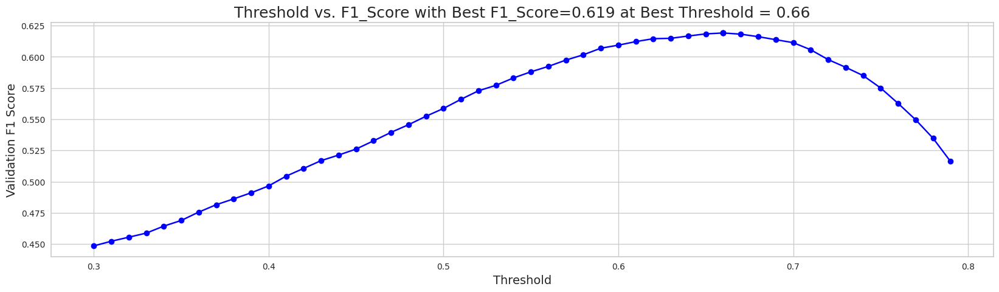

When using optimal threshold = 0.66...
Q0: F1 = 0.6191110344214906
==> Overall F1 = 0.6191110344214906
s
[I 2023-05-23 03:39:23,696] Trial 3 finished with value: 0.6191110344214906 and parameters: {'num_leaves': 18, 'learning_rate': 0.3937451266312512, 'feature_fraction': 0.8026560815021563, 'bagging_fraction': 0.38065642424877, 'bagging_freq': 3, 'min_child_samples': 79, 'reg_alpha': 5.225421617800061, 'reg_lambda': 9.96056420004878, 'subsample': 0.73800082660576, 'colsample_bytree': 0.8270123779095505, 'min_split_gain': 0.16161439123332388, 'max_depth': 5}. Best is trial 3 with value: 0.6191110344214906.


--------------------------------------------------
question14, with255features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.21607848183017403, subsample=0.5428300357384646 will be ignored. Current value: bagging_fraction=0.21607848183017403
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
[LightGBM] [Warning] feature_fraction is set=0.9404062314526769, colsample_bytree=0.3542297576744471 will be ignored. Current value: feature_fraction=0.9404062314526769


,mean
feature,
20_level_counts,18.8
tunic.historicalsociety.frontdesk.archivist_glasses.confrontation_recap_text_fqid_counts,18.6
tracks_fqid_counts,14.2
tunic.historicalsociety.entry.directory.closeup.archivist_text_fqid_counts,14.0
session_id,13.2
savedteddy_fqid_counts,10.8
elapsed_time_diff_std,10.6
18_level_counts,10.4
journals_flag.pic_0.next_fqid_counts,10.2


[[0.84242569 0.15757431]
 [0.22182173 0.77817827]
 [0.12697914 0.87302086]
 ...
 [0.11217517 0.88782483]
 [0.09206827 0.90793173]
 [0.20386531 0.79613469]]


[LightGBM] [Warning] bagging_fraction is set=0.49820176513725534, subsample=0.14781934058257748 will be ignored. Current value: bagging_fraction=0.49820176513725534
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
[LightGBM] [Warning] feature_fraction is set=0.5431418308049158, colsample_bytree=0.5131921804602108 will be ignored. Current value: feature_fraction=0.5431418308049158


,mean
feature,
20_level_counts,17.2
tunic.historicalsociety.frontdesk.archivist_glasses.confrontation_recap_text_fqid_counts,15.8
tracks_fqid_counts,12.4
hover_duration_max,11.2
room_coor_y_max,10.8
tunic.historicalsociety.entry.directory.closeup.archivist_text_fqid_counts,10.6
room_coor_x_mean,10.4
tunic.flaghouse.entry.flag_girl.symbol_recap_text_fqid_counts,10.2
18_level_counts,10.0


[[0.8462185  0.1537815 ]
 [0.19804368 0.80195632]
 [0.10743625 0.89256375]
 ...
 [0.12282748 0.87717252]
 [0.09158435 0.90841565]
 [0.12936612 0.87063388]]


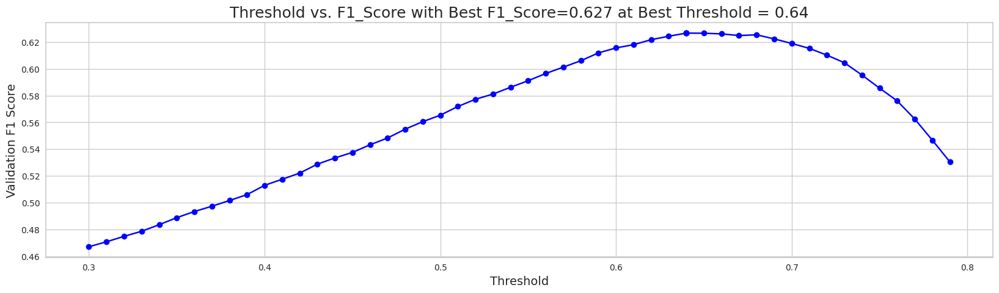

When using optimal threshold = 0.64...
Q0: F1 = 0.6266809424840946
==> Overall F1 = 0.6266809424840946
s
[I 2023-05-23 03:39:30,909] Trial 0 finished with value: 0.6266809424840946 and parameters: {'num_leaves': 54, 'learning_rate': 0.15065230099001, 'feature_fraction': 0.8274392976583773, 'bagging_fraction': 0.8278972453825659, 'bagging_freq': 8, 'min_child_samples': 72, 'reg_alpha': 0.4014423823671147, 'reg_lambda': 7.311846406699521, 'subsample': 0.43005416303495303, 'colsample_bytree': 0.4465036625651535, 'min_split_gain': 0.012640559613951425, 'max_depth': 4}. Best is trial 0 with value: 0.6266809424840946.


--------------------------------------------------
question14, with255features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.5304775688504324, subsample=0.8005044568069108 will be ignored. Current value: bagging_fraction=0.5304775688504324
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7626433107140338, colsample_bytree=0.3541768990565103 will be ignored. Current value: feature_fraction=0.7626433107140338


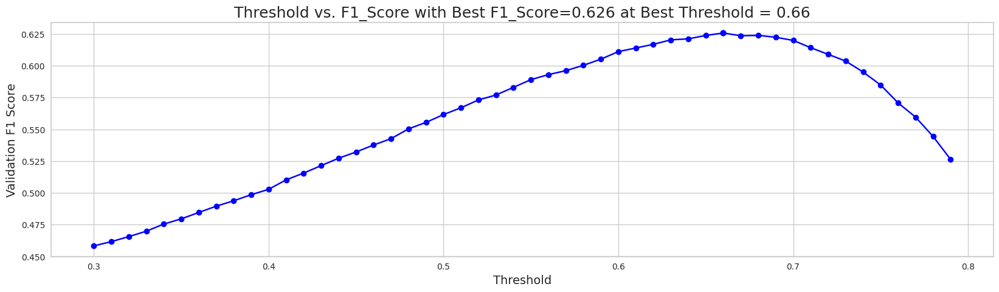

When using optimal threshold = 0.66...
Q0: F1 = 0.6257602288907844
==> Overall F1 = 0.6257602288907844
s
[I 2023-05-23 03:39:34,149] Trial 2 finished with value: 0.6257602288907844 and parameters: {'num_leaves': 31, 'learning_rate': 0.15962583309446765, 'feature_fraction': 0.5051091058797381, 'bagging_fraction': 0.6322280156458466, 'bagging_freq': 5, 'min_child_samples': 18, 'reg_alpha': 0.001109948171146287, 'reg_lambda': 0.9450240644730266, 'subsample': 0.8984999386486959, 'colsample_bytree': 0.4314710907932877, 'min_split_gain': 0.0027433661581626268, 'max_depth': 5}. Best is trial 0 with value: 0.6266809424840946.


--------------------------------------------------
question14, with255features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.8523383835911064, subsample=0.18096034726581062 will be ignored. Current value: bagging_fraction=0.8523383835911064
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=7, subsample_freq=0 will be ignored. Current value: bagging_freq=7
[LightGBM] [Warning] feature_fraction is set=0.2993098547025255, colsample_bytree=0.7938230981435364 will be ignored. Current value: feature_fraction=0.2993098547025255


[LightGBM] [Warning] bagging_fraction is set=0.49820176513725534, subsample=0.14781934058257748 will be ignored. Current value: bagging_fraction=0.49820176513725534
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
[LightGBM] [Warning] feature_fraction is set=0.5431418308049158, colsample_bytree=0.5131921804602108 will be ignored. Current value: feature_fraction=0.5431418308049158


[LightGBM] [Warning] bagging_fraction is set=0.21607848183017403, subsample=0.5428300357384646 will be ignored. Current value: bagging_fraction=0.21607848183017403
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
[LightGBM] [Warning] feature_fraction is set=0.9404062314526769, colsample_bytree=0.3542297576744471 will be ignored. Current value: feature_fraction=0.9404062314526769


[LightGBM] [Warning] bagging_fraction is set=0.5304775688504324, subsample=0.8005044568069108 will be ignored. Current value: bagging_fraction=0.5304775688504324
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7626433107140338, colsample_bytree=0.3541768990565103 will be ignored. Current value: feature_fraction=0.7626433107140338


,mean
feature,
20_level_counts,25.4
tunic.historicalsociety.frontdesk.archivist_glasses.confrontation_recap_text_fqid_counts,23.0
tunic.historicalsociety.entry.directory.closeup.archivist_text_fqid_counts,20.4
tracks_fqid_counts,19.2
session_id,14.4
flag_girl_fqid_counts,12.4
savedteddy_fqid_counts,12.0
hover_duration_sum,11.8
5_page_counts,10.6


[[0.77430643 0.22569357]
 [0.23897428 0.76102572]
 [0.116668   0.883332  ]
 ...
 [0.10692671 0.89307329]
 [0.10427607 0.89572393]
 [0.17694662 0.82305338]]


[LightGBM] [Warning] bagging_fraction is set=0.21607848183017403, subsample=0.5428300357384646 will be ignored. Current value: bagging_fraction=0.21607848183017403
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
[LightGBM] [Warning] feature_fraction is set=0.9404062314526769, colsample_bytree=0.3542297576744471 will be ignored. Current value: feature_fraction=0.9404062314526769
[LightGBM] [Warning] bagging_fraction is set=0.8523383835911064, subsample=0.18096034726581062 will be ignored. Current value: bagging_fraction=0.8523383835911064
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=7, subsample_freq=0 will be ignored. Current value: bagging_freq=7
[LightGBM] [Warning]

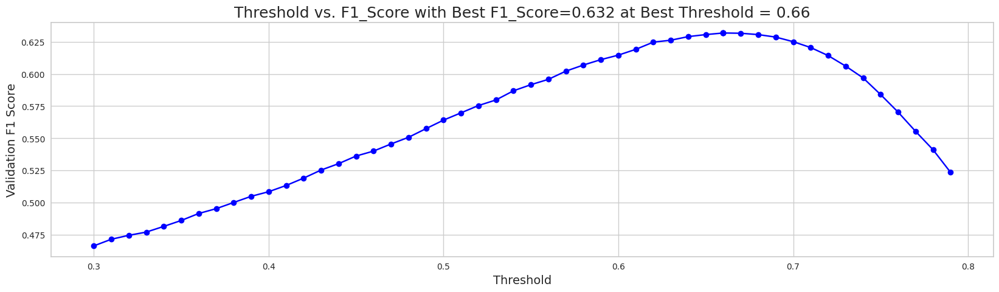

When using optimal threshold = 0.66...
Q0: F1 = 0.6318284353125275
==> Overall F1 = 0.6318284353125275
s
[I 2023-05-23 03:39:49,806] Trial 1 finished with value: 0.6318284353125275 and parameters: {'num_leaves': 34, 'learning_rate': 0.06669038724935597, 'feature_fraction': 0.5431418308049158, 'bagging_fraction': 0.49820176513725534, 'bagging_freq': 4, 'min_child_samples': 80, 'reg_alpha': 0.06652101759482451, 'reg_lambda': 0.003996963698513298, 'subsample': 0.14781934058257748, 'colsample_bytree': 0.5131921804602108, 'min_split_gain': 0.016560975770285452, 'max_depth': 2}. Best is trial 1 with value: 0.6318284353125275.


--------------------------------------------------
question14, with255features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.318507882768546, subsample=0.6767963027295987 will be ignored. Current value: bagging_fraction=0.318507882768546
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
[LightGBM] [Warning] feature_fraction is set=0.7023439290990859, colsample_bytree=0.6386717454515837 will be ignored. Current value: feature_fraction=0.7023439290990859


[LightGBM] [Warning] bagging_fraction is set=0.5304775688504324, subsample=0.8005044568069108 will be ignored. Current value: bagging_fraction=0.5304775688504324
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7626433107140338, colsample_bytree=0.3541768990565103 will be ignored. Current value: feature_fraction=0.7626433107140338


[LightGBM] [Warning] bagging_fraction is set=0.21607848183017403, subsample=0.5428300357384646 will be ignored. Current value: bagging_fraction=0.21607848183017403
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
[LightGBM] [Warning] feature_fraction is set=0.9404062314526769, colsample_bytree=0.3542297576744471 will be ignored. Current value: feature_fraction=0.9404062314526769
[LightGBM] [Warning] bagging_fraction is set=0.8523383835911064, subsample=0.18096034726581062 will be ignored. Current value: bagging_fraction=0.8523383835911064
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=7, subsample_freq=0 will be ignored. Current value: bagging_freq=7
[LightGBM] [Warning]

[LightGBM] [Warning] bagging_fraction is set=0.318507882768546, subsample=0.6767963027295987 will be ignored. Current value: bagging_fraction=0.318507882768546
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
[LightGBM] [Warning] feature_fraction is set=0.7023439290990859, colsample_bytree=0.6386717454515837 will be ignored. Current value: feature_fraction=0.7023439290990859


[LightGBM] [Warning] bagging_fraction is set=0.5304775688504324, subsample=0.8005044568069108 will be ignored. Current value: bagging_fraction=0.5304775688504324
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7626433107140338, colsample_bytree=0.3541768990565103 will be ignored. Current value: feature_fraction=0.7626433107140338


[LightGBM] [Warning] bagging_fraction is set=0.318507882768546, subsample=0.6767963027295987 will be ignored. Current value: bagging_fraction=0.318507882768546
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
[LightGBM] [Warning] feature_fraction is set=0.7023439290990859, colsample_bytree=0.6386717454515837 will be ignored. Current value: feature_fraction=0.7023439290990859


[LightGBM] [Warning] bagging_fraction is set=0.21607848183017403, subsample=0.5428300357384646 will be ignored. Current value: bagging_fraction=0.21607848183017403
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
[LightGBM] [Warning] feature_fraction is set=0.9404062314526769, colsample_bytree=0.3542297576744471 will be ignored. Current value: feature_fraction=0.9404062314526769


[LightGBM] [Warning] bagging_fraction is set=0.8523383835911064, subsample=0.18096034726581062 will be ignored. Current value: bagging_fraction=0.8523383835911064
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=7, subsample_freq=0 will be ignored. Current value: bagging_freq=7
[LightGBM] [Warning] feature_fraction is set=0.2993098547025255, colsample_bytree=0.7938230981435364 will be ignored. Current value: feature_fraction=0.2993098547025255


[LightGBM] [Warning] bagging_fraction is set=0.5304775688504324, subsample=0.8005044568069108 will be ignored. Current value: bagging_fraction=0.5304775688504324
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7626433107140338, colsample_bytree=0.3541768990565103 will be ignored. Current value: feature_fraction=0.7626433107140338


,mean
feature,
tunic.historicalsociety.frontdesk.archivist_glasses.confrontation_recap_text_fqid_counts,76.2
20_level_counts,64.8
tracks_fqid_counts,41.8
savedteddy_fqid_counts,36.4
session_id,35.6
flag_girl_fqid_counts,33.2
tunic.historicalsociety.entry.directory.closeup.archivist_text_fqid_counts,29.8
journals_flag.pic_0.next_fqid_counts,28.0
18_level_counts,27.0


[[0.76173117 0.23826883]
 [0.22045674 0.77954326]
 [0.13511882 0.86488118]
 ...
 [0.12448856 0.87551144]
 [0.12870545 0.87129455]
 [0.18696433 0.81303567]]


[LightGBM] [Warning] bagging_fraction is set=0.318507882768546, subsample=0.6767963027295987 will be ignored. Current value: bagging_fraction=0.318507882768546
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
[LightGBM] [Warning] feature_fraction is set=0.7023439290990859, colsample_bytree=0.6386717454515837 will be ignored. Current value: feature_fraction=0.7023439290990859


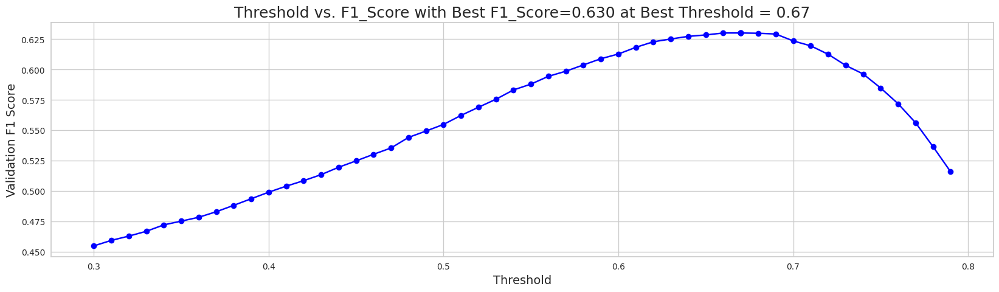

When using optimal threshold = 0.67...
Q0: F1 = 0.6301326071887887
==> Overall F1 = 0.6301326071887887
s
[I 2023-05-23 03:40:25,775] Trial 4 finished with value: 0.6301326071887887 and parameters: {'num_leaves': 81, 'learning_rate': 0.015083318949224874, 'feature_fraction': 0.9404062314526769, 'bagging_fraction': 0.21607848183017403, 'bagging_freq': 5, 'min_child_samples': 65, 'reg_alpha': 0.10535864386463828, 'reg_lambda': 0.21989373690163722, 'subsample': 0.5428300357384646, 'colsample_bytree': 0.3542297576744471, 'min_split_gain': 0.004517536668064747, 'max_depth': 2}. Best is trial 1 with value: 0.6318284353125275.


--------------------------------------------------
question14, with255features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.46048867883653277, subsample=0.8323455824610156 will be ignored. Current value: bagging_fraction=0.46048867883653277
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=9, subsample_freq=0 will be ignored. Current value: bagging_freq=9
[LightGBM] [Warning] feature_fraction is set=0.21689648368693165, colsample_bytree=0.3957993587928871 will be ignored. Current value: feature_fraction=0.21689648368693165


[LightGBM] [Warning] bagging_fraction is set=0.8523383835911064, subsample=0.18096034726581062 will be ignored. Current value: bagging_fraction=0.8523383835911064
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=7, subsample_freq=0 will be ignored. Current value: bagging_freq=7
[LightGBM] [Warning] feature_fraction is set=0.2993098547025255, colsample_bytree=0.7938230981435364 will be ignored. Current value: feature_fraction=0.2993098547025255


,mean
feature,
20_level_counts,115.2
session_id,101.8
hover_duration_std,87.2
hover_duration_mean,83.0
hover_duration_max,79.6
15_level_counts,77.2
room_coor_y_min,73.2
tunic.historicalsociety.frontdesk.archivist_glasses.confrontation_recap_text_fqid_counts,72.2
tracks_fqid_counts,71.6


[[0.71966143 0.28033857]
 [0.20691279 0.79308721]
 [0.1439172  0.8560828 ]
 ...
 [0.0954495  0.9045505 ]
 [0.09524476 0.90475524]
 [0.21926446 0.78073554]]


[LightGBM] [Warning] bagging_fraction is set=0.318507882768546, subsample=0.6767963027295987 will be ignored. Current value: bagging_fraction=0.318507882768546
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
[LightGBM] [Warning] feature_fraction is set=0.7023439290990859, colsample_bytree=0.6386717454515837 will be ignored. Current value: feature_fraction=0.7023439290990859


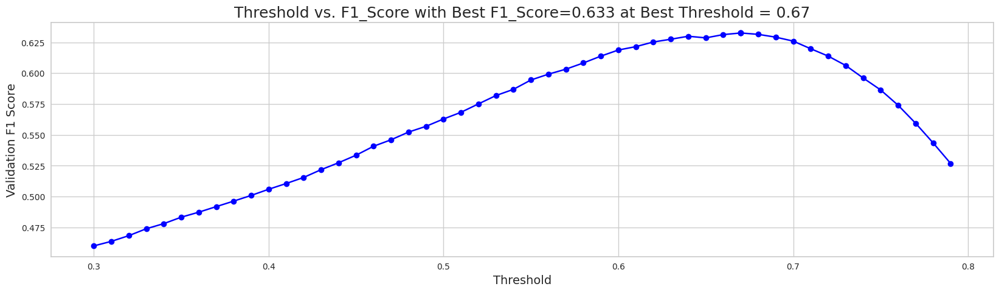

When using optimal threshold = 0.67...
Q0: F1 = 0.6325339110402172
==> Overall F1 = 0.6325339110402172
s
[I 2023-05-23 03:40:37,009] Trial 5 finished with value: 0.6325339110402172 and parameters: {'num_leaves': 71, 'learning_rate': 0.031844861882459115, 'feature_fraction': 0.7626433107140338, 'bagging_fraction': 0.5304775688504324, 'bagging_freq': 2, 'min_child_samples': 84, 'reg_alpha': 0.004892915966233888, 'reg_lambda': 0.009766192826170788, 'subsample': 0.8005044568069108, 'colsample_bytree': 0.3541768990565103, 'min_split_gain': 0.0014995505903355312, 'max_depth': 7}. Best is trial 5 with value: 0.6325339110402172.


--------------------------------------------------
question14, with255features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.7774525518037396, subsample=0.6142187263231014 will be ignored. Current value: bagging_fraction=0.7774525518037396
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=10, subsample_freq=0 will be ignored. Current value: bagging_freq=10
[LightGBM] [Warning] feature_fraction is set=0.6030557199841994, colsample_bytree=0.991862266785135 will be ignored. Current value: feature_fraction=0.6030557199841994


,mean
feature,
20_level_counts,60.0
hover_duration_sum,51.6
hover_duration_mean,41.0
tunic.flaghouse.entry_room_fqid_counts,34.6
elapsed_time_diff_std,34.4
15_level_counts,33.2
hover_duration_std,32.8
elapsed_time_diff_mean,32.4
room_coor_x_max,31.2


[[0.73975578 0.26024422]
 [0.19971681 0.80028319]
 [0.15368519 0.84631481]
 ...
 [0.10089988 0.89910012]
 [0.08408517 0.91591483]
 [0.2908703  0.7091297 ]]


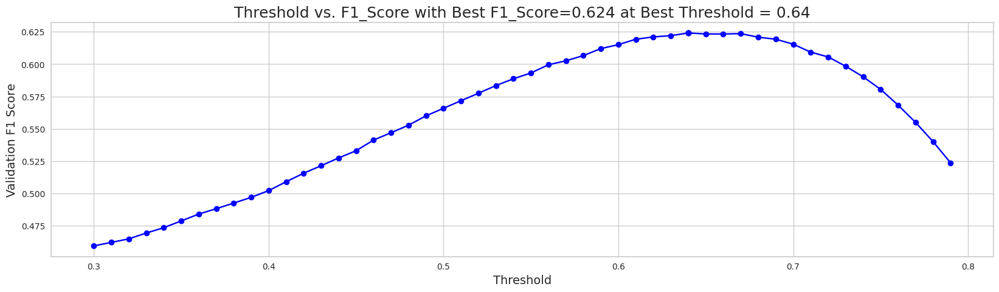

When using optimal threshold = 0.64...
Q0: F1 = 0.6241020486177296
==> Overall F1 = 0.6241020486177296
s
[I 2023-05-23 03:40:46,305] Trial 6 finished with value: 0.6241020486177296 and parameters: {'num_leaves': 82, 'learning_rate': 0.12050054732067607, 'feature_fraction': 0.2993098547025255, 'bagging_fraction': 0.8523383835911064, 'bagging_freq': 7, 'min_child_samples': 94, 'reg_alpha': 0.030646277370688403, 'reg_lambda': 0.006141078679390031, 'subsample': 0.18096034726581062, 'colsample_bytree': 0.7938230981435364, 'min_split_gain': 0.2902837942992948, 'max_depth': 0}. Best is trial 5 with value: 0.6325339110402172.


--------------------------------------------------
question14, with255features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.46048867883653277, subsample=0.8323455824610156 will be ignored. Current value: bagging_fraction=0.46048867883653277
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=9, subsample_freq=0 will be ignored. Current value: bagging_freq=9
[LightGBM] [Warning] feature_fraction is set=0.21689648368693165, colsample_bytree=0.3957993587928871 will be ignored. Current value: feature_fraction=0.21689648368693165


[LightGBM] [Warning] bagging_fraction is set=0.6390493912103195, subsample=0.6039033883440558 will be ignored. Current value: bagging_fraction=0.6390493912103195
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
[LightGBM] [Warning] feature_fraction is set=0.5155928094849056, colsample_bytree=0.4624965178679433 will be ignored. Current value: feature_fraction=0.5155928094849056


,mean
feature,
room_coor_x_min,17.8
hover_duration_std,17.2
elapsed_time_diff_std,16.0
room_coor_x_max,15.2
room_coor_y_min,14.4
screen_coor_y_mean,14.2
20_level_counts,13.8
session_id,13.2
screen_coor_x_mean,12.0


[[0.51059409 0.48940591]
 [0.34290677 0.65709323]
 [0.19819505 0.80180495]
 ...
 [0.16288593 0.83711407]
 [0.14160126 0.85839874]
 [0.21850573 0.78149427]]


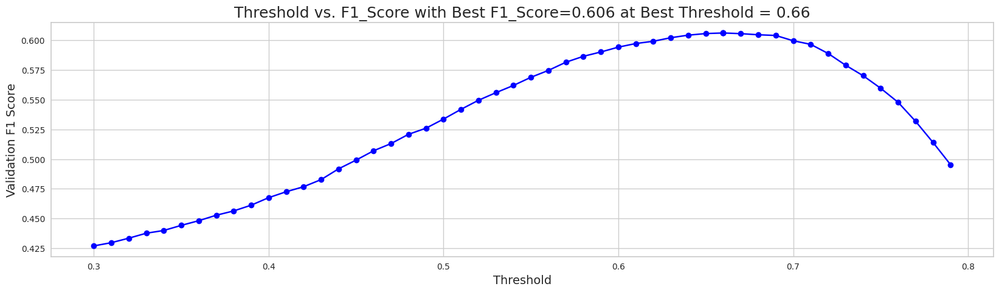

When using optimal threshold = 0.66...
Q0: F1 = 0.6061648095082
==> Overall F1 = 0.6061648095082
s
[I 2023-05-23 03:40:51,600] Trial 7 finished with value: 0.6061648095082 and parameters: {'num_leaves': 80, 'learning_rate': 0.1757424125529284, 'feature_fraction': 0.7023439290990859, 'bagging_fraction': 0.318507882768546, 'bagging_freq': 4, 'min_child_samples': 45, 'reg_alpha': 0.03983017453505806, 'reg_lambda': 3.9908991163999006, 'subsample': 0.6767963027295987, 'colsample_bytree': 0.6386717454515837, 'min_split_gain': 0.12401586611649158, 'max_depth': -1}. Best is trial 5 with value: 0.6325339110402172.


--------------------------------------------------
question14, with255features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.992770576311898, subsample=0.22538267337524542 will be ignored. Current value: bagging_fraction=0.992770576311898
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=10, subsample_freq=0 will be ignored. Current value: bagging_freq=10
[LightGBM] [Warning] feature_fraction is set=0.29664902063459586, colsample_bytree=0.5765737306487385 will be ignored. Current value: feature_fraction=0.29664902063459586


[LightGBM] [Warning] bagging_fraction is set=0.6390493912103195, subsample=0.6039033883440558 will be ignored. Current value: bagging_fraction=0.6390493912103195
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
[LightGBM] [Warning] feature_fraction is set=0.5155928094849056, colsample_bytree=0.4624965178679433 will be ignored. Current value: feature_fraction=0.5155928094849056
[LightGBM] [Warning] bagging_fraction is set=0.7774525518037396, subsample=0.6142187263231014 will be ignored. Current value: bagging_fraction=0.7774525518037396
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=10, subsample_freq=0 will be ignored. Current value: bagging_freq=10
[LightGBM] [Warning] 

[LightGBM] [Warning] bagging_fraction is set=0.46048867883653277, subsample=0.8323455824610156 will be ignored. Current value: bagging_fraction=0.46048867883653277
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=9, subsample_freq=0 will be ignored. Current value: bagging_freq=9
[LightGBM] [Warning] feature_fraction is set=0.21689648368693165, colsample_bytree=0.3957993587928871 will be ignored. Current value: feature_fraction=0.21689648368693165


[LightGBM] [Warning] bagging_fraction is set=0.6390493912103195, subsample=0.6039033883440558 will be ignored. Current value: bagging_fraction=0.6390493912103195
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
[LightGBM] [Warning] feature_fraction is set=0.5155928094849056, colsample_bytree=0.4624965178679433 will be ignored. Current value: feature_fraction=0.5155928094849056


[LightGBM] [Warning] bagging_fraction is set=0.7774525518037396, subsample=0.6142187263231014 will be ignored. Current value: bagging_fraction=0.7774525518037396
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=10, subsample_freq=0 will be ignored. Current value: bagging_freq=10
[LightGBM] [Warning] feature_fraction is set=0.6030557199841994, colsample_bytree=0.991862266785135 will be ignored. Current value: feature_fraction=0.6030557199841994


[LightGBM] [Warning] bagging_fraction is set=0.992770576311898, subsample=0.22538267337524542 will be ignored. Current value: bagging_fraction=0.992770576311898
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=10, subsample_freq=0 will be ignored. Current value: bagging_freq=10
[LightGBM] [Warning] feature_fraction is set=0.29664902063459586, colsample_bytree=0.5765737306487385 will be ignored. Current value: feature_fraction=0.29664902063459586


[LightGBM] [Warning] bagging_fraction is set=0.46048867883653277, subsample=0.8323455824610156 will be ignored. Current value: bagging_fraction=0.46048867883653277
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=9, subsample_freq=0 will be ignored. Current value: bagging_freq=9
[LightGBM] [Warning] feature_fraction is set=0.21689648368693165, colsample_bytree=0.3957993587928871 will be ignored. Current value: feature_fraction=0.21689648368693165


[LightGBM] [Warning] bagging_fraction is set=0.6390493912103195, subsample=0.6039033883440558 will be ignored. Current value: bagging_fraction=0.6390493912103195
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
[LightGBM] [Warning] feature_fraction is set=0.5155928094849056, colsample_bytree=0.4624965178679433 will be ignored. Current value: feature_fraction=0.5155928094849056


[LightGBM] [Warning] bagging_fraction is set=0.7774525518037396, subsample=0.6142187263231014 will be ignored. Current value: bagging_fraction=0.7774525518037396
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=10, subsample_freq=0 will be ignored. Current value: bagging_freq=10
[LightGBM] [Warning] feature_fraction is set=0.6030557199841994, colsample_bytree=0.991862266785135 will be ignored. Current value: feature_fraction=0.6030557199841994


[LightGBM] [Warning] bagging_fraction is set=0.6390493912103195, subsample=0.6039033883440558 will be ignored. Current value: bagging_fraction=0.6390493912103195
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
[LightGBM] [Warning] feature_fraction is set=0.5155928094849056, colsample_bytree=0.4624965178679433 will be ignored. Current value: feature_fraction=0.5155928094849056


[LightGBM] [Warning] bagging_fraction is set=0.992770576311898, subsample=0.22538267337524542 will be ignored. Current value: bagging_fraction=0.992770576311898
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=10, subsample_freq=0 will be ignored. Current value: bagging_freq=10
[LightGBM] [Warning] feature_fraction is set=0.29664902063459586, colsample_bytree=0.5765737306487385 will be ignored. Current value: feature_fraction=0.29664902063459586


[LightGBM] [Warning] bagging_fraction is set=0.46048867883653277, subsample=0.8323455824610156 will be ignored. Current value: bagging_fraction=0.46048867883653277
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=9, subsample_freq=0 will be ignored. Current value: bagging_freq=9
[LightGBM] [Warning] feature_fraction is set=0.21689648368693165, colsample_bytree=0.3957993587928871 will be ignored. Current value: feature_fraction=0.21689648368693165


,mean
feature,
20_level_counts,62.2
tunic.historicalsociety.frontdesk.archivist_glasses.confrontation_recap_text_fqid_counts,58.6
tracks_fqid_counts,48.4
tunic.historicalsociety.entry.directory.closeup.archivist_text_fqid_counts,43.0
session_id,35.6
savedteddy_fqid_counts,27.8
hover_duration_sum,26.2
tunic.flaghouse.entry.flag_girl.symbol_recap_text_fqid_counts,26.0
17_level_counts,26.0


[[0.81074249 0.18925751]
 [0.19666362 0.80333638]
 [0.12795891 0.87204109]
 ...
 [0.11492436 0.88507564]
 [0.10766562 0.89233438]
 [0.17140168 0.82859832]]


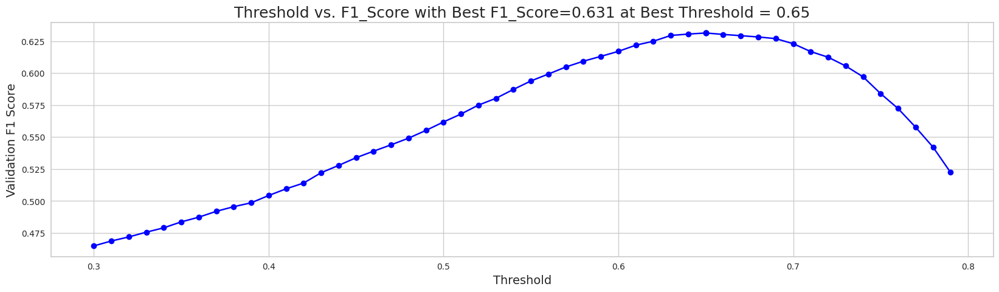

When using optimal threshold = 0.65...
Q0: F1 = 0.6313511444343015
==> Overall F1 = 0.6313511444343015
s
[I 2023-05-23 03:42:00,263] Trial 10 finished with value: 0.6313511444343015 and parameters: {'num_leaves': 35, 'learning_rate': 0.03338050580482989, 'feature_fraction': 0.5155928094849056, 'bagging_fraction': 0.6390493912103195, 'bagging_freq': 6, 'min_child_samples': 37, 'reg_alpha': 0.0032110120259171812, 'reg_lambda': 0.010041491866077166, 'subsample': 0.6039033883440558, 'colsample_bytree': 0.4624965178679433, 'min_split_gain': 0.011637678403851761, 'max_depth': 3}. Best is trial 5 with value: 0.6325339110402172.


--------------------------------------------------
question14, with255features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.4615859588860983, subsample=0.10222080759834806 will be ignored. Current value: bagging_fraction=0.4615859588860983
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=8, subsample_freq=0 will be ignored. Current value: bagging_freq=8
[LightGBM] [Warning] feature_fraction is set=0.6713940350779636, colsample_bytree=0.309665785790079 will be ignored. Current value: feature_fraction=0.6713940350779636


[LightGBM] [Warning] bagging_fraction is set=0.7774525518037396, subsample=0.6142187263231014 will be ignored. Current value: bagging_fraction=0.7774525518037396
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=10, subsample_freq=0 will be ignored. Current value: bagging_freq=10
[LightGBM] [Warning] feature_fraction is set=0.6030557199841994, colsample_bytree=0.991862266785135 will be ignored. Current value: feature_fraction=0.6030557199841994


[LightGBM] [Warning] bagging_fraction is set=0.4615859588860983, subsample=0.10222080759834806 will be ignored. Current value: bagging_fraction=0.4615859588860983
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=8, subsample_freq=0 will be ignored. Current value: bagging_freq=8
[LightGBM] [Warning] feature_fraction is set=0.6713940350779636, colsample_bytree=0.309665785790079 will be ignored. Current value: feature_fraction=0.6713940350779636


[LightGBM] [Warning] bagging_fraction is set=0.992770576311898, subsample=0.22538267337524542 will be ignored. Current value: bagging_fraction=0.992770576311898
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=10, subsample_freq=0 will be ignored. Current value: bagging_freq=10
[LightGBM] [Warning] feature_fraction is set=0.29664902063459586, colsample_bytree=0.5765737306487385 will be ignored. Current value: feature_fraction=0.29664902063459586


,mean
feature,
20_level_counts,106.4
tunic.historicalsociety.frontdesk.archivist_glasses.confrontation_recap_text_fqid_counts,90.6
tracks_fqid_counts,78.4
session_id,74.4
tunic.historicalsociety.entry.directory.closeup.archivist_text_fqid_counts,72.6
18_level_counts,72.0
hover_duration_max,66.6
15_level_counts,64.8
17_level_counts,64.0


[[0.76825025 0.23174975]
 [0.21349229 0.78650771]
 [0.12517013 0.87482987]
 ...
 [0.13538445 0.86461555]
 [0.09300813 0.90699187]
 [0.1913884  0.8086116 ]]


[LightGBM] [Warning] bagging_fraction is set=0.4615859588860983, subsample=0.10222080759834806 will be ignored. Current value: bagging_fraction=0.4615859588860983
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=8, subsample_freq=0 will be ignored. Current value: bagging_freq=8
[LightGBM] [Warning] feature_fraction is set=0.6713940350779636, colsample_bytree=0.309665785790079 will be ignored. Current value: feature_fraction=0.6713940350779636


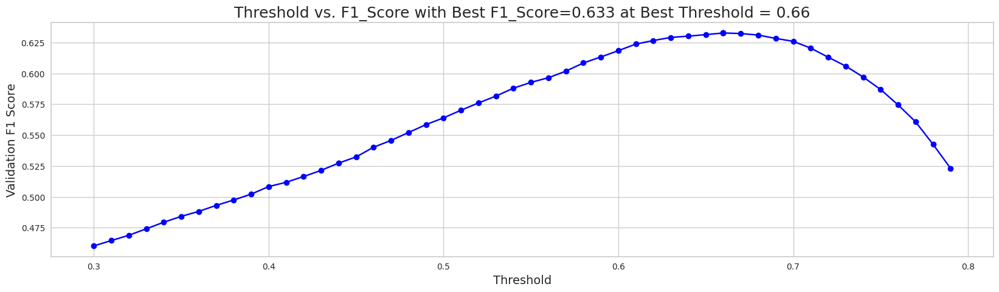

When using optimal threshold = 0.66...
Q0: F1 = 0.6326479076479077
==> Overall F1 = 0.6326479076479077
s
[I 2023-05-23 03:42:15,567] Trial 8 finished with value: 0.6326479076479077 and parameters: {'num_leaves': 12, 'learning_rate': 0.016633963542619933, 'feature_fraction': 0.21689648368693165, 'bagging_fraction': 0.46048867883653277, 'bagging_freq': 9, 'min_child_samples': 44, 'reg_alpha': 0.024860038562745223, 'reg_lambda': 0.0023065291104276153, 'subsample': 0.8323455824610156, 'colsample_bytree': 0.3957993587928871, 'min_split_gain': 0.057258839110379656, 'max_depth': 8}. Best is trial 8 with value: 0.6326479076479077.


--------------------------------------------------
question14, with255features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.12515397831618363, subsample=0.984612417245671 will be ignored. Current value: bagging_fraction=0.12515397831618363
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=10, subsample_freq=0 will be ignored. Current value: bagging_freq=10
[LightGBM] [Warning] feature_fraction is set=0.14043398717395178, colsample_bytree=0.16071834253030687 will be ignored. Current value: feature_fraction=0.14043398717395178


[LightGBM] [Warning] bagging_fraction is set=0.4615859588860983, subsample=0.10222080759834806 will be ignored. Current value: bagging_fraction=0.4615859588860983
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=8, subsample_freq=0 will be ignored. Current value: bagging_freq=8
[LightGBM] [Warning] feature_fraction is set=0.6713940350779636, colsample_bytree=0.309665785790079 will be ignored. Current value: feature_fraction=0.6713940350779636


,mean
feature,
20_level_counts,205.6
session_id,164.2
hover_duration_mean,158.4
tracks_fqid_counts,141.0
hover_duration_max,135.8
hover_duration_sum,131.8
17_level_counts,131.6
elapsed_time_diff_std,131.0
15_level_counts,128.6


[[0.79833458 0.20166542]
 [0.21734874 0.78265126]
 [0.12440787 0.87559213]
 ...
 [0.11162424 0.88837576]
 [0.10288573 0.89711427]
 [0.15962794 0.84037206]]


[LightGBM] [Warning] bagging_fraction is set=0.4615859588860983, subsample=0.10222080759834806 will be ignored. Current value: bagging_fraction=0.4615859588860983
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=8, subsample_freq=0 will be ignored. Current value: bagging_freq=8
[LightGBM] [Warning] feature_fraction is set=0.6713940350779636, colsample_bytree=0.309665785790079 will be ignored. Current value: feature_fraction=0.6713940350779636


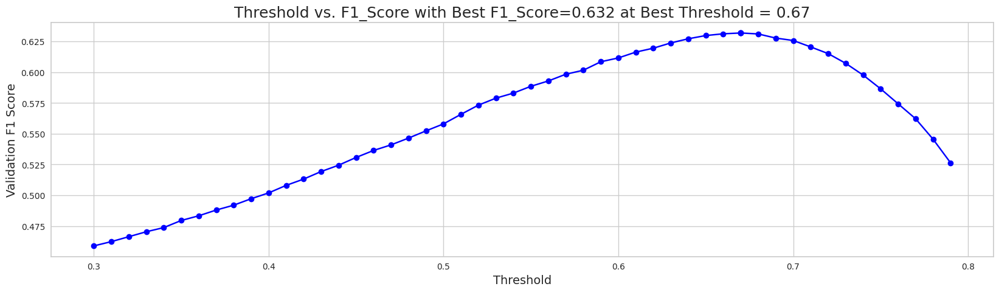

When using optimal threshold = 0.67...
Q0: F1 = 0.6319955732450835
==> Overall F1 = 0.6319955732450835
s
[I 2023-05-23 03:42:29,137] Trial 9 finished with value: 0.6319955732450835 and parameters: {'num_leaves': 60, 'learning_rate': 0.023322965390311826, 'feature_fraction': 0.6030557199841994, 'bagging_fraction': 0.7774525518037396, 'bagging_freq': 10, 'min_child_samples': 25, 'reg_alpha': 0.025961710225687905, 'reg_lambda': 0.5379318308939026, 'subsample': 0.6142187263231014, 'colsample_bytree': 0.991862266785135, 'min_split_gain': 0.4894503412624104, 'max_depth': 8}. Best is trial 8 with value: 0.6326479076479077.


--------------------------------------------------
question14, with255features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.11703661372098279, subsample=0.9966460605339695 will be ignored. Current value: bagging_fraction=0.11703661372098279
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.10121039850684767, colsample_bytree=0.1425482307930498 will be ignored. Current value: feature_fraction=0.10121039850684767


,mean
feature,
tunic.historicalsociety.frontdesk.archivist_glasses.confrontation_recap_text_fqid_counts,15.2
20_level_counts,14.8
session_id,12.2
tracks_fqid_counts,10.2
tunic.historicalsociety.entry.directory.closeup.archivist_text_fqid_counts,8.8
savedteddy_fqid_counts,8.0
17_level_counts,8.0
elapsed_time_diff_std,7.6
hover_duration_mean,7.6


[[0.83851565 0.16148435]
 [0.27884119 0.72115881]
 [0.10641458 0.89358542]
 ...
 [0.16441169 0.83558831]
 [0.11195327 0.88804673]
 [0.27249573 0.72750427]]


[LightGBM] [Warning] bagging_fraction is set=0.992770576311898, subsample=0.22538267337524542 will be ignored. Current value: bagging_fraction=0.992770576311898
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=10, subsample_freq=0 will be ignored. Current value: bagging_freq=10
[LightGBM] [Warning] feature_fraction is set=0.29664902063459586, colsample_bytree=0.5765737306487385 will be ignored. Current value: feature_fraction=0.29664902063459586


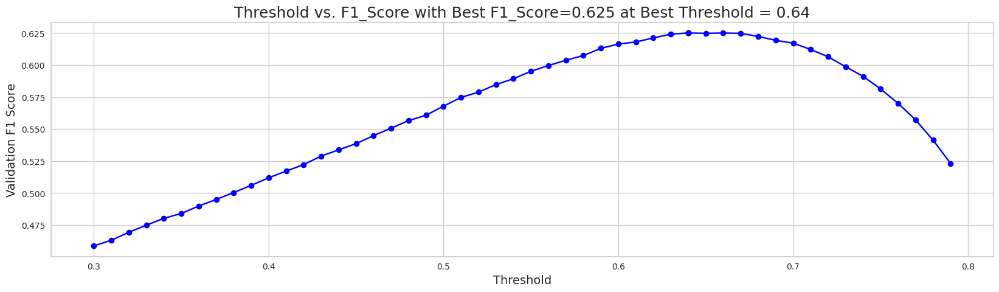

When using optimal threshold = 0.64...
Q0: F1 = 0.6251190121722426
==> Overall F1 = 0.6251190121722426
s
[I 2023-05-23 03:42:37,491] Trial 12 finished with value: 0.6251190121722426 and parameters: {'num_leaves': 16, 'learning_rate': 0.1291913079889591, 'feature_fraction': 0.6713940350779636, 'bagging_fraction': 0.4615859588860983, 'bagging_freq': 8, 'min_child_samples': 56, 'reg_alpha': 0.03107637491804976, 'reg_lambda': 0.0034337206610147815, 'subsample': 0.10222080759834806, 'colsample_bytree': 0.309665785790079, 'min_split_gain': 0.007989275754174331, 'max_depth': -1}. Best is trial 8 with value: 0.6326479076479077.


--------------------------------------------------
question14, with255features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.13712540772616938, subsample=0.9959325413580549 will be ignored. Current value: bagging_fraction=0.13712540772616938
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.14701688964013898, colsample_bytree=0.14797560382298225 will be ignored. Current value: feature_fraction=0.14701688964013898


[LightGBM] [Warning] bagging_fraction is set=0.12515397831618363, subsample=0.984612417245671 will be ignored. Current value: bagging_fraction=0.12515397831618363
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=10, subsample_freq=0 will be ignored. Current value: bagging_freq=10
[LightGBM] [Warning] feature_fraction is set=0.14043398717395178, colsample_bytree=0.16071834253030687 will be ignored. Current value: feature_fraction=0.14043398717395178


[LightGBM] [Warning] bagging_fraction is set=0.11703661372098279, subsample=0.9966460605339695 will be ignored. Current value: bagging_fraction=0.11703661372098279
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.10121039850684767, colsample_bytree=0.1425482307930498 will be ignored. Current value: feature_fraction=0.10121039850684767


[LightGBM] [Warning] bagging_fraction is set=0.13712540772616938, subsample=0.9959325413580549 will be ignored. Current value: bagging_fraction=0.13712540772616938
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.14701688964013898, colsample_bytree=0.14797560382298225 will be ignored. Current value: feature_fraction=0.14701688964013898


[LightGBM] [Warning] bagging_fraction is set=0.11703661372098279, subsample=0.9966460605339695 will be ignored. Current value: bagging_fraction=0.11703661372098279
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.10121039850684767, colsample_bytree=0.1425482307930498 will be ignored. Current value: feature_fraction=0.10121039850684767


[LightGBM] [Warning] bagging_fraction is set=0.12515397831618363, subsample=0.984612417245671 will be ignored. Current value: bagging_fraction=0.12515397831618363
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=10, subsample_freq=0 will be ignored. Current value: bagging_freq=10
[LightGBM] [Warning] feature_fraction is set=0.14043398717395178, colsample_bytree=0.16071834253030687 will be ignored. Current value: feature_fraction=0.14043398717395178


,mean
feature,
elapsed_time_diff_std,173.2
20_level_counts,172.6
session_id,170.8
hover_duration_std,164.8
hover_duration_mean,163.4
17_level_counts,159.6
elapsed_time_diff_sum,158.8
hover_duration_max,156.0
room_coor_x_min,150.8


[[0.81104127 0.18895873]
 [0.21892975 0.78107025]
 [0.13241097 0.86758903]
 ...
 [0.1254797  0.8745203 ]
 [0.08648183 0.91351817]
 [0.17107955 0.82892045]]


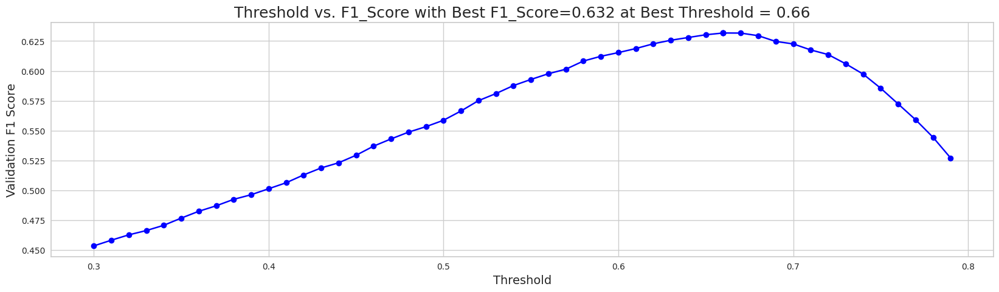

When using optimal threshold = 0.66...
Q0: F1 = 0.6317279942279942
==> Overall F1 = 0.6317279942279942
s
[I 2023-05-23 03:43:13,582] Trial 11 finished with value: 0.6317279942279942 and parameters: {'num_leaves': 80, 'learning_rate': 0.033887782935213086, 'feature_fraction': 0.29664902063459586, 'bagging_fraction': 0.992770576311898, 'bagging_freq': 10, 'min_child_samples': 28, 'reg_alpha': 3.941556912717239, 'reg_lambda': 0.006648808717181401, 'subsample': 0.22538267337524542, 'colsample_bytree': 0.5765737306487385, 'min_split_gain': 0.09066248220153117, 'max_depth': 10}. Best is trial 8 with value: 0.6326479076479077.


--------------------------------------------------
question14, with255features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.17253490613787753, subsample=0.9925673745454547 will be ignored. Current value: bagging_fraction=0.17253490613787753
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.10027578183990507, colsample_bytree=0.11884166147485714 will be ignored. Current value: feature_fraction=0.10027578183990507


[LightGBM] [Warning] bagging_fraction is set=0.13712540772616938, subsample=0.9959325413580549 will be ignored. Current value: bagging_fraction=0.13712540772616938
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.14701688964013898, colsample_bytree=0.14797560382298225 will be ignored. Current value: feature_fraction=0.14701688964013898


[LightGBM] [Warning] bagging_fraction is set=0.11703661372098279, subsample=0.9966460605339695 will be ignored. Current value: bagging_fraction=0.11703661372098279
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.10121039850684767, colsample_bytree=0.1425482307930498 will be ignored. Current value: feature_fraction=0.10121039850684767


[LightGBM] [Warning] bagging_fraction is set=0.12515397831618363, subsample=0.984612417245671 will be ignored. Current value: bagging_fraction=0.12515397831618363
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=10, subsample_freq=0 will be ignored. Current value: bagging_freq=10
[LightGBM] [Warning] feature_fraction is set=0.14043398717395178, colsample_bytree=0.16071834253030687 will be ignored. Current value: feature_fraction=0.14043398717395178


[LightGBM] [Warning] bagging_fraction is set=0.13712540772616938, subsample=0.9959325413580549 will be ignored. Current value: bagging_fraction=0.13712540772616938
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.14701688964013898, colsample_bytree=0.14797560382298225 will be ignored. Current value: feature_fraction=0.14701688964013898


[LightGBM] [Warning] bagging_fraction is set=0.17253490613787753, subsample=0.9925673745454547 will be ignored. Current value: bagging_fraction=0.17253490613787753
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.10027578183990507, colsample_bytree=0.11884166147485714 will be ignored. Current value: feature_fraction=0.10027578183990507


[LightGBM] [Warning] bagging_fraction is set=0.12515397831618363, subsample=0.984612417245671 will be ignored. Current value: bagging_fraction=0.12515397831618363
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=10, subsample_freq=0 will be ignored. Current value: bagging_freq=10
[LightGBM] [Warning] feature_fraction is set=0.14043398717395178, colsample_bytree=0.16071834253030687 will be ignored. Current value: feature_fraction=0.14043398717395178


[LightGBM] [Warning] bagging_fraction is set=0.11703661372098279, subsample=0.9966460605339695 will be ignored. Current value: bagging_fraction=0.11703661372098279
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.10121039850684767, colsample_bytree=0.1425482307930498 will be ignored. Current value: feature_fraction=0.10121039850684767


[LightGBM] [Warning] bagging_fraction is set=0.17253490613787753, subsample=0.9925673745454547 will be ignored. Current value: bagging_fraction=0.17253490613787753
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.10027578183990507, colsample_bytree=0.11884166147485714 will be ignored. Current value: feature_fraction=0.10027578183990507
[LightGBM] [Warning] bagging_fraction is set=0.13712540772616938, subsample=0.9959325413580549 will be ignored. Current value: bagging_fraction=0.13712540772616938
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warn

,mean
feature,
hover_duration_std,298.4
hover_duration_sum,283.6
room_coor_y_mean,252.8
hover_duration_max,248.4
elapsed_time_diff_mean,241.2
room_coor_x_std,241.0
room_coor_x_sum,239.8
room_coor_y_max,237.4
room_corr_x_diff_std,233.0


[[0.70865299 0.29134701]
 [0.2617953  0.7382047 ]
 [0.12685658 0.87314342]
 ...
 [0.12081244 0.87918756]
 [0.10357743 0.89642257]
 [0.17569987 0.82430013]]


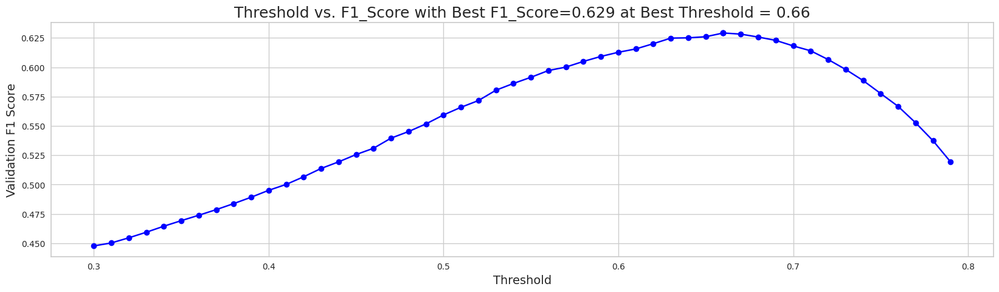

When using optimal threshold = 0.66...
Q0: F1 = 0.6291909511958266
==> Overall F1 = 0.6291909511958266
s
[I 2023-05-23 03:44:10,891] Trial 14 finished with value: 0.6291909511958266 and parameters: {'num_leaves': 63, 'learning_rate': 0.012161984435277245, 'feature_fraction': 0.10121039850684767, 'bagging_fraction': 0.11703661372098279, 'bagging_freq': 1, 'min_child_samples': 56, 'reg_alpha': 0.005507846857288292, 'reg_lambda': 0.0010096601935322724, 'subsample': 0.9966460605339695, 'colsample_bytree': 0.1425482307930498, 'min_split_gain': 0.001108352366610776, 'max_depth': 10}. Best is trial 8 with value: 0.6326479076479077.


--------------------------------------------------
question14, with255features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.5293020222690412, subsample=0.8138002509281355 will be ignored. Current value: bagging_fraction=0.5293020222690412
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9516378750886965, colsample_bytree=0.22529998018726521 will be ignored. Current value: feature_fraction=0.9516378750886965


,mean
feature,
elapsed_time_diff_mean,161.6
hover_duration_std,157.6
room_coor_y_max,149.8
room_coor_x_std,139.8
room_corr_y_diff_mean,139.4
room_coor_y_mean,138.2
screen_corr_x_dff_sum,132.2
17_level_counts,131.8
room_corr_x_diff_std,131.6


[[0.72968396 0.27031604]
 [0.21912954 0.78087046]
 [0.1354948  0.8645052 ]
 ...
 [0.14591021 0.85408979]
 [0.09968963 0.90031037]
 [0.19781212 0.80218788]]


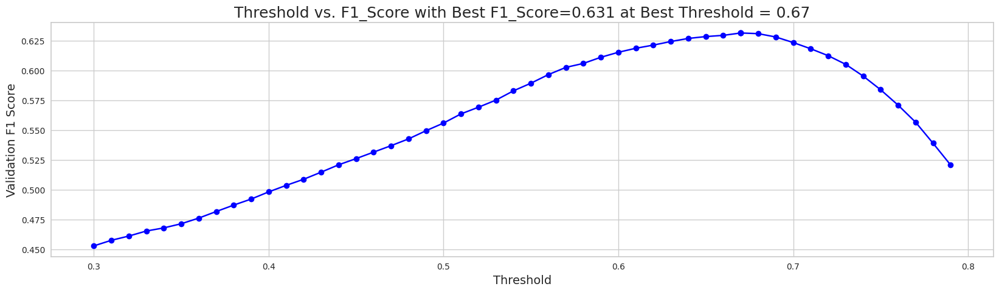

When using optimal threshold = 0.67...
Q0: F1 = 0.6312629942341142
==> Overall F1 = 0.6312629942341142
s
[I 2023-05-23 03:44:20,665] Trial 13 finished with value: 0.6312629942341142 and parameters: {'num_leaves': 10, 'learning_rate': 0.010242279191183017, 'feature_fraction': 0.14043398717395178, 'bagging_fraction': 0.12515397831618363, 'bagging_freq': 10, 'min_child_samples': 9, 'reg_alpha': 0.7356510385041816, 'reg_lambda': 0.001097888091145163, 'subsample': 0.984612417245671, 'colsample_bytree': 0.16071834253030687, 'min_split_gain': 0.8677780134250853, 'max_depth': 10}. Best is trial 8 with value: 0.6326479076479077.


--------------------------------------------------
question14, with255features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.5788432651665169, subsample=0.8140568245171569 will be ignored. Current value: bagging_fraction=0.5788432651665169
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.41012231066931615, colsample_bytree=0.2586014029583032 will be ignored. Current value: feature_fraction=0.41012231066931615


[LightGBM] [Warning] bagging_fraction is set=0.17253490613787753, subsample=0.9925673745454547 will be ignored. Current value: bagging_fraction=0.17253490613787753
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.10027578183990507, colsample_bytree=0.11884166147485714 will be ignored. Current value: feature_fraction=0.10027578183990507


[LightGBM] [Warning] bagging_fraction is set=0.5293020222690412, subsample=0.8138002509281355 will be ignored. Current value: bagging_fraction=0.5293020222690412
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9516378750886965, colsample_bytree=0.22529998018726521 will be ignored. Current value: feature_fraction=0.9516378750886965


,mean
feature,
room_coor_y_min,229.2
hover_duration_max,189.2
hover_duration_std,173.4
elapsed_time_diff_sum,173.4
hover_duration_mean,171.2
screen_coor_y_min,159.8
room_corr_y_diff_sum,158.2
hover_duration_sum,158.0
room_corr_x_diff_mean,157.2


[[0.7088473  0.2911527 ]
 [0.20481679 0.79518321]
 [0.1205396  0.8794604 ]
 ...
 [0.13008681 0.86991319]
 [0.08099286 0.91900714]
 [0.17585435 0.82414565]]


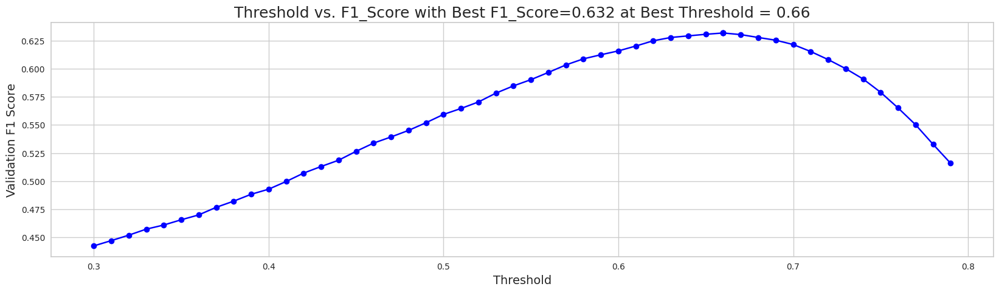

When using optimal threshold = 0.66...
Q0: F1 = 0.6317049700388757
==> Overall F1 = 0.6317049700388757
s
[I 2023-05-23 03:44:41,997] Trial 15 finished with value: 0.6317049700388757 and parameters: {'num_leaves': 61, 'learning_rate': 0.011040004049094807, 'feature_fraction': 0.14701688964013898, 'bagging_fraction': 0.13712540772616938, 'bagging_freq': 1, 'min_child_samples': 98, 'reg_alpha': 0.006109964595563155, 'reg_lambda': 0.001254371459677564, 'subsample': 0.9959325413580549, 'colsample_bytree': 0.14797560382298225, 'min_split_gain': 0.00101496973352393, 'max_depth': 10}. Best is trial 8 with value: 0.6326479076479077.


--------------------------------------------------
question14, with255features
--------------------------------------------------
[LightGBM] [Warning] bagging_fraction is set=0.5788432651665169, subsample=0.8140568245171569 will be ignored. Current value: bagging_fraction=0.5788432651665169
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.41012231066931615, colsample_bytree=0.2586014029583032 will be ignored. Current value: feature_fraction=0.41012231066931615


[LightGBM] [Warning] bagging_fraction is set=0.5405776537495426, subsample=0.8097697616225606 will be ignored. Current value: bagging_fraction=0.5405776537495426
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.4208446890553348, colsample_bytree=0.26896885407017324 will be ignored. Current value: feature_fraction=0.4208446890553348


[LightGBM] [Warning] bagging_fraction is set=0.5293020222690412, subsample=0.8138002509281355 will be ignored. Current value: bagging_fraction=0.5293020222690412
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9516378750886965, colsample_bytree=0.22529998018726521 will be ignored. Current value: feature_fraction=0.9516378750886965


[LightGBM] [Warning] bagging_fraction is set=0.17253490613787753, subsample=0.9925673745454547 will be ignored. Current value: bagging_fraction=0.17253490613787753
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.10027578183990507, colsample_bytree=0.11884166147485714 will be ignored. Current value: feature_fraction=0.10027578183990507


[LightGBM] [Warning] bagging_fraction is set=0.5788432651665169, subsample=0.8140568245171569 will be ignored. Current value: bagging_fraction=0.5788432651665169
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.41012231066931615, colsample_bytree=0.2586014029583032 will be ignored. Current value: feature_fraction=0.41012231066931615


[LightGBM] [Warning] bagging_fraction is set=0.5293020222690412, subsample=0.8138002509281355 will be ignored. Current value: bagging_fraction=0.5293020222690412
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9516378750886965, colsample_bytree=0.22529998018726521 will be ignored. Current value: feature_fraction=0.9516378750886965


[LightGBM] [Warning] bagging_fraction is set=0.5405776537495426, subsample=0.8097697616225606 will be ignored. Current value: bagging_fraction=0.5405776537495426
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.4208446890553348, colsample_bytree=0.26896885407017324 will be ignored. Current value: feature_fraction=0.4208446890553348


[LightGBM] [Warning] bagging_fraction is set=0.5293020222690412, subsample=0.8138002509281355 will be ignored. Current value: bagging_fraction=0.5293020222690412
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9516378750886965, colsample_bytree=0.22529998018726521 will be ignored. Current value: feature_fraction=0.9516378750886965


,mean
feature,
room_coor_y_min,257.2
hover_duration_max,211.8
hover_duration_std,209.0
hover_duration_sum,191.6
hover_duration_mean,191.4
room_coor_x_min,179.8
screen_coor_y_mean,176.8
session_id,166.6
room_corr_x_diff_sum,162.0


[[0.73271996 0.26728004]
 [0.24182744 0.75817256]
 [0.1230007  0.8769993 ]
 ...
 [0.12871857 0.87128143]
 [0.08040698 0.91959302]
 [0.20112045 0.79887955]]


[LightGBM] [Warning] bagging_fraction is set=0.5788432651665169, subsample=0.8140568245171569 will be ignored. Current value: bagging_fraction=0.5788432651665169
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.41012231066931615, colsample_bytree=0.2586014029583032 will be ignored. Current value: feature_fraction=0.41012231066931615


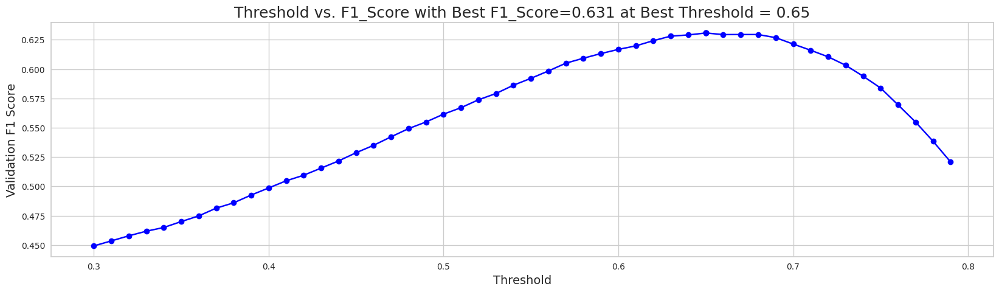

When using optimal threshold = 0.65...
Q0: F1 = 0.6307701362576725
==> Overall F1 = 0.6307701362576725
s
[I 2023-05-23 03:45:26,762] Trial 16 finished with value: 0.6307701362576725 and parameters: {'num_leaves': 57, 'learning_rate': 0.011133602272487364, 'feature_fraction': 0.10027578183990507, 'bagging_fraction': 0.17253490613787753, 'bagging_freq': 1, 'min_child_samples': 98, 'reg_alpha': 0.00540384790919244, 'reg_lambda': 0.001337816630962092, 'subsample': 0.9925673745454547, 'colsample_bytree': 0.11884166147485714, 'min_split_gain': 0.0012576793438435923, 'max_depth': 7}. Best is trial 8 with value: 0.6326479076479077.


--------------------------------------------------
question14, with255features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.5876816709274749, subsample=0.8099800009407239 will be ignored. Current value: bagging_fraction=0.5876816709274749
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.4082251642885194, colsample_bytree=0.29022850676188383 will be ignored. Current value: feature_fraction=0.4082251642885194


[LightGBM] [Warning] bagging_fraction is set=0.5405776537495426, subsample=0.8097697616225606 will be ignored. Current value: bagging_fraction=0.5405776537495426
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.4208446890553348, colsample_bytree=0.26896885407017324 will be ignored. Current value: feature_fraction=0.4208446890553348


,mean
feature,
20_level_counts,184.6
session_id,152.6
tunic.historicalsociety.frontdesk.archivist_glasses.confrontation_recap_text_fqid_counts,135.0
hover_duration_sum,125.2
tracks_fqid_counts,120.8
15_level_counts,120.6
hover_duration_max,117.6
room_coor_y_max,116.2
17_level_counts,115.4


[[0.74583621 0.25416379]
 [0.22316442 0.77683558]
 [0.12731054 0.87268946]
 ...
 [0.11655109 0.88344891]
 [0.10711453 0.89288547]
 [0.18328181 0.81671819]]


[LightGBM] [Warning] bagging_fraction is set=0.5788432651665169, subsample=0.8140568245171569 will be ignored. Current value: bagging_fraction=0.5788432651665169
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.41012231066931615, colsample_bytree=0.2586014029583032 will be ignored. Current value: feature_fraction=0.41012231066931615


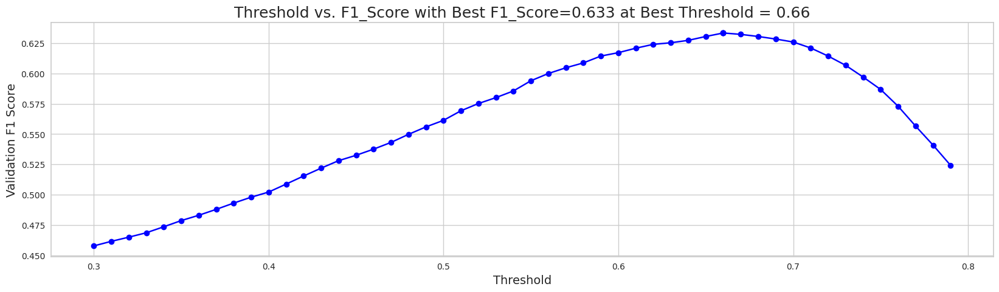

When using optimal threshold = 0.66...
Q0: F1 = 0.6332333385915947
==> Overall F1 = 0.6332333385915947
s
[I 2023-05-23 03:45:44,222] Trial 17 finished with value: 0.6332333385915947 and parameters: {'num_leaves': 99, 'learning_rate': 0.01971630498669269, 'feature_fraction': 0.9516378750886965, 'bagging_fraction': 0.5293020222690412, 'bagging_freq': 1, 'min_child_samples': 86, 'reg_alpha': 0.007997442724213428, 'reg_lambda': 0.03083360144520241, 'subsample': 0.8138002509281355, 'colsample_bytree': 0.22529998018726521, 'min_split_gain': 0.040677382232636415, 'max_depth': 7}. Best is trial 17 with value: 0.6332333385915947.


--------------------------------------------------
question14, with255features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.37504433543325744, subsample=0.8206409327759379 will be ignored. Current value: bagging_fraction=0.37504433543325744
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=8, subsample_freq=0 will be ignored. Current value: bagging_freq=8
[LightGBM] [Warning] feature_fraction is set=0.9936706944312316, colsample_bytree=0.2994401435725256 will be ignored. Current value: feature_fraction=0.9936706944312316


[LightGBM] [Warning] bagging_fraction is set=0.5876816709274749, subsample=0.8099800009407239 will be ignored. Current value: bagging_fraction=0.5876816709274749
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.4082251642885194, colsample_bytree=0.29022850676188383 will be ignored. Current value: feature_fraction=0.4082251642885194


[LightGBM] [Warning] bagging_fraction is set=0.5405776537495426, subsample=0.8097697616225606 will be ignored. Current value: bagging_fraction=0.5405776537495426
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.4208446890553348, colsample_bytree=0.26896885407017324 will be ignored. Current value: feature_fraction=0.4208446890553348


[LightGBM] [Warning] bagging_fraction is set=0.37504433543325744, subsample=0.8206409327759379 will be ignored. Current value: bagging_fraction=0.37504433543325744
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=8, subsample_freq=0 will be ignored. Current value: bagging_freq=8
[LightGBM] [Warning] feature_fraction is set=0.9936706944312316, colsample_bytree=0.2994401435725256 will be ignored. Current value: feature_fraction=0.9936706944312316


,mean
feature,
20_level_counts,158.6
session_id,140.8
hover_duration_sum,137.8
hover_duration_max,130.4
hover_duration_mean,127.0
hover_duration_std,113.4
15_level_counts,111.0
room_coor_y_mean,107.0
18_level_counts,105.4


[LightGBM] [Warning] bagging_fraction is set=0.5876816709274749, subsample=0.8099800009407239 will be ignored. Current value: bagging_fraction=0.5876816709274749
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.4082251642885194, colsample_bytree=0.29022850676188383 will be ignored. Current value: feature_fraction=0.4082251642885194


[[0.78570281 0.21429719]
 [0.23407213 0.76592787]
 [0.123584   0.876416  ]
 ...
 [0.11047887 0.88952113]
 [0.08864239 0.91135761]
 [0.21600425 0.78399575]]


[LightGBM] [Warning] bagging_fraction is set=0.5405776537495426, subsample=0.8097697616225606 will be ignored. Current value: bagging_fraction=0.5405776537495426
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.4208446890553348, colsample_bytree=0.26896885407017324 will be ignored. Current value: feature_fraction=0.4208446890553348


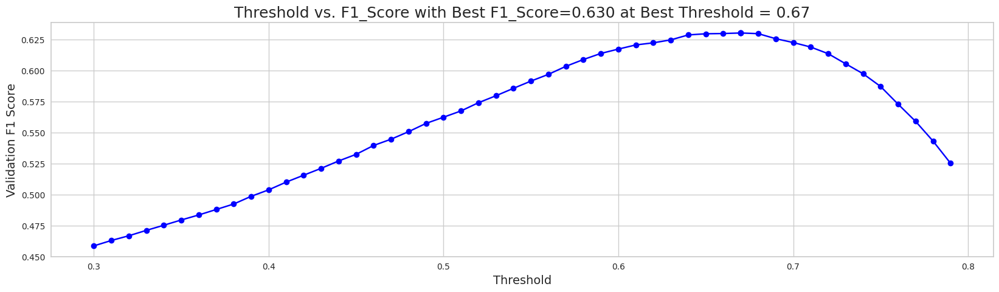

When using optimal threshold = 0.67...
Q0: F1 = 0.6304415090045128
==> Overall F1 = 0.6304415090045128
s
[I 2023-05-23 03:46:15,193] Trial 18 finished with value: 0.6304415090045128 and parameters: {'num_leaves': 95, 'learning_rate': 0.022498036727509232, 'feature_fraction': 0.41012231066931615, 'bagging_fraction': 0.5788432651665169, 'bagging_freq': 1, 'min_child_samples': 91, 'reg_alpha': 0.00821701750062213, 'reg_lambda': 0.03513437644367247, 'subsample': 0.8140568245171569, 'colsample_bytree': 0.2586014029583032, 'min_split_gain': 0.04388249827051226, 'max_depth': 7}. Best is trial 17 with value: 0.6332333385915947.


--------------------------------------------------
question14, with255features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.3660123484048269, subsample=0.8693202868734751 will be ignored. Current value: bagging_fraction=0.3660123484048269
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=8, subsample_freq=0 will be ignored. Current value: bagging_freq=8
[LightGBM] [Warning] feature_fraction is set=0.9882696046711613, colsample_bytree=0.24211371478819177 will be ignored. Current value: feature_fraction=0.9882696046711613


[LightGBM] [Warning] bagging_fraction is set=0.37504433543325744, subsample=0.8206409327759379 will be ignored. Current value: bagging_fraction=0.37504433543325744
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=8, subsample_freq=0 will be ignored. Current value: bagging_freq=8
[LightGBM] [Warning] feature_fraction is set=0.9936706944312316, colsample_bytree=0.2994401435725256 will be ignored. Current value: feature_fraction=0.9936706944312316


,mean
feature,
20_level_counts,159.0
hover_duration_std,148.0
hover_duration_max,146.8
hover_duration_mean,144.4
session_id,140.8
21_level_counts,130.0
17_level_counts,129.0
room_coor_x_max,127.6
18_level_counts,123.0


[[0.78197686 0.21802314]
 [0.21884349 0.78115651]
 [0.11861589 0.88138411]
 ...
 [0.15216592 0.84783408]
 [0.10579909 0.89420091]
 [0.18950623 0.81049377]]


[LightGBM] [Warning] bagging_fraction is set=0.5876816709274749, subsample=0.8099800009407239 will be ignored. Current value: bagging_fraction=0.5876816709274749
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.4082251642885194, colsample_bytree=0.29022850676188383 will be ignored. Current value: feature_fraction=0.4082251642885194
[LightGBM] [Warning] bagging_fraction is set=0.37504433543325744, subsample=0.8206409327759379 will be ignored. Current value: bagging_fraction=0.37504433543325744
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=8, subsample_freq=0 will be ignored. Current value: bagging_freq=8
[LightGBM] [Warning]

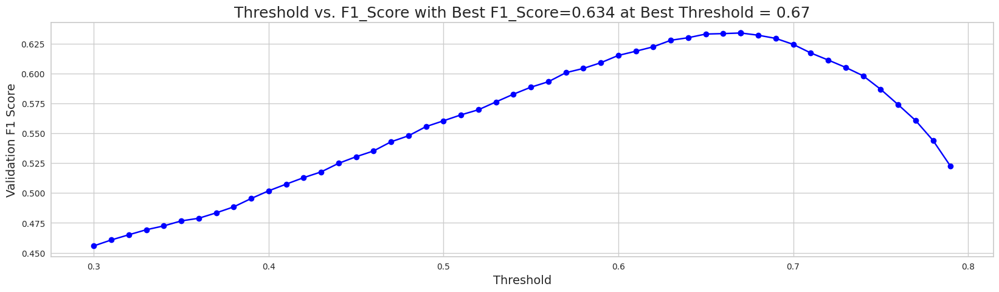

When using optimal threshold = 0.67...
Q0: F1 = 0.6340276046280243
==> Overall F1 = 0.6340276046280243
s
[I 2023-05-23 03:46:38,133] Trial 19 finished with value: 0.6340276046280243 and parameters: {'num_leaves': 100, 'learning_rate': 0.02138377939293738, 'feature_fraction': 0.4208446890553348, 'bagging_fraction': 0.5405776537495426, 'bagging_freq': 2, 'min_child_samples': 44, 'reg_alpha': 0.009953872246621207, 'reg_lambda': 0.02743383066481637, 'subsample': 0.8097697616225606, 'colsample_bytree': 0.26896885407017324, 'min_split_gain': 0.06348587664728424, 'max_depth': 7}. Best is trial 19 with value: 0.6340276046280243.


--------------------------------------------------
question14, with255features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.3182846731276552, subsample=0.7224358999109781 will be ignored. Current value: bagging_fraction=0.3182846731276552
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.9242572670951994, colsample_bytree=0.24384257704566703 will be ignored. Current value: feature_fraction=0.9242572670951994


[LightGBM] [Warning] bagging_fraction is set=0.3182846731276552, subsample=0.7224358999109781 will be ignored. Current value: bagging_fraction=0.3182846731276552
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.9242572670951994, colsample_bytree=0.24384257704566703 will be ignored. Current value: feature_fraction=0.9242572670951994


[LightGBM] [Warning] bagging_fraction is set=0.3660123484048269, subsample=0.8693202868734751 will be ignored. Current value: bagging_fraction=0.3660123484048269
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=8, subsample_freq=0 will be ignored. Current value: bagging_freq=8
[LightGBM] [Warning] feature_fraction is set=0.9882696046711613, colsample_bytree=0.24211371478819177 will be ignored. Current value: feature_fraction=0.9882696046711613


[LightGBM] [Warning] bagging_fraction is set=0.37504433543325744, subsample=0.8206409327759379 will be ignored. Current value: bagging_fraction=0.37504433543325744
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=8, subsample_freq=0 will be ignored. Current value: bagging_freq=8
[LightGBM] [Warning] feature_fraction is set=0.9936706944312316, colsample_bytree=0.2994401435725256 will be ignored. Current value: feature_fraction=0.9936706944312316


[LightGBM] [Warning] bagging_fraction is set=0.3182846731276552, subsample=0.7224358999109781 will be ignored. Current value: bagging_fraction=0.3182846731276552
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.9242572670951994, colsample_bytree=0.24384257704566703 will be ignored. Current value: feature_fraction=0.9242572670951994


[LightGBM] [Warning] bagging_fraction is set=0.5876816709274749, subsample=0.8099800009407239 will be ignored. Current value: bagging_fraction=0.5876816709274749
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.4082251642885194, colsample_bytree=0.29022850676188383 will be ignored. Current value: feature_fraction=0.4082251642885194


[LightGBM] [Warning] bagging_fraction is set=0.3182846731276552, subsample=0.7224358999109781 will be ignored. Current value: bagging_fraction=0.3182846731276552
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.9242572670951994, colsample_bytree=0.24384257704566703 will be ignored. Current value: feature_fraction=0.9242572670951994


,mean
feature,
20_level_counts,184.6
session_id,165.8
hover_duration_mean,139.4
15_level_counts,134.4
hover_duration_max,133.2
room_coor_x_min,132.4
room_coor_y_max,130.2
hover_duration_sum,129.8
room_coor_x_max,127.4


[[0.76408055 0.23591945]
 [0.32951235 0.67048765]
 [0.18078621 0.81921379]
 ...
 [0.12672727 0.87327273]
 [0.09119482 0.90880518]
 [0.16681988 0.83318012]]


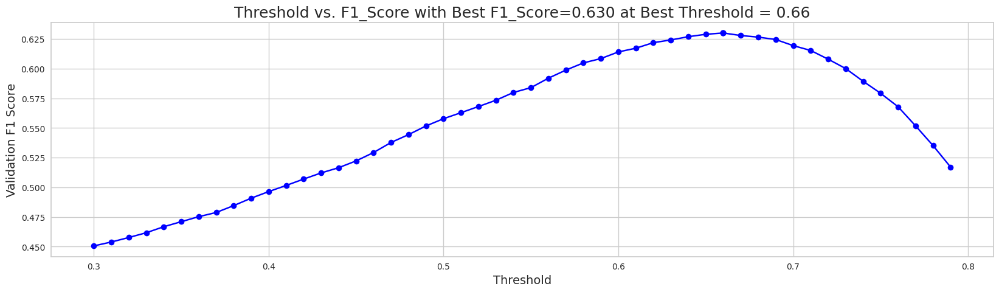

When using optimal threshold = 0.66...
Q0: F1 = 0.6301232960112371
==> Overall F1 = 0.6301232960112371
s
[I 2023-05-23 03:47:12,606] Trial 21 finished with value: 0.6301232960112371 and parameters: {'num_leaves': 100, 'learning_rate': 0.0193183466016137, 'feature_fraction': 0.9936706944312316, 'bagging_fraction': 0.37504433543325744, 'bagging_freq': 8, 'min_child_samples': 43, 'reg_alpha': 0.014567096986972316, 'reg_lambda': 0.04585669965564129, 'subsample': 0.8206409327759379, 'colsample_bytree': 0.2994401435725256, 'min_split_gain': 0.040251649799252116, 'max_depth': 8}. Best is trial 19 with value: 0.6340276046280243.


--------------------------------------------------
question14, with255features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.3182846731276552, subsample=0.7224358999109781 will be ignored. Current value: bagging_fraction=0.3182846731276552
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.9242572670951994, colsample_bytree=0.24384257704566703 will be ignored. Current value: feature_fraction=0.9242572670951994


[LightGBM] [Warning] bagging_fraction is set=0.46081985227259226, subsample=0.8809771958185001 will be ignored. Current value: bagging_fraction=0.46081985227259226
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.42782815202627045, colsample_bytree=0.24692196285007267 will be ignored. Current value: feature_fraction=0.42782815202627045


[LightGBM] [Warning] bagging_fraction is set=0.3660123484048269, subsample=0.8693202868734751 will be ignored. Current value: bagging_fraction=0.3660123484048269
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=8, subsample_freq=0 will be ignored. Current value: bagging_freq=8
[LightGBM] [Warning] feature_fraction is set=0.9882696046711613, colsample_bytree=0.24211371478819177 will be ignored. Current value: feature_fraction=0.9882696046711613


,mean
feature,
20_level_counts,38.6
session_id,31.6
tunic.historicalsociety.frontdesk.archivist_glasses.confrontation_recap_text_fqid_counts,30.2
hover_duration_mean,25.0
hover_duration_max,24.2
room_coor_x_min,24.0
room_coor_x_std,24.0
room_coor_y_min,23.0
hover_duration_sum,22.4


[[0.67720646 0.32279354]
 [0.2126224  0.7873776 ]
 [0.10701472 0.89298528]
 ...
 [0.14142917 0.85857083]
 [0.06836969 0.93163031]
 [0.13288715 0.86711285]]


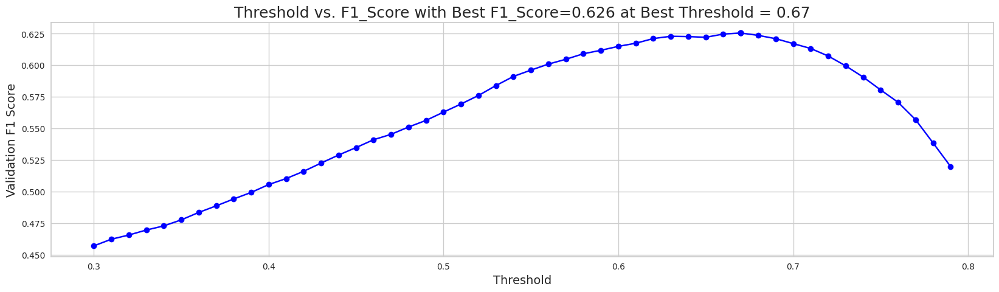

When using optimal threshold = 0.67...
Q0: F1 = 0.6255724534678457
==> Overall F1 = 0.6255724534678457
s
[I 2023-05-23 03:47:23,527] Trial 23 finished with value: 0.6255724534678457 and parameters: {'num_leaves': 93, 'learning_rate': 0.0650625280772058, 'feature_fraction': 0.9242572670951994, 'bagging_fraction': 0.3182846731276552, 'bagging_freq': 3, 'min_child_samples': 67, 'reg_alpha': 0.0014800145217379703, 'reg_lambda': 0.0387669786033371, 'subsample': 0.7224358999109781, 'colsample_bytree': 0.24384257704566703, 'min_split_gain': 0.02552359154753782, 'max_depth': 6}. Best is trial 19 with value: 0.6340276046280243.


--------------------------------------------------
question14, with255features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.46007788737730626, subsample=0.8758360099779511 will be ignored. Current value: bagging_fraction=0.46007788737730626
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.42694766435909437, colsample_bytree=0.22421881624025447 will be ignored. Current value: feature_fraction=0.42694766435909437


,mean
feature,
20_level_counts,184.6
hover_duration_std,161.2
session_id,155.2
hover_duration_mean,149.6
17_level_counts,149.0
hover_duration_max,145.0
screen_coor_y_mean,140.0
screen_coor_x_std,139.0
15_level_counts,139.0


[[0.81139227 0.18860773]
 [0.23835008 0.76164992]
 [0.11915169 0.88084831]
 ...
 [0.10057487 0.89942513]
 [0.09213823 0.90786177]
 [0.15347238 0.84652762]]


[LightGBM] [Warning] bagging_fraction is set=0.46081985227259226, subsample=0.8809771958185001 will be ignored. Current value: bagging_fraction=0.46081985227259226
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.42782815202627045, colsample_bytree=0.24692196285007267 will be ignored. Current value: feature_fraction=0.42782815202627045


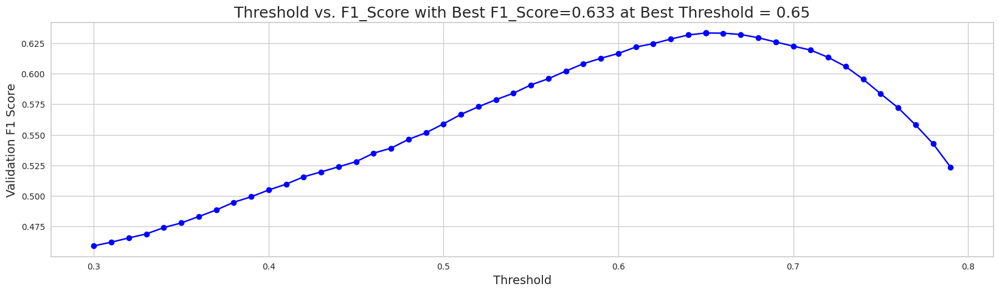

When using optimal threshold = 0.65...
Q0: F1 = 0.6331939666611275
==> Overall F1 = 0.6331939666611275
s
[I 2023-05-23 03:47:32,047] Trial 20 finished with value: 0.6331939666611275 and parameters: {'num_leaves': 95, 'learning_rate': 0.020927476718990933, 'feature_fraction': 0.4082251642885194, 'bagging_fraction': 0.5876816709274749, 'bagging_freq': 3, 'min_child_samples': 43, 'reg_alpha': 0.01031151162686558, 'reg_lambda': 0.027533104734372583, 'subsample': 0.8099800009407239, 'colsample_bytree': 0.29022850676188383, 'min_split_gain': 0.03850714126645449, 'max_depth': 7}. Best is trial 19 with value: 0.6340276046280243.


--------------------------------------------------
question14, with255features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.613011306390178, subsample=0.8952129258885777 will be ignored. Current value: bagging_fraction=0.613011306390178
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.4321211293762911, colsample_bytree=0.2216349660528662 will be ignored. Current value: feature_fraction=0.4321211293762911


[LightGBM] [Warning] bagging_fraction is set=0.3660123484048269, subsample=0.8693202868734751 will be ignored. Current value: bagging_fraction=0.3660123484048269
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=8, subsample_freq=0 will be ignored. Current value: bagging_freq=8
[LightGBM] [Warning] feature_fraction is set=0.9882696046711613, colsample_bytree=0.24211371478819177 will be ignored. Current value: feature_fraction=0.9882696046711613


[LightGBM] [Warning] bagging_fraction is set=0.46081985227259226, subsample=0.8809771958185001 will be ignored. Current value: bagging_fraction=0.46081985227259226
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.42782815202627045, colsample_bytree=0.24692196285007267 will be ignored. Current value: feature_fraction=0.42782815202627045


[LightGBM] [Warning] bagging_fraction is set=0.613011306390178, subsample=0.8952129258885777 will be ignored. Current value: bagging_fraction=0.613011306390178
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.4321211293762911, colsample_bytree=0.2216349660528662 will be ignored. Current value: feature_fraction=0.4321211293762911


[LightGBM] [Warning] bagging_fraction is set=0.46007788737730626, subsample=0.8758360099779511 will be ignored. Current value: bagging_fraction=0.46007788737730626
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.42694766435909437, colsample_bytree=0.22421881624025447 will be ignored. Current value: feature_fraction=0.42694766435909437


[LightGBM] [Warning] bagging_fraction is set=0.46081985227259226, subsample=0.8809771958185001 will be ignored. Current value: bagging_fraction=0.46081985227259226
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.42782815202627045, colsample_bytree=0.24692196285007267 will be ignored. Current value: feature_fraction=0.42782815202627045


[LightGBM] [Warning] bagging_fraction is set=0.613011306390178, subsample=0.8952129258885777 will be ignored. Current value: bagging_fraction=0.613011306390178
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.4321211293762911, colsample_bytree=0.2216349660528662 will be ignored. Current value: feature_fraction=0.4321211293762911


[LightGBM] [Warning] bagging_fraction is set=0.3660123484048269, subsample=0.8693202868734751 will be ignored. Current value: bagging_fraction=0.3660123484048269
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=8, subsample_freq=0 will be ignored. Current value: bagging_freq=8
[LightGBM] [Warning] feature_fraction is set=0.9882696046711613, colsample_bytree=0.24211371478819177 will be ignored. Current value: feature_fraction=0.9882696046711613


[LightGBM] [Warning] bagging_fraction is set=0.46081985227259226, subsample=0.8809771958185001 will be ignored. Current value: bagging_fraction=0.46081985227259226
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.42782815202627045, colsample_bytree=0.24692196285007267 will be ignored. Current value: feature_fraction=0.42782815202627045


[LightGBM] [Warning] bagging_fraction is set=0.613011306390178, subsample=0.8952129258885777 will be ignored. Current value: bagging_fraction=0.613011306390178
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.4321211293762911, colsample_bytree=0.2216349660528662 will be ignored. Current value: feature_fraction=0.4321211293762911


[LightGBM] [Warning] bagging_fraction is set=0.46007788737730626, subsample=0.8758360099779511 will be ignored. Current value: bagging_fraction=0.46007788737730626
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.42694766435909437, colsample_bytree=0.22421881624025447 will be ignored. Current value: feature_fraction=0.42694766435909437


[LightGBM] [Warning] bagging_fraction is set=0.613011306390178, subsample=0.8952129258885777 will be ignored. Current value: bagging_fraction=0.613011306390178
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.4321211293762911, colsample_bytree=0.2216349660528662 will be ignored. Current value: feature_fraction=0.4321211293762911


,mean
feature,
20_level_counts,136.4
session_id,118.0
hover_duration_mean,109.8
hover_duration_max,108.8
hover_duration_sum,101.6
18_level_counts,100.0
tunic.historicalsociety.frontdesk.archivist_glasses.confrontation_recap_text_fqid_counts,99.2
room_coor_y_min,95.0
elapsed_time_diff_sum,94.2


[[0.73113402 0.26886598]
 [0.22007137 0.77992863]
 [0.11437561 0.88562439]
 ...
 [0.1305291  0.8694709 ]
 [0.09734258 0.90265742]
 [0.14117685 0.85882315]]


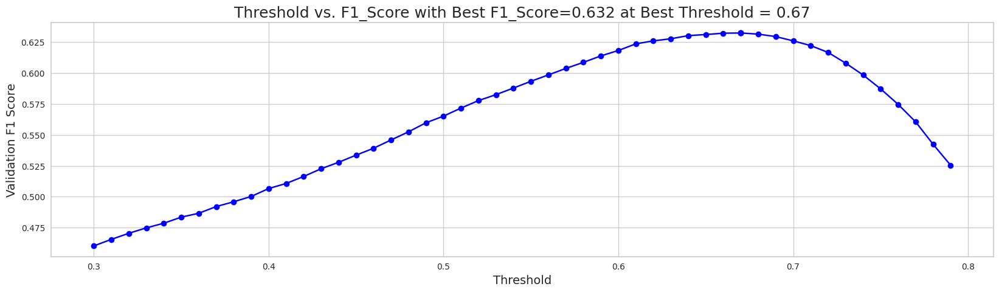

When using optimal threshold = 0.67...
Q0: F1 = 0.6323522087410582
==> Overall F1 = 0.6323522087410582
s
[I 2023-05-23 03:48:31,100] Trial 24 finished with value: 0.6323522087410582 and parameters: {'num_leaves': 91, 'learning_rate': 0.021272403097087254, 'feature_fraction': 0.42782815202627045, 'bagging_fraction': 0.46081985227259226, 'bagging_freq': 3, 'min_child_samples': 66, 'reg_alpha': 0.01650534341841026, 'reg_lambda': 0.02194948112562226, 'subsample': 0.8809771958185001, 'colsample_bytree': 0.24692196285007267, 'min_split_gain': 0.07582657218918261, 'max_depth': 6}. Best is trial 19 with value: 0.6340276046280243.


--------------------------------------------------
question14, with255features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.6804644544415865, subsample=0.7384918705066399 will be ignored. Current value: bagging_fraction=0.6804644544415865
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.6201407062566044, colsample_bytree=0.20625835418627173 will be ignored. Current value: feature_fraction=0.6201407062566044


,mean
feature,
20_level_counts,200.2
session_id,194.0
room_coor_y_max,163.6
room_coor_x_max,159.8
hover_duration_mean,158.4
hover_duration_max,157.6
screen_coor_x_mean,157.4
room_coor_x_min,149.8
screen_coor_x_std,149.6


[[0.83380392 0.16619608]
 [0.20347214 0.79652786]
 [0.12230685 0.87769315]
 ...
 [0.09887693 0.90112307]
 [0.09159222 0.90840778]
 [0.14060173 0.85939827]]


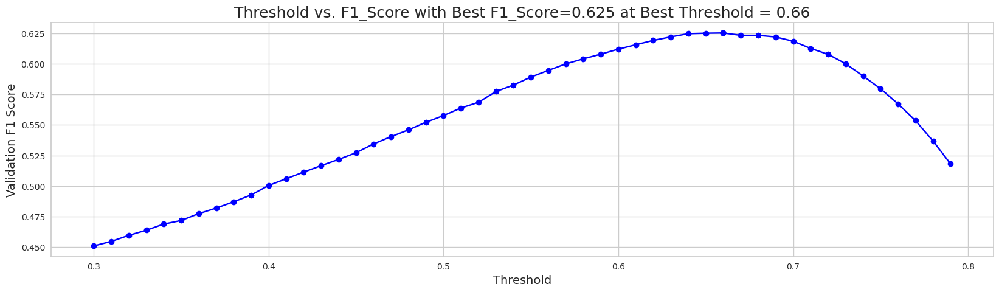

When using optimal threshold = 0.66...
Q0: F1 = 0.6251518021235616
==> Overall F1 = 0.6251518021235616
s
[I 2023-05-23 03:48:41,296] Trial 22 finished with value: 0.6251518021235616 and parameters: {'num_leaves': 97, 'learning_rate': 0.017596900732232596, 'feature_fraction': 0.9882696046711613, 'bagging_fraction': 0.3660123484048269, 'bagging_freq': 8, 'min_child_samples': 44, 'reg_alpha': 0.015361645048720196, 'reg_lambda': 0.030892380044467045, 'subsample': 0.8693202868734751, 'colsample_bytree': 0.24211371478819177, 'min_split_gain': 0.03637726922578968, 'max_depth': 8}. Best is trial 19 with value: 0.6340276046280243.


--------------------------------------------------
question14, with255features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.5991908491426209, subsample=0.7547537501272423 will be ignored. Current value: bagging_fraction=0.5991908491426209
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.5982894663213765, colsample_bytree=0.19936115426108592 will be ignored. Current value: feature_fraction=0.5982894663213765


,mean
feature,
20_level_counts,78.4
session_id,66.4
room_coor_y_max,56.6
hover_duration_max,55.0
tracks_fqid_counts,54.8
room_coor_y_mean,54.0
room_coor_y_std,53.8
tunic.flaghouse.entry_room_fqid_counts,53.6
room_coor_x_min,52.8


[[0.77916617 0.22083383]
 [0.25183479 0.74816521]
 [0.13007587 0.86992413]
 ...
 [0.11657491 0.88342509]
 [0.1057513  0.8942487 ]
 [0.17106945 0.82893055]]


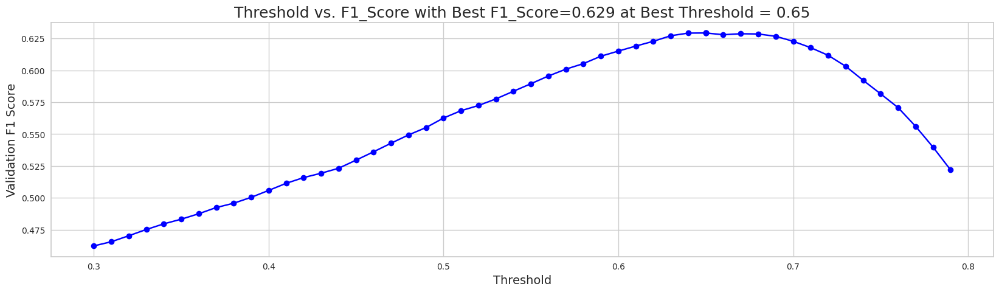

When using optimal threshold = 0.65...
Q0: F1 = 0.6292133652686387
==> Overall F1 = 0.6292133652686387
s
[I 2023-05-23 03:48:46,845] Trial 26 finished with value: 0.6292133652686387 and parameters: {'num_leaves': 90, 'learning_rate': 0.04288979298469198, 'feature_fraction': 0.4321211293762911, 'bagging_fraction': 0.613011306390178, 'bagging_freq': 2, 'min_child_samples': 31, 'reg_alpha': 0.01249675260077366, 'reg_lambda': 0.019244460196276007, 'subsample': 0.8952129258885777, 'colsample_bytree': 0.2216349660528662, 'min_split_gain': 0.02562092976192861, 'max_depth': 6}. Best is trial 19 with value: 0.6340276046280243.


--------------------------------------------------
question14, with255features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.6884292145809774, subsample=0.748310084721715 will be ignored. Current value: bagging_fraction=0.6884292145809774
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.6048697023092893, colsample_bytree=0.19756042453305772 will be ignored. Current value: feature_fraction=0.6048697023092893


[LightGBM] [Warning] bagging_fraction is set=0.6804644544415865, subsample=0.7384918705066399 will be ignored. Current value: bagging_fraction=0.6804644544415865
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.6201407062566044, colsample_bytree=0.20625835418627173 will be ignored. Current value: feature_fraction=0.6201407062566044


[LightGBM] [Warning] bagging_fraction is set=0.46007788737730626, subsample=0.8758360099779511 will be ignored. Current value: bagging_fraction=0.46007788737730626
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.42694766435909437, colsample_bytree=0.22421881624025447 will be ignored. Current value: feature_fraction=0.42694766435909437


[LightGBM] [Warning] bagging_fraction is set=0.5991908491426209, subsample=0.7547537501272423 will be ignored. Current value: bagging_fraction=0.5991908491426209
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.5982894663213765, colsample_bytree=0.19936115426108592 will be ignored. Current value: feature_fraction=0.5982894663213765


[LightGBM] [Warning] bagging_fraction is set=0.6804644544415865, subsample=0.7384918705066399 will be ignored. Current value: bagging_fraction=0.6804644544415865
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.6201407062566044, colsample_bytree=0.20625835418627173 will be ignored. Current value: feature_fraction=0.6201407062566044


[LightGBM] [Warning] bagging_fraction is set=0.5991908491426209, subsample=0.7547537501272423 will be ignored. Current value: bagging_fraction=0.5991908491426209
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.5982894663213765, colsample_bytree=0.19936115426108592 will be ignored. Current value: feature_fraction=0.5982894663213765


[LightGBM] [Warning] bagging_fraction is set=0.5991908491426209, subsample=0.7547537501272423 will be ignored. Current value: bagging_fraction=0.5991908491426209
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.5982894663213765, colsample_bytree=0.19936115426108592 will be ignored. Current value: feature_fraction=0.5982894663213765
[LightGBM] [Warning] bagging_fraction is set=0.6804644544415865, subsample=0.7384918705066399 will be ignored. Current value: bagging_fraction=0.6804644544415865
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] f

[LightGBM] [Warning] bagging_fraction is set=0.46007788737730626, subsample=0.8758360099779511 will be ignored. Current value: bagging_fraction=0.46007788737730626
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.42694766435909437, colsample_bytree=0.22421881624025447 will be ignored. Current value: feature_fraction=0.42694766435909437


[LightGBM] [Warning] bagging_fraction is set=0.6884292145809774, subsample=0.748310084721715 will be ignored. Current value: bagging_fraction=0.6884292145809774
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.6048697023092893, colsample_bytree=0.19756042453305772 will be ignored. Current value: feature_fraction=0.6048697023092893


[LightGBM] [Warning] bagging_fraction is set=0.5991908491426209, subsample=0.7547537501272423 will be ignored. Current value: bagging_fraction=0.5991908491426209
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.5982894663213765, colsample_bytree=0.19936115426108592 will be ignored. Current value: feature_fraction=0.5982894663213765


[LightGBM] [Warning] bagging_fraction is set=0.6804644544415865, subsample=0.7384918705066399 will be ignored. Current value: bagging_fraction=0.6804644544415865
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.6201407062566044, colsample_bytree=0.20625835418627173 will be ignored. Current value: feature_fraction=0.6201407062566044


,mean
feature,
20_level_counts,79.8
session_id,61.6
tunic.historicalsociety.frontdesk.archivist_glasses.confrontation_recap_text_fqid_counts,58.0
tracks_fqid_counts,56.2
hover_duration_std,55.6
hover_duration_sum,50.4
room_coor_y_max,50.2
15_level_counts,49.0
18_level_counts,49.0


[[0.84351713 0.15648287]
 [0.2978533  0.7021467 ]
 [0.15600886 0.84399114]
 ...
 [0.11736109 0.88263891]
 [0.10103877 0.89896123]
 [0.12692925 0.87307075]]


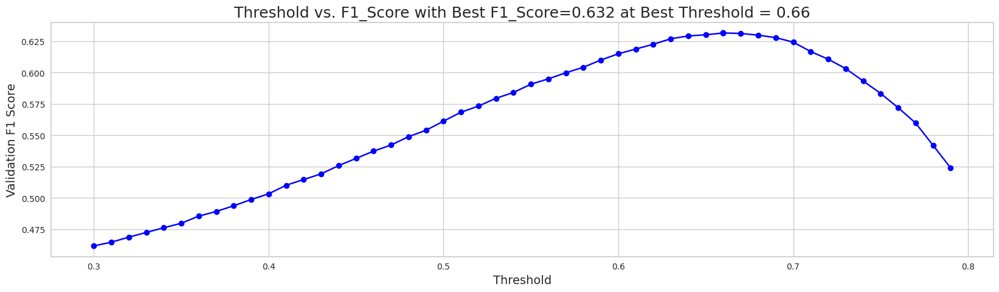

When using optimal threshold = 0.66...
Q0: F1 = 0.6316307737380217
==> Overall F1 = 0.6316307737380217
s
[I 2023-05-23 03:49:53,330] Trial 28 finished with value: 0.6316307737380217 and parameters: {'num_leaves': 86, 'learning_rate': 0.042698438493705394, 'feature_fraction': 0.5982894663213765, 'bagging_fraction': 0.5991908491426209, 'bagging_freq': 2, 'min_child_samples': 33, 'reg_alpha': 0.00198260567604226, 'reg_lambda': 0.09780576012259028, 'subsample': 0.7547537501272423, 'colsample_bytree': 0.19936115426108592, 'min_split_gain': 0.030644264001040106, 'max_depth': 6}. Best is trial 19 with value: 0.6340276046280243.


--------------------------------------------------
question14, with255features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.6827799620233173, subsample=0.6896174569642297 will be ignored. Current value: bagging_fraction=0.6827799620233173
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
[LightGBM] [Warning] feature_fraction is set=0.36306203825562205, colsample_bytree=0.3222029740001978 will be ignored. Current value: feature_fraction=0.36306203825562205


,mean
feature,
20_level_counts,115.2
session_id,114.6
room_coor_x_max,106.8
hover_duration_std,104.0
room_coor_y_std,103.4
room_coor_y_max,102.0
hover_duration_max,96.4
room_coor_x_min,96.2
room_coor_x_std,95.6


[[0.76189623 0.23810377]
 [0.23182861 0.76817139]
 [0.12534092 0.87465908]
 ...
 [0.12610954 0.87389046]
 [0.07944364 0.92055636]
 [0.18864972 0.81135028]]


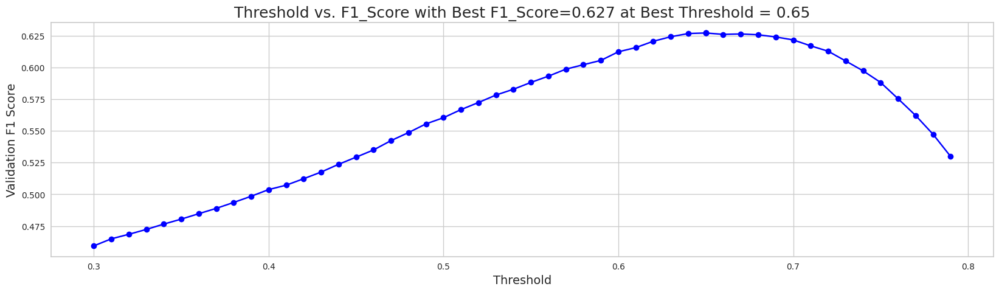

When using optimal threshold = 0.65...
Q0: F1 = 0.6272280722045002
==> Overall F1 = 0.6272280722045002
s
[I 2023-05-23 03:49:59,533] Trial 27 finished with value: 0.6272280722045002 and parameters: {'num_leaves': 100, 'learning_rate': 0.04563645454868408, 'feature_fraction': 0.6201407062566044, 'bagging_fraction': 0.6804644544415865, 'bagging_freq': 2, 'min_child_samples': 31, 'reg_alpha': 0.002931758359068498, 'reg_lambda': 0.0977724575148936, 'subsample': 0.7384918705066399, 'colsample_bytree': 0.20625835418627173, 'min_split_gain': 0.027462208677594944, 'max_depth': 9}. Best is trial 19 with value: 0.6340276046280243.


--------------------------------------------------
question14, with255features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.5196393816198767, subsample=0.6766352642236735 will be ignored. Current value: bagging_fraction=0.5196393816198767
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
[LightGBM] [Warning] feature_fraction is set=0.35826828468696115, colsample_bytree=0.1091663019228811 will be ignored. Current value: feature_fraction=0.35826828468696115


,mean
feature,
hover_duration_max,236.8
hover_duration_std,224.8
20_level_counts,218.2
session_id,211.2
hover_duration_mean,210.2
hover_duration_sum,190.2
screen_coor_y_mean,188.4
15_level_counts,183.2
17_level_counts,182.0


[[0.8064756  0.1935244 ]
 [0.2644584  0.7355416 ]
 [0.14215161 0.85784839]
 ...
 [0.11142925 0.88857075]
 [0.07264414 0.92735586]
 [0.19287899 0.80712101]]


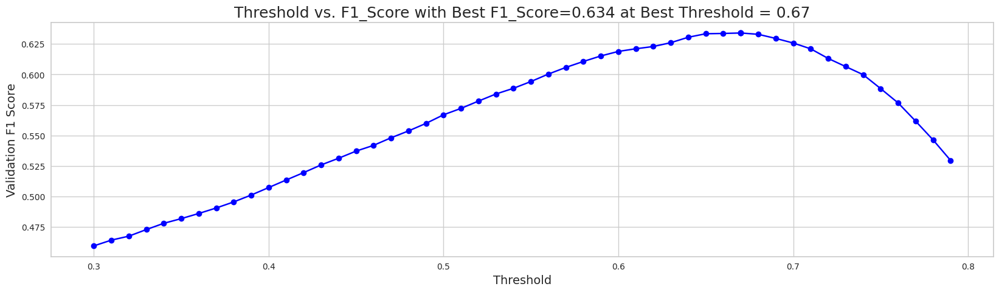

When using optimal threshold = 0.67...
Q0: F1 = 0.6340374265066029
==> Overall F1 = 0.6340374265066029
s
[I 2023-05-23 03:50:12,310] Trial 25 finished with value: 0.6340374265066029 and parameters: {'num_leaves': 46, 'learning_rate': 0.015635707689529516, 'feature_fraction': 0.42694766435909437, 'bagging_fraction': 0.46007788737730626, 'bagging_freq': 2, 'min_child_samples': 47, 'reg_alpha': 0.014037335411660374, 'reg_lambda': 0.01859430918957894, 'subsample': 0.8758360099779511, 'colsample_bytree': 0.22421881624025447, 'min_split_gain': 0.0708476471095951, 'max_depth': 8}. Best is trial 25 with value: 0.6340374265066029.


--------------------------------------------------
question14, with255features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.5331212276958248, subsample=0.9124643064517018 will be ignored. Current value: bagging_fraction=0.5331212276958248
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
[LightGBM] [Warning] feature_fraction is set=0.8769428282537142, colsample_bytree=0.3826688729722611 will be ignored. Current value: feature_fraction=0.8769428282537142
[LightGBM] [Warning] bagging_fraction is set=0.6884292145809774, subsample=0.748310084721715 will be ignored. Current value: bagging_fraction=0.6884292145809774
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] fea

[LightGBM] [Warning] bagging_fraction is set=0.5196393816198767, subsample=0.6766352642236735 will be ignored. Current value: bagging_fraction=0.5196393816198767
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
[LightGBM] [Warning] feature_fraction is set=0.35826828468696115, colsample_bytree=0.1091663019228811 will be ignored. Current value: feature_fraction=0.35826828468696115


[LightGBM] [Warning] bagging_fraction is set=0.6827799620233173, subsample=0.6896174569642297 will be ignored. Current value: bagging_fraction=0.6827799620233173
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
[LightGBM] [Warning] feature_fraction is set=0.36306203825562205, colsample_bytree=0.3222029740001978 will be ignored. Current value: feature_fraction=0.36306203825562205


[LightGBM] [Warning] bagging_fraction is set=0.5196393816198767, subsample=0.6766352642236735 will be ignored. Current value: bagging_fraction=0.5196393816198767
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
[LightGBM] [Warning] feature_fraction is set=0.35826828468696115, colsample_bytree=0.1091663019228811 will be ignored. Current value: feature_fraction=0.35826828468696115


[LightGBM] [Warning] bagging_fraction is set=0.5331212276958248, subsample=0.9124643064517018 will be ignored. Current value: bagging_fraction=0.5331212276958248
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
[LightGBM] [Warning] feature_fraction is set=0.8769428282537142, colsample_bytree=0.3826688729722611 will be ignored. Current value: feature_fraction=0.8769428282537142


[LightGBM] [Warning] bagging_fraction is set=0.5196393816198767, subsample=0.6766352642236735 will be ignored. Current value: bagging_fraction=0.5196393816198767
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
[LightGBM] [Warning] feature_fraction is set=0.35826828468696115, colsample_bytree=0.1091663019228811 will be ignored. Current value: feature_fraction=0.35826828468696115


[LightGBM] [Warning] bagging_fraction is set=0.5331212276958248, subsample=0.9124643064517018 will be ignored. Current value: bagging_fraction=0.5331212276958248
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
[LightGBM] [Warning] feature_fraction is set=0.8769428282537142, colsample_bytree=0.3826688729722611 will be ignored. Current value: feature_fraction=0.8769428282537142


[LightGBM] [Warning] bagging_fraction is set=0.6884292145809774, subsample=0.748310084721715 will be ignored. Current value: bagging_fraction=0.6884292145809774
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.6048697023092893, colsample_bytree=0.19756042453305772 will be ignored. Current value: feature_fraction=0.6048697023092893


[LightGBM] [Warning] bagging_fraction is set=0.5196393816198767, subsample=0.6766352642236735 will be ignored. Current value: bagging_fraction=0.5196393816198767
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
[LightGBM] [Warning] feature_fraction is set=0.35826828468696115, colsample_bytree=0.1091663019228811 will be ignored. Current value: feature_fraction=0.35826828468696115


[LightGBM] [Warning] bagging_fraction is set=0.6827799620233173, subsample=0.6896174569642297 will be ignored. Current value: bagging_fraction=0.6827799620233173
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
[LightGBM] [Warning] feature_fraction is set=0.36306203825562205, colsample_bytree=0.3222029740001978 will be ignored. Current value: feature_fraction=0.36306203825562205


[LightGBM] [Warning] bagging_fraction is set=0.5331212276958248, subsample=0.9124643064517018 will be ignored. Current value: bagging_fraction=0.5331212276958248
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
[LightGBM] [Warning] feature_fraction is set=0.8769428282537142, colsample_bytree=0.3826688729722611 will be ignored. Current value: feature_fraction=0.8769428282537142


,mean
feature,
20_level_counts,148.4
tunic.historicalsociety.frontdesk.archivist_glasses.confrontation_recap_text_fqid_counts,130.4
tracks_fqid_counts,101.4
session_id,97.8
hover_duration_max,90.8
17_level_counts,88.0
tunic.historicalsociety.entry.directory.closeup.archivist_text_fqid_counts,87.2
18_level_counts,87.0
15_level_counts,85.6


[[0.80299339 0.19700661]
 [0.21142259 0.78857741]
 [0.12444114 0.87555886]
 ...
 [0.11437914 0.88562086]
 [0.09639121 0.90360879]
 [0.18220327 0.81779673]]


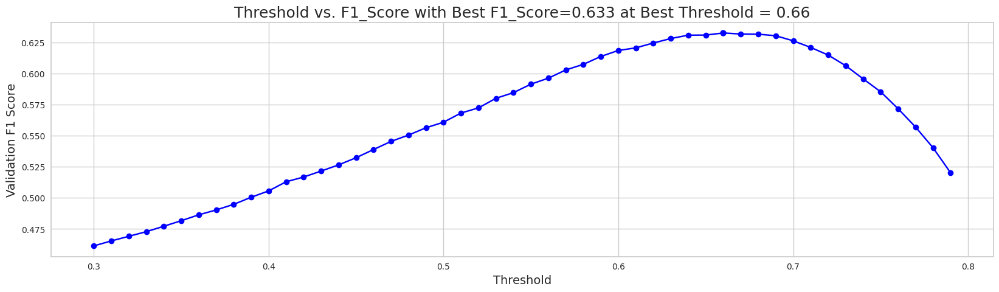

When using optimal threshold = 0.66...
Q0: F1 = 0.6325875566588957
==> Overall F1 = 0.6325875566588957
s
[I 2023-05-23 03:51:32,850] Trial 31 finished with value: 0.6325875566588957 and parameters: {'num_leaves': 72, 'learning_rate': 0.01429543839759893, 'feature_fraction': 0.35826828468696115, 'bagging_fraction': 0.5196393816198767, 'bagging_freq': 4, 'min_child_samples': 52, 'reg_alpha': 0.002483850113088565, 'reg_lambda': 0.013938840222688247, 'subsample': 0.6766352642236735, 'colsample_bytree': 0.1091663019228811, 'min_split_gain': 0.07807470523475844, 'max_depth': 4}. Best is trial 25 with value: 0.6340374265066029.


--------------------------------------------------
question14, with255features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.42839513943016044, subsample=0.9401792854104922 will be ignored. Current value: bagging_fraction=0.42839513943016044
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8382439354136311, colsample_bytree=0.34653128049548454 will be ignored. Current value: feature_fraction=0.8382439354136311


[LightGBM] [Warning] bagging_fraction is set=0.5331212276958248, subsample=0.9124643064517018 will be ignored. Current value: bagging_fraction=0.5331212276958248
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
[LightGBM] [Warning] feature_fraction is set=0.8769428282537142, colsample_bytree=0.3826688729722611 will be ignored. Current value: feature_fraction=0.8769428282537142


[LightGBM] [Warning] bagging_fraction is set=0.6884292145809774, subsample=0.748310084721715 will be ignored. Current value: bagging_fraction=0.6884292145809774
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.6048697023092893, colsample_bytree=0.19756042453305772 will be ignored. Current value: feature_fraction=0.6048697023092893


[LightGBM] [Warning] bagging_fraction is set=0.6827799620233173, subsample=0.6896174569642297 will be ignored. Current value: bagging_fraction=0.6827799620233173
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
[LightGBM] [Warning] feature_fraction is set=0.36306203825562205, colsample_bytree=0.3222029740001978 will be ignored. Current value: feature_fraction=0.36306203825562205


,mean
feature,
20_level_counts,167.4
tunic.historicalsociety.frontdesk.archivist_glasses.confrontation_recap_text_fqid_counts,160.8
tracks_fqid_counts,120.0
session_id,107.8
tunic.historicalsociety.entry.directory.closeup.archivist_text_fqid_counts,98.4
savedteddy_fqid_counts,90.6
17_level_counts,84.8
15_level_counts,80.6
tunic.flaghouse.entry_room_fqid_counts,76.6


[[0.81844918 0.18155082]
 [0.2099613  0.7900387 ]
 [0.13583207 0.86416793]
 ...
 [0.10963218 0.89036782]
 [0.10117924 0.89882076]
 [0.1735447  0.8264553 ]]


[LightGBM] [Warning] bagging_fraction is set=0.42839513943016044, subsample=0.9401792854104922 will be ignored. Current value: bagging_fraction=0.42839513943016044
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8382439354136311, colsample_bytree=0.34653128049548454 will be ignored. Current value: feature_fraction=0.8382439354136311


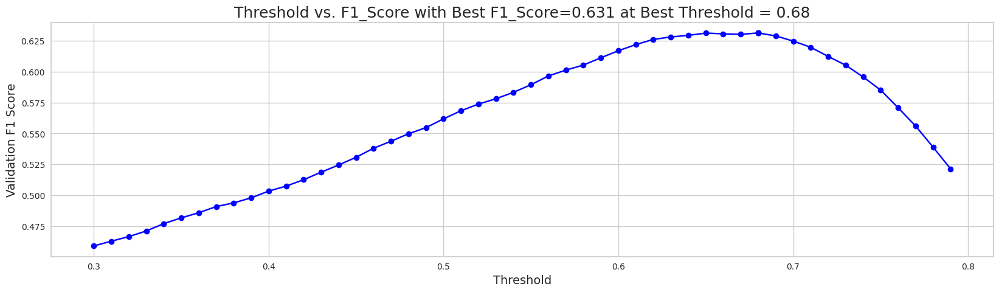

When using optimal threshold = 0.68...
Q0: F1 = 0.6311114753635727
==> Overall F1 = 0.6311114753635727
s
[I 2023-05-23 03:52:03,600] Trial 32 finished with value: 0.6311114753635727 and parameters: {'num_leaves': 50, 'learning_rate': 0.013941640621970916, 'feature_fraction': 0.8769428282537142, 'bagging_fraction': 0.5331212276958248, 'bagging_freq': 4, 'min_child_samples': 52, 'reg_alpha': 0.0024302683523286356, 'reg_lambda': 0.05760035618073308, 'subsample': 0.9124643064517018, 'colsample_bytree': 0.3826688729722611, 'min_split_gain': 0.17944424933025285, 'max_depth': 4}. Best is trial 25 with value: 0.6340374265066029.


--------------------------------------------------
question14, with255features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.6819311220761114, subsample=0.8026365227755325 will be ignored. Current value: bagging_fraction=0.6819311220761114
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.4856372079599772, colsample_bytree=0.31051023055247995 will be ignored. Current value: feature_fraction=0.4856372079599772


[LightGBM] [Warning] bagging_fraction is set=0.42839513943016044, subsample=0.9401792854104922 will be ignored. Current value: bagging_fraction=0.42839513943016044
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8382439354136311, colsample_bytree=0.34653128049548454 will be ignored. Current value: feature_fraction=0.8382439354136311


[LightGBM] [Warning] bagging_fraction is set=0.6819311220761114, subsample=0.8026365227755325 will be ignored. Current value: bagging_fraction=0.6819311220761114
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.4856372079599772, colsample_bytree=0.31051023055247995 will be ignored. Current value: feature_fraction=0.4856372079599772


,mean
feature,
20_level_counts,358.2
session_id,352.2
hover_duration_mean,322.0
hover_duration_max,317.4
hover_duration_std,305.8
hover_duration_sum,298.4
room_coor_x_max,285.4
room_coor_y_max,279.4
17_level_counts,279.0


[[0.78729487 0.21270513]
 [0.22096412 0.77903588]
 [0.12509211 0.87490789]
 ...
 [0.12634285 0.87365715]
 [0.09472377 0.90527623]
 [0.20348005 0.79651995]]


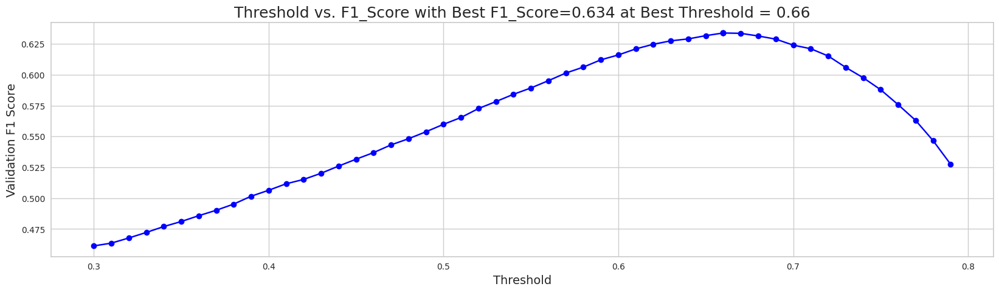

When using optimal threshold = 0.66...
Q0: F1 = 0.6338855332755928
==> Overall F1 = 0.6338855332755928
s
[I 2023-05-23 03:52:34,872] Trial 29 finished with value: 0.6338855332755928 and parameters: {'num_leaves': 86, 'learning_rate': 0.014588709219477533, 'feature_fraction': 0.6048697023092893, 'bagging_fraction': 0.6884292145809774, 'bagging_freq': 2, 'min_child_samples': 51, 'reg_alpha': 0.002280748162787115, 'reg_lambda': 0.06746319869669347, 'subsample': 0.748310084721715, 'colsample_bytree': 0.19756042453305772, 'min_split_gain': 0.1627884279719426, 'max_depth': 9}. Best is trial 25 with value: 0.6340374265066029.


--------------------------------------------------
question14, with255features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.6839654484457388, subsample=0.7862029515278087 will be ignored. Current value: bagging_fraction=0.6839654484457388
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.48466631973849184, colsample_bytree=0.1763762751510988 will be ignored. Current value: feature_fraction=0.48466631973849184


[LightGBM] [Warning] bagging_fraction is set=0.6827799620233173, subsample=0.6896174569642297 will be ignored. Current value: bagging_fraction=0.6827799620233173
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
[LightGBM] [Warning] feature_fraction is set=0.36306203825562205, colsample_bytree=0.3222029740001978 will be ignored. Current value: feature_fraction=0.36306203825562205


[LightGBM] [Warning] bagging_fraction is set=0.6819311220761114, subsample=0.8026365227755325 will be ignored. Current value: bagging_fraction=0.6819311220761114
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.4856372079599772, colsample_bytree=0.31051023055247995 will be ignored. Current value: feature_fraction=0.4856372079599772


[LightGBM] [Warning] bagging_fraction is set=0.42839513943016044, subsample=0.9401792854104922 will be ignored. Current value: bagging_fraction=0.42839513943016044
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8382439354136311, colsample_bytree=0.34653128049548454 will be ignored. Current value: feature_fraction=0.8382439354136311


[LightGBM] [Warning] bagging_fraction is set=0.42839513943016044, subsample=0.9401792854104922 will be ignored. Current value: bagging_fraction=0.42839513943016044
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8382439354136311, colsample_bytree=0.34653128049548454 will be ignored. Current value: feature_fraction=0.8382439354136311


[LightGBM] [Warning] bagging_fraction is set=0.6819311220761114, subsample=0.8026365227755325 will be ignored. Current value: bagging_fraction=0.6819311220761114
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.4856372079599772, colsample_bytree=0.31051023055247995 will be ignored. Current value: feature_fraction=0.4856372079599772


,mean
feature,
hover_duration_max,336.2
hover_duration_mean,316.8
session_id,315.4
hover_duration_std,297.8
20_level_counts,286.0
elapsed_time_diff_std,270.4
hover_duration_sum,265.6
17_level_counts,264.4
elapsed_time_diff_sum,254.4


[[0.81879372 0.18120628]
 [0.19681816 0.80318184]
 [0.12538754 0.87461246]
 ...
 [0.15608266 0.84391734]
 [0.10620695 0.89379305]
 [0.19364755 0.80635245]]


[LightGBM] [Warning] bagging_fraction is set=0.6839654484457388, subsample=0.7862029515278087 will be ignored. Current value: bagging_fraction=0.6839654484457388
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.48466631973849184, colsample_bytree=0.1763762751510988 will be ignored. Current value: feature_fraction=0.48466631973849184


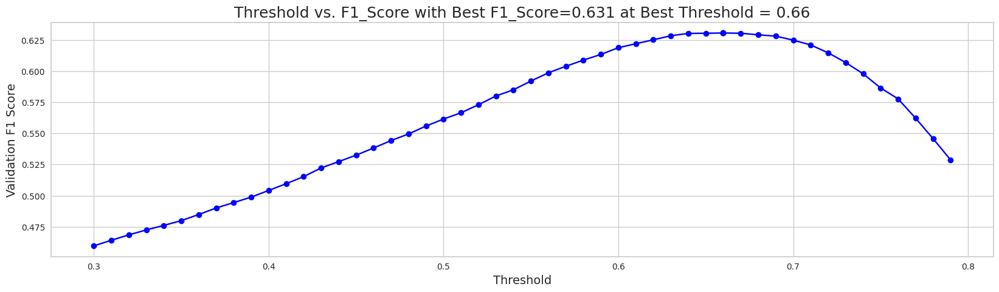

When using optimal threshold = 0.66...
Q0: F1 = 0.6305752087176082
==> Overall F1 = 0.6305752087176082
s
[I 2023-05-23 03:53:18,495] Trial 30 finished with value: 0.6305752087176082 and parameters: {'num_leaves': 71, 'learning_rate': 0.014581567570148682, 'feature_fraction': 0.36306203825562205, 'bagging_fraction': 0.6827799620233173, 'bagging_freq': 4, 'min_child_samples': 54, 'reg_alpha': 0.002639720582219507, 'reg_lambda': 0.07857113792196682, 'subsample': 0.6896174569642297, 'colsample_bytree': 0.3222029740001978, 'min_split_gain': 0.07746724864838167, 'max_depth': 9}. Best is trial 25 with value: 0.6340374265066029.


--------------------------------------------------
question14, with255features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.47620998588102303, subsample=0.930905311124226 will be ignored. Current value: bagging_fraction=0.47620998588102303
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.496844342733813, colsample_bytree=0.1959696389578265 will be ignored. Current value: feature_fraction=0.496844342733813


[LightGBM] [Warning] bagging_fraction is set=0.6819311220761114, subsample=0.8026365227755325 will be ignored. Current value: bagging_fraction=0.6819311220761114
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.4856372079599772, colsample_bytree=0.31051023055247995 will be ignored. Current value: feature_fraction=0.4856372079599772


,mean
feature,
20_level_counts,259.2
session_id,229.2
hover_duration_max,200.2
hover_duration_mean,195.0
hover_duration_sum,187.4
hover_duration_std,182.6
room_coor_y_min,175.4
room_coor_y_max,175.2
room_coor_x_max,174.6


[[0.80607638 0.19392362]
 [0.21264197 0.78735803]
 [0.11221543 0.88778457]
 ...
 [0.14130798 0.85869202]
 [0.09702186 0.90297814]
 [0.18153978 0.81846022]]


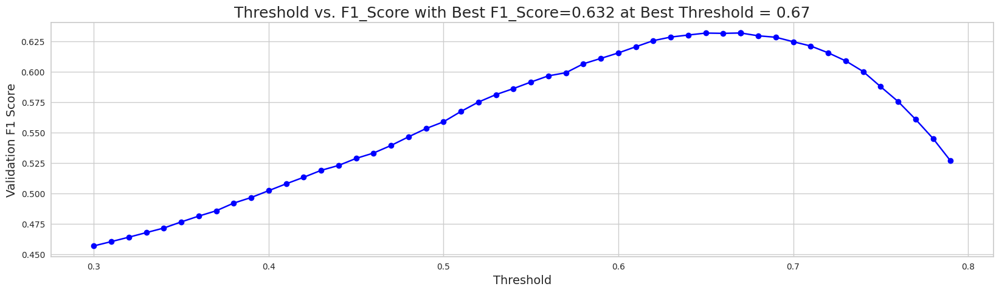

When using optimal threshold = 0.67...
Q0: F1 = 0.6318238276053271
==> Overall F1 = 0.6318238276053271
s
[I 2023-05-23 03:53:38,288] Trial 33 finished with value: 0.6318238276053271 and parameters: {'num_leaves': 46, 'learning_rate': 0.013742491244012936, 'feature_fraction': 0.8382439354136311, 'bagging_fraction': 0.42839513943016044, 'bagging_freq': 2, 'min_child_samples': 60, 'reg_alpha': 0.12026128054124616, 'reg_lambda': 0.06482718678436805, 'subsample': 0.9401792854104922, 'colsample_bytree': 0.34653128049548454, 'min_split_gain': 0.1560129510003386, 'max_depth': 9}. Best is trial 25 with value: 0.6340374265066029.


--------------------------------------------------
question14, with255features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.5016732414244239, subsample=0.7722642778766303 will be ignored. Current value: bagging_fraction=0.5016732414244239
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.49208336032900346, colsample_bytree=0.17680494111887002 will be ignored. Current value: feature_fraction=0.49208336032900346


[LightGBM] [Warning] bagging_fraction is set=0.47620998588102303, subsample=0.930905311124226 will be ignored. Current value: bagging_fraction=0.47620998588102303
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.496844342733813, colsample_bytree=0.1959696389578265 will be ignored. Current value: feature_fraction=0.496844342733813


,mean
feature,
20_level_counts,136.8
session_id,118.8
tunic.historicalsociety.frontdesk.archivist_glasses.confrontation_recap_text_fqid_counts,101.2
hover_duration_sum,97.0
hover_duration_std,94.0
18_level_counts,89.0
tracks_fqid_counts,88.0
15_level_counts,88.0
room_coor_x_max,88.0


[[0.79411256 0.20588744]
 [0.22427004 0.77572996]
 [0.12383498 0.87616502]
 ...
 [0.13519707 0.86480293]
 [0.09624693 0.90375307]
 [0.16638035 0.83361965]]


[LightGBM] [Warning] bagging_fraction is set=0.6839654484457388, subsample=0.7862029515278087 will be ignored. Current value: bagging_fraction=0.6839654484457388
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.48466631973849184, colsample_bytree=0.1763762751510988 will be ignored. Current value: feature_fraction=0.48466631973849184


[LightGBM] [Warning] bagging_fraction is set=0.5016732414244239, subsample=0.7722642778766303 will be ignored. Current value: bagging_fraction=0.5016732414244239
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.49208336032900346, colsample_bytree=0.17680494111887002 will be ignored. Current value: feature_fraction=0.49208336032900346


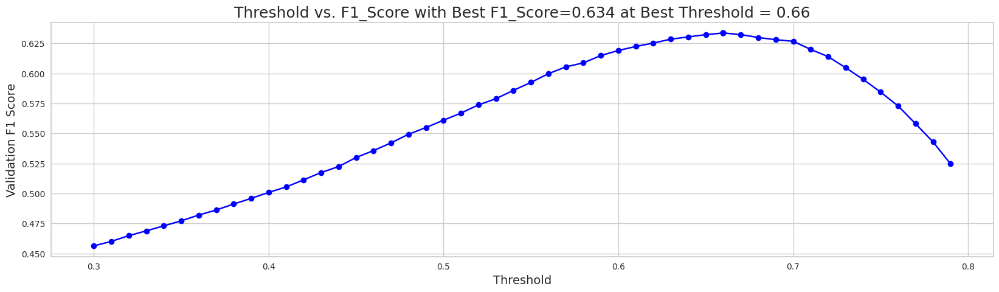

When using optimal threshold = 0.66...
Q0: F1 = 0.6336625029393752
==> Overall F1 = 0.6336625029393752
s
[I 2023-05-23 03:53:58,634] Trial 34 finished with value: 0.6336625029393752 and parameters: {'num_leaves': 45, 'learning_rate': 0.026169771405945657, 'feature_fraction': 0.4856372079599772, 'bagging_fraction': 0.6819311220761114, 'bagging_freq': 3, 'min_child_samples': 59, 'reg_alpha': 0.011904975165076123, 'reg_lambda': 0.016059692106169393, 'subsample': 0.8026365227755325, 'colsample_bytree': 0.31051023055247995, 'min_split_gain': 0.0538289076572012, 'max_depth': 9}. Best is trial 25 with value: 0.6340374265066029.


--------------------------------------------------
question14, with255features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.7151686589770662, subsample=0.77722791112775 will be ignored. Current value: bagging_fraction=0.7151686589770662
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.4792375083932008, colsample_bytree=0.17852416258777448 will be ignored. Current value: feature_fraction=0.4792375083932008


[LightGBM] [Warning] bagging_fraction is set=0.47620998588102303, subsample=0.930905311124226 will be ignored. Current value: bagging_fraction=0.47620998588102303
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.496844342733813, colsample_bytree=0.1959696389578265 will be ignored. Current value: feature_fraction=0.496844342733813


[LightGBM] [Warning] bagging_fraction is set=0.5016732414244239, subsample=0.7722642778766303 will be ignored. Current value: bagging_fraction=0.5016732414244239
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.49208336032900346, colsample_bytree=0.17680494111887002 will be ignored. Current value: feature_fraction=0.49208336032900346


[LightGBM] [Warning] bagging_fraction is set=0.7151686589770662, subsample=0.77722791112775 will be ignored. Current value: bagging_fraction=0.7151686589770662
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.4792375083932008, colsample_bytree=0.17852416258777448 will be ignored. Current value: feature_fraction=0.4792375083932008


[LightGBM] [Warning] bagging_fraction is set=0.47620998588102303, subsample=0.930905311124226 will be ignored. Current value: bagging_fraction=0.47620998588102303
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.496844342733813, colsample_bytree=0.1959696389578265 will be ignored. Current value: feature_fraction=0.496844342733813


[LightGBM] [Warning] bagging_fraction is set=0.5016732414244239, subsample=0.7722642778766303 will be ignored. Current value: bagging_fraction=0.5016732414244239
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.49208336032900346, colsample_bytree=0.17680494111887002 will be ignored. Current value: feature_fraction=0.49208336032900346


[LightGBM] [Warning] bagging_fraction is set=0.7151686589770662, subsample=0.77722791112775 will be ignored. Current value: bagging_fraction=0.7151686589770662
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.4792375083932008, colsample_bytree=0.17852416258777448 will be ignored. Current value: feature_fraction=0.4792375083932008


[LightGBM] [Warning] bagging_fraction is set=0.5016732414244239, subsample=0.7722642778766303 will be ignored. Current value: bagging_fraction=0.5016732414244239
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.49208336032900346, colsample_bytree=0.17680494111887002 will be ignored. Current value: feature_fraction=0.49208336032900346


[LightGBM] [Warning] bagging_fraction is set=0.6839654484457388, subsample=0.7862029515278087 will be ignored. Current value: bagging_fraction=0.6839654484457388
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.48466631973849184, colsample_bytree=0.1763762751510988 will be ignored. Current value: feature_fraction=0.48466631973849184


[LightGBM] [Warning] bagging_fraction is set=0.47620998588102303, subsample=0.930905311124226 will be ignored. Current value: bagging_fraction=0.47620998588102303
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.496844342733813, colsample_bytree=0.1959696389578265 will be ignored. Current value: feature_fraction=0.496844342733813


,mean
feature,
20_level_counts,126.2
session_id,118.2
hover_duration_sum,107.0
hover_duration_mean,100.6
hover_duration_max,99.2
18_level_counts,95.2
hover_duration_std,93.0
screen_coor_x_std,88.6
15_level_counts,88.0


[[0.77300591 0.22699409]
 [0.27272314 0.72727686]
 [0.1291815  0.8708185 ]
 ...
 [0.09720377 0.90279623]
 [0.0989328  0.9010672 ]
 [0.2142517  0.7857483 ]]


[LightGBM] [Warning] bagging_fraction is set=0.7151686589770662, subsample=0.77722791112775 will be ignored. Current value: bagging_fraction=0.7151686589770662
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.4792375083932008, colsample_bytree=0.17852416258777448 will be ignored. Current value: feature_fraction=0.4792375083932008


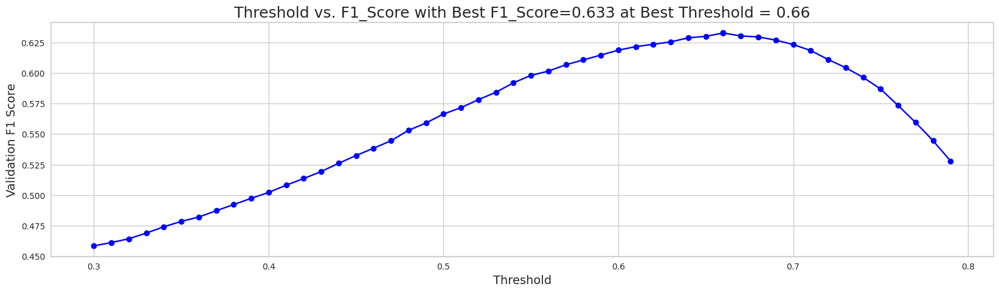

When using optimal threshold = 0.66...
Q0: F1 = 0.6326775987267396
==> Overall F1 = 0.6326775987267396
s
[I 2023-05-23 03:55:03,070] Trial 37 finished with value: 0.6326775987267396 and parameters: {'num_leaves': 45, 'learning_rate': 0.027603507151157138, 'feature_fraction': 0.49208336032900346, 'bagging_fraction': 0.5016732414244239, 'bagging_freq': 1, 'min_child_samples': 75, 'reg_alpha': 0.008345244120333727, 'reg_lambda': 0.19187956892699737, 'subsample': 0.7722642778766303, 'colsample_bytree': 0.17680494111887002, 'min_split_gain': 0.01641175939779555, 'max_depth': 9}. Best is trial 25 with value: 0.6340374265066029.


--------------------------------------------------
question14, with255features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.7529976466689218, subsample=0.8644513284162432 will be ignored. Current value: bagging_fraction=0.7529976466689218
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.5509567292568505, colsample_bytree=0.10220026119951102 will be ignored. Current value: feature_fraction=0.5509567292568505


,mean
feature,
20_level_counts,140.2
session_id,136.6
hover_duration_max,124.0
hover_duration_sum,120.4
hover_duration_mean,118.4
18_level_counts,105.6
room_coor_x_max,105.0
room_coor_y_min,102.2
hover_duration_std,101.6


[[0.77919263 0.22080737]
 [0.24993116 0.75006884]
 [0.1701872  0.8298128 ]
 ...
 [0.10591014 0.89408986]
 [0.08532775 0.91467225]
 [0.18048347 0.81951653]]


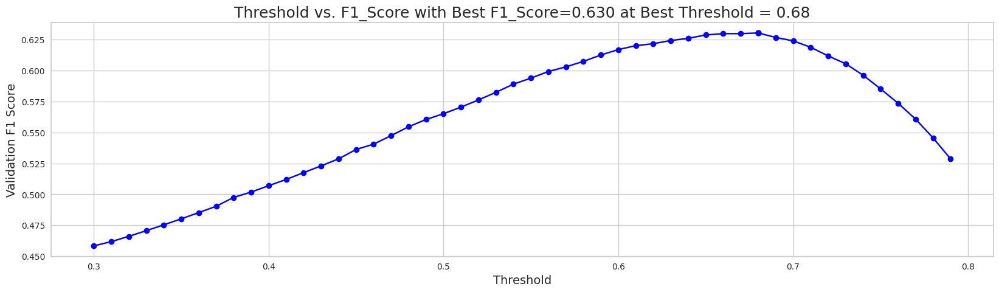

When using optimal threshold = 0.68...
Q0: F1 = 0.6303970126092419
==> Overall F1 = 0.6303970126092419
s
[I 2023-05-23 03:55:18,809] Trial 36 finished with value: 0.6303970126092419 and parameters: {'num_leaves': 46, 'learning_rate': 0.026221147409058298, 'feature_fraction': 0.496844342733813, 'bagging_fraction': 0.47620998588102303, 'bagging_freq': 2, 'min_child_samples': 72, 'reg_alpha': 0.0010579823380854516, 'reg_lambda': 0.016470316535777844, 'subsample': 0.930905311124226, 'colsample_bytree': 0.1959696389578265, 'min_split_gain': 0.14695016021497886, 'max_depth': 9}. Best is trial 25 with value: 0.6340374265066029.


--------------------------------------------------
question14, with255features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.7452966208223598, subsample=0.8658143204657386 will be ignored. Current value: bagging_fraction=0.7452966208223598
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.5512714770263307, colsample_bytree=0.28128745518917947 will be ignored. Current value: feature_fraction=0.5512714770263307


[LightGBM] [Warning] bagging_fraction is set=0.7529976466689218, subsample=0.8644513284162432 will be ignored. Current value: bagging_fraction=0.7529976466689218
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.5509567292568505, colsample_bytree=0.10220026119951102 will be ignored. Current value: feature_fraction=0.5509567292568505


[LightGBM] [Warning] bagging_fraction is set=0.6839654484457388, subsample=0.7862029515278087 will be ignored. Current value: bagging_fraction=0.6839654484457388
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.48466631973849184, colsample_bytree=0.1763762751510988 will be ignored. Current value: feature_fraction=0.48466631973849184
[LightGBM] [Warning] bagging_fraction is set=0.7151686589770662, subsample=0.77722791112775 will be ignored. Current value: bagging_fraction=0.7151686589770662
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] fe

[LightGBM] [Warning] bagging_fraction is set=0.7529976466689218, subsample=0.8644513284162432 will be ignored. Current value: bagging_fraction=0.7529976466689218
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.5509567292568505, colsample_bytree=0.10220026119951102 will be ignored. Current value: feature_fraction=0.5509567292568505


,mean
feature,
20_level_counts,125.8
session_id,112.6
tunic.historicalsociety.frontdesk.archivist_glasses.confrontation_recap_text_fqid_counts,93.6
hover_duration_sum,92.0
18_level_counts,89.4
hover_duration_max,89.0
tracks_fqid_counts,88.6
hover_duration_mean,86.8
15_level_counts,85.0


[[0.80999985 0.19000015]
 [0.19001924 0.80998076]
 [0.12495702 0.87504298]
 ...
 [0.11850036 0.88149964]
 [0.09247664 0.90752336]
 [0.17736751 0.82263249]]


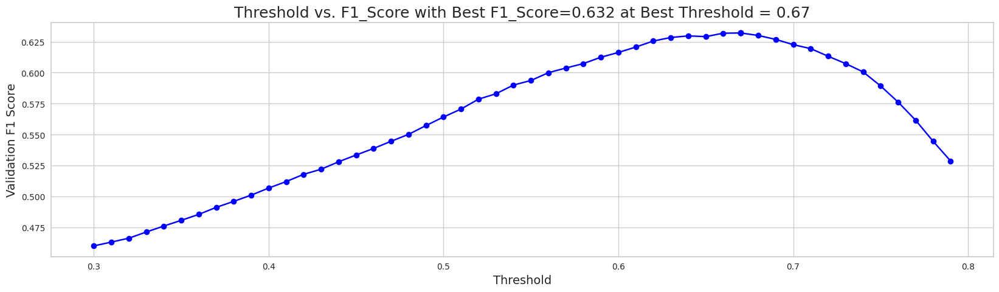

When using optimal threshold = 0.67...
Q0: F1 = 0.6320145122262366
==> Overall F1 = 0.6320145122262366
s
[I 2023-05-23 03:55:44,321] Trial 38 finished with value: 0.6320145122262366 and parameters: {'num_leaves': 40, 'learning_rate': 0.028391690722740694, 'feature_fraction': 0.4792375083932008, 'bagging_fraction': 0.7151686589770662, 'bagging_freq': 3, 'min_child_samples': 77, 'reg_alpha': 0.052064664866657756, 'reg_lambda': 0.1640125677196053, 'subsample': 0.77722791112775, 'colsample_bytree': 0.17852416258777448, 'min_split_gain': 0.11107478496840015, 'max_depth': 9}. Best is trial 25 with value: 0.6340374265066029.


--------------------------------------------------
question14, with255features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.5741770185244147, subsample=0.8625579719288248 will be ignored. Current value: bagging_fraction=0.5741770185244147
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
[LightGBM] [Warning] feature_fraction is set=0.5493557182656122, colsample_bytree=0.2820587560706647 will be ignored. Current value: feature_fraction=0.5493557182656122


[LightGBM] [Warning] bagging_fraction is set=0.7452966208223598, subsample=0.8658143204657386 will be ignored. Current value: bagging_fraction=0.7452966208223598
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.5512714770263307, colsample_bytree=0.28128745518917947 will be ignored. Current value: feature_fraction=0.5512714770263307


[LightGBM] [Warning] bagging_fraction is set=0.7529976466689218, subsample=0.8644513284162432 will be ignored. Current value: bagging_fraction=0.7529976466689218
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.5509567292568505, colsample_bytree=0.10220026119951102 will be ignored. Current value: feature_fraction=0.5509567292568505


,mean
feature,
20_level_counts,310.6
session_id,258.8
hover_duration_max,247.8
hover_duration_sum,238.6
hover_duration_std,237.2
hover_duration_mean,232.2
screen_coor_y_mean,209.2
15_level_counts,208.8
room_coor_x_max,203.0


[[0.74737803 0.25262197]
 [0.21045231 0.78954769]
 [0.12138583 0.87861417]
 ...
 [0.10967241 0.89032759]
 [0.08097001 0.91902999]
 [0.15851824 0.84148176]]


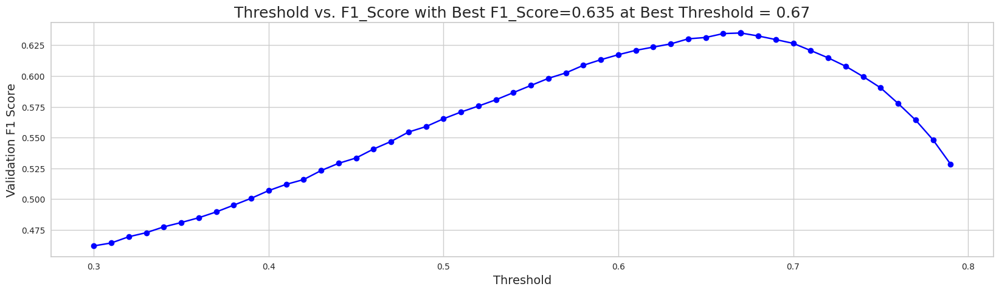

When using optimal threshold = 0.67...
Q0: F1 = 0.6349592601470162
==> Overall F1 = 0.6349592601470162
s
[I 2023-05-23 03:56:12,501] Trial 35 finished with value: 0.6349592601470162 and parameters: {'num_leaves': 47, 'learning_rate': 0.013975637938432851, 'feature_fraction': 0.48466631973849184, 'bagging_fraction': 0.6839654484457388, 'bagging_freq': 2, 'min_child_samples': 61, 'reg_alpha': 0.0010018268660218876, 'reg_lambda': 0.061841495000900706, 'subsample': 0.7862029515278087, 'colsample_bytree': 0.1763762751510988, 'min_split_gain': 0.11466698346125896, 'max_depth': 9}. Best is trial 35 with value: 0.6349592601470162.


--------------------------------------------------
question14, with255features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.7452966208223598, subsample=0.8658143204657386 will be ignored. Current value: bagging_fraction=0.7452966208223598
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.5512714770263307, colsample_bytree=0.28128745518917947 will be ignored. Current value: feature_fraction=0.5512714770263307


[LightGBM] [Warning] bagging_fraction is set=0.5652798369303481, subsample=0.8576216360224673 will be ignored. Current value: bagging_fraction=0.5652798369303481
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
[LightGBM] [Warning] feature_fraction is set=0.5564125193452348, colsample_bytree=0.10674869520624951 will be ignored. Current value: feature_fraction=0.5564125193452348


[LightGBM] [Warning] bagging_fraction is set=0.5741770185244147, subsample=0.8625579719288248 will be ignored. Current value: bagging_fraction=0.5741770185244147
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
[LightGBM] [Warning] feature_fraction is set=0.5493557182656122, colsample_bytree=0.2820587560706647 will be ignored. Current value: feature_fraction=0.5493557182656122


[LightGBM] [Warning] bagging_fraction is set=0.7529976466689218, subsample=0.8644513284162432 will be ignored. Current value: bagging_fraction=0.7529976466689218
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.5509567292568505, colsample_bytree=0.10220026119951102 will be ignored. Current value: feature_fraction=0.5509567292568505


[LightGBM] [Warning] bagging_fraction is set=0.5741770185244147, subsample=0.8625579719288248 will be ignored. Current value: bagging_fraction=0.5741770185244147
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
[LightGBM] [Warning] feature_fraction is set=0.5493557182656122, colsample_bytree=0.2820587560706647 will be ignored. Current value: feature_fraction=0.5493557182656122


,mean
feature,
20_level_counts,148.0
tracks_fqid_counts,107.8
tunic.historicalsociety.frontdesk.archivist_glasses.confrontation_recap_text_fqid_counts,100.2
session_id,97.6
hover_duration_mean,89.2
17_level_counts,88.2
hover_duration_max,87.6
hover_duration_sum,82.2
hover_duration_std,80.2


[[0.80863947 0.19136053]
 [0.2219138  0.7780862 ]
 [0.15057379 0.84942621]
 ...
 [0.12133311 0.87866689]
 [0.08767497 0.91232503]
 [0.15911456 0.84088544]]


[LightGBM] [Warning] bagging_fraction is set=0.5652798369303481, subsample=0.8576216360224673 will be ignored. Current value: bagging_fraction=0.5652798369303481
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
[LightGBM] [Warning] feature_fraction is set=0.5564125193452348, colsample_bytree=0.10674869520624951 will be ignored. Current value: feature_fraction=0.5564125193452348


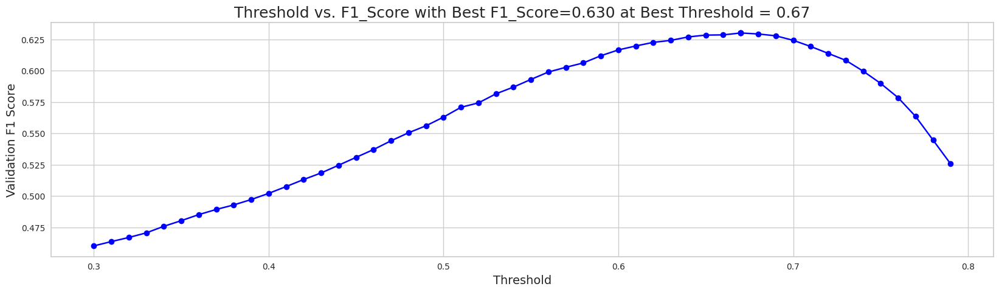

When using optimal threshold = 0.67...
Q0: F1 = 0.6300930480266766
==> Overall F1 = 0.6300930480266766
s
[I 2023-05-23 03:56:41,552] Trial 39 finished with value: 0.6300930480266766 and parameters: {'num_leaves': 34, 'learning_rate': 0.02556565630595381, 'feature_fraction': 0.5509567292568505, 'bagging_fraction': 0.7529976466689218, 'bagging_freq': 3, 'min_child_samples': 20, 'reg_alpha': 0.0012562808039793256, 'reg_lambda': 0.01553301354788009, 'subsample': 0.8644513284162432, 'colsample_bytree': 0.10220026119951102, 'min_split_gain': 0.10861899726508344, 'max_depth': 9}. Best is trial 35 with value: 0.6349592601470162.


--------------------------------------------------
question14, with255features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.7452966208223598, subsample=0.8658143204657386 will be ignored. Current value: bagging_fraction=0.7452966208223598
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.5512714770263307, colsample_bytree=0.28128745518917947 will be ignored. Current value: feature_fraction=0.5512714770263307


[LightGBM] [Warning] bagging_fraction is set=0.5504973019235462, subsample=0.8578561596320027 will be ignored. Current value: bagging_fraction=0.5504973019235462
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.546613543915999, colsample_bytree=0.418320921171253 will be ignored. Current value: feature_fraction=0.546613543915999


[LightGBM] [Warning] bagging_fraction is set=0.5652798369303481, subsample=0.8576216360224673 will be ignored. Current value: bagging_fraction=0.5652798369303481
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
[LightGBM] [Warning] feature_fraction is set=0.5564125193452348, colsample_bytree=0.10674869520624951 will be ignored. Current value: feature_fraction=0.5564125193452348


[LightGBM] [Warning] bagging_fraction is set=0.5741770185244147, subsample=0.8625579719288248 will be ignored. Current value: bagging_fraction=0.5741770185244147
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
[LightGBM] [Warning] feature_fraction is set=0.5493557182656122, colsample_bytree=0.2820587560706647 will be ignored. Current value: feature_fraction=0.5493557182656122


[LightGBM] [Warning] bagging_fraction is set=0.7452966208223598, subsample=0.8658143204657386 will be ignored. Current value: bagging_fraction=0.7452966208223598
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.5512714770263307, colsample_bytree=0.28128745518917947 will be ignored. Current value: feature_fraction=0.5512714770263307


[LightGBM] [Warning] bagging_fraction is set=0.5504973019235462, subsample=0.8578561596320027 will be ignored. Current value: bagging_fraction=0.5504973019235462
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.546613543915999, colsample_bytree=0.418320921171253 will be ignored. Current value: feature_fraction=0.546613543915999


,mean
feature,
20_level_counts,173.0
tunic.historicalsociety.frontdesk.archivist_glasses.confrontation_recap_text_fqid_counts,154.4
tracks_fqid_counts,127.8
session_id,120.6
tunic.historicalsociety.entry.directory.closeup.archivist_text_fqid_counts,104.0
17_level_counts,103.8
hover_duration_max,100.4
hover_duration_mean,94.4
15_level_counts,93.2


[[0.82216292 0.17783708]
 [0.24969195 0.75030805]
 [0.11555909 0.88444091]
 ...
 [0.11988678 0.88011322]
 [0.10796264 0.89203736]
 [0.18671597 0.81328403]]


[LightGBM] [Warning] bagging_fraction is set=0.5652798369303481, subsample=0.8576216360224673 will be ignored. Current value: bagging_fraction=0.5652798369303481
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
[LightGBM] [Warning] feature_fraction is set=0.5564125193452348, colsample_bytree=0.10674869520624951 will be ignored. Current value: feature_fraction=0.5564125193452348


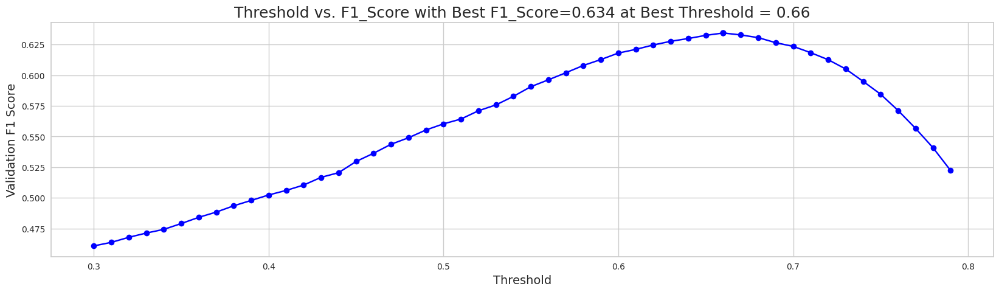

When using optimal threshold = 0.66...
Q0: F1 = 0.6344891620492225
==> Overall F1 = 0.6344891620492225
s
[I 2023-05-23 03:57:32,240] Trial 40 finished with value: 0.6344891620492225 and parameters: {'num_leaves': 37, 'learning_rate': 0.017129986339601184, 'feature_fraction': 0.5512714770263307, 'bagging_fraction': 0.7452966208223598, 'bagging_freq': 3, 'min_child_samples': 49, 'reg_alpha': 0.0014675512041219228, 'reg_lambda': 0.010678850947879934, 'subsample': 0.8658143204657386, 'colsample_bytree': 0.28128745518917947, 'min_split_gain': 0.23501480316478432, 'max_depth': 5}. Best is trial 35 with value: 0.6349592601470162.


--------------------------------------------------
question14, with255features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.5642310273380372, subsample=0.8522003473151959 will be ignored. Current value: bagging_fraction=0.5642310273380372
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
[LightGBM] [Warning] feature_fraction is set=0.5417969885533805, colsample_bytree=0.27721483347973985 will be ignored. Current value: feature_fraction=0.5417969885533805


[LightGBM] [Warning] bagging_fraction is set=0.5741770185244147, subsample=0.8625579719288248 will be ignored. Current value: bagging_fraction=0.5741770185244147
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
[LightGBM] [Warning] feature_fraction is set=0.5493557182656122, colsample_bytree=0.2820587560706647 will be ignored. Current value: feature_fraction=0.5493557182656122


[LightGBM] [Warning] bagging_fraction is set=0.5504973019235462, subsample=0.8578561596320027 will be ignored. Current value: bagging_fraction=0.5504973019235462
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.546613543915999, colsample_bytree=0.418320921171253 will be ignored. Current value: feature_fraction=0.546613543915999


[LightGBM] [Warning] bagging_fraction is set=0.5652798369303481, subsample=0.8576216360224673 will be ignored. Current value: bagging_fraction=0.5652798369303481
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
[LightGBM] [Warning] feature_fraction is set=0.5564125193452348, colsample_bytree=0.10674869520624951 will be ignored. Current value: feature_fraction=0.5564125193452348


,mean
feature,
20_level_counts,159.4
tunic.historicalsociety.frontdesk.archivist_glasses.confrontation_recap_text_fqid_counts,132.0
session_id,118.0
tracks_fqid_counts,115.6
15_level_counts,108.0
hover_duration_max,104.6
hover_duration_sum,99.6
17_level_counts,99.2
hover_duration_mean,95.0


[[0.77754082 0.22245918]
 [0.21124059 0.78875941]
 [0.11540155 0.88459845]
 ...
 [0.11068467 0.88931533]
 [0.10368219 0.89631781]
 [0.16551458 0.83448542]]


[LightGBM] [Warning] bagging_fraction is set=0.5642310273380372, subsample=0.8522003473151959 will be ignored. Current value: bagging_fraction=0.5642310273380372
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
[LightGBM] [Warning] feature_fraction is set=0.5417969885533805, colsample_bytree=0.27721483347973985 will be ignored. Current value: feature_fraction=0.5417969885533805


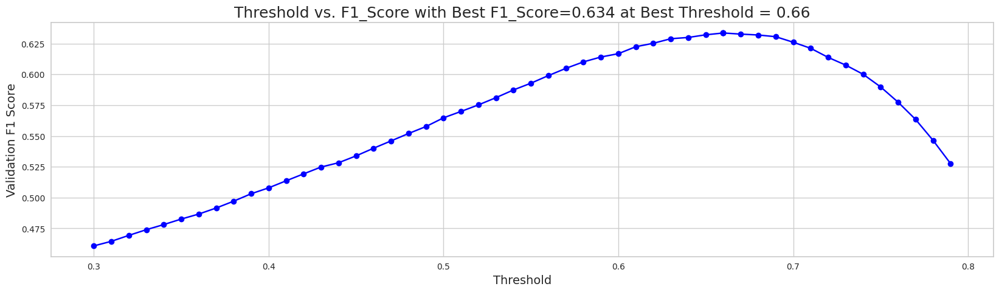

When using optimal threshold = 0.66...
Q0: F1 = 0.6336746247927335
==> Overall F1 = 0.6336746247927335
s
[I 2023-05-23 03:58:07,651] Trial 41 finished with value: 0.6336746247927335 and parameters: {'num_leaves': 24, 'learning_rate': 0.017275466066641047, 'feature_fraction': 0.5493557182656122, 'bagging_fraction': 0.5741770185244147, 'bagging_freq': 5, 'min_child_samples': 38, 'reg_alpha': 0.003492215646222767, 'reg_lambda': 0.009799216912355246, 'subsample': 0.8625579719288248, 'colsample_bytree': 0.2820587560706647, 'min_split_gain': 0.24570208251712106, 'max_depth': 8}. Best is trial 35 with value: 0.6349592601470162.


--------------------------------------------------
question14, with255features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.6403290944693328, subsample=0.9366475526634027 will be ignored. Current value: bagging_fraction=0.6403290944693328
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.4594114224896569, colsample_bytree=0.3918910541236932 will be ignored. Current value: feature_fraction=0.4594114224896569


[LightGBM] [Warning] bagging_fraction is set=0.5504973019235462, subsample=0.8578561596320027 will be ignored. Current value: bagging_fraction=0.5504973019235462
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.546613543915999, colsample_bytree=0.418320921171253 will be ignored. Current value: feature_fraction=0.546613543915999


[LightGBM] [Warning] bagging_fraction is set=0.5642310273380372, subsample=0.8522003473151959 will be ignored. Current value: bagging_fraction=0.5642310273380372
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
[LightGBM] [Warning] feature_fraction is set=0.5417969885533805, colsample_bytree=0.27721483347973985 will be ignored. Current value: feature_fraction=0.5417969885533805


[LightGBM] [Warning] bagging_fraction is set=0.6403290944693328, subsample=0.9366475526634027 will be ignored. Current value: bagging_fraction=0.6403290944693328
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.4594114224896569, colsample_bytree=0.3918910541236932 will be ignored. Current value: feature_fraction=0.4594114224896569


,mean
feature,
20_level_counts,166.6
tunic.historicalsociety.frontdesk.archivist_glasses.confrontation_recap_text_fqid_counts,132.0
session_id,117.0
tracks_fqid_counts,114.2
15_level_counts,108.6
hover_duration_max,107.0
hover_duration_mean,99.8
17_level_counts,98.8
hover_duration_sum,97.8


[[0.75705216 0.24294784]
 [0.23312627 0.76687373]
 [0.12315712 0.87684288]
 ...
 [0.11362689 0.88637311]
 [0.09585741 0.90414259]
 [0.16754954 0.83245046]]


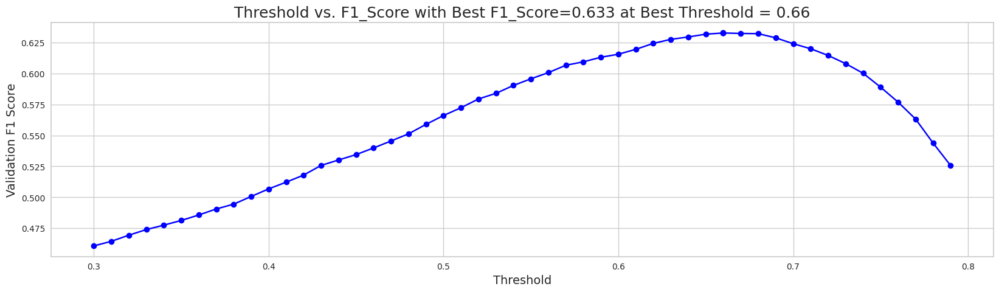

When using optimal threshold = 0.66...
Q0: F1 = 0.6325792315535603
==> Overall F1 = 0.6325792315535603
s
[I 2023-05-23 03:58:38,183] Trial 42 finished with value: 0.6325792315535603 and parameters: {'num_leaves': 24, 'learning_rate': 0.017001330566125093, 'feature_fraction': 0.5564125193452348, 'bagging_fraction': 0.5652798369303481, 'bagging_freq': 5, 'min_child_samples': 38, 'reg_alpha': 0.0010325573410138668, 'reg_lambda': 0.12391261897996987, 'subsample': 0.8576216360224673, 'colsample_bytree': 0.10674869520624951, 'min_split_gain': 0.24459605026477377, 'max_depth': 8}. Best is trial 35 with value: 0.6349592601470162.


--------------------------------------------------
question14, with255features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.6385694935783823, subsample=0.940621346115902 will be ignored. Current value: bagging_fraction=0.6385694935783823
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.45793613266254934, colsample_bytree=0.4403309727868998 will be ignored. Current value: feature_fraction=0.45793613266254934


[LightGBM] [Warning] bagging_fraction is set=0.5504973019235462, subsample=0.8578561596320027 will be ignored. Current value: bagging_fraction=0.5504973019235462
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.546613543915999, colsample_bytree=0.418320921171253 will be ignored. Current value: feature_fraction=0.546613543915999


[LightGBM] [Warning] bagging_fraction is set=0.6403290944693328, subsample=0.9366475526634027 will be ignored. Current value: bagging_fraction=0.6403290944693328
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.4594114224896569, colsample_bytree=0.3918910541236932 will be ignored. Current value: feature_fraction=0.4594114224896569


[LightGBM] [Warning] bagging_fraction is set=0.6385694935783823, subsample=0.940621346115902 will be ignored. Current value: bagging_fraction=0.6385694935783823
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.45793613266254934, colsample_bytree=0.4403309727868998 will be ignored. Current value: feature_fraction=0.45793613266254934


[LightGBM] [Warning] bagging_fraction is set=0.5642310273380372, subsample=0.8522003473151959 will be ignored. Current value: bagging_fraction=0.5642310273380372
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
[LightGBM] [Warning] feature_fraction is set=0.5417969885533805, colsample_bytree=0.27721483347973985 will be ignored. Current value: feature_fraction=0.5417969885533805


,mean
feature,
20_level_counts,284.4
tunic.historicalsociety.frontdesk.archivist_glasses.confrontation_recap_text_fqid_counts,219.2
session_id,215.0
tracks_fqid_counts,204.2
hover_duration_max,185.2
17_level_counts,184.4
hover_duration_std,179.2
15_level_counts,179.0
hover_duration_sum,177.6


[[0.81215591 0.18784409]
 [0.22886808 0.77113192]
 [0.11972968 0.88027032]
 ...
 [0.11510028 0.88489972]
 [0.10398107 0.89601893]
 [0.19037885 0.80962115]]


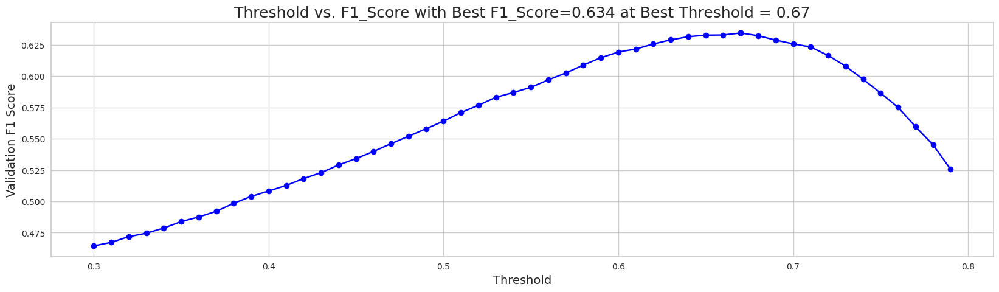

When using optimal threshold = 0.67...
Q0: F1 = 0.6343903619886269
==> Overall F1 = 0.6343903619886269
s
[I 2023-05-23 03:59:17,393] Trial 43 finished with value: 0.6343903619886269 and parameters: {'num_leaves': 25, 'learning_rate': 0.010081849838733597, 'feature_fraction': 0.546613543915999, 'bagging_fraction': 0.5504973019235462, 'bagging_freq': 2, 'min_child_samples': 49, 'reg_alpha': 0.003730682244112312, 'reg_lambda': 0.1492879137985933, 'subsample': 0.8578561596320027, 'colsample_bytree': 0.418320921171253, 'min_split_gain': 0.24927270329193424, 'max_depth': 5}. Best is trial 35 with value: 0.6349592601470162.


--------------------------------------------------
question14, with255features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.6352143312882279, subsample=0.9420589789057863 will be ignored. Current value: bagging_fraction=0.6352143312882279
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.4608124088582502, colsample_bytree=0.42384865944944217 will be ignored. Current value: feature_fraction=0.4608124088582502


[LightGBM] [Warning] bagging_fraction is set=0.6385694935783823, subsample=0.940621346115902 will be ignored. Current value: bagging_fraction=0.6385694935783823
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.45793613266254934, colsample_bytree=0.4403309727868998 will be ignored. Current value: feature_fraction=0.45793613266254934


[LightGBM] [Warning] bagging_fraction is set=0.6403290944693328, subsample=0.9366475526634027 will be ignored. Current value: bagging_fraction=0.6403290944693328
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.4594114224896569, colsample_bytree=0.3918910541236932 will be ignored. Current value: feature_fraction=0.4594114224896569


[LightGBM] [Warning] bagging_fraction is set=0.5642310273380372, subsample=0.8522003473151959 will be ignored. Current value: bagging_fraction=0.5642310273380372
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
[LightGBM] [Warning] feature_fraction is set=0.5417969885533805, colsample_bytree=0.27721483347973985 will be ignored. Current value: feature_fraction=0.5417969885533805


[LightGBM] [Warning] bagging_fraction is set=0.6352143312882279, subsample=0.9420589789057863 will be ignored. Current value: bagging_fraction=0.6352143312882279
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.4608124088582502, colsample_bytree=0.42384865944944217 will be ignored. Current value: feature_fraction=0.4608124088582502


[LightGBM] [Warning] bagging_fraction is set=0.6403290944693328, subsample=0.9366475526634027 will be ignored. Current value: bagging_fraction=0.6403290944693328
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.4594114224896569, colsample_bytree=0.3918910541236932 will be ignored. Current value: feature_fraction=0.4594114224896569


[LightGBM] [Warning] bagging_fraction is set=0.6385694935783823, subsample=0.940621346115902 will be ignored. Current value: bagging_fraction=0.6385694935783823
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.45793613266254934, colsample_bytree=0.4403309727868998 will be ignored. Current value: feature_fraction=0.45793613266254934


,mean
feature,
20_level_counts,218.6
tunic.historicalsociety.frontdesk.archivist_glasses.confrontation_recap_text_fqid_counts,175.0
session_id,165.2
tracks_fqid_counts,155.4
17_level_counts,141.4
hover_duration_max,140.8
hover_duration_mean,134.0
15_level_counts,132.4
18_level_counts,128.4


[[0.79599726 0.20400274]
 [0.2200405  0.7799595 ]
 [0.09965459 0.90034541]
 ...
 [0.10790512 0.89209488]
 [0.09792938 0.90207062]
 [0.18658712 0.81341288]]


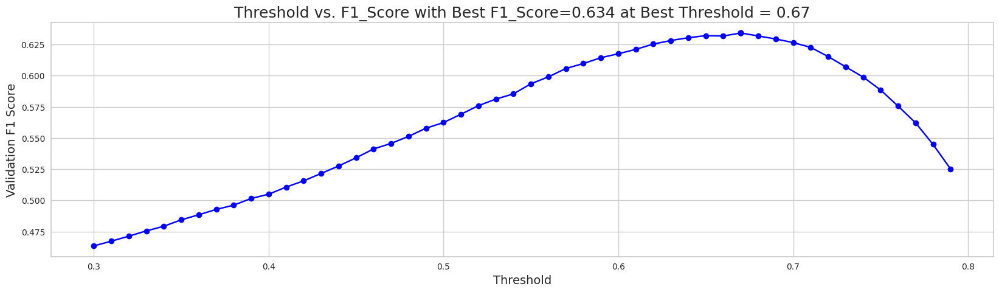

When using optimal threshold = 0.67...
Q0: F1 = 0.6341722398024072
==> Overall F1 = 0.6341722398024072
s
[I 2023-05-23 04:00:16,040] Trial 44 finished with value: 0.6341722398024072 and parameters: {'num_leaves': 22, 'learning_rate': 0.012675593098241015, 'feature_fraction': 0.5417969885533805, 'bagging_fraction': 0.5642310273380372, 'bagging_freq': 5, 'min_child_samples': 48, 'reg_alpha': 0.001038017667280033, 'reg_lambda': 0.04834284633023852, 'subsample': 0.8522003473151959, 'colsample_bytree': 0.27721483347973985, 'min_split_gain': 0.2268620426595295, 'max_depth': 5}. Best is trial 35 with value: 0.6349592601470162.


--------------------------------------------------
question14, with255features
--------------------------------------------------
[LightGBM] [Warning] bagging_fraction is set=0.6352143312882279, subsample=0.9420589789057863 will be ignored. Current value: bagging_fraction=0.6352143312882279
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.4608124088582502, colsample_bytree=0.42384865944944217 will be ignored. Current value: feature_fraction=0.4608124088582502


[LightGBM] [Warning] bagging_fraction is set=0.7963184450444627, subsample=0.9515446658243145 will be ignored. Current value: bagging_fraction=0.7963184450444627
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
[LightGBM] [Warning] feature_fraction is set=0.6641129616434852, colsample_bytree=0.472350652925715 will be ignored. Current value: feature_fraction=0.6641129616434852


,mean
feature,
20_level_counts,192.6
session_id,149.0
tunic.historicalsociety.frontdesk.archivist_glasses.confrontation_recap_text_fqid_counts,139.8
tracks_fqid_counts,137.8
hover_duration_max,137.2
hover_duration_std,131.6
hover_duration_mean,123.8
17_level_counts,122.2
15_level_counts,115.0


[[0.82066504 0.17933496]
 [0.22218977 0.77781023]
 [0.12671537 0.87328463]
 ...
 [0.11407461 0.88592539]
 [0.08975987 0.91024013]
 [0.20731824 0.79268176]]


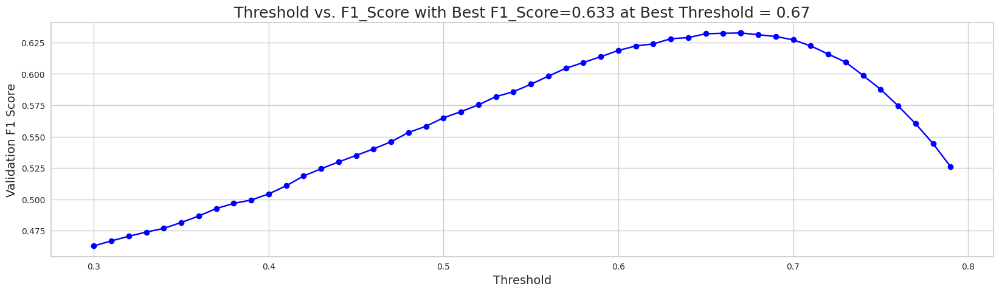

When using optimal threshold = 0.67...
Q0: F1 = 0.6325542369114334
==> Overall F1 = 0.6325542369114334
s
[I 2023-05-23 04:00:34,459] Trial 45 finished with value: 0.6325542369114334 and parameters: {'num_leaves': 53, 'learning_rate': 0.01652981255032434, 'feature_fraction': 0.4594114224896569, 'bagging_fraction': 0.6403290944693328, 'bagging_freq': 2, 'min_child_samples': 49, 'reg_alpha': 0.0018237520914577315, 'reg_lambda': 0.05098858677700586, 'subsample': 0.9366475526634027, 'colsample_bytree': 0.3918910541236932, 'min_split_gain': 0.2235151759385532, 'max_depth': 5}. Best is trial 35 with value: 0.6349592601470162.


--------------------------------------------------
question14, with255features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.8005993650913583, subsample=0.9058980723268346 will be ignored. Current value: bagging_fraction=0.8005993650913583
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
[LightGBM] [Warning] feature_fraction is set=0.5209717356860178, colsample_bytree=0.4283602303883018 will be ignored. Current value: feature_fraction=0.5209717356860178


[LightGBM] [Warning] bagging_fraction is set=0.6385694935783823, subsample=0.940621346115902 will be ignored. Current value: bagging_fraction=0.6385694935783823
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.45793613266254934, colsample_bytree=0.4403309727868998 will be ignored. Current value: feature_fraction=0.45793613266254934


[LightGBM] [Warning] bagging_fraction is set=0.6352143312882279, subsample=0.9420589789057863 will be ignored. Current value: bagging_fraction=0.6352143312882279
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.4608124088582502, colsample_bytree=0.42384865944944217 will be ignored. Current value: feature_fraction=0.4608124088582502


[LightGBM] [Warning] bagging_fraction is set=0.7963184450444627, subsample=0.9515446658243145 will be ignored. Current value: bagging_fraction=0.7963184450444627
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
[LightGBM] [Warning] feature_fraction is set=0.6641129616434852, colsample_bytree=0.472350652925715 will be ignored. Current value: feature_fraction=0.6641129616434852


,mean
feature,
20_level_counts,226.0
tunic.historicalsociety.frontdesk.archivist_glasses.confrontation_recap_text_fqid_counts,179.0
session_id,170.6
tracks_fqid_counts,156.6
hover_duration_std,143.0
hover_duration_max,142.2
17_level_counts,138.6
18_level_counts,138.6
15_level_counts,137.4


[[0.81700997 0.18299003]
 [0.21564709 0.78435291]
 [0.12690606 0.87309394]
 ...
 [0.11552029 0.88447971]
 [0.10220207 0.89779793]
 [0.19804104 0.80195896]]
[LightGBM] [Warning] bagging_fraction is set=0.8005993650913583, subsample=0.9058980723268346 will be ignored. Current value: bagging_fraction=0.8005993650913583
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
[LightGBM] [Warning] feature_fraction is set=0.5209717356860178, colsample_bytree=0.4283602303883018 will be ignored. Current value: feature_fraction=0.5209717356860178


[LightGBM] [Warning] bagging_fraction is set=0.7963184450444627, subsample=0.9515446658243145 will be ignored. Current value: bagging_fraction=0.7963184450444627
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
[LightGBM] [Warning] feature_fraction is set=0.6641129616434852, colsample_bytree=0.472350652925715 will be ignored. Current value: feature_fraction=0.6641129616434852


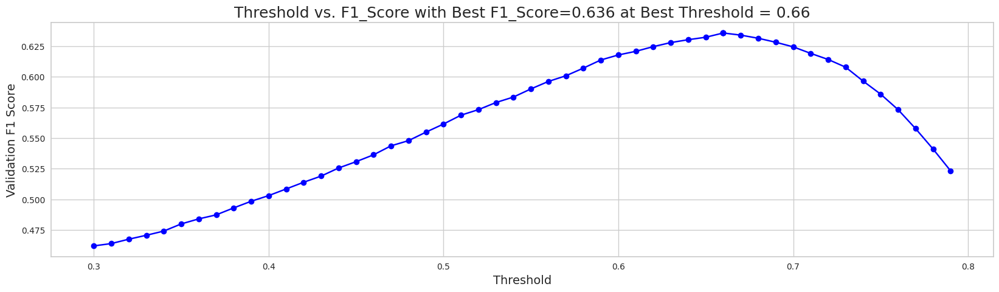

When using optimal threshold = 0.66...
Q0: F1 = 0.6358054943997907
==> Overall F1 = 0.6358054943997907
s
[I 2023-05-23 04:01:18,840] Trial 46 finished with value: 0.6358054943997907 and parameters: {'num_leaves': 52, 'learning_rate': 0.012626561275492451, 'feature_fraction': 0.45793613266254934, 'bagging_fraction': 0.6385694935783823, 'bagging_freq': 2, 'min_child_samples': 50, 'reg_alpha': 0.0016578943789439624, 'reg_lambda': 0.052541687936383016, 'subsample': 0.940621346115902, 'colsample_bytree': 0.4403309727868998, 'min_split_gain': 0.34916887827762305, 'max_depth': 5}. Best is trial 46 with value: 0.6358054943997907.


[LightGBM] [Warning] bagging_fraction is set=0.6352143312882279, subsample=0.9420589789057863 will be ignored. Current value: bagging_fraction=0.6352143312882279
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.4608124088582502, colsample_bytree=0.42384865944944217 will be ignored. Current value: feature_fraction=0.4608124088582502


[LightGBM] [Warning] bagging_fraction is set=0.8005993650913583, subsample=0.9058980723268346 will be ignored. Current value: bagging_fraction=0.8005993650913583
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
[LightGBM] [Warning] feature_fraction is set=0.5209717356860178, colsample_bytree=0.4283602303883018 will be ignored. Current value: feature_fraction=0.5209717356860178


[LightGBM] [Warning] bagging_fraction is set=0.7963184450444627, subsample=0.9515446658243145 will be ignored. Current value: bagging_fraction=0.7963184450444627
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
[LightGBM] [Warning] feature_fraction is set=0.6641129616434852, colsample_bytree=0.472350652925715 will be ignored. Current value: feature_fraction=0.6641129616434852


[LightGBM] [Warning] bagging_fraction is set=0.7963184450444627, subsample=0.9515446658243145 will be ignored. Current value: bagging_fraction=0.7963184450444627
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
[LightGBM] [Warning] feature_fraction is set=0.6641129616434852, colsample_bytree=0.472350652925715 will be ignored. Current value: feature_fraction=0.6641129616434852


,mean
feature,
20_level_counts,284.6
tunic.historicalsociety.frontdesk.archivist_glasses.confrontation_recap_text_fqid_counts,228.0
session_id,212.8
tracks_fqid_counts,206.2
hover_duration_std,189.8
hover_duration_max,187.4
17_level_counts,181.4
hover_duration_mean,180.2
15_level_counts,178.6


[[0.82025222 0.17974778]
 [0.24839839 0.75160161]
 [0.12108457 0.87891543]
 ...
 [0.11767428 0.88232572]
 [0.10115577 0.89884423]
 [0.18545208 0.81454792]]


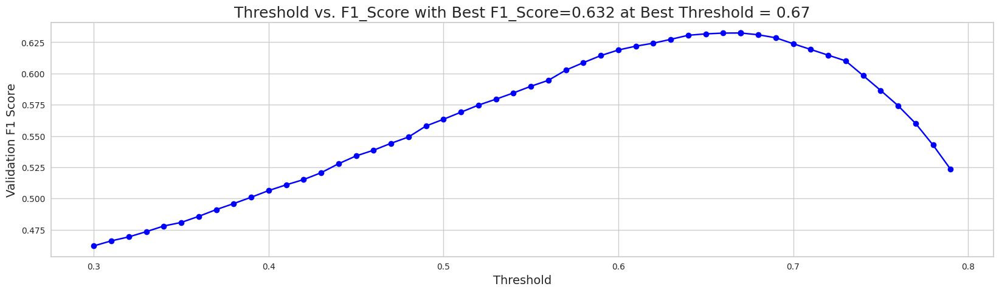

When using optimal threshold = 0.67...
Q0: F1 = 0.6324316672371955
==> Overall F1 = 0.6324316672371955
s
[I 2023-05-23 04:01:58,071] Trial 47 finished with value: 0.6324316672371955 and parameters: {'num_leaves': 25, 'learning_rate': 0.010168695738322941, 'feature_fraction': 0.4608124088582502, 'bagging_fraction': 0.6352143312882279, 'bagging_freq': 2, 'min_child_samples': 48, 'reg_alpha': 0.0016714519237298945, 'reg_lambda': 0.0475128174924943, 'subsample': 0.9420589789057863, 'colsample_bytree': 0.42384865944944217, 'min_split_gain': 0.3748671828671821, 'max_depth': 5}. Best is trial 46 with value: 0.6358054943997907.


[LightGBM] [Warning] bagging_fraction is set=0.8005993650913583, subsample=0.9058980723268346 will be ignored. Current value: bagging_fraction=0.8005993650913583
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
[LightGBM] [Warning] feature_fraction is set=0.5209717356860178, colsample_bytree=0.4283602303883018 will be ignored. Current value: feature_fraction=0.5209717356860178


,mean
feature,
tunic.historicalsociety.frontdesk.archivist_glasses.confrontation_recap_text_fqid_counts,194.4
20_level_counts,158.8
tunic.historicalsociety.entry.directory.closeup.archivist_text_fqid_counts,138.0
tracks_fqid_counts,127.2
session_id,98.4
savedteddy_fqid_counts,84.4
journals_flag.pic_0.next_fqid_counts,76.6
flag_girl_fqid_counts,72.8
17_level_counts,69.8


[[0.82837994 0.17162006]
 [0.233045   0.766955  ]
 [0.11627641 0.88372359]
 ...
 [0.12456778 0.87543222]
 [0.10615313 0.89384687]
 [0.15959654 0.84040346]]


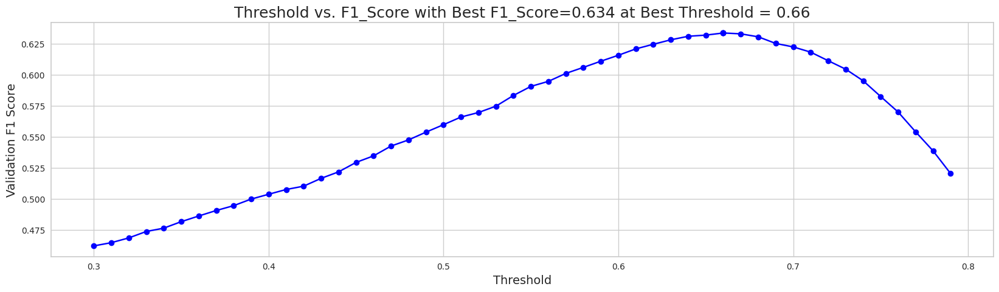

When using optimal threshold = 0.66...
Q0: F1 = 0.6338229365154248
==> Overall F1 = 0.6338229365154248
s
[I 2023-05-23 04:02:13,774] Trial 48 finished with value: 0.6338229365154248 and parameters: {'num_leaves': 28, 'learning_rate': 0.012175482397846563, 'feature_fraction': 0.6641129616434852, 'bagging_fraction': 0.7963184450444627, 'bagging_freq': 6, 'min_child_samples': 61, 'reg_alpha': 0.001569818575219694, 'reg_lambda': 0.20244112282650303, 'subsample': 0.9515446658243145, 'colsample_bytree': 0.472350652925715, 'min_split_gain': 0.25975489155019416, 'max_depth': 3}. Best is trial 46 with value: 0.6358054943997907.


[LightGBM] [Warning] bagging_fraction is set=0.8005993650913583, subsample=0.9058980723268346 will be ignored. Current value: bagging_fraction=0.8005993650913583
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
[LightGBM] [Warning] feature_fraction is set=0.5209717356860178, colsample_bytree=0.4283602303883018 will be ignored. Current value: feature_fraction=0.5209717356860178


,mean
feature,
tunic.historicalsociety.frontdesk.archivist_glasses.confrontation_recap_text_fqid_counts,210.6
20_level_counts,198.8
tracks_fqid_counts,162.6
tunic.historicalsociety.entry.directory.closeup.archivist_text_fqid_counts,160.0
session_id,114.8
savedteddy_fqid_counts,97.8
journals_flag.pic_0.next_fqid_counts,93.8
flag_girl_fqid_counts,88.8
17_level_counts,83.0


[[0.81940473 0.18059527]
 [0.22973242 0.77026758]
 [0.12913174 0.87086826]
 ...
 [0.11581003 0.88418997]
 [0.100129   0.899871  ]
 [0.17442679 0.82557321]]


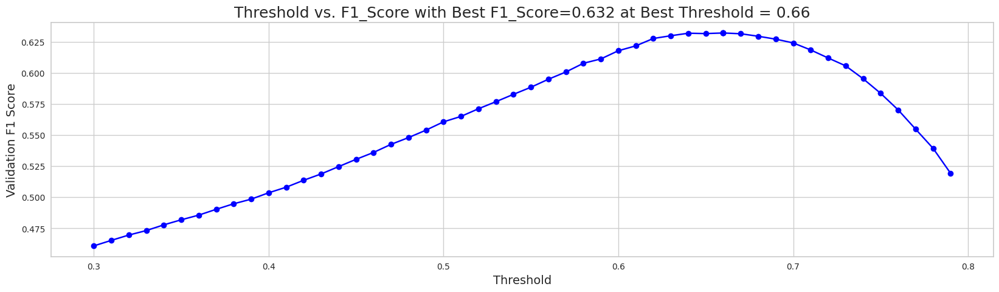

When using optimal threshold = 0.66...
Q0: F1 = 0.6320864613794537
==> Overall F1 = 0.6320864613794537
s
[I 2023-05-23 04:02:29,152] Trial 49 finished with value: 0.6320864613794537 and parameters: {'num_leaves': 26, 'learning_rate': 0.010382430625891477, 'feature_fraction': 0.5209717356860178, 'bagging_fraction': 0.8005993650913583, 'bagging_freq': 6, 'min_child_samples': 48, 'reg_alpha': 0.0015810217492473121, 'reg_lambda': 0.34584835144040094, 'subsample': 0.9058980723268346, 'colsample_bytree': 0.4283602303883018, 'min_split_gain': 0.43896718682272, 'max_depth': 3}. Best is trial 46 with value: 0.6358054943997907.


[I 2023-05-23 04:02:30,710] A new study created in memory with name: no-name-8e219959-effb-465e-afac-fdc10f4e39b4


{'num_leaves': 52, 'learning_rate': 0.012626561275492451, 'feature_fraction': 0.45793613266254934, 'bagging_fraction': 0.6385694935783823, 'bagging_freq': 2, 'min_child_samples': 50, 'reg_alpha': 0.0016578943789439624, 'reg_lambda': 0.052541687936383016, 'subsample': 0.940621346115902, 'colsample_bytree': 0.4403309727868998, 'min_split_gain': 0.34916887827762305, 'max_depth': 5}


  0%|          | 0/50 [00:00<?, ?it/s]

--------------------------------------------------
question15, with255features
--------------------------------------------------
--------------------------------------------------
question15, with255features
--------------------------------------------------
--------------------------------------------------
question15, with255features
--------------------------------------------------
--------------------------------------------------
question15, with255features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.3233659422177766, subsample=0.8463757619888158 will be ignored. Current value: bagging_fraction=0.3233659422177766
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=9, subsample_freq=0 will be ignored. Current value: bagging_freq=9
[LightGBM] [Warning] feature_fraction is set=0.18280880534002042, colsample_bytree=0.4721105522643001 will be ignored. Current value: feature_fraction=0.18280880534002042
[LightGBM] [Warning] bagging_fraction is set=0.4464277844861455, subsample=0.6929306083376047 will be ignored. Current value: bagging_fraction=0.4464277844861455
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=10, subsample_freq=0 will be ignored. Current value: bagging_freq=10
[LightGBM] [Warning

[LightGBM] [Warning] bagging_fraction is set=0.4464277844861455, subsample=0.6929306083376047 will be ignored. Current value: bagging_fraction=0.4464277844861455
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=10, subsample_freq=0 will be ignored. Current value: bagging_freq=10
[LightGBM] [Warning] feature_fraction is set=0.6187564621355542, colsample_bytree=0.8959204414916954 will be ignored. Current value: feature_fraction=0.6187564621355542


[LightGBM] [Warning] bagging_fraction is set=0.3233659422177766, subsample=0.8463757619888158 will be ignored. Current value: bagging_fraction=0.3233659422177766
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=9, subsample_freq=0 will be ignored. Current value: bagging_freq=9
[LightGBM] [Warning] feature_fraction is set=0.18280880534002042, colsample_bytree=0.4721105522643001 will be ignored. Current value: feature_fraction=0.18280880534002042


[LightGBM] [Warning] bagging_fraction is set=0.4464277844861455, subsample=0.6929306083376047 will be ignored. Current value: bagging_fraction=0.4464277844861455
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=10, subsample_freq=0 will be ignored. Current value: bagging_freq=10
[LightGBM] [Warning] feature_fraction is set=0.6187564621355542, colsample_bytree=0.8959204414916954 will be ignored. Current value: feature_fraction=0.6187564621355542


[LightGBM] [Warning] bagging_fraction is set=0.4266324092333361, subsample=0.975365157871198 will be ignored. Current value: bagging_fraction=0.4266324092333361
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=7, subsample_freq=0 will be ignored. Current value: bagging_freq=7
[LightGBM] [Warning] feature_fraction is set=0.6912421937750917, colsample_bytree=0.980673210648877 will be ignored. Current value: feature_fraction=0.6912421937750917


[LightGBM] [Warning] bagging_fraction is set=0.4464277844861455, subsample=0.6929306083376047 will be ignored. Current value: bagging_fraction=0.4464277844861455
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=10, subsample_freq=0 will be ignored. Current value: bagging_freq=10
[LightGBM] [Warning] feature_fraction is set=0.6187564621355542, colsample_bytree=0.8959204414916954 will be ignored. Current value: feature_fraction=0.6187564621355542


[LightGBM] [Warning] bagging_fraction is set=0.3233659422177766, subsample=0.8463757619888158 will be ignored. Current value: bagging_fraction=0.3233659422177766
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=9, subsample_freq=0 will be ignored. Current value: bagging_freq=9
[LightGBM] [Warning] feature_fraction is set=0.18280880534002042, colsample_bytree=0.4721105522643001 will be ignored. Current value: feature_fraction=0.18280880534002042


[LightGBM] [Warning] bagging_fraction is set=0.4464277844861455, subsample=0.6929306083376047 will be ignored. Current value: bagging_fraction=0.4464277844861455
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=10, subsample_freq=0 will be ignored. Current value: bagging_freq=10
[LightGBM] [Warning] feature_fraction is set=0.6187564621355542, colsample_bytree=0.8959204414916954 will be ignored. Current value: feature_fraction=0.6187564621355542


[LightGBM] [Warning] bagging_fraction is set=0.3233659422177766, subsample=0.8463757619888158 will be ignored. Current value: bagging_fraction=0.3233659422177766


,mean
feature,
tunic.historicalsociety.frontdesk.archivist_glasses.confrontation_recap_text_fqid_counts,4.0
directory_fqid_counts,4.0
6_page_counts,3.6
flag_girl_fqid_counts,3.2
tracks_fqid_counts,3.0
map_click_event_name_counts,2.8
elapsed_time_diff_sum,2.6
elapsed_time_diff_std,2.4
basic_name_counts,2.0


[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=9, subsample_freq=0 will be ignored. Current value: bagging_freq=9
[LightGBM] [Warning] feature_fraction is set=0.18280880534002042, colsample_bytree=0.4721105522643001 will be ignored. Current value: feature_fraction=0.18280880534002042
[[0.87976778 0.12023222]
 [0.43589189 0.56410811]
 [0.39669825 0.60330175]
 ...
 [0.37206511 0.62793489]
 [0.32943266 0.67056734]
 [0.59190423 0.40809577]]


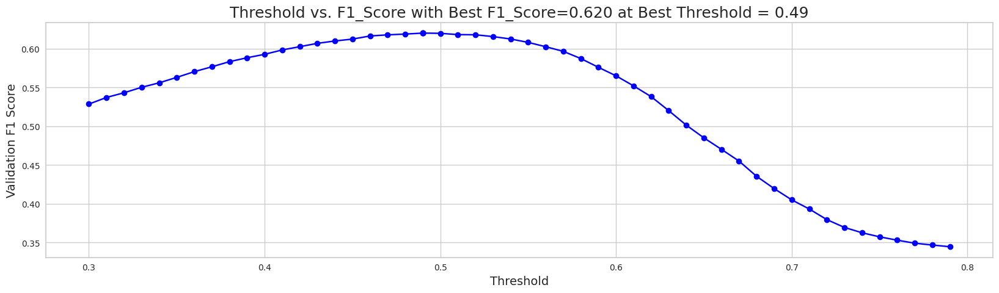

When using optimal threshold = 0.49...
Q0: F1 = 0.6202951428113648
==> Overall F1 = 0.6202951428113648
s
[I 2023-05-23 04:02:54,179] Trial 1 finished with value: 0.6202951428113648 and parameters: {'num_leaves': 34, 'learning_rate': 0.4115146773519013, 'feature_fraction': 0.6187564621355542, 'bagging_fraction': 0.4464277844861455, 'bagging_freq': 10, 'min_child_samples': 70, 'reg_alpha': 0.008227154968402284, 'reg_lambda': 1.2901511449904688, 'subsample': 0.6929306083376047, 'colsample_bytree': 0.8959204414916954, 'min_split_gain': 0.04478176678671738, 'max_depth': 4}. Best is trial 1 with value: 0.6202951428113648.


--------------------------------------------------
question15, with255features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.4266324092333361, subsample=0.975365157871198 will be ignored. Current value: bagging_fraction=0.4266324092333361
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=7, subsample_freq=0 will be ignored. Current value: bagging_freq=7
[LightGBM] [Warning] feature_fraction is set=0.6912421937750917, colsample_bytree=0.980673210648877 will be ignored. Current value: feature_fraction=0.6912421937750917


[LightGBM] [Warning] bagging_fraction is set=0.11594992971717072, subsample=0.9765521243852279 will be ignored. Current value: bagging_fraction=0.11594992971717072
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.4020868748836035, colsample_bytree=0.18200575715556772 will be ignored. Current value: feature_fraction=0.4020868748836035


[LightGBM] [Warning] bagging_fraction is set=0.3233659422177766, subsample=0.8463757619888158 will be ignored. Current value: bagging_fraction=0.3233659422177766
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=9, subsample_freq=0 will be ignored. Current value: bagging_freq=9
[LightGBM] [Warning] feature_fraction is set=0.18280880534002042, colsample_bytree=0.4721105522643001 will be ignored. Current value: feature_fraction=0.18280880534002042


[LightGBM] [Warning] bagging_fraction is set=0.11594992971717072, subsample=0.9765521243852279 will be ignored. Current value: bagging_fraction=0.11594992971717072
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.4020868748836035, colsample_bytree=0.18200575715556772 will be ignored. Current value: feature_fraction=0.4020868748836035


[LightGBM] [Warning] bagging_fraction is set=0.11594992971717072, subsample=0.9765521243852279 will be ignored. Current value: bagging_fraction=0.11594992971717072
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.4020868748836035, colsample_bytree=0.18200575715556772 will be ignored. Current value: feature_fraction=0.4020868748836035


,mean
feature,
elapsed_time_diff_sum,20.6
text_fqid_None_text_fqid_counts,19.8
hover_duration_sum,18.2
screen_coor_y_mean,17.0
room_coor_y_std,15.0
screen_corr_x_dff_sum,14.8
savedteddy_fqid_counts,14.4
21_level_counts,14.0
room_coor_x_mean,13.8


[[0.90013676 0.09986324]
 [0.2705236  0.7294764 ]
 [0.33223661 0.66776339]
 ...
 [0.32677049 0.67322951]
 [0.41270444 0.58729556]
 [0.49227907 0.50772093]]


[LightGBM] [Warning] bagging_fraction is set=0.4266324092333361, subsample=0.975365157871198 will be ignored. Current value: bagging_fraction=0.4266324092333361
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=7, subsample_freq=0 will be ignored. Current value: bagging_freq=7
[LightGBM] [Warning] feature_fraction is set=0.6912421937750917, colsample_bytree=0.980673210648877 will be ignored. Current value: feature_fraction=0.6912421937750917


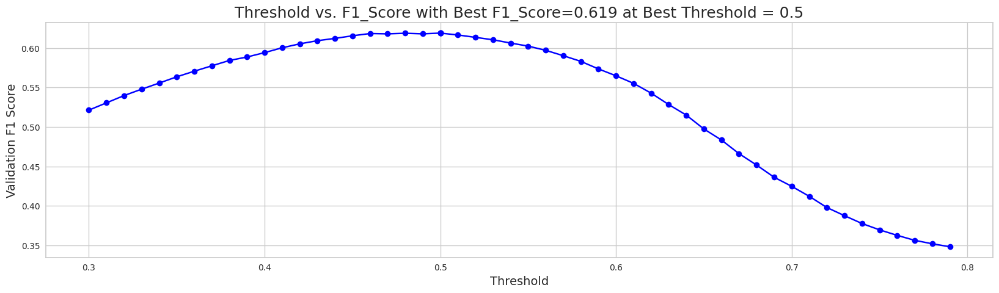

When using optimal threshold = 0.50...
Q0: F1 = 0.6189301020143503
==> Overall F1 = 0.6189301020143503
s
[I 2023-05-23 04:03:09,456] Trial 3 finished with value: 0.6189301020143503 and parameters: {'num_leaves': 89, 'learning_rate': 0.20796498882627962, 'feature_fraction': 0.18280880534002042, 'bagging_fraction': 0.3233659422177766, 'bagging_freq': 9, 'min_child_samples': 35, 'reg_alpha': 2.599983508017789, 'reg_lambda': 1.448321086357117, 'subsample': 0.8463757619888158, 'colsample_bytree': 0.4721105522643001, 'min_split_gain': 0.008551578585148083, 'max_depth': 8}. Best is trial 1 with value: 0.6202951428113648.


--------------------------------------------------
question15, with255features
--------------------------------------------------
[LightGBM] [Warning] bagging_fraction is set=0.11594992971717072, subsample=0.9765521243852279 will be ignored. Current value: bagging_fraction=0.11594992971717072
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.4020868748836035, colsample_bytree=0.18200575715556772 will be ignored. Current value: feature_fraction=0.4020868748836035


[LightGBM] [Warning] bagging_fraction is set=0.5371910969723583, subsample=0.870469609243571 will be ignored. Current value: bagging_fraction=0.5371910969723583
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=7, subsample_freq=0 will be ignored. Current value: bagging_freq=7
[LightGBM] [Warning] feature_fraction is set=0.5377432840225134, colsample_bytree=0.846457403431744 will be ignored. Current value: feature_fraction=0.5377432840225134


[LightGBM] [Warning] bagging_fraction is set=0.11594992971717072, subsample=0.9765521243852279 will be ignored. Current value: bagging_fraction=0.11594992971717072
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.4020868748836035, colsample_bytree=0.18200575715556772 will be ignored. Current value: feature_fraction=0.4020868748836035


[LightGBM] [Warning] bagging_fraction is set=0.5371910969723583, subsample=0.870469609243571 will be ignored. Current value: bagging_fraction=0.5371910969723583
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=7, subsample_freq=0 will be ignored. Current value: bagging_freq=7
[LightGBM] [Warning] feature_fraction is set=0.5377432840225134, colsample_bytree=0.846457403431744 will be ignored. Current value: feature_fraction=0.5377432840225134


[LightGBM] [Warning] bagging_fraction is set=0.8213489380684104, subsample=0.9116584029727306 will be ignored. Current value: bagging_fraction=0.8213489380684104
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.9058117752868668, colsample_bytree=0.5014880747785012 will be ignored. Current value: feature_fraction=0.9058117752868668


,mean
feature,
room_coor_y_max,6.0
screen_coor_x_std,5.4
tunic.historicalsociety.frontdesk.archivist_glasses.confrontation_recap_text_fqid_counts,5.0
elapsed_time_diff_sum,4.8
6_page_counts,4.6
map_click_event_name_counts,4.4
journals_flag.pic_0.next_fqid_counts,4.2
flag_girl_fqid_counts,4.2
tunic.flaghouse.entry_room_fqid_counts,4.2


[[0.91435913 0.08564087]
 [0.41659725 0.58340275]
 [0.21254161 0.78745839]
 ...
 [0.35291772 0.64708228]
 [0.33422929 0.66577071]
 [0.36527457 0.63472543]]


[LightGBM] [Warning] bagging_fraction is set=0.4266324092333361, subsample=0.975365157871198 will be ignored. Current value: bagging_fraction=0.4266324092333361
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=7, subsample_freq=0 will be ignored. Current value: bagging_freq=7
[LightGBM] [Warning] feature_fraction is set=0.6912421937750917, colsample_bytree=0.980673210648877 will be ignored. Current value: feature_fraction=0.6912421937750917


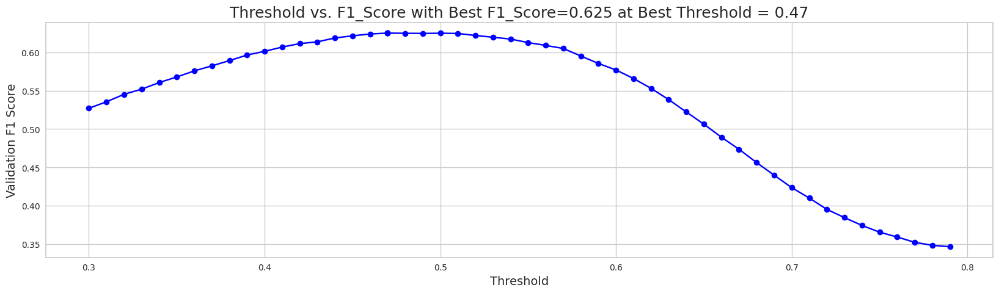

When using optimal threshold = 0.47...
Q0: F1 = 0.6249284094430234
==> Overall F1 = 0.6249284094430234
s
[I 2023-05-23 04:03:22,316] Trial 4 finished with value: 0.6249284094430234 and parameters: {'num_leaves': 30, 'learning_rate': 0.12976040792797186, 'feature_fraction': 0.4020868748836035, 'bagging_fraction': 0.11594992971717072, 'bagging_freq': 2, 'min_child_samples': 24, 'reg_alpha': 0.7909925742259958, 'reg_lambda': 0.018759312959754797, 'subsample': 0.9765521243852279, 'colsample_bytree': 0.18200575715556772, 'min_split_gain': 0.45751425403135, 'max_depth': 3}. Best is trial 4 with value: 0.6249284094430234.


--------------------------------------------------
question15, with255features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.2710413401107445, subsample=0.16581422387754072 will be ignored. Current value: bagging_fraction=0.2710413401107445
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=8, subsample_freq=0 will be ignored. Current value: bagging_freq=8
[LightGBM] [Warning] feature_fraction is set=0.2411069551609757, colsample_bytree=0.5980531391756778 will be ignored. Current value: feature_fraction=0.2411069551609757


[LightGBM] [Warning] bagging_fraction is set=0.5371910969723583, subsample=0.870469609243571 will be ignored. Current value: bagging_fraction=0.5371910969723583
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=7, subsample_freq=0 will be ignored. Current value: bagging_freq=7
[LightGBM] [Warning] feature_fraction is set=0.5377432840225134, colsample_bytree=0.846457403431744 will be ignored. Current value: feature_fraction=0.5377432840225134


,mean
feature,
room_coor_y_max,14.6
session_id,12.4
elapsed_time_diff_sum,12.2
21_level_counts,9.6
screen_coor_y_mean,9.4
room_coor_y_std,9.2
map_click_event_name_counts,9.0
hover_duration_std,9.0
screen_coor_x_mean,8.8


[[0.86183864 0.13816136]
 [0.68052135 0.31947865]
 [0.57317775 0.42682225]
 ...
 [0.37927336 0.62072664]
 [0.32726685 0.67273315]
 [0.45971603 0.54028397]]


[LightGBM] [Warning] bagging_fraction is set=0.5371910969723583, subsample=0.870469609243571 will be ignored. Current value: bagging_fraction=0.5371910969723583
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=7, subsample_freq=0 will be ignored. Current value: bagging_freq=7
[LightGBM] [Warning] feature_fraction is set=0.5377432840225134, colsample_bytree=0.846457403431744 will be ignored. Current value: feature_fraction=0.5377432840225134
[LightGBM] [Warning] bagging_fraction is set=0.2710413401107445, subsample=0.16581422387754072 will be ignored. Current value: bagging_fraction=0.2710413401107445
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=8, subsample_freq=0 will be ignored. Current value: bagging_freq=8
[LightGBM] [Warning] fea

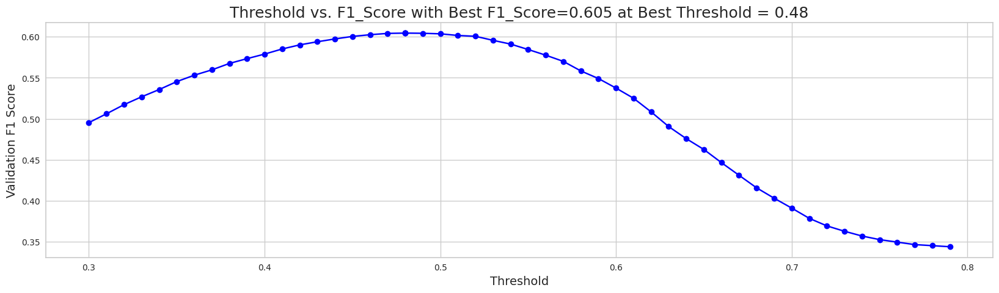

When using optimal threshold = 0.48...
Q0: F1 = 0.6045179618768328
==> Overall F1 = 0.6045179618768328
s
[I 2023-05-23 04:03:37,178] Trial 2 finished with value: 0.6045179618768328 and parameters: {'num_leaves': 98, 'learning_rate': 0.22292122849822793, 'feature_fraction': 0.6912421937750917, 'bagging_fraction': 0.4266324092333361, 'bagging_freq': 7, 'min_child_samples': 20, 'reg_alpha': 0.14025923594616235, 'reg_lambda': 0.017554638523216985, 'subsample': 0.975365157871198, 'colsample_bytree': 0.980673210648877, 'min_split_gain': 0.1125775930359527, 'max_depth': 10}. Best is trial 4 with value: 0.6249284094430234.


--------------------------------------------------
question15, with255features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.2879148948256897, subsample=0.4887401070014804 will be ignored. Current value: bagging_fraction=0.2879148948256897
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.48272570977976237, colsample_bytree=0.7283256943147003 will be ignored. Current value: feature_fraction=0.48272570977976237


[LightGBM] [Warning] bagging_fraction is set=0.2879148948256897, subsample=0.4887401070014804 will be ignored. Current value: bagging_fraction=0.2879148948256897
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.48272570977976237, colsample_bytree=0.7283256943147003 will be ignored. Current value: feature_fraction=0.48272570977976237


[LightGBM] [Warning] bagging_fraction is set=0.5371910969723583, subsample=0.870469609243571 will be ignored. Current value: bagging_fraction=0.5371910969723583
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=7, subsample_freq=0 will be ignored. Current value: bagging_freq=7
[LightGBM] [Warning] feature_fraction is set=0.5377432840225134, colsample_bytree=0.846457403431744 will be ignored. Current value: feature_fraction=0.5377432840225134


[LightGBM] [Warning] bagging_fraction is set=0.2710413401107445, subsample=0.16581422387754072 will be ignored. Current value: bagging_fraction=0.2710413401107445
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=8, subsample_freq=0 will be ignored. Current value: bagging_freq=8
[LightGBM] [Warning] feature_fraction is set=0.2411069551609757, colsample_bytree=0.5980531391756778 will be ignored. Current value: feature_fraction=0.2411069551609757


[LightGBM] [Warning] bagging_fraction is set=0.2879148948256897, subsample=0.4887401070014804 will be ignored. Current value: bagging_fraction=0.2879148948256897
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.48272570977976237, colsample_bytree=0.7283256943147003 will be ignored. Current value: feature_fraction=0.48272570977976237


,mean
feature,
hover_duration_sum,33.8
elapsed_time_diff_mean,28.4
20_level_counts,28.0
elapsed_time_diff_std,27.6
room_coor_y_max,23.4
17_level_counts,22.4
session_id,22.2
hover_duration_mean,21.6
room_coor_x_std,21.4


[[0.89782618 0.10217382]
 [0.42600778 0.57399222]
 [0.30062038 0.69937962]
 ...
 [0.34297062 0.65702938]
 [0.3124714  0.6875286 ]
 [0.35182889 0.64817111]]


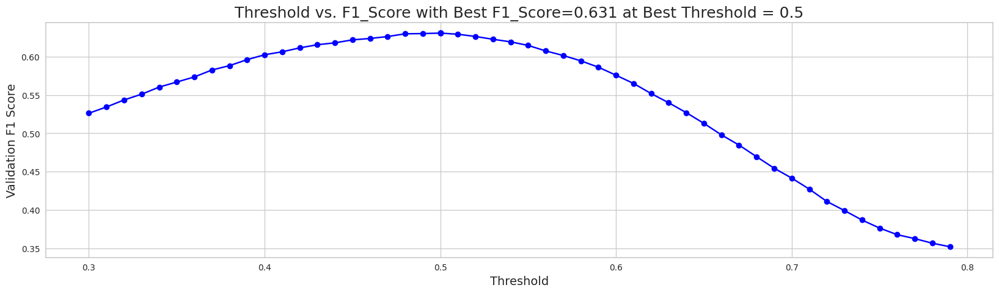

When using optimal threshold = 0.50...
[LightGBM] [Warning] bagging_fraction is set=0.2879148948256897, subsample=0.4887401070014804 will be ignored. Current value: bagging_fraction=0.2879148948256897
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.48272570977976237, colsample_bytree=0.7283256943147003 will be ignored. Current value: feature_fraction=0.48272570977976237
Q0: F1 = 0.6308058524485936
==> Overall F1 = 0.6308058524485936
s
[I 2023-05-23 04:03:55,903] Trial 5 finished with value: 0.6308058524485936 and parameters: {'num_leaves': 89, 'learning_rate': 0.12655357741806395, 'feature_fraction': 0.5377432840225134, 'bagging_fraction': 0.5371910969723583, 'bagging_freq': 7, 'min_child_samples': 97, 'reg_alpha': 0.007230335575081555, 'reg_lambda'

--------------------------------------------------
question15, with255features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.39887917528998307, subsample=0.43808889503253956 will be ignored. Current value: bagging_fraction=0.39887917528998307
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
[LightGBM] [Warning] feature_fraction is set=0.7552097270661808, colsample_bytree=0.16015029410561454 will be ignored. Current value: feature_fraction=0.7552097270661808


[LightGBM] [Warning] bagging_fraction is set=0.2710413401107445, subsample=0.16581422387754072 will be ignored. Current value: bagging_fraction=0.2710413401107445
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=8, subsample_freq=0 will be ignored. Current value: bagging_freq=8
[LightGBM] [Warning] feature_fraction is set=0.2411069551609757, colsample_bytree=0.5980531391756778 will be ignored. Current value: feature_fraction=0.2411069551609757


[LightGBM] [Warning] bagging_fraction is set=0.2879148948256897, subsample=0.4887401070014804 will be ignored. Current value: bagging_fraction=0.2879148948256897
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.48272570977976237, colsample_bytree=0.7283256943147003 will be ignored. Current value: feature_fraction=0.48272570977976237


,mean
feature,
tunic.historicalsociety.frontdesk.archivist_glasses.confrontation_recap_text_fqid_counts,11.2
elapsed_time_diff_std,10.2
map_click_event_name_counts,9.8
journals_flag.pic_0.next_fqid_counts,9.4
hover_duration_sum,9.2
6_page_counts,9.0
room_coor_y_max,8.8
17_level_counts,8.8
savedteddy_fqid_counts,8.0


[[0.86581163 0.13418837]
 [0.28465228 0.71534772]
 [0.39113295 0.60886705]
 ...
 [0.42421877 0.57578123]
 [0.38637618 0.61362382]
 [0.39296639 0.60703361]]


[LightGBM] [Warning] bagging_fraction is set=0.39887917528998307, subsample=0.43808889503253956 will be ignored. Current value: bagging_fraction=0.39887917528998307
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
[LightGBM] [Warning] feature_fraction is set=0.7552097270661808, colsample_bytree=0.16015029410561454 will be ignored. Current value: feature_fraction=0.7552097270661808


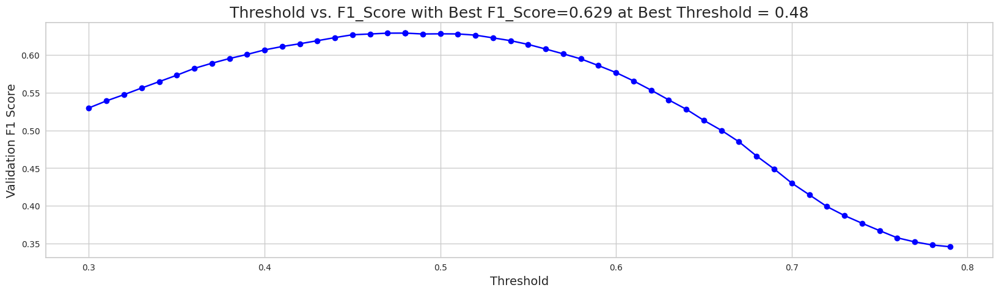

When using optimal threshold = 0.48...
Q0: F1 = 0.629060002986781
==> Overall F1 = 0.629060002986781
s
[I 2023-05-23 04:04:09,787] Trial 7 finished with value: 0.629060002986781 and parameters: {'num_leaves': 14, 'learning_rate': 0.11852209659210595, 'feature_fraction': 0.48272570977976237, 'bagging_fraction': 0.2879148948256897, 'bagging_freq': 2, 'min_child_samples': 59, 'reg_alpha': 2.5448982272387104, 'reg_lambda': 0.009169016497010293, 'subsample': 0.4887401070014804, 'colsample_bytree': 0.7283256943147003, 'min_split_gain': 0.5167452829503993, 'max_depth': 7}. Best is trial 5 with value: 0.6308058524485936.


--------------------------------------------------
question15, with255features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.10149249682596985, subsample=0.5124577316983627 will be ignored. Current value: bagging_fraction=0.10149249682596985
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
[LightGBM] [Warning] feature_fraction is set=0.966794902705896, colsample_bytree=0.13571458261243816 will be ignored. Current value: feature_fraction=0.966794902705896


[LightGBM] [Warning] bagging_fraction is set=0.2710413401107445, subsample=0.16581422387754072 will be ignored. Current value: bagging_fraction=0.2710413401107445
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=8, subsample_freq=0 will be ignored. Current value: bagging_freq=8
[LightGBM] [Warning] feature_fraction is set=0.2411069551609757, colsample_bytree=0.5980531391756778 will be ignored. Current value: feature_fraction=0.2411069551609757


[LightGBM] [Warning] bagging_fraction is set=0.8213489380684104, subsample=0.9116584029727306 will be ignored. Current value: bagging_fraction=0.8213489380684104
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.9058117752868668, colsample_bytree=0.5014880747785012 will be ignored. Current value: feature_fraction=0.9058117752868668


[LightGBM] [Warning] bagging_fraction is set=0.10149249682596985, subsample=0.5124577316983627 will be ignored. Current value: bagging_fraction=0.10149249682596985
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
[LightGBM] [Warning] feature_fraction is set=0.966794902705896, colsample_bytree=0.13571458261243816 will be ignored. Current value: feature_fraction=0.966794902705896


[LightGBM] [Warning] bagging_fraction is set=0.39887917528998307, subsample=0.43808889503253956 will be ignored. Current value: bagging_fraction=0.39887917528998307
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
[LightGBM] [Warning] feature_fraction is set=0.7552097270661808, colsample_bytree=0.16015029410561454 will be ignored. Current value: feature_fraction=0.7552097270661808


[LightGBM] [Warning] bagging_fraction is set=0.10149249682596985, subsample=0.5124577316983627 will be ignored. Current value: bagging_fraction=0.10149249682596985
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
[LightGBM] [Warning] feature_fraction is set=0.966794902705896, colsample_bytree=0.13571458261243816 will be ignored. Current value: feature_fraction=0.966794902705896


,mean
feature,
elapsed_time_diff_std,54.8
elapsed_time_diff_sum,43.6
17_level_counts,43.2
hover_duration_std,43.0
map_click_event_name_counts,42.4
21_level_counts,40.4
room_coor_y_max,39.6
screen_coor_x_mean,39.4
hover_duration_max,37.8


[[0.92587195 0.07412805]
 [0.36486591 0.63513409]
 [0.31557527 0.68442473]
 ...
 [0.32844106 0.67155894]
 [0.37664058 0.62335942]
 [0.44588443 0.55411557]]


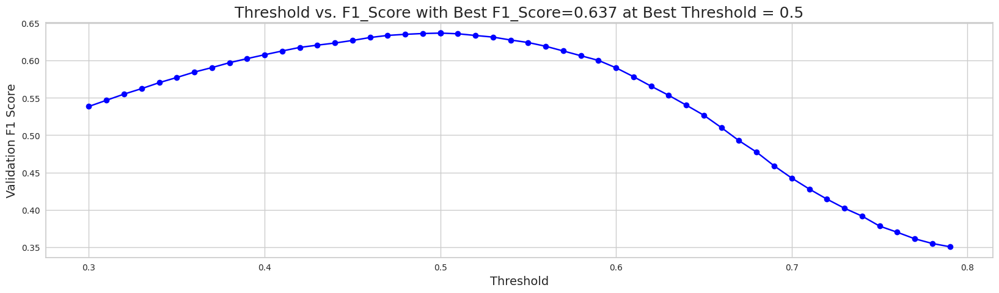

When using optimal threshold = 0.50...
Q0: F1 = 0.6369705874365832
==> Overall F1 = 0.6369705874365832
s
[I 2023-05-23 04:04:26,008] Trial 6 finished with value: 0.6369705874365832 and parameters: {'num_leaves': 14, 'learning_rate': 0.036653281856166245, 'feature_fraction': 0.2411069551609757, 'bagging_fraction': 0.2710413401107445, 'bagging_freq': 8, 'min_child_samples': 43, 'reg_alpha': 0.007811156518312845, 'reg_lambda': 1.0457438694219774, 'subsample': 0.16581422387754072, 'colsample_bytree': 0.5980531391756778, 'min_split_gain': 0.021584136644839724, 'max_depth': 8}. Best is trial 6 with value: 0.6369705874365832.


--------------------------------------------------
question15, with255features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.46885650308008, subsample=0.15849480068044697 will be ignored. Current value: bagging_fraction=0.46885650308008
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=7, subsample_freq=0 will be ignored. Current value: bagging_freq=7
[LightGBM] [Warning] feature_fraction is set=0.20769829127234257, colsample_bytree=0.5193882319958018 will be ignored. Current value: feature_fraction=0.20769829127234257


[LightGBM] [Warning] bagging_fraction is set=0.10149249682596985, subsample=0.5124577316983627 will be ignored. Current value: bagging_fraction=0.10149249682596985
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
[LightGBM] [Warning] feature_fraction is set=0.966794902705896, colsample_bytree=0.13571458261243816 will be ignored. Current value: feature_fraction=0.966794902705896


[LightGBM] [Warning] bagging_fraction is set=0.46885650308008, subsample=0.15849480068044697 will be ignored. Current value: bagging_fraction=0.46885650308008
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=7, subsample_freq=0 will be ignored. Current value: bagging_freq=7
[LightGBM] [Warning] feature_fraction is set=0.20769829127234257, colsample_bytree=0.5193882319958018 will be ignored. Current value: feature_fraction=0.20769829127234257


[LightGBM] [Warning] bagging_fraction is set=0.39887917528998307, subsample=0.43808889503253956 will be ignored. Current value: bagging_fraction=0.39887917528998307
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
[LightGBM] [Warning] feature_fraction is set=0.7552097270661808, colsample_bytree=0.16015029410561454 will be ignored. Current value: feature_fraction=0.7552097270661808


[LightGBM] [Warning] bagging_fraction is set=0.10149249682596985, subsample=0.5124577316983627 will be ignored. Current value: bagging_fraction=0.10149249682596985
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
[LightGBM] [Warning] feature_fraction is set=0.966794902705896, colsample_bytree=0.13571458261243816 will be ignored. Current value: feature_fraction=0.966794902705896


[LightGBM] [Warning] bagging_fraction is set=0.46885650308008, subsample=0.15849480068044697 will be ignored. Current value: bagging_fraction=0.46885650308008
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=7, subsample_freq=0 will be ignored. Current value: bagging_freq=7
[LightGBM] [Warning] feature_fraction is set=0.20769829127234257, colsample_bytree=0.5193882319958018 will be ignored. Current value: feature_fraction=0.20769829127234257


,mean
feature,
17_level_counts,4.2
room_coor_y_max,3.6
hover_duration_sum,3.6
room_coor_x_min,3.2
screen_coor_x_std,3.0
20_level_counts,3.0
screen_coor_y_mean,2.8
room_coor_x_max,2.8
hover_duration_std,2.8


[[0.83270975 0.16729025]
 [0.31177261 0.68822739]
 [0.33125703 0.66874297]
 ...
 [0.47551502 0.52448498]
 [0.2829293  0.7170707 ]
 [0.56426612 0.43573388]]


[LightGBM] [Warning] bagging_fraction is set=0.46885650308008, subsample=0.15849480068044697 will be ignored. Current value: bagging_fraction=0.46885650308008
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=7, subsample_freq=0 will be ignored. Current value: bagging_freq=7
[LightGBM] [Warning] feature_fraction is set=0.20769829127234257, colsample_bytree=0.5193882319958018 will be ignored. Current value: feature_fraction=0.20769829127234257


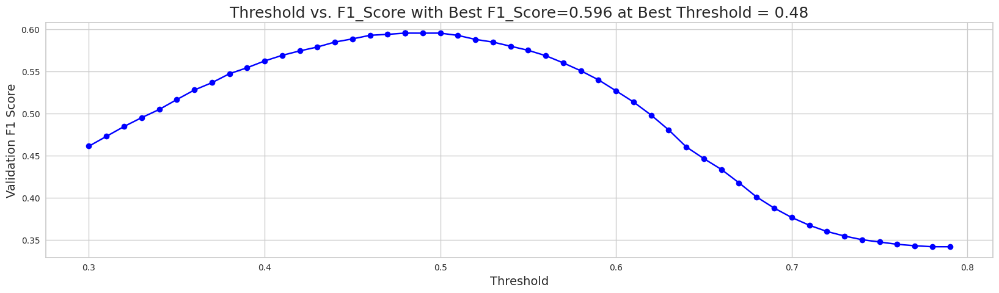

When using optimal threshold = 0.48...
Q0: F1 = 0.595660128936433
==> Overall F1 = 0.595660128936433
s
[I 2023-05-23 04:04:41,882] Trial 9 finished with value: 0.595660128936433 and parameters: {'num_leaves': 47, 'learning_rate': 0.24224784637302155, 'feature_fraction': 0.966794902705896, 'bagging_fraction': 0.10149249682596985, 'bagging_freq': 6, 'min_child_samples': 28, 'reg_alpha': 0.426240070531565, 'reg_lambda': 0.3377891915674581, 'subsample': 0.5124577316983627, 'colsample_bytree': 0.13571458261243816, 'min_split_gain': 0.0291781499290995, 'max_depth': 7}. Best is trial 6 with value: 0.6369705874365832.


--------------------------------------------------
question15, with255features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.12249329353050618, subsample=0.2805068166094273 will be ignored. Current value: bagging_fraction=0.12249329353050618
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
[LightGBM] [Warning] feature_fraction is set=0.5992697608662815, colsample_bytree=0.6187785226902272 will be ignored. Current value: feature_fraction=0.5992697608662815


[LightGBM] [Warning] bagging_fraction is set=0.46885650308008, subsample=0.15849480068044697 will be ignored. Current value: bagging_fraction=0.46885650308008
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=7, subsample_freq=0 will be ignored. Current value: bagging_freq=7
[LightGBM] [Warning] feature_fraction is set=0.20769829127234257, colsample_bytree=0.5193882319958018 will be ignored. Current value: feature_fraction=0.20769829127234257


[LightGBM] [Warning] bagging_fraction is set=0.39887917528998307, subsample=0.43808889503253956 will be ignored. Current value: bagging_fraction=0.39887917528998307
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
[LightGBM] [Warning] feature_fraction is set=0.7552097270661808, colsample_bytree=0.16015029410561454 will be ignored. Current value: feature_fraction=0.7552097270661808


[LightGBM] [Warning] bagging_fraction is set=0.12249329353050618, subsample=0.2805068166094273 will be ignored. Current value: bagging_fraction=0.12249329353050618
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
[LightGBM] [Warning] feature_fraction is set=0.5992697608662815, colsample_bytree=0.6187785226902272 will be ignored. Current value: feature_fraction=0.5992697608662815


,mean
feature,
tunic.flaghouse.entry.flag_girl.symbol_recap_text_fqid_counts,3.6
tunic.historicalsociety.frontdesk.archivist_glasses.confrontation_recap_text_fqid_counts,3.2
map_click_event_name_counts,3.2
directory_fqid_counts,2.8
flag_girl_fqid_counts,2.6
elapsed_time_diff_sum,2.6
screen_corr_x_dff_sum,2.4
tracks_fqid_counts,2.4
tunic.historicalsociety.collection_flag.gramps.recap_text_fqid_counts,2.4


[[0.88595709 0.11404291]
 [0.38657898 0.61342102]
 [0.37290238 0.62709762]
 ...
 [0.31653015 0.68346985]
 [0.26737611 0.73262389]
 [0.43319934 0.56680066]]


[LightGBM] [Warning] bagging_fraction is set=0.12249329353050618, subsample=0.2805068166094273 will be ignored. Current value: bagging_fraction=0.12249329353050618
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
[LightGBM] [Warning] feature_fraction is set=0.5992697608662815, colsample_bytree=0.6187785226902272 will be ignored. Current value: feature_fraction=0.5992697608662815


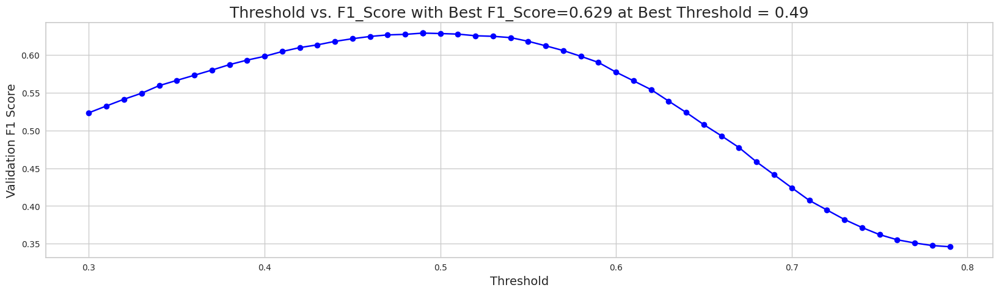

When using optimal threshold = 0.49...
Q0: F1 = 0.6288361638361639
==> Overall F1 = 0.6288361638361639
s
[I 2023-05-23 04:04:51,207] Trial 10 finished with value: 0.6288361638361639 and parameters: {'num_leaves': 17, 'learning_rate': 0.31212814104700115, 'feature_fraction': 0.20769829127234257, 'bagging_fraction': 0.46885650308008, 'bagging_freq': 7, 'min_child_samples': 33, 'reg_alpha': 0.004596824820027795, 'reg_lambda': 0.7150826151176121, 'subsample': 0.15849480068044697, 'colsample_bytree': 0.5193882319958018, 'min_split_gain': 0.005234858002042744, 'max_depth': 3}. Best is trial 6 with value: 0.6369705874365832.


--------------------------------------------------
question15, with255features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.7829800067294361, subsample=0.21647463523776994 will be ignored. Current value: bagging_fraction=0.7829800067294361
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=8, subsample_freq=0 will be ignored. Current value: bagging_freq=8
[LightGBM] [Warning] feature_fraction is set=0.4638445409774984, colsample_bytree=0.9652222259410039 will be ignored. Current value: feature_fraction=0.4638445409774984


[LightGBM] [Warning] bagging_fraction is set=0.12249329353050618, subsample=0.2805068166094273 will be ignored. Current value: bagging_fraction=0.12249329353050618
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
[LightGBM] [Warning] feature_fraction is set=0.5992697608662815, colsample_bytree=0.6187785226902272 will be ignored. Current value: feature_fraction=0.5992697608662815


[LightGBM] [Warning] bagging_fraction is set=0.12249329353050618, subsample=0.2805068166094273 will be ignored. Current value: bagging_fraction=0.12249329353050618
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
[LightGBM] [Warning] feature_fraction is set=0.5992697608662815, colsample_bytree=0.6187785226902272 will be ignored. Current value: feature_fraction=0.5992697608662815


,mean
feature,
session_id,37.0
elapsed_time_diff_std,36.0
screen_coor_x_std,32.2
hover_duration_sum,31.4
room_coor_y_max,31.0
hover_duration_mean,30.8
hover_duration_max,30.6
room_coor_y_min,29.4
elapsed_time_diff_mean,29.2


[[0.88527794 0.11472206]
 [0.37937729 0.62062271]
 [0.32331722 0.67668278]
 ...
 [0.36116881 0.63883119]
 [0.29562016 0.70437984]
 [0.44403201 0.55596799]]


[LightGBM] [Warning] bagging_fraction is set=0.8213489380684104, subsample=0.9116584029727306 will be ignored. Current value: bagging_fraction=0.8213489380684104
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.9058117752868668, colsample_bytree=0.5014880747785012 will be ignored. Current value: feature_fraction=0.9058117752868668


,mean
feature,
room_coor_y_max,2.4
directory_fqid_counts,2.0
tunic.historicalsociety.frontdesk.archivist_glasses.confrontation_recap_text_fqid_counts,2.0
hover_duration_std,1.6
flag_girl_fqid_counts,1.6
map_click_event_name_counts,1.4
journals_flag.pic_0.next_fqid_counts,1.4
tunic.historicalsociety.closet_dirty_room_fqid_counts,1.2
room_corr_x_diff_mean,1.2


[[0.75792359 0.24207641]
 [0.41458002 0.58541998]
 [0.40098472 0.59901528]
 ...
 [0.27382699 0.72617301]
 [0.29147621 0.70852379]
 [0.47426914 0.52573086]]


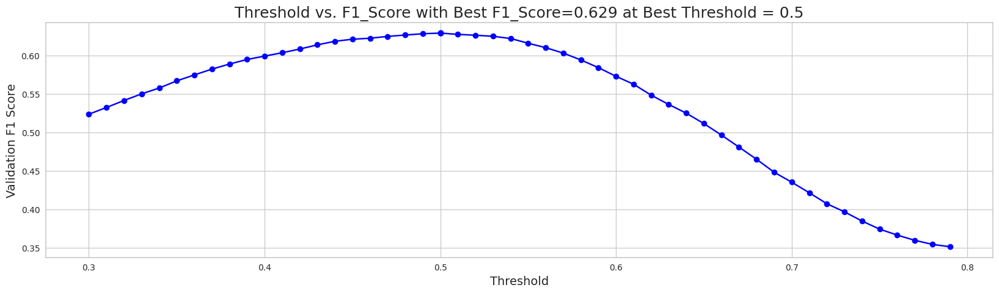

When using optimal threshold = 0.50...
Q0: F1 = 0.628873005866122
==> Overall F1 = 0.628873005866122
s
[I 2023-05-23 04:05:02,074] Trial 8 finished with value: 0.628873005866122 and parameters: {'num_leaves': 66, 'learning_rate': 0.08370092166205566, 'feature_fraction': 0.7552097270661808, 'bagging_fraction': 0.39887917528998307, 'bagging_freq': 5, 'min_child_samples': 60, 'reg_alpha': 0.0011589890731077915, 'reg_lambda': 0.6907283777509988, 'subsample': 0.43808889503253956, 'colsample_bytree': 0.16015029410561454, 'min_split_gain': 0.025494232633581124, 'max_depth': 0}. Best is trial 6 with value: 0.6369705874365832.


--------------------------------------------------
question15, with255features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.737865673358852, subsample=0.10050584380541806 will be ignored. Current value: bagging_fraction=0.737865673358852
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
[LightGBM] [Warning] feature_fraction is set=0.13252754703073272, colsample_bytree=0.6962615129803755 will be ignored. Current value: feature_fraction=0.13252754703073272


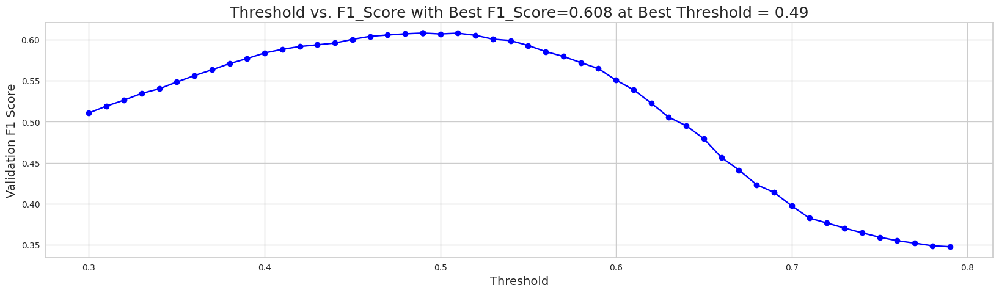

When using optimal threshold = 0.49...
Q0: F1 = 0.6080839227186474
==> Overall F1 = 0.6080839227186474
s
[I 2023-05-23 04:05:05,866] Trial 11 finished with value: 0.6080839227186474 and parameters: {'num_leaves': 48, 'learning_rate': 0.40216698762521175, 'feature_fraction': 0.5992697608662815, 'bagging_fraction': 0.12249329353050618, 'bagging_freq': 5, 'min_child_samples': 22, 'reg_alpha': 0.002113855556412078, 'reg_lambda': 0.004373291261301336, 'subsample': 0.2805068166094273, 'colsample_bytree': 0.6187785226902272, 'min_split_gain': 0.012266585425701535, 'max_depth': 4}. Best is trial 6 with value: 0.6369705874365832.


--------------------------------------------------
question15, with255features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.6719231336652957, subsample=0.11559438088250495 will be ignored. Current value: bagging_fraction=0.6719231336652957
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=8, subsample_freq=0 will be ignored. Current value: bagging_freq=8
[LightGBM] [Warning] feature_fraction is set=0.3223444693467896, colsample_bytree=0.7841942046434408 will be ignored. Current value: feature_fraction=0.3223444693467896


[LightGBM] [Warning] bagging_fraction is set=0.6719231336652957, subsample=0.11559438088250495 will be ignored. Current value: bagging_fraction=0.6719231336652957
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=8, subsample_freq=0 will be ignored. Current value: bagging_freq=8
[LightGBM] [Warning] feature_fraction is set=0.3223444693467896, colsample_bytree=0.7841942046434408 will be ignored. Current value: feature_fraction=0.3223444693467896
[LightGBM] [Warning] bagging_fraction is set=0.737865673358852, subsample=0.10050584380541806 will be ignored. Current value: bagging_fraction=0.737865673358852
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
[LightGBM] [Warning] fe

[LightGBM] [Warning] bagging_fraction is set=0.7829800067294361, subsample=0.21647463523776994 will be ignored. Current value: bagging_fraction=0.7829800067294361
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=8, subsample_freq=0 will be ignored. Current value: bagging_freq=8
[LightGBM] [Warning] feature_fraction is set=0.4638445409774984, colsample_bytree=0.9652222259410039 will be ignored. Current value: feature_fraction=0.4638445409774984


[LightGBM] [Warning] bagging_fraction is set=0.8213489380684104, subsample=0.9116584029727306 will be ignored. Current value: bagging_fraction=0.8213489380684104
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.9058117752868668, colsample_bytree=0.5014880747785012 will be ignored. Current value: feature_fraction=0.9058117752868668


[LightGBM] [Warning] bagging_fraction is set=0.6719231336652957, subsample=0.11559438088250495 will be ignored. Current value: bagging_fraction=0.6719231336652957
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=8, subsample_freq=0 will be ignored. Current value: bagging_freq=8
[LightGBM] [Warning] feature_fraction is set=0.3223444693467896, colsample_bytree=0.7841942046434408 will be ignored. Current value: feature_fraction=0.3223444693467896


[LightGBM] [Warning] bagging_fraction is set=0.737865673358852, subsample=0.10050584380541806 will be ignored. Current value: bagging_fraction=0.737865673358852
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
[LightGBM] [Warning] feature_fraction is set=0.13252754703073272, colsample_bytree=0.6962615129803755 will be ignored. Current value: feature_fraction=0.13252754703073272


[LightGBM] [Warning] bagging_fraction is set=0.7829800067294361, subsample=0.21647463523776994 will be ignored. Current value: bagging_fraction=0.7829800067294361
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=8, subsample_freq=0 will be ignored. Current value: bagging_freq=8
[LightGBM] [Warning] feature_fraction is set=0.4638445409774984, colsample_bytree=0.9652222259410039 will be ignored. Current value: feature_fraction=0.4638445409774984


[LightGBM] [Warning] bagging_fraction is set=0.6719231336652957, subsample=0.11559438088250495 will be ignored. Current value: bagging_fraction=0.6719231336652957
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=8, subsample_freq=0 will be ignored. Current value: bagging_freq=8
[LightGBM] [Warning] feature_fraction is set=0.3223444693467896, colsample_bytree=0.7841942046434408 will be ignored. Current value: feature_fraction=0.3223444693467896


[LightGBM] [Warning] bagging_fraction is set=0.737865673358852, subsample=0.10050584380541806 will be ignored. Current value: bagging_fraction=0.737865673358852
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
[LightGBM] [Warning] feature_fraction is set=0.13252754703073272, colsample_bytree=0.6962615129803755 will be ignored. Current value: feature_fraction=0.13252754703073272


[LightGBM] [Warning] bagging_fraction is set=0.6719231336652957, subsample=0.11559438088250495 will be ignored. Current value: bagging_fraction=0.6719231336652957
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=8, subsample_freq=0 will be ignored. Current value: bagging_freq=8
[LightGBM] [Warning] feature_fraction is set=0.3223444693467896, colsample_bytree=0.7841942046434408 will be ignored. Current value: feature_fraction=0.3223444693467896


[LightGBM] [Warning] bagging_fraction is set=0.7829800067294361, subsample=0.21647463523776994 will be ignored. Current value: bagging_fraction=0.7829800067294361
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=8, subsample_freq=0 will be ignored. Current value: bagging_freq=8
[LightGBM] [Warning] feature_fraction is set=0.4638445409774984, colsample_bytree=0.9652222259410039 will be ignored. Current value: feature_fraction=0.4638445409774984


,mean
feature,
elapsed_time_diff_std,371.2
17_level_counts,343.8
screen_coor_x_mean,324.8
20_level_counts,308.4
room_coor_y_max,300.0
savedteddy_fqid_counts,299.4
screen_coor_x_std,298.8
room_coor_x_max,283.6
hover_duration_max,282.6


[[0.91300799 0.08699201]
 [0.39035834 0.60964166]
 [0.34382761 0.65617239]
 ...
 [0.2950638  0.7049362 ]
 [0.28705407 0.71294593]
 [0.46958649 0.53041351]]


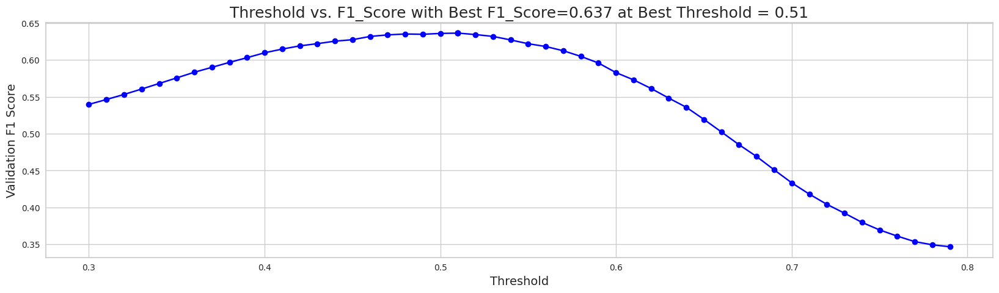

When using optimal threshold = 0.51...
Q0: F1 = 0.6365798187223832
==> Overall F1 = 0.6365798187223832
s
[I 2023-05-23 04:06:45,947] Trial 0 finished with value: 0.6365798187223832 and parameters: {'num_leaves': 50, 'learning_rate': 0.012980285525062571, 'feature_fraction': 0.9058117752868668, 'bagging_fraction': 0.8213489380684104, 'bagging_freq': 2, 'min_child_samples': 52, 'reg_alpha': 1.2275333826111632, 'reg_lambda': 3.9620006943066026, 'subsample': 0.9116584029727306, 'colsample_bytree': 0.5014880747785012, 'min_split_gain': 0.005066437440794163, 'max_depth': 6}. Best is trial 6 with value: 0.6369705874365832.


--------------------------------------------------
question15, with255features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.827730497391766, subsample=0.67652802993807 will be ignored. Current value: bagging_fraction=0.827730497391766
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.8699319950848861, colsample_bytree=0.3764769157106852 will be ignored. Current value: feature_fraction=0.8699319950848861


,mean
feature,
hover_duration_mean,171.8
hover_duration_sum,168.2
elapsed_time_diff_sum,167.8
elapsed_time_diff_std,149.0
hover_duration_max,147.4
session_id,146.0
room_coor_x_std,145.4
screen_coor_x_mean,145.2
screen_coor_x_std,143.2


[[0.90798462 0.09201538]
 [0.37550758 0.62449242]
 [0.33495958 0.66504042]
 ...
 [0.30753197 0.69246803]
 [0.30132386 0.69867614]
 [0.45812326 0.54187674]]


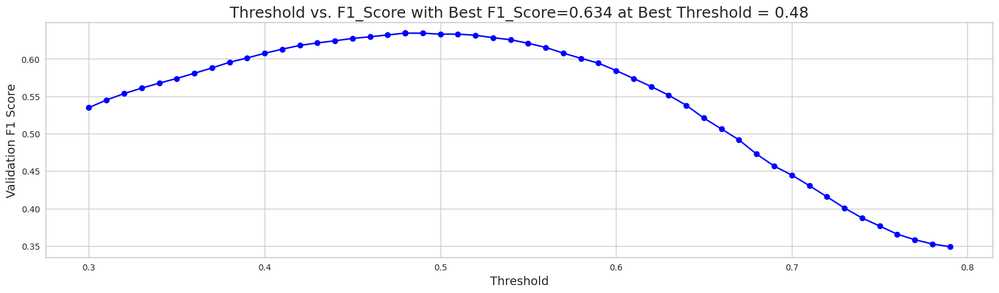

When using optimal threshold = 0.48...
Q0: F1 = 0.6344861822088032
==> Overall F1 = 0.6344861822088032
s
[I 2023-05-23 04:06:55,087] Trial 14 finished with value: 0.6344861822088032 and parameters: {'num_leaves': 73, 'learning_rate': 0.03618392030099685, 'feature_fraction': 0.3223444693467896, 'bagging_fraction': 0.6719231336652957, 'bagging_freq': 8, 'min_child_samples': 98, 'reg_alpha': 0.019906267393595852, 'reg_lambda': 8.994303768334431, 'subsample': 0.11559438088250495, 'colsample_bytree': 0.7841942046434408, 'min_split_gain': 0.002164510165741156, 'max_depth': 10}. Best is trial 6 with value: 0.6369705874365832.


--------------------------------------------------
question15, with255features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.9463005007146545, subsample=0.6633249383391513 will be ignored. Current value: bagging_fraction=0.9463005007146545
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.95291599863753, colsample_bytree=0.3262308376856651 will be ignored. Current value: feature_fraction=0.95291599863753


[LightGBM] [Warning] bagging_fraction is set=0.737865673358852, subsample=0.10050584380541806 will be ignored. Current value: bagging_fraction=0.737865673358852
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
[LightGBM] [Warning] feature_fraction is set=0.13252754703073272, colsample_bytree=0.6962615129803755 will be ignored. Current value: feature_fraction=0.13252754703073272


[LightGBM] [Warning] bagging_fraction is set=0.7829800067294361, subsample=0.21647463523776994 will be ignored. Current value: bagging_fraction=0.7829800067294361
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=8, subsample_freq=0 will be ignored. Current value: bagging_freq=8
[LightGBM] [Warning] feature_fraction is set=0.4638445409774984, colsample_bytree=0.9652222259410039 will be ignored. Current value: feature_fraction=0.4638445409774984


[LightGBM] [Warning] bagging_fraction is set=0.827730497391766, subsample=0.67652802993807 will be ignored. Current value: bagging_fraction=0.827730497391766
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.8699319950848861, colsample_bytree=0.3764769157106852 will be ignored. Current value: feature_fraction=0.8699319950848861


,mean
feature,
elapsed_time_diff_std,293.4
17_level_counts,251.2
hover_duration_sum,248.2
screen_coor_x_std,248.0
room_coor_y_max,247.8
hover_duration_mean,246.6
20_level_counts,234.8
session_id,233.4
screen_coor_x_mean,230.0


,mean
feature,
room_corr_y_diff_mean,384.2
room_coor_x_std,377.6
elapsed_time_diff_mean,369.0
room_coor_y_max,362.4
hover_duration_max,358.2
hover_duration_sum,356.4
17_level_counts,328.8
hover_duration_std,327.8
screen_corr_x_dff_std,303.4


[[0.89895471 0.10104529]
 [0.35514784 0.64485216]
 [0.31297506 0.68702494]
 ...
 [0.28470571 0.71529429]
 [0.28121954 0.71878046]
 [0.4750187  0.5249813 ]]


[[0.89529103 0.10470897]
 [0.41743827 0.58256173]
 [0.34425319 0.65574681]
 ...
 [0.25762331 0.74237669]
 [0.30244315 0.69755685]
 [0.46556596 0.53443404]]


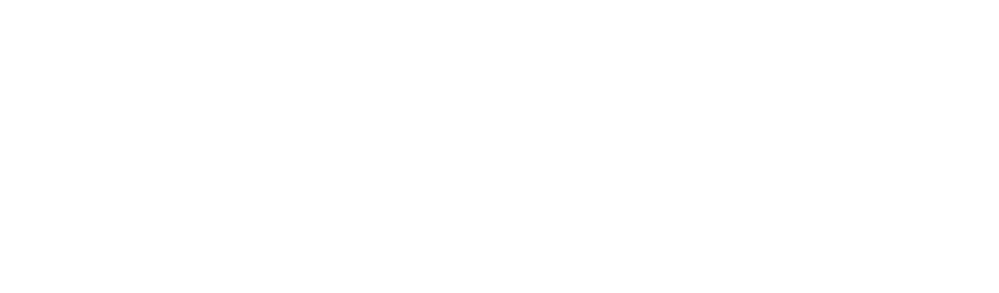

When using optimal threshold = 0.49...
Q0: F1 = 0.637437883914669
==> Overall F1 = 0.637437883914669
s
[I 2023-05-23 04:07:46,639] Trial 12 finished with value: 0.637437883914669 and parameters: {'num_leaves': 77, 'learning_rate': 0.01890599811356638, 'feature_fraction': 0.4638445409774984, 'bagging_fraction': 0.7829800067294361, 'bagging_freq': 8, 'min_child_samples': 30, 'reg_alpha': 2.3447894223470023, 'reg_lambda': 0.00753930929137051, 'subsample': 0.21647463523776994, 'colsample_bytree': 0.9652222259410039, 'min_split_gain': 0.0021590478134455157, 'max_depth': 6}. Best is trial 12 with value: 0.637437883914669.


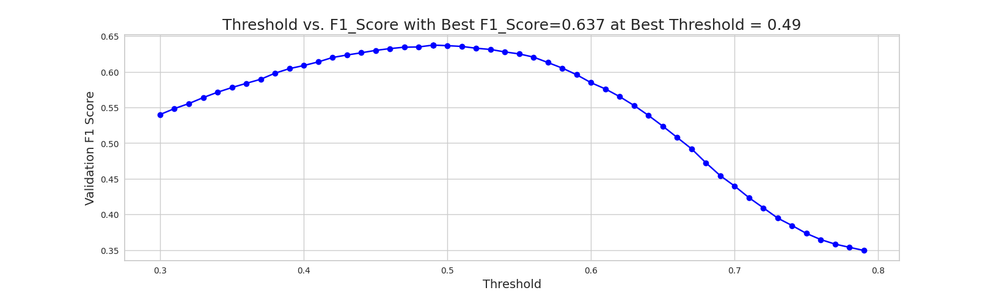

--------------------------------------------------
question15, with255features
--------------------------------------------------


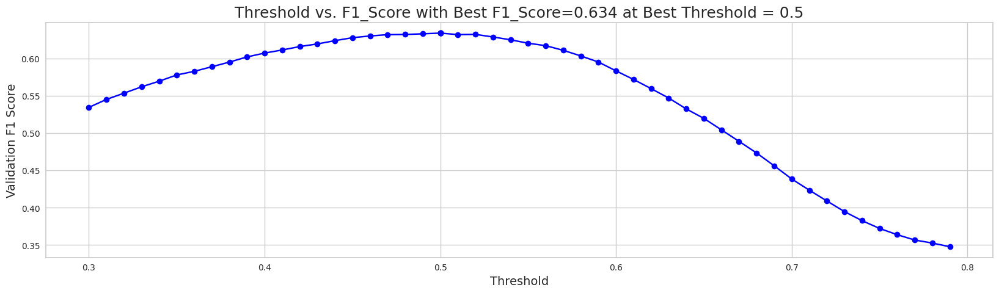

When using optimal threshold = 0.50...
Q0: F1 = 0.6344656522680632
==> Overall F1 = 0.6344656522680632
s
[I 2023-05-23 04:07:49,465] Trial 13 finished with value: 0.6344656522680632 and parameters: {'num_leaves': 65, 'learning_rate': 0.0228135260743243, 'feature_fraction': 0.13252754703073272, 'bagging_fraction': 0.737865673358852, 'bagging_freq': 4, 'min_child_samples': 5, 'reg_alpha': 0.0396041981424295, 'reg_lambda': 6.933765707684574, 'subsample': 0.10050584380541806, 'colsample_bytree': 0.6962615129803755, 'min_split_gain': 0.001871760626663943, 'max_depth': -1}. Best is trial 12 with value: 0.637437883914669.


[LightGBM] [Warning] bagging_fraction is set=0.9513536282258912, subsample=0.26676444227025997 will be ignored. Current value: bagging_fraction=0.9513536282258912
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=10, subsample_freq=0 will be ignored. Current value: bagging_freq=10
[LightGBM] [Warning] feature_fraction is set=0.10849070714071687, colsample_bytree=0.9926085639224289 will be ignored. Current value: feature_fraction=0.10849070714071687
--------------------------------------------------
question15, with255features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.9859012420534208, subsample=0.2966907890772696 will be ignored. Current value: bagging_fraction=0.9859012420534208
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=10, subsample_freq=0 will be ignored. Current value: bagging_freq=10
[LightGBM] [Warning] feature_fraction is set=0.3313310944870177, colsample_bytree=0.9983929082083709 will be ignored. Current value: feature_fraction=0.3313310944870177


[LightGBM] [Warning] bagging_fraction is set=0.9859012420534208, subsample=0.2966907890772696 will be ignored. Current value: bagging_fraction=0.9859012420534208
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=10, subsample_freq=0 will be ignored. Current value: bagging_freq=10
[LightGBM] [Warning] feature_fraction is set=0.3313310944870177, colsample_bytree=0.9983929082083709 will be ignored. Current value: feature_fraction=0.3313310944870177


[LightGBM] [Warning] bagging_fraction is set=0.9513536282258912, subsample=0.26676444227025997 will be ignored. Current value: bagging_fraction=0.9513536282258912
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=10, subsample_freq=0 will be ignored. Current value: bagging_freq=10
[LightGBM] [Warning] feature_fraction is set=0.10849070714071687, colsample_bytree=0.9926085639224289 will be ignored. Current value: feature_fraction=0.10849070714071687


[LightGBM] [Warning] bagging_fraction is set=0.827730497391766, subsample=0.67652802993807 will be ignored. Current value: bagging_fraction=0.827730497391766
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.8699319950848861, colsample_bytree=0.3764769157106852 will be ignored. Current value: feature_fraction=0.8699319950848861


[LightGBM] [Warning] bagging_fraction is set=0.9463005007146545, subsample=0.6633249383391513 will be ignored. Current value: bagging_fraction=0.9463005007146545
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.95291599863753, colsample_bytree=0.3262308376856651 will be ignored. Current value: feature_fraction=0.95291599863753


[LightGBM] [Warning] bagging_fraction is set=0.9859012420534208, subsample=0.2966907890772696 will be ignored. Current value: bagging_fraction=0.9859012420534208
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=10, subsample_freq=0 will be ignored. Current value: bagging_freq=10
[LightGBM] [Warning] feature_fraction is set=0.3313310944870177, colsample_bytree=0.9983929082083709 will be ignored. Current value: feature_fraction=0.3313310944870177


[LightGBM] [Warning] bagging_fraction is set=0.9513536282258912, subsample=0.26676444227025997 will be ignored. Current value: bagging_fraction=0.9513536282258912
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=10, subsample_freq=0 will be ignored. Current value: bagging_freq=10
[LightGBM] [Warning] feature_fraction is set=0.10849070714071687, colsample_bytree=0.9926085639224289 will be ignored. Current value: feature_fraction=0.10849070714071687


[LightGBM] [Warning] bagging_fraction is set=0.9859012420534208, subsample=0.2966907890772696 will be ignored. Current value: bagging_fraction=0.9859012420534208
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=10, subsample_freq=0 will be ignored. Current value: bagging_freq=10
[LightGBM] [Warning] feature_fraction is set=0.3313310944870177, colsample_bytree=0.9983929082083709 will be ignored. Current value: feature_fraction=0.3313310944870177


[LightGBM] [Warning] bagging_fraction is set=0.9859012420534208, subsample=0.2966907890772696 will be ignored. Current value: bagging_fraction=0.9859012420534208
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=10, subsample_freq=0 will be ignored. Current value: bagging_freq=10
[LightGBM] [Warning] feature_fraction is set=0.3313310944870177, colsample_bytree=0.9983929082083709 will be ignored. Current value: feature_fraction=0.3313310944870177


[LightGBM] [Warning] bagging_fraction is set=0.827730497391766, subsample=0.67652802993807 will be ignored. Current value: bagging_fraction=0.827730497391766
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.8699319950848861, colsample_bytree=0.3764769157106852 will be ignored. Current value: feature_fraction=0.8699319950848861


[LightGBM] [Warning] bagging_fraction is set=0.9513536282258912, subsample=0.26676444227025997 will be ignored. Current value: bagging_fraction=0.9513536282258912
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=10, subsample_freq=0 will be ignored. Current value: bagging_freq=10
[LightGBM] [Warning] feature_fraction is set=0.10849070714071687, colsample_bytree=0.9926085639224289 will be ignored. Current value: feature_fraction=0.10849070714071687


,mean
feature,
elapsed_time_diff_std,179.8
hover_duration_max,163.0
screen_coor_x_std,159.0
hover_duration_std,156.4
17_level_counts,153.8
elapsed_time_diff_sum,146.6
screen_coor_x_mean,144.4
21_level_counts,139.8
hover_duration_sum,139.8


[[0.91133778 0.08866222]
 [0.39529822 0.60470178]
 [0.35550051 0.64449949]
 ...
 [0.33029918 0.66970082]
 [0.2811258  0.7188742 ]
 [0.49558792 0.50441208]]


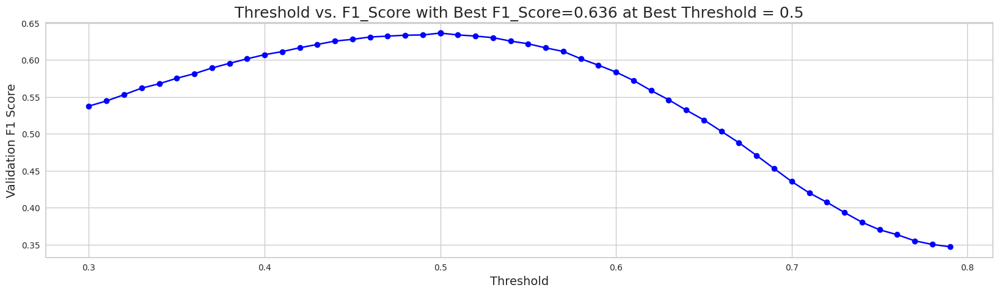

When using optimal threshold = 0.50...
Q0: F1 = 0.6362947273712787
==> Overall F1 = 0.6362947273712787
s
[I 2023-05-23 04:09:26,321] Trial 18 finished with value: 0.6362947273712787 and parameters: {'num_leaves': 78, 'learning_rate': 0.04252358872006941, 'feature_fraction': 0.3313310944870177, 'bagging_fraction': 0.9859012420534208, 'bagging_freq': 10, 'min_child_samples': 43, 'reg_alpha': 4.5653501020550955, 'reg_lambda': 0.0013261535261523264, 'subsample': 0.2966907890772696, 'colsample_bytree': 0.9983929082083709, 'min_split_gain': 0.0010650549124355108, 'max_depth': 8}. Best is trial 12 with value: 0.637437883914669.


--------------------------------------------------
question15, with255features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.6240687224316223, subsample=0.28939613059285363 will be ignored. Current value: bagging_fraction=0.6240687224316223
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=9, subsample_freq=0 will be ignored. Current value: bagging_freq=9
[LightGBM] [Warning] feature_fraction is set=0.2766989646367859, colsample_bytree=0.8622888144076278 will be ignored. Current value: feature_fraction=0.2766989646367859


[LightGBM] [Warning] bagging_fraction is set=0.9513536282258912, subsample=0.26676444227025997 will be ignored. Current value: bagging_fraction=0.9513536282258912
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=10, subsample_freq=0 will be ignored. Current value: bagging_freq=10
[LightGBM] [Warning] feature_fraction is set=0.10849070714071687, colsample_bytree=0.9926085639224289 will be ignored. Current value: feature_fraction=0.10849070714071687


[LightGBM] [Warning] bagging_fraction is set=0.827730497391766, subsample=0.67652802993807 will be ignored. Current value: bagging_fraction=0.827730497391766
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.8699319950848861, colsample_bytree=0.3764769157106852 will be ignored. Current value: feature_fraction=0.8699319950848861


[LightGBM] [Warning] bagging_fraction is set=0.9463005007146545, subsample=0.6633249383391513 will be ignored. Current value: bagging_fraction=0.9463005007146545
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.95291599863753, colsample_bytree=0.3262308376856651 will be ignored. Current value: feature_fraction=0.95291599863753


,mean
feature,
elapsed_time_diff_mean,399.0
hover_duration_std,389.8
room_coor_x_std,388.8
room_corr_x_diff_std,387.8
17_level_counts,357.4
room_corr_y_diff_mean,340.0
screen_coor_y_max,339.8
room_coor_y_max,331.0
21_level_counts,309.8


[[0.90970728 0.09029272]
 [0.40259908 0.59740092]
 [0.40566607 0.59433393]
 ...
 [0.27500057 0.72499943]
 [0.28214477 0.71785523]
 [0.45069001 0.54930999]]


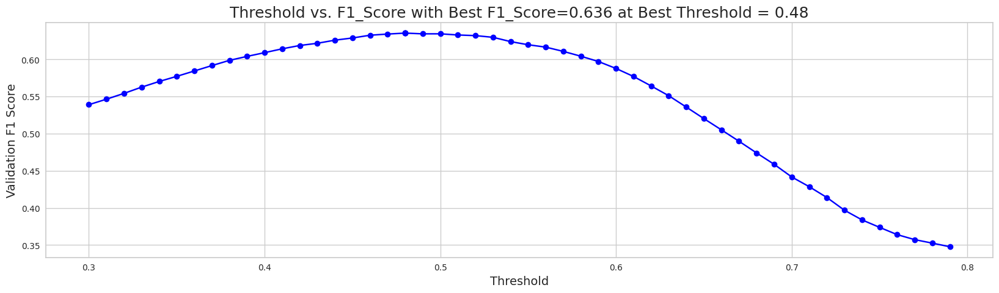

When using optimal threshold = 0.48...
Q0: F1 = 0.6355580583179705
==> Overall F1 = 0.6355580583179705
s
[I 2023-05-23 04:09:59,415] Trial 17 finished with value: 0.6355580583179705 and parameters: {'num_leaves': 69, 'learning_rate': 0.031204770650209882, 'feature_fraction': 0.10849070714071687, 'bagging_fraction': 0.9513536282258912, 'bagging_freq': 10, 'min_child_samples': 5, 'reg_alpha': 6.181988395077079, 'reg_lambda': 0.0015284822582705487, 'subsample': 0.26676444227025997, 'colsample_bytree': 0.9926085639224289, 'min_split_gain': 0.0010905300816653931, 'max_depth': 6}. Best is trial 12 with value: 0.637437883914669.


--------------------------------------------------
question15, with255features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.6138829611848539, subsample=0.37549295878749345 will be ignored. Current value: bagging_fraction=0.6138829611848539
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=8, subsample_freq=0 will be ignored. Current value: bagging_freq=8
[LightGBM] [Warning] feature_fraction is set=0.28432420787512414, colsample_bytree=0.6375594577639372 will be ignored. Current value: feature_fraction=0.28432420787512414


[LightGBM] [Warning] bagging_fraction is set=0.6240687224316223, subsample=0.28939613059285363 will be ignored. Current value: bagging_fraction=0.6240687224316223
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=9, subsample_freq=0 will be ignored. Current value: bagging_freq=9
[LightGBM] [Warning] feature_fraction is set=0.2766989646367859, colsample_bytree=0.8622888144076278 will be ignored. Current value: feature_fraction=0.2766989646367859


[LightGBM] [Warning] bagging_fraction is set=0.6138829611848539, subsample=0.37549295878749345 will be ignored. Current value: bagging_fraction=0.6138829611848539
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=8, subsample_freq=0 will be ignored. Current value: bagging_freq=8
[LightGBM] [Warning] feature_fraction is set=0.28432420787512414, colsample_bytree=0.6375594577639372 will be ignored. Current value: feature_fraction=0.28432420787512414


,mean
feature,
elapsed_time_diff_std,418.6
17_level_counts,344.8
screen_coor_x_std,328.2
screen_coor_x_mean,327.2
hover_duration_max,317.6
room_coor_y_max,312.6
session_id,307.4
20_level_counts,303.4
hover_duration_sum,303.0


[[0.89975794 0.10024206]
 [0.39399192 0.60600808]
 [0.33428093 0.66571907]
 ...
 [0.30284248 0.69715752]
 [0.26681015 0.73318985]
 [0.44374549 0.55625451]]


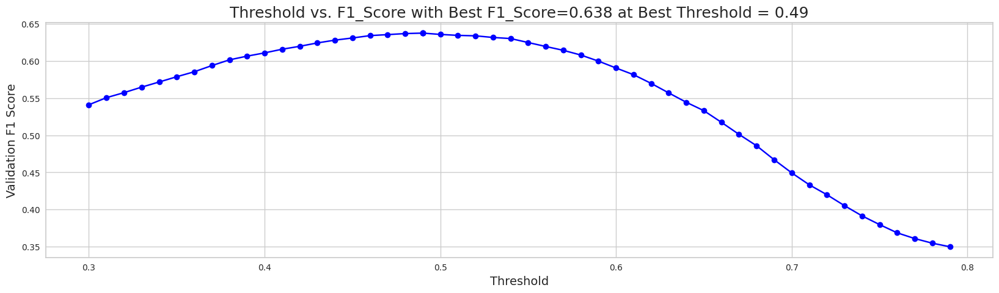

When using optimal threshold = 0.49...
Q0: F1 = 0.6375464841428062
==> Overall F1 = 0.6375464841428062
s
[I 2023-05-23 04:10:49,634] Trial 15 finished with value: 0.6375464841428062 and parameters: {'num_leaves': 66, 'learning_rate': 0.017189261031164034, 'feature_fraction': 0.8699319950848861, 'bagging_fraction': 0.827730497391766, 'bagging_freq': 1, 'min_child_samples': 79, 'reg_alpha': 8.510045153075293, 'reg_lambda': 7.295569594534324, 'subsample': 0.67652802993807, 'colsample_bytree': 0.3764769157106852, 'min_split_gain': 0.0015039510846668906, 'max_depth': 6}. Best is trial 15 with value: 0.6375464841428062.


--------------------------------------------------
question15, with255features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.869261835458113, subsample=0.6399176348447947 will be ignored. Current value: bagging_fraction=0.869261835458113
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.8302988619514137, colsample_bytree=0.3904172741180267 will be ignored. Current value: feature_fraction=0.8302988619514137


[LightGBM] [Warning] bagging_fraction is set=0.6240687224316223, subsample=0.28939613059285363 will be ignored. Current value: bagging_fraction=0.6240687224316223
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=9, subsample_freq=0 will be ignored. Current value: bagging_freq=9
[LightGBM] [Warning] feature_fraction is set=0.2766989646367859, colsample_bytree=0.8622888144076278 will be ignored. Current value: feature_fraction=0.2766989646367859


[LightGBM] [Warning] bagging_fraction is set=0.9463005007146545, subsample=0.6633249383391513 will be ignored. Current value: bagging_fraction=0.9463005007146545
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.95291599863753, colsample_bytree=0.3262308376856651 will be ignored. Current value: feature_fraction=0.95291599863753


[LightGBM] [Warning] bagging_fraction is set=0.6138829611848539, subsample=0.37549295878749345 will be ignored. Current value: bagging_fraction=0.6138829611848539
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=8, subsample_freq=0 will be ignored. Current value: bagging_freq=8
[LightGBM] [Warning] feature_fraction is set=0.28432420787512414, colsample_bytree=0.6375594577639372 will be ignored. Current value: feature_fraction=0.28432420787512414


[LightGBM] [Warning] bagging_fraction is set=0.6240687224316223, subsample=0.28939613059285363 will be ignored. Current value: bagging_fraction=0.6240687224316223
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=9, subsample_freq=0 will be ignored. Current value: bagging_freq=9
[LightGBM] [Warning] feature_fraction is set=0.2766989646367859, colsample_bytree=0.8622888144076278 will be ignored. Current value: feature_fraction=0.2766989646367859


[LightGBM] [Warning] bagging_fraction is set=0.6138829611848539, subsample=0.37549295878749345 will be ignored. Current value: bagging_fraction=0.6138829611848539
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=8, subsample_freq=0 will be ignored. Current value: bagging_freq=8
[LightGBM] [Warning] feature_fraction is set=0.28432420787512414, colsample_bytree=0.6375594577639372 will be ignored. Current value: feature_fraction=0.28432420787512414


[LightGBM] [Warning] bagging_fraction is set=0.869261835458113, subsample=0.6399176348447947 will be ignored. Current value: bagging_fraction=0.869261835458113
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.8302988619514137, colsample_bytree=0.3904172741180267 will be ignored. Current value: feature_fraction=0.8302988619514137


[LightGBM] [Warning] bagging_fraction is set=0.9463005007146545, subsample=0.6633249383391513 will be ignored. Current value: bagging_fraction=0.9463005007146545
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.95291599863753, colsample_bytree=0.3262308376856651 will be ignored. Current value: feature_fraction=0.95291599863753


[LightGBM] [Warning] bagging_fraction is set=0.6240687224316223, subsample=0.28939613059285363 will be ignored. Current value: bagging_fraction=0.6240687224316223
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=9, subsample_freq=0 will be ignored. Current value: bagging_freq=9
[LightGBM] [Warning] feature_fraction is set=0.2766989646367859, colsample_bytree=0.8622888144076278 will be ignored. Current value: feature_fraction=0.2766989646367859


[LightGBM] [Warning] bagging_fraction is set=0.6138829611848539, subsample=0.37549295878749345 will be ignored. Current value: bagging_fraction=0.6138829611848539
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=8, subsample_freq=0 will be ignored. Current value: bagging_freq=8
[LightGBM] [Warning] feature_fraction is set=0.28432420787512414, colsample_bytree=0.6375594577639372 will be ignored. Current value: feature_fraction=0.28432420787512414


,mean
feature,
tunic.historicalsociety.frontdesk.archivist_glasses.confrontation_recap_text_fqid_counts,101.8
map_click_event_name_counts,81.4
6_page_counts,81.2
elapsed_time_diff_std,67.4
journals_flag.pic_0.next_fqid_counts,67.2
flag_girl_fqid_counts,64.4
directory.closeup.archivist_fqid_counts,54.8
directory_fqid_counts,54.2
tunic.historicalsociety.collection_flag.gramps.recap_text_fqid_counts,47.4


[[0.89417909 0.10582091]
 [0.37289377 0.62710623]
 [0.37270415 0.62729585]
 ...
 [0.30835311 0.69164689]
 [0.33647214 0.66352786]
 [0.46423568 0.53576432]]


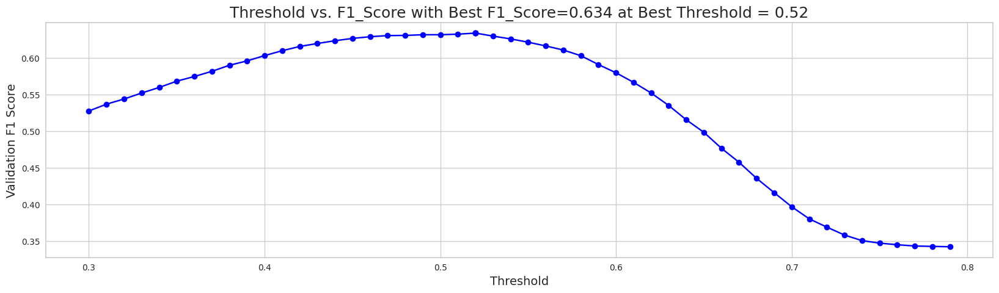

When using optimal threshold = 0.52...
Q0: F1 = 0.6338539809484998
==> Overall F1 = 0.6338539809484998
s
[I 2023-05-23 04:12:55,287] Trial 20 finished with value: 0.6338539809484998 and parameters: {'num_leaves': 31, 'learning_rate': 0.010778367536905385, 'feature_fraction': 0.28432420787512414, 'bagging_fraction': 0.6138829611848539, 'bagging_freq': 8, 'min_child_samples': 77, 'reg_alpha': 0.19722862506744554, 'reg_lambda': 0.08349303112822738, 'subsample': 0.37549295878749345, 'colsample_bytree': 0.6375594577639372, 'min_split_gain': 0.0032355761788252194, 'max_depth': 1}. Best is trial 15 with value: 0.6375464841428062.


--------------------------------------------------
question15, with255features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.8330376134474197, subsample=0.6847544289951046 will be ignored. Current value: bagging_fraction=0.8330376134474197
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.8229113927814417, colsample_bytree=0.4065241611570263 will be ignored. Current value: feature_fraction=0.8229113927814417


[LightGBM] [Warning] bagging_fraction is set=0.869261835458113, subsample=0.6399176348447947 will be ignored. Current value: bagging_fraction=0.869261835458113
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.8302988619514137, colsample_bytree=0.3904172741180267 will be ignored. Current value: feature_fraction=0.8302988619514137


,mean
feature,
elapsed_time_diff_std,445.8
hover_duration_sum,395.2
elapsed_time_diff_sum,390.0
hover_duration_max,363.2
hover_duration_mean,358.2
hover_duration_std,352.8
21_level_counts,347.8
17_level_counts,346.0
elapsed_time_diff_mean,343.8


[[0.90736187 0.09263813]
 [0.38919499 0.61080501]
 [0.33970459 0.66029541]
 ...
 [0.28617043 0.71382957]
 [0.30155137 0.69844863]
 [0.45041362 0.54958638]]


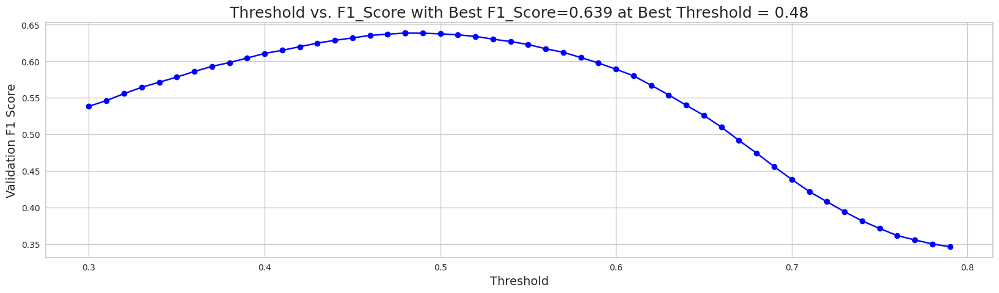

When using optimal threshold = 0.48...
Q0: F1 = 0.6385180194746567
==> Overall F1 = 0.6385180194746567
s
[I 2023-05-23 04:13:23,044] Trial 19 finished with value: 0.6385180194746567 and parameters: {'num_leaves': 32, 'learning_rate': 0.01083839807760153, 'feature_fraction': 0.2766989646367859, 'bagging_fraction': 0.6240687224316223, 'bagging_freq': 9, 'min_child_samples': 82, 'reg_alpha': 8.442318454101708, 'reg_lambda': 0.10076046848158074, 'subsample': 0.28939613059285363, 'colsample_bytree': 0.8622888144076278, 'min_split_gain': 0.0028612264714534597, 'max_depth': 6}. Best is trial 19 with value: 0.6385180194746567.


--------------------------------------------------
question15, with255features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.8396540721305976, subsample=0.6187249027416284 will be ignored. Current value: bagging_fraction=0.8396540721305976
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.8184015262677936, colsample_bytree=0.335409665840699 will be ignored. Current value: feature_fraction=0.8184015262677936


[LightGBM] [Warning] bagging_fraction is set=0.8330376134474197, subsample=0.6847544289951046 will be ignored. Current value: bagging_fraction=0.8330376134474197
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.8229113927814417, colsample_bytree=0.4065241611570263 will be ignored. Current value: feature_fraction=0.8229113927814417


,mean
feature,
elapsed_time_diff_std,571.8
17_level_counts,466.2
20_level_counts,435.4
screen_coor_x_std,429.8
screen_coor_x_mean,410.8
savedteddy_fqid_counts,401.6
room_coor_x_max,392.8
session_id,391.6
room_coor_y_max,388.4


[[0.89881894 0.10118106]
 [0.37715483 0.62284517]
 [0.33411342 0.66588658]
 ...
 [0.300339   0.699661  ]
 [0.28370551 0.71629449]
 [0.45726784 0.54273216]]


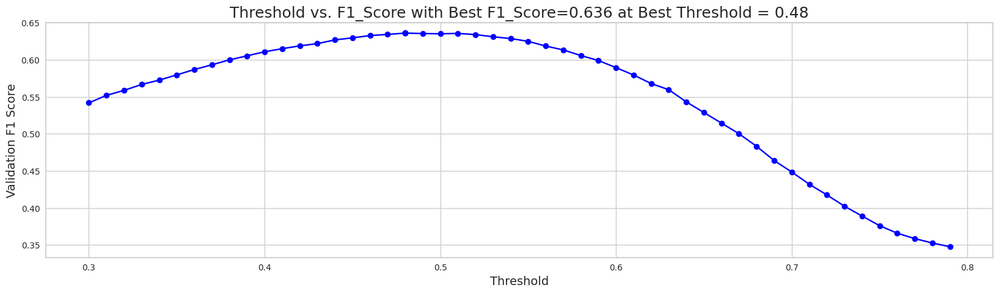

When using optimal threshold = 0.48...
Q0: F1 = 0.6360619175916956
==> Overall F1 = 0.6360619175916956
s
[I 2023-05-23 04:13:42,707] Trial 16 finished with value: 0.6360619175916956 and parameters: {'num_leaves': 32, 'learning_rate': 0.010594941844113526, 'feature_fraction': 0.95291599863753, 'bagging_fraction': 0.9463005007146545, 'bagging_freq': 1, 'min_child_samples': 47, 'reg_alpha': 8.221885815194442, 'reg_lambda': 9.325768033851553, 'subsample': 0.6633249383391513, 'colsample_bytree': 0.3262308376856651, 'min_split_gain': 0.0010685563209431842, 'max_depth': 6}. Best is trial 19 with value: 0.6385180194746567.


--------------------------------------------------
question15, with255features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.8024449304063282, subsample=0.6023601116317835 will be ignored. Current value: bagging_fraction=0.8024449304063282
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
[LightGBM] [Warning] feature_fraction is set=0.44172886927297, colsample_bytree=0.8332712187992224 will be ignored. Current value: feature_fraction=0.44172886927297


[LightGBM] [Warning] bagging_fraction is set=0.8024449304063282, subsample=0.6023601116317835 will be ignored. Current value: bagging_fraction=0.8024449304063282
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
[LightGBM] [Warning] feature_fraction is set=0.44172886927297, colsample_bytree=0.8332712187992224 will be ignored. Current value: feature_fraction=0.44172886927297
[LightGBM] [Warning] bagging_fraction is set=0.869261835458113, subsample=0.6399176348447947 will be ignored. Current value: bagging_fraction=0.869261835458113
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_

[LightGBM] [Warning] bagging_fraction is set=0.8396540721305976, subsample=0.6187249027416284 will be ignored. Current value: bagging_fraction=0.8396540721305976
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.8184015262677936, colsample_bytree=0.335409665840699 will be ignored. Current value: feature_fraction=0.8184015262677936
[LightGBM] [Warning] bagging_fraction is set=0.8330376134474197, subsample=0.6847544289951046 will be ignored. Current value: bagging_fraction=0.8330376134474197
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] fea

[LightGBM] [Warning] bagging_fraction is set=0.869261835458113, subsample=0.6399176348447947 will be ignored. Current value: bagging_fraction=0.869261835458113
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.8302988619514137, colsample_bytree=0.3904172741180267 will be ignored. Current value: feature_fraction=0.8302988619514137


[LightGBM] [Warning] bagging_fraction is set=0.8024449304063282, subsample=0.6023601116317835 will be ignored. Current value: bagging_fraction=0.8024449304063282
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
[LightGBM] [Warning] feature_fraction is set=0.44172886927297, colsample_bytree=0.8332712187992224 will be ignored. Current value: feature_fraction=0.44172886927297


[LightGBM] [Warning] bagging_fraction is set=0.8330376134474197, subsample=0.6847544289951046 will be ignored. Current value: bagging_fraction=0.8330376134474197
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.8229113927814417, colsample_bytree=0.4065241611570263 will be ignored. Current value: feature_fraction=0.8229113927814417


[LightGBM] [Warning] bagging_fraction is set=0.8396540721305976, subsample=0.6187249027416284 will be ignored. Current value: bagging_fraction=0.8396540721305976
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.8184015262677936, colsample_bytree=0.335409665840699 will be ignored. Current value: feature_fraction=0.8184015262677936


[LightGBM] [Warning] bagging_fraction is set=0.8330376134474197, subsample=0.6847544289951046 will be ignored. Current value: bagging_fraction=0.8330376134474197
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.8229113927814417, colsample_bytree=0.4065241611570263 will be ignored. Current value: feature_fraction=0.8229113927814417


[LightGBM] [Warning] bagging_fraction is set=0.8024449304063282, subsample=0.6023601116317835 will be ignored. Current value: bagging_fraction=0.8024449304063282
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
[LightGBM] [Warning] feature_fraction is set=0.44172886927297, colsample_bytree=0.8332712187992224 will be ignored. Current value: feature_fraction=0.44172886927297


[LightGBM] [Warning] bagging_fraction is set=0.8396540721305976, subsample=0.6187249027416284 will be ignored. Current value: bagging_fraction=0.8396540721305976
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.8184015262677936, colsample_bytree=0.335409665840699 will be ignored. Current value: feature_fraction=0.8184015262677936


[LightGBM] [Warning] bagging_fraction is set=0.8024449304063282, subsample=0.6023601116317835 will be ignored. Current value: bagging_fraction=0.8024449304063282
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
[LightGBM] [Warning] feature_fraction is set=0.44172886927297, colsample_bytree=0.8332712187992224 will be ignored. Current value: feature_fraction=0.44172886927297


,mean
feature,
elapsed_time_diff_std,202.0
6_page_counts,173.2
17_level_counts,154.8
map_click_event_name_counts,137.0
journals_flag.pic_0.next_fqid_counts,130.8
savedteddy_fqid_counts,130.0
tunic.historicalsociety.frontdesk.archivist_glasses.confrontation_recap_text_fqid_counts,122.8
tracks_fqid_counts,117.2
elapsed_time_diff_mean,111.8


[[0.94546267 0.05453733]
 [0.3819923  0.6180077 ]
 [0.33013453 0.66986547]
 ...
 [0.31193804 0.68806196]
 [0.30568439 0.69431561]
 [0.45984236 0.54015764]]


,mean
feature,
elapsed_time_diff_std,281.2
17_level_counts,227.4
screen_coor_x_std,204.6
elapsed_time_diff_sum,204.0
20_level_counts,199.2
savedteddy_fqid_counts,199.0
screen_coor_x_mean,195.0
room_coor_y_max,192.4
6_page_counts,191.4


[[0.91246918 0.08753082]
 [0.38018559 0.61981441]
 [0.33403705 0.66596295]
 ...
 [0.30381166 0.69618834]
 [0.28581941 0.71418059]
 [0.45970329 0.54029671]]


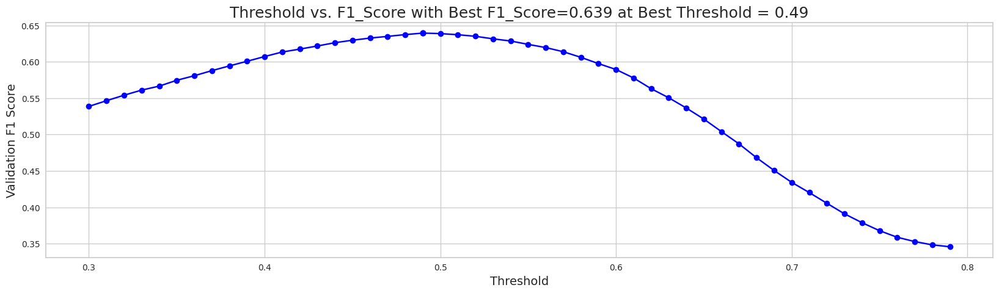

When using optimal threshold = 0.49...
Q0: F1 = 0.6393841825885013
==> Overall F1 = 0.6393841825885013
s
[I 2023-05-23 04:16:25,057] Trial 21 finished with value: 0.6393841825885013 and parameters: {'num_leaves': 81, 'learning_rate': 0.012017634022330049, 'feature_fraction': 0.8302988619514137, 'bagging_fraction': 0.869261835458113, 'bagging_freq': 1, 'min_child_samples': 86, 'reg_alpha': 7.858830834643741, 'reg_lambda': 0.08046995592850414, 'subsample': 0.6399176348447947, 'colsample_bytree': 0.3904172741180267, 'min_split_gain': 0.0029444644180908874, 'max_depth': 2}. Best is trial 21 with value: 0.6393841825885013.


--------------------------------------------------
question15, with255features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.8393930603463828, subsample=0.6121472232706809 will be ignored. Current value: bagging_fraction=0.8393930603463828
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.834075688949247, colsample_bytree=0.41905018633196445 will be ignored. Current value: feature_fraction=0.834075688949247


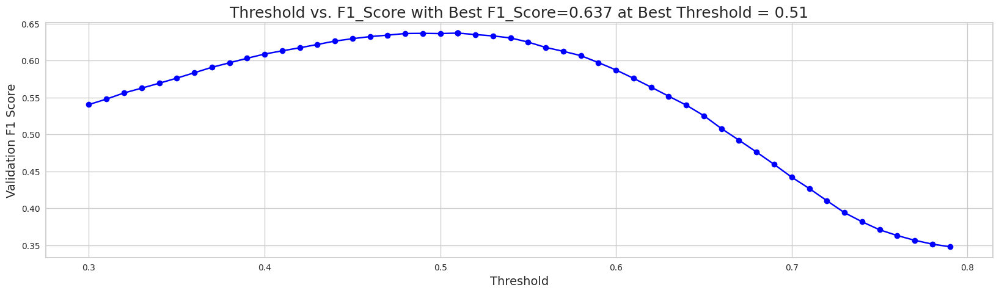

When using optimal threshold = 0.51...
Q0: F1 = 0.6370941491909379
==> Overall F1 = 0.6370941491909379
s
[I 2023-05-23 04:16:28,105] Trial 22 finished with value: 0.6370941491909379 and parameters: {'num_leaves': 59, 'learning_rate': 0.016437868676010988, 'feature_fraction': 0.8229113927814417, 'bagging_fraction': 0.8330376134474197, 'bagging_freq': 1, 'min_child_samples': 82, 'reg_alpha': 6.734664421837848, 'reg_lambda': 0.10243882918424568, 'subsample': 0.6847544289951046, 'colsample_bytree': 0.4065241611570263, 'min_split_gain': 0.0027801740843902485, 'max_depth': 5}. Best is trial 21 with value: 0.6393841825885013.


--------------------------------------------------
question15, with255features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.8579091885753595, subsample=0.5879727004070368 will be ignored. Current value: bagging_fraction=0.8579091885753595
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.8493981364164522, colsample_bytree=0.34192780641179094 will be ignored. Current value: feature_fraction=0.8493981364164522


[LightGBM] [Warning] bagging_fraction is set=0.8396540721305976, subsample=0.6187249027416284 will be ignored. Current value: bagging_fraction=0.8396540721305976
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.8184015262677936, colsample_bytree=0.335409665840699 will be ignored. Current value: feature_fraction=0.8184015262677936


[LightGBM] [Warning] bagging_fraction is set=0.8393930603463828, subsample=0.6121472232706809 will be ignored. Current value: bagging_fraction=0.8393930603463828
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.834075688949247, colsample_bytree=0.41905018633196445 will be ignored. Current value: feature_fraction=0.834075688949247


,mean
feature,
elapsed_time_diff_std,293.2
elapsed_time_diff_sum,246.8
17_level_counts,238.8
hover_duration_max,210.2
hover_duration_sum,207.0
20_level_counts,205.4
screen_coor_x_mean,202.4
screen_coor_x_std,200.2
elapsed_time_diff_mean,193.4


[[0.90730231 0.09269769]
 [0.39527602 0.60472398]
 [0.34911434 0.65088566]
 ...
 [0.26108803 0.73891197]
 [0.27679546 0.72320454]
 [0.45261083 0.54738917]]


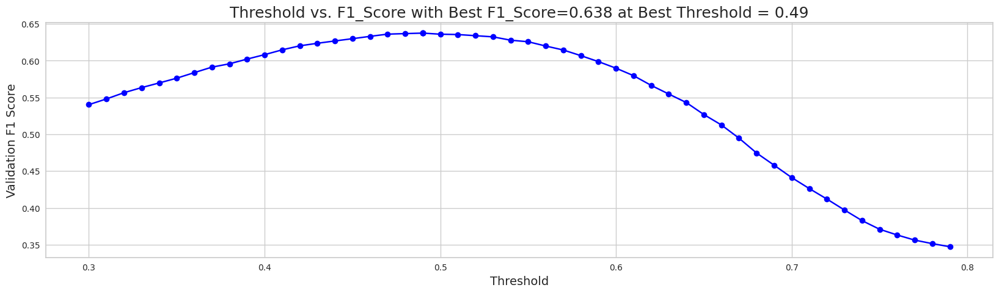

When using optimal threshold = 0.49...
Q0: F1 = 0.6375328968764943
==> Overall F1 = 0.6375328968764943
s
[I 2023-05-23 04:17:12,324] Trial 24 finished with value: 0.6375328968764943 and parameters: {'num_leaves': 58, 'learning_rate': 0.016805319798577894, 'feature_fraction': 0.44172886927297, 'bagging_fraction': 0.8024449304063282, 'bagging_freq': 4, 'min_child_samples': 84, 'reg_alpha': 9.933291262272075, 'reg_lambda': 0.11197050112360651, 'subsample': 0.6023601116317835, 'colsample_bytree': 0.8332712187992224, 'min_split_gain': 0.003027642766459751, 'max_depth': 5}. Best is trial 21 with value: 0.6393841825885013.


--------------------------------------------------
question15, with255features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.6877179762533641, subsample=0.586237410139011 will be ignored. Current value: bagging_fraction=0.6877179762533641
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.8443298006189774, colsample_bytree=0.3223671512179487 will be ignored. Current value: feature_fraction=0.8443298006189774


,mean
feature,
elapsed_time_diff_std,173.6
6_page_counts,140.0
17_level_counts,132.6
map_click_event_name_counts,112.2
journals_flag.pic_0.next_fqid_counts,109.6
savedteddy_fqid_counts,109.4
tunic.historicalsociety.frontdesk.archivist_glasses.confrontation_recap_text_fqid_counts,99.8
tracks_fqid_counts,99.0
elapsed_time_diff_sum,98.4


[[0.94673886 0.05326114]
 [0.38356763 0.61643237]
 [0.32609236 0.67390764]
 ...
 [0.30528175 0.69471825]
 [0.30537991 0.69462009]
 [0.45961186 0.54038814]]


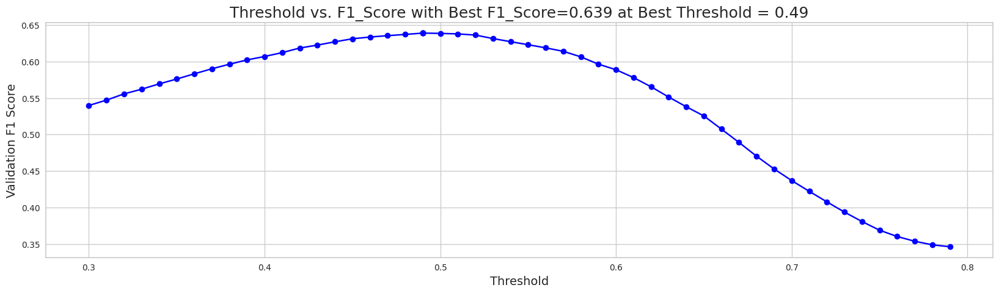

When using optimal threshold = 0.49...
Q0: F1 = 0.6388018062225358
==> Overall F1 = 0.6388018062225358
s
[I 2023-05-23 04:17:34,048] Trial 23 finished with value: 0.6388018062225358 and parameters: {'num_leaves': 58, 'learning_rate': 0.014795027352379472, 'feature_fraction': 0.8184015262677936, 'bagging_fraction': 0.8396540721305976, 'bagging_freq': 1, 'min_child_samples': 85, 'reg_alpha': 9.893406893275925, 'reg_lambda': 0.24555167563548108, 'subsample': 0.6187249027416284, 'colsample_bytree': 0.335409665840699, 'min_split_gain': 0.004582807933592822, 'max_depth': 2}. Best is trial 21 with value: 0.6393841825885013.


--------------------------------------------------
question15, with255features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.6882894727694596, subsample=0.5458205252696386 will be ignored. Current value: bagging_fraction=0.6882894727694596
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.747107207601459, colsample_bytree=0.26988336937563856 will be ignored. Current value: feature_fraction=0.747107207601459


[LightGBM] [Warning] bagging_fraction is set=0.8579091885753595, subsample=0.5879727004070368 will be ignored. Current value: bagging_fraction=0.8579091885753595
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.8493981364164522, colsample_bytree=0.34192780641179094 will be ignored. Current value: feature_fraction=0.8493981364164522


[LightGBM] [Warning] bagging_fraction is set=0.6877179762533641, subsample=0.586237410139011 will be ignored. Current value: bagging_fraction=0.6877179762533641
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.8443298006189774, colsample_bytree=0.3223671512179487 will be ignored. Current value: feature_fraction=0.8443298006189774


[LightGBM] [Warning] bagging_fraction is set=0.8393930603463828, subsample=0.6121472232706809 will be ignored. Current value: bagging_fraction=0.8393930603463828
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.834075688949247, colsample_bytree=0.41905018633196445 will be ignored. Current value: feature_fraction=0.834075688949247


[LightGBM] [Warning] bagging_fraction is set=0.6882894727694596, subsample=0.5458205252696386 will be ignored. Current value: bagging_fraction=0.6882894727694596
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.747107207601459, colsample_bytree=0.26988336937563856 will be ignored. Current value: feature_fraction=0.747107207601459


[LightGBM] [Warning] bagging_fraction is set=0.6877179762533641, subsample=0.586237410139011 will be ignored. Current value: bagging_fraction=0.6877179762533641
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.8443298006189774, colsample_bytree=0.3223671512179487 will be ignored. Current value: feature_fraction=0.8443298006189774


[LightGBM] [Warning] bagging_fraction is set=0.8393930603463828, subsample=0.6121472232706809 will be ignored. Current value: bagging_fraction=0.8393930603463828
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.834075688949247, colsample_bytree=0.41905018633196445 will be ignored. Current value: feature_fraction=0.834075688949247


[LightGBM] [Warning] bagging_fraction is set=0.6882894727694596, subsample=0.5458205252696386 will be ignored. Current value: bagging_fraction=0.6882894727694596
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.747107207601459, colsample_bytree=0.26988336937563856 will be ignored. Current value: feature_fraction=0.747107207601459


[LightGBM] [Warning] bagging_fraction is set=0.8579091885753595, subsample=0.5879727004070368 will be ignored. Current value: bagging_fraction=0.8579091885753595
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.8493981364164522, colsample_bytree=0.34192780641179094 will be ignored. Current value: feature_fraction=0.8493981364164522


[LightGBM] [Warning] bagging_fraction is set=0.6877179762533641, subsample=0.586237410139011 will be ignored. Current value: bagging_fraction=0.6877179762533641
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.8443298006189774, colsample_bytree=0.3223671512179487 will be ignored. Current value: feature_fraction=0.8443298006189774


[LightGBM] [Warning] bagging_fraction is set=0.6882894727694596, subsample=0.5458205252696386 will be ignored. Current value: bagging_fraction=0.6882894727694596
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.747107207601459, colsample_bytree=0.26988336937563856 will be ignored. Current value: feature_fraction=0.747107207601459


[LightGBM] [Warning] bagging_fraction is set=0.6877179762533641, subsample=0.586237410139011 will be ignored. Current value: bagging_fraction=0.6877179762533641
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.8443298006189774, colsample_bytree=0.3223671512179487 will be ignored. Current value: feature_fraction=0.8443298006189774
[LightGBM] [Warning] bagging_fraction is set=0.8393930603463828, subsample=0.6121472232706809 will be ignored. Current value: bagging_fraction=0.8393930603463828
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] fea

[LightGBM] [Warning] bagging_fraction is set=0.8579091885753595, subsample=0.5879727004070368 will be ignored. Current value: bagging_fraction=0.8579091885753595
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.8493981364164522, colsample_bytree=0.34192780641179094 will be ignored. Current value: feature_fraction=0.8493981364164522
[LightGBM] [Warning] bagging_fraction is set=0.6882894727694596, subsample=0.5458205252696386 will be ignored. Current value: bagging_fraction=0.6882894727694596
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] f

,mean
feature,
6_page_counts,114.8
elapsed_time_diff_std,110.0
tunic.historicalsociety.frontdesk.archivist_glasses.confrontation_recap_text_fqid_counts,105.8
map_click_event_name_counts,96.2
savedteddy_fqid_counts,89.4
journals_flag.pic_0.next_fqid_counts,86.6
17_level_counts,78.0
flag_girl_fqid_counts,75.8
directory_fqid_counts,74.6


[[0.92668928 0.07331072]
 [0.37552442 0.62447558]
 [0.34883107 0.65116893]
 ...
 [0.30130913 0.69869087]
 [0.31406709 0.68593291]
 [0.44001873 0.55998127]]


,mean
feature,
elapsed_time_diff_std,125.8
6_page_counts,118.6
17_level_counts,98.4
map_click_event_name_counts,97.0
tunic.historicalsociety.frontdesk.archivist_glasses.confrontation_recap_text_fqid_counts,94.2
journals_flag.pic_0.next_fqid_counts,93.6
savedteddy_fqid_counts,90.2
tracks_fqid_counts,79.4
directory_fqid_counts,75.4


[[0.90752928 0.09247072]
 [0.36839756 0.63160244]
 [0.35002578 0.64997422]
 ...
 [0.30376196 0.69623804]
 [0.31219235 0.68780765]
 [0.4469243  0.5530757 ]]


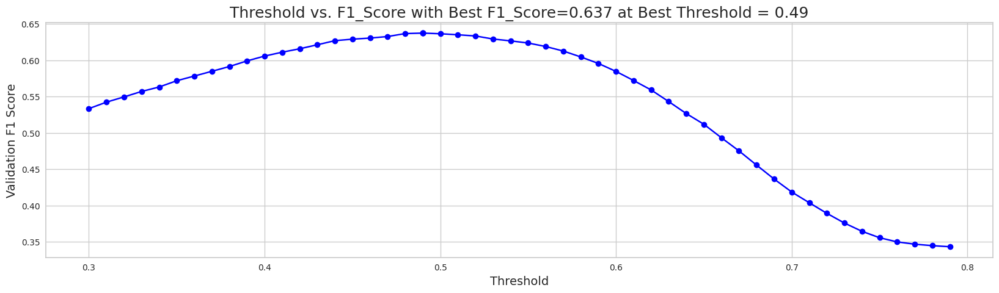

When using optimal threshold = 0.49...
Q0: F1 = 0.6372904467730798
==> Overall F1 = 0.6372904467730798
s
[I 2023-05-23 04:20:04,077] Trial 27 finished with value: 0.6372904467730798 and parameters: {'num_leaves': 85, 'learning_rate': 0.013414199517272102, 'feature_fraction': 0.8443298006189774, 'bagging_fraction': 0.6877179762533641, 'bagging_freq': 3, 'min_child_samples': 90, 'reg_alpha': 4.374042581611473, 'reg_lambda': 0.26603081839799014, 'subsample': 0.586237410139011, 'colsample_bytree': 0.3223671512179487, 'min_split_gain': 0.006253536080860888, 'max_depth': 2}. Best is trial 21 with value: 0.6393841825885013.


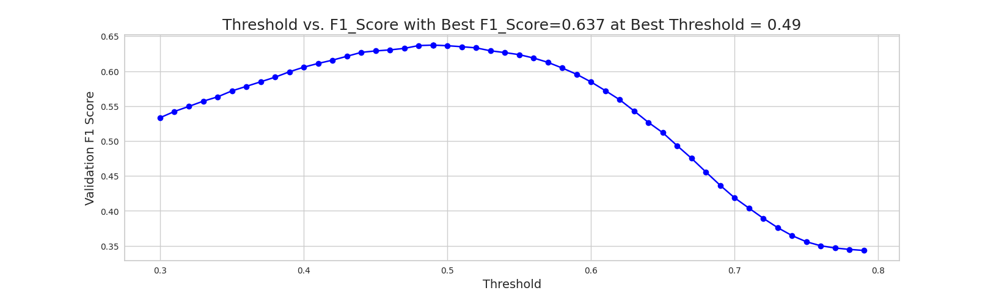

--------------------------------------------------
question15, with255features
--------------------------------------------------


,mean
feature,
6_page_counts,126.6
tunic.historicalsociety.frontdesk.archivist_glasses.confrontation_recap_text_fqid_counts,111.8
elapsed_time_diff_std,111.0
map_click_event_name_counts,100.6
savedteddy_fqid_counts,93.0
journals_flag.pic_0.next_fqid_counts,92.2
17_level_counts,82.2
directory_fqid_counts,78.0
flag_girl_fqid_counts,77.0


[[0.92401097 0.07598903]
 [0.3756667  0.6243333 ]
 [0.34442104 0.65557896]
 ...
 [0.3108941  0.6891059 ]
 [0.31617028 0.68382972]
 [0.43888536 0.56111464]]


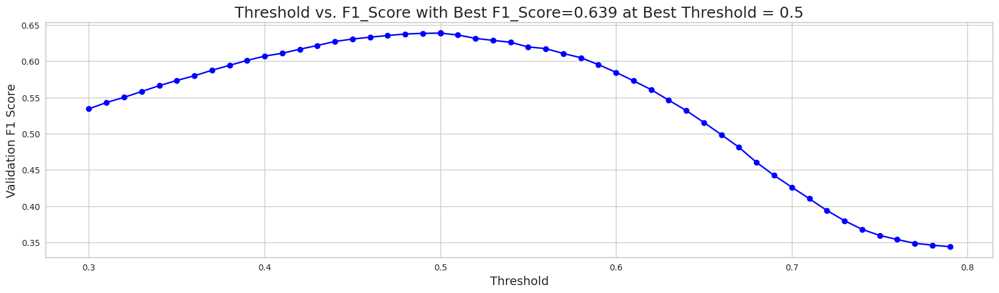

When using optimal threshold = 0.50...
Q0: F1 = 0.6388233299924884
==> Overall F1 = 0.6388233299924884
s
[I 2023-05-23 04:20:06,768] Trial 25 finished with value: 0.6388233299924884 and parameters: {'num_leaves': 57, 'learning_rate': 0.015742736177660102, 'feature_fraction': 0.834075688949247, 'bagging_fraction': 0.8393930603463828, 'bagging_freq': 3, 'min_child_samples': 86, 'reg_alpha': 8.713725954032348, 'reg_lambda': 0.12100214141222461, 'subsample': 0.6121472232706809, 'colsample_bytree': 0.41905018633196445, 'min_split_gain': 0.0041389288398211484, 'max_depth': 2}. Best is trial 21 with value: 0.6393841825885013.
[LightGBM] [Warning] bagging_fraction is set=0.9018655335332832, subsample=0.433996839406167 will be ignored. Current value: bagging_fraction=0.9018655335332832
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. 

--------------------------------------------------
question15, with255features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.8914440682132736, subsample=0.7912545142052435 will be ignored. Current value: bagging_fraction=0.8914440682132736
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.7899617469821401, colsample_bytree=0.27243156609157426 will be ignored. Current value: feature_fraction=0.7899617469821401


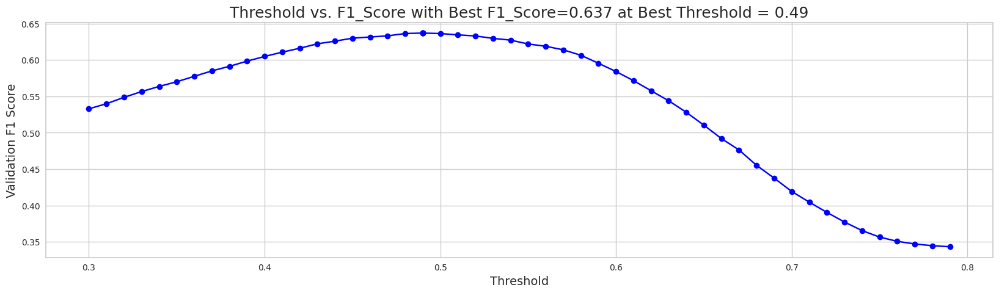

When using optimal threshold = 0.49...
Q0: F1 = 0.6369438816711464
==> Overall F1 = 0.6369438816711464
s
[I 2023-05-23 04:20:11,208] Trial 28 finished with value: 0.6369438816711464 and parameters: {'num_leaves': 39, 'learning_rate': 0.012462502172171578, 'feature_fraction': 0.747107207601459, 'bagging_fraction': 0.6882894727694596, 'bagging_freq': 3, 'min_child_samples': 90, 'reg_alpha': 3.1510464825754947, 'reg_lambda': 0.1829659931911447, 'subsample': 0.5458205252696386, 'colsample_bytree': 0.26988336937563856, 'min_split_gain': 0.005209741482694339, 'max_depth': 2}. Best is trial 21 with value: 0.6393841825885013.


--------------------------------------------------
question15, with255features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.8987311090736847, subsample=0.7694896558693024 will be ignored. Current value: bagging_fraction=0.8987311090736847
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.9746076916498786, colsample_bytree=0.4557566657282522 will be ignored. Current value: feature_fraction=0.9746076916498786


[LightGBM] [Warning] bagging_fraction is set=0.8579091885753595, subsample=0.5879727004070368 will be ignored. Current value: bagging_fraction=0.8579091885753595
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.8493981364164522, colsample_bytree=0.34192780641179094 will be ignored. Current value: feature_fraction=0.8493981364164522


[LightGBM] [Warning] bagging_fraction is set=0.8987311090736847, subsample=0.7694896558693024 will be ignored. Current value: bagging_fraction=0.8987311090736847
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.9746076916498786, colsample_bytree=0.4557566657282522 will be ignored. Current value: feature_fraction=0.9746076916498786


[LightGBM] [Warning] bagging_fraction is set=0.8914440682132736, subsample=0.7912545142052435 will be ignored. Current value: bagging_fraction=0.8914440682132736
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.7899617469821401, colsample_bytree=0.27243156609157426 will be ignored. Current value: feature_fraction=0.7899617469821401


[LightGBM] [Warning] bagging_fraction is set=0.9018655335332832, subsample=0.433996839406167 will be ignored. Current value: bagging_fraction=0.9018655335332832
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.7696938075648188, colsample_bytree=0.24937569452362873 will be ignored. Current value: feature_fraction=0.7696938075648188


[LightGBM] [Warning] bagging_fraction is set=0.8987311090736847, subsample=0.7694896558693024 will be ignored. Current value: bagging_fraction=0.8987311090736847
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.9746076916498786, colsample_bytree=0.4557566657282522 will be ignored. Current value: feature_fraction=0.9746076916498786


,mean
feature,
elapsed_time_diff_std,170.2
6_page_counts,144.0
17_level_counts,127.4
map_click_event_name_counts,114.2
journals_flag.pic_0.next_fqid_counts,110.2
savedteddy_fqid_counts,108.6
tracks_fqid_counts,106.6
tunic.historicalsociety.frontdesk.archivist_glasses.confrontation_recap_text_fqid_counts,105.4
elapsed_time_diff_mean,101.2


[[0.94480836 0.05519164]
 [0.38318143 0.61681857]
 [0.34180236 0.65819764]
 ...
 [0.30340901 0.69659099]
 [0.31370611 0.68629389]
 [0.44253521 0.55746479]]


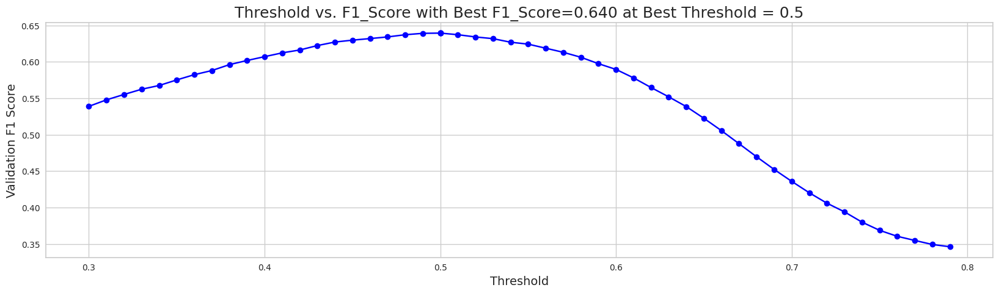

When using optimal threshold = 0.50...
Q0: F1 = 0.6395434547872618
==> Overall F1 = 0.6395434547872618
s
[I 2023-05-23 04:21:23,062] Trial 26 finished with value: 0.6395434547872618 and parameters: {'num_leaves': 86, 'learning_rate': 0.014637197658999995, 'feature_fraction': 0.8493981364164522, 'bagging_fraction': 0.8579091885753595, 'bagging_freq': 3, 'min_child_samples': 88, 'reg_alpha': 9.594400221459496, 'reg_lambda': 0.1476204554485559, 'subsample': 0.5879727004070368, 'colsample_bytree': 0.34192780641179094, 'min_split_gain': 0.004470749731409204, 'max_depth': 2}. Best is trial 26 with value: 0.6395434547872618.


--------------------------------------------------
question15, with255features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.8814852846858983, subsample=0.7583578456291615 will be ignored. Current value: bagging_fraction=0.8814852846858983
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.9538377747735655, colsample_bytree=0.4839854052100282 will be ignored. Current value: feature_fraction=0.9538377747735655


[LightGBM] [Warning] bagging_fraction is set=0.8914440682132736, subsample=0.7912545142052435 will be ignored. Current value: bagging_fraction=0.8914440682132736
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.7899617469821401, colsample_bytree=0.27243156609157426 will be ignored. Current value: feature_fraction=0.7899617469821401


[LightGBM] [Warning] bagging_fraction is set=0.8987311090736847, subsample=0.7694896558693024 will be ignored. Current value: bagging_fraction=0.8987311090736847
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.9746076916498786, colsample_bytree=0.4557566657282522 will be ignored. Current value: feature_fraction=0.9746076916498786


[LightGBM] [Warning] bagging_fraction is set=0.9018655335332832, subsample=0.433996839406167 will be ignored. Current value: bagging_fraction=0.9018655335332832
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.7696938075648188, colsample_bytree=0.24937569452362873 will be ignored. Current value: feature_fraction=0.7696938075648188


[LightGBM] [Warning] bagging_fraction is set=0.8814852846858983, subsample=0.7583578456291615 will be ignored. Current value: bagging_fraction=0.8814852846858983
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.9538377747735655, colsample_bytree=0.4839854052100282 will be ignored. Current value: feature_fraction=0.9538377747735655


[LightGBM] [Warning] bagging_fraction is set=0.8914440682132736, subsample=0.7912545142052435 will be ignored. Current value: bagging_fraction=0.8914440682132736
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.7899617469821401, colsample_bytree=0.27243156609157426 will be ignored. Current value: feature_fraction=0.7899617469821401


[LightGBM] [Warning] bagging_fraction is set=0.8987311090736847, subsample=0.7694896558693024 will be ignored. Current value: bagging_fraction=0.8987311090736847
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.9746076916498786, colsample_bytree=0.4557566657282522 will be ignored. Current value: feature_fraction=0.9746076916498786


,mean
feature,
elapsed_time_diff_std,54.4
6_page_counts,51.6
tunic.historicalsociety.frontdesk.archivist_glasses.confrontation_recap_text_fqid_counts,48.4
savedteddy_fqid_counts,47.6
map_click_event_name_counts,46.4
journals_flag.pic_0.next_fqid_counts,44.0
directory_fqid_counts,35.2
journals_fqid_counts,34.8
17_level_counts,34.6


[LightGBM] [Warning] bagging_fraction is set=0.8914440682132736, subsample=0.7912545142052435 will be ignored. Current value: bagging_fraction=0.8914440682132736
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.7899617469821401, colsample_bytree=0.27243156609157426 will be ignored. Current value: feature_fraction=0.7899617469821401
[[0.89293723 0.10706277]
 [0.37786668 0.62213332]
 [0.36848165 0.63151835]
 ...
 [0.31876349 0.68123651]
 [0.33880654 0.66119346]
 [0.46665263 0.53334737]]


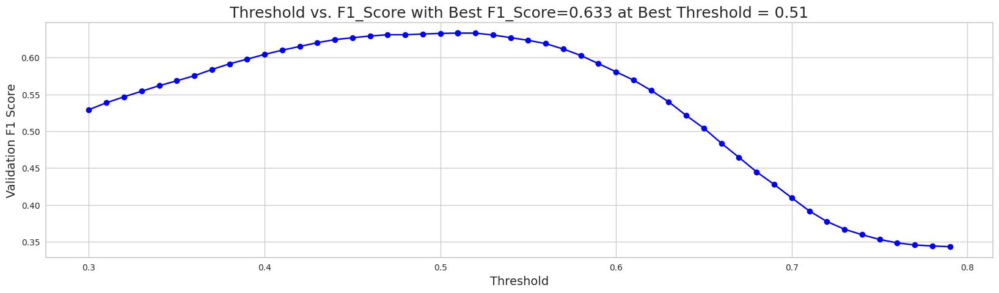

When using optimal threshold = 0.51...
Q0: F1 = 0.6330968847198319
==> Overall F1 = 0.6330968847198319
s
[I 2023-05-23 04:23:06,399] Trial 31 finished with value: 0.6330968847198319 and parameters: {'num_leaves': 55, 'learning_rate': 0.024315904763283474, 'feature_fraction': 0.9746076916498786, 'bagging_fraction': 0.8987311090736847, 'bagging_freq': 3, 'min_child_samples': 71, 'reg_alpha': 1.3327431413162334, 'reg_lambda': 0.0391083014940269, 'subsample': 0.7694896558693024, 'colsample_bytree': 0.4557566657282522, 'min_split_gain': 0.011550489872744882, 'max_depth': 1}. Best is trial 26 with value: 0.6395434547872618.


--------------------------------------------------
question15, with255features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.9026422976007435, subsample=0.7547663433708873 will be ignored. Current value: bagging_fraction=0.9026422976007435
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
[LightGBM] [Warning] feature_fraction is set=0.9009648432514961, colsample_bytree=0.5591512902331702 will be ignored. Current value: feature_fraction=0.9009648432514961


[LightGBM] [Warning] bagging_fraction is set=0.8814852846858983, subsample=0.7583578456291615 will be ignored. Current value: bagging_fraction=0.8814852846858983
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.9538377747735655, colsample_bytree=0.4839854052100282 will be ignored. Current value: feature_fraction=0.9538377747735655


,mean
feature,
elapsed_time_diff_std,56.8
6_page_counts,56.0
map_click_event_name_counts,47.8
tunic.historicalsociety.frontdesk.archivist_glasses.confrontation_recap_text_fqid_counts,47.6
journals_flag.pic_0.next_fqid_counts,44.6
17_level_counts,42.4
savedteddy_fqid_counts,40.0
journals_fqid_counts,38.4
screen_coor_x_max,36.4


[[0.92612098 0.07387902]
 [0.37805288 0.62194712]
 [0.35290828 0.64709172]
 ...
 [0.31896308 0.68103692]
 [0.34072353 0.65927647]
 [0.4642767  0.5357233 ]]


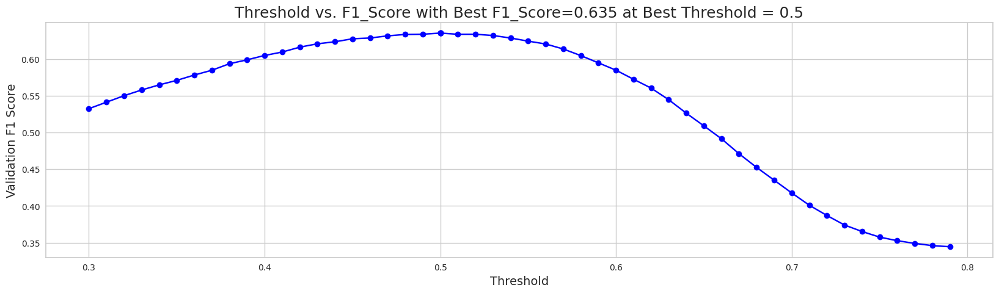

When using optimal threshold = 0.50...
Q0: F1 = 0.6352600989728971
==> Overall F1 = 0.6352600989728971
s
[I 2023-05-23 04:23:36,265] Trial 30 finished with value: 0.6352600989728971 and parameters: {'num_leaves': 39, 'learning_rate': 0.025796723788808793, 'feature_fraction': 0.7899617469821401, 'bagging_fraction': 0.8914440682132736, 'bagging_freq': 3, 'min_child_samples': 71, 'reg_alpha': 1.1183819749813178, 'reg_lambda': 0.044243971002788963, 'subsample': 0.7912545142052435, 'colsample_bytree': 0.27243156609157426, 'min_split_gain': 0.011727956545538471, 'max_depth': 1}. Best is trial 26 with value: 0.6395434547872618.


--------------------------------------------------
question15, with255features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.8816401376902497, subsample=0.6042686758762786 will be ignored. Current value: bagging_fraction=0.8816401376902497
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8983369300573832, colsample_bytree=0.42687384401959894 will be ignored. Current value: feature_fraction=0.8983369300573832


[LightGBM] [Warning] bagging_fraction is set=0.9018655335332832, subsample=0.433996839406167 will be ignored. Current value: bagging_fraction=0.9018655335332832
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.7696938075648188, colsample_bytree=0.24937569452362873 will be ignored. Current value: feature_fraction=0.7696938075648188


[LightGBM] [Warning] bagging_fraction is set=0.9026422976007435, subsample=0.7547663433708873 will be ignored. Current value: bagging_fraction=0.9026422976007435
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
[LightGBM] [Warning] feature_fraction is set=0.9009648432514961, colsample_bytree=0.5591512902331702 will be ignored. Current value: feature_fraction=0.9009648432514961


[LightGBM] [Warning] bagging_fraction is set=0.8816401376902497, subsample=0.6042686758762786 will be ignored. Current value: bagging_fraction=0.8816401376902497
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8983369300573832, colsample_bytree=0.42687384401959894 will be ignored. Current value: feature_fraction=0.8983369300573832


[LightGBM] [Warning] bagging_fraction is set=0.8814852846858983, subsample=0.7583578456291615 will be ignored. Current value: bagging_fraction=0.8814852846858983
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.9538377747735655, colsample_bytree=0.4839854052100282 will be ignored. Current value: feature_fraction=0.9538377747735655


[LightGBM] [Warning] bagging_fraction is set=0.9026422976007435, subsample=0.7547663433708873 will be ignored. Current value: bagging_fraction=0.9026422976007435
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
[LightGBM] [Warning] feature_fraction is set=0.9009648432514961, colsample_bytree=0.5591512902331702 will be ignored. Current value: feature_fraction=0.9009648432514961


[LightGBM] [Warning] bagging_fraction is set=0.9018655335332832, subsample=0.433996839406167 will be ignored. Current value: bagging_fraction=0.9018655335332832
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.7696938075648188, colsample_bytree=0.24937569452362873 will be ignored. Current value: feature_fraction=0.7696938075648188


[LightGBM] [Warning] bagging_fraction is set=0.8814852846858983, subsample=0.7583578456291615 will be ignored. Current value: bagging_fraction=0.8814852846858983
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.9538377747735655, colsample_bytree=0.4839854052100282 will be ignored. Current value: feature_fraction=0.9538377747735655


[LightGBM] [Warning] bagging_fraction is set=0.8816401376902497, subsample=0.6042686758762786 will be ignored. Current value: bagging_fraction=0.8816401376902497
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8983369300573832, colsample_bytree=0.42687384401959894 will be ignored. Current value: feature_fraction=0.8983369300573832


[LightGBM] [Warning] bagging_fraction is set=0.9026422976007435, subsample=0.7547663433708873 will be ignored. Current value: bagging_fraction=0.9026422976007435
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
[LightGBM] [Warning] feature_fraction is set=0.9009648432514961, colsample_bytree=0.5591512902331702 will be ignored. Current value: feature_fraction=0.9009648432514961


,mean
feature,
elapsed_time_diff_std,119.2
6_page_counts,118.2
tunic.historicalsociety.frontdesk.archivist_glasses.confrontation_recap_text_fqid_counts,113.8
map_click_event_name_counts,113.2
journals_flag.pic_0.next_fqid_counts,105.0
savedteddy_fqid_counts,96.6
journals_fqid_counts,87.8
17_level_counts,83.0
directory_fqid_counts,79.6


[[0.8975212  0.1024788 ]
 [0.38551372 0.61448628]
 [0.36850549 0.63149451]
 ...
 [0.32272858 0.67727142]
 [0.34145867 0.65854133]
 [0.46304458 0.53695542]]


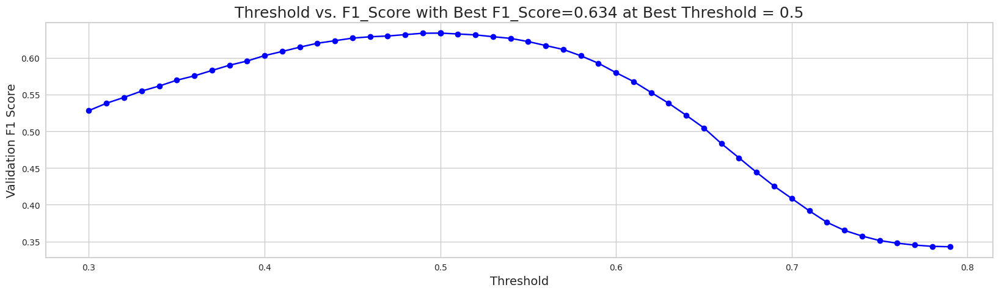

When using optimal threshold = 0.50...
Q0: F1 = 0.6342401813391478
==> Overall F1 = 0.6342401813391478
s
[I 2023-05-23 04:26:10,560] Trial 29 finished with value: 0.6342401813391478 and parameters: {'num_leaves': 41, 'learning_rate': 0.01036205332463626, 'feature_fraction': 0.7696938075648188, 'bagging_fraction': 0.9018655335332832, 'bagging_freq': 3, 'min_child_samples': 67, 'reg_alpha': 1.2647229700471145, 'reg_lambda': 0.05167420120602864, 'subsample': 0.433996839406167, 'colsample_bytree': 0.24937569452362873, 'min_split_gain': 0.011041592179730006, 'max_depth': 1}. Best is trial 26 with value: 0.6395434547872618.


--------------------------------------------------
question15, with255features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.8566752152725247, subsample=0.6060593960049441 will be ignored. Current value: bagging_fraction=0.8566752152725247
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.9090773246594971, colsample_bytree=0.41903374489835077 will be ignored. Current value: feature_fraction=0.9090773246594971


[LightGBM] [Warning] bagging_fraction is set=0.8816401376902497, subsample=0.6042686758762786 will be ignored. Current value: bagging_fraction=0.8816401376902497
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8983369300573832, colsample_bytree=0.42687384401959894 will be ignored. Current value: feature_fraction=0.8983369300573832


,mean
feature,
elapsed_time_diff_std,347.0
session_id,342.6
hover_duration_sum,326.2
room_coor_y_max,325.0
screen_coor_x_mean,317.2
screen_coor_x_std,307.2
hover_duration_max,306.0
room_coor_x_std,298.4
elapsed_time_diff_sum,294.8


[[0.90585518 0.09414482]
 [0.31955509 0.68044491]
 [0.31820297 0.68179703]
 ...
 [0.27173877 0.72826123]
 [0.28230287 0.71769713]
 [0.47419905 0.52580095]]


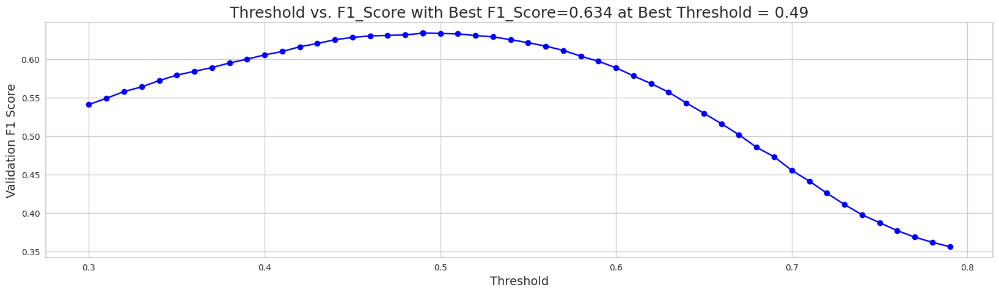

When using optimal threshold = 0.49...
Q0: F1 = 0.6336344639504975
==> Overall F1 = 0.6336344639504975
s
[I 2023-05-23 04:26:26,980] Trial 32 finished with value: 0.6336344639504975 and parameters: {'num_leaves': 100, 'learning_rate': 0.021034980033490164, 'feature_fraction': 0.9538377747735655, 'bagging_fraction': 0.8814852846858983, 'bagging_freq': 3, 'min_child_samples': 71, 'reg_alpha': 0.9259272002370579, 'reg_lambda': 0.054258789529324586, 'subsample': 0.7583578456291615, 'colsample_bytree': 0.4839854052100282, 'min_split_gain': 0.00905465715099733, 'max_depth': 0}. Best is trial 26 with value: 0.6395434547872618.


--------------------------------------------------
question15, with255features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.997231570806528, subsample=0.6040636687802262 will be ignored. Current value: bagging_fraction=0.997231570806528
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8959617733384428, colsample_bytree=0.38728915057281094 will be ignored. Current value: feature_fraction=0.8959617733384428
[LightGBM] [Warning] bagging_fraction is set=0.9026422976007435, subsample=0.7547663433708873 will be ignored. Current value: bagging_fraction=0.9026422976007435
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
[LightGBM] [Warning] fea

[LightGBM] [Warning] bagging_fraction is set=0.8816401376902497, subsample=0.6042686758762786 will be ignored. Current value: bagging_fraction=0.8816401376902497
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8983369300573832, colsample_bytree=0.42687384401959894 will be ignored. Current value: feature_fraction=0.8983369300573832


[LightGBM] [Warning] bagging_fraction is set=0.8566752152725247, subsample=0.6060593960049441 will be ignored. Current value: bagging_fraction=0.8566752152725247
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.9090773246594971, colsample_bytree=0.41903374489835077 will be ignored. Current value: feature_fraction=0.9090773246594971


,mean
feature,
elapsed_time_diff_std,313.2
session_id,290.0
hover_duration_sum,288.4
room_coor_y_max,278.0
screen_coor_x_std,276.4
screen_coor_x_mean,274.6
hover_duration_max,262.6
room_coor_x_min,259.0
hover_duration_mean,257.0


[LightGBM] [Warning] bagging_fraction is set=0.997231570806528, subsample=0.6040636687802262 will be ignored. Current value: bagging_fraction=0.997231570806528
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8959617733384428, colsample_bytree=0.38728915057281094 will be ignored. Current value: feature_fraction=0.8959617733384428


[[0.90638441 0.09361559]
 [0.38148957 0.61851043]
 [0.32575573 0.67424427]
 ...
 [0.27703119 0.72296881]
 [0.23191666 0.76808334]
 [0.44432589 0.55567411]]


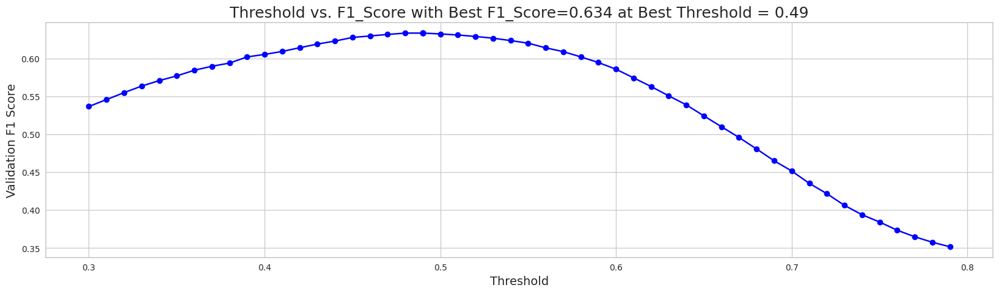

When using optimal threshold = 0.49...
Q0: F1 = 0.6336225608533268
==> Overall F1 = 0.6336225608533268
s
[I 2023-05-23 04:27:24,527] Trial 33 finished with value: 0.6336225608533268 and parameters: {'num_leaves': 97, 'learning_rate': 0.022775958584746965, 'feature_fraction': 0.9009648432514961, 'bagging_fraction': 0.9026422976007435, 'bagging_freq': 4, 'min_child_samples': 69, 'reg_alpha': 1.3520199442473784, 'reg_lambda': 0.030872009929792454, 'subsample': 0.7547663433708873, 'colsample_bytree': 0.5591512902331702, 'min_split_gain': 0.00822574841031484, 'max_depth': -1}. Best is trial 26 with value: 0.6395434547872618.


--------------------------------------------------
question15, with255features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.7567793634101018, subsample=0.6354916860395969 will be ignored. Current value: bagging_fraction=0.7567793634101018
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.6662807439127656, colsample_bytree=0.4266113931885446 will be ignored. Current value: feature_fraction=0.6662807439127656


[LightGBM] [Warning] bagging_fraction is set=0.7567793634101018, subsample=0.6354916860395969 will be ignored. Current value: bagging_fraction=0.7567793634101018
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.6662807439127656, colsample_bytree=0.4266113931885446 will be ignored. Current value: feature_fraction=0.6662807439127656


,mean
feature,
elapsed_time_diff_std,147.8
6_page_counts,143.4
17_level_counts,118.0
map_click_event_name_counts,112.2
savedteddy_fqid_counts,110.6
tunic.historicalsociety.frontdesk.archivist_glasses.confrontation_recap_text_fqid_counts,107.0
journals_flag.pic_0.next_fqid_counts,103.4
tracks_fqid_counts,91.8
screen_coor_x_max,86.6


[[0.94423726 0.05576274]
 [0.37220396 0.62779604]
 [0.33590056 0.66409944]
 ...
 [0.30913261 0.69086739]
 [0.31946891 0.68053109]
 [0.46580337 0.53419663]]


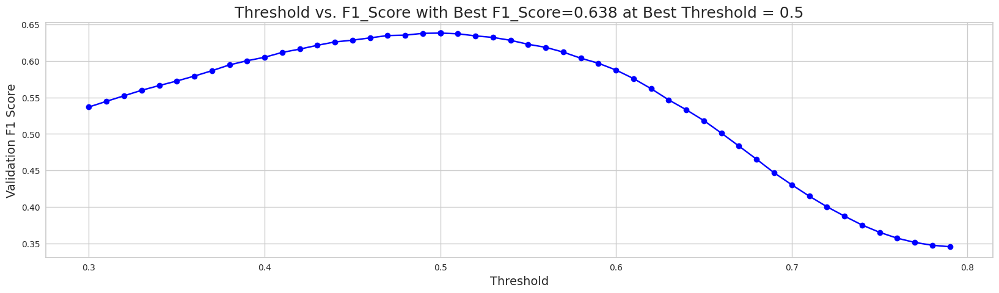

When using optimal threshold = 0.50...
Q0: F1 = 0.6380179512820907
==> Overall F1 = 0.6380179512820907
s
[I 2023-05-23 04:28:07,701] Trial 34 finished with value: 0.6380179512820907 and parameters: {'num_leaves': 83, 'learning_rate': 0.01410582673669582, 'feature_fraction': 0.8983369300573832, 'bagging_fraction': 0.8816401376902497, 'bagging_freq': 2, 'min_child_samples': 90, 'reg_alpha': 3.774727332908872, 'reg_lambda': 0.2929841862301331, 'subsample': 0.6042686758762786, 'colsample_bytree': 0.42687384401959894, 'min_split_gain': 0.004227278905581686, 'max_depth': 2}. Best is trial 26 with value: 0.6395434547872618.


--------------------------------------------------
question15, with255features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.7584755548763126, subsample=0.6433788763274594 will be ignored. Current value: bagging_fraction=0.7584755548763126
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.6827648302277747, colsample_bytree=0.4112472429389676 will be ignored. Current value: feature_fraction=0.6827648302277747


[LightGBM] [Warning] bagging_fraction is set=0.8566752152725247, subsample=0.6060593960049441 will be ignored. Current value: bagging_fraction=0.8566752152725247
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.9090773246594971, colsample_bytree=0.41903374489835077 will be ignored. Current value: feature_fraction=0.9090773246594971


[LightGBM] [Warning] bagging_fraction is set=0.997231570806528, subsample=0.6040636687802262 will be ignored. Current value: bagging_fraction=0.997231570806528
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8959617733384428, colsample_bytree=0.38728915057281094 will be ignored. Current value: feature_fraction=0.8959617733384428


[LightGBM] [Warning] bagging_fraction is set=0.7567793634101018, subsample=0.6354916860395969 will be ignored. Current value: bagging_fraction=0.7567793634101018
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.6662807439127656, colsample_bytree=0.4266113931885446 will be ignored. Current value: feature_fraction=0.6662807439127656


[LightGBM] [Warning] bagging_fraction is set=0.7584755548763126, subsample=0.6433788763274594 will be ignored. Current value: bagging_fraction=0.7584755548763126
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.6827648302277747, colsample_bytree=0.4112472429389676 will be ignored. Current value: feature_fraction=0.6827648302277747


[LightGBM] [Warning] bagging_fraction is set=0.8566752152725247, subsample=0.6060593960049441 will be ignored. Current value: bagging_fraction=0.8566752152725247
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.9090773246594971, colsample_bytree=0.41903374489835077 will be ignored. Current value: feature_fraction=0.9090773246594971


[LightGBM] [Warning] bagging_fraction is set=0.7567793634101018, subsample=0.6354916860395969 will be ignored. Current value: bagging_fraction=0.7567793634101018
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.6662807439127656, colsample_bytree=0.4266113931885446 will be ignored. Current value: feature_fraction=0.6662807439127656


[LightGBM] [Warning] bagging_fraction is set=0.997231570806528, subsample=0.6040636687802262 will be ignored. Current value: bagging_fraction=0.997231570806528
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8959617733384428, colsample_bytree=0.38728915057281094 will be ignored. Current value: feature_fraction=0.8959617733384428


[LightGBM] [Warning] bagging_fraction is set=0.7584755548763126, subsample=0.6433788763274594 will be ignored. Current value: bagging_fraction=0.7584755548763126
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.6827648302277747, colsample_bytree=0.4112472429389676 will be ignored. Current value: feature_fraction=0.6827648302277747


[LightGBM] [Warning] bagging_fraction is set=0.8566752152725247, subsample=0.6060593960049441 will be ignored. Current value: bagging_fraction=0.8566752152725247
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.9090773246594971, colsample_bytree=0.41903374489835077 will be ignored. Current value: feature_fraction=0.9090773246594971


[LightGBM] [Warning] bagging_fraction is set=0.7567793634101018, subsample=0.6354916860395969 will be ignored. Current value: bagging_fraction=0.7567793634101018
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.6662807439127656, colsample_bytree=0.4266113931885446 will be ignored. Current value: feature_fraction=0.6662807439127656


[LightGBM] [Warning] bagging_fraction is set=0.997231570806528, subsample=0.6040636687802262 will be ignored. Current value: bagging_fraction=0.997231570806528
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8959617733384428, colsample_bytree=0.38728915057281094 will be ignored. Current value: feature_fraction=0.8959617733384428


,mean
feature,
elapsed_time_diff_std,164.2
6_page_counts,154.0
tunic.historicalsociety.frontdesk.archivist_glasses.confrontation_recap_text_fqid_counts,136.2
map_click_event_name_counts,133.0
17_level_counts,133.0
savedteddy_fqid_counts,116.6
journals_flag.pic_0.next_fqid_counts,111.6
elapsed_time_diff_sum,100.8
screen_coor_x_max,100.4


[[0.94360541 0.05639459]
 [0.38451913 0.61548087]
 [0.32839511 0.67160489]
 ...
 [0.3090174  0.6909826 ]
 [0.30031878 0.69968122]
 [0.45878481 0.54121519]]


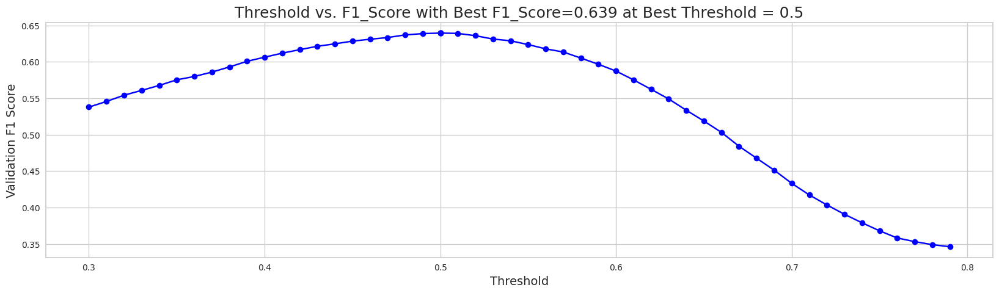

When using optimal threshold = 0.50...
Q0: F1 = 0.6394617355918641
==> Overall F1 = 0.6394617355918641
s
[I 2023-05-23 04:30:04,461] Trial 37 finished with value: 0.6394617355918641 and parameters: {'num_leaves': 87, 'learning_rate': 0.014368631225323319, 'feature_fraction': 0.6662807439127656, 'bagging_fraction': 0.7567793634101018, 'bagging_freq': 2, 'min_child_samples': 90, 'reg_alpha': 3.8015923729312346, 'reg_lambda': 0.22238566923099062, 'subsample': 0.6354916860395969, 'colsample_bytree': 0.4266113931885446, 'min_split_gain': 0.004156117239477905, 'max_depth': 3}. Best is trial 26 with value: 0.6395434547872618.


--------------------------------------------------
question15, with255features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.7720686787688288, subsample=0.6473438914418462 will be ignored. Current value: bagging_fraction=0.7720686787688288
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.6815397456733301, colsample_bytree=0.3921810453683415 will be ignored. Current value: feature_fraction=0.6815397456733301
[LightGBM] [Warning] bagging_fraction is set=0.7584755548763126, subsample=0.6433788763274594 will be ignored. Current value: bagging_fraction=0.7584755548763126
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] fe

,mean
feature,
elapsed_time_diff_std,195.0
6_page_counts,186.2
17_level_counts,157.2
tunic.historicalsociety.frontdesk.archivist_glasses.confrontation_recap_text_fqid_counts,148.8
savedteddy_fqid_counts,147.2
map_click_event_name_counts,137.0
tracks_fqid_counts,128.8
journals_flag.pic_0.next_fqid_counts,124.6
elapsed_time_diff_sum,123.4


[[0.94688133 0.05311867]
 [0.37624385 0.62375615]
 [0.33293204 0.66706796]
 ...
 [0.29946364 0.70053636]
 [0.29681018 0.70318982]
 [0.45739383 0.54260617]]


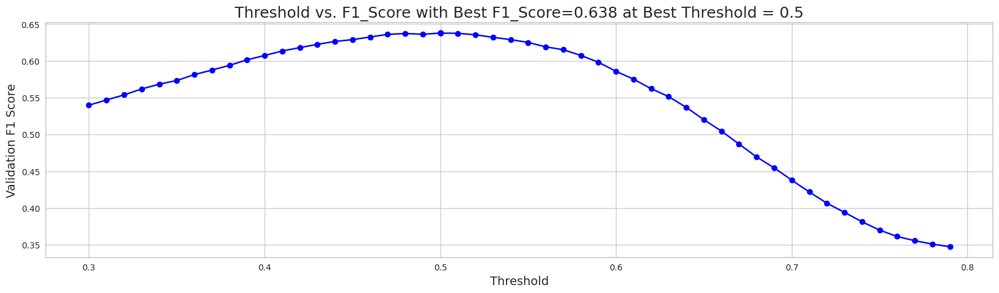

When using optimal threshold = 0.50...
Q0: F1 = 0.6377626299769528
==> Overall F1 = 0.6377626299769528
s
[I 2023-05-23 04:30:13,384] Trial 35 finished with value: 0.6377626299769528 and parameters: {'num_leaves': 97, 'learning_rate': 0.01425892831848534, 'feature_fraction': 0.9090773246594971, 'bagging_fraction': 0.8566752152725247, 'bagging_freq': 2, 'min_child_samples': 88, 'reg_alpha': 4.371686465871328, 'reg_lambda': 0.20598947057615016, 'subsample': 0.6060593960049441, 'colsample_bytree': 0.41903374489835077, 'min_split_gain': 0.004593905742204617, 'max_depth': 3}. Best is trial 26 with value: 0.6395434547872618.


--------------------------------------------------
question15, with255features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.7562620924891463, subsample=0.7242039323230427 will be ignored. Current value: bagging_fraction=0.7562620924891463
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.6962456130380489, colsample_bytree=0.5164002855609142 will be ignored. Current value: feature_fraction=0.6962456130380489


[LightGBM] [Warning] bagging_fraction is set=0.7720686787688288, subsample=0.6473438914418462 will be ignored. Current value: bagging_fraction=0.7720686787688288
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.6815397456733301, colsample_bytree=0.3921810453683415 will be ignored. Current value: feature_fraction=0.6815397456733301


[LightGBM] [Warning] bagging_fraction is set=0.7584755548763126, subsample=0.6433788763274594 will be ignored. Current value: bagging_fraction=0.7584755548763126
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.6827648302277747, colsample_bytree=0.4112472429389676 will be ignored. Current value: feature_fraction=0.6827648302277747


[LightGBM] [Warning] bagging_fraction is set=0.7562620924891463, subsample=0.7242039323230427 will be ignored. Current value: bagging_fraction=0.7562620924891463
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.6962456130380489, colsample_bytree=0.5164002855609142 will be ignored. Current value: feature_fraction=0.6962456130380489


,mean
feature,
6_page_counts,205.0
elapsed_time_diff_std,189.2
17_level_counts,166.6
savedteddy_fqid_counts,147.0
tunic.historicalsociety.frontdesk.archivist_glasses.confrontation_recap_text_fqid_counts,140.8
map_click_event_name_counts,140.2
tracks_fqid_counts,130.6
journals_flag.pic_0.next_fqid_counts,129.0
directory_fqid_counts,127.8


[[0.93997834 0.06002166]
 [0.39627596 0.60372404]
 [0.33334299 0.66665701]
 ...
 [0.31976647 0.68023353]
 [0.28694887 0.71305113]
 [0.47300073 0.52699927]]


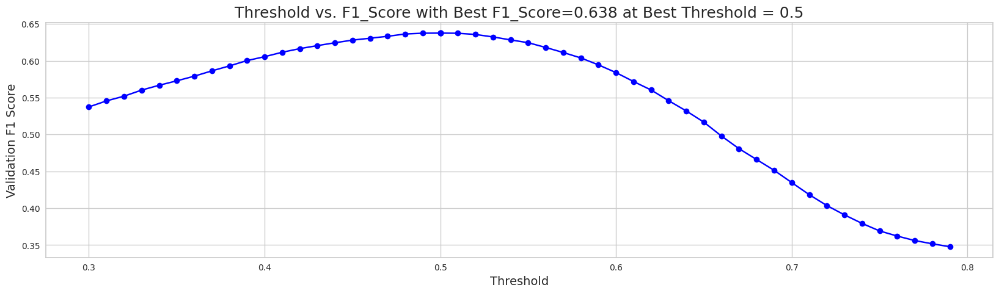

When using optimal threshold = 0.50...
Q0: F1 = 0.6375094389276177
==> Overall F1 = 0.6375094389276177
s
[I 2023-05-23 04:31:01,535] Trial 36 finished with value: 0.6375094389276177 and parameters: {'num_leaves': 85, 'learning_rate': 0.01467342374047157, 'feature_fraction': 0.8959617733384428, 'bagging_fraction': 0.997231570806528, 'bagging_freq': 2, 'min_child_samples': 92, 'reg_alpha': 4.230313193304481, 'reg_lambda': 0.17606375174440117, 'subsample': 0.6040636687802262, 'colsample_bytree': 0.38728915057281094, 'min_split_gain': 0.004571047533367661, 'max_depth': 3}. Best is trial 26 with value: 0.6395434547872618.


--------------------------------------------------
question15, with255features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.76276295097975, subsample=0.5426125104430294 will be ignored. Current value: bagging_fraction=0.76276295097975
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.6919869445234448, colsample_bytree=0.491355529701651 will be ignored. Current value: feature_fraction=0.6919869445234448


[LightGBM] [Warning] bagging_fraction is set=0.7562620924891463, subsample=0.7242039323230427 will be ignored. Current value: bagging_fraction=0.7562620924891463
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.6962456130380489, colsample_bytree=0.5164002855609142 will be ignored. Current value: feature_fraction=0.6962456130380489


,mean
feature,
elapsed_time_diff_std,175.2
6_page_counts,157.8
17_level_counts,139.0
tunic.historicalsociety.frontdesk.archivist_glasses.confrontation_recap_text_fqid_counts,133.0
map_click_event_name_counts,127.0
savedteddy_fqid_counts,117.4
journals_flag.pic_0.next_fqid_counts,114.6
elapsed_time_diff_sum,110.4
tracks_fqid_counts,106.6


[[0.93854454 0.06145546]
 [0.37023111 0.62976889]
 [0.33306693 0.66693307]
 ...
 [0.29533463 0.70466537]
 [0.29802784 0.70197216]
 [0.46116318 0.53883682]]


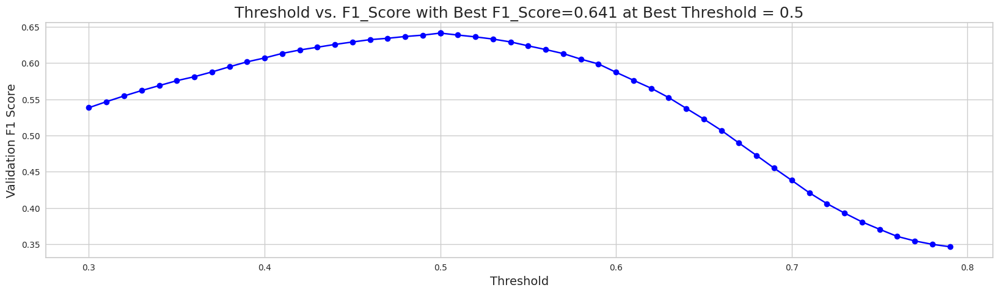

When using optimal threshold = 0.50...
Q0: F1 = 0.6414135982069524
==> Overall F1 = 0.6414135982069524
s
[I 2023-05-23 04:31:17,253] Trial 38 finished with value: 0.6414135982069524 and parameters: {'num_leaves': 93, 'learning_rate': 0.01487614863412093, 'feature_fraction': 0.6827648302277747, 'bagging_fraction': 0.7584755548763126, 'bagging_freq': 2, 'min_child_samples': 100, 'reg_alpha': 4.9161262108990975, 'reg_lambda': 0.1729223597305297, 'subsample': 0.6433788763274594, 'colsample_bytree': 0.4112472429389676, 'min_split_gain': 0.004746246556081909, 'max_depth': 3}. Best is trial 38 with value: 0.6414135982069524.


--------------------------------------------------
question15, with255features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.7720242129813207, subsample=0.7332183034098659 will be ignored. Current value: bagging_fraction=0.7720242129813207
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.6904595638697949, colsample_bytree=0.47805115503565937 will be ignored. Current value: feature_fraction=0.6904595638697949


[LightGBM] [Warning] bagging_fraction is set=0.7720686787688288, subsample=0.6473438914418462 will be ignored. Current value: bagging_fraction=0.7720686787688288
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.6815397456733301, colsample_bytree=0.3921810453683415 will be ignored. Current value: feature_fraction=0.6815397456733301


[LightGBM] [Warning] bagging_fraction is set=0.76276295097975, subsample=0.5426125104430294 will be ignored. Current value: bagging_fraction=0.76276295097975
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.6919869445234448, colsample_bytree=0.491355529701651 will be ignored. Current value: feature_fraction=0.6919869445234448


[LightGBM] [Warning] bagging_fraction is set=0.7562620924891463, subsample=0.7242039323230427 will be ignored. Current value: bagging_fraction=0.7562620924891463
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.6962456130380489, colsample_bytree=0.5164002855609142 will be ignored. Current value: feature_fraction=0.6962456130380489


[LightGBM] [Warning] bagging_fraction is set=0.7720242129813207, subsample=0.7332183034098659 will be ignored. Current value: bagging_fraction=0.7720242129813207
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.6904595638697949, colsample_bytree=0.47805115503565937 will be ignored. Current value: feature_fraction=0.6904595638697949


[LightGBM] [Warning] bagging_fraction is set=0.7720686787688288, subsample=0.6473438914418462 will be ignored. Current value: bagging_fraction=0.7720686787688288
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.6815397456733301, colsample_bytree=0.3921810453683415 will be ignored. Current value: feature_fraction=0.6815397456733301


[LightGBM] [Warning] bagging_fraction is set=0.7562620924891463, subsample=0.7242039323230427 will be ignored. Current value: bagging_fraction=0.7562620924891463
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.6962456130380489, colsample_bytree=0.5164002855609142 will be ignored. Current value: feature_fraction=0.6962456130380489


[LightGBM] [Warning] bagging_fraction is set=0.76276295097975, subsample=0.5426125104430294 will be ignored. Current value: bagging_fraction=0.76276295097975
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.6919869445234448, colsample_bytree=0.491355529701651 will be ignored. Current value: feature_fraction=0.6919869445234448


[LightGBM] [Warning] bagging_fraction is set=0.7720242129813207, subsample=0.7332183034098659 will be ignored. Current value: bagging_fraction=0.7720242129813207
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.6904595638697949, colsample_bytree=0.47805115503565937 will be ignored. Current value: feature_fraction=0.6904595638697949


[LightGBM] [Warning] bagging_fraction is set=0.7720686787688288, subsample=0.6473438914418462 will be ignored. Current value: bagging_fraction=0.7720686787688288
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.6815397456733301, colsample_bytree=0.3921810453683415 will be ignored. Current value: feature_fraction=0.6815397456733301


,mean
feature,
elapsed_time_diff_std,158.4
6_page_counts,149.2
17_level_counts,138.2
tunic.historicalsociety.frontdesk.archivist_glasses.confrontation_recap_text_fqid_counts,133.8
savedteddy_fqid_counts,125.0
map_click_event_name_counts,122.8
20_level_counts,115.8
elapsed_time_diff_sum,106.8
journals_flag.pic_0.next_fqid_counts,106.2


[LightGBM] [Warning] bagging_fraction is set=0.76276295097975, subsample=0.5426125104430294 will be ignored. Current value: bagging_fraction=0.76276295097975
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.6919869445234448, colsample_bytree=0.491355529701651 will be ignored. Current value: feature_fraction=0.6919869445234448
[[0.93681728 0.06318272]
 [0.36418218 0.63581782]
 [0.33346191 0.66653809]
 ...
 [0.31458218 0.68541782]
 [0.28435984 0.71564016]
 [0.45718106 0.54281894]]


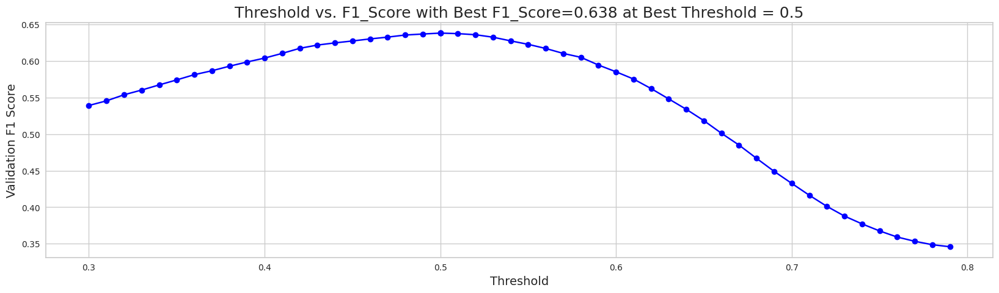

When using optimal threshold = 0.50...
Q0: F1 = 0.6383159324335794
==> Overall F1 = 0.6383159324335794
s
[I 2023-05-23 04:32:39,875] Trial 40 finished with value: 0.6383159324335794 and parameters: {'num_leaves': 91, 'learning_rate': 0.01744710307969674, 'feature_fraction': 0.6962456130380489, 'bagging_fraction': 0.7562620924891463, 'bagging_freq': 2, 'min_child_samples': 94, 'reg_alpha': 2.532811049420563, 'reg_lambda': 0.13082201196289567, 'subsample': 0.7242039323230427, 'colsample_bytree': 0.5164002855609142, 'min_split_gain': 0.001773238312861227, 'max_depth': 4}. Best is trial 38 with value: 0.6414135982069524.


--------------------------------------------------
question15, with255features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.7723234549265047, subsample=0.8207915670131993 will be ignored. Current value: bagging_fraction=0.7723234549265047
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.6935646570799732, colsample_bytree=0.4508558207795912 will be ignored. Current value: feature_fraction=0.6935646570799732


[LightGBM] [Warning] bagging_fraction is set=0.7720242129813207, subsample=0.7332183034098659 will be ignored. Current value: bagging_fraction=0.7720242129813207
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.6904595638697949, colsample_bytree=0.47805115503565937 will be ignored. Current value: feature_fraction=0.6904595638697949


,mean
feature,
elapsed_time_diff_std,185.2
6_page_counts,172.0
17_level_counts,156.6
tunic.historicalsociety.frontdesk.archivist_glasses.confrontation_recap_text_fqid_counts,149.2
map_click_event_name_counts,143.0
journals_flag.pic_0.next_fqid_counts,130.6
savedteddy_fqid_counts,128.8
tracks_fqid_counts,120.0
elapsed_time_diff_sum,120.0


[[0.93685198 0.06314802]
 [0.38985339 0.61014661]
 [0.34602162 0.65397838]
 ...
 [0.30421643 0.69578357]
 [0.29919768 0.70080232]
 [0.48451569 0.51548431]]


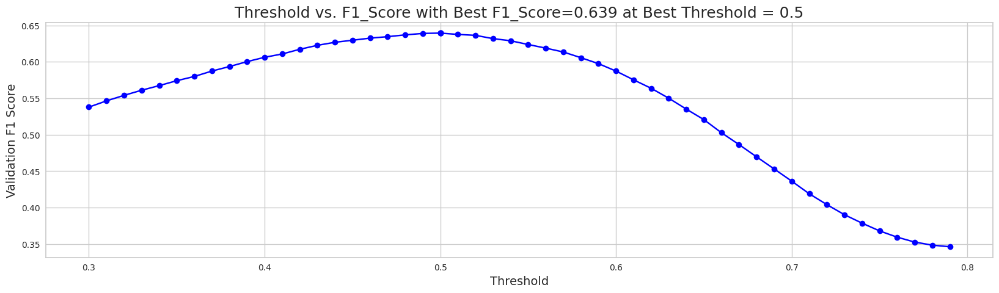

When using optimal threshold = 0.50...
Q0: F1 = 0.6393769570602014
==> Overall F1 = 0.6393769570602014
s
[I 2023-05-23 04:32:55,728] Trial 39 finished with value: 0.6393769570602014 and parameters: {'num_leaves': 94, 'learning_rate': 0.013339962006656788, 'feature_fraction': 0.6815397456733301, 'bagging_fraction': 0.7720686787688288, 'bagging_freq': 2, 'min_child_samples': 100, 'reg_alpha': 5.063938334418297, 'reg_lambda': 0.16367294741141344, 'subsample': 0.6473438914418462, 'colsample_bytree': 0.3921810453683415, 'min_split_gain': 0.003757158359676251, 'max_depth': 3}. Best is trial 38 with value: 0.6414135982069524.


--------------------------------------------------
question15, with255features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.7720135391604717, subsample=0.6514312766301602 will be ignored. Current value: bagging_fraction=0.7720135391604717
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.6746296360046312, colsample_bytree=0.448060015938869 will be ignored. Current value: feature_fraction=0.6746296360046312


[LightGBM] [Warning] bagging_fraction is set=0.7723234549265047, subsample=0.8207915670131993 will be ignored. Current value: bagging_fraction=0.7723234549265047
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.6935646570799732, colsample_bytree=0.4508558207795912 will be ignored. Current value: feature_fraction=0.6935646570799732


[LightGBM] [Warning] bagging_fraction is set=0.76276295097975, subsample=0.5426125104430294 will be ignored. Current value: bagging_fraction=0.76276295097975
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.6919869445234448, colsample_bytree=0.491355529701651 will be ignored. Current value: feature_fraction=0.6919869445234448


[LightGBM] [Warning] bagging_fraction is set=0.7720242129813207, subsample=0.7332183034098659 will be ignored. Current value: bagging_fraction=0.7720242129813207
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.6904595638697949, colsample_bytree=0.47805115503565937 will be ignored. Current value: feature_fraction=0.6904595638697949


[LightGBM] [Warning] bagging_fraction is set=0.7720135391604717, subsample=0.6514312766301602 will be ignored. Current value: bagging_fraction=0.7720135391604717
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.6746296360046312, colsample_bytree=0.448060015938869 will be ignored. Current value: feature_fraction=0.6746296360046312


[LightGBM] [Warning] bagging_fraction is set=0.7723234549265047, subsample=0.8207915670131993 will be ignored. Current value: bagging_fraction=0.7723234549265047
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.6935646570799732, colsample_bytree=0.4508558207795912 will be ignored. Current value: feature_fraction=0.6935646570799732


,mean
feature,
elapsed_time_diff_std,160.6
6_page_counts,153.6
17_level_counts,143.8
tunic.historicalsociety.frontdesk.archivist_glasses.confrontation_recap_text_fqid_counts,130.2
savedteddy_fqid_counts,126.4
20_level_counts,122.8
map_click_event_name_counts,122.6
elapsed_time_diff_sum,120.0
journals_flag.pic_0.next_fqid_counts,114.0


[[0.93428029 0.06571971]
 [0.37208876 0.62791124]
 [0.33452922 0.66547078]
 ...
 [0.30482913 0.69517087]
 [0.29871908 0.70128092]
 [0.45715912 0.54284088]]


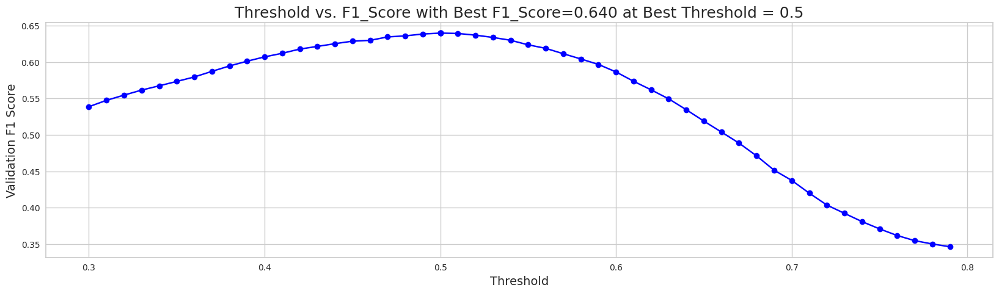

When using optimal threshold = 0.50...
Q0: F1 = 0.6397163051072031
==> Overall F1 = 0.6397163051072031
s
[I 2023-05-23 04:33:35,967] Trial 41 finished with value: 0.6397163051072031 and parameters: {'num_leaves': 93, 'learning_rate': 0.017653707959695463, 'feature_fraction': 0.6919869445234448, 'bagging_fraction': 0.76276295097975, 'bagging_freq': 2, 'min_child_samples': 95, 'reg_alpha': 2.75130049658347, 'reg_lambda': 0.45193917773999986, 'subsample': 0.5426125104430294, 'colsample_bytree': 0.491355529701651, 'min_split_gain': 0.01771863913614674, 'max_depth': 4}. Best is trial 38 with value: 0.6414135982069524.


--------------------------------------------------
question15, with255features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.7493573148301648, subsample=0.5443513099029956 will be ignored. Current value: bagging_fraction=0.7493573148301648
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.6431590643964356, colsample_bytree=0.4654175998914502 will be ignored. Current value: feature_fraction=0.6431590643964356


[LightGBM] [Warning] bagging_fraction is set=0.7720135391604717, subsample=0.6514312766301602 will be ignored. Current value: bagging_fraction=0.7720135391604717
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.6746296360046312, colsample_bytree=0.448060015938869 will be ignored. Current value: feature_fraction=0.6746296360046312


[LightGBM] [Warning] bagging_fraction is set=0.7723234549265047, subsample=0.8207915670131993 will be ignored. Current value: bagging_fraction=0.7723234549265047
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.6935646570799732, colsample_bytree=0.4508558207795912 will be ignored. Current value: feature_fraction=0.6935646570799732


,mean
feature,
elapsed_time_diff_std,171.2
6_page_counts,154.6
17_level_counts,151.4
savedteddy_fqid_counts,130.2
tunic.historicalsociety.frontdesk.archivist_glasses.confrontation_recap_text_fqid_counts,127.2
map_click_event_name_counts,124.0
20_level_counts,119.8
elapsed_time_diff_sum,116.8
journals_flag.pic_0.next_fqid_counts,111.8


[[0.94372511 0.05627489]
 [0.38271602 0.61728398]
 [0.33099874 0.66900126]
 ...
 [0.30969454 0.69030546]
 [0.28441947 0.71558053]
 [0.44840912 0.55159088]]


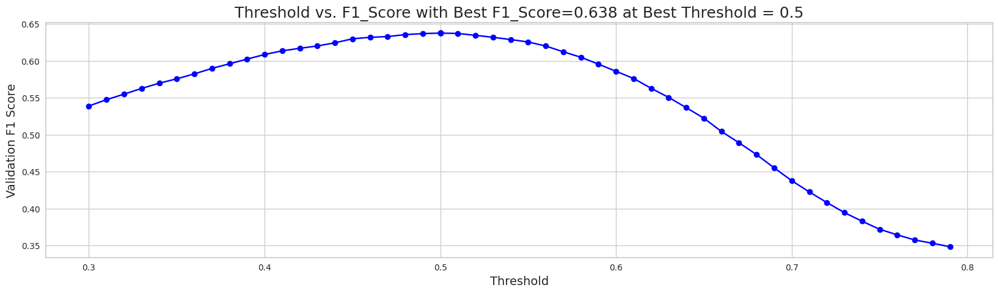

When using optimal threshold = 0.50...
Q0: F1 = 0.6375074278647038
==> Overall F1 = 0.6375074278647038
s
[I 2023-05-23 04:33:59,685] Trial 42 finished with value: 0.6375074278647038 and parameters: {'num_leaves': 91, 'learning_rate': 0.018365069674112302, 'feature_fraction': 0.6904595638697949, 'bagging_fraction': 0.7720242129813207, 'bagging_freq': 2, 'min_child_samples': 95, 'reg_alpha': 2.1752877050757555, 'reg_lambda': 0.47503709870715516, 'subsample': 0.7332183034098659, 'colsample_bytree': 0.47805115503565937, 'min_split_gain': 0.01818147594057324, 'max_depth': 4}. Best is trial 38 with value: 0.6414135982069524.


--------------------------------------------------
question15, with255features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.7372210467452562, subsample=0.543172179432257 will be ignored. Current value: bagging_fraction=0.7372210467452562
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.6290431270116232, colsample_bytree=0.4634086061591448 will be ignored. Current value: feature_fraction=0.6290431270116232


[LightGBM] [Warning] bagging_fraction is set=0.7723234549265047, subsample=0.8207915670131993 will be ignored. Current value: bagging_fraction=0.7723234549265047
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.6935646570799732, colsample_bytree=0.4508558207795912 will be ignored. Current value: feature_fraction=0.6935646570799732


[LightGBM] [Warning] bagging_fraction is set=0.7493573148301648, subsample=0.5443513099029956 will be ignored. Current value: bagging_fraction=0.7493573148301648
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.6431590643964356, colsample_bytree=0.4654175998914502 will be ignored. Current value: feature_fraction=0.6431590643964356


[LightGBM] [Warning] bagging_fraction is set=0.7720135391604717, subsample=0.6514312766301602 will be ignored. Current value: bagging_fraction=0.7720135391604717
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.6746296360046312, colsample_bytree=0.448060015938869 will be ignored. Current value: feature_fraction=0.6746296360046312


[LightGBM] [Warning] bagging_fraction is set=0.7372210467452562, subsample=0.543172179432257 will be ignored. Current value: bagging_fraction=0.7372210467452562
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.6290431270116232, colsample_bytree=0.4634086061591448 will be ignored. Current value: feature_fraction=0.6290431270116232


[LightGBM] [Warning] bagging_fraction is set=0.7720135391604717, subsample=0.6514312766301602 will be ignored. Current value: bagging_fraction=0.7720135391604717
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.6746296360046312, colsample_bytree=0.448060015938869 will be ignored. Current value: feature_fraction=0.6746296360046312


,mean
feature,
elapsed_time_diff_std,112.0
6_page_counts,102.6
17_level_counts,98.8
map_click_event_name_counts,83.8
tunic.historicalsociety.frontdesk.archivist_glasses.confrontation_recap_text_fqid_counts,83.2
savedteddy_fqid_counts,81.4
elapsed_time_diff_sum,80.6
hover_duration_sum,77.6
hover_duration_max,76.2


[[0.95582565 0.04417435]
 [0.36958217 0.63041783]
 [0.31419434 0.68580566]
 ...
 [0.29670636 0.70329364]
 [0.26930354 0.73069646]
 [0.45096964 0.54903036]]


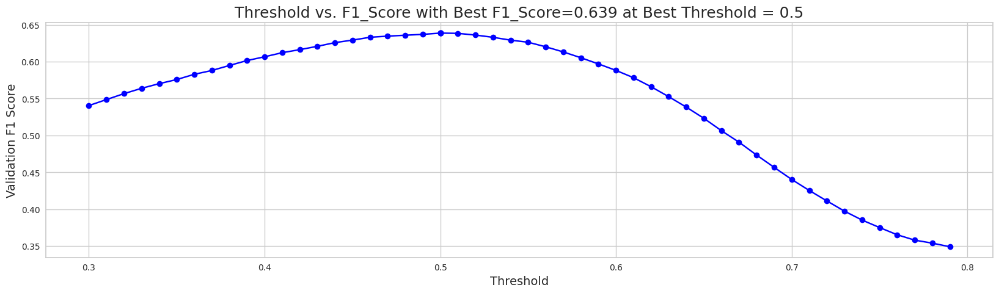

When using optimal threshold = 0.50...
Q0: F1 = 0.6386972779858701
==> Overall F1 = 0.6386972779858701
s
[I 2023-05-23 04:34:38,903] Trial 43 finished with value: 0.6386972779858701 and parameters: {'num_leaves': 92, 'learning_rate': 0.028311335060565147, 'feature_fraction': 0.6935646570799732, 'bagging_fraction': 0.7723234549265047, 'bagging_freq': 1, 'min_child_samples': 99, 'reg_alpha': 1.9778335657136572, 'reg_lambda': 0.4100190715360773, 'subsample': 0.8207915670131993, 'colsample_bytree': 0.4508558207795912, 'min_split_gain': 0.015921820527298285, 'max_depth': 4}. Best is trial 38 with value: 0.6414135982069524.


--------------------------------------------------
question15, with255features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.7245666126454778, subsample=0.5517485278327936 will be ignored. Current value: bagging_fraction=0.7245666126454778
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.5743453673718513, colsample_bytree=0.5447631130599404 will be ignored. Current value: feature_fraction=0.5743453673718513


[LightGBM] [Warning] bagging_fraction is set=0.7372210467452562, subsample=0.543172179432257 will be ignored. Current value: bagging_fraction=0.7372210467452562
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.6290431270116232, colsample_bytree=0.4634086061591448 will be ignored. Current value: feature_fraction=0.6290431270116232


,mean
feature,
6_page_counts,127.6
elapsed_time_diff_std,123.4
17_level_counts,108.2
map_click_event_name_counts,102.6
tunic.historicalsociety.frontdesk.archivist_glasses.confrontation_recap_text_fqid_counts,94.8
savedteddy_fqid_counts,89.2
journals_flag.pic_0.next_fqid_counts,85.8
tracks_fqid_counts,80.2
elapsed_time_diff_sum,76.4


[[0.94070033 0.05929967]
 [0.38359645 0.61640355]
 [0.31413435 0.68586565]
 ...
 [0.30221222 0.69778778]
 [0.29755783 0.70244217]
 [0.45303239 0.54696761]]


[LightGBM] [Warning] bagging_fraction is set=0.7493573148301648, subsample=0.5443513099029956 will be ignored. Current value: bagging_fraction=0.7493573148301648
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.6431590643964356, colsample_bytree=0.4654175998914502 will be ignored. Current value: feature_fraction=0.6431590643964356


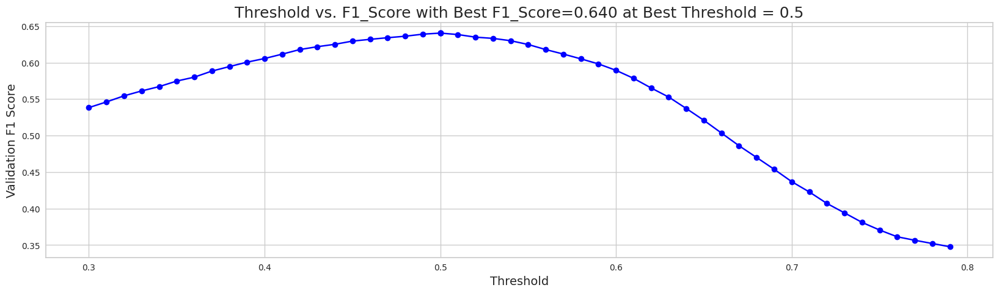

When using optimal threshold = 0.50...
Q0: F1 = 0.6404377343135417
==> Overall F1 = 0.6404377343135417
s
[I 2023-05-23 04:35:05,034] Trial 44 finished with value: 0.6404377343135417 and parameters: {'num_leaves': 91, 'learning_rate': 0.019710268799928245, 'feature_fraction': 0.6746296360046312, 'bagging_fraction': 0.7720135391604717, 'bagging_freq': 1, 'min_child_samples': 100, 'reg_alpha': 2.0513859651694992, 'reg_lambda': 0.46069186845360116, 'subsample': 0.6514312766301602, 'colsample_bytree': 0.448060015938869, 'min_split_gain': 0.01751185632684583, 'max_depth': 3}. Best is trial 38 with value: 0.6414135982069524.


--------------------------------------------------
question15, with255features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.8053483161787527, subsample=0.5477957591583822 will be ignored. Current value: bagging_fraction=0.8053483161787527
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
[LightGBM] [Warning] feature_fraction is set=0.6036518502963221, colsample_bytree=0.543524647315385 will be ignored. Current value: feature_fraction=0.6036518502963221


[LightGBM] [Warning] bagging_fraction is set=0.7372210467452562, subsample=0.543172179432257 will be ignored. Current value: bagging_fraction=0.7372210467452562
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.6290431270116232, colsample_bytree=0.4634086061591448 will be ignored. Current value: feature_fraction=0.6290431270116232


[LightGBM] [Warning] bagging_fraction is set=0.7245666126454778, subsample=0.5517485278327936 will be ignored. Current value: bagging_fraction=0.7245666126454778
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.5743453673718513, colsample_bytree=0.5447631130599404 will be ignored. Current value: feature_fraction=0.5743453673718513


[LightGBM] [Warning] bagging_fraction is set=0.7372210467452562, subsample=0.543172179432257 will be ignored. Current value: bagging_fraction=0.7372210467452562
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.6290431270116232, colsample_bytree=0.4634086061591448 will be ignored. Current value: feature_fraction=0.6290431270116232


[LightGBM] [Warning] bagging_fraction is set=0.8053483161787527, subsample=0.5477957591583822 will be ignored. Current value: bagging_fraction=0.8053483161787527
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
[LightGBM] [Warning] feature_fraction is set=0.6036518502963221, colsample_bytree=0.543524647315385 will be ignored. Current value: feature_fraction=0.6036518502963221


[LightGBM] [Warning] bagging_fraction is set=0.7245666126454778, subsample=0.5517485278327936 will be ignored. Current value: bagging_fraction=0.7245666126454778
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.5743453673718513, colsample_bytree=0.5447631130599404 will be ignored. Current value: feature_fraction=0.5743453673718513


[LightGBM] [Warning] bagging_fraction is set=0.7493573148301648, subsample=0.5443513099029956 will be ignored. Current value: bagging_fraction=0.7493573148301648
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.6431590643964356, colsample_bytree=0.4654175998914502 will be ignored. Current value: feature_fraction=0.6431590643964356


,mean
feature,
elapsed_time_diff_std,107.0
6_page_counts,104.8
17_level_counts,95.6
savedteddy_fqid_counts,91.0
map_click_event_name_counts,85.8
20_level_counts,81.8
screen_coor_x_std,78.8
elapsed_time_diff_sum,78.6
tunic.historicalsociety.frontdesk.archivist_glasses.confrontation_recap_text_fqid_counts,76.4


[[0.93548298 0.06451702]
 [0.36274892 0.63725108]
 [0.30837581 0.69162419]
 ...
 [0.28253932 0.71746068]
 [0.30404305 0.69595695]
 [0.44105323 0.55894677]]


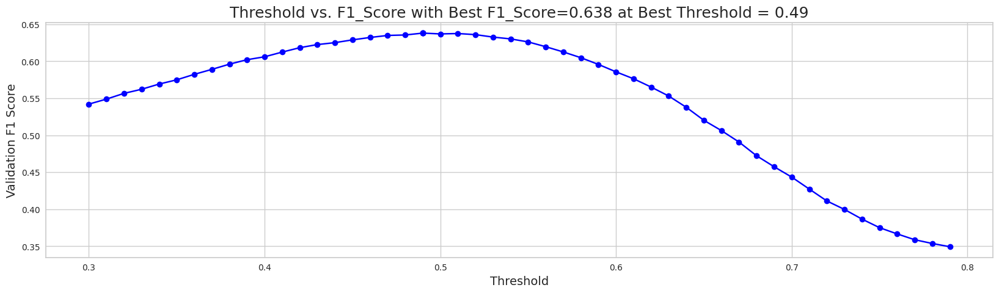

When using optimal threshold = 0.49...
Q0: F1 = 0.6381851293033314
==> Overall F1 = 0.6381851293033314
s
[I 2023-05-23 04:35:56,929] Trial 46 finished with value: 0.6381851293033314 and parameters: {'num_leaves': 80, 'learning_rate': 0.0273339993002113, 'feature_fraction': 0.6290431270116232, 'bagging_fraction': 0.7372210467452562, 'bagging_freq': 1, 'min_child_samples': 100, 'reg_alpha': 1.8040989171591997, 'reg_lambda': 1.5808824558728671, 'subsample': 0.543172179432257, 'colsample_bytree': 0.4634086061591448, 'min_split_gain': 0.006023608535830832, 'max_depth': 4}. Best is trial 38 with value: 0.6414135982069524.


--------------------------------------------------
question15, with255features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.7103499133841578, subsample=0.7036258493239876 will be ignored. Current value: bagging_fraction=0.7103499133841578
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
[LightGBM] [Warning] feature_fraction is set=0.567706348245326, colsample_bytree=0.5264737980460802 will be ignored. Current value: feature_fraction=0.567706348245326


[LightGBM] [Warning] bagging_fraction is set=0.8053483161787527, subsample=0.5477957591583822 will be ignored. Current value: bagging_fraction=0.8053483161787527
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
[LightGBM] [Warning] feature_fraction is set=0.6036518502963221, colsample_bytree=0.543524647315385 will be ignored. Current value: feature_fraction=0.6036518502963221


[LightGBM] [Warning] bagging_fraction is set=0.7493573148301648, subsample=0.5443513099029956 will be ignored. Current value: bagging_fraction=0.7493573148301648
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.6431590643964356, colsample_bytree=0.4654175998914502 will be ignored. Current value: feature_fraction=0.6431590643964356


[LightGBM] [Warning] bagging_fraction is set=0.7245666126454778, subsample=0.5517485278327936 will be ignored. Current value: bagging_fraction=0.7245666126454778
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.5743453673718513, colsample_bytree=0.5447631130599404 will be ignored. Current value: feature_fraction=0.5743453673718513


[LightGBM] [Warning] bagging_fraction is set=0.8053483161787527, subsample=0.5477957591583822 will be ignored. Current value: bagging_fraction=0.8053483161787527
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
[LightGBM] [Warning] feature_fraction is set=0.6036518502963221, colsample_bytree=0.543524647315385 will be ignored. Current value: feature_fraction=0.6036518502963221


[LightGBM] [Warning] bagging_fraction is set=0.7103499133841578, subsample=0.7036258493239876 will be ignored. Current value: bagging_fraction=0.7103499133841578
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
[LightGBM] [Warning] feature_fraction is set=0.567706348245326, colsample_bytree=0.5264737980460802 will be ignored. Current value: feature_fraction=0.567706348245326


[LightGBM] [Warning] bagging_fraction is set=0.7245666126454778, subsample=0.5517485278327936 will be ignored. Current value: bagging_fraction=0.7245666126454778
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.5743453673718513, colsample_bytree=0.5447631130599404 will be ignored. Current value: feature_fraction=0.5743453673718513


[LightGBM] [Warning] bagging_fraction is set=0.8053483161787527, subsample=0.5477957591583822 will be ignored. Current value: bagging_fraction=0.8053483161787527
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
[LightGBM] [Warning] feature_fraction is set=0.6036518502963221, colsample_bytree=0.543524647315385 will be ignored. Current value: feature_fraction=0.6036518502963221


[LightGBM] [Warning] bagging_fraction is set=0.7103499133841578, subsample=0.7036258493239876 will be ignored. Current value: bagging_fraction=0.7103499133841578
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
[LightGBM] [Warning] feature_fraction is set=0.567706348245326, colsample_bytree=0.5264737980460802 will be ignored. Current value: feature_fraction=0.567706348245326


,mean
feature,
elapsed_time_diff_std,229.4
6_page_counts,221.6
17_level_counts,200.0
savedteddy_fqid_counts,183.4
tunic.historicalsociety.frontdesk.archivist_glasses.confrontation_recap_text_fqid_counts,181.8
map_click_event_name_counts,181.2
20_level_counts,165.8
elapsed_time_diff_sum,165.2
journals_flag.pic_0.next_fqid_counts,156.0


[[0.9187851  0.0812149 ]
 [0.37093863 0.62906137]
 [0.32903549 0.67096451]
 ...
 [0.2948471  0.7051529 ]
 [0.28520186 0.71479814]
 [0.45402636 0.54597364]]


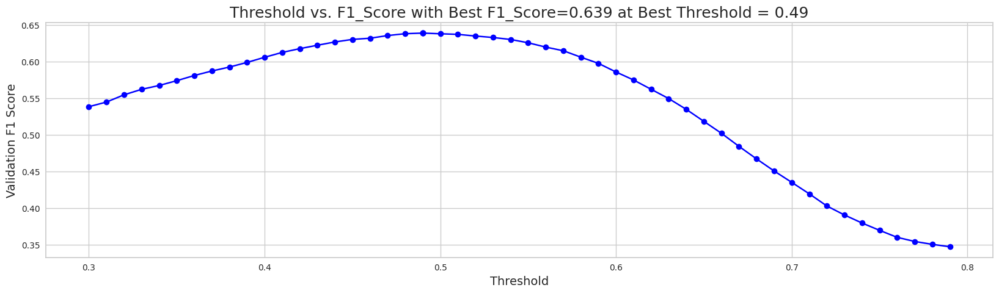

When using optimal threshold = 0.49...
Q0: F1 = 0.638747432313602
==> Overall F1 = 0.638747432313602
s
[I 2023-05-23 04:37:03,304] Trial 45 finished with value: 0.638747432313602 and parameters: {'num_leaves': 89, 'learning_rate': 0.012350026334198756, 'feature_fraction': 0.6431590643964356, 'bagging_fraction': 0.7493573148301648, 'bagging_freq': 1, 'min_child_samples': 95, 'reg_alpha': 1.9694094487060878, 'reg_lambda': 0.40306572135621693, 'subsample': 0.5443513099029956, 'colsample_bytree': 0.4654175998914502, 'min_split_gain': 0.019693790528519783, 'max_depth': 4}. Best is trial 38 with value: 0.6414135982069524.


,mean
feature,
elapsed_time_diff_std,187.2
17_level_counts,174.2
6_page_counts,165.4
tunic.historicalsociety.frontdesk.archivist_glasses.confrontation_recap_text_fqid_counts,156.6
elapsed_time_diff_sum,155.0
20_level_counts,149.6
hover_duration_sum,147.4
savedteddy_fqid_counts,141.6
map_click_event_name_counts,139.8


[[0.91953366 0.08046634]
 [0.34890428 0.65109572]
 [0.30740663 0.69259337]
 ...
 [0.27690032 0.72309968]
 [0.29392331 0.70607669]
 [0.4411242  0.5588758 ]]


[LightGBM] [Warning] bagging_fraction is set=0.7103499133841578, subsample=0.7036258493239876 will be ignored. Current value: bagging_fraction=0.7103499133841578
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
[LightGBM] [Warning] feature_fraction is set=0.567706348245326, colsample_bytree=0.5264737980460802 will be ignored. Current value: feature_fraction=0.567706348245326


,mean
feature,
elapsed_time_diff_std,161.4
17_level_counts,157.0
6_page_counts,141.8
20_level_counts,139.2
elapsed_time_diff_sum,133.8
room_coor_y_max,133.4
hover_duration_max,133.0
hover_duration_sum,131.0
savedteddy_fqid_counts,131.0


[[0.93434799 0.06565201]
 [0.35751975 0.64248025]
 [0.3359846  0.6640154 ]
 ...
 [0.29887162 0.70112838]
 [0.29474821 0.70525179]
 [0.4646131  0.5353869 ]]


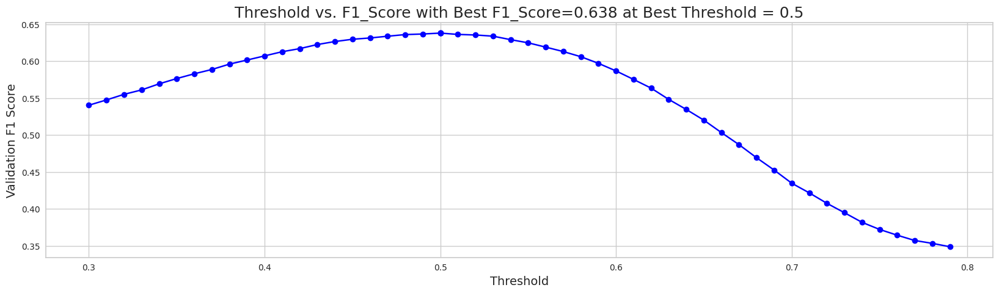

When using optimal threshold = 0.50...
Q0: F1 = 0.6378472466300042


==> Overall F1 = 0.6378472466300042
s
[I 2023-05-23 04:37:17,973] Trial 48 finished with value: 0.6378472466300042 and parameters: {'num_leaves': 87, 'learning_rate': 0.018721474734514527, 'feature_fraction': 0.6036518502963221, 'bagging_fraction': 0.8053483161787527, 'bagging_freq': 4, 'min_child_samples': 77, 'reg_alpha': 0.6486312027503535, 'reg_lambda': 1.5250240263219517, 'subsample': 0.5477957591583822, 'colsample_bytree': 0.543524647315385, 'min_split_gain': 0.03940008420116994, 'max_depth': 5}. Best is trial 38 with value: 0.6414135982069524.


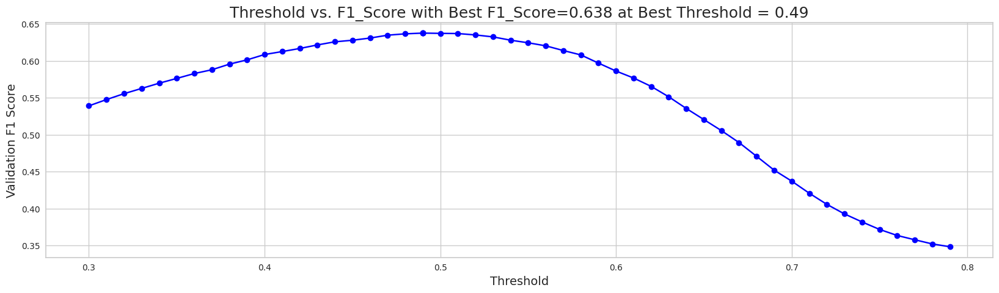

When using optimal threshold = 0.49...
Q0: F1 = 0.6375034350202036
==> Overall F1 = 0.6375034350202036
s
[I 2023-05-23 04:37:20,681] Trial 47 finished with value: 0.6375034350202036 and parameters: {'num_leaves': 81, 'learning_rate': 0.01996539094999678, 'feature_fraction': 0.5743453673718513, 'bagging_fraction': 0.7245666126454778, 'bagging_freq': 1, 'min_child_samples': 77, 'reg_alpha': 0.6651350350733316, 'reg_lambda': 2.161740071161645, 'subsample': 0.5517485278327936, 'colsample_bytree': 0.5447631130599404, 'min_split_gain': 0.006831659462792871, 'max_depth': 5}. Best is trial 38 with value: 0.6414135982069524.


[LightGBM] [Warning] bagging_fraction is set=0.7103499133841578, subsample=0.7036258493239876 will be ignored. Current value: bagging_fraction=0.7103499133841578
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
[LightGBM] [Warning] feature_fraction is set=0.567706348245326, colsample_bytree=0.5264737980460802 will be ignored. Current value: feature_fraction=0.567706348245326


,mean
feature,
elapsed_time_diff_std,147.8
6_page_counts,142.4
20_level_counts,135.0
17_level_counts,132.6
tunic.historicalsociety.frontdesk.archivist_glasses.confrontation_recap_text_fqid_counts,131.6
elapsed_time_diff_sum,120.6
savedteddy_fqid_counts,117.0
room_coor_y_max,115.2
hover_duration_sum,112.8


[[0.9347685  0.0652315 ]
 [0.37536832 0.62463168]
 [0.31708149 0.68291851]
 ...
 [0.30786575 0.69213425]
 [0.32250245 0.67749755]
 [0.48965087 0.51034913]]


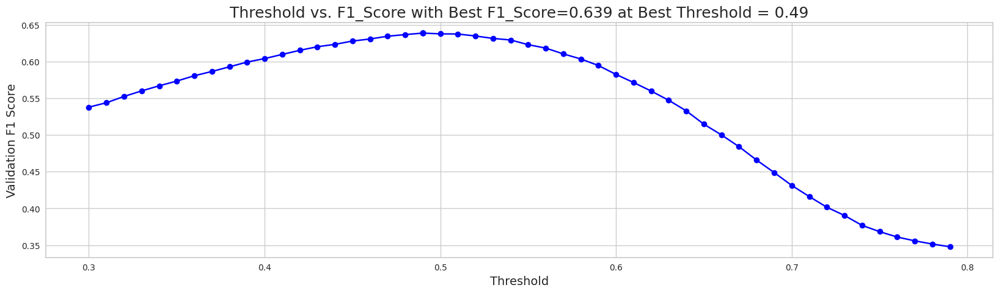

When using optimal threshold = 0.49...
Q0: F1 = 0.6388284244259586
==> Overall F1 = 0.6388284244259586
s
[I 2023-05-23 04:37:37,562] Trial 49 finished with value: 0.6388284244259586 and parameters: {'num_leaves': 87, 'learning_rate': 0.019980647366013245, 'feature_fraction': 0.567706348245326, 'bagging_fraction': 0.7103499133841578, 'bagging_freq': 4, 'min_child_samples': 77, 'reg_alpha': 0.5966914936622336, 'reg_lambda': 0.544151745238653, 'subsample': 0.7036258493239876, 'colsample_bytree': 0.5264737980460802, 'min_split_gain': 0.034340581428117634, 'max_depth': 5}. Best is trial 38 with value: 0.6414135982069524.


[I 2023-05-23 04:37:39,219] A new study created in memory with name: no-name-2499a976-1155-4b4c-a956-e3ef8120f309


{'num_leaves': 93, 'learning_rate': 0.01487614863412093, 'feature_fraction': 0.6827648302277747, 'bagging_fraction': 0.7584755548763126, 'bagging_freq': 2, 'min_child_samples': 100, 'reg_alpha': 4.9161262108990975, 'reg_lambda': 0.1729223597305297, 'subsample': 0.6433788763274594, 'colsample_bytree': 0.4112472429389676, 'min_split_gain': 0.004746246556081909, 'max_depth': 3}


  0%|          | 0/50 [00:00<?, ?it/s]

--------------------------------------------------
question16, with255features
--------------------------------------------------
--------------------------------------------------
question16, with255features
--------------------------------------------------
--------------------------------------------------
question16, with255features
--------------------------------------------------
--------------------------------------------------
question16, with255features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.899890205128738, subsample=0.9149317135479252 will be ignored. Current value: bagging_fraction=0.899890205128738
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.28117094876182663, colsample_bytree=0.8554632105683454 will be ignored. Current value: feature_fraction=0.28117094876182663


[LightGBM] [Warning] bagging_fraction is set=0.6734177761465817, subsample=0.581413226986254 will be ignored. Current value: bagging_fraction=0.6734177761465817
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.7595132433541157, colsample_bytree=0.906947378211834 will be ignored. Current value: feature_fraction=0.7595132433541157
[LightGBM] [Warning] bagging_fraction is set=0.6659195949514394, subsample=0.17156547981249765 will be ignored. Current value: bagging_fraction=0.6659195949514394
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=10, subsample_freq=0 will be ignored. Current value: bagging_freq=10
[LightGBM] [Warning] f

[LightGBM] [Warning] bagging_fraction is set=0.6970802108010358, subsample=0.351821901535598 will be ignored. Current value: bagging_fraction=0.6970802108010358
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=8, subsample_freq=0 will be ignored. Current value: bagging_freq=8
[LightGBM] [Warning] feature_fraction is set=0.5192526681186779, colsample_bytree=0.9528072216852058 will be ignored. Current value: feature_fraction=0.5192526681186779


[LightGBM] [Warning] bagging_fraction is set=0.6734177761465817, subsample=0.581413226986254 will be ignored. Current value: bagging_fraction=0.6734177761465817
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.7595132433541157, colsample_bytree=0.906947378211834 will be ignored. Current value: feature_fraction=0.7595132433541157
[LightGBM] [Warning] bagging_fraction is set=0.899890205128738, subsample=0.9149317135479252 will be ignored. Current value: bagging_fraction=0.899890205128738
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] featur

[LightGBM] [Warning] bagging_fraction is set=0.6659195949514394, subsample=0.17156547981249765 will be ignored. Current value: bagging_fraction=0.6659195949514394
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=10, subsample_freq=0 will be ignored. Current value: bagging_freq=10
[LightGBM] [Warning] feature_fraction is set=0.6329053055805345, colsample_bytree=0.7187693616362177 will be ignored. Current value: feature_fraction=0.6329053055805345
[LightGBM] [Warning] bagging_fraction is set=0.6970802108010358, subsample=0.351821901535598 will be ignored. Current value: bagging_fraction=0.6970802108010358
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=8, subsample_freq=0 will be ignored. Current value: bagging_freq=8
[LightGBM] [Warning] 

[LightGBM] [Warning] bagging_fraction is set=0.6734177761465817, subsample=0.581413226986254 will be ignored. Current value: bagging_fraction=0.6734177761465817
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.7595132433541157, colsample_bytree=0.906947378211834 will be ignored. Current value: feature_fraction=0.7595132433541157


[LightGBM] [Warning] bagging_fraction is set=0.6970802108010358, subsample=0.351821901535598 will be ignored. Current value: bagging_fraction=0.6970802108010358
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=8, subsample_freq=0 will be ignored. Current value: bagging_freq=8
[LightGBM] [Warning] feature_fraction is set=0.5192526681186779, colsample_bytree=0.9528072216852058 will be ignored. Current value: feature_fraction=0.5192526681186779


[LightGBM] [Warning] bagging_fraction is set=0.899890205128738, subsample=0.9149317135479252 will be ignored. Current value: bagging_fraction=0.899890205128738
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.28117094876182663, colsample_bytree=0.8554632105683454 will be ignored. Current value: feature_fraction=0.28117094876182663


[LightGBM] [Warning] bagging_fraction is set=0.6734177761465817, subsample=0.581413226986254 will be ignored. Current value: bagging_fraction=0.6734177761465817
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.7595132433541157, colsample_bytree=0.906947378211834 will be ignored. Current value: feature_fraction=0.7595132433541157


[LightGBM] [Warning] bagging_fraction is set=0.6659195949514394, subsample=0.17156547981249765 will be ignored. Current value: bagging_fraction=0.6659195949514394
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=10, subsample_freq=0 will be ignored. Current value: bagging_freq=10
[LightGBM] [Warning] feature_fraction is set=0.6329053055805345, colsample_bytree=0.7187693616362177 will be ignored. Current value: feature_fraction=0.6329053055805345


[LightGBM] [Warning] bagging_fraction is set=0.6970802108010358, subsample=0.351821901535598 will be ignored. Current value: bagging_fraction=0.6970802108010358
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=8, subsample_freq=0 will be ignored. Current value: bagging_freq=8
[LightGBM] [Warning] feature_fraction is set=0.5192526681186779, colsample_bytree=0.9528072216852058 will be ignored. Current value: feature_fraction=0.5192526681186779


[LightGBM] [Warning] bagging_fraction is set=0.899890205128738, subsample=0.9149317135479252 will be ignored. Current value: bagging_fraction=0.899890205128738
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.28117094876182663, colsample_bytree=0.8554632105683454 will be ignored. Current value: feature_fraction=0.28117094876182663


[LightGBM] [Warning] bagging_fraction is set=0.6734177761465817, subsample=0.581413226986254 will be ignored. Current value: bagging_fraction=0.6734177761465817
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.7595132433541157, colsample_bytree=0.906947378211834 will be ignored. Current value: feature_fraction=0.7595132433541157


,mean
feature,
hover_duration_max,2.0
19_level_counts,2.0
room_coor_y_std,1.8
elapsed_time_diff_sum,1.4
room_corr_x_diff_sum,1.2
tunic.capitol_2_fqid_counts,1.0
15_level_counts,1.0
session_id,1.0
hover_counts,1.0


[[0.35333107 0.64666893]
 [0.23847771 0.76152229]
 [0.27039746 0.72960254]
 ...
 [0.21661379 0.78338621]
 [0.22551526 0.77448474]
 [0.37332106 0.62667894]]


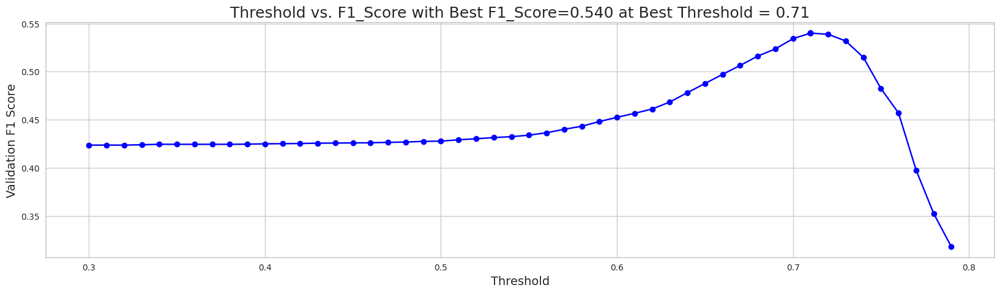

When using optimal threshold = 0.71...
Q0: F1 = 0.540114091505578
==> Overall F1 = 0.540114091505578
s
[I 2023-05-23 04:38:03,848] Trial 0 finished with value: 0.540114091505578 and parameters: {'num_leaves': 59, 'learning_rate': 0.4468944795022848, 'feature_fraction': 0.5192526681186779, 'bagging_fraction': 0.6970802108010358, 'bagging_freq': 8, 'min_child_samples': 50, 'reg_alpha': 0.047188770097748724, 'reg_lambda': 0.013312149277275783, 'subsample': 0.351821901535598, 'colsample_bytree': 0.9528072216852058, 'min_split_gain': 0.014446343390141895, 'max_depth': 3}. Best is trial 0 with value: 0.540114091505578.


--------------------------------------------------
question16, with255features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.5163559972734922, subsample=0.8891511914227775 will be ignored. Current value: bagging_fraction=0.5163559972734922
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=10, subsample_freq=0 will be ignored. Current value: bagging_freq=10
[LightGBM] [Warning] feature_fraction is set=0.9130274101136348, colsample_bytree=0.5060443634124544 will be ignored. Current value: feature_fraction=0.9130274101136348


,mean
feature,
hover_duration_sum,3.4
room_coor_x_min,2.8
19_level_counts,2.6
tunic.historicalsociety.cage_room_fqid_counts,2.2
directory_fqid_counts,2.2
screen_coor_x_std,2.0
hover_duration_max,2.0
elapsed_time_diff_sum,1.8
screen_corr_x_dff_sum,1.8


[[0.37944535 0.62055465]
 [0.24470579 0.75529421]
 [0.26829173 0.73170827]
 ...
 [0.20160603 0.79839397]
 [0.21731681 0.78268319]
 [0.24060263 0.75939737]]


[LightGBM] [Warning] bagging_fraction is set=0.6659195949514394, subsample=0.17156547981249765 will be ignored. Current value: bagging_fraction=0.6659195949514394
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=10, subsample_freq=0 will be ignored. Current value: bagging_freq=10
[LightGBM] [Warning] feature_fraction is set=0.6329053055805345, colsample_bytree=0.7187693616362177 will be ignored. Current value: feature_fraction=0.6329053055805345


[LightGBM] [Warning] bagging_fraction is set=0.899890205128738, subsample=0.9149317135479252 will be ignored. Current value: bagging_fraction=0.899890205128738
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.28117094876182663, colsample_bytree=0.8554632105683454 will be ignored. Current value: feature_fraction=0.28117094876182663


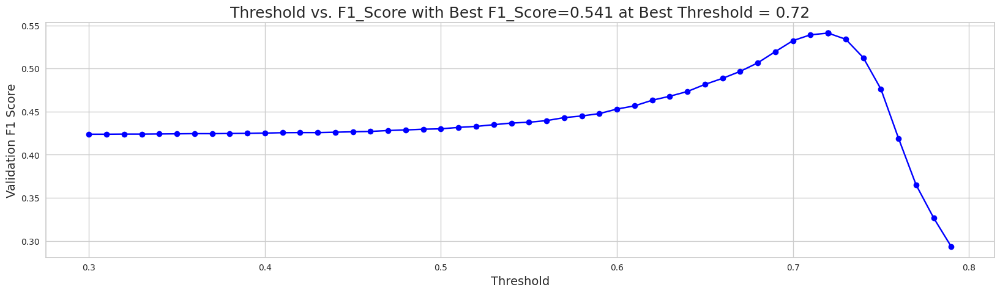

When using optimal threshold = 0.72...
Q0: F1 = 0.5410519577303912
==> Overall F1 = 0.5410519577303912
s
[I 2023-05-23 04:38:10,111] Trial 2 finished with value: 0.5410519577303912 and parameters: {'num_leaves': 57, 'learning_rate': 0.259003866869623, 'feature_fraction': 0.7595132433541157, 'bagging_fraction': 0.6734177761465817, 'bagging_freq': 3, 'min_child_samples': 9, 'reg_alpha': 0.024939003755295817, 'reg_lambda': 0.004544971918810261, 'subsample': 0.581413226986254, 'colsample_bytree': 0.906947378211834, 'min_split_gain': 0.09442427613587553, 'max_depth': 4}. Best is trial 2 with value: 0.5410519577303912.


--------------------------------------------------
question16, with255features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.3599093535055329, subsample=0.3840817609957372 will be ignored. Current value: bagging_fraction=0.3599093535055329
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=7, subsample_freq=0 will be ignored. Current value: bagging_freq=7
[LightGBM] [Warning] feature_fraction is set=0.5409009304056113, colsample_bytree=0.104872835793451 will be ignored. Current value: feature_fraction=0.5409009304056113


,mean
feature,
hover_duration_max,27.6
19_level_counts,26.6
hover_duration_sum,22.0
elapsed_time_diff_sum,21.8
15_level_counts,20.8
screen_coor_x_std,20.6
session_id,17.8
room_coor_y_std,15.2
day,15.0


[[0.42202927 0.57797073]
 [0.26818009 0.73181991]
 [0.25190982 0.74809018]
 ...
 [0.22558361 0.77441639]
 [0.22554578 0.77445422]
 [0.25175332 0.74824668]]


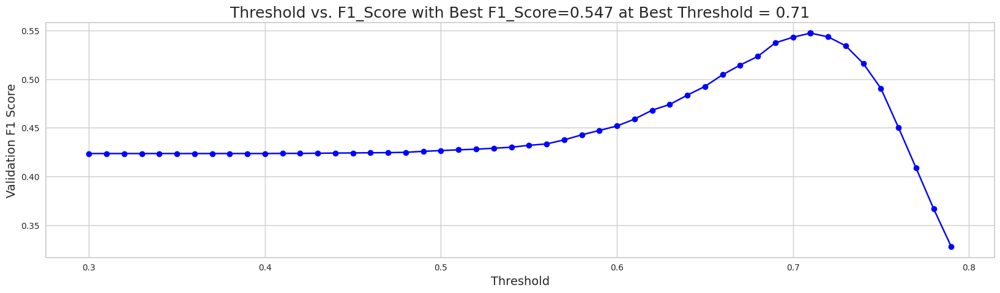

When using optimal threshold = 0.71...
Q0: F1 = 0.5471834056805736
==> Overall F1 = 0.5471834056805736
s
[I 2023-05-23 04:38:16,648] Trial 1 finished with value: 0.5471834056805736 and parameters: {'num_leaves': 96, 'learning_rate': 0.04353584087401894, 'feature_fraction': 0.28117094876182663, 'bagging_fraction': 0.899890205128738, 'bagging_freq': 1, 'min_child_samples': 56, 'reg_alpha': 0.23001121186371734, 'reg_lambda': 0.01363014399212762, 'subsample': 0.9149317135479252, 'colsample_bytree': 0.8554632105683454, 'min_split_gain': 0.00528507850519894, 'max_depth': 3}. Best is trial 1 with value: 0.5471834056805736.


[LightGBM] [Warning] bagging_fraction is set=0.6659195949514394, subsample=0.17156547981249765 will be ignored. Current value: bagging_fraction=0.6659195949514394
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=10, subsample_freq=0 will be ignored. Current value: bagging_freq=10
[LightGBM] [Warning] feature_fraction is set=0.6329053055805345, colsample_bytree=0.7187693616362177 will be ignored. Current value: feature_fraction=0.6329053055805345
--------------------------------------------------
question16, with255features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.7870722476788135, subsample=0.9238668330877422 will be ignored. Current value: bagging_fraction=0.7870722476788135
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
[LightGBM] [Warning] feature_fraction is set=0.35933862938216987, colsample_bytree=0.7589963369930317 will be ignored. Current value: feature_fraction=0.35933862938216987


[LightGBM] [Warning] bagging_fraction is set=0.3599093535055329, subsample=0.3840817609957372 will be ignored. Current value: bagging_fraction=0.3599093535055329
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=7, subsample_freq=0 will be ignored. Current value: bagging_freq=7
[LightGBM] [Warning] feature_fraction is set=0.5409009304056113, colsample_bytree=0.104872835793451 will be ignored. Current value: feature_fraction=0.5409009304056113
[LightGBM] [Warning] bagging_fraction is set=0.7870722476788135, subsample=0.9238668330877422 will be ignored. Current value: bagging_fraction=0.7870722476788135
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
[LightGBM] [Warning] fea

[LightGBM] [Warning] bagging_fraction is set=0.5163559972734922, subsample=0.8891511914227775 will be ignored. Current value: bagging_fraction=0.5163559972734922
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=10, subsample_freq=0 will be ignored. Current value: bagging_freq=10
[LightGBM] [Warning] feature_fraction is set=0.9130274101136348, colsample_bytree=0.5060443634124544 will be ignored. Current value: feature_fraction=0.9130274101136348


[LightGBM] [Warning] bagging_fraction is set=0.7870722476788135, subsample=0.9238668330877422 will be ignored. Current value: bagging_fraction=0.7870722476788135
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
[LightGBM] [Warning] feature_fraction is set=0.35933862938216987, colsample_bytree=0.7589963369930317 will be ignored. Current value: feature_fraction=0.35933862938216987


[LightGBM] [Warning] bagging_fraction is set=0.7870722476788135, subsample=0.9238668330877422 will be ignored. Current value: bagging_fraction=0.7870722476788135
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
[LightGBM] [Warning] feature_fraction is set=0.35933862938216987, colsample_bytree=0.7589963369930317 will be ignored. Current value: feature_fraction=0.35933862938216987


,mean
feature,
hover_duration_sum,42.2
19_level_counts,40.6
elapsed_time_diff_sum,34.4
session_id,32.2
15_level_counts,31.4
screen_coor_x_std,31.0
room_coor_y_std,30.6
hover_duration_max,28.8
elapsed_time_diff_mean,28.6


[[0.35296044 0.64703956]
 [0.25630862 0.74369138]
 [0.24048938 0.75951062]
 ...
 [0.20821175 0.79178825]
 [0.23887849 0.76112151]
 [0.24115429 0.75884571]]


[LightGBM] [Warning] bagging_fraction is set=0.3599093535055329, subsample=0.3840817609957372 will be ignored. Current value: bagging_fraction=0.3599093535055329
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=7, subsample_freq=0 will be ignored. Current value: bagging_freq=7
[LightGBM] [Warning] feature_fraction is set=0.5409009304056113, colsample_bytree=0.104872835793451 will be ignored. Current value: feature_fraction=0.5409009304056113


[LightGBM] [Warning] bagging_fraction is set=0.7870722476788135, subsample=0.9238668330877422 will be ignored. Current value: bagging_fraction=0.7870722476788135
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
[LightGBM] [Warning] feature_fraction is set=0.35933862938216987, colsample_bytree=0.7589963369930317 will be ignored. Current value: feature_fraction=0.35933862938216987


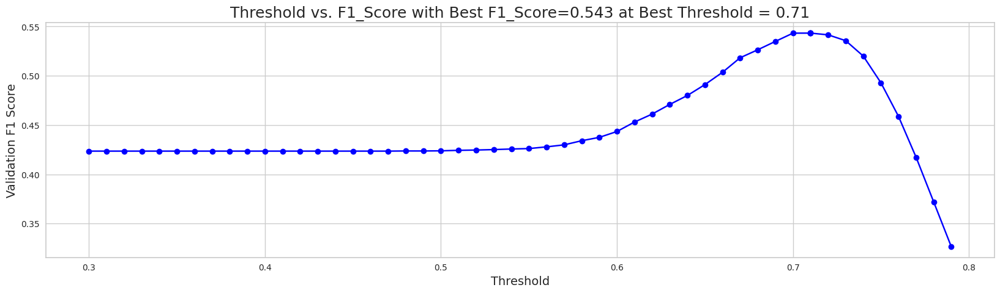

When using optimal threshold = 0.71...
Q0: F1 = 0.5433429883124571
==> Overall F1 = 0.5433429883124571
s
[I 2023-05-23 04:38:32,110] Trial 3 finished with value: 0.5433429883124571 and parameters: {'num_leaves': 83, 'learning_rate': 0.0327140669902323, 'feature_fraction': 0.6329053055805345, 'bagging_fraction': 0.6659195949514394, 'bagging_freq': 10, 'min_child_samples': 83, 'reg_alpha': 6.943208098868479, 'reg_lambda': 0.05858390503922716, 'subsample': 0.17156547981249765, 'colsample_bytree': 0.7187693616362177, 'min_split_gain': 0.009230349982858797, 'max_depth': 4}. Best is trial 1 with value: 0.5471834056805736.


--------------------------------------------------
question16, with255features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.538634123924326, subsample=0.6668758706813662 will be ignored. Current value: bagging_fraction=0.538634123924326
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.38523923078313593, colsample_bytree=0.7986471994233741 will be ignored. Current value: feature_fraction=0.38523923078313593


,mean
feature,
elapsed_time_diff_sum,2.6
19_level_counts,1.8
day,1.6
hover_duration_max,1.6
screen_coor_x_std,1.4
15_level_counts,1.2
hover_duration_std,1.2
hover_duration_sum,1.2
room_corr_y_diff_std,1.0


[[0.43377806 0.56622194]
 [0.27078824 0.72921176]
 [0.25268098 0.74731902]
 ...
 [0.22924768 0.77075232]
 [0.25622512 0.74377488]
 [0.20593163 0.79406837]]


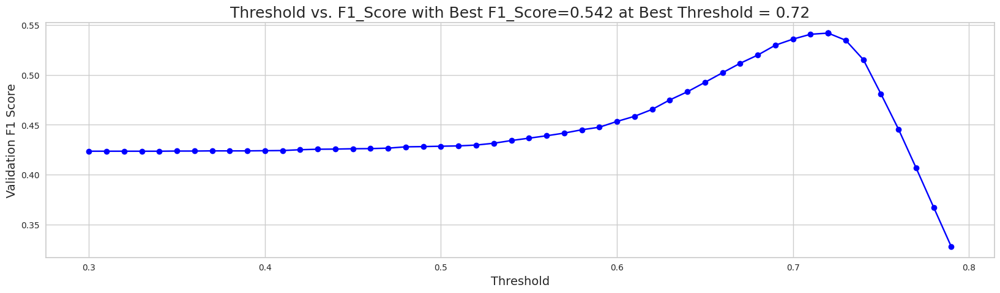

When using optimal threshold = 0.72...
Q0: F1 = 0.5416960623927476
==> Overall F1 = 0.5416960623927476
s
[I 2023-05-23 04:38:38,723] Trial 6 finished with value: 0.5416960623927476 and parameters: {'num_leaves': 88, 'learning_rate': 0.36533338289809525, 'feature_fraction': 0.35933862938216987, 'bagging_fraction': 0.7870722476788135, 'bagging_freq': 5, 'min_child_samples': 37, 'reg_alpha': 0.0018303449128858006, 'reg_lambda': 0.0030154430152133666, 'subsample': 0.9238668330877422, 'colsample_bytree': 0.7589963369930317, 'min_split_gain': 0.0013146569743924942, 'max_depth': 2}. Best is trial 1 with value: 0.5471834056805736.


--------------------------------------------------
question16, with255features
--------------------------------------------------
[LightGBM] [Warning] bagging_fraction is set=0.3599093535055329, subsample=0.3840817609957372 will be ignored. Current value: bagging_fraction=0.3599093535055329
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=7, subsample_freq=0 will be ignored. Current value: bagging_freq=7
[LightGBM] [Warning] feature_fraction is set=0.5409009304056113, colsample_bytree=0.104872835793451 will be ignored. Current value: feature_fraction=0.5409009304056113


[LightGBM] [Warning] bagging_fraction is set=0.27206612514267087, subsample=0.8185612004852295 will be ignored. Current value: bagging_fraction=0.27206612514267087
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=10, subsample_freq=0 will be ignored. Current value: bagging_freq=10
[LightGBM] [Warning] feature_fraction is set=0.5183925637485326, colsample_bytree=0.9076155784167879 will be ignored. Current value: feature_fraction=0.5183925637485326


[LightGBM] [Warning] bagging_fraction is set=0.5163559972734922, subsample=0.8891511914227775 will be ignored. Current value: bagging_fraction=0.5163559972734922
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=10, subsample_freq=0 will be ignored. Current value: bagging_freq=10
[LightGBM] [Warning] feature_fraction is set=0.9130274101136348, colsample_bytree=0.5060443634124544 will be ignored. Current value: feature_fraction=0.9130274101136348


[LightGBM] [Warning] bagging_fraction is set=0.27206612514267087, subsample=0.8185612004852295 will be ignored. Current value: bagging_fraction=0.27206612514267087
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=10, subsample_freq=0 will be ignored. Current value: bagging_freq=10
[LightGBM] [Warning] feature_fraction is set=0.5183925637485326, colsample_bytree=0.9076155784167879 will be ignored. Current value: feature_fraction=0.5183925637485326


[LightGBM] [Warning] bagging_fraction is set=0.3599093535055329, subsample=0.3840817609957372 will be ignored. Current value: bagging_fraction=0.3599093535055329
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=7, subsample_freq=0 will be ignored. Current value: bagging_freq=7
[LightGBM] [Warning] feature_fraction is set=0.5409009304056113, colsample_bytree=0.104872835793451 will be ignored. Current value: feature_fraction=0.5409009304056113


[LightGBM] [Warning] bagging_fraction is set=0.27206612514267087, subsample=0.8185612004852295 will be ignored. Current value: bagging_fraction=0.27206612514267087
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=10, subsample_freq=0 will be ignored. Current value: bagging_freq=10
[LightGBM] [Warning] feature_fraction is set=0.5183925637485326, colsample_bytree=0.9076155784167879 will be ignored. Current value: feature_fraction=0.5183925637485326


[LightGBM] [Warning] bagging_fraction is set=0.538634123924326, subsample=0.6668758706813662 will be ignored. Current value: bagging_fraction=0.538634123924326
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.38523923078313593, colsample_bytree=0.7986471994233741 will be ignored. Current value: feature_fraction=0.38523923078313593


[LightGBM] [Warning] bagging_fraction is set=0.27206612514267087, subsample=0.8185612004852295 will be ignored. Current value: bagging_fraction=0.27206612514267087
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=10, subsample_freq=0 will be ignored. Current value: bagging_freq=10
[LightGBM] [Warning] feature_fraction is set=0.5183925637485326, colsample_bytree=0.9076155784167879 will be ignored. Current value: feature_fraction=0.5183925637485326


[LightGBM] [Warning] bagging_fraction is set=0.27206612514267087, subsample=0.8185612004852295 will be ignored. Current value: bagging_fraction=0.27206612514267087
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=10, subsample_freq=0 will be ignored. Current value: bagging_freq=10
[LightGBM] [Warning] feature_fraction is set=0.5183925637485326, colsample_bytree=0.9076155784167879 will be ignored. Current value: feature_fraction=0.5183925637485326


,mean
feature,
19_level_counts,33.0
15_level_counts,30.6
hover_duration_max,30.6
elapsed_time_diff_sum,30.2
hover_duration_sum,29.8
elapsed_time_diff_mean,29.4
session_id,28.0
room_coor_y_std,26.0
screen_coor_x_std,24.0


[[0.38836234 0.61163766]
 [0.25288809 0.74711191]
 [0.23070899 0.76929101]
 ...
 [0.20174006 0.79825994]
 [0.22980202 0.77019798]
 [0.2147055  0.7852945 ]]


[LightGBM] [Warning] bagging_fraction is set=0.5163559972734922, subsample=0.8891511914227775 will be ignored. Current value: bagging_fraction=0.5163559972734922
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=10, subsample_freq=0 will be ignored. Current value: bagging_freq=10
[LightGBM] [Warning] feature_fraction is set=0.9130274101136348, colsample_bytree=0.5060443634124544 will be ignored. Current value: feature_fraction=0.9130274101136348


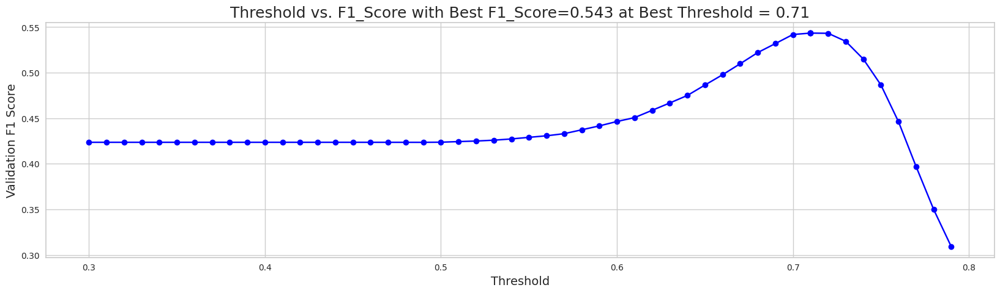

When using optimal threshold = 0.71...
Q0: F1 = 0.5434538331526837
==> Overall F1 = 0.5434538331526837
s
[I 2023-05-23 04:39:01,249] Trial 5 finished with value: 0.5434538331526837 and parameters: {'num_leaves': 18, 'learning_rate': 0.021154726357886178, 'feature_fraction': 0.5409009304056113, 'bagging_fraction': 0.3599093535055329, 'bagging_freq': 7, 'min_child_samples': 67, 'reg_alpha': 0.0020767712442073846, 'reg_lambda': 0.13523438178576228, 'subsample': 0.3840817609957372, 'colsample_bytree': 0.104872835793451, 'min_split_gain': 0.0014968354860872436, 'max_depth': 4}. Best is trial 1 with value: 0.5471834056805736.


--------------------------------------------------
question16, with255features
--------------------------------------------------


,mean
feature,
hover_duration_max,2.0
person_click_event_name_counts,1.6
hover_duration_mean,1.6
room_coor_x_max,1.6
elapsed_time_diff_mean,1.4
room_coor_y_max,1.4
15_level_counts,1.4
elapsed_time_diff_sum,1.4
screen_coor_x_std,1.2


[[0.27702656 0.72297344]
 [0.24036146 0.75963854]
 [0.30015035 0.69984965]
 ...
 [0.31986391 0.68013609]
 [0.28211963 0.71788037]
 [0.3710584  0.6289416 ]]


[LightGBM] [Warning] bagging_fraction is set=0.36467711127805635, subsample=0.4589166431055788 will be ignored. Current value: bagging_fraction=0.36467711127805635
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.1604889888939652, colsample_bytree=0.4644670589539467 will be ignored. Current value: feature_fraction=0.1604889888939652


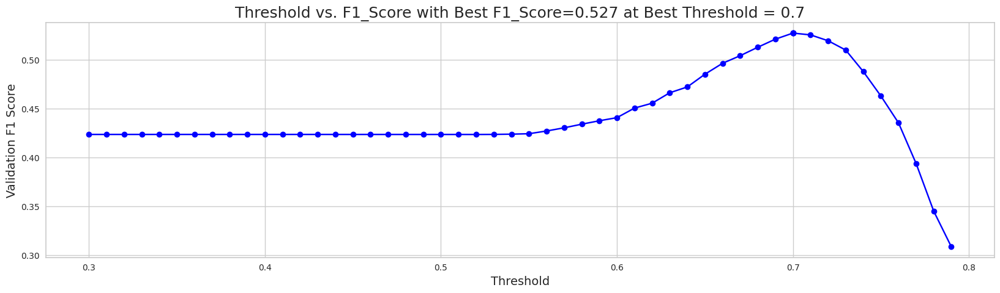

When using optimal threshold = 0.70...
Q0: F1 = 0.5274883546769751
==> Overall F1 = 0.5274883546769751
s
[I 2023-05-23 04:39:05,243] Trial 8 finished with value: 0.5274883546769751 and parameters: {'num_leaves': 58, 'learning_rate': 0.3368009788548721, 'feature_fraction': 0.5183925637485326, 'bagging_fraction': 0.27206612514267087, 'bagging_freq': 10, 'min_child_samples': 94, 'reg_alpha': 0.010681333635697473, 'reg_lambda': 0.030432327978548807, 'subsample': 0.8185612004852295, 'colsample_bytree': 0.9076155784167879, 'min_split_gain': 0.005345345648398422, 'max_depth': 7}. Best is trial 1 with value: 0.5471834056805736.


--------------------------------------------------
question16, with255features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.16517809712045722, subsample=0.9248526248204985 will be ignored. Current value: bagging_fraction=0.16517809712045722
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
[LightGBM] [Warning] feature_fraction is set=0.912851543136155, colsample_bytree=0.7826767646590029 will be ignored. Current value: feature_fraction=0.912851543136155


[LightGBM] [Warning] bagging_fraction is set=0.538634123924326, subsample=0.6668758706813662 will be ignored. Current value: bagging_fraction=0.538634123924326
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.38523923078313593, colsample_bytree=0.7986471994233741 will be ignored. Current value: feature_fraction=0.38523923078313593


[LightGBM] [Warning] bagging_fraction is set=0.16517809712045722, subsample=0.9248526248204985 will be ignored. Current value: bagging_fraction=0.16517809712045722
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
[LightGBM] [Warning] feature_fraction is set=0.912851543136155, colsample_bytree=0.7826767646590029 will be ignored. Current value: feature_fraction=0.912851543136155


[LightGBM] [Warning] bagging_fraction is set=0.5163559972734922, subsample=0.8891511914227775 will be ignored. Current value: bagging_fraction=0.5163559972734922
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=10, subsample_freq=0 will be ignored. Current value: bagging_freq=10
[LightGBM] [Warning] feature_fraction is set=0.9130274101136348, colsample_bytree=0.5060443634124544 will be ignored. Current value: feature_fraction=0.9130274101136348


[LightGBM] [Warning] bagging_fraction is set=0.36467711127805635, subsample=0.4589166431055788 will be ignored. Current value: bagging_fraction=0.36467711127805635
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.1604889888939652, colsample_bytree=0.4644670589539467 will be ignored. Current value: feature_fraction=0.1604889888939652


[LightGBM] [Warning] bagging_fraction is set=0.16517809712045722, subsample=0.9248526248204985 will be ignored. Current value: bagging_fraction=0.16517809712045722
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
[LightGBM] [Warning] feature_fraction is set=0.912851543136155, colsample_bytree=0.7826767646590029 will be ignored. Current value: feature_fraction=0.912851543136155


[LightGBM] [Warning] bagging_fraction is set=0.538634123924326, subsample=0.6668758706813662 will be ignored. Current value: bagging_fraction=0.538634123924326
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.38523923078313593, colsample_bytree=0.7986471994233741 will be ignored. Current value: feature_fraction=0.38523923078313593


,mean
feature,
session_id,3.0
room_coor_x_min,2.4
elapsed_time_diff_sum,2.2
15_level_counts,2.2
hover_duration_std,2.2
screen_coor_x_mean,2.2
room_corr_y_diff_mean,1.8
screen_coor_y_mean,1.8
18_level_counts,1.8


[[0.23187492 0.76812508]
 [0.24253251 0.75746749]
 [0.19636355 0.80363645]
 ...
 [0.23630839 0.76369161]
 [0.23630839 0.76369161]
 [0.28354054 0.71645946]]


[LightGBM] [Warning] bagging_fraction is set=0.36467711127805635, subsample=0.4589166431055788 will be ignored. Current value: bagging_fraction=0.36467711127805635
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.1604889888939652, colsample_bytree=0.4644670589539467 will be ignored. Current value: feature_fraction=0.1604889888939652


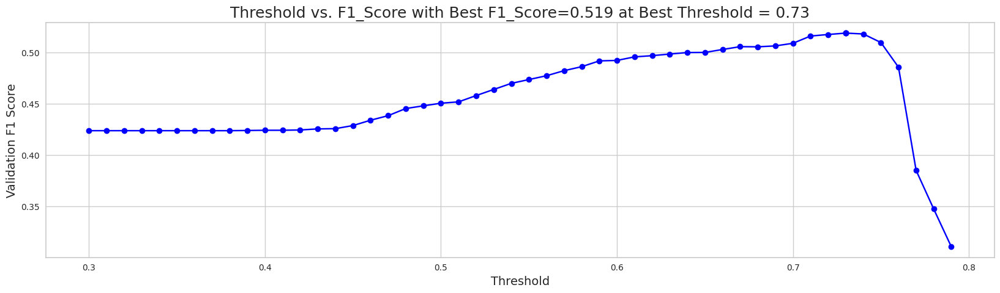

When using optimal threshold = 0.73...
Q0: F1 = 0.5186394645856439
==> Overall F1 = 0.5186394645856439
s
[I 2023-05-23 04:39:35,203] Trial 4 finished with value: 0.5186394645856439 and parameters: {'num_leaves': 99, 'learning_rate': 0.47280232098324154, 'feature_fraction': 0.9130274101136348, 'bagging_fraction': 0.5163559972734922, 'bagging_freq': 10, 'min_child_samples': 23, 'reg_alpha': 0.022511071080392835, 'reg_lambda': 0.11294256834468089, 'subsample': 0.8891511914227775, 'colsample_bytree': 0.5060443634124544, 'min_split_gain': 0.0025985853259523103, 'max_depth': 0}. Best is trial 1 with value: 0.5471834056805736.


[LightGBM] [Warning] bagging_fraction is set=0.16517809712045722, subsample=0.9248526248204985 will be ignored. Current value: bagging_fraction=0.16517809712045722
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
[LightGBM] [Warning] feature_fraction is set=0.912851543136155, colsample_bytree=0.7826767646590029 will be ignored. Current value: feature_fraction=0.912851543136155
--------------------------------------------------
question16, with255features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.8559609403000594, subsample=0.7126278095621355 will be ignored. Current value: bagging_fraction=0.8559609403000594
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=7, subsample_freq=0 will be ignored. Current value: bagging_freq=7
[LightGBM] [Warning] feature_fraction is set=0.6026000863872534, colsample_bytree=0.3345022058677459 will be ignored. Current value: feature_fraction=0.6026000863872534


[LightGBM] [Warning] bagging_fraction is set=0.16517809712045722, subsample=0.9248526248204985 will be ignored. Current value: bagging_fraction=0.16517809712045722
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
[LightGBM] [Warning] feature_fraction is set=0.912851543136155, colsample_bytree=0.7826767646590029 will be ignored. Current value: feature_fraction=0.912851543136155


[LightGBM] [Warning] bagging_fraction is set=0.36467711127805635, subsample=0.4589166431055788 will be ignored. Current value: bagging_fraction=0.36467711127805635
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.1604889888939652, colsample_bytree=0.4644670589539467 will be ignored. Current value: feature_fraction=0.1604889888939652


[LightGBM] [Warning] bagging_fraction is set=0.538634123924326, subsample=0.6668758706813662 will be ignored. Current value: bagging_fraction=0.538634123924326
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.38523923078313593, colsample_bytree=0.7986471994233741 will be ignored. Current value: feature_fraction=0.38523923078313593


[LightGBM] [Warning] bagging_fraction is set=0.8559609403000594, subsample=0.7126278095621355 will be ignored. Current value: bagging_fraction=0.8559609403000594
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=7, subsample_freq=0 will be ignored. Current value: bagging_freq=7
[LightGBM] [Warning] feature_fraction is set=0.6026000863872534, colsample_bytree=0.3345022058677459 will be ignored. Current value: feature_fraction=0.6026000863872534


,mean
feature,
screen_coor_x_std,92.8
session_id,92.0
hover_duration_max,86.2
hover_duration_sum,85.4
room_coor_x_min,81.6
room_coor_y_max,81.0
room_coor_y_min,78.4
19_level_counts,74.6
room_coor_x_std,74.0


[[0.35662737 0.64337263]
 [0.33086661 0.66913339]
 [0.26548153 0.73451847]
 ...
 [0.22886417 0.77113583]
 [0.22706336 0.77293664]
 [0.25718372 0.74281628]]


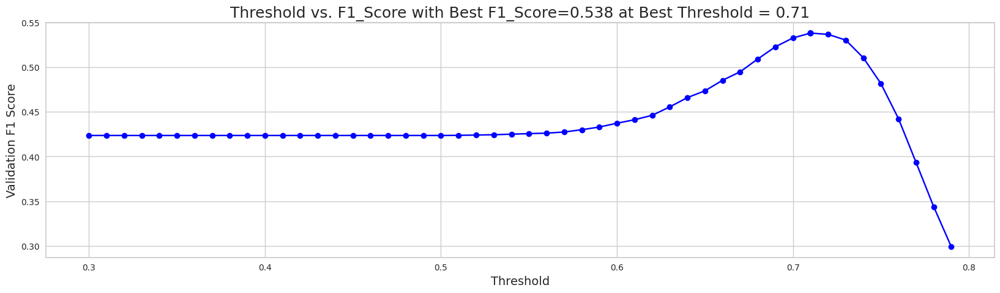

When using optimal threshold = 0.71...
Q0: F1 = 0.5382589345314026
==> Overall F1 = 0.5382589345314026
s
[I 2023-05-23 04:39:56,788] Trial 10 finished with value: 0.5382589345314026 and parameters: {'num_leaves': 71, 'learning_rate': 0.010614613197580624, 'feature_fraction': 0.912851543136155, 'bagging_fraction': 0.16517809712045722, 'bagging_freq': 6, 'min_child_samples': 63, 'reg_alpha': 0.004325324008328147, 'reg_lambda': 1.5814147287012874, 'subsample': 0.9248526248204985, 'colsample_bytree': 0.7826767646590029, 'min_split_gain': 0.0034738099290622685, 'max_depth': 9}. Best is trial 1 with value: 0.5471834056805736.


--------------------------------------------------
question16, with255features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.8611866873007664, subsample=0.4229883168747579 will be ignored. Current value: bagging_fraction=0.8611866873007664
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=9, subsample_freq=0 will be ignored. Current value: bagging_freq=9
[LightGBM] [Warning] feature_fraction is set=0.7608499534375173, colsample_bytree=0.20091470562006272 will be ignored. Current value: feature_fraction=0.7608499534375173


[LightGBM] [Warning] bagging_fraction is set=0.36467711127805635, subsample=0.4589166431055788 will be ignored. Current value: bagging_fraction=0.36467711127805635
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.1604889888939652, colsample_bytree=0.4644670589539467 will be ignored. Current value: feature_fraction=0.1604889888939652


[LightGBM] [Warning] bagging_fraction is set=0.8611866873007664, subsample=0.4229883168747579 will be ignored. Current value: bagging_fraction=0.8611866873007664
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=9, subsample_freq=0 will be ignored. Current value: bagging_freq=9
[LightGBM] [Warning] feature_fraction is set=0.7608499534375173, colsample_bytree=0.20091470562006272 will be ignored. Current value: feature_fraction=0.7608499534375173


,mean
feature,
elapsed_time_diff_sum,72.2
room_coor_x_min,69.6
hover_duration_max,67.0
room_coor_x_max,66.0
screen_coor_x_std,65.0
hover_duration_sum,63.4
screen_coor_y_mean,63.0
elapsed_time_diff_mean,61.0
hover_duration_std,59.2


[[0.2874878  0.7125122 ]
 [0.26190386 0.73809614]
 [0.29389256 0.70610744]
 ...
 [0.20188522 0.79811478]
 [0.21725084 0.78274916]
 [0.2252922  0.7747078 ]]


[LightGBM] [Warning] bagging_fraction is set=0.8559609403000594, subsample=0.7126278095621355 will be ignored. Current value: bagging_fraction=0.8559609403000594
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=7, subsample_freq=0 will be ignored. Current value: bagging_freq=7
[LightGBM] [Warning] feature_fraction is set=0.6026000863872534, colsample_bytree=0.3345022058677459 will be ignored. Current value: feature_fraction=0.6026000863872534


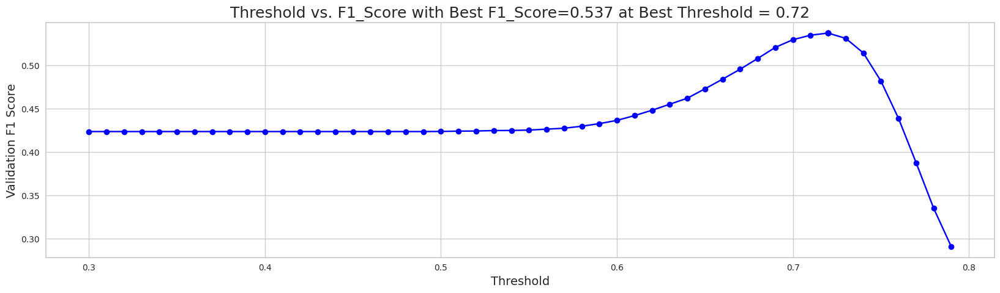

When using optimal threshold = 0.72...
Q0: F1 = 0.5373336046388426
==> Overall F1 = 0.5373336046388426
s
[I 2023-05-23 04:40:11,211] Trial 7 finished with value: 0.5373336046388426 and parameters: {'num_leaves': 88, 'learning_rate': 0.026600115210160806, 'feature_fraction': 0.38523923078313593, 'bagging_fraction': 0.538634123924326, 'bagging_freq': 1, 'min_child_samples': 36, 'reg_alpha': 0.0018747591241041618, 'reg_lambda': 0.2282608178191899, 'subsample': 0.6668758706813662, 'colsample_bytree': 0.7986471994233741, 'min_split_gain': 0.00131389175409066, 'max_depth': 0}. Best is trial 1 with value: 0.5471834056805736.


--------------------------------------------------
question16, with255features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.9612228941339118, subsample=0.7518075009943208 will be ignored. Current value: bagging_fraction=0.9612228941339118
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.10435285230287472, colsample_bytree=0.560353538462134 will be ignored. Current value: feature_fraction=0.10435285230287472


[LightGBM] [Warning] bagging_fraction is set=0.8611866873007664, subsample=0.4229883168747579 will be ignored. Current value: bagging_fraction=0.8611866873007664
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=9, subsample_freq=0 will be ignored. Current value: bagging_freq=9
[LightGBM] [Warning] feature_fraction is set=0.7608499534375173, colsample_bytree=0.20091470562006272 will be ignored. Current value: feature_fraction=0.7608499534375173


[LightGBM] [Warning] bagging_fraction is set=0.9612228941339118, subsample=0.7518075009943208 will be ignored. Current value: bagging_fraction=0.9612228941339118
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.10435285230287472, colsample_bytree=0.560353538462134 will be ignored. Current value: feature_fraction=0.10435285230287472


[LightGBM] [Warning] bagging_fraction is set=0.8559609403000594, subsample=0.7126278095621355 will be ignored. Current value: bagging_fraction=0.8559609403000594
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=7, subsample_freq=0 will be ignored. Current value: bagging_freq=7
[LightGBM] [Warning] feature_fraction is set=0.6026000863872534, colsample_bytree=0.3345022058677459 will be ignored. Current value: feature_fraction=0.6026000863872534


,mean
feature,
elapsed_time_diff_mean,111.6
screen_coor_y_max,111.2
room_coor_y_max,102.0
screen_corr_y_dff_mean,99.4
room_corr_y_diff_mean,91.2
hover_duration_max,89.8
screen_corr_x_dff_std,83.8
room_coor_x_max,79.2
room_coor_y_min,77.2


[[0.29308798 0.70691202]
 [0.24515449 0.75484551]
 [0.21310357 0.78689643]
 ...
 [0.23479765 0.76520235]
 [0.18726574 0.81273426]
 [0.21023855 0.78976145]]


[LightGBM] [Warning] bagging_fraction is set=0.8611866873007664, subsample=0.4229883168747579 will be ignored. Current value: bagging_fraction=0.8611866873007664
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=9, subsample_freq=0 will be ignored. Current value: bagging_freq=9
[LightGBM] [Warning] feature_fraction is set=0.7608499534375173, colsample_bytree=0.20091470562006272 will be ignored. Current value: feature_fraction=0.7608499534375173


[LightGBM] [Warning] bagging_fraction is set=0.9612228941339118, subsample=0.7518075009943208 will be ignored. Current value: bagging_fraction=0.9612228941339118
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.10435285230287472, colsample_bytree=0.560353538462134 will be ignored. Current value: feature_fraction=0.10435285230287472


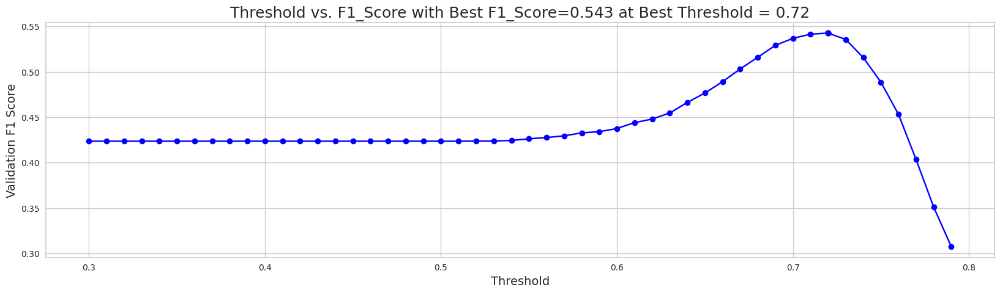

When using optimal threshold = 0.72...
Q0: F1 = 0.5426873340146209
==> Overall F1 = 0.5426873340146209
s
[I 2023-05-23 04:40:26,081] Trial 9 finished with value: 0.5426873340146209 and parameters: {'num_leaves': 67, 'learning_rate': 0.025199056478927465, 'feature_fraction': 0.1604889888939652, 'bagging_fraction': 0.36467711127805635, 'bagging_freq': 3, 'min_child_samples': 8, 'reg_alpha': 1.1679238798328668, 'reg_lambda': 2.195883803375978, 'subsample': 0.4589166431055788, 'colsample_bytree': 0.4644670589539467, 'min_split_gain': 0.002018026626255046, 'max_depth': 10}. Best is trial 1 with value: 0.5471834056805736.


--------------------------------------------------
question16, with255features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.9914611468737454, subsample=0.7014976624085194 will be ignored. Current value: bagging_fraction=0.9914611468737454
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=7, subsample_freq=0 will be ignored. Current value: bagging_freq=7
[LightGBM] [Warning] feature_fraction is set=0.10289834928710007, colsample_bytree=0.13624927120504715 will be ignored. Current value: feature_fraction=0.10289834928710007


[LightGBM] [Warning] bagging_fraction is set=0.9612228941339118, subsample=0.7518075009943208 will be ignored. Current value: bagging_fraction=0.9612228941339118
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.10435285230287472, colsample_bytree=0.560353538462134 will be ignored. Current value: feature_fraction=0.10435285230287472


[LightGBM] [Warning] bagging_fraction is set=0.9914611468737454, subsample=0.7014976624085194 will be ignored. Current value: bagging_fraction=0.9914611468737454
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=7, subsample_freq=0 will be ignored. Current value: bagging_freq=7
[LightGBM] [Warning] feature_fraction is set=0.10289834928710007, colsample_bytree=0.13624927120504715 will be ignored. Current value: feature_fraction=0.10289834928710007


[LightGBM] [Warning] bagging_fraction is set=0.8611866873007664, subsample=0.4229883168747579 will be ignored. Current value: bagging_fraction=0.8611866873007664
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=9, subsample_freq=0 will be ignored. Current value: bagging_freq=9
[LightGBM] [Warning] feature_fraction is set=0.7608499534375173, colsample_bytree=0.20091470562006272 will be ignored. Current value: feature_fraction=0.7608499534375173


[LightGBM] [Warning] bagging_fraction is set=0.9612228941339118, subsample=0.7518075009943208 will be ignored. Current value: bagging_fraction=0.9612228941339118
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.10435285230287472, colsample_bytree=0.560353538462134 will be ignored. Current value: feature_fraction=0.10435285230287472


[LightGBM] [Warning] bagging_fraction is set=0.9914611468737454, subsample=0.7014976624085194 will be ignored. Current value: bagging_fraction=0.9914611468737454
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=7, subsample_freq=0 will be ignored. Current value: bagging_freq=7
[LightGBM] [Warning] feature_fraction is set=0.10289834928710007, colsample_bytree=0.13624927120504715 will be ignored. Current value: feature_fraction=0.10289834928710007


,mean
feature,
19_level_counts,41.2
elapsed_time_diff_sum,34.6
hover_duration_sum,34.4
hover_duration_max,34.0
15_level_counts,29.4
session_id,23.8
day,23.6
room_coor_y_std,20.8
directory.closeup.archivist_fqid_counts,19.6


[[0.3642815  0.6357185 ]
 [0.25182454 0.74817546]
 [0.26435413 0.73564587]
 ...
 [0.21980021 0.78019979]
 [0.22542954 0.77457046]
 [0.23183903 0.76816097]]


,mean
feature,
screen_coor_x_std,25.8
elapsed_time_diff_mean,20.4
room_corr_x_diff_std,18.6
hover_duration_max,17.2
hover_duration_std,16.6
19_level_counts,14.6
17_level_counts,14.2
room_coor_y_max,13.2
tunic.historicalsociety.cage_room_fqid_counts,13.2


[[0.31658587 0.68341413]
 [0.26688955 0.73311045]
 [0.24373161 0.75626839]
 ...
 [0.20818303 0.79181697]
 [0.22844204 0.77155796]
 [0.23480263 0.76519737]]


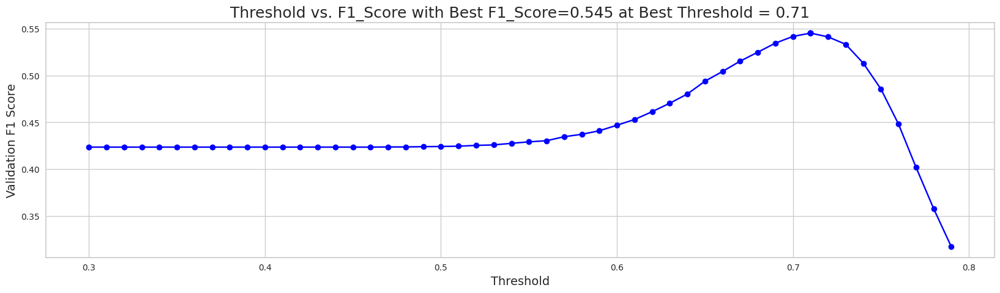

When using optimal threshold = 0.71...
Q0: F1 = 0.5452380531418327
==> Overall F1 = 0.5452380531418327
s
[I 2023-05-23 04:40:45,292] Trial 12 finished with value: 0.5452380531418327 and parameters: {'num_leaves': 31, 'learning_rate': 0.02934387451969859, 'feature_fraction': 0.7608499534375173, 'bagging_fraction': 0.8611866873007664, 'bagging_freq': 9, 'min_child_samples': 91, 'reg_alpha': 0.9472230514960944, 'reg_lambda': 1.9520409641838605, 'subsample': 0.4229883168747579, 'colsample_bytree': 0.20091470562006272, 'min_split_gain': 0.22554991142756348, 'max_depth': 3}. Best is trial 1 with value: 0.5471834056805736.


--------------------------------------------------
question16, with255features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.9718111630953505, subsample=0.7219687037280083 will be ignored. Current value: bagging_fraction=0.9718111630953505
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.1295366147578664, colsample_bytree=0.3153514372892715 will be ignored. Current value: feature_fraction=0.1295366147578664


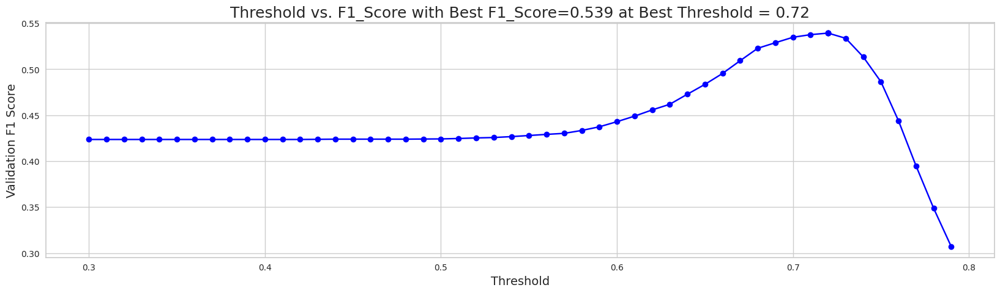

When using optimal threshold = 0.72...
Q0: F1 = 0.5393517508524066
==> Overall F1 = 0.5393517508524066
s
[I 2023-05-23 04:40:48,807] Trial 13 finished with value: 0.5393517508524066 and parameters: {'num_leaves': 28, 'learning_rate': 0.0923188268802539, 'feature_fraction': 0.10435285230287472, 'bagging_fraction': 0.9612228941339118, 'bagging_freq': 1, 'min_child_samples': 74, 'reg_alpha': 0.4120807004320241, 'reg_lambda': 0.0011899553656863635, 'subsample': 0.7518075009943208, 'colsample_bytree': 0.560353538462134, 'min_split_gain': 0.6697077850411648, 'max_depth': 7}. Best is trial 1 with value: 0.5471834056805736.


--------------------------------------------------
question16, with255features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.8559609403000594, subsample=0.7126278095621355 will be ignored. Current value: bagging_fraction=0.8559609403000594
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=7, subsample_freq=0 will be ignored. Current value: bagging_freq=7
[LightGBM] [Warning] feature_fraction is set=0.6026000863872534, colsample_bytree=0.3345022058677459 will be ignored. Current value: feature_fraction=0.6026000863872534


[LightGBM] [Warning] bagging_fraction is set=0.9914611468737454, subsample=0.7014976624085194 will be ignored. Current value: bagging_fraction=0.9914611468737454
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=7, subsample_freq=0 will be ignored. Current value: bagging_freq=7
[LightGBM] [Warning] feature_fraction is set=0.10289834928710007, colsample_bytree=0.13624927120504715 will be ignored. Current value: feature_fraction=0.10289834928710007


[LightGBM] [Warning] bagging_fraction is set=0.9202080197070021, subsample=0.990071301021703 will be ignored. Current value: bagging_fraction=0.9202080197070021
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
[LightGBM] [Warning] feature_fraction is set=0.7392188450278956, colsample_bytree=0.16083080223220164 will be ignored. Current value: feature_fraction=0.7392188450278956


[LightGBM] [Warning] bagging_fraction is set=0.9718111630953505, subsample=0.7219687037280083 will be ignored. Current value: bagging_fraction=0.9718111630953505
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.1295366147578664, colsample_bytree=0.3153514372892715 will be ignored. Current value: feature_fraction=0.1295366147578664


[LightGBM] [Warning] bagging_fraction is set=0.9914611468737454, subsample=0.7014976624085194 will be ignored. Current value: bagging_fraction=0.9914611468737454
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=7, subsample_freq=0 will be ignored. Current value: bagging_freq=7
[LightGBM] [Warning] feature_fraction is set=0.10289834928710007, colsample_bytree=0.13624927120504715 will be ignored. Current value: feature_fraction=0.10289834928710007


[LightGBM] [Warning] bagging_fraction is set=0.9202080197070021, subsample=0.990071301021703 will be ignored. Current value: bagging_fraction=0.9202080197070021
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
[LightGBM] [Warning] feature_fraction is set=0.7392188450278956, colsample_bytree=0.16083080223220164 will be ignored. Current value: feature_fraction=0.7392188450278956


,mean
feature,
screen_coor_x_std,28.6
hover_duration_max,26.0
19_level_counts,21.8
hover_duration_std,21.0
elapsed_time_diff_mean,19.4
room_corr_x_diff_std,18.6
room_coor_y_max,18.4
room_corr_y_diff_mean,15.2
map_hover_event_name_counts,14.4


[[0.3150486  0.6849514 ]
 [0.24250935 0.75749065]
 [0.26077031 0.73922969]
 ...
 [0.21006169 0.78993831]
 [0.22221279 0.77778721]
 [0.25059525 0.74940475]]


[LightGBM] [Warning] bagging_fraction is set=0.9718111630953505, subsample=0.7219687037280083 will be ignored. Current value: bagging_fraction=0.9718111630953505
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.1295366147578664, colsample_bytree=0.3153514372892715 will be ignored. Current value: feature_fraction=0.1295366147578664


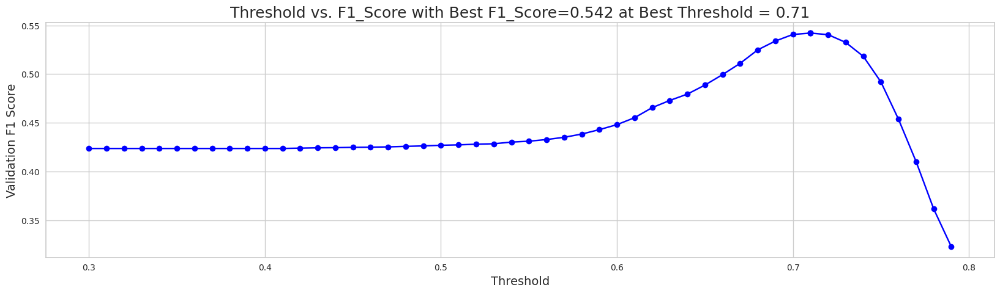

When using optimal threshold = 0.71...
Q0: F1 = 0.542087672265362
==> Overall F1 = 0.542087672265362
s
[I 2023-05-23 04:41:05,522] Trial 14 finished with value: 0.542087672265362 and parameters: {'num_leaves': 20, 'learning_rate': 0.07625697532469186, 'feature_fraction': 0.10289834928710007, 'bagging_fraction': 0.9914611468737454, 'bagging_freq': 7, 'min_child_samples': 65, 'reg_alpha': 0.14642351827275935, 'reg_lambda': 0.0011230334781761634, 'subsample': 0.7014976624085194, 'colsample_bytree': 0.13624927120504715, 'min_split_gain': 0.8989903342564038, 'max_depth': 7}. Best is trial 1 with value: 0.5471834056805736.


--------------------------------------------------
question16, with255features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.8664775948564699, subsample=0.567902064368714 will be ignored. Current value: bagging_fraction=0.8664775948564699
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
[LightGBM] [Warning] feature_fraction is set=0.7449347099868584, colsample_bytree=0.2906304042799247 will be ignored. Current value: feature_fraction=0.7449347099868584


[LightGBM] [Warning] bagging_fraction is set=0.9202080197070021, subsample=0.990071301021703 will be ignored. Current value: bagging_fraction=0.9202080197070021
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
[LightGBM] [Warning] feature_fraction is set=0.7392188450278956, colsample_bytree=0.16083080223220164 will be ignored. Current value: feature_fraction=0.7392188450278956


,mean
feature,
hover_duration_max,60.2
19_level_counts,55.8
elapsed_time_diff_sum,51.4
hover_duration_sum,47.6
screen_coor_x_std,39.4
15_level_counts,38.8
session_id,33.8
day,33.4
tunic.historicalsociety.cage.glasses.beforeteddy_text_fqid_counts,30.6


[LightGBM] [Warning] bagging_fraction is set=0.9718111630953505, subsample=0.7219687037280083 will be ignored. Current value: bagging_fraction=0.9718111630953505
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.1295366147578664, colsample_bytree=0.3153514372892715 will be ignored. Current value: feature_fraction=0.1295366147578664
[[0.44142317 0.55857683]
 [0.25496356 0.74503644]
 [0.26250062 0.73749938]
 ...
 [0.20951624 0.79048376]
 [0.22430029 0.77569971]
 [0.24645527 0.75354473]]


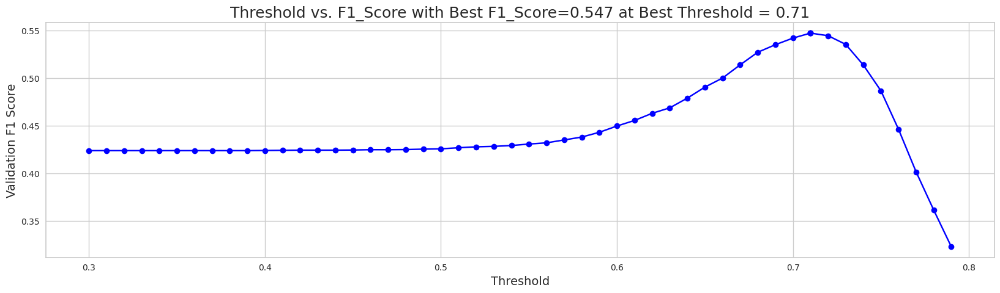

When using optimal threshold = 0.71...
Q0: F1 = 0.547074414012945
==> Overall F1 = 0.547074414012945
s
[I 2023-05-23 04:41:13,988] Trial 11 finished with value: 0.547074414012945 and parameters: {'num_leaves': 82, 'learning_rate': 0.016255482929017254, 'feature_fraction': 0.6026000863872534, 'bagging_fraction': 0.8559609403000594, 'bagging_freq': 7, 'min_child_samples': 52, 'reg_alpha': 0.053233746765588126, 'reg_lambda': 0.0011071872578073928, 'subsample': 0.7126278095621355, 'colsample_bytree': 0.3345022058677459, 'min_split_gain': 0.7476618145306725, 'max_depth': 2}. Best is trial 1 with value: 0.5471834056805736.


--------------------------------------------------
question16, with255features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.8716390765264104, subsample=0.9834059710012251 will be ignored. Current value: bagging_fraction=0.8716390765264104
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
[LightGBM] [Warning] feature_fraction is set=0.30640270087380816, colsample_bytree=0.39880508097616296 will be ignored. Current value: feature_fraction=0.30640270087380816


[LightGBM] [Warning] bagging_fraction is set=0.8664775948564699, subsample=0.567902064368714 will be ignored. Current value: bagging_fraction=0.8664775948564699
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
[LightGBM] [Warning] feature_fraction is set=0.7449347099868584, colsample_bytree=0.2906304042799247 will be ignored. Current value: feature_fraction=0.7449347099868584


[LightGBM] [Warning] bagging_fraction is set=0.9202080197070021, subsample=0.990071301021703 will be ignored. Current value: bagging_fraction=0.9202080197070021
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
[LightGBM] [Warning] feature_fraction is set=0.7392188450278956, colsample_bytree=0.16083080223220164 will be ignored. Current value: feature_fraction=0.7392188450278956


[LightGBM] [Warning] bagging_fraction is set=0.9718111630953505, subsample=0.7219687037280083 will be ignored. Current value: bagging_fraction=0.9718111630953505
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.1295366147578664, colsample_bytree=0.3153514372892715 will be ignored. Current value: feature_fraction=0.1295366147578664


[LightGBM] [Warning] bagging_fraction is set=0.8664775948564699, subsample=0.567902064368714 will be ignored. Current value: bagging_fraction=0.8664775948564699
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
[LightGBM] [Warning] feature_fraction is set=0.7449347099868584, colsample_bytree=0.2906304042799247 will be ignored. Current value: feature_fraction=0.7449347099868584


,mean
feature,
room_coor_x_std,57.6
tunic.historicalsociety.cage_room_fqid_counts,42.4
hover_duration_max,40.0
room_coor_y_max,39.0
elapsed_time_diff_mean,38.6
hover_duration_sum,37.0
room_coor_y_mean,36.2
room_coor_x_max,35.2
screen_coor_x_sum,33.8


[[0.35170719 0.64829281]
 [0.25068003 0.74931997]
 [0.27211376 0.72788624]
 ...
 [0.21444178 0.78555822]
 [0.24051193 0.75948807]
 [0.22013626 0.77986374]]


[LightGBM] [Warning] bagging_fraction is set=0.9202080197070021, subsample=0.990071301021703 will be ignored. Current value: bagging_fraction=0.9202080197070021
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
[LightGBM] [Warning] feature_fraction is set=0.7392188450278956, colsample_bytree=0.16083080223220164 will be ignored. Current value: feature_fraction=0.7392188450278956


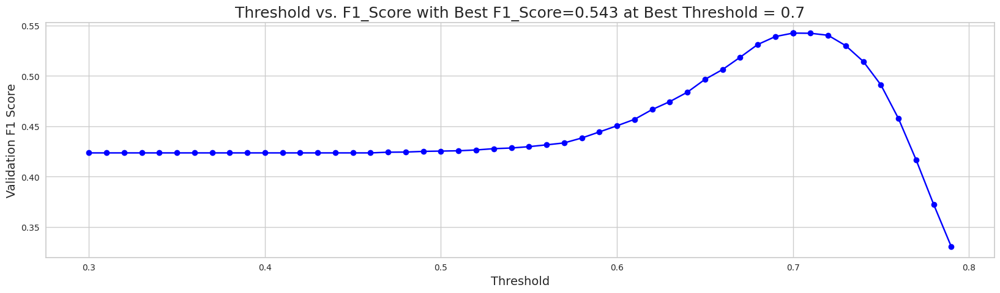

When using optimal threshold = 0.70...
Q0: F1 = 0.5425381406369642
==> Overall F1 = 0.5425381406369642
s
[I 2023-05-23 04:41:30,718] Trial 15 finished with value: 0.5425381406369642 and parameters: {'num_leaves': 29, 'learning_rate': 0.05604908171851281, 'feature_fraction': 0.1295366147578664, 'bagging_fraction': 0.9718111630953505, 'bagging_freq': 1, 'min_child_samples': 98, 'reg_alpha': 0.3369125754289963, 'reg_lambda': 8.99777913230155, 'subsample': 0.7219687037280083, 'colsample_bytree': 0.3153514372892715, 'min_split_gain': 0.8704575111963626, 'max_depth': 6}. Best is trial 1 with value: 0.5471834056805736.


--------------------------------------------------
question16, with255features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.8447527781076711, subsample=0.9966948934919044 will be ignored. Current value: bagging_fraction=0.8447527781076711
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
[LightGBM] [Warning] feature_fraction is set=0.32680778995310794, colsample_bytree=0.3421380993744472 will be ignored. Current value: feature_fraction=0.32680778995310794


[LightGBM] [Warning] bagging_fraction is set=0.8664775948564699, subsample=0.567902064368714 will be ignored. Current value: bagging_fraction=0.8664775948564699
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
[LightGBM] [Warning] feature_fraction is set=0.7449347099868584, colsample_bytree=0.2906304042799247 will be ignored. Current value: feature_fraction=0.7449347099868584


,mean
feature,
elapsed_time_diff_sum,18.6
hover_duration_sum,17.0
19_level_counts,16.8
hover_duration_max,16.2
day,13.6
screen_coor_x_std,13.2
15_level_counts,13.2
session_id,12.8
hour,12.6


[[0.39896204 0.60103796]
 [0.24361349 0.75638651]
 [0.25053576 0.74946424]
 ...
 [0.21634751 0.78365249]
 [0.24060925 0.75939075]
 [0.24313343 0.75686657]]


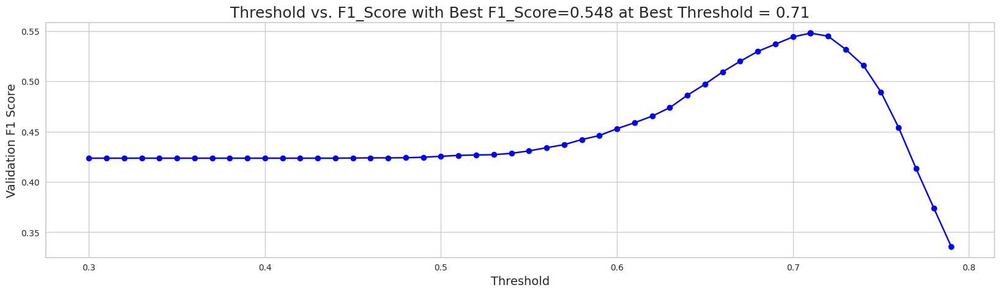

When using optimal threshold = 0.71...
Q0: F1 = 0.5478807952267379
==> Overall F1 = 0.5478807952267379
s
[I 2023-05-23 04:41:43,432] Trial 16 finished with value: 0.5478807952267379 and parameters: {'num_leaves': 39, 'learning_rate': 0.057414241239311256, 'feature_fraction': 0.7392188450278956, 'bagging_fraction': 0.9202080197070021, 'bagging_freq': 4, 'min_child_samples': 100, 'reg_alpha': 0.15902982407012414, 'reg_lambda': 6.869627611703109, 'subsample': 0.990071301021703, 'colsample_bytree': 0.16083080223220164, 'min_split_gain': 0.05752702772959406, 'max_depth': 2}. Best is trial 16 with value: 0.5478807952267379.


--------------------------------------------------
question16, with255features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.8525111014819886, subsample=0.9880178489195681 will be ignored. Current value: bagging_fraction=0.8525111014819886
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.25769025597883466, colsample_bytree=0.6200980900655388 will be ignored. Current value: feature_fraction=0.25769025597883466


[LightGBM] [Warning] bagging_fraction is set=0.8664775948564699, subsample=0.567902064368714 will be ignored. Current value: bagging_fraction=0.8664775948564699
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
[LightGBM] [Warning] feature_fraction is set=0.7449347099868584, colsample_bytree=0.2906304042799247 will be ignored. Current value: feature_fraction=0.7449347099868584


[LightGBM] [Warning] bagging_fraction is set=0.8716390765264104, subsample=0.9834059710012251 will be ignored. Current value: bagging_fraction=0.8716390765264104
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
[LightGBM] [Warning] feature_fraction is set=0.30640270087380816, colsample_bytree=0.39880508097616296 will be ignored. Current value: feature_fraction=0.30640270087380816


[LightGBM] [Warning] bagging_fraction is set=0.8447527781076711, subsample=0.9966948934919044 will be ignored. Current value: bagging_fraction=0.8447527781076711
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
[LightGBM] [Warning] feature_fraction is set=0.32680778995310794, colsample_bytree=0.3421380993744472 will be ignored. Current value: feature_fraction=0.32680778995310794


[LightGBM] [Warning] bagging_fraction is set=0.8525111014819886, subsample=0.9880178489195681 will be ignored. Current value: bagging_fraction=0.8525111014819886
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.25769025597883466, colsample_bytree=0.6200980900655388 will be ignored. Current value: feature_fraction=0.25769025597883466


,mean
feature,
19_level_counts,22.8
hover_duration_max,22.0
elapsed_time_diff_sum,21.8
hover_duration_sum,19.8
screen_coor_x_std,14.6
15_level_counts,14.4
day,14.2
room_coor_y_std,13.0
hour,12.4


[[0.41518604 0.58481396]
 [0.24493099 0.75506901]
 [0.22526211 0.77473789]
 ...
 [0.20705761 0.79294239]
 [0.22775577 0.77224423]
 [0.24469798 0.75530202]]


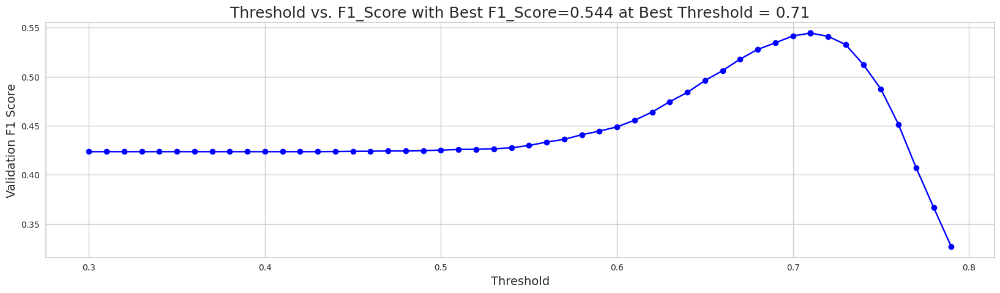

When using optimal threshold = 0.71...
Q0: F1 = 0.5443446625075811
==> Overall F1 = 0.5443446625075811
s
[I 2023-05-23 04:42:01,158] Trial 17 finished with value: 0.5443446625075811 and parameters: {'num_leaves': 39, 'learning_rate': 0.04452668928870195, 'feature_fraction': 0.7449347099868584, 'bagging_fraction': 0.8664775948564699, 'bagging_freq': 4, 'min_child_samples': 98, 'reg_alpha': 0.36964662393214465, 'reg_lambda': 5.207687710299838, 'subsample': 0.567902064368714, 'colsample_bytree': 0.2906304042799247, 'min_split_gain': 0.04712452797254018, 'max_depth': 2}. Best is trial 16 with value: 0.5478807952267379.


--------------------------------------------------
question16, with255features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.7897437409595056, subsample=0.9998824266588403 will be ignored. Current value: bagging_fraction=0.7897437409595056
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.26632119613813865, colsample_bytree=0.6360343343191828 will be ignored. Current value: feature_fraction=0.26632119613813865


[LightGBM] [Warning] bagging_fraction is set=0.8525111014819886, subsample=0.9880178489195681 will be ignored. Current value: bagging_fraction=0.8525111014819886
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.25769025597883466, colsample_bytree=0.6200980900655388 will be ignored. Current value: feature_fraction=0.25769025597883466


[LightGBM] [Warning] bagging_fraction is set=0.7897437409595056, subsample=0.9998824266588403 will be ignored. Current value: bagging_fraction=0.7897437409595056
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.26632119613813865, colsample_bytree=0.6360343343191828 will be ignored. Current value: feature_fraction=0.26632119613813865


[LightGBM] [Warning] bagging_fraction is set=0.7897437409595056, subsample=0.9998824266588403 will be ignored. Current value: bagging_fraction=0.7897437409595056
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.26632119613813865, colsample_bytree=0.6360343343191828 will be ignored. Current value: feature_fraction=0.26632119613813865


[LightGBM] [Warning] bagging_fraction is set=0.8525111014819886, subsample=0.9880178489195681 will be ignored. Current value: bagging_fraction=0.8525111014819886
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.25769025597883466, colsample_bytree=0.6200980900655388 will be ignored. Current value: feature_fraction=0.25769025597883466


[LightGBM] [Warning] bagging_fraction is set=0.8716390765264104, subsample=0.9834059710012251 will be ignored. Current value: bagging_fraction=0.8716390765264104
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
[LightGBM] [Warning] feature_fraction is set=0.30640270087380816, colsample_bytree=0.39880508097616296 will be ignored. Current value: feature_fraction=0.30640270087380816
[LightGBM] [Warning] bagging_fraction is set=0.8447527781076711, subsample=0.9966948934919044 will be ignored. Current value: bagging_fraction=0.8447527781076711
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
[LightGBM] [Warning]

[LightGBM] [Warning] bagging_fraction is set=0.7897437409595056, subsample=0.9998824266588403 will be ignored. Current value: bagging_fraction=0.7897437409595056
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.26632119613813865, colsample_bytree=0.6360343343191828 will be ignored. Current value: feature_fraction=0.26632119613813865


[LightGBM] [Warning] bagging_fraction is set=0.8525111014819886, subsample=0.9880178489195681 will be ignored. Current value: bagging_fraction=0.8525111014819886
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.25769025597883466, colsample_bytree=0.6200980900655388 will be ignored. Current value: feature_fraction=0.25769025597883466


[LightGBM] [Warning] bagging_fraction is set=0.8447527781076711, subsample=0.9966948934919044 will be ignored. Current value: bagging_fraction=0.8447527781076711
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
[LightGBM] [Warning] feature_fraction is set=0.32680778995310794, colsample_bytree=0.3421380993744472 will be ignored. Current value: feature_fraction=0.32680778995310794


[LightGBM] [Warning] bagging_fraction is set=0.7897437409595056, subsample=0.9998824266588403 will be ignored. Current value: bagging_fraction=0.7897437409595056
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.26632119613813865, colsample_bytree=0.6360343343191828 will be ignored. Current value: feature_fraction=0.26632119613813865


[LightGBM] [Warning] bagging_fraction is set=0.8716390765264104, subsample=0.9834059710012251 will be ignored. Current value: bagging_fraction=0.8716390765264104
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
[LightGBM] [Warning] feature_fraction is set=0.30640270087380816, colsample_bytree=0.39880508097616296 will be ignored. Current value: feature_fraction=0.30640270087380816


,mean
feature,
hover_duration_sum,39.0
elapsed_time_diff_sum,36.8
room_coor_y_std,34.4
hover_duration_std,29.0
hover_duration_mean,28.8
19_level_counts,27.8
hover_duration_max,27.0
basic_name_counts,26.8
screen_coor_x_std,26.8


[[0.40020927 0.59979073]
 [0.27354567 0.72645433]
 [0.26624147 0.73375853]
 ...
 [0.19108922 0.80891078]
 [0.21478662 0.78521338]
 [0.27044889 0.72955111]]


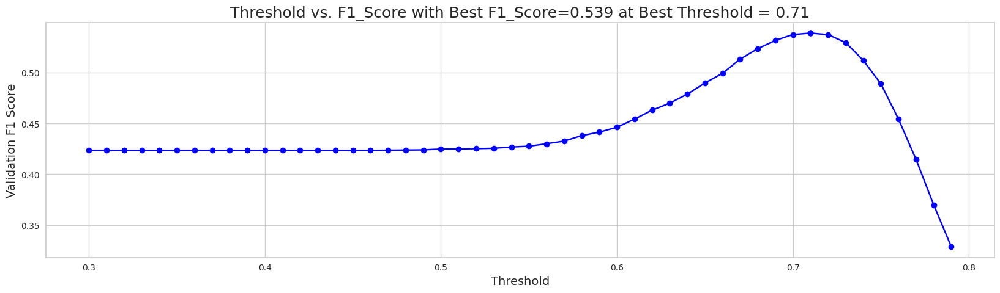

When using optimal threshold = 0.71...
Q0: F1 = 0.5392201098531362
==> Overall F1 = 0.5392201098531362
s
[I 2023-05-23 04:42:44,736] Trial 20 finished with value: 0.5392201098531362 and parameters: {'num_leaves': 42, 'learning_rate': 0.05119981931105068, 'feature_fraction': 0.25769025597883466, 'bagging_fraction': 0.8525111014819886, 'bagging_freq': 3, 'min_child_samples': 82, 'reg_alpha': 0.11748507229997428, 'reg_lambda': 0.2853734172917002, 'subsample': 0.9880178489195681, 'colsample_bytree': 0.6200980900655388, 'min_split_gain': 0.032978211190421824, 'max_depth': -1}. Best is trial 16 with value: 0.5478807952267379.


--------------------------------------------------
question16, with255features
--------------------------------------------------


,mean
feature,
hover_duration_sum,22.4
elapsed_time_diff_sum,13.8
15_level_counts,12.4
room_coor_x_min,12.4
hover_duration_mean,11.6
basic_name_counts,10.6
elapsed_time_diff_mean,10.4
room_corr_x_diff_std,10.4
screen_coor_y_std,9.4


[LightGBM] [Warning] bagging_fraction is set=0.7594090346498115, subsample=0.9890324420349323 will be ignored. Current value: bagging_fraction=0.7594090346498115
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.3780614934095018, colsample_bytree=0.4245034299746102 will be ignored. Current value: feature_fraction=0.3780614934095018
[[0.33052491 0.66947509]
 [0.32600692 0.67399308]
 [0.24137466 0.75862534]
 ...
 [0.23198204 0.76801796]
 [0.20331833 0.79668167]
 [0.24324972 0.75675028]]


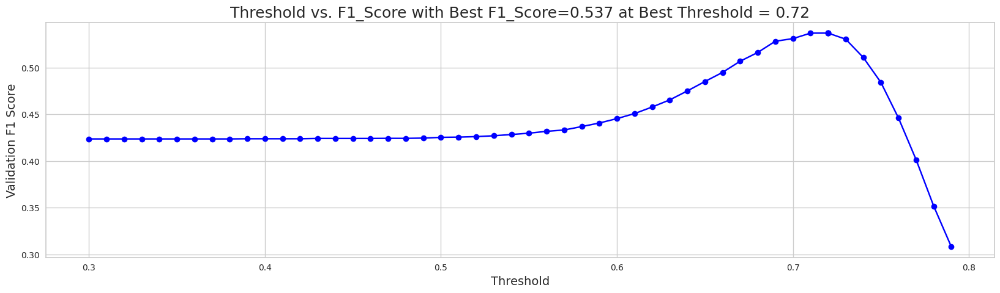

When using optimal threshold = 0.72...
Q0: F1 = 0.5368746161117621
==> Overall F1 = 0.5368746161117621
s
[I 2023-05-23 04:42:50,348] Trial 21 finished with value: 0.5368746161117621 and parameters: {'num_leaves': 43, 'learning_rate': 0.11663209762895352, 'feature_fraction': 0.26632119613813865, 'bagging_fraction': 0.7897437409595056, 'bagging_freq': 3, 'min_child_samples': 84, 'reg_alpha': 0.11813096101555486, 'reg_lambda': 0.24908708298938972, 'subsample': 0.9998824266588403, 'colsample_bytree': 0.6360343343191828, 'min_split_gain': 0.02219718384914994, 'max_depth': -1}. Best is trial 16 with value: 0.5478807952267379.


--------------------------------------------------
question16, with255features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.9937042872377922, subsample=0.8408149904975201 will be ignored. Current value: bagging_fraction=0.9937042872377922
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.42830541389360904, colsample_bytree=0.4301691756517493 will be ignored. Current value: feature_fraction=0.42830541389360904


[LightGBM] [Warning] bagging_fraction is set=0.7594090346498115, subsample=0.9890324420349323 will be ignored. Current value: bagging_fraction=0.7594090346498115
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.3780614934095018, colsample_bytree=0.4245034299746102 will be ignored. Current value: feature_fraction=0.3780614934095018


[LightGBM] [Warning] bagging_fraction is set=0.9937042872377922, subsample=0.8408149904975201 will be ignored. Current value: bagging_fraction=0.9937042872377922
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.42830541389360904, colsample_bytree=0.4301691756517493 will be ignored. Current value: feature_fraction=0.42830541389360904


[LightGBM] [Warning] bagging_fraction is set=0.8447527781076711, subsample=0.9966948934919044 will be ignored. Current value: bagging_fraction=0.8447527781076711
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
[LightGBM] [Warning] feature_fraction is set=0.32680778995310794, colsample_bytree=0.3421380993744472 will be ignored. Current value: feature_fraction=0.32680778995310794


[LightGBM] [Warning] bagging_fraction is set=0.7594090346498115, subsample=0.9890324420349323 will be ignored. Current value: bagging_fraction=0.7594090346498115
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.3780614934095018, colsample_bytree=0.4245034299746102 will be ignored. Current value: feature_fraction=0.3780614934095018


[LightGBM] [Warning] bagging_fraction is set=0.9937042872377922, subsample=0.8408149904975201 will be ignored. Current value: bagging_fraction=0.9937042872377922
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.42830541389360904, colsample_bytree=0.4301691756517493 will be ignored. Current value: feature_fraction=0.42830541389360904


[LightGBM] [Warning] bagging_fraction is set=0.7594090346498115, subsample=0.9890324420349323 will be ignored. Current value: bagging_fraction=0.7594090346498115
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.3780614934095018, colsample_bytree=0.4245034299746102 will be ignored. Current value: feature_fraction=0.3780614934095018


[LightGBM] [Warning] bagging_fraction is set=0.9937042872377922, subsample=0.8408149904975201 will be ignored. Current value: bagging_fraction=0.9937042872377922
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.42830541389360904, colsample_bytree=0.4301691756517493 will be ignored. Current value: feature_fraction=0.42830541389360904


[LightGBM] [Warning] bagging_fraction is set=0.7594090346498115, subsample=0.9890324420349323 will be ignored. Current value: bagging_fraction=0.7594090346498115
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.3780614934095018, colsample_bytree=0.4245034299746102 will be ignored. Current value: feature_fraction=0.3780614934095018


[LightGBM] [Warning] bagging_fraction is set=0.9937042872377922, subsample=0.8408149904975201 will be ignored. Current value: bagging_fraction=0.9937042872377922
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.42830541389360904, colsample_bytree=0.4301691756517493 will be ignored. Current value: feature_fraction=0.42830541389360904


[LightGBM] [Warning] bagging_fraction is set=0.8716390765264104, subsample=0.9834059710012251 will be ignored. Current value: bagging_fraction=0.8716390765264104
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
[LightGBM] [Warning] feature_fraction is set=0.30640270087380816, colsample_bytree=0.39880508097616296 will be ignored. Current value: feature_fraction=0.30640270087380816


,mean
feature,
hover_duration_max,7.4
elapsed_time_diff_sum,7.4
hover_duration_sum,7.2
19_level_counts,6.6
room_coor_y_std,5.6
day,5.2
screen_coor_x_std,5.2
15_level_counts,5.0
elapsed_time_diff_mean,5.0


[[0.43814241 0.56185759]
 [0.25220847 0.74779153]
 [0.27270876 0.72729124]
 ...
 [0.20550305 0.79449695]
 [0.23563759 0.76436241]
 [0.22530329 0.77469671]]


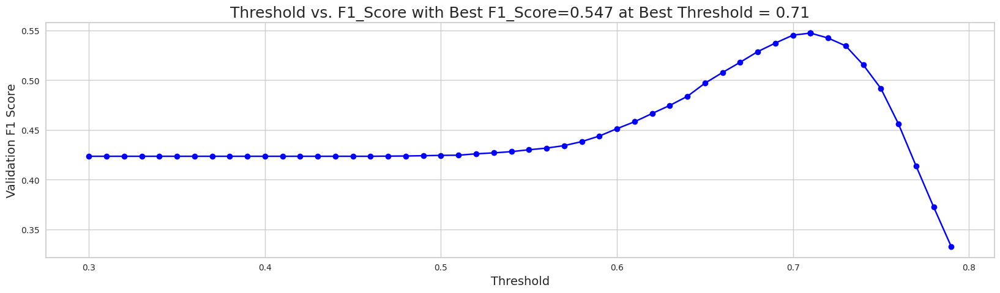

When using optimal threshold = 0.71...
Q0: F1 = 0.5473556312063413
==> Overall F1 = 0.5473556312063413
s
[I 2023-05-23 04:43:34,292] Trial 22 finished with value: 0.5473556312063413 and parameters: {'num_leaves': 42, 'learning_rate': 0.09362740960928194, 'feature_fraction': 0.3780614934095018, 'bagging_fraction': 0.7594090346498115, 'bagging_freq': 2, 'min_child_samples': 38, 'reg_alpha': 0.12813836349557442, 'reg_lambda': 0.5107323432869354, 'subsample': 0.9890324420349323, 'colsample_bytree': 0.4245034299746102, 'min_split_gain': 0.016288403286844867, 'max_depth': 1}. Best is trial 16 with value: 0.5478807952267379.


--------------------------------------------------
question16, with255features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.9145705415323879, subsample=0.8437950626229782 will be ignored. Current value: bagging_fraction=0.9145705415323879
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.4199402450410737, colsample_bytree=0.4222025691118929 will be ignored. Current value: feature_fraction=0.4199402450410737


,mean
feature,
hover_duration_max,6.6
room_corr_y_diff_std,5.4
day,5.4
hover_duration_sum,5.4
hour,5.2
elapsed_time_diff_mean,5.0
elapsed_time_diff_sum,5.0
room_coor_y_std,4.8
screen_coor_x_std,4.8


[[0.40703406 0.59296594]
 [0.24991095 0.75008905]
 [0.26225208 0.73774792]
 ...
 [0.21666122 0.78333878]
 [0.22768023 0.77231977]
 [0.22877626 0.77122374]]


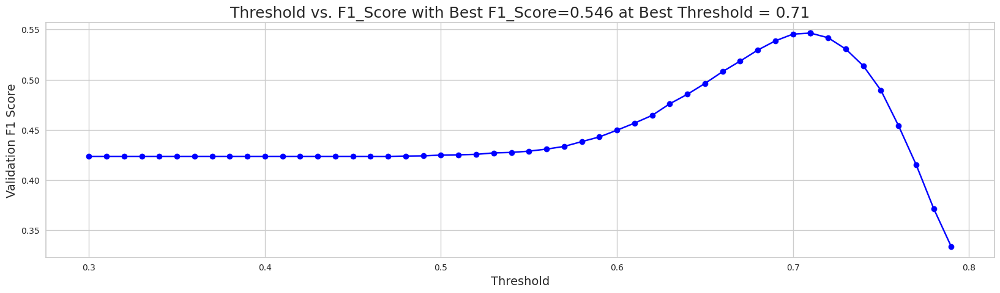

When using optimal threshold = 0.71...
Q0: F1 = 0.5464220594334299
==> Overall F1 = 0.5464220594334299
s
[I 2023-05-23 04:43:38,883] Trial 23 finished with value: 0.5464220594334299 and parameters: {'num_leaves': 11, 'learning_rate': 0.1531422395493625, 'feature_fraction': 0.42830541389360904, 'bagging_fraction': 0.9937042872377922, 'bagging_freq': 2, 'min_child_samples': 37, 'reg_alpha': 1.7669365011617504, 'reg_lambda': 0.514752905048689, 'subsample': 0.8408149904975201, 'colsample_bytree': 0.4301691756517493, 'min_split_gain': 0.00665122278773283, 'max_depth': 1}. Best is trial 16 with value: 0.5478807952267379.


--------------------------------------------------
question16, with255features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.914226601747392, subsample=0.9826230311951724 will be ignored. Current value: bagging_fraction=0.914226601747392
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.3020810369692748, colsample_bytree=0.39914676499377855 will be ignored. Current value: feature_fraction=0.3020810369692748


[LightGBM] [Warning] bagging_fraction is set=0.9145705415323879, subsample=0.8437950626229782 will be ignored. Current value: bagging_fraction=0.9145705415323879
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.4199402450410737, colsample_bytree=0.4222025691118929 will be ignored. Current value: feature_fraction=0.4199402450410737


,mean
feature,
hover_duration_max,54.4
elapsed_time_diff_sum,53.2
19_level_counts,51.4
hover_duration_sum,47.4
day,34.2
room_corr_y_diff_std,32.8
15_level_counts,32.4
directory.closeup.archivist_fqid_counts,31.4
tunic.historicalsociety.cage.glasses.beforeteddy_text_fqid_counts,31.2


[[0.39757214 0.60242786]
 [0.25642448 0.74357552]
 [0.26050012 0.73949988]
 ...
 [0.20866206 0.79133794]
 [0.22789406 0.77210594]
 [0.24067035 0.75932965]]


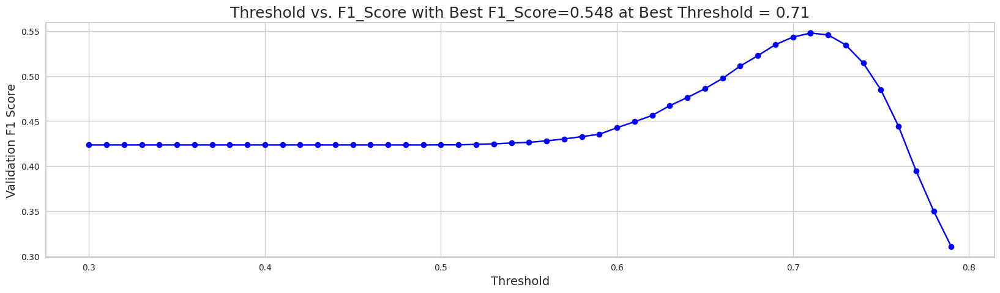

When using optimal threshold = 0.71...
Q0: F1 = 0.5476285449759585
==> Overall F1 = 0.5476285449759585
s
[I 2023-05-23 04:43:51,546] Trial 19 finished with value: 0.5476285449759585 and parameters: {'num_leaves': 100, 'learning_rate': 0.012487244680392218, 'feature_fraction': 0.32680778995310794, 'bagging_fraction': 0.8447527781076711, 'bagging_freq': 4, 'min_child_samples': 50, 'reg_alpha': 0.063661135528967, 'reg_lambda': 0.00894916264583436, 'subsample': 0.9966948934919044, 'colsample_bytree': 0.3421380993744472, 'min_split_gain': 0.028989627405130444, 'max_depth': 1}. Best is trial 16 with value: 0.5478807952267379.


--------------------------------------------------
question16, with255features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.7607305949972742, subsample=0.8205206188513648 will be ignored. Current value: bagging_fraction=0.7607305949972742
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
[LightGBM] [Warning] feature_fraction is set=0.43827855633703283, colsample_bytree=0.3990422798915198 will be ignored. Current value: feature_fraction=0.43827855633703283
[LightGBM] [Warning] bagging_fraction is set=0.914226601747392, subsample=0.9826230311951724 will be ignored. Current value: bagging_fraction=0.914226601747392
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] fe

[LightGBM] [Warning] bagging_fraction is set=0.9145705415323879, subsample=0.8437950626229782 will be ignored. Current value: bagging_fraction=0.9145705415323879
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.4199402450410737, colsample_bytree=0.4222025691118929 will be ignored. Current value: feature_fraction=0.4199402450410737


[LightGBM] [Warning] bagging_fraction is set=0.7607305949972742, subsample=0.8205206188513648 will be ignored. Current value: bagging_fraction=0.7607305949972742
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
[LightGBM] [Warning] feature_fraction is set=0.43827855633703283, colsample_bytree=0.3990422798915198 will be ignored. Current value: feature_fraction=0.43827855633703283


,mean
feature,
hover_duration_max,65.6
elapsed_time_diff_sum,62.8
19_level_counts,62.6
hover_duration_sum,53.0
tunic.historicalsociety.cage.glasses.beforeteddy_text_fqid_counts,43.4
15_level_counts,40.0
directory.closeup.archivist_fqid_counts,39.2
day,38.8
room_corr_y_diff_std,38.2


[[0.39732364 0.60267636]
 [0.25328362 0.74671638]
 [0.25639835 0.74360165]
 ...
 [0.20883593 0.79116407]
 [0.22736736 0.77263264]
 [0.24012692 0.75987308]]


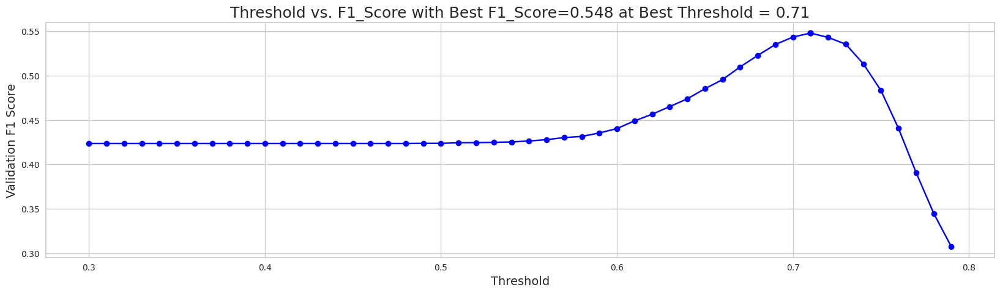

When using optimal threshold = 0.71...
Q0: F1 = 0.5477042319090895
==> Overall F1 = 0.5477042319090895
s
[I 2023-05-23 04:44:03,288] Trial 18 finished with value: 0.5477042319090895 and parameters: {'num_leaves': 100, 'learning_rate': 0.010358091391408118, 'feature_fraction': 0.30640270087380816, 'bagging_fraction': 0.8716390765264104, 'bagging_freq': 4, 'min_child_samples': 47, 'reg_alpha': 0.10923912613976523, 'reg_lambda': 0.005663888699280965, 'subsample': 0.9834059710012251, 'colsample_bytree': 0.39880508097616296, 'min_split_gain': 0.025735303409439084, 'max_depth': 1}. Best is trial 16 with value: 0.5478807952267379.


--------------------------------------------------
question16, with255features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.914226601747392, subsample=0.9826230311951724 will be ignored. Current value: bagging_fraction=0.914226601747392
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.3020810369692748, colsample_bytree=0.39914676499377855 will be ignored. Current value: feature_fraction=0.3020810369692748


[LightGBM] [Warning] bagging_fraction is set=0.9141472590947552, subsample=0.8285054848791596 will be ignored. Current value: bagging_fraction=0.9141472590947552
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
[LightGBM] [Warning] feature_fraction is set=0.20472770681621294, colsample_bytree=0.2720207624985794 will be ignored. Current value: feature_fraction=0.20472770681621294


[LightGBM] [Warning] bagging_fraction is set=0.9145705415323879, subsample=0.8437950626229782 will be ignored. Current value: bagging_fraction=0.9145705415323879
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.4199402450410737, colsample_bytree=0.4222025691118929 will be ignored. Current value: feature_fraction=0.4199402450410737


[LightGBM] [Warning] bagging_fraction is set=0.7607305949972742, subsample=0.8205206188513648 will be ignored. Current value: bagging_fraction=0.7607305949972742
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
[LightGBM] [Warning] feature_fraction is set=0.43827855633703283, colsample_bytree=0.3990422798915198 will be ignored. Current value: feature_fraction=0.43827855633703283


[LightGBM] [Warning] bagging_fraction is set=0.914226601747392, subsample=0.9826230311951724 will be ignored. Current value: bagging_fraction=0.914226601747392
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.3020810369692748, colsample_bytree=0.39914676499377855 will be ignored. Current value: feature_fraction=0.3020810369692748


[LightGBM] [Warning] bagging_fraction is set=0.9145705415323879, subsample=0.8437950626229782 will be ignored. Current value: bagging_fraction=0.9145705415323879
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.4199402450410737, colsample_bytree=0.4222025691118929 will be ignored. Current value: feature_fraction=0.4199402450410737


[LightGBM] [Warning] bagging_fraction is set=0.7607305949972742, subsample=0.8205206188513648 will be ignored. Current value: bagging_fraction=0.7607305949972742
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
[LightGBM] [Warning] feature_fraction is set=0.43827855633703283, colsample_bytree=0.3990422798915198 will be ignored. Current value: feature_fraction=0.43827855633703283


[LightGBM] [Warning] bagging_fraction is set=0.914226601747392, subsample=0.9826230311951724 will be ignored. Current value: bagging_fraction=0.914226601747392
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.3020810369692748, colsample_bytree=0.39914676499377855 will be ignored. Current value: feature_fraction=0.3020810369692748


,mean
feature,
hover_duration_max,8.4
elapsed_time_diff_sum,6.0
screen_coor_x_std,5.6
hover_duration_sum,5.6
19_level_counts,5.6
day,5.4
room_corr_y_diff_std,5.4
elapsed_time_diff_mean,5.2
tunic.historicalsociety.cage.glasses.beforeteddy_text_fqid_counts,5.0


[[0.45243784 0.54756216]
 [0.26888822 0.73111178]
 [0.28055371 0.71944629]
 ...
 [0.21773595 0.78226405]
 [0.23031489 0.76968511]
 [0.23552505 0.76447495]]


[LightGBM] [Warning] bagging_fraction is set=0.7607305949972742, subsample=0.8205206188513648 will be ignored. Current value: bagging_fraction=0.7607305949972742
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
[LightGBM] [Warning] feature_fraction is set=0.43827855633703283, colsample_bytree=0.3990422798915198 will be ignored. Current value: feature_fraction=0.43827855633703283


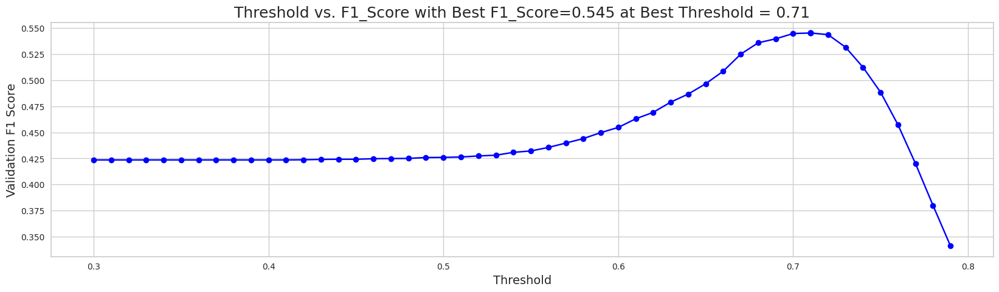

When using optimal threshold = 0.71...
Q0: F1 = 0.5452249281903051
==> Overall F1 = 0.5452249281903051
s
[I 2023-05-23 04:44:28,124] Trial 24 finished with value: 0.5452249281903051 and parameters: {'num_leaves': 46, 'learning_rate': 0.12919628087054819, 'feature_fraction': 0.4199402450410737, 'bagging_fraction': 0.9145705415323879, 'bagging_freq': 2, 'min_child_samples': 40, 'reg_alpha': 0.06809083042646835, 'reg_lambda': 0.8450529627039018, 'subsample': 0.8437950626229782, 'colsample_bytree': 0.4222025691118929, 'min_split_gain': 0.007458094236006638, 'max_depth': 1}. Best is trial 16 with value: 0.5478807952267379.


--------------------------------------------------
question16, with255features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.7598631050832283, subsample=0.802480396483384 will be ignored. Current value: bagging_fraction=0.7598631050832283
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
[LightGBM] [Warning] feature_fraction is set=0.18679763338863942, colsample_bytree=0.22749362833079378 will be ignored. Current value: feature_fraction=0.18679763338863942


[LightGBM] [Warning] bagging_fraction is set=0.9141472590947552, subsample=0.8285054848791596 will be ignored. Current value: bagging_fraction=0.9141472590947552
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
[LightGBM] [Warning] feature_fraction is set=0.20472770681621294, colsample_bytree=0.2720207624985794 will be ignored. Current value: feature_fraction=0.20472770681621294


,mean
feature,
hover_duration_max,12.6
elapsed_time_diff_sum,12.0
hover_duration_sum,10.2
room_corr_y_diff_std,9.6
19_level_counts,9.6
screen_coor_x_std,8.6
day,8.4
tunic.historicalsociety.cage.glasses.beforeteddy_text_fqid_counts,8.0
15_level_counts,7.6


[[0.4439002  0.5560998 ]
 [0.2655867  0.7344133 ]
 [0.26952481 0.73047519]
 ...
 [0.2098513  0.7901487 ]
 [0.22757683 0.77242317]
 [0.24304594 0.75695406]]


,mean
feature,
elapsed_time_diff_sum,10.4
hover_duration_max,10.2
hover_duration_sum,8.8
19_level_counts,8.6
screen_coor_x_std,6.6
hour,6.4
day,6.4
room_corr_x_diff_sum,6.2
directory.closeup.archivist_fqid_counts,6.2


[[0.37822953 0.62177047]
 [0.24899322 0.75100678]
 [0.25319912 0.74680088]
 ...
 [0.20802181 0.79197819]
 [0.23614988 0.76385012]
 [0.23565852 0.76434148]]


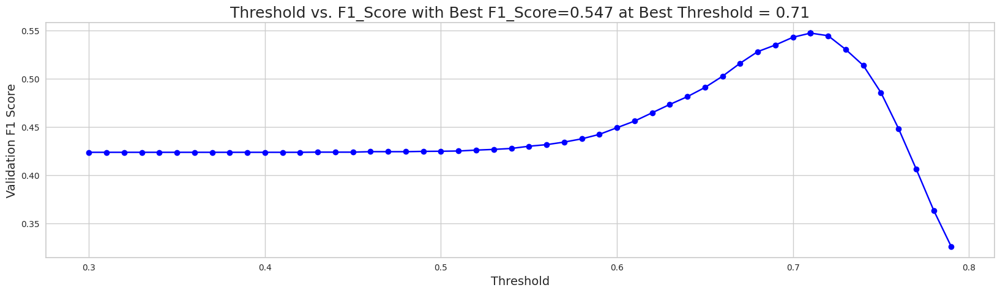

When using optimal threshold = 0.71...
Q0: F1 = 0.5472459432246137
==> Overall F1 = 0.5472459432246137
s
[I 2023-05-23 04:44:35,215] Trial 25 finished with value: 0.5472459432246137 and parameters: {'num_leaves': 48, 'learning_rate': 0.06766945060718799, 'feature_fraction': 0.3020810369692748, 'bagging_fraction': 0.914226601747392, 'bagging_freq': 2, 'min_child_samples': 25, 'reg_alpha': 0.18511279112800155, 'reg_lambda': 0.6838382190335899, 'subsample': 0.9826230311951724, 'colsample_bytree': 0.39914676499377855, 'min_split_gain': 0.011747858848625994, 'max_depth': 1}. Best is trial 16 with value: 0.5478807952267379.


--------------------------------------------------
question16, with255features
--------------------------------------------------


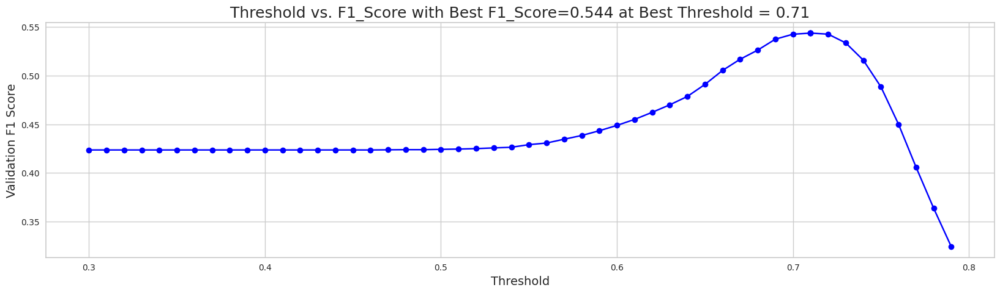

When using optimal threshold = 0.71...
Q0: F1 = 0.5436198260197465
==> Overall F1 = 0.5436198260197465
s
[I 2023-05-23 04:44:38,241] Trial 26 finished with value: 0.5436198260197465 and parameters: {'num_leaves': 50, 'learning_rate': 0.07103320688055324, 'feature_fraction': 0.43827855633703283, 'bagging_fraction': 0.7607305949972742, 'bagging_freq': 5, 'min_child_samples': 45, 'reg_alpha': 0.06293199806816434, 'reg_lambda': 0.955042387286739, 'subsample': 0.8205206188513648, 'colsample_bytree': 0.3990422798915198, 'min_split_gain': 0.06074630905362023, 'max_depth': 1}. Best is trial 16 with value: 0.5478807952267379.


[LightGBM] [Warning] bagging_fraction is set=0.7687482140214738, subsample=0.7943511541281338 will be ignored. Current value: bagging_fraction=0.7687482140214738
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
[LightGBM] [Warning] feature_fraction is set=0.20333685556399267, colsample_bytree=0.23358678172367126 will be ignored. Current value: feature_fraction=0.20333685556399267
--------------------------------------------------
question16, with255features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.6263944759064097, subsample=0.7878188648703306 will be ignored. Current value: bagging_fraction=0.6263944759064097
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
[LightGBM] [Warning] feature_fraction is set=0.2407957841364401, colsample_bytree=0.23627818383291388 will be ignored. Current value: feature_fraction=0.2407957841364401


[LightGBM] [Warning] bagging_fraction is set=0.9141472590947552, subsample=0.8285054848791596 will be ignored. Current value: bagging_fraction=0.9141472590947552
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
[LightGBM] [Warning] feature_fraction is set=0.20472770681621294, colsample_bytree=0.2720207624985794 will be ignored. Current value: feature_fraction=0.20472770681621294


[LightGBM] [Warning] bagging_fraction is set=0.6263944759064097, subsample=0.7878188648703306 will be ignored. Current value: bagging_fraction=0.6263944759064097
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
[LightGBM] [Warning] feature_fraction is set=0.2407957841364401, colsample_bytree=0.23627818383291388 will be ignored. Current value: feature_fraction=0.2407957841364401
[LightGBM] [Warning] bagging_fraction is set=0.7598631050832283, subsample=0.802480396483384 will be ignored. Current value: bagging_fraction=0.7598631050832283
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
[LightGBM] [Warning] fe

[LightGBM] [Warning] bagging_fraction is set=0.7687482140214738, subsample=0.7943511541281338 will be ignored. Current value: bagging_fraction=0.7687482140214738
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
[LightGBM] [Warning] feature_fraction is set=0.20333685556399267, colsample_bytree=0.23358678172367126 will be ignored. Current value: feature_fraction=0.20333685556399267


[LightGBM] [Warning] bagging_fraction is set=0.6263944759064097, subsample=0.7878188648703306 will be ignored. Current value: bagging_fraction=0.6263944759064097
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
[LightGBM] [Warning] feature_fraction is set=0.2407957841364401, colsample_bytree=0.23627818383291388 will be ignored. Current value: feature_fraction=0.2407957841364401


[LightGBM] [Warning] bagging_fraction is set=0.9141472590947552, subsample=0.8285054848791596 will be ignored. Current value: bagging_fraction=0.9141472590947552
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
[LightGBM] [Warning] feature_fraction is set=0.20472770681621294, colsample_bytree=0.2720207624985794 will be ignored. Current value: feature_fraction=0.20472770681621294


[LightGBM] [Warning] bagging_fraction is set=0.7687482140214738, subsample=0.7943511541281338 will be ignored. Current value: bagging_fraction=0.7687482140214738
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
[LightGBM] [Warning] feature_fraction is set=0.20333685556399267, colsample_bytree=0.23358678172367126 will be ignored. Current value: feature_fraction=0.20333685556399267


[LightGBM] [Warning] bagging_fraction is set=0.7598631050832283, subsample=0.802480396483384 will be ignored. Current value: bagging_fraction=0.7598631050832283
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
[LightGBM] [Warning] feature_fraction is set=0.18679763338863942, colsample_bytree=0.22749362833079378 will be ignored. Current value: feature_fraction=0.18679763338863942


[LightGBM] [Warning] bagging_fraction is set=0.9141472590947552, subsample=0.8285054848791596 will be ignored. Current value: bagging_fraction=0.9141472590947552
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
[LightGBM] [Warning] feature_fraction is set=0.20472770681621294, colsample_bytree=0.2720207624985794 will be ignored. Current value: feature_fraction=0.20472770681621294


[LightGBM] [Warning] bagging_fraction is set=0.6263944759064097, subsample=0.7878188648703306 will be ignored. Current value: bagging_fraction=0.6263944759064097
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
[LightGBM] [Warning] feature_fraction is set=0.2407957841364401, colsample_bytree=0.23627818383291388 will be ignored. Current value: feature_fraction=0.2407957841364401


,mean
feature,
hover_duration_max,60.2
elapsed_time_diff_sum,59.6
19_level_counts,57.8
hover_duration_sum,51.6
room_corr_y_diff_std,40.8
tunic.historicalsociety.cage.glasses.beforeteddy_text_fqid_counts,39.8
15_level_counts,39.0
day,39.0
directory.closeup.archivist_fqid_counts,38.6


[[0.3813007  0.6186993 ]
 [0.25261013 0.74738987]
 [0.25702961 0.74297039]
 ...
 [0.21883363 0.78116637]
 [0.23186581 0.76813419]
 [0.2467516  0.7532484 ]]


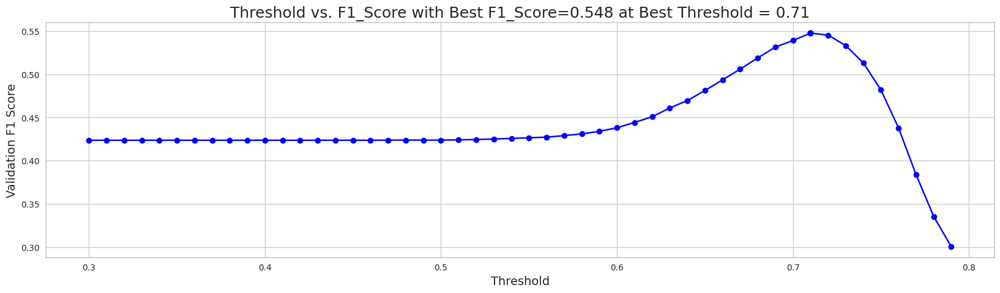

When using optimal threshold = 0.71...
Q0: F1 = 0.5476961500847385
==> Overall F1 = 0.5476961500847385
s
[I 2023-05-23 04:46:12,827] Trial 27 finished with value: 0.5476961500847385 and parameters: {'num_leaves': 76, 'learning_rate': 0.010558818108796187, 'feature_fraction': 0.20472770681621294, 'bagging_fraction': 0.9141472590947552, 'bagging_freq': 5, 'min_child_samples': 45, 'reg_alpha': 0.05152479603074277, 'reg_lambda': 0.03919363635897098, 'subsample': 0.8285054848791596, 'colsample_bytree': 0.2720207624985794, 'min_split_gain': 0.043136693778160304, 'max_depth': 1}. Best is trial 16 with value: 0.5478807952267379.


--------------------------------------------------
question16, with255features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.9334814850718955, subsample=0.7966979139728453 will be ignored. Current value: bagging_fraction=0.9334814850718955
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
[LightGBM] [Warning] feature_fraction is set=0.1497410866187921, colsample_bytree=0.23629940367103675 will be ignored. Current value: feature_fraction=0.1497410866187921


[LightGBM] [Warning] bagging_fraction is set=0.7598631050832283, subsample=0.802480396483384 will be ignored. Current value: bagging_fraction=0.7598631050832283
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
[LightGBM] [Warning] feature_fraction is set=0.18679763338863942, colsample_bytree=0.22749362833079378 will be ignored. Current value: feature_fraction=0.18679763338863942


[LightGBM] [Warning] bagging_fraction is set=0.7687482140214738, subsample=0.7943511541281338 will be ignored. Current value: bagging_fraction=0.7687482140214738
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
[LightGBM] [Warning] feature_fraction is set=0.20333685556399267, colsample_bytree=0.23358678172367126 will be ignored. Current value: feature_fraction=0.20333685556399267


[LightGBM] [Warning] bagging_fraction is set=0.9334814850718955, subsample=0.7966979139728453 will be ignored. Current value: bagging_fraction=0.9334814850718955
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
[LightGBM] [Warning] feature_fraction is set=0.1497410866187921, colsample_bytree=0.23629940367103675 will be ignored. Current value: feature_fraction=0.1497410866187921


[LightGBM] [Warning] bagging_fraction is set=0.6263944759064097, subsample=0.7878188648703306 will be ignored. Current value: bagging_fraction=0.6263944759064097
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
[LightGBM] [Warning] feature_fraction is set=0.2407957841364401, colsample_bytree=0.23627818383291388 will be ignored. Current value: feature_fraction=0.2407957841364401


[LightGBM] [Warning] bagging_fraction is set=0.9334814850718955, subsample=0.7966979139728453 will be ignored. Current value: bagging_fraction=0.9334814850718955
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
[LightGBM] [Warning] feature_fraction is set=0.1497410866187921, colsample_bytree=0.23629940367103675 will be ignored. Current value: feature_fraction=0.1497410866187921


,mean
feature,
hover_duration_max,286.6
room_coor_y_std,279.6
screen_coor_x_std,270.0
hover_duration_std,268.2
hover_duration_sum,264.6
room_coor_x_min,254.6
session_id,252.0
hover_duration_mean,252.0
room_coor_x_max,247.6


[[0.3453025  0.6546975 ]
 [0.27844077 0.72155923]
 [0.22856859 0.77143141]
 ...
 [0.21083628 0.78916372]
 [0.23684058 0.76315942]
 [0.24126195 0.75873805]]


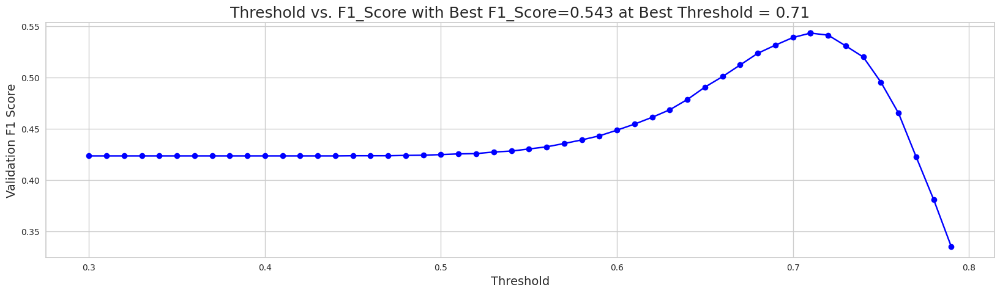

When using optimal threshold = 0.71...
Q0: F1 = 0.5430656885058754
==> Overall F1 = 0.5430656885058754
s
[I 2023-05-23 04:46:53,994] Trial 30 finished with value: 0.5430656885058754 and parameters: {'num_leaves': 72, 'learning_rate': 0.010144001295605408, 'feature_fraction': 0.2407957841364401, 'bagging_fraction': 0.6263944759064097, 'bagging_freq': 4, 'min_child_samples': 57, 'reg_alpha': 0.01176842771532375, 'reg_lambda': 0.04538580343316528, 'subsample': 0.7878188648703306, 'colsample_bytree': 0.23627818383291388, 'min_split_gain': 0.025658320573979, 'max_depth': 0}. Best is trial 16 with value: 0.5478807952267379.


--------------------------------------------------
question16, with255features
--------------------------------------------------
[LightGBM] [Warning] bagging_fraction is set=0.7598631050832283, subsample=0.802480396483384 will be ignored. Current value: bagging_fraction=0.7598631050832283
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
[LightGBM] [Warning] feature_fraction is set=0.18679763338863942, colsample_bytree=0.22749362833079378 will be ignored. Current value: feature_fraction=0.18679763338863942


[LightGBM] [Warning] bagging_fraction is set=0.7687482140214738, subsample=0.7943511541281338 will be ignored. Current value: bagging_fraction=0.7687482140214738
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
[LightGBM] [Warning] feature_fraction is set=0.20333685556399267, colsample_bytree=0.23358678172367126 will be ignored. Current value: feature_fraction=0.20333685556399267


[LightGBM] [Warning] bagging_fraction is set=0.7438633326442626, subsample=0.8876621182754213 will be ignored. Current value: bagging_fraction=0.7438633326442626
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
[LightGBM] [Warning] feature_fraction is set=0.4856641145132869, colsample_bytree=0.17225779642056968 will be ignored. Current value: feature_fraction=0.4856641145132869


[LightGBM] [Warning] bagging_fraction is set=0.9334814850718955, subsample=0.7966979139728453 will be ignored. Current value: bagging_fraction=0.9334814850718955
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
[LightGBM] [Warning] feature_fraction is set=0.1497410866187921, colsample_bytree=0.23629940367103675 will be ignored. Current value: feature_fraction=0.1497410866187921


[LightGBM] [Warning] bagging_fraction is set=0.7438633326442626, subsample=0.8876621182754213 will be ignored. Current value: bagging_fraction=0.7438633326442626
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
[LightGBM] [Warning] feature_fraction is set=0.4856641145132869, colsample_bytree=0.17225779642056968 will be ignored. Current value: feature_fraction=0.4856641145132869


[LightGBM] [Warning] bagging_fraction is set=0.9334814850718955, subsample=0.7966979139728453 will be ignored. Current value: bagging_fraction=0.9334814850718955
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
[LightGBM] [Warning] feature_fraction is set=0.1497410866187921, colsample_bytree=0.23629940367103675 will be ignored. Current value: feature_fraction=0.1497410866187921


[LightGBM] [Warning] bagging_fraction is set=0.7438633326442626, subsample=0.8876621182754213 will be ignored. Current value: bagging_fraction=0.7438633326442626
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
[LightGBM] [Warning] feature_fraction is set=0.4856641145132869, colsample_bytree=0.17225779642056968 will be ignored. Current value: feature_fraction=0.4856641145132869


,mean
feature,
screen_coor_x_std,251.6
room_coor_y_std,246.2
room_coor_x_min,240.8
hover_duration_std,236.2
elapsed_time_diff_sum,233.4
room_coor_y_mean,227.2
hover_duration_sum,225.6
session_id,221.6
room_coor_y_min,215.0


[[0.31137291 0.68862709]
 [0.26777802 0.73222198]
 [0.25814644 0.74185356]
 ...
 [0.23048124 0.76951876]
 [0.21419879 0.78580121]
 [0.23627438 0.76372562]]


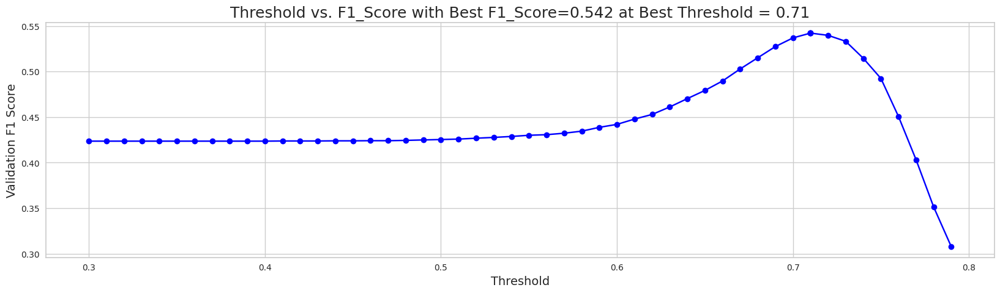

When using optimal threshold = 0.71...
Q0: F1 = 0.5421908160131407
==> Overall F1 = 0.5421908160131407
s
[I 2023-05-23 04:47:24,514] Trial 28 finished with value: 0.5421908160131407 and parameters: {'num_leaves': 72, 'learning_rate': 0.010044646347020627, 'feature_fraction': 0.18679763338863942, 'bagging_fraction': 0.7598631050832283, 'bagging_freq': 5, 'min_child_samples': 27, 'reg_alpha': 0.029475438055401936, 'reg_lambda': 0.053281181821608986, 'subsample': 0.802480396483384, 'colsample_bytree': 0.22749362833079378, 'min_split_gain': 0.057025292911351916, 'max_depth': 0}. Best is trial 16 with value: 0.5478807952267379.


--------------------------------------------------
question16, with255features
--------------------------------------------------


,mean
feature,
hover_duration_max,131.8
hover_duration_sum,128.0
19_level_counts,119.8
15_level_counts,112.2
hover_duration_std,111.6
elapsed_time_diff_mean,108.8
screen_coor_y_mean,108.8
screen_coor_x_std,107.4
room_coor_y_max,104.2


[LightGBM] [Warning] bagging_fraction is set=0.9322228222660136, subsample=0.8786949266942237 will be ignored. Current value: bagging_fraction=0.9322228222660136
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
[LightGBM] [Warning] feature_fraction is set=0.19318801036983096, colsample_bytree=0.1823120564608447 will be ignored. Current value: feature_fraction=0.19318801036983096
[[0.36854109 0.63145891]
 [0.2531861  0.7468139 ]
 [0.24455218 0.75544782]
 ...
 [0.20842791 0.79157209]
 [0.22874449 0.77125551]
 [0.24620326 0.75379674]]


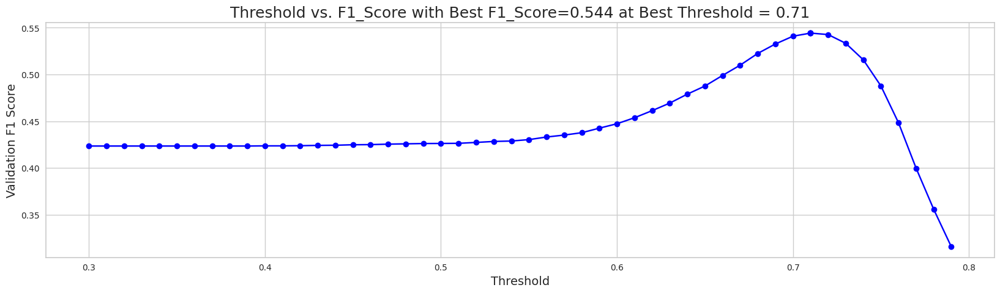

When using optimal threshold = 0.71...
Q0: F1 = 0.5443079904316214
==> Overall F1 = 0.5443079904316214
s
[I 2023-05-23 04:47:30,281] Trial 31 finished with value: 0.5443079904316214 and parameters: {'num_leaves': 72, 'learning_rate': 0.01560927033790399, 'feature_fraction': 0.1497410866187921, 'bagging_fraction': 0.9334814850718955, 'bagging_freq': 4, 'min_child_samples': 26, 'reg_alpha': 0.02084730849675825, 'reg_lambda': 0.03935772670382566, 'subsample': 0.7966979139728453, 'colsample_bytree': 0.23629940367103675, 'min_split_gain': 0.07845597878204248, 'max_depth': 5}. Best is trial 16 with value: 0.5478807952267379.


--------------------------------------------------
question16, with255features
--------------------------------------------------


,mean
feature,
hover_duration_std,286.6
hover_duration_max,258.4
elapsed_time_diff_sum,243.8
room_coor_y_std,242.6
session_id,228.8
room_coor_y_max,222.6
screen_coor_y_mean,220.2
room_coor_x_max,220.2
screen_coor_x_mean,219.8


[[0.34812723 0.65187277]
 [0.26006893 0.73993107]
 [0.25248904 0.74751096]
 ...
 [0.21400805 0.78599195]
 [0.23627892 0.76372108]
 [0.24066251 0.75933749]]


[LightGBM] [Warning] bagging_fraction is set=0.8458921836526265, subsample=0.8971356739764191 will be ignored. Current value: bagging_fraction=0.8458921836526265
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
[LightGBM] [Warning] feature_fraction is set=0.2165291738621793, colsample_bytree=0.357382130758968 will be ignored. Current value: feature_fraction=0.2165291738621793


[LightGBM] [Warning] bagging_fraction is set=0.7438633326442626, subsample=0.8876621182754213 will be ignored. Current value: bagging_fraction=0.7438633326442626
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
[LightGBM] [Warning] feature_fraction is set=0.4856641145132869, colsample_bytree=0.17225779642056968 will be ignored. Current value: feature_fraction=0.4856641145132869


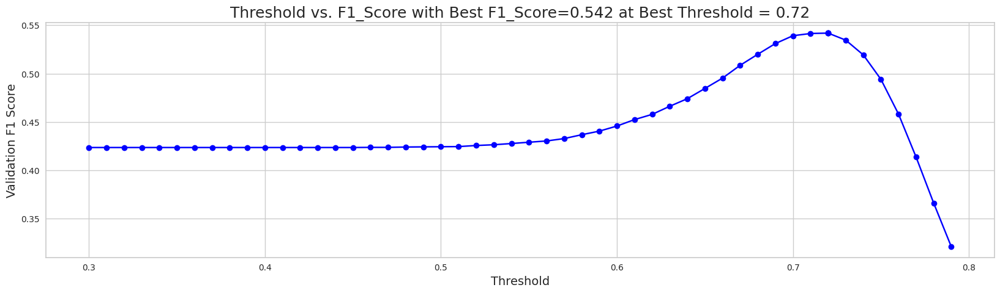

When using optimal threshold = 0.72...
Q0: F1 = 0.5417993169527479
==> Overall F1 = 0.5417993169527479
s
[I 2023-05-23 04:47:35,614] Trial 29 finished with value: 0.5417993169527479 and parameters: {'num_leaves': 72, 'learning_rate': 0.010260023201208448, 'feature_fraction': 0.20333685556399267, 'bagging_fraction': 0.7687482140214738, 'bagging_freq': 5, 'min_child_samples': 46, 'reg_alpha': 0.0338118285511435, 'reg_lambda': 0.04725212130289207, 'subsample': 0.7943511541281338, 'colsample_bytree': 0.23358678172367126, 'min_split_gain': 0.05799270125944737, 'max_depth': 0}. Best is trial 16 with value: 0.5478807952267379.


--------------------------------------------------
question16, with255features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.823569530493573, subsample=0.9053380210341411 will be ignored. Current value: bagging_fraction=0.823569530493573
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
[LightGBM] [Warning] feature_fraction is set=0.20723154032376784, colsample_bytree=0.3378776585175093 will be ignored. Current value: feature_fraction=0.20723154032376784


[LightGBM] [Warning] bagging_fraction is set=0.9322228222660136, subsample=0.8786949266942237 will be ignored. Current value: bagging_fraction=0.9322228222660136
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
[LightGBM] [Warning] feature_fraction is set=0.19318801036983096, colsample_bytree=0.1823120564608447 will be ignored. Current value: feature_fraction=0.19318801036983096


[LightGBM] [Warning] bagging_fraction is set=0.8458921836526265, subsample=0.8971356739764191 will be ignored. Current value: bagging_fraction=0.8458921836526265
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
[LightGBM] [Warning] feature_fraction is set=0.2165291738621793, colsample_bytree=0.357382130758968 will be ignored. Current value: feature_fraction=0.2165291738621793


[LightGBM] [Warning] bagging_fraction is set=0.823569530493573, subsample=0.9053380210341411 will be ignored. Current value: bagging_fraction=0.823569530493573
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
[LightGBM] [Warning] feature_fraction is set=0.20723154032376784, colsample_bytree=0.3378776585175093 will be ignored. Current value: feature_fraction=0.20723154032376784


[LightGBM] [Warning] bagging_fraction is set=0.9322228222660136, subsample=0.8786949266942237 will be ignored. Current value: bagging_fraction=0.9322228222660136
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
[LightGBM] [Warning] feature_fraction is set=0.19318801036983096, colsample_bytree=0.1823120564608447 will be ignored. Current value: feature_fraction=0.19318801036983096


[LightGBM] [Warning] bagging_fraction is set=0.7438633326442626, subsample=0.8876621182754213 will be ignored. Current value: bagging_fraction=0.7438633326442626
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
[LightGBM] [Warning] feature_fraction is set=0.4856641145132869, colsample_bytree=0.17225779642056968 will be ignored. Current value: feature_fraction=0.4856641145132869


[LightGBM] [Warning] bagging_fraction is set=0.9322228222660136, subsample=0.8786949266942237 will be ignored. Current value: bagging_fraction=0.9322228222660136
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
[LightGBM] [Warning] feature_fraction is set=0.19318801036983096, colsample_bytree=0.1823120564608447 will be ignored. Current value: feature_fraction=0.19318801036983096


,mean
feature,
19_level_counts,58.2
hover_duration_max,57.2
elapsed_time_diff_sum,56.8
hover_duration_sum,55.0
screen_coor_x_std,46.4
15_level_counts,42.2
session_id,37.8
room_coor_y_std,36.0
hover_duration_mean,33.0


[[0.35745729 0.64254271]
 [0.2565469  0.7434531 ]
 [0.24497354 0.75502646]
 ...
 [0.21325451 0.78674549]
 [0.22551023 0.77448977]
 [0.23468562 0.76531438]]


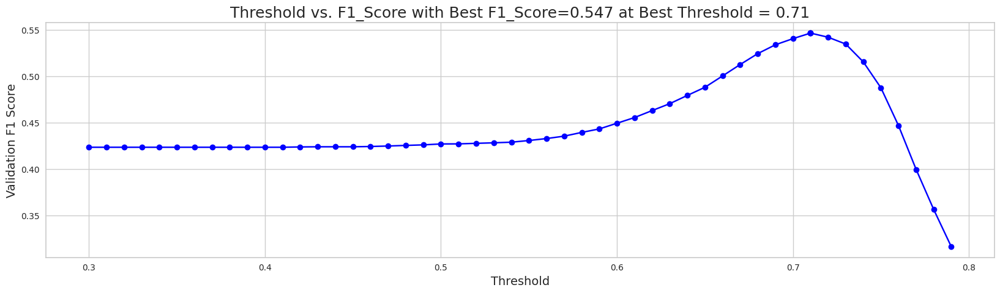

When using optimal threshold = 0.71...
Q0: F1 = 0.5465744941490943
==> Overall F1 = 0.5465744941490943
s
[I 2023-05-23 04:48:07,570] Trial 32 finished with value: 0.5465744941490943 and parameters: {'num_leaves': 77, 'learning_rate': 0.015956368110128506, 'feature_fraction': 0.4856641145132869, 'bagging_fraction': 0.7438633326442626, 'bagging_freq': 6, 'min_child_samples': 26, 'reg_alpha': 0.03731074025526745, 'reg_lambda': 0.022347020999664645, 'subsample': 0.8876621182754213, 'colsample_bytree': 0.17225779642056968, 'min_split_gain': 0.08374376940757329, 'max_depth': 3}. Best is trial 16 with value: 0.5478807952267379.


--------------------------------------------------
question16, with255features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.823569530493573, subsample=0.9053380210341411 will be ignored. Current value: bagging_fraction=0.823569530493573
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
[LightGBM] [Warning] feature_fraction is set=0.20723154032376784, colsample_bytree=0.3378776585175093 will be ignored. Current value: feature_fraction=0.20723154032376784


[LightGBM] [Warning] bagging_fraction is set=0.8328063717981279, subsample=0.9438032307039262 will be ignored. Current value: bagging_fraction=0.8328063717981279
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
[LightGBM] [Warning] feature_fraction is set=0.31259885680152144, colsample_bytree=0.34356656549853304 will be ignored. Current value: feature_fraction=0.31259885680152144


[LightGBM] [Warning] bagging_fraction is set=0.8458921836526265, subsample=0.8971356739764191 will be ignored. Current value: bagging_fraction=0.8458921836526265
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
[LightGBM] [Warning] feature_fraction is set=0.2165291738621793, colsample_bytree=0.357382130758968 will be ignored. Current value: feature_fraction=0.2165291738621793


[LightGBM] [Warning] bagging_fraction is set=0.9322228222660136, subsample=0.8786949266942237 will be ignored. Current value: bagging_fraction=0.9322228222660136
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
[LightGBM] [Warning] feature_fraction is set=0.19318801036983096, colsample_bytree=0.1823120564608447 will be ignored. Current value: feature_fraction=0.19318801036983096


[LightGBM] [Warning] bagging_fraction is set=0.823569530493573, subsample=0.9053380210341411 will be ignored. Current value: bagging_fraction=0.823569530493573
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
[LightGBM] [Warning] feature_fraction is set=0.20723154032376784, colsample_bytree=0.3378776585175093 will be ignored. Current value: feature_fraction=0.20723154032376784


[LightGBM] [Warning] bagging_fraction is set=0.8328063717981279, subsample=0.9438032307039262 will be ignored. Current value: bagging_fraction=0.8328063717981279
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
[LightGBM] [Warning] feature_fraction is set=0.31259885680152144, colsample_bytree=0.34356656549853304 will be ignored. Current value: feature_fraction=0.31259885680152144


[LightGBM] [Warning] bagging_fraction is set=0.8458921836526265, subsample=0.8971356739764191 will be ignored. Current value: bagging_fraction=0.8458921836526265
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
[LightGBM] [Warning] feature_fraction is set=0.2165291738621793, colsample_bytree=0.357382130758968 will be ignored. Current value: feature_fraction=0.2165291738621793


,mean
feature,
19_level_counts,60.2
hover_duration_sum,58.0
hover_duration_max,53.0
room_coor_y_std,50.8
elapsed_time_diff_sum,50.4
15_level_counts,43.4
session_id,42.0
screen_coor_x_std,41.4
elapsed_time_diff_mean,41.2


[[0.40433317 0.59566683]
 [0.25298821 0.74701179]
 [0.26882151 0.73117849]
 ...
 [0.21593773 0.78406227]
 [0.22500662 0.77499338]
 [0.24143376 0.75856624]]


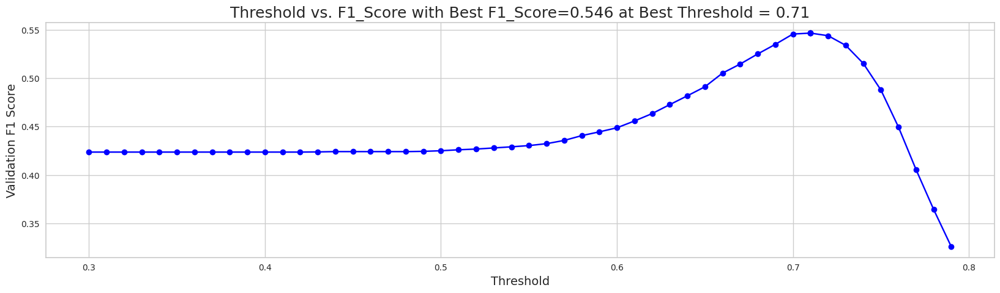

When using optimal threshold = 0.71...
Q0: F1 = 0.546437909435697
==> Overall F1 = 0.546437909435697
s
[I 2023-05-23 04:48:38,545] Trial 33 finished with value: 0.546437909435697 and parameters: {'num_leaves': 64, 'learning_rate': 0.018113982481670867, 'feature_fraction': 0.19318801036983096, 'bagging_fraction': 0.9322228222660136, 'bagging_freq': 6, 'min_child_samples': 73, 'reg_alpha': 0.037361755464825404, 'reg_lambda': 0.02401268791608404, 'subsample': 0.8786949266942237, 'colsample_bytree': 0.1823120564608447, 'min_split_gain': 0.01525661540620605, 'max_depth': 3}. Best is trial 16 with value: 0.5478807952267379.


--------------------------------------------------
question16, with255features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.8270614764768563, subsample=0.9409020919243998 will be ignored. Current value: bagging_fraction=0.8270614764768563
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
[LightGBM] [Warning] feature_fraction is set=0.31887013313297086, colsample_bytree=0.3565939455914642 will be ignored. Current value: feature_fraction=0.31887013313297086


[LightGBM] [Warning] bagging_fraction is set=0.8328063717981279, subsample=0.9438032307039262 will be ignored. Current value: bagging_fraction=0.8328063717981279
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
[LightGBM] [Warning] feature_fraction is set=0.31259885680152144, colsample_bytree=0.34356656549853304 will be ignored. Current value: feature_fraction=0.31259885680152144
[LightGBM] [Warning] bagging_fraction is set=0.8458921836526265, subsample=0.8971356739764191 will be ignored. Current value: bagging_fraction=0.8458921836526265
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
[LightGBM] [Warning]

[LightGBM] [Warning] bagging_fraction is set=0.823569530493573, subsample=0.9053380210341411 will be ignored. Current value: bagging_fraction=0.823569530493573
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
[LightGBM] [Warning] feature_fraction is set=0.20723154032376784, colsample_bytree=0.3378776585175093 will be ignored. Current value: feature_fraction=0.20723154032376784


[LightGBM] [Warning] bagging_fraction is set=0.8328063717981279, subsample=0.9438032307039262 will be ignored. Current value: bagging_fraction=0.8328063717981279
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
[LightGBM] [Warning] feature_fraction is set=0.31259885680152144, colsample_bytree=0.34356656549853304 will be ignored. Current value: feature_fraction=0.31259885680152144


[LightGBM] [Warning] bagging_fraction is set=0.8270614764768563, subsample=0.9409020919243998 will be ignored. Current value: bagging_fraction=0.8270614764768563
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
[LightGBM] [Warning] feature_fraction is set=0.31887013313297086, colsample_bytree=0.3565939455914642 will be ignored. Current value: feature_fraction=0.31887013313297086


,mean
feature,
hover_duration_max,66.8
19_level_counts,61.2
elapsed_time_diff_sum,57.8
hover_duration_sum,50.6
15_level_counts,45.8
room_coor_y_std,38.8
hour,38.2
screen_coor_x_std,36.8
day,36.2


[[0.41646877 0.58353123]
 [0.25550575 0.74449425]
 [0.25174738 0.74825262]
 ...
 [0.20730412 0.79269588]
 [0.22594112 0.77405888]
 [0.23659725 0.76340275]]


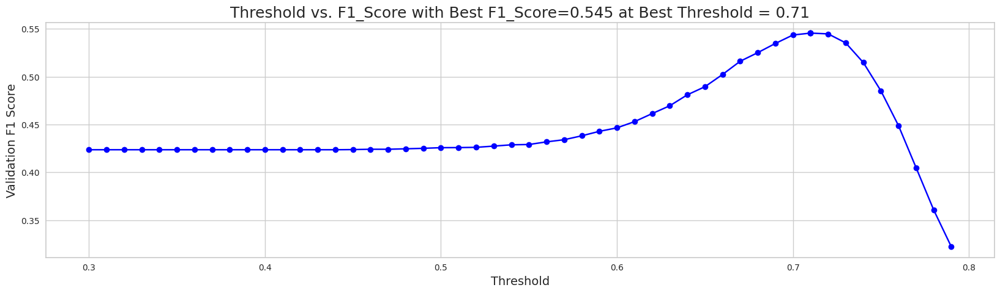

When using optimal threshold = 0.71...
Q0: F1 = 0.5454722719106461
==> Overall F1 = 0.5454722719106461
s
[I 2023-05-23 04:49:04,421] Trial 34 finished with value: 0.5454722719106461 and parameters: {'num_leaves': 94, 'learning_rate': 0.013826646872553713, 'feature_fraction': 0.2165291738621793, 'bagging_fraction': 0.8458921836526265, 'bagging_freq': 6, 'min_child_samples': 46, 'reg_alpha': 0.07005119344987476, 'reg_lambda': 0.014441622346437933, 'subsample': 0.8971356739764191, 'colsample_bytree': 0.357382130758968, 'min_split_gain': 0.017803582143850034, 'max_depth': 2}. Best is trial 16 with value: 0.5478807952267379.


--------------------------------------------------
question16, with255features
--------------------------------------------------


,mean
feature,
hover_duration_max,83.0
19_level_counts,73.2
elapsed_time_diff_sum,69.4
hover_duration_sum,62.6
15_level_counts,61.2
room_coor_y_std,59.8
screen_coor_x_std,57.4
session_id,53.8
elapsed_time_diff_mean,50.8


[[0.43021918 0.56978082]
 [0.24874799 0.75125201]
 [0.23361427 0.76638573]
 ...
 [0.21835015 0.78164985]
 [0.22601435 0.77398565]
 [0.25053982 0.74946018]]


[LightGBM] [Warning] bagging_fraction is set=0.888736375734179, subsample=0.945381549625363 will be ignored. Current value: bagging_fraction=0.888736375734179
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
[LightGBM] [Warning] feature_fraction is set=0.3102212598771297, colsample_bytree=0.2957850036401176 will be ignored. Current value: feature_fraction=0.3102212598771297


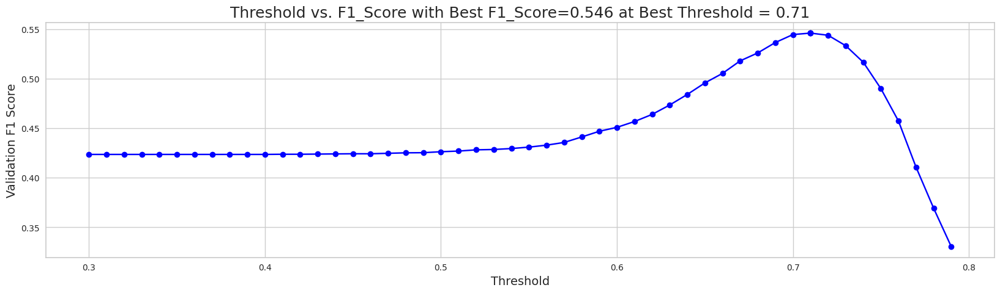

When using optimal threshold = 0.71...
Q0: F1 = 0.5459824780906604
==> Overall F1 = 0.5459824780906604
s
[I 2023-05-23 04:49:10,316] Trial 35 finished with value: 0.5459824780906604 and parameters: {'num_leaves': 90, 'learning_rate': 0.014317532623730655, 'feature_fraction': 0.20723154032376784, 'bagging_fraction': 0.823569530493573, 'bagging_freq': 6, 'min_child_samples': 56, 'reg_alpha': 0.0807729761796146, 'reg_lambda': 0.014756956385998837, 'subsample': 0.9053380210341411, 'colsample_bytree': 0.3378776585175093, 'min_split_gain': 0.019431161418447317, 'max_depth': 3}. Best is trial 16 with value: 0.5478807952267379.


--------------------------------------------------
question16, with255features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.7046309574392414, subsample=0.9477950354474188 will be ignored. Current value: bagging_fraction=0.7046309574392414
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
[LightGBM] [Warning] feature_fraction is set=0.3392670685289676, colsample_bytree=0.10827877114150762 will be ignored. Current value: feature_fraction=0.3392670685289676


[LightGBM] [Warning] bagging_fraction is set=0.8328063717981279, subsample=0.9438032307039262 will be ignored. Current value: bagging_fraction=0.8328063717981279
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
[LightGBM] [Warning] feature_fraction is set=0.31259885680152144, colsample_bytree=0.34356656549853304 will be ignored. Current value: feature_fraction=0.31259885680152144


[LightGBM] [Warning] bagging_fraction is set=0.8270614764768563, subsample=0.9409020919243998 will be ignored. Current value: bagging_fraction=0.8270614764768563
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
[LightGBM] [Warning] feature_fraction is set=0.31887013313297086, colsample_bytree=0.3565939455914642 will be ignored. Current value: feature_fraction=0.31887013313297086


[LightGBM] [Warning] bagging_fraction is set=0.888736375734179, subsample=0.945381549625363 will be ignored. Current value: bagging_fraction=0.888736375734179
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
[LightGBM] [Warning] feature_fraction is set=0.3102212598771297, colsample_bytree=0.2957850036401176 will be ignored. Current value: feature_fraction=0.3102212598771297


,mean
feature,
hover_duration_max,65.4
19_level_counts,64.6
elapsed_time_diff_sum,60.8
hover_duration_sum,59.4
15_level_counts,48.2
screen_coor_x_std,42.2
day,42.0
tunic.historicalsociety.cage.glasses.beforeteddy_text_fqid_counts,35.8
session_id,34.6


[[0.41275997 0.58724003]
 [0.26461621 0.73538379]
 [0.26799511 0.73200489]
 ...
 [0.20980207 0.79019793]
 [0.22356803 0.77643197]
 [0.23557984 0.76442016]]


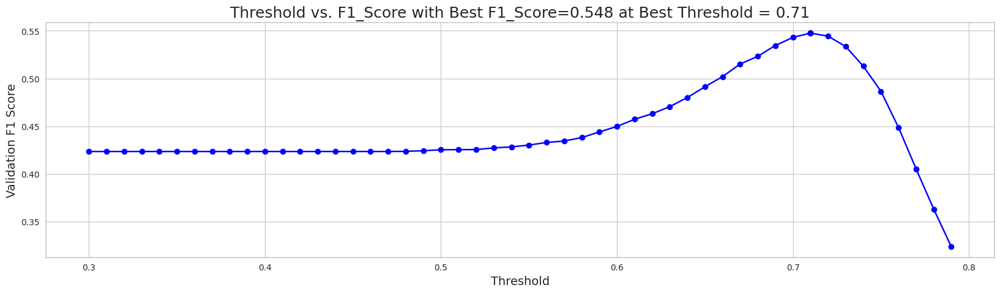

When using optimal threshold = 0.71...
Q0: F1 = 0.5475594466940872
==> Overall F1 = 0.5475594466940872
s
[I 2023-05-23 04:49:32,736] Trial 36 finished with value: 0.5475594466940872 and parameters: {'num_leaves': 93, 'learning_rate': 0.013533396892763007, 'feature_fraction': 0.31259885680152144, 'bagging_fraction': 0.8328063717981279, 'bagging_freq': 4, 'min_child_samples': 58, 'reg_alpha': 0.06135906840039475, 'reg_lambda': 0.010614217865959369, 'subsample': 0.9438032307039262, 'colsample_bytree': 0.34356656549853304, 'min_split_gain': 0.017778662796504776, 'max_depth': 2}. Best is trial 16 with value: 0.5478807952267379.


--------------------------------------------------
question16, with255features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.9339913878542431, subsample=0.953462137476367 will be ignored. Current value: bagging_fraction=0.9339913878542431
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
[LightGBM] [Warning] feature_fraction is set=0.2909348965172101, colsample_bytree=0.27711117248316985 will be ignored. Current value: feature_fraction=0.2909348965172101


[LightGBM] [Warning] bagging_fraction is set=0.7046309574392414, subsample=0.9477950354474188 will be ignored. Current value: bagging_fraction=0.7046309574392414
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
[LightGBM] [Warning] feature_fraction is set=0.3392670685289676, colsample_bytree=0.10827877114150762 will be ignored. Current value: feature_fraction=0.3392670685289676


[LightGBM] [Warning] bagging_fraction is set=0.8270614764768563, subsample=0.9409020919243998 will be ignored. Current value: bagging_fraction=0.8270614764768563
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
[LightGBM] [Warning] feature_fraction is set=0.31887013313297086, colsample_bytree=0.3565939455914642 will be ignored. Current value: feature_fraction=0.31887013313297086


[LightGBM] [Warning] bagging_fraction is set=0.888736375734179, subsample=0.945381549625363 will be ignored. Current value: bagging_fraction=0.888736375734179
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
[LightGBM] [Warning] feature_fraction is set=0.3102212598771297, colsample_bytree=0.2957850036401176 will be ignored. Current value: feature_fraction=0.3102212598771297


[LightGBM] [Warning] bagging_fraction is set=0.9339913878542431, subsample=0.953462137476367 will be ignored. Current value: bagging_fraction=0.9339913878542431
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
[LightGBM] [Warning] feature_fraction is set=0.2909348965172101, colsample_bytree=0.27711117248316985 will be ignored. Current value: feature_fraction=0.2909348965172101


[LightGBM] [Warning] bagging_fraction is set=0.8270614764768563, subsample=0.9409020919243998 will be ignored. Current value: bagging_fraction=0.8270614764768563
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
[LightGBM] [Warning] feature_fraction is set=0.31887013313297086, colsample_bytree=0.3565939455914642 will be ignored. Current value: feature_fraction=0.31887013313297086


[LightGBM] [Warning] bagging_fraction is set=0.888736375734179, subsample=0.945381549625363 will be ignored. Current value: bagging_fraction=0.888736375734179
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
[LightGBM] [Warning] feature_fraction is set=0.3102212598771297, colsample_bytree=0.2957850036401176 will be ignored. Current value: feature_fraction=0.3102212598771297


[LightGBM] [Warning] bagging_fraction is set=0.9339913878542431, subsample=0.953462137476367 will be ignored. Current value: bagging_fraction=0.9339913878542431
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
[LightGBM] [Warning] feature_fraction is set=0.2909348965172101, colsample_bytree=0.27711117248316985 will be ignored. Current value: feature_fraction=0.2909348965172101


,mean
feature,
hover_duration_max,65.6
19_level_counts,61.8
elapsed_time_diff_sum,56.8
hover_duration_sum,56.6
15_level_counts,46.4
day,37.8
screen_coor_x_std,35.4
tunic.historicalsociety.cage.glasses.beforeteddy_text_fqid_counts,33.4
room_coor_y_std,32.6


[[0.41143508 0.58856492]
 [0.26008502 0.73991498]
 [0.25504138 0.74495862]
 ...
 [0.21109167 0.78890833]
 [0.22393287 0.77606713]
 [0.23926015 0.76073985]]


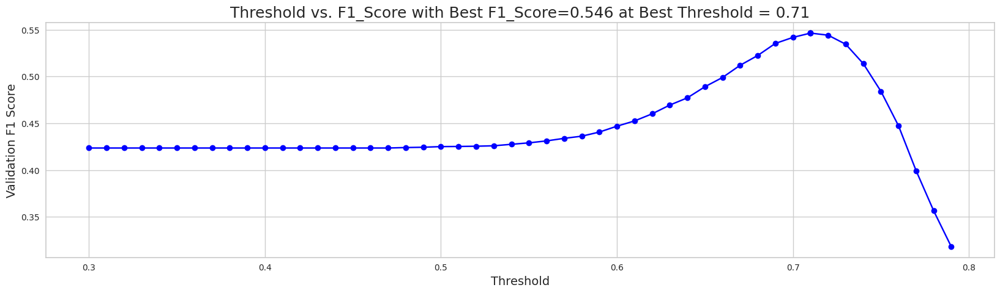

When using optimal threshold = 0.71...
Q0: F1 = 0.5462849489784382
==> Overall F1 = 0.5462849489784382
s
[I 2023-05-23 04:50:13,188] Trial 37 finished with value: 0.5462849489784382 and parameters: {'num_leaves': 92, 'learning_rate': 0.013164771362198142, 'feature_fraction': 0.31887013313297086, 'bagging_fraction': 0.8270614764768563, 'bagging_freq': 4, 'min_child_samples': 57, 'reg_alpha': 0.08025932680824567, 'reg_lambda': 0.006952257512833636, 'subsample': 0.9409020919243998, 'colsample_bytree': 0.3565939455914642, 'min_split_gain': 0.031583597111549726, 'max_depth': 2}. Best is trial 16 with value: 0.5478807952267379.


--------------------------------------------------
question16, with255features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.8986213434955881, subsample=0.9613895977701359 will be ignored. Current value: bagging_fraction=0.8986213434955881
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.34194244266478324, colsample_bytree=0.2727657169969375 will be ignored. Current value: feature_fraction=0.34194244266478324


[LightGBM] [Warning] bagging_fraction is set=0.7046309574392414, subsample=0.9477950354474188 will be ignored. Current value: bagging_fraction=0.7046309574392414
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
[LightGBM] [Warning] feature_fraction is set=0.3392670685289676, colsample_bytree=0.10827877114150762 will be ignored. Current value: feature_fraction=0.3392670685289676


[LightGBM] [Warning] bagging_fraction is set=0.9339913878542431, subsample=0.953462137476367 will be ignored. Current value: bagging_fraction=0.9339913878542431
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
[LightGBM] [Warning] feature_fraction is set=0.2909348965172101, colsample_bytree=0.27711117248316985 will be ignored. Current value: feature_fraction=0.2909348965172101


[LightGBM] [Warning] bagging_fraction is set=0.888736375734179, subsample=0.945381549625363 will be ignored. Current value: bagging_fraction=0.888736375734179
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
[LightGBM] [Warning] feature_fraction is set=0.3102212598771297, colsample_bytree=0.2957850036401176 will be ignored. Current value: feature_fraction=0.3102212598771297


[LightGBM] [Warning] bagging_fraction is set=0.9339913878542431, subsample=0.953462137476367 will be ignored. Current value: bagging_fraction=0.9339913878542431
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
[LightGBM] [Warning] feature_fraction is set=0.2909348965172101, colsample_bytree=0.27711117248316985 will be ignored. Current value: feature_fraction=0.2909348965172101


[LightGBM] [Warning] bagging_fraction is set=0.8986213434955881, subsample=0.9613895977701359 will be ignored. Current value: bagging_fraction=0.8986213434955881
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.34194244266478324, colsample_bytree=0.2727657169969375 will be ignored. Current value: feature_fraction=0.34194244266478324


,mean
feature,
room_coor_x_min,70.4
elapsed_time_diff_mean,69.6
room_coor_x_mean,68.0
hover_duration_sum,67.2
hover_duration_std,66.4
hover_duration_max,65.6
screen_coor_x_std,62.6
screen_corr_x_dff_std,61.2
room_coor_y_max,59.6


[[0.34576999 0.65423001]
 [0.25041105 0.74958895]
 [0.25465138 0.74534862]
 ...
 [0.22564645 0.77435355]
 [0.20312384 0.79687616]
 [0.23099381 0.76900619]]


[LightGBM] [Warning] bagging_fraction is set=0.7046309574392414, subsample=0.9477950354474188 will be ignored. Current value: bagging_fraction=0.7046309574392414
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
[LightGBM] [Warning] feature_fraction is set=0.3392670685289676, colsample_bytree=0.10827877114150762 will be ignored. Current value: feature_fraction=0.3392670685289676


,mean
feature,
elapsed_time_diff_sum,91.4
hover_duration_max,76.8
room_coor_y_std,75.4
screen_coor_x_std,74.6
room_coor_x_std,71.0
session_id,69.8
room_coor_y_min,64.6
room_coor_y_mean,61.4
15_level_counts,57.6


[[0.37574686 0.62425314]
 [0.25577871 0.74422129]
 [0.28824617 0.71175383]
 ...
 [0.22282435 0.77717565]
 [0.23130459 0.76869541]
 [0.22694352 0.77305648]]


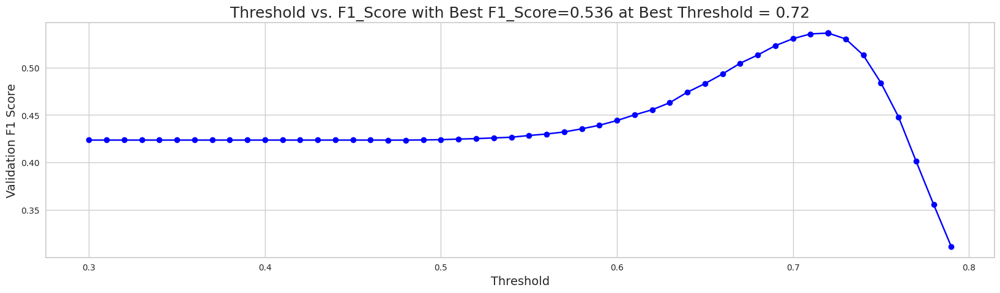

When using optimal threshold = 0.72...
Q0: F1 = 0.5362446548137925
==> Overall F1 = 0.5362446548137925
s
[I 2023-05-23 04:50:45,370] Trial 38 finished with value: 0.5362446548137925 and parameters: {'num_leaves': 100, 'learning_rate': 0.036157362173572155, 'feature_fraction': 0.3102212598771297, 'bagging_fraction': 0.888736375734179, 'bagging_freq': 4, 'min_child_samples': 51, 'reg_alpha': 0.08104118139939588, 'reg_lambda': 0.0066346810434038265, 'subsample': 0.945381549625363, 'colsample_bytree': 0.2957850036401176, 'min_split_gain': 0.033945648379662, 'max_depth': -1}. Best is trial 16 with value: 0.5478807952267379.


--------------------------------------------------
question16, with255features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.6940069829669642, subsample=0.8648589672932445 will be ignored. Current value: bagging_fraction=0.6940069829669642
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.3519412296099017, colsample_bytree=0.11377250750300306 will be ignored. Current value: feature_fraction=0.3519412296099017


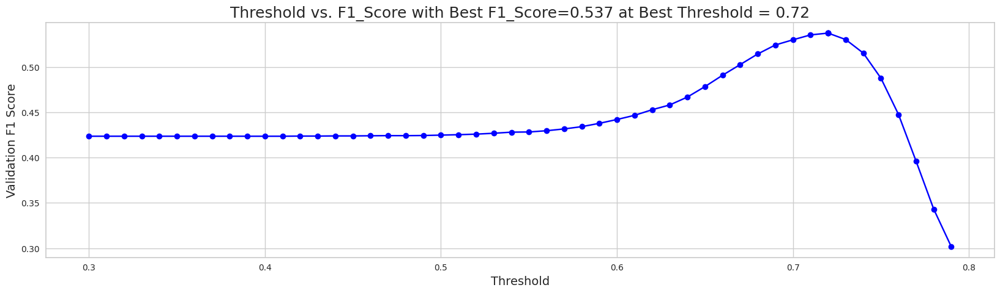

When using optimal threshold = 0.72...
Q0: F1 = 0.5374154159840929
==> Overall F1 = 0.5374154159840929
s
[I 2023-05-23 04:50:48,834] Trial 40 finished with value: 0.5374154159840929 and parameters: {'num_leaves': 99, 'learning_rate': 0.03613939710119304, 'feature_fraction': 0.2909348965172101, 'bagging_fraction': 0.9339913878542431, 'bagging_freq': 4, 'min_child_samples': 17, 'reg_alpha': 0.16144110062652053, 'reg_lambda': 0.006727329941723752, 'subsample': 0.953462137476367, 'colsample_bytree': 0.27711117248316985, 'min_split_gain': 0.03481226644738134, 'max_depth': -1}. Best is trial 16 with value: 0.5478807952267379.


--------------------------------------------------
question16, with255features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.6817052121197373, subsample=0.8672362640866934 will be ignored. Current value: bagging_fraction=0.6817052121197373
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.2383712823647344, colsample_bytree=0.12782415982877102 will be ignored. Current value: feature_fraction=0.2383712823647344


[LightGBM] [Warning] bagging_fraction is set=0.6817052121197373, subsample=0.8672362640866934 will be ignored. Current value: bagging_fraction=0.6817052121197373
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.2383712823647344, colsample_bytree=0.12782415982877102 will be ignored. Current value: feature_fraction=0.2383712823647344


[LightGBM] [Warning] bagging_fraction is set=0.6940069829669642, subsample=0.8648589672932445 will be ignored. Current value: bagging_fraction=0.6940069829669642
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.3519412296099017, colsample_bytree=0.11377250750300306 will be ignored. Current value: feature_fraction=0.3519412296099017


[LightGBM] [Warning] bagging_fraction is set=0.6817052121197373, subsample=0.8672362640866934 will be ignored. Current value: bagging_fraction=0.6817052121197373
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.2383712823647344, colsample_bytree=0.12782415982877102 will be ignored. Current value: feature_fraction=0.2383712823647344


[LightGBM] [Warning] bagging_fraction is set=0.6940069829669642, subsample=0.8648589672932445 will be ignored. Current value: bagging_fraction=0.6940069829669642
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.3519412296099017, colsample_bytree=0.11377250750300306 will be ignored. Current value: feature_fraction=0.3519412296099017


[LightGBM] [Warning] bagging_fraction is set=0.6817052121197373, subsample=0.8672362640866934 will be ignored. Current value: bagging_fraction=0.6817052121197373
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.2383712823647344, colsample_bytree=0.12782415982877102 will be ignored. Current value: feature_fraction=0.2383712823647344


[LightGBM] [Warning] bagging_fraction is set=0.7046309574392414, subsample=0.9477950354474188 will be ignored. Current value: bagging_fraction=0.7046309574392414
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
[LightGBM] [Warning] feature_fraction is set=0.3392670685289676, colsample_bytree=0.10827877114150762 will be ignored. Current value: feature_fraction=0.3392670685289676


[LightGBM] [Warning] bagging_fraction is set=0.6940069829669642, subsample=0.8648589672932445 will be ignored. Current value: bagging_fraction=0.6940069829669642
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.3519412296099017, colsample_bytree=0.11377250750300306 will be ignored. Current value: feature_fraction=0.3519412296099017


[LightGBM] [Warning] bagging_fraction is set=0.6817052121197373, subsample=0.8672362640866934 will be ignored. Current value: bagging_fraction=0.6817052121197373
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.2383712823647344, colsample_bytree=0.12782415982877102 will be ignored. Current value: feature_fraction=0.2383712823647344


[LightGBM] [Warning] bagging_fraction is set=0.8986213434955881, subsample=0.9613895977701359 will be ignored. Current value: bagging_fraction=0.8986213434955881
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.34194244266478324, colsample_bytree=0.2727657169969375 will be ignored. Current value: feature_fraction=0.34194244266478324


,mean
feature,
hover_duration_max,57.6
19_level_counts,56.6
elapsed_time_diff_sum,54.8
hover_duration_sum,49.0
screen_coor_x_std,48.8
room_coor_x_min,46.2
15_level_counts,46.0
hover_duration_std,44.6
room_coor_y_std,43.8


[[0.35377852 0.64622148]
 [0.25681959 0.74318041]
 [0.25263903 0.74736097]
 ...
 [0.21216268 0.78783732]
 [0.22056647 0.77943353]
 [0.24460707 0.75539293]]


[LightGBM] [Warning] bagging_fraction is set=0.6940069829669642, subsample=0.8648589672932445 will be ignored. Current value: bagging_fraction=0.6940069829669642
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.3519412296099017, colsample_bytree=0.11377250750300306 will be ignored. Current value: feature_fraction=0.3519412296099017


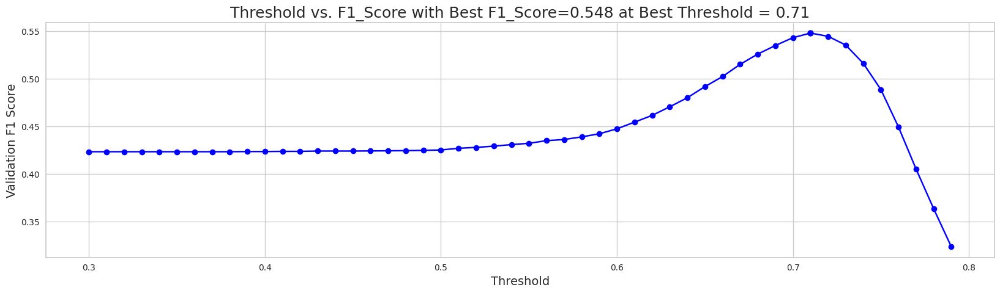

When using optimal threshold = 0.71...
Q0: F1 = 0.5481154150880856
==> Overall F1 = 0.5481154150880856
s
[I 2023-05-23 04:51:38,898] Trial 43 finished with value: 0.5481154150880856 and parameters: {'num_leaves': 84, 'learning_rate': 0.020534418936306503, 'feature_fraction': 0.2383712823647344, 'bagging_fraction': 0.6817052121197373, 'bagging_freq': 3, 'min_child_samples': 31, 'reg_alpha': 0.2158743016133312, 'reg_lambda': 0.08182224915561978, 'subsample': 0.8672362640866934, 'colsample_bytree': 0.12782415982877102, 'min_split_gain': 0.12819123772424879, 'max_depth': 4}. Best is trial 43 with value: 0.5481154150880856.


--------------------------------------------------
question16, with255features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.7200718602486822, subsample=0.8630345866225789 will be ignored. Current value: bagging_fraction=0.7200718602486822
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.22855308781849287, colsample_bytree=0.11837637478011775 will be ignored. Current value: feature_fraction=0.22855308781849287


[LightGBM] [Warning] bagging_fraction is set=0.7200718602486822, subsample=0.8630345866225789 will be ignored. Current value: bagging_fraction=0.7200718602486822
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.22855308781849287, colsample_bytree=0.11837637478011775 will be ignored. Current value: feature_fraction=0.22855308781849287


,mean
feature,
hover_duration_max,70.0
elapsed_time_diff_sum,67.4
19_level_counts,64.4
hover_duration_sum,59.4
screen_coor_x_std,58.8
15_level_counts,55.0
session_id,54.8
room_coor_x_min,51.4
hover_duration_std,51.0


[[0.39828278 0.60171722]
 [0.27402421 0.72597579]
 [0.2477825  0.7522175 ]
 ...
 [0.21743277 0.78256723]
 [0.220904   0.779096  ]
 [0.25346284 0.74653716]]


,mean
feature,
hover_duration_max,191.6
room_coor_y_std,177.6
elapsed_time_diff_sum,176.2
session_id,173.8
room_coor_x_min,173.8
screen_coor_x_std,169.0
elapsed_time_diff_std,155.0
room_coor_y_mean,154.6
screen_coor_x_mean,148.8


[[0.31656903 0.68343097]
 [0.30331298 0.69668702]
 [0.25441033 0.74558967]
 ...
 [0.23122222 0.76877778]
 [0.23673087 0.76326913]
 [0.2686828  0.7313172 ]]


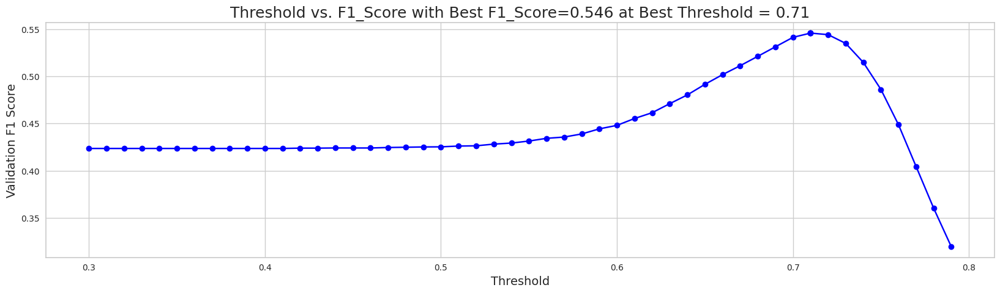

When using optimal threshold = 0.71...
Q0: F1 = 0.5458447999082675
==> Overall F1 = 0.5458447999082675
s
[I 2023-05-23 04:51:50,701] Trial 42 finished with value: 0.5458447999082675 and parameters: {'num_leaves': 85, 'learning_rate': 0.021376230353335007, 'feature_fraction': 0.3519412296099017, 'bagging_fraction': 0.6940069829669642, 'bagging_freq': 3, 'min_child_samples': 43, 'reg_alpha': 0.22093969653272552, 'reg_lambda': 0.08442391540067626, 'subsample': 0.8648589672932445, 'colsample_bytree': 0.11377250750300306, 'min_split_gain': 0.1261867931700564, 'max_depth': 5}. Best is trial 43 with value: 0.5481154150880856.


--------------------------------------------------
question16, with255features
--------------------------------------------------


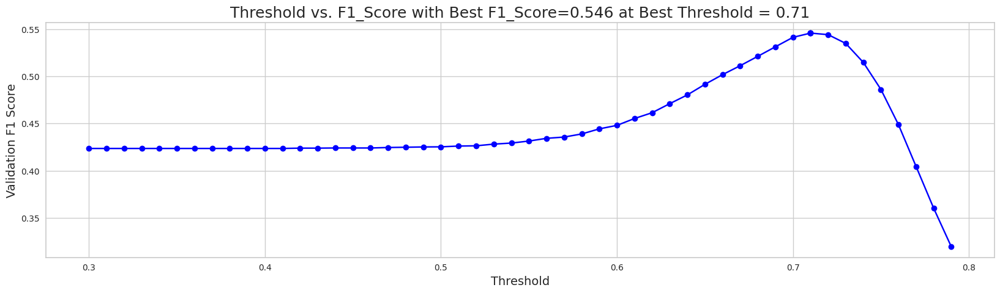

[LightGBM] [Warning] bagging_fraction is set=0.903749302632619, subsample=0.999051909009435 will be ignored. Current value: bagging_fraction=0.903749302632619
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
[LightGBM] [Warning] feature_fraction is set=0.24214398027228926, colsample_bytree=0.15535496523655945 will be ignored. Current value: feature_fraction=0.24214398027228926


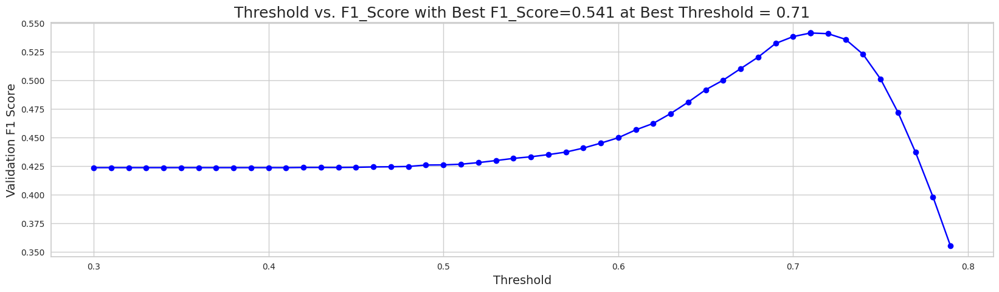

When using optimal threshold = 0.71...
Q0: F1 = 0.5413676273170374
==> Overall F1 = 0.5413676273170374
s
[I 2023-05-23 04:51:54,519] Trial 39 finished with value: 0.5413676273170374 and parameters: {'num_leaves': 100, 'learning_rate': 0.02186639385863293, 'feature_fraction': 0.3392670685289676, 'bagging_fraction': 0.7046309574392414, 'bagging_freq': 4, 'min_child_samples': 14, 'reg_alpha': 0.23524463728781428, 'reg_lambda': 0.006814175596945207, 'subsample': 0.9477950354474188, 'colsample_bytree': 0.10827877114150762, 'min_split_gain': 0.03374016277308232, 'max_depth': -1}. Best is trial 43 with value: 0.5481154150880856.


--------------------------------------------------
question16, with255features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.8872735324402978, subsample=0.8652325814192426 will be ignored. Current value: bagging_fraction=0.8872735324402978
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
[LightGBM] [Warning] feature_fraction is set=0.261364331790525, colsample_bytree=0.149787775224737 will be ignored. Current value: feature_fraction=0.261364331790525


[LightGBM] [Warning] bagging_fraction is set=0.8986213434955881, subsample=0.9613895977701359 will be ignored. Current value: bagging_fraction=0.8986213434955881
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.34194244266478324, colsample_bytree=0.2727657169969375 will be ignored. Current value: feature_fraction=0.34194244266478324


[LightGBM] [Warning] bagging_fraction is set=0.7200718602486822, subsample=0.8630345866225789 will be ignored. Current value: bagging_fraction=0.7200718602486822
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.22855308781849287, colsample_bytree=0.11837637478011775 will be ignored. Current value: feature_fraction=0.22855308781849287


[LightGBM] [Warning] bagging_fraction is set=0.903749302632619, subsample=0.999051909009435 will be ignored. Current value: bagging_fraction=0.903749302632619
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
[LightGBM] [Warning] feature_fraction is set=0.24214398027228926, colsample_bytree=0.15535496523655945 will be ignored. Current value: feature_fraction=0.24214398027228926


[LightGBM] [Warning] bagging_fraction is set=0.7200718602486822, subsample=0.8630345866225789 will be ignored. Current value: bagging_fraction=0.7200718602486822
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.22855308781849287, colsample_bytree=0.11837637478011775 will be ignored. Current value: feature_fraction=0.22855308781849287


[LightGBM] [Warning] bagging_fraction is set=0.8872735324402978, subsample=0.8652325814192426 will be ignored. Current value: bagging_fraction=0.8872735324402978
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
[LightGBM] [Warning] feature_fraction is set=0.261364331790525, colsample_bytree=0.149787775224737 will be ignored. Current value: feature_fraction=0.261364331790525


[LightGBM] [Warning] bagging_fraction is set=0.903749302632619, subsample=0.999051909009435 will be ignored. Current value: bagging_fraction=0.903749302632619
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
[LightGBM] [Warning] feature_fraction is set=0.24214398027228926, colsample_bytree=0.15535496523655945 will be ignored. Current value: feature_fraction=0.24214398027228926


[LightGBM] [Warning] bagging_fraction is set=0.7200718602486822, subsample=0.8630345866225789 will be ignored. Current value: bagging_fraction=0.7200718602486822
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.22855308781849287, colsample_bytree=0.11837637478011775 will be ignored. Current value: feature_fraction=0.22855308781849287


[LightGBM] [Warning] bagging_fraction is set=0.903749302632619, subsample=0.999051909009435 will be ignored. Current value: bagging_fraction=0.903749302632619
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
[LightGBM] [Warning] feature_fraction is set=0.24214398027228926, colsample_bytree=0.15535496523655945 will be ignored. Current value: feature_fraction=0.24214398027228926


,mean
feature,
hover_duration_max,62.8
elapsed_time_diff_sum,54.2
room_coor_y_std,53.6
19_level_counts,51.8
screen_coor_x_std,51.2
hover_duration_sum,50.0
15_level_counts,46.8
session_id,46.2
room_coor_x_min,45.0


[[0.35555717 0.64444283]
 [0.25606115 0.74393885]
 [0.24928644 0.75071356]
 ...
 [0.20263628 0.79736372]
 [0.22191128 0.77808872]
 [0.24385706 0.75614294]]


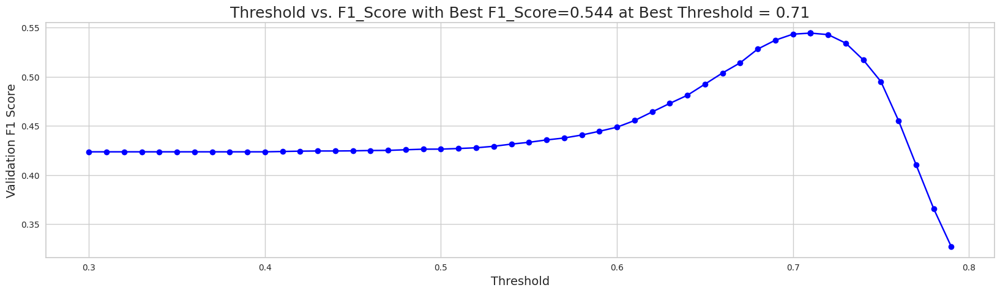

When using optimal threshold = 0.71...
Q0: F1 = 0.5443147581528933
==> Overall F1 = 0.5443147581528933
s
[I 2023-05-23 04:52:30,329] Trial 44 finished with value: 0.5443147581528933 and parameters: {'num_leaves': 83, 'learning_rate': 0.021425696409410507, 'feature_fraction': 0.22855308781849287, 'bagging_fraction': 0.7200718602486822, 'bagging_freq': 3, 'min_child_samples': 30, 'reg_alpha': 0.22538610809099144, 'reg_lambda': 0.08660096314182807, 'subsample': 0.8630345866225789, 'colsample_bytree': 0.11837637478011775, 'min_split_gain': 0.17160684100910195, 'max_depth': 4}. Best is trial 43 with value: 0.5481154150880856.


--------------------------------------------------
question16, with255features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.8986213434955881, subsample=0.9613895977701359 will be ignored. Current value: bagging_fraction=0.8986213434955881
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.34194244266478324, colsample_bytree=0.2727657169969375 will be ignored. Current value: feature_fraction=0.34194244266478324


[LightGBM] [Warning] bagging_fraction is set=0.6272803349318229, subsample=0.9042468558912304 will be ignored. Current value: bagging_fraction=0.6272803349318229
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
[LightGBM] [Warning] feature_fraction is set=0.25486799282087635, colsample_bytree=0.17127890647974958 will be ignored. Current value: feature_fraction=0.25486799282087635


[LightGBM] [Warning] bagging_fraction is set=0.8872735324402978, subsample=0.8652325814192426 will be ignored. Current value: bagging_fraction=0.8872735324402978
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
[LightGBM] [Warning] feature_fraction is set=0.261364331790525, colsample_bytree=0.149787775224737 will be ignored. Current value: feature_fraction=0.261364331790525


[LightGBM] [Warning] bagging_fraction is set=0.6272803349318229, subsample=0.9042468558912304 will be ignored. Current value: bagging_fraction=0.6272803349318229
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
[LightGBM] [Warning] feature_fraction is set=0.25486799282087635, colsample_bytree=0.17127890647974958 will be ignored. Current value: feature_fraction=0.25486799282087635


[LightGBM] [Warning] bagging_fraction is set=0.903749302632619, subsample=0.999051909009435 will be ignored. Current value: bagging_fraction=0.903749302632619
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
[LightGBM] [Warning] feature_fraction is set=0.24214398027228926, colsample_bytree=0.15535496523655945 will be ignored. Current value: feature_fraction=0.24214398027228926


[LightGBM] [Warning] bagging_fraction is set=0.8872735324402978, subsample=0.8652325814192426 will be ignored. Current value: bagging_fraction=0.8872735324402978
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
[LightGBM] [Warning] feature_fraction is set=0.261364331790525, colsample_bytree=0.149787775224737 will be ignored. Current value: feature_fraction=0.261364331790525


,mean
feature,
room_coor_y_std,179.2
hover_duration_max,174.2
elapsed_time_diff_sum,169.8
screen_coor_x_std,169.4
room_coor_x_min,167.2
session_id,165.4
room_coor_y_mean,157.0
hover_duration_sum,148.0
room_coor_y_min,147.4


[LightGBM] [Warning] bagging_fraction is set=0.6272803349318229, subsample=0.9042468558912304 will be ignored. Current value: bagging_fraction=0.6272803349318229
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
[LightGBM] [Warning] feature_fraction is set=0.25486799282087635, colsample_bytree=0.17127890647974958 will be ignored. Current value: feature_fraction=0.25486799282087635


[[0.34171018 0.65828982]
 [0.24193875 0.75806125]
 [0.25961392 0.74038608]
 ...
 [0.22612776 0.77387224]
 [0.22768701 0.77231299]
 [0.23965984 0.76034016]]


,mean
feature,
19_level_counts,59.8
hover_duration_max,59.0
elapsed_time_diff_sum,58.4
hover_duration_sum,55.6
screen_coor_x_std,55.2
15_level_counts,52.6
room_coor_y_std,49.2
session_id,45.2
room_coor_x_min,41.0


[[0.39184644 0.60815356]
 [0.25616944 0.74383056]
 [0.24814471 0.75185529]
 ...
 [0.21836578 0.78163422]
 [0.22464946 0.77535054]
 [0.23807073 0.76192927]]


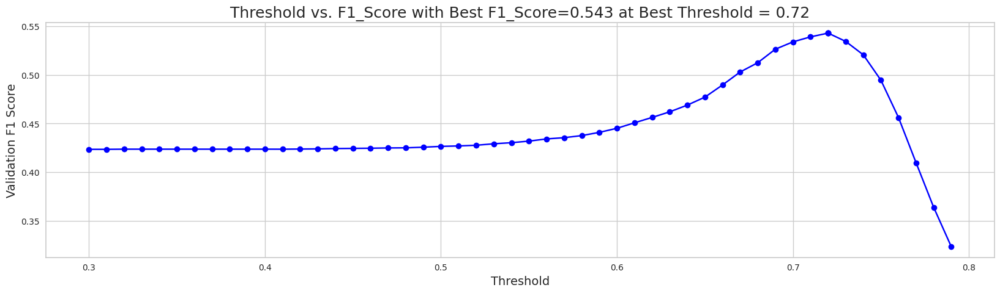

When using optimal threshold = 0.72...
Q0: F1 = 0.5428930528883393
==> Overall F1 = 0.5428930528883393
s
[I 2023-05-23 04:52:57,321] Trial 41 finished with value: 0.5428930528883393 and parameters: {'num_leaves': 99, 'learning_rate': 0.021150948487517654, 'feature_fraction': 0.34194244266478324, 'bagging_fraction': 0.8986213434955881, 'bagging_freq': 3, 'min_child_samples': 18, 'reg_alpha': 0.2310911259996396, 'reg_lambda': 0.10133326518539809, 'subsample': 0.9613895977701359, 'colsample_bytree': 0.2727657169969375, 'min_split_gain': 0.037606121283171604, 'max_depth': -1}. Best is trial 43 with value: 0.5481154150880856.


--------------------------------------------------
question16, with255features
--------------------------------------------------


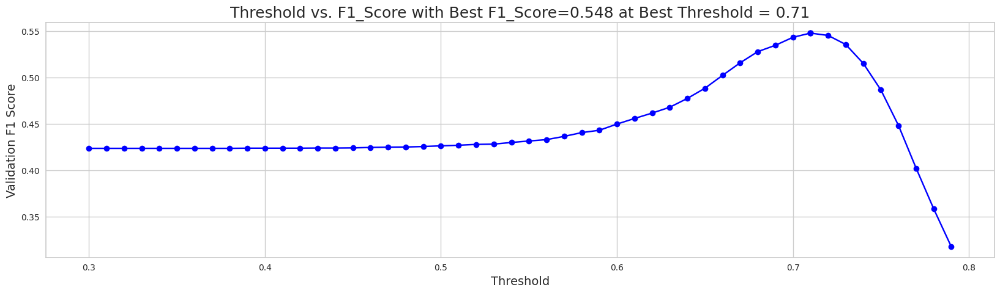

When using optimal threshold = 0.71...
Q0: F1 = 0.5477791805932626
==> Overall F1 = 0.5477791805932626
s
[I 2023-05-23 04:53:00,297] Trial 45 finished with value: 0.5477791805932626 and parameters: {'num_leaves': 80, 'learning_rate': 0.020294833150299417, 'feature_fraction': 0.24214398027228926, 'bagging_fraction': 0.903749302632619, 'bagging_freq': 5, 'min_child_samples': 32, 'reg_alpha': 0.2156168030913851, 'reg_lambda': 0.08034825729776317, 'subsample': 0.999051909009435, 'colsample_bytree': 0.15535496523655945, 'min_split_gain': 0.011361599800921352, 'max_depth': 4}. Best is trial 43 with value: 0.5481154150880856.


--------------------------------------------------
question16, with255features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.8065430885361365, subsample=0.9225660735688136 will be ignored. Current value: bagging_fraction=0.8065430885361365
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
[LightGBM] [Warning] feature_fraction is set=0.26825346200558386, colsample_bytree=0.1527266414818318 will be ignored. Current value: feature_fraction=0.26825346200558386


[LightGBM] [Warning] bagging_fraction is set=0.9560008566139501, subsample=0.9131555859102518 will be ignored. Current value: bagging_fraction=0.9560008566139501
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
[LightGBM] [Warning] feature_fraction is set=0.16007602986768743, colsample_bytree=0.16269592372168887 will be ignored. Current value: feature_fraction=0.16007602986768743


[LightGBM] [Warning] bagging_fraction is set=0.6272803349318229, subsample=0.9042468558912304 will be ignored. Current value: bagging_fraction=0.6272803349318229
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
[LightGBM] [Warning] feature_fraction is set=0.25486799282087635, colsample_bytree=0.17127890647974958 will be ignored. Current value: feature_fraction=0.25486799282087635


[LightGBM] [Warning] bagging_fraction is set=0.9560008566139501, subsample=0.9131555859102518 will be ignored. Current value: bagging_fraction=0.9560008566139501
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
[LightGBM] [Warning] feature_fraction is set=0.16007602986768743, colsample_bytree=0.16269592372168887 will be ignored. Current value: feature_fraction=0.16007602986768743


[LightGBM] [Warning] bagging_fraction is set=0.8872735324402978, subsample=0.8652325814192426 will be ignored. Current value: bagging_fraction=0.8872735324402978
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
[LightGBM] [Warning] feature_fraction is set=0.261364331790525, colsample_bytree=0.149787775224737 will be ignored. Current value: feature_fraction=0.261364331790525


[LightGBM] [Warning] bagging_fraction is set=0.8065430885361365, subsample=0.9225660735688136 will be ignored. Current value: bagging_fraction=0.8065430885361365
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
[LightGBM] [Warning] feature_fraction is set=0.26825346200558386, colsample_bytree=0.1527266414818318 will be ignored. Current value: feature_fraction=0.26825346200558386


[LightGBM] [Warning] bagging_fraction is set=0.9560008566139501, subsample=0.9131555859102518 will be ignored. Current value: bagging_fraction=0.9560008566139501
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
[LightGBM] [Warning] feature_fraction is set=0.16007602986768743, colsample_bytree=0.16269592372168887 will be ignored. Current value: feature_fraction=0.16007602986768743


[LightGBM] [Warning] bagging_fraction is set=0.6272803349318229, subsample=0.9042468558912304 will be ignored. Current value: bagging_fraction=0.6272803349318229
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
[LightGBM] [Warning] feature_fraction is set=0.25486799282087635, colsample_bytree=0.17127890647974958 will be ignored. Current value: feature_fraction=0.25486799282087635


[LightGBM] [Warning] bagging_fraction is set=0.9560008566139501, subsample=0.9131555859102518 will be ignored. Current value: bagging_fraction=0.9560008566139501
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
[LightGBM] [Warning] feature_fraction is set=0.16007602986768743, colsample_bytree=0.16269592372168887 will be ignored. Current value: feature_fraction=0.16007602986768743


[LightGBM] [Warning] bagging_fraction is set=0.8065430885361365, subsample=0.9225660735688136 will be ignored. Current value: bagging_fraction=0.8065430885361365
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
[LightGBM] [Warning] feature_fraction is set=0.26825346200558386, colsample_bytree=0.1527266414818318 will be ignored. Current value: feature_fraction=0.26825346200558386


,mean
feature,
hover_duration_max,113.2
elapsed_time_diff_sum,105.2
19_level_counts,99.8
hover_duration_sum,94.6
room_coor_y_std,88.4
15_level_counts,86.2
screen_coor_x_std,85.2
session_id,78.6
room_coor_x_min,73.6


[[0.40798359 0.59201641]
 [0.25854497 0.74145503]
 [0.26792474 0.73207526]
 ...
 [0.21266388 0.78733612]
 [0.22538218 0.77461782]
 [0.249455   0.750545  ]]


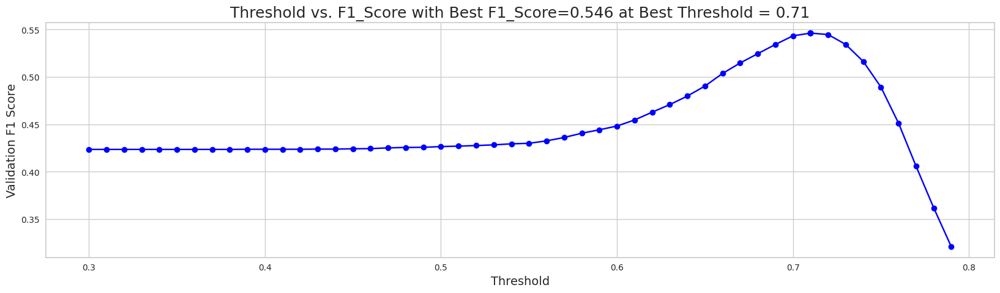

When using optimal threshold = 0.71...
Q0: F1 = 0.5462749059829426
==> Overall F1 = 0.5462749059829426
s
[I 2023-05-23 04:53:32,611] Trial 46 finished with value: 0.5462749059829426 and parameters: {'num_leaves': 81, 'learning_rate': 0.01214425766138456, 'feature_fraction': 0.261364331790525, 'bagging_fraction': 0.8872735324402978, 'bagging_freq': 5, 'min_child_samples': 33, 'reg_alpha': 0.04957168118320332, 'reg_lambda': 0.1058374293231658, 'subsample': 0.8652325814192426, 'colsample_bytree': 0.149787775224737, 'min_split_gain': 0.1318201460031897, 'max_depth': 4}. Best is trial 43 with value: 0.5481154150880856.


,mean
feature,
hover_duration_max,96.4
hover_duration_sum,93.6
elapsed_time_diff_sum,90.6
19_level_counts,83.0
screen_coor_x_std,79.8
15_level_counts,74.4
room_coor_y_std,72.2
hover_duration_std,68.2
session_id,68.0


[[0.39011259 0.60988741]
 [0.25787726 0.74212274]
 [0.25578187 0.74421813]
 ...
 [0.2044522  0.7955478 ]
 [0.22844221 0.77155779]
 [0.22934272 0.77065728]]


[LightGBM] [Warning] bagging_fraction is set=0.9560008566139501, subsample=0.9131555859102518 will be ignored. Current value: bagging_fraction=0.9560008566139501
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
[LightGBM] [Warning] feature_fraction is set=0.16007602986768743, colsample_bytree=0.16269592372168887 will be ignored. Current value: feature_fraction=0.16007602986768743


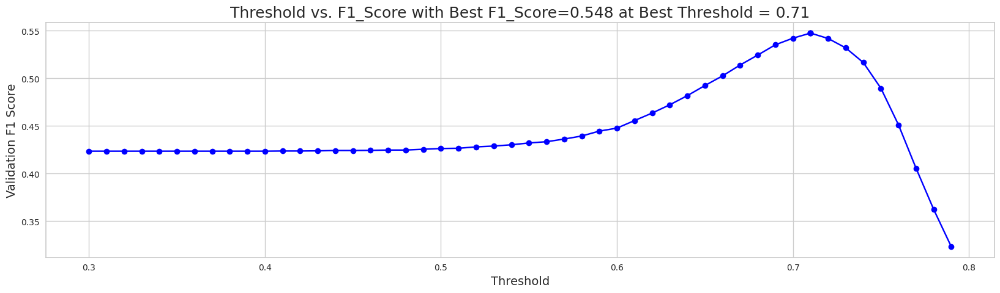

When using optimal threshold = 0.71...
Q0: F1 = 0.5475668637486704
==> Overall F1 = 0.5475668637486704
s
[I 2023-05-23 04:53:40,100] Trial 47 finished with value: 0.5475668637486704 and parameters: {'num_leaves': 78, 'learning_rate': 0.012229489183202744, 'feature_fraction': 0.25486799282087635, 'bagging_fraction': 0.6272803349318229, 'bagging_freq': 5, 'min_child_samples': 33, 'reg_alpha': 0.04694511416793508, 'reg_lambda': 0.11223626444027576, 'subsample': 0.9042468558912304, 'colsample_bytree': 0.17127890647974958, 'min_split_gain': 0.010518970217227844, 'max_depth': 4}. Best is trial 43 with value: 0.5481154150880856.


[LightGBM] [Warning] bagging_fraction is set=0.8065430885361365, subsample=0.9225660735688136 will be ignored. Current value: bagging_fraction=0.8065430885361365
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
[LightGBM] [Warning] feature_fraction is set=0.26825346200558386, colsample_bytree=0.1527266414818318 will be ignored. Current value: feature_fraction=0.26825346200558386


,mean
feature,
hover_duration_max,65.6
elapsed_time_diff_mean,46.2
hover_duration_sum,42.0
screen_coor_y_max,40.4
elapsed_time_diff_sum,38.0
hover_duration_std,38.0
19_level_counts,35.0
room_coor_y_std,34.8
screen_corr_x_dff_sum,34.4


[[0.33842536 0.66157464]
 [0.26100835 0.73899165]
 [0.25565181 0.74434819]
 ...
 [0.20905288 0.79094712]
 [0.22310538 0.77689462]
 [0.26160096 0.73839904]]


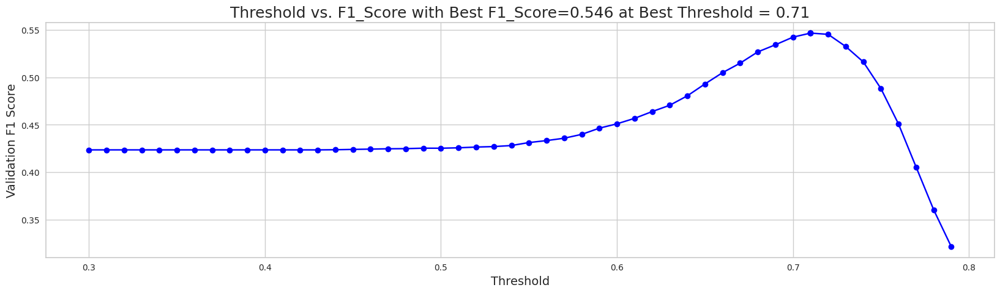

When using optimal threshold = 0.71...
Q0: F1 = 0.5464721361707319
==> Overall F1 = 0.5464721361707319
s
[I 2023-05-23 04:53:47,040] Trial 49 finished with value: 0.5464721361707319 and parameters: {'num_leaves': 77, 'learning_rate': 0.029988524100783252, 'feature_fraction': 0.16007602986768743, 'bagging_fraction': 0.9560008566139501, 'bagging_freq': 5, 'min_child_samples': 32, 'reg_alpha': 0.5525038152807837, 'reg_lambda': 0.15810142778121525, 'subsample': 0.9131555859102518, 'colsample_bytree': 0.16269592372168887, 'min_split_gain': 0.012624228053512907, 'max_depth': 4}. Best is trial 43 with value: 0.5481154150880856.


[LightGBM] [Warning] bagging_fraction is set=0.8065430885361365, subsample=0.9225660735688136 will be ignored. Current value: bagging_fraction=0.8065430885361365
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
[LightGBM] [Warning] feature_fraction is set=0.26825346200558386, colsample_bytree=0.1527266414818318 will be ignored. Current value: feature_fraction=0.26825346200558386


,mean
feature,
hover_duration_max,102.4
19_level_counts,100.4
elapsed_time_diff_sum,98.4
hover_duration_sum,87.8
15_level_counts,80.2
room_coor_y_std,79.0
session_id,78.6
screen_coor_x_std,78.6
hover_duration_mean,64.0


[[0.39837091 0.60162909]
 [0.25770364 0.74229636]
 [0.28130828 0.71869172]
 ...
 [0.21734919 0.78265081]
 [0.217714   0.782286  ]
 [0.25207656 0.74792344]]


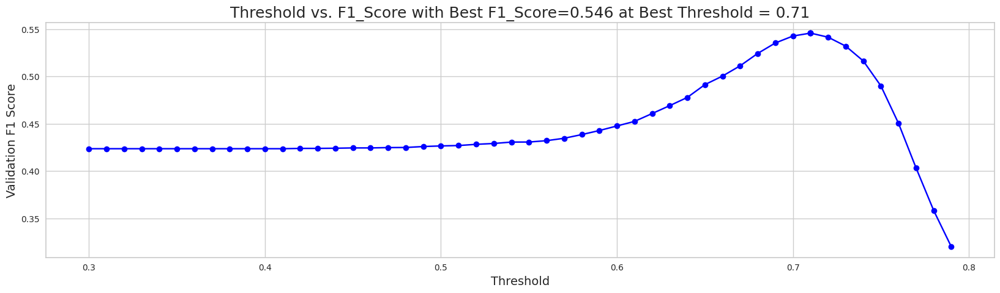

When using optimal threshold = 0.71...
Q0: F1 = 0.5459250128616415
==> Overall F1 = 0.5459250128616415
s
[I 2023-05-23 04:53:59,370] Trial 48 finished with value: 0.5459250128616415 and parameters: {'num_leaves': 78, 'learning_rate': 0.011807865021444031, 'feature_fraction': 0.26825346200558386, 'bagging_fraction': 0.8065430885361365, 'bagging_freq': 5, 'min_child_samples': 33, 'reg_alpha': 0.09728557847983114, 'reg_lambda': 0.1797824545472529, 'subsample': 0.9225660735688136, 'colsample_bytree': 0.1527266414818318, 'min_split_gain': 0.026361528514768317, 'max_depth': 4}. Best is trial 43 with value: 0.5481154150880856.


[I 2023-05-23 04:54:01,315] A new study created in memory with name: no-name-9e4ffdea-dc05-4a06-a3cf-8162fca55b9f


{'num_leaves': 84, 'learning_rate': 0.020534418936306503, 'feature_fraction': 0.2383712823647344, 'bagging_fraction': 0.6817052121197373, 'bagging_freq': 3, 'min_child_samples': 31, 'reg_alpha': 0.2158743016133312, 'reg_lambda': 0.08182224915561978, 'subsample': 0.8672362640866934, 'colsample_bytree': 0.12782415982877102, 'min_split_gain': 0.12819123772424879, 'max_depth': 4}


  0%|          | 0/50 [00:00<?, ?it/s]

--------------------------------------------------
question17, with255features
--------------------------------------------------
--------------------------------------------------
question17, with255features
--------------------------------------------------
--------------------------------------------------
question17, with255features
--------------------------------------------------
--------------------------------------------------
question17, with255features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.547773159960992, subsample=0.9806355516262634 will be ignored. Current value: bagging_fraction=0.547773159960992
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
[LightGBM] [Warning] feature_fraction is set=0.5672998097843216, colsample_bytree=0.7242723303936617 will be ignored. Current value: feature_fraction=0.5672998097843216


[LightGBM] [Warning] bagging_fraction is set=0.8012271881233004, subsample=0.6736115581092389 will be ignored. Current value: bagging_fraction=0.8012271881233004
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=10, subsample_freq=0 will be ignored. Current value: bagging_freq=10
[LightGBM] [Warning] feature_fraction is set=0.9445437871700909, colsample_bytree=0.9556016304517324 will be ignored. Current value: feature_fraction=0.9445437871700909


[LightGBM] [Warning] bagging_fraction is set=0.262280425332033, subsample=0.20790585588678442 will be ignored. Current value: bagging_fraction=0.262280425332033
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=8, subsample_freq=0 will be ignored. Current value: bagging_freq=8
[LightGBM] [Warning] feature_fraction is set=0.27320564635963074, colsample_bytree=0.4998823871328766 will be ignored. Current value: feature_fraction=0.27320564635963074
[LightGBM] [Warning] bagging_fraction is set=0.8838649189458523, subsample=0.8179940798675777 will be ignored. Current value: bagging_fraction=0.8838649189458523
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] f

[LightGBM] [Warning] bagging_fraction is set=0.547773159960992, subsample=0.9806355516262634 will be ignored. Current value: bagging_fraction=0.547773159960992
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
[LightGBM] [Warning] feature_fraction is set=0.5672998097843216, colsample_bytree=0.7242723303936617 will be ignored. Current value: feature_fraction=0.5672998097843216


[LightGBM] [Warning] bagging_fraction is set=0.547773159960992, subsample=0.9806355516262634 will be ignored. Current value: bagging_fraction=0.547773159960992
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
[LightGBM] [Warning] feature_fraction is set=0.5672998097843216, colsample_bytree=0.7242723303936617 will be ignored. Current value: feature_fraction=0.5672998097843216


[LightGBM] [Warning] bagging_fraction is set=0.8012271881233004, subsample=0.6736115581092389 will be ignored. Current value: bagging_fraction=0.8012271881233004
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=10, subsample_freq=0 will be ignored. Current value: bagging_freq=10
[LightGBM] [Warning] feature_fraction is set=0.9445437871700909, colsample_bytree=0.9556016304517324 will be ignored. Current value: feature_fraction=0.9445437871700909


[LightGBM] [Warning] bagging_fraction is set=0.262280425332033, subsample=0.20790585588678442 will be ignored. Current value: bagging_fraction=0.262280425332033
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=8, subsample_freq=0 will be ignored. Current value: bagging_freq=8
[LightGBM] [Warning] feature_fraction is set=0.27320564635963074, colsample_bytree=0.4998823871328766 will be ignored. Current value: feature_fraction=0.27320564635963074


[LightGBM] [Warning] bagging_fraction is set=0.547773159960992, subsample=0.9806355516262634 will be ignored. Current value: bagging_fraction=0.547773159960992
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
[LightGBM] [Warning] feature_fraction is set=0.5672998097843216, colsample_bytree=0.7242723303936617 will be ignored. Current value: feature_fraction=0.5672998097843216


[LightGBM] [Warning] bagging_fraction is set=0.547773159960992, subsample=0.9806355516262634 will be ignored. Current value: bagging_fraction=0.547773159960992
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=6, subsample_freq=0 will be ignored. Current value: bagging_freq=6
[LightGBM] [Warning] feature_fraction is set=0.5672998097843216, colsample_bytree=0.7242723303936617 will be ignored. Current value: feature_fraction=0.5672998097843216


,mean
feature,
elapsed_time_diff_sum,3.8
elapsed_time_diff_std,2.2
hover_duration_sum,2.0
hover_duration_std,1.2
journals_flag.pic_0.next_fqid_counts,1.0
hover_duration_max,0.8
room_coor_x_max,0.8
room_corr_x_diff_sum,0.8
screen_corr_y_dff_sum,0.8


[[0.41345757 0.58654243]
 [0.30382961 0.69617039]
 [0.3821861  0.6178139 ]
 ...
 [0.2461941  0.7538059 ]
 [0.22830204 0.77169796]
 [0.25991758 0.74008242]]
[LightGBM] [Warning] bagging_fraction is set=0.8012271881233004, subsample=0.6736115581092389 will be ignored. Current value: bagging_fraction=0.8012271881233004
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=10, subsample_freq=0 will be ignored. Current value: bagging_freq=10
[LightGBM] [Warning] feature_fraction is set=0.9445437871700909, colsample_bytree=0.9556016304517324 will be ignored. Current value: feature_fraction=0.9445437871700909


[LightGBM] [Warning] bagging_fraction is set=0.8838649189458523, subsample=0.8179940798675777 will be ignored. Current value: bagging_fraction=0.8838649189458523
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8856173584132071, colsample_bytree=0.9840311854631862 will be ignored. Current value: feature_fraction=0.8856173584132071


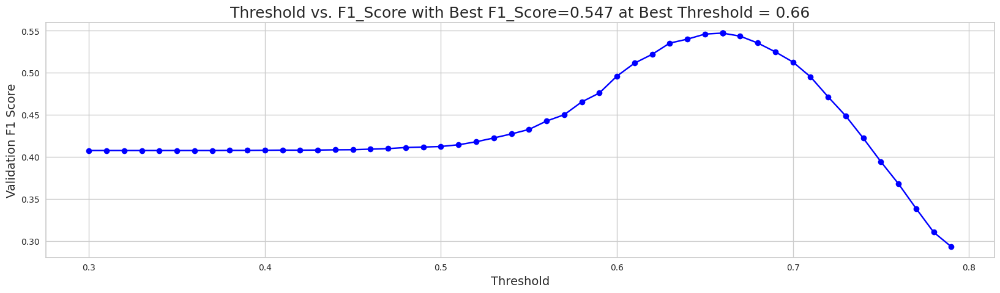

When using optimal threshold = 0.66...
Q0: F1 = 0.5472367723951863
==> Overall F1 = 0.5472367723951863
s
[I 2023-05-23 04:54:22,577] Trial 2 finished with value: 0.5472367723951863 and parameters: {'num_leaves': 37, 'learning_rate': 0.3690091552303059, 'feature_fraction': 0.5672998097843216, 'bagging_fraction': 0.547773159960992, 'bagging_freq': 6, 'min_child_samples': 40, 'reg_alpha': 0.12316484738327954, 'reg_lambda': 1.9977654980569635, 'subsample': 0.9806355516262634, 'colsample_bytree': 0.7242723303936617, 'min_split_gain': 0.28758707946932777, 'max_depth': 2}. Best is trial 2 with value: 0.5472367723951863.


--------------------------------------------------
question17, with255features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.7067376794039129, subsample=0.8609188149902081 will be ignored. Current value: bagging_fraction=0.7067376794039129
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=10, subsample_freq=0 will be ignored. Current value: bagging_freq=10
[LightGBM] [Warning] feature_fraction is set=0.6771914921363075, colsample_bytree=0.262813962244211 will be ignored. Current value: feature_fraction=0.6771914921363075


[LightGBM] [Warning] bagging_fraction is set=0.8012271881233004, subsample=0.6736115581092389 will be ignored. Current value: bagging_fraction=0.8012271881233004
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=10, subsample_freq=0 will be ignored. Current value: bagging_freq=10
[LightGBM] [Warning] feature_fraction is set=0.9445437871700909, colsample_bytree=0.9556016304517324 will be ignored. Current value: feature_fraction=0.9445437871700909


[LightGBM] [Warning] bagging_fraction is set=0.262280425332033, subsample=0.20790585588678442 will be ignored. Current value: bagging_fraction=0.262280425332033
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=8, subsample_freq=0 will be ignored. Current value: bagging_freq=8
[LightGBM] [Warning] feature_fraction is set=0.27320564635963074, colsample_bytree=0.4998823871328766 will be ignored. Current value: feature_fraction=0.27320564635963074


[LightGBM] [Warning] bagging_fraction is set=0.7067376794039129, subsample=0.8609188149902081 will be ignored. Current value: bagging_fraction=0.7067376794039129
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=10, subsample_freq=0 will be ignored. Current value: bagging_freq=10
[LightGBM] [Warning] feature_fraction is set=0.6771914921363075, colsample_bytree=0.262813962244211 will be ignored. Current value: feature_fraction=0.6771914921363075


[LightGBM] [Warning] bagging_fraction is set=0.8012271881233004, subsample=0.6736115581092389 will be ignored. Current value: bagging_fraction=0.8012271881233004
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=10, subsample_freq=0 will be ignored. Current value: bagging_freq=10
[LightGBM] [Warning] feature_fraction is set=0.9445437871700909, colsample_bytree=0.9556016304517324 will be ignored. Current value: feature_fraction=0.9445437871700909


[LightGBM] [Warning] bagging_fraction is set=0.7067376794039129, subsample=0.8609188149902081 will be ignored. Current value: bagging_fraction=0.7067376794039129
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=10, subsample_freq=0 will be ignored. Current value: bagging_freq=10
[LightGBM] [Warning] feature_fraction is set=0.6771914921363075, colsample_bytree=0.262813962244211 will be ignored. Current value: feature_fraction=0.6771914921363075


[LightGBM] [Warning] bagging_fraction is set=0.8838649189458523, subsample=0.8179940798675777 will be ignored. Current value: bagging_fraction=0.8838649189458523
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8856173584132071, colsample_bytree=0.9840311854631862 will be ignored. Current value: feature_fraction=0.8856173584132071


,mean
feature,
elapsed_time_diff_sum,14.8
hover_duration_sum,11.6
tunic.wildlife.center_room_fqid_counts,6.4
room_coor_x_min,5.4
22_level_counts,5.2
expert_fqid_counts,5.0
room_coor_y_std,5.0
tunic.library.frontdesk_room_fqid_counts,4.8
room_coor_x_std,4.8


[[0.354819   0.645181  ]
 [0.30261487 0.69738513]
 [0.31403088 0.68596912]
 ...
 [0.23112373 0.76887627]
 [0.21052721 0.78947279]
 [0.27083848 0.72916152]]


[LightGBM] [Warning] bagging_fraction is set=0.7067376794039129, subsample=0.8609188149902081 will be ignored. Current value: bagging_fraction=0.7067376794039129
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=10, subsample_freq=0 will be ignored. Current value: bagging_freq=10
[LightGBM] [Warning] feature_fraction is set=0.6771914921363075, colsample_bytree=0.262813962244211 will be ignored. Current value: feature_fraction=0.6771914921363075


[LightGBM] [Warning] bagging_fraction is set=0.262280425332033, subsample=0.20790585588678442 will be ignored. Current value: bagging_fraction=0.262280425332033
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=8, subsample_freq=0 will be ignored. Current value: bagging_freq=8
[LightGBM] [Warning] feature_fraction is set=0.27320564635963074, colsample_bytree=0.4998823871328766 will be ignored. Current value: feature_fraction=0.27320564635963074


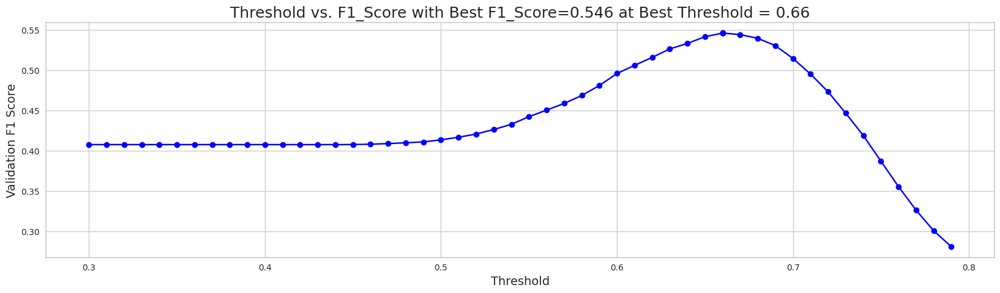

When using optimal threshold = 0.66...
Q0: F1 = 0.5462197722128121
==> Overall F1 = 0.5462197722128121
s
[I 2023-05-23 04:54:52,383] Trial 0 finished with value: 0.5462197722128121 and parameters: {'num_leaves': 31, 'learning_rate': 0.1784222579183608, 'feature_fraction': 0.9445437871700909, 'bagging_fraction': 0.8012271881233004, 'bagging_freq': 10, 'min_child_samples': 27, 'reg_alpha': 5.593719848172323, 'reg_lambda': 1.8350722749840902, 'subsample': 0.6736115581092389, 'colsample_bytree': 0.9556016304517324, 'min_split_gain': 0.005221306130332204, 'max_depth': 9}. Best is trial 2 with value: 0.5472367723951863.


--------------------------------------------------
question17, with255features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.2509497048502055, subsample=0.6293900800286543 will be ignored. Current value: bagging_fraction=0.2509497048502055
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=7, subsample_freq=0 will be ignored. Current value: bagging_freq=7
[LightGBM] [Warning] feature_fraction is set=0.9916806725816577, colsample_bytree=0.1650170019326651 will be ignored. Current value: feature_fraction=0.9916806725816577


[LightGBM] [Warning] bagging_fraction is set=0.2509497048502055, subsample=0.6293900800286543 will be ignored. Current value: bagging_fraction=0.2509497048502055
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=7, subsample_freq=0 will be ignored. Current value: bagging_freq=7
[LightGBM] [Warning] feature_fraction is set=0.9916806725816577, colsample_bytree=0.1650170019326651 will be ignored. Current value: feature_fraction=0.9916806725816577
[LightGBM] [Warning] bagging_fraction is set=0.7067376794039129, subsample=0.8609188149902081 will be ignored. Current value: bagging_fraction=0.7067376794039129
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=10, subsample_freq=0 will be ignored. Current value: bagging_freq=10
[LightGBM] [Warning] 

[LightGBM] [Warning] bagging_fraction is set=0.262280425332033, subsample=0.20790585588678442 will be ignored. Current value: bagging_fraction=0.262280425332033
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=8, subsample_freq=0 will be ignored. Current value: bagging_freq=8
[LightGBM] [Warning] feature_fraction is set=0.27320564635963074, colsample_bytree=0.4998823871328766 will be ignored. Current value: feature_fraction=0.27320564635963074


[LightGBM] [Warning] bagging_fraction is set=0.8838649189458523, subsample=0.8179940798675777 will be ignored. Current value: bagging_fraction=0.8838649189458523
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8856173584132071, colsample_bytree=0.9840311854631862 will be ignored. Current value: feature_fraction=0.8856173584132071


[LightGBM] [Warning] bagging_fraction is set=0.2509497048502055, subsample=0.6293900800286543 will be ignored. Current value: bagging_fraction=0.2509497048502055
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=7, subsample_freq=0 will be ignored. Current value: bagging_freq=7
[LightGBM] [Warning] feature_fraction is set=0.9916806725816577, colsample_bytree=0.1650170019326651 will be ignored. Current value: feature_fraction=0.9916806725816577


,mean
feature,
elapsed_time_diff_sum,17.2
hover_duration_sum,15.2
elapsed_time_diff_mean,13.0
room_coor_x_max,11.6
22_level_counts,11.4
hover_duration_max,10.8
tracks_fqid_counts,10.6
hover_duration_std,10.2
elapsed_time_diff_std,10.0


[[0.33796238 0.66203762]
 [0.37232565 0.62767435]
 [0.33928228 0.66071772]
 ...
 [0.27813186 0.72186814]
 [0.16885663 0.83114337]
 [0.30141054 0.69858946]]


[LightGBM] [Warning] bagging_fraction is set=0.2509497048502055, subsample=0.6293900800286543 will be ignored. Current value: bagging_fraction=0.2509497048502055
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=7, subsample_freq=0 will be ignored. Current value: bagging_freq=7
[LightGBM] [Warning] feature_fraction is set=0.9916806725816577, colsample_bytree=0.1650170019326651 will be ignored. Current value: feature_fraction=0.9916806725816577


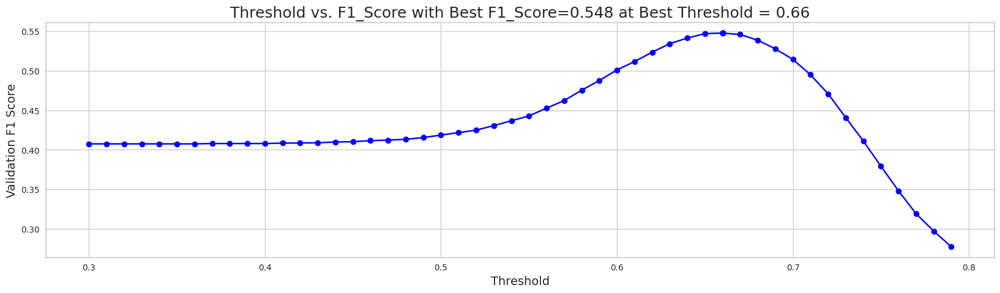

When using optimal threshold = 0.66...
Q0: F1 = 0.5475233828958141
==> Overall F1 = 0.5475233828958141
s
[I 2023-05-23 04:55:12,668] Trial 4 finished with value: 0.5475233828958141 and parameters: {'num_leaves': 52, 'learning_rate': 0.12629179690155898, 'feature_fraction': 0.6771914921363075, 'bagging_fraction': 0.7067376794039129, 'bagging_freq': 10, 'min_child_samples': 68, 'reg_alpha': 1.564716881523065, 'reg_lambda': 0.021084825314421126, 'subsample': 0.8609188149902081, 'colsample_bytree': 0.262813962244211, 'min_split_gain': 0.38410357755908014, 'max_depth': 10}. Best is trial 4 with value: 0.5475233828958141.


--------------------------------------------------
question17, with255features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.4707943074640152, subsample=0.62495087395234 will be ignored. Current value: bagging_fraction=0.4707943074640152
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.801505131026125, colsample_bytree=0.9003802624552044 will be ignored. Current value: feature_fraction=0.801505131026125


,mean
feature,
elapsed_time_diff_sum,106.2
hover_duration_sum,93.8
elapsed_time_diff_mean,66.6
hover_duration_mean,62.4
hover_duration_std,62.2
hover_duration_max,60.0
elapsed_time_diff_std,54.0
screen_coor_x_std,53.2
room_coor_x_min,52.8


[[0.42552166 0.57447834]
 [0.37569789 0.62430211]
 [0.37173548 0.62826452]
 ...
 [0.20677124 0.79322876]
 [0.19434647 0.80565353]
 [0.26703452 0.73296548]]


[LightGBM] [Warning] bagging_fraction is set=0.2509497048502055, subsample=0.6293900800286543 will be ignored. Current value: bagging_fraction=0.2509497048502055
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=7, subsample_freq=0 will be ignored. Current value: bagging_freq=7
[LightGBM] [Warning] feature_fraction is set=0.9916806725816577, colsample_bytree=0.1650170019326651 will be ignored. Current value: feature_fraction=0.9916806725816577


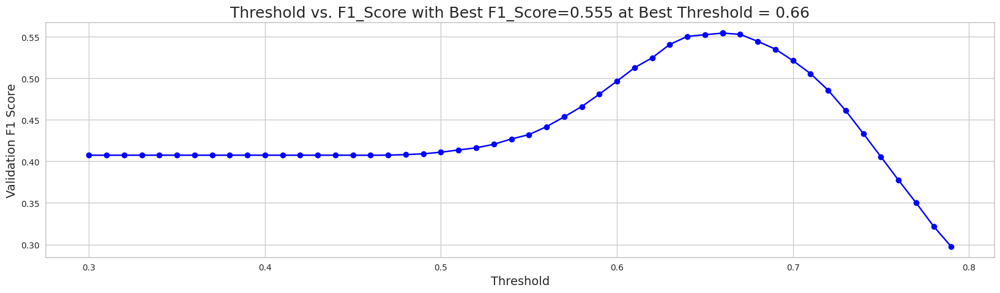

When using optimal threshold = 0.66...
Q0: F1 = 0.5545500179593409
==> Overall F1 = 0.5545500179593409
s
[I 2023-05-23 04:55:20,939] Trial 1 finished with value: 0.5545500179593409 and parameters: {'num_leaves': 16, 'learning_rate': 0.010051749313912601, 'feature_fraction': 0.27320564635963074, 'bagging_fraction': 0.262280425332033, 'bagging_freq': 8, 'min_child_samples': 11, 'reg_alpha': 2.9971877451748767, 'reg_lambda': 0.21946006429501436, 'subsample': 0.20790585588678442, 'colsample_bytree': 0.4998823871328766, 'min_split_gain': 0.020475943059083707, 'max_depth': 3}. Best is trial 1 with value: 0.5545500179593409.


--------------------------------------------------
question17, with255features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.8838649189458523, subsample=0.8179940798675777 will be ignored. Current value: bagging_fraction=0.8838649189458523
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8856173584132071, colsample_bytree=0.9840311854631862 will be ignored. Current value: feature_fraction=0.8856173584132071
[LightGBM] [Warning] bagging_fraction is set=0.294370530723593, subsample=0.3261976104607854 will be ignored. Current value: bagging_fraction=0.294370530723593
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=8, subsample_freq=0 will be ignored. Current value: bagging_freq=8
[LightGBM] [Warning] feat

,mean
feature,
screen_coor_x_std,2.8
elapsed_time_diff_sum,2.8
room_coor_x_max,2.2
room_coor_x_min,2.0
hover_duration_sum,1.8
room_coor_y_max,1.6
21_level_counts,1.6
elapsed_time_diff_std,1.6
room_coor_x_std,1.4


[[0.32419179 0.67580821]
 [0.34824908 0.65175092]
 [0.30861054 0.69138946]
 ...
 [0.27013956 0.72986044]
 [0.26684974 0.73315026]
 [0.27013956 0.72986044]]


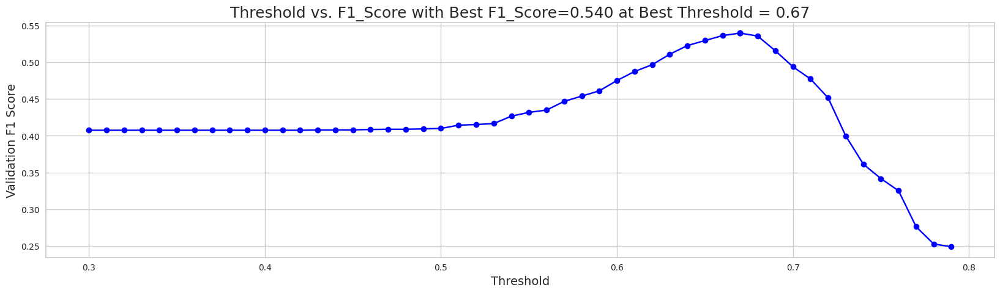

When using optimal threshold = 0.67...
Q0: F1 = 0.5395241270154032
==> Overall F1 = 0.5395241270154032
s
[I 2023-05-23 04:55:28,557] Trial 5 finished with value: 0.5395241270154032 and parameters: {'num_leaves': 88, 'learning_rate': 0.3350950541656272, 'feature_fraction': 0.9916806725816577, 'bagging_fraction': 0.2509497048502055, 'bagging_freq': 7, 'min_child_samples': 95, 'reg_alpha': 7.950538360889896, 'reg_lambda': 1.7121184120482493, 'subsample': 0.6293900800286543, 'colsample_bytree': 0.1650170019326651, 'min_split_gain': 0.010383378522916945, 'max_depth': -1}. Best is trial 1 with value: 0.5545500179593409.


--------------------------------------------------
question17, with255features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.7971000967611582, subsample=0.951934643149084 will be ignored. Current value: bagging_fraction=0.7971000967611582
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=8, subsample_freq=0 will be ignored. Current value: bagging_freq=8
[LightGBM] [Warning] feature_fraction is set=0.5773858769717911, colsample_bytree=0.6965232953337496 will be ignored. Current value: feature_fraction=0.5773858769717911


[LightGBM] [Warning] bagging_fraction is set=0.294370530723593, subsample=0.3261976104607854 will be ignored. Current value: bagging_fraction=0.294370530723593
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=8, subsample_freq=0 will be ignored. Current value: bagging_freq=8
[LightGBM] [Warning] feature_fraction is set=0.11108043489494002, colsample_bytree=0.3599880117452463 will be ignored. Current value: feature_fraction=0.11108043489494002


[LightGBM] [Warning] bagging_fraction is set=0.4707943074640152, subsample=0.62495087395234 will be ignored. Current value: bagging_fraction=0.4707943074640152
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.801505131026125, colsample_bytree=0.9003802624552044 will be ignored. Current value: feature_fraction=0.801505131026125


[LightGBM] [Warning] bagging_fraction is set=0.294370530723593, subsample=0.3261976104607854 will be ignored. Current value: bagging_fraction=0.294370530723593
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=8, subsample_freq=0 will be ignored. Current value: bagging_freq=8
[LightGBM] [Warning] feature_fraction is set=0.11108043489494002, colsample_bytree=0.3599880117452463 will be ignored. Current value: feature_fraction=0.11108043489494002


[LightGBM] [Warning] bagging_fraction is set=0.7971000967611582, subsample=0.951934643149084 will be ignored. Current value: bagging_fraction=0.7971000967611582
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=8, subsample_freq=0 will be ignored. Current value: bagging_freq=8
[LightGBM] [Warning] feature_fraction is set=0.5773858769717911, colsample_bytree=0.6965232953337496 will be ignored. Current value: feature_fraction=0.5773858769717911


,mean
feature,
elapsed_time_diff_sum,149.2
hover_duration_sum,116.8
journals_flag.pic_0.next_fqid_counts,61.6
notification_click_event_name_counts,53.0
hover_duration_std,43.4
groupconvo_flag_fqid_counts,40.4
elapsed_time_diff_mean,37.4
screen_coor_x_std,35.0
tracks_fqid_counts,34.2


[[0.43669129 0.56330871]
 [0.35149267 0.64850733]
 [0.38303956 0.61696044]
 ...
 [0.21034304 0.78965696]
 [0.19877279 0.80122721]
 [0.26540749 0.73459251]]


[LightGBM] [Warning] bagging_fraction is set=0.294370530723593, subsample=0.3261976104607854 will be ignored. Current value: bagging_fraction=0.294370530723593
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=8, subsample_freq=0 will be ignored. Current value: bagging_freq=8
[LightGBM] [Warning] feature_fraction is set=0.11108043489494002, colsample_bytree=0.3599880117452463 will be ignored. Current value: feature_fraction=0.11108043489494002


[LightGBM] [Warning] bagging_fraction is set=0.4707943074640152, subsample=0.62495087395234 will be ignored. Current value: bagging_fraction=0.4707943074640152
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.801505131026125, colsample_bytree=0.9003802624552044 will be ignored. Current value: feature_fraction=0.801505131026125


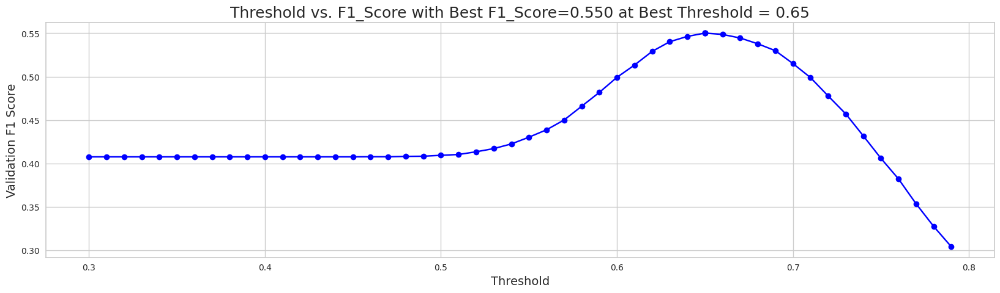

When using optimal threshold = 0.65...
Q0: F1 = 0.5501819536225055
==> Overall F1 = 0.5501819536225055
s
[I 2023-05-23 04:55:50,008] Trial 3 finished with value: 0.5501819536225055 and parameters: {'num_leaves': 59, 'learning_rate': 0.014085767347633444, 'feature_fraction': 0.8856173584132071, 'bagging_fraction': 0.8838649189458523, 'bagging_freq': 2, 'min_child_samples': 45, 'reg_alpha': 8.449131317116967, 'reg_lambda': 0.009182855291288448, 'subsample': 0.8179940798675777, 'colsample_bytree': 0.9840311854631862, 'min_split_gain': 0.3882018793210898, 'max_depth': 2}. Best is trial 1 with value: 0.5545500179593409.


--------------------------------------------------
question17, with255features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.4705873411511473, subsample=0.13972739500242326 will be ignored. Current value: bagging_fraction=0.4705873411511473
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7027907079600321, colsample_bytree=0.35751228570106985 will be ignored. Current value: feature_fraction=0.7027907079600321


[LightGBM] [Warning] bagging_fraction is set=0.294370530723593, subsample=0.3261976104607854 will be ignored. Current value: bagging_fraction=0.294370530723593
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=8, subsample_freq=0 will be ignored. Current value: bagging_freq=8
[LightGBM] [Warning] feature_fraction is set=0.11108043489494002, colsample_bytree=0.3599880117452463 will be ignored. Current value: feature_fraction=0.11108043489494002


[LightGBM] [Warning] bagging_fraction is set=0.7971000967611582, subsample=0.951934643149084 will be ignored. Current value: bagging_fraction=0.7971000967611582
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=8, subsample_freq=0 will be ignored. Current value: bagging_freq=8
[LightGBM] [Warning] feature_fraction is set=0.5773858769717911, colsample_bytree=0.6965232953337496 will be ignored. Current value: feature_fraction=0.5773858769717911


,mean
feature,
elapsed_time_diff_mean,39.4
hover_duration_sum,25.0
hover_duration_std,18.6
hover_duration_max,17.8
elapsed_time_diff_sum,17.0
screen_corr_x_dff_sum,12.6
expert_fqid_counts,11.2
room_corr_x_diff_sum,10.8
19_level_counts,10.2


[[0.44395479 0.55604521]
 [0.36695036 0.63304964]
 [0.37365828 0.62634172]
 ...
 [0.21350641 0.78649359]
 [0.20642665 0.79357335]
 [0.26117136 0.73882864]]


[LightGBM] [Warning] bagging_fraction is set=0.4707943074640152, subsample=0.62495087395234 will be ignored. Current value: bagging_fraction=0.4707943074640152
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.801505131026125, colsample_bytree=0.9003802624552044 will be ignored. Current value: feature_fraction=0.801505131026125


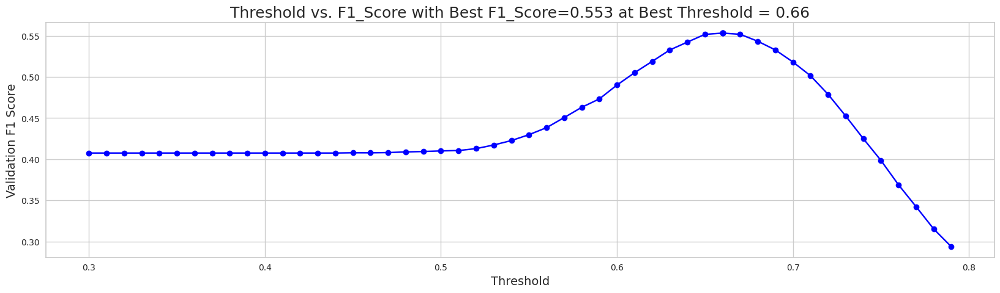

When using optimal threshold = 0.66...
Q0: F1 = 0.5533202428912358
==> Overall F1 = 0.5533202428912358
s
[I 2023-05-23 04:56:07,073] Trial 7 finished with value: 0.5533202428912358 and parameters: {'num_leaves': 13, 'learning_rate': 0.022585661172822662, 'feature_fraction': 0.11108043489494002, 'bagging_fraction': 0.294370530723593, 'bagging_freq': 8, 'min_child_samples': 77, 'reg_alpha': 1.1841090835558512, 'reg_lambda': 0.03043250660193875, 'subsample': 0.3261976104607854, 'colsample_bytree': 0.3599880117452463, 'min_split_gain': 0.03596792014210046, 'max_depth': 1}. Best is trial 1 with value: 0.5545500179593409.


--------------------------------------------------
question17, with255features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.657563621621291, subsample=0.3606518015759562 will be ignored. Current value: bagging_fraction=0.657563621621291
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
[LightGBM] [Warning] feature_fraction is set=0.35733381955447563, colsample_bytree=0.5855538842190068 will be ignored. Current value: feature_fraction=0.35733381955447563


[LightGBM] [Warning] bagging_fraction is set=0.7971000967611582, subsample=0.951934643149084 will be ignored. Current value: bagging_fraction=0.7971000967611582
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=8, subsample_freq=0 will be ignored. Current value: bagging_freq=8
[LightGBM] [Warning] feature_fraction is set=0.5773858769717911, colsample_bytree=0.6965232953337496 will be ignored. Current value: feature_fraction=0.5773858769717911


[LightGBM] [Warning] bagging_fraction is set=0.4707943074640152, subsample=0.62495087395234 will be ignored. Current value: bagging_fraction=0.4707943074640152
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.801505131026125, colsample_bytree=0.9003802624552044 will be ignored. Current value: feature_fraction=0.801505131026125


[LightGBM] [Warning] bagging_fraction is set=0.7971000967611582, subsample=0.951934643149084 will be ignored. Current value: bagging_fraction=0.7971000967611582
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=8, subsample_freq=0 will be ignored. Current value: bagging_freq=8
[LightGBM] [Warning] feature_fraction is set=0.5773858769717911, colsample_bytree=0.6965232953337496 will be ignored. Current value: feature_fraction=0.5773858769717911


[LightGBM] [Warning] bagging_fraction is set=0.657563621621291, subsample=0.3606518015759562 will be ignored. Current value: bagging_fraction=0.657563621621291
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
[LightGBM] [Warning] feature_fraction is set=0.35733381955447563, colsample_bytree=0.5855538842190068 will be ignored. Current value: feature_fraction=0.35733381955447563


[LightGBM] [Warning] bagging_fraction is set=0.4705873411511473, subsample=0.13972739500242326 will be ignored. Current value: bagging_fraction=0.4705873411511473
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7027907079600321, colsample_bytree=0.35751228570106985 will be ignored. Current value: feature_fraction=0.7027907079600321


,mean
feature,
elapsed_time_diff_sum,192.4
hover_duration_sum,186.0
session_id,134.6
elapsed_time_diff_std,124.4
hover_duration_max,123.2
screen_coor_x_std,120.6
room_coor_x_max,116.8
room_coor_y_max,116.8
room_coor_x_min,115.8


[[0.37599744 0.62400256]
 [0.40324281 0.59675719]
 [0.33774174 0.66225826]
 ...
 [0.24125006 0.75874994]
 [0.20166026 0.79833974]
 [0.27217092 0.72782908]]


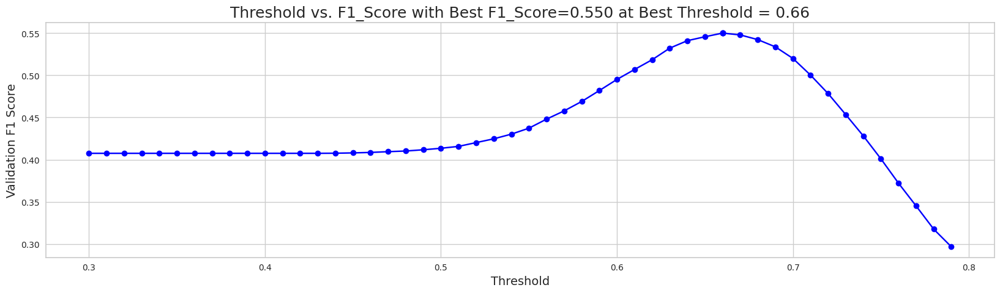

When using optimal threshold = 0.66...
Q0: F1 = 0.5501264222734802
==> Overall F1 = 0.5501264222734802
s
[I 2023-05-23 04:56:36,297] Trial 6 finished with value: 0.5501264222734802 and parameters: {'num_leaves': 84, 'learning_rate': 0.012381903402867163, 'feature_fraction': 0.801505131026125, 'bagging_fraction': 0.4707943074640152, 'bagging_freq': 1, 'min_child_samples': 78, 'reg_alpha': 0.11851555879774388, 'reg_lambda': 0.02636873164052468, 'subsample': 0.62495087395234, 'colsample_bytree': 0.9003802624552044, 'min_split_gain': 0.8474631060086282, 'max_depth': 7}. Best is trial 1 with value: 0.5545500179593409.


--------------------------------------------------
question17, with255features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.25019957818047045, subsample=0.5782974599347968 will be ignored. Current value: bagging_fraction=0.25019957818047045
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=7, subsample_freq=0 will be ignored. Current value: bagging_freq=7
[LightGBM] [Warning] feature_fraction is set=0.22940392158549625, colsample_bytree=0.854533637098969 will be ignored. Current value: feature_fraction=0.22940392158549625


,mean
feature,
elapsed_time_diff_sum,79.4
hover_duration_sum,77.6
elapsed_time_diff_std,52.0
room_coor_x_max,51.8
room_coor_x_min,48.8
hover_duration_mean,47.2
session_id,46.8
screen_coor_x_std,46.6
hover_duration_max,46.2


[[0.38814772 0.61185228]
 [0.3585223  0.6414777 ]
 [0.35666188 0.64333812]
 ...
 [0.20283811 0.79716189]
 [0.16439242 0.83560758]
 [0.2316031  0.7683969 ]]


[LightGBM] [Warning] bagging_fraction is set=0.25019957818047045, subsample=0.5782974599347968 will be ignored. Current value: bagging_fraction=0.25019957818047045
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=7, subsample_freq=0 will be ignored. Current value: bagging_freq=7
[LightGBM] [Warning] feature_fraction is set=0.22940392158549625, colsample_bytree=0.854533637098969 will be ignored. Current value: feature_fraction=0.22940392158549625


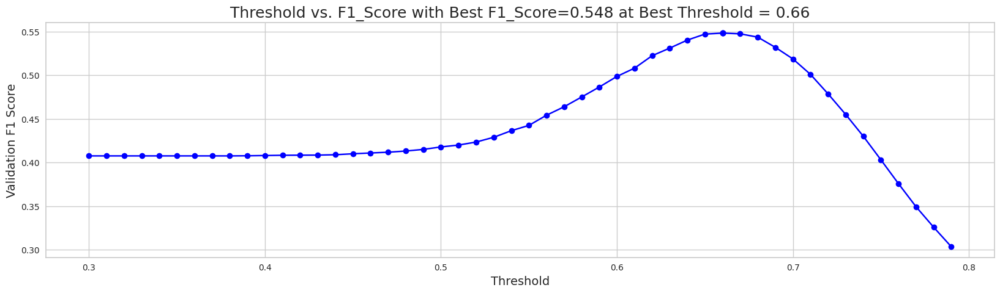

When using optimal threshold = 0.66...
Q0: F1 = 0.5480990663507161
==> Overall F1 = 0.5480990663507161
s
[I 2023-05-23 04:56:44,777] Trial 8 finished with value: 0.5480990663507161 and parameters: {'num_leaves': 45, 'learning_rate': 0.03927042182221729, 'feature_fraction': 0.5773858769717911, 'bagging_fraction': 0.7971000967611582, 'bagging_freq': 8, 'min_child_samples': 98, 'reg_alpha': 2.2699376579422785, 'reg_lambda': 0.05615787113867125, 'subsample': 0.951934643149084, 'colsample_bytree': 0.6965232953337496, 'min_split_gain': 0.009399671757076171, 'max_depth': 7}. Best is trial 1 with value: 0.5545500179593409.


--------------------------------------------------
question17, with255features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.4056038184272943, subsample=0.5371998017078986 will be ignored. Current value: bagging_fraction=0.4056038184272943
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=10, subsample_freq=0 will be ignored. Current value: bagging_freq=10
[LightGBM] [Warning] feature_fraction is set=0.11160193587015055, colsample_bytree=0.3159472142575181 will be ignored. Current value: feature_fraction=0.11160193587015055


[LightGBM] [Warning] bagging_fraction is set=0.25019957818047045, subsample=0.5782974599347968 will be ignored. Current value: bagging_fraction=0.25019957818047045
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=7, subsample_freq=0 will be ignored. Current value: bagging_freq=7
[LightGBM] [Warning] feature_fraction is set=0.22940392158549625, colsample_bytree=0.854533637098969 will be ignored. Current value: feature_fraction=0.22940392158549625


[LightGBM] [Warning] bagging_fraction is set=0.25019957818047045, subsample=0.5782974599347968 will be ignored. Current value: bagging_fraction=0.25019957818047045
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=7, subsample_freq=0 will be ignored. Current value: bagging_freq=7
[LightGBM] [Warning] feature_fraction is set=0.22940392158549625, colsample_bytree=0.854533637098969 will be ignored. Current value: feature_fraction=0.22940392158549625


[LightGBM] [Warning] bagging_fraction is set=0.657563621621291, subsample=0.3606518015759562 will be ignored. Current value: bagging_fraction=0.657563621621291
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
[LightGBM] [Warning] feature_fraction is set=0.35733381955447563, colsample_bytree=0.5855538842190068 will be ignored. Current value: feature_fraction=0.35733381955447563


[LightGBM] [Warning] bagging_fraction is set=0.25019957818047045, subsample=0.5782974599347968 will be ignored. Current value: bagging_fraction=0.25019957818047045
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=7, subsample_freq=0 will be ignored. Current value: bagging_freq=7
[LightGBM] [Warning] feature_fraction is set=0.22940392158549625, colsample_bytree=0.854533637098969 will be ignored. Current value: feature_fraction=0.22940392158549625


[LightGBM] [Warning] bagging_fraction is set=0.4056038184272943, subsample=0.5371998017078986 will be ignored. Current value: bagging_fraction=0.4056038184272943
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=10, subsample_freq=0 will be ignored. Current value: bagging_freq=10
[LightGBM] [Warning] feature_fraction is set=0.11160193587015055, colsample_bytree=0.3159472142575181 will be ignored. Current value: feature_fraction=0.11160193587015055


,mean
feature,
elapsed_time_diff_sum,11.8
elapsed_time_diff_mean,7.6
screen_coor_x_std,6.8
hover_duration_std,6.2
hover_duration_sum,6.0
room_coor_x_min,5.8
19_level_counts,5.8
hover_duration_max,5.2
object_click_event_name_counts,5.2


[[0.33270281 0.66729719]
 [0.3574185  0.6425815 ]
 [0.33716792 0.66283208]
 ...
 [0.22465508 0.77534492]
 [0.21035984 0.78964016]
 [0.27064212 0.72935788]]


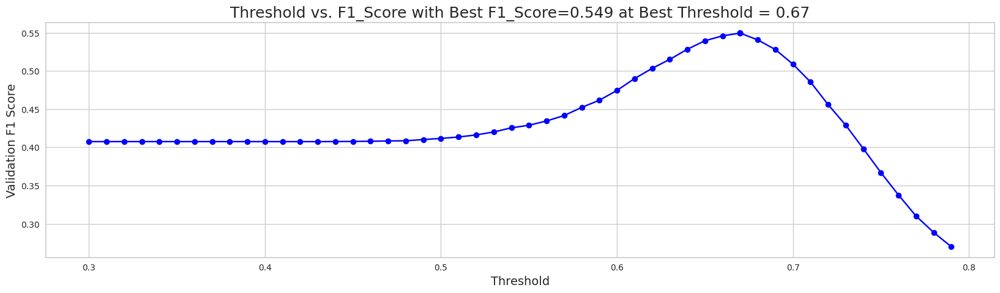

When using optimal threshold = 0.67...
Q0: F1 = 0.5494921526390113
==> Overall F1 = 0.5494921526390113
s
[I 2023-05-23 04:57:00,461] Trial 11 finished with value: 0.5494921526390113 and parameters: {'num_leaves': 70, 'learning_rate': 0.07362253521230584, 'feature_fraction': 0.22940392158549625, 'bagging_fraction': 0.25019957818047045, 'bagging_freq': 7, 'min_child_samples': 46, 'reg_alpha': 0.06557242830287231, 'reg_lambda': 0.01333847208106798, 'subsample': 0.5782974599347968, 'colsample_bytree': 0.854533637098969, 'min_split_gain': 0.020527272808730176, 'max_depth': 4}. Best is trial 1 with value: 0.5545500179593409.


--------------------------------------------------
question17, with255features
--------------------------------------------------
[LightGBM] [Warning] bagging_fraction is set=0.4056038184272943, subsample=0.5371998017078986 will be ignored. Current value: bagging_fraction=0.4056038184272943
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=10, subsample_freq=0 will be ignored. Current value: bagging_freq=10
[LightGBM] [Warning] feature_fraction is set=0.11160193587015055, colsample_bytree=0.3159472142575181 will be ignored. Current value: feature_fraction=0.11160193587015055


[LightGBM] [Warning] bagging_fraction is set=0.14930772463471448, subsample=0.1311796947896881 will be ignored. Current value: bagging_fraction=0.14930772463471448
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
[LightGBM] [Warning] feature_fraction is set=0.3395189422832678, colsample_bytree=0.48179798778349064 will be ignored. Current value: feature_fraction=0.3395189422832678


[LightGBM] [Warning] bagging_fraction is set=0.14930772463471448, subsample=0.1311796947896881 will be ignored. Current value: bagging_fraction=0.14930772463471448
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
[LightGBM] [Warning] feature_fraction is set=0.3395189422832678, colsample_bytree=0.48179798778349064 will be ignored. Current value: feature_fraction=0.3395189422832678
[LightGBM] [Warning] bagging_fraction is set=0.4705873411511473, subsample=0.13972739500242326 will be ignored. Current value: bagging_fraction=0.4705873411511473
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning

[LightGBM] [Warning] bagging_fraction is set=0.4056038184272943, subsample=0.5371998017078986 will be ignored. Current value: bagging_fraction=0.4056038184272943
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=10, subsample_freq=0 will be ignored. Current value: bagging_freq=10
[LightGBM] [Warning] feature_fraction is set=0.11160193587015055, colsample_bytree=0.3159472142575181 will be ignored. Current value: feature_fraction=0.11160193587015055


[LightGBM] [Warning] bagging_fraction is set=0.14930772463471448, subsample=0.1311796947896881 will be ignored. Current value: bagging_fraction=0.14930772463471448
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
[LightGBM] [Warning] feature_fraction is set=0.3395189422832678, colsample_bytree=0.48179798778349064 will be ignored. Current value: feature_fraction=0.3395189422832678


[LightGBM] [Warning] bagging_fraction is set=0.14930772463471448, subsample=0.1311796947896881 will be ignored. Current value: bagging_fraction=0.14930772463471448
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
[LightGBM] [Warning] feature_fraction is set=0.3395189422832678, colsample_bytree=0.48179798778349064 will be ignored. Current value: feature_fraction=0.3395189422832678


[LightGBM] [Warning] bagging_fraction is set=0.4056038184272943, subsample=0.5371998017078986 will be ignored. Current value: bagging_fraction=0.4056038184272943
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=10, subsample_freq=0 will be ignored. Current value: bagging_freq=10
[LightGBM] [Warning] feature_fraction is set=0.11160193587015055, colsample_bytree=0.3159472142575181 will be ignored. Current value: feature_fraction=0.11160193587015055


[LightGBM] [Warning] bagging_fraction is set=0.657563621621291, subsample=0.3606518015759562 will be ignored. Current value: bagging_fraction=0.657563621621291
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
[LightGBM] [Warning] feature_fraction is set=0.35733381955447563, colsample_bytree=0.5855538842190068 will be ignored. Current value: feature_fraction=0.35733381955447563


[LightGBM] [Warning] bagging_fraction is set=0.14930772463471448, subsample=0.1311796947896881 will be ignored. Current value: bagging_fraction=0.14930772463471448
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
[LightGBM] [Warning] feature_fraction is set=0.3395189422832678, colsample_bytree=0.48179798778349064 will be ignored. Current value: feature_fraction=0.3395189422832678


,mean
feature,
elapsed_time_diff_mean,59.8
hover_duration_std,49.8
room_corr_x_diff_std,41.4
room_coor_x_std,40.0
hover_duration_max,38.2
room_corr_y_diff_mean,33.0
screen_coor_x_sum,32.4
room_coor_y_mean,31.8
screen_corr_x_dff_sum,29.0


[[0.37080091 0.62919909]
 [0.37637298 0.62362702]
 [0.30199361 0.69800639]
 ...
 [0.23240795 0.76759205]
 [0.22197167 0.77802833]
 [0.27087434 0.72912566]]


,mean
feature,
elapsed_time_diff_sum,23.8
hover_duration_max,14.8
hover_duration_sum,12.6
hover_duration_std,12.4
tunic.wildlife.center_room_fqid_counts,11.4
room_coor_y_mean,11.4
room_coor_y_std,10.6
elapsed_time_diff_mean,10.6
screen_coor_x_std,10.2


[[0.40353483 0.59646517]
 [0.33509991 0.66490009]
 [0.34661533 0.65338467]
 ...
 [0.24981225 0.75018775]
 [0.19876571 0.80123429]
 [0.24604304 0.75395696]]


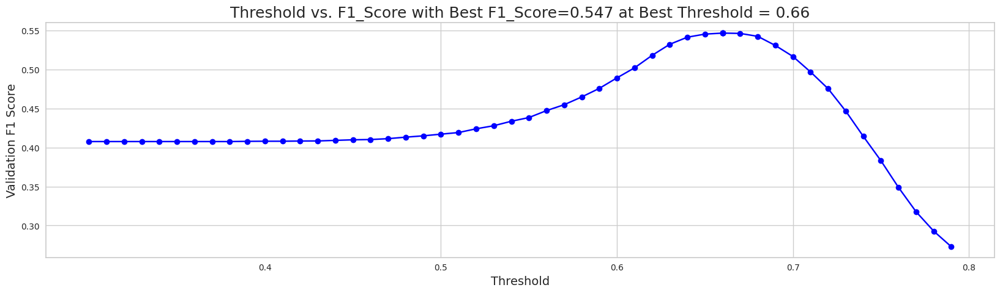

When using optimal threshold = 0.66...
Q0: F1 = 0.5467353393321374


==> Overall F1 = 0.5467353393321374
s
[I 2023-05-23 04:57:28,098] Trial 13 finished with value: 0.5467353393321374 and parameters: {'num_leaves': 11, 'learning_rate': 0.033592506292304335, 'feature_fraction': 0.3395189422832678, 'bagging_fraction': 0.14930772463471448, 'bagging_freq': 4, 'min_child_samples': 5, 'reg_alpha': 0.001233905887535194, 'reg_lambda': 0.0023366256430869636, 'subsample': 0.1311796947896881, 'colsample_bytree': 0.48179798778349064, 'min_split_gain': 0.0012245893324532586, 'max_depth': 5}. Best is trial 1 with value: 0.5545500179593409.


--------------------------------------------------
question17, with255features
--------------------------------------------------


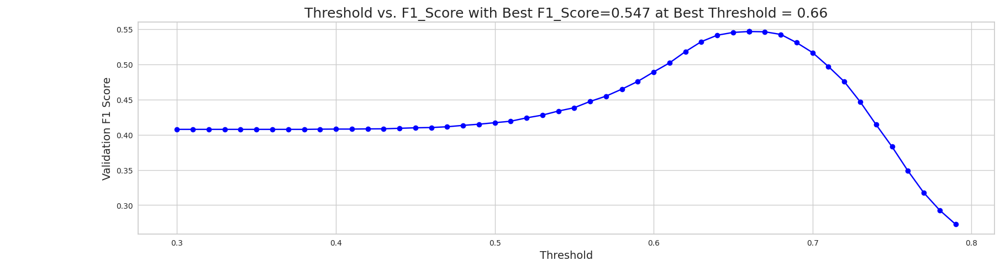

[LightGBM] [Warning] bagging_fraction is set=0.38255450169526034, subsample=0.27642697626383567 will be ignored. Current value: bagging_fraction=0.38255450169526034
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=9, subsample_freq=0 will be ignored. Current value: bagging_freq=9
[LightGBM] [Warning] feature_fraction is set=0.1204801960530621, colsample_bytree=0.41210833033547617 will be ignored. Current value: feature_fraction=0.1204801960530621


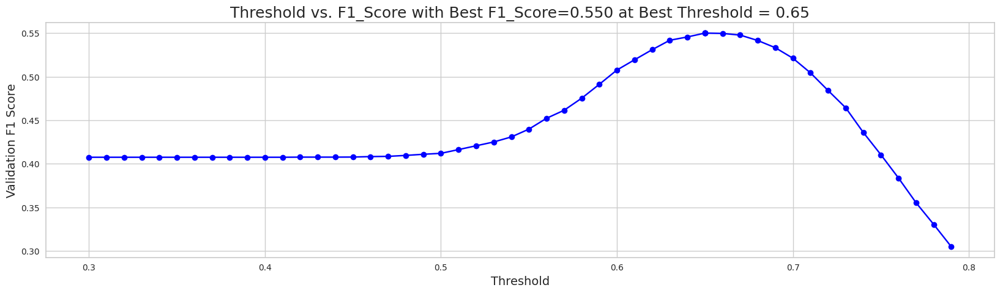

When using optimal threshold = 0.65...
Q0: F1 = 0.5500967119016158
==> Overall F1 = 0.5500967119016158
s
[I 2023-05-23 04:57:31,532] Trial 12 finished with value: 0.5500967119016158 and parameters: {'num_leaves': 15, 'learning_rate': 0.046969479254686086, 'feature_fraction': 0.11160193587015055, 'bagging_fraction': 0.4056038184272943, 'bagging_freq': 10, 'min_child_samples': 18, 'reg_alpha': 5.771388970643969, 'reg_lambda': 3.2289179134184653, 'subsample': 0.5371998017078986, 'colsample_bytree': 0.3159472142575181, 'min_split_gain': 0.21441889967648717, 'max_depth': 0}. Best is trial 1 with value: 0.5545500179593409.


--------------------------------------------------
question17, with255features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.10505958401118778, subsample=0.2566784981017623 will be ignored. Current value: bagging_fraction=0.10505958401118778
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=8, subsample_freq=0 will be ignored. Current value: bagging_freq=8
[LightGBM] [Warning] feature_fraction is set=0.37413678695553854, colsample_bytree=0.4872623997129504 will be ignored. Current value: feature_fraction=0.37413678695553854


[LightGBM] [Warning] bagging_fraction is set=0.38255450169526034, subsample=0.27642697626383567 will be ignored. Current value: bagging_fraction=0.38255450169526034
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=9, subsample_freq=0 will be ignored. Current value: bagging_freq=9
[LightGBM] [Warning] feature_fraction is set=0.1204801960530621, colsample_bytree=0.41210833033547617 will be ignored. Current value: feature_fraction=0.1204801960530621


[LightGBM] [Warning] bagging_fraction is set=0.657563621621291, subsample=0.3606518015759562 will be ignored. Current value: bagging_fraction=0.657563621621291
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=4, subsample_freq=0 will be ignored. Current value: bagging_freq=4
[LightGBM] [Warning] feature_fraction is set=0.35733381955447563, colsample_bytree=0.5855538842190068 will be ignored. Current value: feature_fraction=0.35733381955447563


[LightGBM] [Warning] bagging_fraction is set=0.10505958401118778, subsample=0.2566784981017623 will be ignored. Current value: bagging_fraction=0.10505958401118778
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=8, subsample_freq=0 will be ignored. Current value: bagging_freq=8
[LightGBM] [Warning] feature_fraction is set=0.37413678695553854, colsample_bytree=0.4872623997129504 will be ignored. Current value: feature_fraction=0.37413678695553854


[LightGBM] [Warning] bagging_fraction is set=0.4705873411511473, subsample=0.13972739500242326 will be ignored. Current value: bagging_fraction=0.4705873411511473
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7027907079600321, colsample_bytree=0.35751228570106985 will be ignored. Current value: feature_fraction=0.7027907079600321


[LightGBM] [Warning] bagging_fraction is set=0.10505958401118778, subsample=0.2566784981017623 will be ignored. Current value: bagging_fraction=0.10505958401118778
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=8, subsample_freq=0 will be ignored. Current value: bagging_freq=8
[LightGBM] [Warning] feature_fraction is set=0.37413678695553854, colsample_bytree=0.4872623997129504 will be ignored. Current value: feature_fraction=0.37413678695553854


[LightGBM] [Warning] bagging_fraction is set=0.38255450169526034, subsample=0.27642697626383567 will be ignored. Current value: bagging_fraction=0.38255450169526034
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=9, subsample_freq=0 will be ignored. Current value: bagging_freq=9
[LightGBM] [Warning] feature_fraction is set=0.1204801960530621, colsample_bytree=0.41210833033547617 will be ignored. Current value: feature_fraction=0.1204801960530621


[LightGBM] [Warning] bagging_fraction is set=0.10505958401118778, subsample=0.2566784981017623 will be ignored. Current value: bagging_fraction=0.10505958401118778
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=8, subsample_freq=0 will be ignored. Current value: bagging_freq=8
[LightGBM] [Warning] feature_fraction is set=0.37413678695553854, colsample_bytree=0.4872623997129504 will be ignored. Current value: feature_fraction=0.37413678695553854


,mean
feature,
elapsed_time_diff_sum,237.8
hover_duration_sum,194.6
elapsed_time_diff_mean,176.2
elapsed_time_diff_std,171.8
hover_duration_max,169.8
hover_duration_std,162.4
screen_coor_x_std,157.6
room_coor_x_min,150.6
session_id,145.4


[[0.36495519 0.63504481]
 [0.37522881 0.62477119]
 [0.36685436 0.63314564]
 ...
 [0.25513629 0.74486371]
 [0.20874399 0.79125601]
 [0.26889726 0.73110274]]


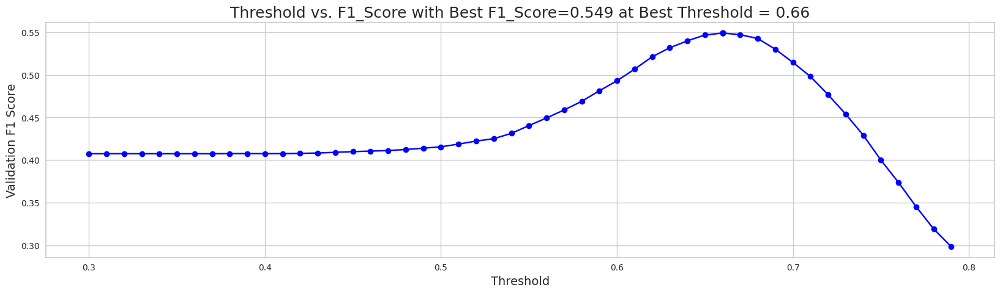

When using optimal threshold = 0.66...
Q0: F1 = 0.5490161285769344
==> Overall F1 = 0.5490161285769344
s
[I 2023-05-23 04:58:04,249] Trial 10 finished with value: 0.5490161285769344 and parameters: {'num_leaves': 56, 'learning_rate': 0.010408159057830508, 'feature_fraction': 0.35733381955447563, 'bagging_fraction': 0.657563621621291, 'bagging_freq': 4, 'min_child_samples': 39, 'reg_alpha': 0.002199431944364257, 'reg_lambda': 0.014974989274052277, 'subsample': 0.3606518015759562, 'colsample_bytree': 0.5855538842190068, 'min_split_gain': 0.6927785456549572, 'max_depth': 6}. Best is trial 1 with value: 0.5545500179593409.


--------------------------------------------------
question17, with255features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.3433106048508989, subsample=0.23149305578499552 will be ignored. Current value: bagging_fraction=0.3433106048508989
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=8, subsample_freq=0 will be ignored. Current value: bagging_freq=8
[LightGBM] [Warning] feature_fraction is set=0.10532336744106086, colsample_bytree=0.4337857683745565 will be ignored. Current value: feature_fraction=0.10532336744106086


[LightGBM] [Warning] bagging_fraction is set=0.38255450169526034, subsample=0.27642697626383567 will be ignored. Current value: bagging_fraction=0.38255450169526034
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=9, subsample_freq=0 will be ignored. Current value: bagging_freq=9
[LightGBM] [Warning] feature_fraction is set=0.1204801960530621, colsample_bytree=0.41210833033547617 will be ignored. Current value: feature_fraction=0.1204801960530621


[LightGBM] [Warning] bagging_fraction is set=0.10505958401118778, subsample=0.2566784981017623 will be ignored. Current value: bagging_fraction=0.10505958401118778
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=8, subsample_freq=0 will be ignored. Current value: bagging_freq=8
[LightGBM] [Warning] feature_fraction is set=0.37413678695553854, colsample_bytree=0.4872623997129504 will be ignored. Current value: feature_fraction=0.37413678695553854


[LightGBM] [Warning] bagging_fraction is set=0.3433106048508989, subsample=0.23149305578499552 will be ignored. Current value: bagging_fraction=0.3433106048508989
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=8, subsample_freq=0 will be ignored. Current value: bagging_freq=8
[LightGBM] [Warning] feature_fraction is set=0.10532336744106086, colsample_bytree=0.4337857683745565 will be ignored. Current value: feature_fraction=0.10532336744106086


[LightGBM] [Warning] bagging_fraction is set=0.38255450169526034, subsample=0.27642697626383567 will be ignored. Current value: bagging_fraction=0.38255450169526034
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=9, subsample_freq=0 will be ignored. Current value: bagging_freq=9
[LightGBM] [Warning] feature_fraction is set=0.1204801960530621, colsample_bytree=0.41210833033547617 will be ignored. Current value: feature_fraction=0.1204801960530621


[LightGBM] [Warning] bagging_fraction is set=0.4705873411511473, subsample=0.13972739500242326 will be ignored. Current value: bagging_fraction=0.4705873411511473
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7027907079600321, colsample_bytree=0.35751228570106985 will be ignored. Current value: feature_fraction=0.7027907079600321


[LightGBM] [Warning] bagging_fraction is set=0.3433106048508989, subsample=0.23149305578499552 will be ignored. Current value: bagging_fraction=0.3433106048508989
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=8, subsample_freq=0 will be ignored. Current value: bagging_freq=8
[LightGBM] [Warning] feature_fraction is set=0.10532336744106086, colsample_bytree=0.4337857683745565 will be ignored. Current value: feature_fraction=0.10532336744106086


,mean
feature,
elapsed_time_diff_sum,54.2
hover_duration_sum,48.8
elapsed_time_diff_mean,27.8
hover_duration_max,26.4
screen_coor_x_std,19.8
hover_duration_mean,19.4
room_coor_x_min,19.2
hover_duration_std,19.0
tunic.wildlife.center_room_fqid_counts,18.4


[[0.40977919 0.59022081]
 [0.34673445 0.65326555]
 [0.37610672 0.62389328]
 ...
 [0.20469658 0.79530342]
 [0.20087158 0.79912842]
 [0.26835738 0.73164262]]


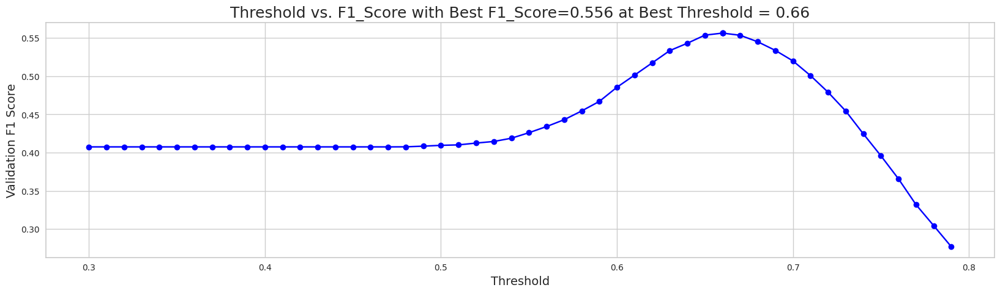

When using optimal threshold = 0.66...
Q0: F1 = 0.5563649954951854
==> Overall F1 = 0.5563649954951854
s
[I 2023-05-23 04:58:29,706] Trial 15 finished with value: 0.5563649954951854 and parameters: {'num_leaves': 23, 'learning_rate': 0.010044682099077952, 'feature_fraction': 0.37413678695553854, 'bagging_fraction': 0.10505958401118778, 'bagging_freq': 8, 'min_child_samples': 67, 'reg_alpha': 0.7529035428246668, 'reg_lambda': 0.23748249040477992, 'subsample': 0.2566784981017623, 'colsample_bytree': 0.4872623997129504, 'min_split_gain': 0.06128664074664582, 'max_depth': 2}. Best is trial 15 with value: 0.5563649954951854.


--------------------------------------------------
question17, with255features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.12171515069750358, subsample=0.12608079963359878 will be ignored. Current value: bagging_fraction=0.12171515069750358
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=8, subsample_freq=0 will be ignored. Current value: bagging_freq=8
[LightGBM] [Warning] feature_fraction is set=0.44859882111185273, colsample_bytree=0.44994269642995477 will be ignored. Current value: feature_fraction=0.44859882111185273


[LightGBM] [Warning] bagging_fraction is set=0.3433106048508989, subsample=0.23149305578499552 will be ignored. Current value: bagging_fraction=0.3433106048508989
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=8, subsample_freq=0 will be ignored. Current value: bagging_freq=8
[LightGBM] [Warning] feature_fraction is set=0.10532336744106086, colsample_bytree=0.4337857683745565 will be ignored. Current value: feature_fraction=0.10532336744106086


,mean
feature,
hover_duration_max,107.8
hover_duration_sum,91.8
elapsed_time_diff_mean,80.2
elapsed_time_diff_sum,78.0
room_coor_y_max,68.0
hover_duration_std,63.6
hover_duration_mean,62.2
screen_corr_y_dff_mean,61.8
room_coor_x_max,61.4


[[0.36820348 0.63179652]
 [0.37828015 0.62171985]
 [0.37741315 0.62258685]
 ...
 [0.22603832 0.77396168]
 [0.21180658 0.78819342]
 [0.27603878 0.72396122]]


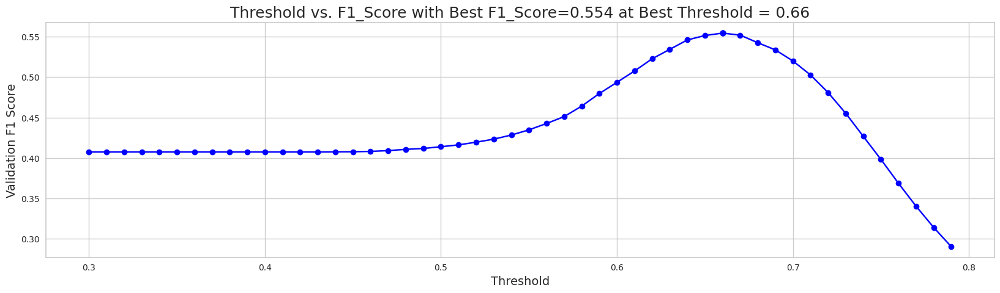

When using optimal threshold = 0.66...
Q0: F1 = 0.5544637180892047
==> Overall F1 = 0.5544637180892047
s
[I 2023-05-23 04:58:39,186] Trial 14 finished with value: 0.5544637180892047 and parameters: {'num_leaves': 10, 'learning_rate': 0.01090136562917427, 'feature_fraction': 0.1204801960530621, 'bagging_fraction': 0.38255450169526034, 'bagging_freq': 9, 'min_child_samples': 6, 'reg_alpha': 0.8282268864692239, 'reg_lambda': 0.2932708297998741, 'subsample': 0.27642697626383567, 'colsample_bytree': 0.41210833033547617, 'min_split_gain': 0.04598719847563057, 'max_depth': -1}. Best is trial 15 with value: 0.5563649954951854.


[LightGBM] [Warning] bagging_fraction is set=0.12171515069750358, subsample=0.12608079963359878 will be ignored. Current value: bagging_fraction=0.12171515069750358
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=8, subsample_freq=0 will be ignored. Current value: bagging_freq=8
[LightGBM] [Warning] feature_fraction is set=0.44859882111185273, colsample_bytree=0.44994269642995477 will be ignored. Current value: feature_fraction=0.44859882111185273
--------------------------------------------------
question17, with255features
--------------------------------------------------


[LightGBM] [Warning] bagging_fraction is set=0.10405591882206695, subsample=0.12155446794469693 will be ignored. Current value: bagging_fraction=0.10405591882206695
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
[LightGBM] [Warning] feature_fraction is set=0.4133320095372728, colsample_bytree=0.5321924852608546 will be ignored. Current value: feature_fraction=0.4133320095372728


[LightGBM] [Warning] bagging_fraction is set=0.12171515069750358, subsample=0.12608079963359878 will be ignored. Current value: bagging_fraction=0.12171515069750358
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=8, subsample_freq=0 will be ignored. Current value: bagging_freq=8
[LightGBM] [Warning] feature_fraction is set=0.44859882111185273, colsample_bytree=0.44994269642995477 will be ignored. Current value: feature_fraction=0.44859882111185273


[LightGBM] [Warning] bagging_fraction is set=0.10405591882206695, subsample=0.12155446794469693 will be ignored. Current value: bagging_fraction=0.10405591882206695
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
[LightGBM] [Warning] feature_fraction is set=0.4133320095372728, colsample_bytree=0.5321924852608546 will be ignored. Current value: feature_fraction=0.4133320095372728


[LightGBM] [Warning] bagging_fraction is set=0.3433106048508989, subsample=0.23149305578499552 will be ignored. Current value: bagging_fraction=0.3433106048508989
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=8, subsample_freq=0 will be ignored. Current value: bagging_freq=8
[LightGBM] [Warning] feature_fraction is set=0.10532336744106086, colsample_bytree=0.4337857683745565 will be ignored. Current value: feature_fraction=0.10532336744106086


[LightGBM] [Warning] bagging_fraction is set=0.10405591882206695, subsample=0.12155446794469693 will be ignored. Current value: bagging_fraction=0.10405591882206695
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
[LightGBM] [Warning] feature_fraction is set=0.4133320095372728, colsample_bytree=0.5321924852608546 will be ignored. Current value: feature_fraction=0.4133320095372728


[LightGBM] [Warning] bagging_fraction is set=0.12171515069750358, subsample=0.12608079963359878 will be ignored. Current value: bagging_fraction=0.12171515069750358
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=8, subsample_freq=0 will be ignored. Current value: bagging_freq=8
[LightGBM] [Warning] feature_fraction is set=0.44859882111185273, colsample_bytree=0.44994269642995477 will be ignored. Current value: feature_fraction=0.44859882111185273


,mean
feature,
elapsed_time_diff_mean,43.4
hover_duration_sum,40.2
hover_duration_std,28.6
hover_duration_max,25.4
elapsed_time_diff_sum,23.8
19_level_counts,22.6
room_corr_x_diff_sum,22.2
room_coor_y_max,21.4
room_coor_x_max,21.2


[[0.43430103 0.56569897]
 [0.37638185 0.62361815]
 [0.35275336 0.64724664]
 ...
 [0.22825224 0.77174776]
 [0.21215348 0.78784652]
 [0.28117316 0.71882684]]


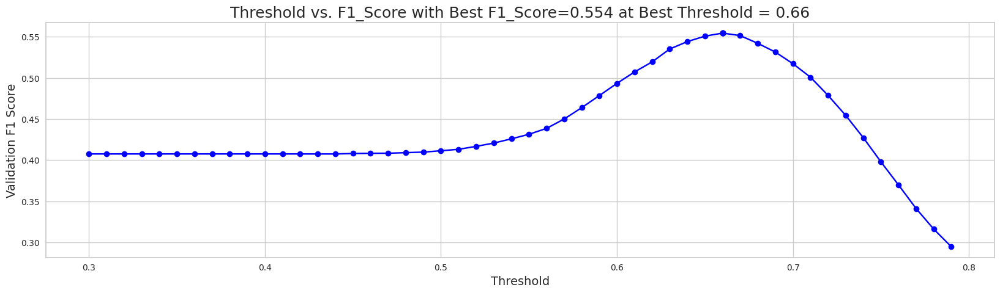

When using optimal threshold = 0.66...
Q0: F1 = 0.5544727938090059
==> Overall F1 = 0.5544727938090059
s
[I 2023-05-23 04:58:57,836] Trial 16 finished with value: 0.5544727938090059 and parameters: {'num_leaves': 23, 'learning_rate': 0.019794418047162737, 'feature_fraction': 0.10532336744106086, 'bagging_fraction': 0.3433106048508989, 'bagging_freq': 8, 'min_child_samples': 66, 'reg_alpha': 0.8063588045780855, 'reg_lambda': 0.18834952986591275, 'subsample': 0.23149305578499552, 'colsample_bytree': 0.4337857683745565, 'min_split_gain': 0.05162599914731155, 'max_depth': 2}. Best is trial 15 with value: 0.5563649954951854.


[LightGBM] [Warning] bagging_fraction is set=0.10405591882206695, subsample=0.12155446794469693 will be ignored. Current value: bagging_fraction=0.10405591882206695
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
[LightGBM] [Warning] feature_fraction is set=0.4133320095372728, colsample_bytree=0.5321924852608546 will be ignored. Current value: feature_fraction=0.4133320095372728
--------------------------------------------------
question17, with255features
--------------------------------------------------
[LightGBM] [Warning] bagging_fraction is set=0.12171515069750358, subsample=0.12608079963359878 will be ignored. Current value: bagging_fraction=0.12171515069750358
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_roun

[LightGBM] [Warning] bagging_fraction is set=0.1207495359731479, subsample=0.17231655579631494 will be ignored. Current value: bagging_fraction=0.1207495359731479
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
[LightGBM] [Warning] feature_fraction is set=0.41113049211802155, colsample_bytree=0.5514461268711008 will be ignored. Current value: feature_fraction=0.41113049211802155


,mean
feature,
hover_duration_sum,32.6
elapsed_time_diff_sum,29.8
elapsed_time_diff_mean,19.4
hover_duration_max,19.4
room_coor_y_min,17.6
hover_duration_std,17.2
session_id,15.0
screen_coor_x_std,14.4
hover_duration_mean,14.4


[[0.41976348 0.58023652]
 [0.4030536  0.5969464 ]
 [0.35040073 0.64959927]
 ...
 [0.21765818 0.78234182]
 [0.20138825 0.79861175]
 [0.25491547 0.74508453]]


[LightGBM] [Warning] bagging_fraction is set=0.10405591882206695, subsample=0.12155446794469693 will be ignored. Current value: bagging_fraction=0.10405591882206695
[LightGBM] [Warning] early_stopping_round is set=75, early_stopping_rounds=75 will be ignored. Current value: early_stopping_round=75
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
[LightGBM] [Warning] feature_fraction is set=0.4133320095372728, colsample_bytree=0.5321924852608546 will be ignored. Current value: feature_fraction=0.4133320095372728


In [28]:
for i in range(10, 19):
    study = optuna.create_study(direction='maximize')
    study.optimize(lambda trial:objective_lgbm(trial, i), show_progress_bar=True, 
                   gc_after_trial=True, n_jobs=4, n_trials=50)

    # Get the best hyperparameters
    best_params = study.best_params
    print(best_params)

In [ ]:
'''
import pickle
importance_dict = {}
for t in range(1, 19):
    if t<=3: 
        importance_dict[str(t)] = FEATURES1
    elif t<=13: 
        importance_dict[str(t)] = FEATURES2
    elif t<=22:
        importance_dict[str(t)] = FEATURES3

f_save = open('importance_dict.pkl', 'wb')
pickle.dump(importance_dict, f_save)
f_save.close()
'''